### RNN with LSTM cell
* Architecture reference from https://arxiv.org/pdf/2004.00959.pdf
* Country-specific network (with only non-zero data)

(Something new: Maybe decrease number of classifier by grouping countries in the same GDP/ bracket)

#### Data partition
* Test data is the last 10 days
* Validation 10 days before last 10 days
* Data logged
* Noise added is smaller compared to Offline-3
* Also optimize momentum of SGD
* Version 5 learns the difference! Instead of the data itself

In [1]:
import torch
import pandas as pd
import numpy as np
import os
import copy
#import writer
import random
from sklearn.preprocessing import normalize
import seaborn as sns
#import 
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# Assuming that we are on a CUDA machine, this should print a CUDA device:

print(device)

cuda:0


In [2]:
# read data in
csse_country = "CPSC540_Covid/active_data/csse_world_normalized.csv"
df_csse = pd.read_csv(csse_country)
df_csse.head(10)
#list(df_csse.columns.values.tolist()) 
countries = df_csse["Country/Region"].tolist()

In [3]:
countries
df_csse.shape

(172, 86)

#### What if use grouping from k-means? or hierarchical clustering to decide which countries are in the same bracket


In [4]:
validation_d = 5
test_d = 5

# Convert to numpy array

cases = df_csse.loc[:,'1/22/20':]
casesA = cases.to_numpy()
casesA
count, days = casesA.shape

print(days)
# last 10 days for test

case_test = casesA[:,-test_d:]
case_validation = casesA[:,days-validation_d-test_d:days-test_d]
case_train = casesA[:,:days-validation_d-test_d]

print(case_test.shape)
print(case_validation.shape)
print(case_train.shape)

84
(172, 5)
(172, 5)
(172, 74)


In [5]:
def find_zero(lst):
    numzero = 0
    for i in lst:
        if i ==0:
            numzero += 1
    return(numzero)

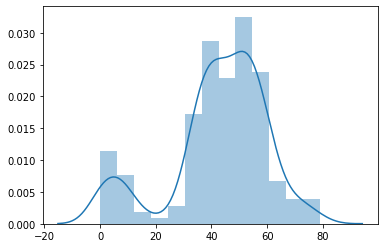

In [6]:
# graph number of days zero
cutoff = 25 # at most = 0
lstzero = []
skip_countries = []
for i in range(len(countries)):
    numz = find_zero(casesA[i,:].tolist())
    lstzero.append(numz)
    if numz > cutoff:
        skip_countries.append(i)

sns.distplot(np.array(lstzero));

In [7]:
len(skip_countries)

149

From the distribution, 30 seems a reasonable cutoff (most countries still present)

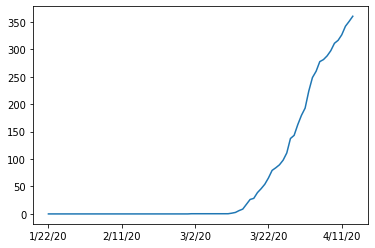

In [8]:
# plot 
#epoch = np.linspace(1, len(trainErr), len(trainErr))

cases.loc[50,:].plot.line()


In [9]:
case_train

array([[0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        2.52296317e-01, 2.52296317e-01, 2.52296317e-01],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        4.04858300e+01, 4.95951417e+01, 5.06072874e+01],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        6.20342147e+00, 6.20342147e+00, 8.17723739e+00],
       ...,
       [3.02112385e-03, 3.02112385e-03, 6.04224770e-03, ...,
        7.36435192e+02, 8.32579437e+02, 9.33083164e+02],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        1.91862032e+05, 1.91862032e+05, 1.91862032e+05],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        4.39667807e+03, 4.39667807e+03, 4.39667807e+03]])

In [10]:
# log transform
case_test_log = np.log(case_test)
case_validation_log = np.log(case_validation)
case_train_log = np.log(case_train)
case_train_log

/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in log
  This is separate from the ipykernel package so we can avoid doing imports until
/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in log
  after removing the cwd from sys.path.


array([[       -inf,        -inf,        -inf, ..., -1.37715102,
        -1.37715102, -1.37715102],
       [       -inf,        -inf,        -inf, ...,  3.70095204,
         3.90389288,  3.92409559],
       [       -inf,        -inf,        -inf, ...,  1.82510099,
         1.82510099,  2.10135437],
       ...,
       [-5.80212638, -5.80212638, -5.1089792 , ...,  6.60182124,
         6.72452864,  6.83849433],
       [       -inf,        -inf,        -inf, ..., 12.16453181,
        12.16453181, 12.16453181],
       [       -inf,        -inf,        -inf, ...,  8.38860455,
         8.38860455,  8.38860455]])

### Divide data into training sets
* specify number of days for train and prediction
* offset the dataset so for example: [1,2,3,4] then get [1,2],[2,3] which predicts 3 and 4 respectively

In [11]:
# test 
np.array(case_train[3,:])
#total_days-pred_days-t_days
case_train[3,5:8]

array([0., 0., 0.])

In [12]:
def clear_zero(nparray):
    # return the np array that contains only 1 0:
    lst = nparray.tolist()
    #print(len(lst))
    ind = 0
    splitInd = 0
    while(lst[ind]==0):
        splitInd += 1
        ind += 1
    #print(splitInd)
    return(np.array(lst[splitInd:]))

In [13]:
clear_zero(case_train[169,:]).shape[0]

74

In [14]:
def get_diff(arr):
    lst = arr.tolist()
    difflst = []
    for i in range(len(lst)):
        if i == 0:
            continue
        # start
        difflst.append(lst[i]-lst[i-1])
    return(np.array(difflst))

In [15]:
t_days = 25 # number of days used to test 
pred_days = test_d
total_days = case_train.shape[1]

country_train_X = []
country_train_Y = []

country_valid_X = []
country_valid_Y = []

country_test_X = []
country_test_Y = []

diffData = []
for i in range(len(countries)):
    print(countries[i] + " "+ str(i))
    
    if i in skip_countries:
        country_train_X.append(0)
        country_train_Y.append(0)

        country_valid_X.append(0)
        country_valid_Y.append(0)

        country_test_X.append(0)
        country_test_Y.append(0)
        diffData.append(0)
        continue # too little data 
        
    # split dataset
    cur_c = [] # current country 
    out = []
    
    cur_v = [] # current country 
    out_v = []
    
    cur_t = [] # current country 
    out_t = []
    
    newcase1 = clear_zero(case_train[i,:])
    newcase = get_diff(newcase1)
    total_days = newcase.shape[0]
    diffData.append(newcase)
    print(total_days)
    for j in range(total_days-pred_days*2-t_days): 
        
        #print(j)
        #print(case_train[i,j:j+t_days].shape)
        #print(len(case_train[i,j+t_days]))
        cur_c.append(newcase[j:j+t_days])
        #print(str(j))
        out.append(newcase[j+t_days:j+t_days+pred_days])
        #print(len(cur_c))
    
    country_train_X.append(cur_c)
    country_train_Y.append(out)
    
    country_valid_X.append(newcase[total_days-t_days-test_d*2:total_days-test_d*2])
    print(newcase[total_days-t_days-test_d*2:total_days-test_d*2].shape)
    country_valid_Y.append(newcase[total_days-test_d*2:total_days-test_d])
    print(newcase[total_days-test_d*2:total_days-test_d].shape)
    
    country_test_X.append(newcase[total_days-test_d-t_days:total_days-test_d])
    country_test_Y.append(newcase[total_days-test_d:])
    
    # the best way to check this
    #testlist = 


Burundi 0
Djibouti 1
Eritrea 2
Ethiopia 3
Kenya 4
Madagascar 5
Malawi 6
Mauritius 7
Mozambique 8
Rwanda 9
Seychelles 10
Somalia 11
South Sudan 12
Uganda 13
Tanzania 14
Zambia 15
Zimbabwe 16
Angola 17
Cameroon 18
Central African Republic 19
Chad 20
Equatorial Guinea 21
Gabon 22
Sao Tome and Principe 23
Botswana 24
Eswatini 25
Namibia 26
South Africa 27
Benin 28
Burkina Faso 29
Cabo Verde 30
Gambia 31
Ghana 32
Guinea 33
Guinea-Bissau 34
Liberia 35
Mali 36
Mauritania 37
Niger 38
Nigeria 39
Senegal 40
Sierra Leone 41
Togo 42
Algeria 43
Egypt 44
50
(25,)
(5,)
Libya 45
Morocco 46
Sudan 47
Tunisia 48
Western Sahara 49
Armenia 50
Azerbaijan 51
Bahrain 52
Cyprus 53
Georgia 54
Iraq 55
Israel 56
Jordan 57
Kuwait 58
Lebanon 59
Oman 60
Qatar 61
Saudi Arabia 62
Syria 63
Turkey 64
United Arab Emirates 65
66
(25,)
(5,)
Yemen 66
Kazakhstan 67
Kyrgyzstan 68
Uzbekistan 69
Afghanistan 70
Bangladesh 71
Bhutan 72
India 73
65
(25,)
(5,)
Iran 74
Maldives 75
Nepal 76
70
(25,)
(5,)
Pakistan 77
Sri Lanka 78
68
(

In [16]:
country_train_X[88][0].shape
country_train_X[81][0].shape

(25,)

In [17]:
len(country_train_X)

172

In [18]:
# check dimension

#len(country_test_X[33])
total_days-pred_days-test_d
pred_days
test_d
total_days
case_train[0,29:64].shape
case_train[0,0:40].shape

(40,)

#### Data size & index
The first axis is the sequence itself, the second indexes instances in the mini-batch, and the third indexes elements of the input. We haven’t discussed mini-batching, so lets just ignore that and assume we will always have just 1 dimension on the second axis.

In [19]:
#import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

torch.manual_seed(1)

### Optimized hyperparameters
|Parameter |Description|Distribution/Selection|Values|
|----------|------------|----------------------|---------|
|Learning rate|Minimum learning rate| Discrete|1e-1 to 1e-7|
|Hidden layers|Number of layers in the network|Discrete numeric|1 to 5|
|Hidden state|Number of memory cell in each layer|Discrete numeric|1 to 200|

In [20]:
# Parameter
num_epochs = 50 # max
batch_size = 1
# Loss and optimizer
criterion = torch.nn.MSELoss()
#optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)
learning_rate = 0.01 # to be changed/optimized 
#optimizer = torch.optim.SGD(model.parameters(), lr = learning_rate, momentum=0.9)
output_directory = "mock/"
output_file_path = "mock/Train"
input_dim = t_days
hidden_dim = 2
hidden_state = 100
output_dim= pred_days
num_layers=2
lstm_input_size = t_days
#model = LSTM(lstm_input_size, hidden_dim, batch_size=batch_size, output_dim=output_dim, num_layers=num_layers)

model_name = "mock"
output_file_path = "./outputs/" + model_name + "/training/"
directory = os.path.dirname(output_file_path)
if not os.path.exists(directory):
    print("Creating directory %s" % output_file_path)
    os.makedirs(directory)
else:
     print("Directory %s exists" % output_file_path)


Directory ./outputs/mock/training/ exists


In [21]:
# RNN structure

class RNN(nn.Module):

    # you can also accept arguments in your model constructor
    def __init__(self, data_size, hidden_size, output_size):
        super(RNN, self).__init__()

        self.hidden_size = hidden_size
        input_size = data_size + hidden_size

        self.i2h = nn.Linear(input_size, hidden_size)
        self.h2o = nn.Linear(hidden_size, output_size)

    def forward(self, data, last_hidden):
        input = torch.cat((data, last_hidden), 1)
        hidden = self.i2h(input)
        output = self.h2o(hidden)
        return hidden, output
    
    def initHidden(self):
        return torch.zeros(1, self.hidden_size)


In [22]:
# LSTM structure

class LSTM(nn.Module):
 
    def __init__(self, input_dim, hidden_dim, batch_size, output_dim=pred_days,
                    num_layers=2):
        super(LSTM, self).__init__()
        self.input_dim = input_dim
        self.hidden_dim = hidden_dim
        self.batch_size = batch_size
        self.num_layers = num_layers
 
        # Define the LSTM layer
        self.lstm = nn.LSTM(self.input_dim, self.hidden_dim, self.num_layers,dropout=0)
 
        # Define the output layer
        self.linear = nn.Linear(self.hidden_dim, output_dim)
 
    def init_hidden(self):
        # This is what we'll initialise our hidden state as
        return (torch.zeros(self.num_layers, self.batch_size, self.hidden_dim),
                torch.zeros(self.num_layers, self.batch_size, self.hidden_dim))
 
    def forward(self, input):
        # Forward pass through LSTM layer
        # shape of lstm_out: [input_size, batch_size, hidden_dim]
        # shape of self.hidden: (a, b), where a and b both 
        # have shape (num_layers, batch_size, hidden_dim).
        lstm_out, self.hidden = self.lstm(input.view(len(input), self.batch_size, -1))
        
        # Only take the output from the final timetep
        # Can pass on the entirety of lstm_out to the next layer if it is a seq2seq prediction
        y_pred = self.linear(lstm_out[-1].view(self.batch_size, -1))
        
        return y_pred.view(-1)

#model = LSTM(lstm_input_size, h1, batch_size=num_train, output_dim=output_dim, num_layers=num_layers)

In [23]:
# training function
def train_model(train_loader, test_loader, model, device, criterion, optimizer, num_epochs, output_directory,learning_rate,hidden_dim,num_layers,momentum):
    
    total_step = len(train_loader)
    model.train()
    model.hidden = model.init_hidden() # LSTM hidden reinitialization
    
    #open files to log error
    train_error = open(output_directory + "training_error"+ "_"+str(learning_rate)+ "_"+ str(hidden_dim) + "_"+ str(num_layers)+ "_"+ str(momentum) +".txt", "a")
    test_error = open(output_directory + "validation_error"+ "_"+str(learning_rate)+ "_"+ str(hidden_dim) + "_"+ str(num_layers) + "_"+ str(momentum)+".txt", "a")

    #best_model_wts = copy.deepcopy(model.state_dict())
    best_loss_valid = float('inf')
    best_epoch = 1

    for epoch in range(num_epochs):
        model.train()
        running_loss = 0.0
        for i, (seqs, labels) in enumerate(train_loader):
            #print(seqs.shape)
            # add gaussian noise to sequence
            noiselevel = torch.max(torch.tensor(country_train_X[2])).item()/1000
            noise = torch.abs(torch.randn(seqs.shape[0],seqs.shape[1],seqs.shape[2],seqs.shape[3])*noiselevel)
            #print(noise.shape)
            seqs += noise # add gaussian noise
            #print(seqs.shape)
            seqs = seqs.to(device)
            labels = labels.to(device)

            # Forward pass
            #seqs = seqs.squeeze()
            #print(seqs.shape)
            #print(model(seqs))
            outputs = model(seqs) # error 
            loss = criterion(outputs, labels) # change input to 
            running_loss += loss.item()
        
            # Backward and optimize
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            #if (i+1) % 100 == 0:
            #    print ('Epoch [{}/{}], Step [{}/{}], Loss: {:.4f}'
            #           .format(epoch+1, num_epochs, i+1, total_step, loss.item()))

        #save training loss to file
        epoch_loss = running_loss / len(train_loader.dataset)
        print("%s, %s" % (epoch, epoch_loss), file=train_error)
        
        #calculate test loss for epoch
        test_loss = 0.0
        with torch.no_grad():
            model.eval()
            for i, (seqs, labels) in enumerate(test_loader):
                x = seqs.to(device)
                y = labels.to(device)
                outputs = model(x)
                #print(outputs.shape)
                #print(y.shape)
                loss = criterion(outputs, y)
                test_loss += loss.item() 
                
                # for metrics
                #updateYlist(outputs,y)
                

        test_loss = test_loss / len(test_loader.dataset)
        
        #save outputs for epoch
        print("%s, %s" % (epoch, test_loss), file=test_error)
        
        # for each epoch, calculate metrics (f1, pr)
        #calculateMetrics(outputs,y)
        
        if test_loss < best_loss_valid:
            best_loss_valid = test_loss
            best_epoch = epoch
            best_model_wts = copy.deepcopy(model.state_dict())
            print ('Saving the best model weights at Epoch [{}], Best Valid Loss: {:.4f}' 
                       .format(epoch+1, best_loss_valid))

        
    train_error.close()
    test_error.close()

    #model.load_state_dict(best_model_wts)
    print("train error:", epoch_loss)
    return model, best_loss_valid


In [24]:
def test_model(test_loader, model, device,criterion):
    #predictions = torch.zeros(0, numClass)
    test_loss = 0.0
    
    with torch.no_grad():
        model.eval()
        for i, (seqs, labels) in enumerate(test_loader):            
            seqs = seqs.to(device)
            y = labels.to(device).float()
            print(y)
            pred = model(seqs).float()
            print(pred)
            loss = criterion(pred, y)
            test_loss += loss.item() 
            
    return pred,test_loss

In [25]:
#dimension check
a = torch.tensor(country_train_X[81]) #torch.Size([19, 30, 1, 1])
# torch.tensor(country_valid_X[0]).unsqueeze_(1).unsqueeze_(1).unsqueeze_(0).shape
# torch.tensor(country_valid_Y[0]).unsqueeze_(0).shape
# #torch.tensor(country_train_Y[0])
# torch.tensor(country_train_X[0])
# a.size(-1)
# torch.tensor(country_test_Y[0]).unsqueeze_(0).shape
# torch.tensor(country_valid_Y[0]).unsqueeze_(0).shape
# torch.tensor(country_train_Y[0]).unsqueeze_(1).shape
# #torch.tensor(country_valid_Y[0]).unsqueeze_(0).unsqueeze_(0).shape
# torch.tensor(country_train_Y[0]).unsqueeze_(1).shape
# torch.tensor(country_valid_Y[0]).unsqueeze_(0).shape
# torch.tensor(country_valid_X[0]).unsqueeze_(1).unsqueeze_(1).unsqueeze_(0).shape
# torch.tensor(country_train_X[0]).unsqueeze_(2).unsqueeze_(2).shape
# torch.tensor(country_valid_X[0]).unsqueeze_(1).unsqueeze_(1).unsqueeze_(0).shape

In [39]:
import matplotlib.pyplot as plt

graph_dir = "./graph_Offline5/"
directory = os.path.dirname(graph_dir)
if not os.path.exists(directory):
    print("Creating directory %s" % graph_dir)
    os.makedirs(directory)
else:
     print("Directory %s exists" % graph_dir)

def graph_country(index,prediction,outdir):
    
    # produce projection closeup & general graph
    # with label & title
    #print(prediction)
    data = diffData[index]
    newpred = prediction#.tolist()
    days = data.shape[0]
    
    # general trend
    x = np.linspace(1, len(data.tolist()), len(data.tolist()))
    y_real = data
    y_pred = data[:days-test_d].tolist()
    #print(len(y_pred))
    y_pred.extend(newpred)
    #print(len(y_pred))
    #print(len(y_real))
    y_pred = np.array(y_pred)
    plt.figure(index)
    plt.plot(x, y_real, label = "real")
    plt.plot(x, y_pred, label = "prediction")
    
    plt.xlabel('Days')
    plt.title(countries[index]+" trend")
    plt.savefig(outdir+countries[i]+"_general")
    plt.show()
    # specific plot
    
    x = np.linspace(1, len(data[days-test_d:].tolist()), len(data[days-test_d:].tolist()))
    y_real = data[days-test_d:]
    y_pred = newpred
    plt.figure(index*2)
    plt.plot(x, y_real, label = "real")
    plt.plot(x, y_pred, label = "prediction")
    
    plt.xlabel('Days')
    plt.title(countries[index]+" 5 days prediction")
    plt.savefig(outdir+countries[i]+"_specific")    
    plt.show()

Directory ./graph_Offline5/ exists


In [28]:
# test if it runs
learning_rate = 0.01 # to be changed/optimized 
num_layers = 2
hidden_dim = 100
momentum = 0.1

net =  LSTM(lstm_input_size, hidden_dim, batch_size=batch_size, output_dim=output_dim, num_layers=num_layers)
print(net)
model = net.to(device)
optimizer = torch.optim.SGD(model.parameters(), lr = learning_rate, momentum=0.9)

train_dataset = torch.utils.data.TensorDataset(torch.tensor(country_train_X[81]).unsqueeze_(2).unsqueeze_(2).float(), torch.tensor(country_train_Y[81]).unsqueeze_(1).float())
train_loader = torch.utils.data.DataLoader(dataset=train_dataset, batch_size=batch_size, shuffle=True)

# load validation
valid_dataset = torch.utils.data.TensorDataset(torch.tensor(country_valid_X[81]).unsqueeze_(1).unsqueeze_(1).unsqueeze_(0).float(), torch.tensor(country_valid_Y[81]).unsqueeze_(0).float())
valid_loader = torch.utils.data.DataLoader(dataset=valid_dataset, batch_size=batch_size, shuffle=False)

# load test
test_dataset = torch.utils.data.TensorDataset(torch.tensor(country_test_X[81]).unsqueeze_(1).unsqueeze_(1).unsqueeze_(0).float(), torch.tensor(country_test_Y[81]).unsqueeze_(0).float())
test_loader = torch.utils.data.DataLoader(dataset=test_dataset, batch_size=batch_size, shuffle=False)


# mock trial
err = train_model(train_loader, valid_loader, model, device, criterion,  optimizer, num_epochs, output_file_path,learning_rate,hidden_dim, num_layers,momentum)



LSTM(
  (lstm): LSTM(25, 100, num_layers=2)
  (linear): Linear(in_features=100, out_features=5, bias=True)
)
Saving the best model weights at Epoch [1], Best Valid Loss: 0.7937


/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Saving the best model weights at Epoch [2], Best Valid Loss: 0.7417
Saving the best model weights at Epoch [8], Best Valid Loss: 0.7210
Saving the best model weights at Epoch [32], Best Valid Loss: 0.7066
train error: 0.07369914224469348


tensor([[0.6879, 1.7790, 2.5064, 0.9646, 4.1273]], device='cuda:0')
tensor([0.2644, 0.2825, 0.2979, 0.3408, 0.4089], device='cuda:0')


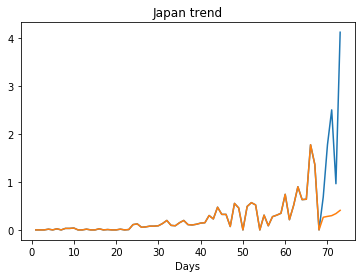

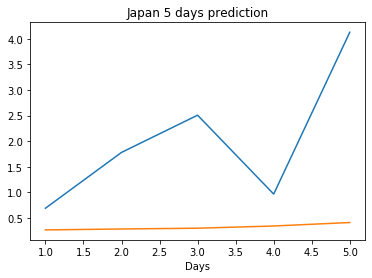

In [40]:
pred, loss = test_model(test_loader,model,device,criterion)
graph_country(81,pred.tolist(),graph_dir)

In [34]:
diffData[81].shape

(73,)

Creating directory ./offline5/Egypt/training/
Egypt
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0786
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0341
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0214
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [30], Best Valid Loss

Saving the best model weights at Epoch [7], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0100
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0100
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0084
train error: 0.028623697813600302
0.008449985645711422
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0553
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0222
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [7], Best Valid L

Saving the best model weights at Epoch [5], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0100
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0096
train error: 0.031655360882480936
0.009640241973102093
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0612
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0253
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [26], Best Valid L

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0117
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0096
train error: 0.0315466961512963
0.00961310788989067
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0436
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0095
train error: 0.0317968833570679
0.009495552629232407
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0305
Saving th

Saving the best model weights at Epoch [8], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0097
train error: 0.031924295239150524
0.009708729572594166
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0292
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0100
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0084
train error: 0.032528040433923405
0.008354654535651207
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0095


train error: 0.0319060721124212
0.009383606724441051
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0332
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0086
train error: 0.032630504295229915
0.008619949221611023
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0070
train error: 0.03298398268719514
0.0070083304308354855
Saving the best m

train error: 0.03255115337669849
0.007937152869999409
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0077
train error: 0.03316646485279004
0.007651329971849918
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0036
train error: 0.036558358122905095
0.003618421731516719
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0874
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0372
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0216
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0118
Saving the best mode

Saving the best model weights at Epoch [31], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0075
train error: 0.033189062712093195
0.0074920677579939365
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0029
train error: 0.03582642146696647
0.0029148596804589033
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2346
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2082
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1852
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1648
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1470
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1313
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1174
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1053
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0946
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0851
Sa

Saving the best model weights at Epoch [19], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0082
Saving the best model weights at E

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0264
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0246
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0229
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0216
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0203
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0184
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0167
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0140
Saving the best model weights at E

Saving the best model weights at Epoch [7], Best Valid Loss: 0.0884
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0800
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0726
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0660
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0602
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0551
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0504
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0464
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0427
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0395
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0366
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0340
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0297
Saving the best model weights at Epoc

Saving the best model weights at Epoch [31], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0097
train error: 0.030217309420307478
0.00965883582830429
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1436
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1043
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0779
Saving the best model weights at Epoch [4], Best Val

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0153
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0109
Saving the best model weights at E

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0238
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0227
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0217
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0208
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0174
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0164
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0159
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0152
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0105
train error: 0.03066328459729751
0.010534285567700863
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1084
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0799
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0604
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0476
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0382
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0309
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0258
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0222
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0183
Saving the best model weights at Epoch [11], Best Valid Lo

Saving the best model weights at Epoch [38], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0110
train error: 0.030480080905059975
0.011003240011632442
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1500
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1227
Saving the best model weights at Epoch [3], Best V

Saving the best model weights at Epoch [37], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0121
train error: 0.030480213773747284


Saving the best model weights at Epoch [25], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0102
train error: 0.03062452282756567
0.010175928473472595
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0841
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0357
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0088
train error: 0.030861857968072098
0.00883420929312706
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1713
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1533
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1376
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1237
Savi

Saving the best model weights at Epoch [13], Best Valid Loss: 0.0252
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0226
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0212
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0183
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0164
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0127
Saving the best model weights at E

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0407
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0371
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0341
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0314
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0290
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0270
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0235
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0223
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0210
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0190
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0181
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0174
Saving the best model weights at E

Saving the best model weights at Epoch [5], Best Valid Loss: 0.0977
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0884
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0802
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0730
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0666
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0609
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0559
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0475
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0439
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0407
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0379
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0353
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0330
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [27], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0107
train error: 0.030590702344973884


Saving the best model weights at Epoch [20], Best Valid Loss: 0.0212
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0167
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0134
Saving the best model weights at E

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0363
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0340
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0300
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0268
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0254
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0230
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0220
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0194
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0188
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0107
train error: 0.03058706515779098
0.010702448897063732
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1501
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1087
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0802
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0611
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0469
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0375
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0302
Saving the best model weights at Epoch [8], Best Valid L

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0174
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0167
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0125
Saving the best model weights at E

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0266
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0252
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0228
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0217
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0208
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0178
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0167
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0162
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0158
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.0107
train error: 0.030589848508437475
0.01074694748967886
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1612
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1140
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0830
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0624
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0483
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0378
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0302
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0253
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0218
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0153
Saving the best model weights at Epoch [13], Best Valid Lo

Saving the best model weights at Epoch [38], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0117
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0114
train error: 0.030521589828034244
0.011357235722243786
Saving the best model weights at Epoch [1], Best

Saving the best model weights at Epoch [40], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0123
train error: 0.030564012192189693
0.012338459491729736
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1639
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1429
Saving the best model weights at Epoch [3], Best V

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0102
train error: 0.030738821625709532
0.010234872810542583
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0825
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0323
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0092
train error: 0.03074073853592078
0.009177323430776596
S

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0382
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0333
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0292
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0256
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0208
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0317
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0293
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0272
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0252
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0222
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0198
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0159
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0154
Saving the best model weights at E

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0581
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0534
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0491
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0453
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0420
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0390
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0363
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0339
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0317
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0298
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0281
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0266
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0252
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0239
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0107
train error: 0.030606544141968093
0.0106984106823802
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1365
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0974
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0719
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0549
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0424
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0339
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0282
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [9], Best Valid Los

Saving the best model weights at Epoch [33], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0116
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.1757
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1736
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1716
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1697
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1677
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1658
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1639
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1620
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1602
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1584
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1565
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1548
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1530
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1513
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0911
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0884
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0857
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0833
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0808
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0786
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0764
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0743
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0721
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0702
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0682
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0665
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0646
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0630
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [23], Best Valid Loss: 0.1482
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1466
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1451
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1435
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1420
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1405
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1390
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1376
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1361
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1347
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1333
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1319
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1305
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1291
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.0681
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0671
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0660
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0650
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0639
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0629
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0619
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0609
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0600
train error: 0.05156070009494821
0.059993673115968704
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1947
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1878
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1813
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1750
Saving the best model weights at Epoch [5], Best Vali

Saving the best model weights at Epoch [9], Best Valid Loss: 0.1782
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1762
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1742
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1722
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1703
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1683
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1664
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1646
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1627
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1609
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1591
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1573
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1556
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1538
Saving the best model weights at Ep

Saving the best model weights at Epoch [28], Best Valid Loss: 0.1027
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1008
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0990
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0973
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0955
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0939
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0922
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0906
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0890
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0875
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0860
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0845
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0831
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0816
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.0117
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0113
train error: 0.030425946476558843
0.011290292255580425
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1568
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1550
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1533
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1516
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1499
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1482
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1466
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1450
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1434
Saving the best model weights at Epoch [10], Best Valid L

Saving the best model weights at Epoch [15], Best Valid Loss: 0.1104
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1084
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1064
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1044
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1025
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1007
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0989
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0971
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0953
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0937
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0920
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0904
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0888
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0872
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0157
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0123
Saving the best model weights at E

Saving the best model weights at Epoch [6], Best Valid Loss: 0.2274
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2223
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2174
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2126
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2079
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2033
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1989
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1945
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1903
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1862
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1822
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1782
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1744
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1707
Saving the best model weights at Epoch

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0277
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0262
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0249
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0228
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0218
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0210
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0183
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0178
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0165
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.0737
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0728
train error: 0.06141912663976352
0.072816401720047
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1548
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1518
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1489
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1460
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1430
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1403
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1375
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1349
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1324
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1298
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1273
Saving the best model weights at Epoch [12], Best Valid Loss:

Saving the best model weights at Epoch [18], Best Valid Loss: 0.0362
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0338
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0299
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0268
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0254
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0241
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0230
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0221
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0210
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0188
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.0970
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0958
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0946
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0934
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0923
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0912
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0901
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0890
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0879
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0868
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0858
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0847
train error: 0.06746870533873638
0.0847356840968132
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1562
Saving the best model weights at Epoch [2], Best Val

Saving the best model weights at Epoch [8], Best Valid Loss: 0.0873
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0799
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0728
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0672
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0617
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0570
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0523
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0489
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0452
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0421
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0395
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0370
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0344
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0324
Saving the best model weights at Epo

Saving the best model weights at Epoch [31], Best Valid Loss: 0.0830
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0820
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0810
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0800
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0791
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0781
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0772
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0763
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0754
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0745
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0736
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0727
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0719
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0710
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.1059
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0976
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0891
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0815
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0745
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0684
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0631
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0580
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0535
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0494
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0460
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0429
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0400
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0377
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [24], Best Valid Loss: 0.1327
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1308
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1290
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1272
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1254
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1237
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1219
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1202
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1185
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1169
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1153
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1137
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1121
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1106
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0786
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0763
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0741
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0721
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0700
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0681
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0662
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0645
train error: 0.06101369261741638
0.06445145606994629
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1186
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1079
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0973
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0878
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0791
Saving the best model weights at Epoch [6], Best Valid 

Saving the best model weights at Epoch [13], Best Valid Loss: 0.1909
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1882
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1855
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1828
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1802
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1776
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1751
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1725
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1701
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1677
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1653
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1630
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1607
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1584
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.0383
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0375
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0360
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0354
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0347
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0339
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0328
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0321
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0299
Saving the best model weights at E

Saving the best model weights at Epoch [5], Best Valid Loss: 0.1752
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1728
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1703
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1679
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1656
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1632
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1609
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1587
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1565
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1543
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1522
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1501
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1480
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1460
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [27], Best Valid Loss: 0.0857
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0833
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0810
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0787
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0766
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0745
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0724
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0705
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0686
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0668
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0650
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0634
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0616
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0600
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.1079
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1068
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1057
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1046
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1036
train error: 0.08389032992223898
0.10356288403272629
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1376
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1357
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1339
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1321
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1303
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1285
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1269
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1252
Saving the best model weights at Epoch [9], Best Valid Los

Saving the best model weights at Epoch [15], Best Valid Loss: 0.1048
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1016
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0986
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0958
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0929
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0902
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0875
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0851
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0826
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0804
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0780
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0759
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0738
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0718
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0986
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0976
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0966
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0956
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0946
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0937
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0927
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0918
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0909
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0900
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0891
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0882
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0873
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0864
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0582
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0567
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0552
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0538
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0525
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0511
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0486
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0475
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0464
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0452
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0443
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0432
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0422
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [22], Best Valid Loss: 0.1319
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1305
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1291
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1278
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1264
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1251
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1237
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1224
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1211
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1199
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1186
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1174
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1162
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1149
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.0762
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0750
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0737
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0725
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0713
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0701
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0689
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0678
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0668
train error: 0.05855866726487875
0.06676068902015686
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0986
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0956
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0928
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0899
Saving the best model weights at Epoch [5], Best Valid

Saving the best model weights at Epoch [12], Best Valid Loss: 0.1012
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1001
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0991
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0981
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0971
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0961
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0952
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0942
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0932
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0923
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0914
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0905
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0896
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0887
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.0752
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0740
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0727
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0716
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0704
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0692
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0681
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0670
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0660
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0649
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0638
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0629
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0619
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0609
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.1640
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1621
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1603
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1585
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1568
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1550
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1533
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1516
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1499
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1483
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1467
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1450
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1435
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1419
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [23], Best Valid Loss: 0.1095
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1075
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1055
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1035
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1016
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0998
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0980
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0962
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0945
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0928
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0912
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0895
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0880
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0864
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0127
train error: 0.03050293605774641
0.01274262648075819
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2169
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2144
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2120
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2095
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2072
Saving the best model weights at Epoch [6], Best Valid 

Saving the best model weights at Epoch [13], Best Valid Loss: 0.2278
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2231
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2186
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2141
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2097
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2055
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2013
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1972
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1932
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1894
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1855
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1819
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1783
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1747
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0221
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0198
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0173
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0153
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 0.0908
train error: 0.07757918946444989
0.09083378314971924
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2124
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2080
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2037
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1995
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1954
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1914
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1875
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1837
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1800
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1764
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1728
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1694
Saving the best model weights at Epoch [13], Best Valid Los

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0390
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0365
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0344
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0323
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0288
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0276
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0263
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0250
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0238
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0230
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0218
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0210
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0203
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.0785
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0776
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0766
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0757
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0748
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0739
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0730
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0722
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0713
train error: 0.059799575122694175
0.07133033126592636
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1837
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1800
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1764
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1729
Saving the best model weights at Epoch [5], Best Vali

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0720
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0659
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0611
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0561
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0520
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0480
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0443
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0416
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0389
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0364
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0342
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0321
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0304
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0285
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.1035
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1021
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1008
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0995
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0982
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0969
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0957
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0945
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0933
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0921
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0909
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0898
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0886
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0875
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.1058
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0966
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0880
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0808
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0740
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0682
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0626
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0577
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0536
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0461
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0430
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0400
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0376
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0673
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0635
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0599
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0566
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0536
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0507
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0482
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0458
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0435
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0414
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0395
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0378
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0360
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0345
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0117
train error: 0.030841513661046822
0.011725879274308681
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1263
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0759
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0449
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0294
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [6], Best Vali

Saving the best model weights at Epoch [50], Best Valid Loss: 0.0165
train error: 0.03134741435448329
0.01653515361249447
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0938
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0852
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0780
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0712
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0654
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0600
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0552
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0510
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0471
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0437
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0405
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0378
Saving the best model weights at Epoch [13], Best Valid Los

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0857
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0814
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0774
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0736
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0701
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0668
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0636
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0607
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0579
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0553
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0529
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0505
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0484
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0463
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.0162
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0121
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 0.0213
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0181
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0173
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0166
train error: 0.03130696223427852
0.016551125794649124
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1235
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1154
Saving the best model weights at Epoch [3], Best Va

Saving the best model weights at Epoch [9], Best Valid Loss: 0.0465
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0414
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0332
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0301
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0273
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0234
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0217
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0162
Saving the best model weights at Ep

Saving the best model weights at Epoch [18], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0471
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0447
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0426
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0405
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0386
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0352
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0337
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0323
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0298
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0275
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0115
train error: 0.030652324172357717
0.011531253345310688
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0638
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0432
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0281
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0212
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0167
Saving the best model weights at Epoch [6], Best Vali

Saving the best model weights at Epoch [1], Best Valid Loss: 0.1342
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1223
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1113
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1015
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0927
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0851
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0781
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0718
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0664
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0612
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0567
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0526
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0489
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0454
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [12], Best Valid Loss: 0.1129
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1072
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1019
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0970
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0923
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0879
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0837
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0798
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0762
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0727
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0695
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0664
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0635
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0608
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.0198
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0166
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0157
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0142
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.0221
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0216
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0207
train error: 0.03243971336632967
0.02069150283932686
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1335
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1246
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1165
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1090
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1021
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0956
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0898
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0842
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0793
Saving the best model weights at Epoch [10], Best Valid Los

Saving the best model weights at Epoch [18], Best Valid Loss: 0.0216
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0174
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0166
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0159
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0131
Saving the best model weights at E

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0454
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0432
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0411
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0391
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0357
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0340
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0326
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0313
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0300
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0289
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0268
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0259
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.1409
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0847
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0528
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0331
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0228
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0157
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [23]

Saving the best model weights at Epoch [6], Best Valid Loss: 0.1259
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1143
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1037
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0944
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0861
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0788
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0718
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0662
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0610
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0562
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0520
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0480
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0446
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0417
Saving the best model weights at Epoch

Saving the best model weights at Epoch [18], Best Valid Loss: 0.0641
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0613
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0586
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0560
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0536
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0514
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0493
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0473
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0454
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0436
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0419
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0404
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0389
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0375
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0126
train error: 0.03055281552175681
0.012604692950844765
Saving the best model weights at Epoch [1], Best 

Saving the best model weights at Epoch [50], Best Valid Loss: 0.0198
train error: 0.032499362155795096
0.01976671628654003
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1520
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1416
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1320
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1232
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1151
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1075
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1007
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0943
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0884
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0830
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0779
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0732
Saving the best model weights at Epoch [13], Best Valid Lo

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0170
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0118
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0247
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0233
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0226
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0220
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0214
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0208
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0203
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0198
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0194
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0184
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0181
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0178
Saving the best model weights at E

Saving the best model weights at Epoch [17], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0101
train error: 0.030584902688860893
0.010133798234164715
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1642
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1558
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1477
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1402
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1331
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1265
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1202
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1143
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1088
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1036
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0987
Saving the best model weights at Epoch [12], Best Valid L

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0384
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0362
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0340
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0320
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0303
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0288
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0274
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0261
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0249
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0238
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0228
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0211
Saving the best model weights at E

Saving the best model weights at Epoch [24], Best Valid Loss: 0.0634
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0607
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0582
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0558
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0535
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0514
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0493
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0474
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0456
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0439
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0423
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0408
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0393
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0380
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0121
train error: 0.030521222203969956
0.01214547362178564
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1682
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1423
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1208
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1035
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0891
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0772
Saving the best model weights at Epoch [7], Best Valid 

Saving the best model weights at Epoch [5], Best Valid Loss: 0.1084
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1014
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0950
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0892
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0838
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0788
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0742
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0698
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0658
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0622
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0588
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0556
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0527
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0500
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [23], Best Valid Loss: 0.0153
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0115
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.0333
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0320
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0296
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0285
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0275
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0266
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0249
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0241
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0234
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0227
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0221
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0214
Saving the best model weights at E

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0098
train error: 0.03075268759081761
0.009756489656865597
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1087
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1032
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0982
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0934
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0889
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0847
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0807
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0770
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0735
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0702
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0670
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0641
Saving the best model weights at Epoch [13], Best Valid Lo

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0401
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0376
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0332
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0299
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0271
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0256
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0246
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0225
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0218
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0209
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.0445
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0429
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0413
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0399
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0385
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0372
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0360
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0348
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0337
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0326
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0298
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0289
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.1505
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1275
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1093
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0937
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0803
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0696
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0611
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0536
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0470
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0421
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0373
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0341
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0280
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0674
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0635
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0600
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0567
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0536
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0508
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0482
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0457
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0435
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0414
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0394
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0376
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0358
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0344
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0109
train error: 0.03046368422607581
0.01091818232089281
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1155
Saving the best model weights at Epoch [2], Best Va

Saving the best model weights at Epoch [42], Best Valid Loss: 0.2765
Saving the best model weights at Epoch [43], Best Valid Loss: 0.2760
Saving the best model weights at Epoch [44], Best Valid Loss: 0.2756
Saving the best model weights at Epoch [45], Best Valid Loss: 0.2752
Saving the best model weights at Epoch [46], Best Valid Loss: 0.2747
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2743
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2738
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2734
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2730
train error: 0.21927434007326763
0.2729749083518982
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1803
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1799
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1795
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1791
Saving the best model weights at Epoch [5], Best Valid 

Saving the best model weights at Epoch [11], Best Valid Loss: 0.1340
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1328
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1316
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1303
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1291
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1279
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1268
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1257
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1245
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1234
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1222
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1212
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1201
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1190
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.1964
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1961
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1958
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1955
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1952
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1949
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1946
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1943
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1941
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1938
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1935
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1932
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1929
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1926
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.1618
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1602
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1586
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1570
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1554
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1539
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1524
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1508
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1493
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1478
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1464
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1449
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1434
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1421
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [23], Best Valid Loss: 0.1165
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1163
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1161
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1160
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1158
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1156
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1155
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1153
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1151
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1150
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1148
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1146
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1145
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1143
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.1708
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1702
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1697
train error: 0.12583694321413835
0.1696944385766983
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1284
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1273
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1261
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1248
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1236
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1224
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1211
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1200
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1188
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1176
Saving the best model weights at Epoch [11], Best Valid Loss

Saving the best model weights at Epoch [19], Best Valid Loss: 0.1565
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1563
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1561
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1558
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1556
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1554
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1552
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1550
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1547
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1545
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1543
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1541
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1539
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1536
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 0.1319
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1315
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1311
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1306
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1302
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1298
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1294
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1290
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1286
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1282
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1278
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1274
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1270
train error: 0.09700569349030654
0.12696172297000885
Saving the best model weights at Epoch [1], Best V

Saving the best model weights at Epoch [6], Best Valid Loss: 0.2107
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2104
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2101
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2098
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2095
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2092
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2089
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2086
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2083
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2080
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2077
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2074
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2071
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2068
Saving the best model weights at Epoch

Saving the best model weights at Epoch [28], Best Valid Loss: 0.1966
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1959
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1953
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1946
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1939
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1933
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1926
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1920
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1913
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1907
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1900
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1894
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1887
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1881
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.2048
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2045
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2043
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2041
train error: 0.15918899551033974
0.2040858119726181
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1908
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1905
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1902
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1899
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1897
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1894
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1891
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1889
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1886
Saving the best model weights at Epoch [10], Best Valid Loss

Saving the best model weights at Epoch [15], Best Valid Loss: 0.1300
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1296
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1292
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1288
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1284
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1280
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1276
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1272
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1268
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1264
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1261
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1257
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1253
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1249
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.1616
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1614
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1612
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1610
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1608
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1607
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1605
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1603
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1601
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1600
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1598
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1596
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1594
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1593
Saving the best model weights at E

Saving the best model weights at Epoch [6], Best Valid Loss: 0.1493
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1488
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1484
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1479
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1474
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1469
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1464
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1460
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1455
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1450
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1445
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1441
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1436
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1431
Saving the best model weights at Epoch

Saving the best model weights at Epoch [27], Best Valid Loss: 0.1168
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1167
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1166
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1165
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1163
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1162
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1161
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1160
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1159
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1157
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1156
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1155
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1154
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1153
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.1362
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1360
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1357
train error: 0.10630944116661946
0.13571375608444214
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1495
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1490
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1485
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1481
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1476
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1471
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1466
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1461
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1456
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1451
Saving the best model weights at Epoch [11], Best Valid Los

Saving the best model weights at Epoch [16], Best Valid Loss: 0.1457
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1455
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1453
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1452
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1450
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1449
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1447
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1445
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1444
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1442
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1440
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1439
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1437
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1435
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.1735
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1732
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1728
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1725
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1721
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1718
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1714
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1711
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1708
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1704
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1701
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1698
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1694
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1691
Saving the best model weights at E

Saving the best model weights at Epoch [6], Best Valid Loss: 0.2085
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2083
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2080
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2078
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2076
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2073
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2071
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2068
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2066
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2064
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2061
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2059
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2057
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2054
Saving the best model weights at Epoch

Saving the best model weights at Epoch [26], Best Valid Loss: 0.1995
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1991
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1987
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1982
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1978
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1974
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1970
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1966
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1961
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1957
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1953
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1949
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1945
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1940
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.1443
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1429
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1415
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1401
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1387
train error: 0.11173632517457008
0.13873541355133057
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1840
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1838
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1836
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1834
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1832
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1830
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1828
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1826
Saving the best model weights at Epoch [9], Best Valid Los

Saving the best model weights at Epoch [16], Best Valid Loss: 0.1042
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1041
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1039
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1037
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1035
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1033
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1031
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1029
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1027
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1025
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1023
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1021
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1019
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1017
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0777
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0770
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0764
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0757
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0751
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0744
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0738
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0732
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0726
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0720
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0714
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0708
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0702
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0696
Saving the best model weights at E

Saving the best model weights at Epoch [6], Best Valid Loss: 0.1285
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1283
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1280
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1278
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1275
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1273
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1270
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1268
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1265
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1263
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1260
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1258
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1256
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1253
Saving the best model weights at Epoch

Saving the best model weights at Epoch [25], Best Valid Loss: 0.1198
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1187
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1175
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1164
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1153
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1142
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1131
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1121
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1110
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1100
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1089
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1079
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1069
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1059
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.2020
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2018
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2015
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2012
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2009
train error: 0.1556035234282414
0.20087574422359467
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1776
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1773
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1769
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1765
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1762
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1758
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1755
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1751
Saving the best model weights at Epoch [9], Best Valid Loss

Saving the best model weights at Epoch [16], Best Valid Loss: 0.1840
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1821
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1803
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1784
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1766
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1748
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1731
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1713
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1696
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1679
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1662
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1645
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1629
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1613
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.2210
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2207
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2203
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2200
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2197
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2193
Saving the best model weights at Epoch [42], Best Valid Loss: 0.2190
Saving the best model weights at Epoch [43], Best Valid Loss: 0.2187
Saving the best model weights at Epoch [44], Best Valid Loss: 0.2184
Saving the best model weights at Epoch [45], Best Valid Loss: 0.2180
Saving the best model weights at Epoch [46], Best Valid Loss: 0.2177
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2174
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2171
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2168
Saving the best model weights at E

Saving the best model weights at Epoch [6], Best Valid Loss: 0.1260
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1249
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1237
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1226
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1214
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1203
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1192
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1181
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1170
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1159
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1149
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1138
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1127
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1118
Saving the best model weights at Epoch

Saving the best model weights at Epoch [26], Best Valid Loss: 0.1680
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1678
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1675
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1673
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1671
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1668
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1666
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1663
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1661
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1659
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1656
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1654
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1652
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1649
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.1907
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1901
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1894
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1888
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1882
train error: 0.15072057247161866
0.18817050755023956
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1491
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1478
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1464
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1450
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1435
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1421
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1407
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1393
Saving the best model weights at Epoch [9], Best Valid Los

Saving the best model weights at Epoch [16], Best Valid Loss: 0.1675
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1673
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1670
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1668
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1665
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1663
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1661
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1658
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1656
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1653
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1651
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1649
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1646
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1644
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.1468
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1464
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1459
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1454
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1449
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1445
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1440
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1435
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1430
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1426
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1421
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1416
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1412
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1407
Saving the best model weights at E

Saving the best model weights at Epoch [6], Best Valid Loss: 0.1039
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1037
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1036
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1035
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1033
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1032
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1030
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1029
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1028
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1026
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1025
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1024
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1022
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1021
Saving the best model weights at Epoch

Saving the best model weights at Epoch [27], Best Valid Loss: 0.1561
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1556
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1551
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1545
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1540
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1535
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1530
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1525
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1520
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1515
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1510
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1505
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1500
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1495
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.1753
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1751
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1749
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1747
train error: 0.13265908174216748
0.1746954321861267
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1244
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1242
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1241
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1239
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1237
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1235
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1234
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1232
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1230
Saving the best model weights at Epoch [10], Best Valid Loss

Saving the best model weights at Epoch [17], Best Valid Loss: 0.1956
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1949
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1942
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1936
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1929
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1922
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1916
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1909
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1902
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1896
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1889
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1883
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1876
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1870
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.1182
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1181
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1180
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1179
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1177
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1176
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1175
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1174
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1172
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1171
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1170
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1169
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1168
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1166
Saving the best model weights at E

Saving the best model weights at Epoch [5], Best Valid Loss: 0.2163
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2156
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2149
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2141
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2134
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2126
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2119
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2112
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2104
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2097
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2090
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2083
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2075
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2068
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [25], Best Valid Loss: 0.1652
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1650
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1648
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1646
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1645
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1643
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1641
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1639
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1637
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1636
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1634
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1632
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1630
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1629
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 0.1445
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1443
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1440
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1437
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1434
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1431
train error: 0.11277247443795205
0.14313101768493652
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1354
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1349
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1345
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1341
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1337
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1332
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1328
Saving the best model weights at Epoch [8], Best Valid Lo

Saving the best model weights at Epoch [15], Best Valid Loss: 0.2458
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2443
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2429
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2414
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2400
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2385
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2371
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2357
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2343
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2329
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2315
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2301
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2287
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2274
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.0895
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0887
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0879
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0871
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0863
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0855
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0847
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0840
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0833
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0825
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0818
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0810
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0803
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0796
Saving the best model weights at E

Saving the best model weights at Epoch [6], Best Valid Loss: 0.1791
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1780
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1769
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1759
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1748
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1737
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1727
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1716
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1706
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1695
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1685
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1675
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1665
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1655
Saving the best model weights at Epoch

Saving the best model weights at Epoch [25], Best Valid Loss: 0.1298
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1285
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1272
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1259
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1247
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1234
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1222
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1209
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1197
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1185
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1173
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1162
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1150
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1139
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.0303
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0294
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0277
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0269
train error: 0.03545998769501845
0.026925215497612953
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1288
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1281
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1273
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1266
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1259
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1252
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1245
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1238
Saving the best model weights at Epoch [9], Best Valid Lo

Saving the best model weights at Epoch [17], Best Valid Loss: 0.1487
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1473
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1459
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1444
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1430
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1416
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1403
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1389
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1376
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1362
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1349
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1336
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1324
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1311
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.0449
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0433
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0419
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0407
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0393
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0380
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0357
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0347
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0337
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0326
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0309
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0300
train error: 0.035228742907444634


Saving the best model weights at Epoch [6], Best Valid Loss: 0.1574
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1558
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1542
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1526
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1511
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1495
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1480
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1465
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1450
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1435
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1421
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1407
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1392
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1378
Saving the best model weights at Epoch

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0521
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0500
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0480
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0461
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0443
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0426
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0396
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0382
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0369
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0356
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0343
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0332
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0321
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.1521
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1510
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1499
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1488
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1478
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1467
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1457
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1446
train error: 0.11857267369826635
0.14462174475193024
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1363
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1350
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1336
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1323
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1310
Saving the best model weights at Epoch [6], Best Valid 

Saving the best model weights at Epoch [13], Best Valid Loss: 0.1089
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1038
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0988
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0944
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0900
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0860
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0822
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0785
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0751
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0719
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0687
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0659
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0632
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0607
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.1032
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1025
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1018
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1011
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1004
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0997
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0991
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0984
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0977
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0971
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0964
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0958
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0952
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0945
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.2393
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2284
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2167
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2057
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1954
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1857
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1763
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1677
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1594
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1514
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1443
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1373
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1307
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1245
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [24], Best Valid Loss: 0.1172
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1164
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1156
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1149
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1141
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1134
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1126
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1119
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1111
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1104
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1097
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1089
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1082
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1075
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0761
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0751
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0740
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0729
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0720
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0710
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0701
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0692
train error: 0.05838817941645781
0.06918712705373764
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1584
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1516
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1441
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1370
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1304
Saving the best model weights at Epoch [6], Best Valid 

Saving the best model weights at Epoch [10], Best Valid Loss: 0.1470
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1460
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1449
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1439
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1430
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1420
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1410
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1401
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1391
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1382
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1372
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1363
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1354
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1345
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.0784
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0772
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0762
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0750
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0741
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0730
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0720
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0710
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0701
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0691
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0681
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0672
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0663
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0654
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.2766
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2745
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2723
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2702
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2681
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2660
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2640
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2619
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2599
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2579
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2559
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2539
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2520
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2500
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [22], Best Valid Loss: 0.1460
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1437
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1414
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1393
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1371
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1350
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1329
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1309
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1289
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1269
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1250
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1231
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1212
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1194
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.1425
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1417
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1409
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1402
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1394
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1386
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1379
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1371
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1364
train error: 0.11210962248345216
0.13638876378536224
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2089
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2073
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2058
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2042
Saving the best model weights at Epoch [5], Best Valid

Saving the best model weights at Epoch [12], Best Valid Loss: 0.1175
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1157
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1140
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1122
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1103
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1087
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1070
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1054
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1039
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1023
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1007
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0993
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0978
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0963
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.1254
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1248
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1241
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1234
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1228
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1221
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1215
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1208
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1202
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1196
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1189
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1183
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1177
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1171
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.2047
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2014
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1979
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1945
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1913
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1880
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1848
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1817
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1787
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1758
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1728
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1700
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1672
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1644
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [22], Best Valid Loss: 0.1297
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1290
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1283
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1276
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1269
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1262
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1256
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1249
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1242
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1236
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1229
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1222
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1216
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1209
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.0925
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0916
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0908
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0900
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0892
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0884
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0877
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0869
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0862
train error: 0.07197655060638984
0.08615374565124512
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1603
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1576
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1551
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1525
Saving the best model weights at Epoch [5], Best Valid

Saving the best model weights at Epoch [10], Best Valid Loss: 0.1115
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1109
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1104
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1098
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1092
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1087
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1081
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1075
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1070
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1064
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1059
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1053
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1048
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1043
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.1419
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1405
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1391
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1377
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1363
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1350
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1336
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1322
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1310
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1297
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1284
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1271
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1259
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1246
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.1492
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1483
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1475
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1466
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1458
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1450
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1442
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1434
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1425
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1417
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1409
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1402
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1394
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1386
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [21], Best Valid Loss: 0.1848
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1829
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1809
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1790
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1772
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1753
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1735
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1717
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1699
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1681
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1664
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1647
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1630
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1613
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0361
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0349
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0339
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0320
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0311
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0302
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0293
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0285
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0277
train error: 0.03559119397153457
0.027736080810427666
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1337
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1330
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1323
Saving the best model weights at Epoch [4], Best Val

Saving the best model weights at Epoch [11], Best Valid Loss: 0.1816
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1798
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1780
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1763
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1745
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1728
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1711
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1694
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1678
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1662
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1645
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1629
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1614
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1598
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.0380
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0356
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0346
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0336
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0326
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0317
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0309
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0300
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0292
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0277
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0270
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0263
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.1371
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1358
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1345
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1332
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1319
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1307
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1295
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1283
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1270
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1258
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1247
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1235
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1224
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1212
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0641
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0615
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0591
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0568
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0545
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0525
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0507
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0489
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0472
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0454
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0438
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0424
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0397
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.1239
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1230
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1222
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1213
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1204
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1196
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1187
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1179
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1170
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1162
train error: 0.10357377504309019
0.11618854850530624
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1747
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1730
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1712
Saving the best model weights at Epoch [4], Best Vali

Saving the best model weights at Epoch [11], Best Valid Loss: 0.1073
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1024
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0978
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0935
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0894
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0857
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0820
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0786
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0751
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0722
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0691
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0663
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0638
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0612
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.0907
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0901
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0895
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0890
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0884
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0878
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0873
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0867
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0862
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0856
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0851
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0846
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0840
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0835
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 0.0794
train error: 0.06974969351043304
0.07942318171262741
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1879
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1795
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1709
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1628
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1549
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1475
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1406
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1341
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1277
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1220
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1163
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1113
Saving the best model weights at Epoch [13], Best Valid Los

Saving the best model weights at Epoch [17], Best Valid Loss: 0.1793
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1780
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1767
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1754
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1742
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1729
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1716
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1704
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1691
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1679
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1667
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1655
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1643
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1631
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.1047
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1032
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1017
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1001
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0986
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0971
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0958
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0944
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0930
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0916
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0902
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0890
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0877
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0865
train error: 0.06852940302342177
0

Saving the best model weights at Epoch [7], Best Valid Loss: 0.1777
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1764
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1752
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1739
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1727
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1715
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1702
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1690
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1678
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1666
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1655
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1643
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1631
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1620
Saving the best model weights at Epoc

Saving the best model weights at Epoch [25], Best Valid Loss: 0.1080
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1062
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1047
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1030
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1014
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0999
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0984
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0969
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0953
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0940
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0925
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0912
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0898
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0884
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 0.2171
Saving the best model weights at Epoch [46], Best Valid Loss: 0.2171
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2171
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2170
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2170
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2170
train error: 0.18346310133735338
0.21698930859565735
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3090
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3089
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3089
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3088
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3088
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3087
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3087
Saving the best model weights at Epoch [8], Best Valid Lo

Saving the best model weights at Epoch [15], Best Valid Loss: 0.1590
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1589
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1589
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1588
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1588
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1587
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1586
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1586
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1585
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1585
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1584
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1584
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1583
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1583
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.1986
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1985
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1985
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1985
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1985
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1984
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1984
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1984
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1984
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1983
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1983
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1983
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1983
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1982
train error: 0.1565164307753245
0.

Saving the best model weights at Epoch [8], Best Valid Loss: 0.1909
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1908
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1907
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1907
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1906
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1906
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1905
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1904
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1904
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1903
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1902
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1902
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1901
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1900
Saving the best model weights at Epo

Saving the best model weights at Epoch [27], Best Valid Loss: 0.1654
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1653
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1653
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1653
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1653
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1653
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1652
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1652
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1652
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1652
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1652
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1651
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1651
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1651
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.1963
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1963
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1962
train error: 0.15190460483233134
0.19624407589435577
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1586
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1585
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1585
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1584
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1584
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1583
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1583
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1582
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1582
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1581
Saving the best model weights at Epoch [11], Best Valid Los

Saving the best model weights at Epoch [17], Best Valid Loss: 0.1707
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1707
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1706
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1706
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1706
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1706
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1706
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1705
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1705
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1705
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1705
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1705
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1705
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1704
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.1329
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1329
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1329
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1329
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1328
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1328
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1328
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1328
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1327
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1327
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1327
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1327
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1326
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1326
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0546
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0546
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0546
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0546
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0546
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0546
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0546
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0546
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0546
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0546
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0546
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0546
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0546
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0546
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [25], Best Valid Loss: 0.1291
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1291
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1290
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1290
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1290
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1289
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1289
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1289
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1289
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1288
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1288
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1288
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1288
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1287
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.2323
Saving the best model weights at Epoch [44], Best Valid Loss: 0.2321
Saving the best model weights at Epoch [45], Best Valid Loss: 0.2318
Saving the best model weights at Epoch [46], Best Valid Loss: 0.2316
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2313
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2311
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2308
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2306
train error: 0.19959637920061749
0.230552539229393
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1414
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1414
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1414
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1414
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1414
Saving the best model weights at Epoch [6], Best Valid Lo

Saving the best model weights at Epoch [10], Best Valid Loss: 0.1552
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1551
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1551
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1551
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1550
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1550
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1550
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1549
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1549
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1549
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1548
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1548
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1548
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1547
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 0.1060
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1060
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1059
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1058
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1057
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1056
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1055
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1054
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1053
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1052
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1051
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1050
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1049
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1048
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.1958
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1958
train error: 0.15183020023008187
0.19576644897460938
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1803
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1803
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1802
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1802
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1802
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1801
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1801
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1800
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1800
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1800
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1799
Saving the best model weights at Epoch [12], Best Valid Los

Saving the best model weights at Epoch [16], Best Valid Loss: 0.1208
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1207
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1206
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1205
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1204
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1203
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1201
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1200
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1199
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1198
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1197
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1196
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1195
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1193
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.1738
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1737
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1737
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1737
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1737
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1736
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1736
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1736
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1736
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1735
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1735
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1735
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1735
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1734
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.1345
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1343
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1342
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1341
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1339
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1338
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1337
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1336
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1334
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1333
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1332
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1330
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1329
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1328
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [26], Best Valid Loss: 0.1797
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1797
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1797
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1796
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1796
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1796
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1796
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1795
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1795
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1795
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1795
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1794
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1794
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1794
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.2026
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2025
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2024
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2024
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2023
train error: 0.16408900345365207
0.20228803157806396
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0455
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0455
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0455
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0454
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0454
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0453
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0453
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0453
Saving the best model weights at Epoch [9], Best Valid Los

Saving the best model weights at Epoch [16], Best Valid Loss: 0.2161
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2160
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2160
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2160
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2159
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2159
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2159
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2159
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2158
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2158
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2158
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2157
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2157
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2157
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.1268
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1268
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1267
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1267
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1266
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1266
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1266
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1265
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1265
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1264
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1264
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1263
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1263
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1263
Saving the best model weights at E

Saving the best model weights at Epoch [6], Best Valid Loss: 0.1246
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1245
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1245
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1245
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1245
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1245
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1245
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1244
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1244
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1244
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1244
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1244
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1244
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1243
Saving the best model weights at Epoch

Saving the best model weights at Epoch [26], Best Valid Loss: 0.1524
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1523
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1523
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1522
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1522
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1521
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1521
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1520
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1520
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1519
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1519
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1518
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1517
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1517
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.1610
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1609
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1609
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1609
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1609
train error: 0.12583934826155505
0.1608906239271164
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1429
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1429
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1429
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1429
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1428
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1428
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1428
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1428
Saving the best model weights at Epoch [9], Best Valid Loss

Saving the best model weights at Epoch [16], Best Valid Loss: 0.1236
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1235
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1235
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1234
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1234
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1234
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1233
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1233
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1232
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1232
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1232
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1231
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1231
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1230
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.3257
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3256
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3256
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3256
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3255
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3255
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3254
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3254
Saving the best model weights at Epoch [45], Best Valid Loss: 0.3254
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3253
Saving the best model weights at Epoch [47], Best Valid Loss: 0.3253
Saving the best model weights at Epoch [48], Best Valid Loss: 0.3252
Saving the best model weights at Epoch [49], Best Valid Loss: 0.3252
Saving the best model weights at Epoch [50], Best Valid Loss: 0.3252
train error: 0.2619682431221008
0.

Saving the best model weights at Epoch [7], Best Valid Loss: 0.1342
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1342
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1341
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1341
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1341
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1340
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1340
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1339
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1339
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1338
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1338
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1337
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1337
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1337
Saving the best model weights at Epoc

Saving the best model weights at Epoch [27], Best Valid Loss: 0.2123
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2123
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2123
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2123
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2122
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2122
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2122
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2122
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2121
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2121
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2121
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2121
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2120
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2120
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.1328
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1327
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1327
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1327
train error: 0.10699893447260062
0.13269655406475067
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1469
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1468
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1468
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1467
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1467
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1466
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1466
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1465
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1465
Saving the best model weights at Epoch [10], Best Valid Los

Saving the best model weights at Epoch [17], Best Valid Loss: 0.1262
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1262
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1262
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1262
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1261
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1261
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1261
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1261
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1261
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1261
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1261
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1260
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1260
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1260
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.1362
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1362
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1362
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1362
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1361
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1361
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1361
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1360
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1360
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1360
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1360
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1359
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1359
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1359
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.1711
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1711
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1711
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1711
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1710
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1710
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1710
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1710
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1710
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1709
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1709
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1709
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1709
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1709
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [25], Best Valid Loss: 0.1648
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1648
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1648
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1647
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1647
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1647
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1646
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1646
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1646
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1645
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1645
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1645
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1644
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1644
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 0.1330
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1329
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1328
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1327
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1325
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1324
train error: 0.10676600473622481
0.1323915719985962
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1801
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1801
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1801
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1801
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1801
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1800
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1800
Saving the best model weights at Epoch [8], Best Valid Los

Saving the best model weights at Epoch [14], Best Valid Loss: 0.2935
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2934
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2933
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2933
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2932
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2932
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2931
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2930
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2930
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2929
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2929
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2928
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2927
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2927
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.2231
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2229
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2226
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2224
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2222
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2220
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2217
Saving the best model weights at Epoch [42], Best Valid Loss: 0.2215
Saving the best model weights at Epoch [43], Best Valid Loss: 0.2213
Saving the best model weights at Epoch [44], Best Valid Loss: 0.2210
Saving the best model weights at Epoch [45], Best Valid Loss: 0.2208
Saving the best model weights at Epoch [46], Best Valid Loss: 0.2206
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2204
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2201
Saving the best model weights at E

Saving the best model weights at Epoch [5], Best Valid Loss: 0.1347
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1347
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1347
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1347
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1346
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1346
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1346
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1346
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1345
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1345
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1345
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1345
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1344
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1344
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [24], Best Valid Loss: 0.1490
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1489
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1487
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1486
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1484
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1483
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1482
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1480
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1479
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1477
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1476
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1474
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1473
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1472
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.0960
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0960
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0960
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0959
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0959
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0959
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0959
train error: 0.07685083237787088
0.09590955078601837
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1112
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1112
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1111
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1111
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1111
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1111
Saving the best model weights at Epoch [7], Best Valid L

Saving the best model weights at Epoch [13], Best Valid Loss: 0.1822
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1820
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1819
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1817
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1815
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1813
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1811
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1810
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1808
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1806
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1804
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1802
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1800
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1799
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.1555
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1554
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1554
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1554
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1554
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1553
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1553
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1553
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1553
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1553
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1552
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1552
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1552
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1552
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.1619
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1617
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1616
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1614
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1613
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1611
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1609
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1608
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1606
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1605
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1603
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1601
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1600
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1598
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [26], Best Valid Loss: 0.3478
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3478
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3478
Saving the best model weights at Epoch [29], Best Valid Loss: 0.3477
Saving the best model weights at Epoch [30], Best Valid Loss: 0.3477
Saving the best model weights at Epoch [31], Best Valid Loss: 0.3477
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3477
Saving the best model weights at Epoch [33], Best Valid Loss: 0.3477
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3477
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3477
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3477
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3477
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3477
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3477
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.2170
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2170
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2170
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2170
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2170
train error: 0.17651862849791844
0.2170095443725586
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3956
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3956
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3955
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3955
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3955
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3954
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3954
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3953
Saving the best model weights at Epoch [9], Best Valid Loss

Saving the best model weights at Epoch [16], Best Valid Loss: 0.1366
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1366
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1366
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1365
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1365
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1365
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1365
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1365
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1365
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1365
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1365
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1365
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1365
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1365
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.2112
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2112
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2112
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2112
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2112
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2112
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2112
Saving the best model weights at Epoch [42], Best Valid Loss: 0.2112
Saving the best model weights at Epoch [43], Best Valid Loss: 0.2112
Saving the best model weights at Epoch [44], Best Valid Loss: 0.2112
Saving the best model weights at Epoch [45], Best Valid Loss: 0.2112
Saving the best model weights at Epoch [46], Best Valid Loss: 0.2111
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2111
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2111
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.1430
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1430
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1430
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1430
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1430
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1430
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1430
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1430
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1430
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1430
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1430
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1430
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1430
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1430
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [23], Best Valid Loss: 0.1603
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1603
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1603
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1603
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1603
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1603
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1602
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1602
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1602
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1602
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1602
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1602
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1602
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1602
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.1693
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1693
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1693
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1693
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1692
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1692
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1692
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1692
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1692
train error: 0.13486569362382095
0.16924047470092773
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1166
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1166
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1166
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1166
Saving the best model weights at Epoch [5], Best Valid

Saving the best model weights at Epoch [9], Best Valid Loss: 0.1446
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1445
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1445
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1445
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1445
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1445
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1445
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1445
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1445
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1445
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1445
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1445
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1445
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1445
Saving the best model weights at Ep

Saving the best model weights at Epoch [31], Best Valid Loss: 0.3455
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3455
Saving the best model weights at Epoch [33], Best Valid Loss: 0.3455
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3455
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3455
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3455
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3455
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3455
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3455
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3455
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3455
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3455
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3455
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3455
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.1656
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1656
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1655
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1655
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1655
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1655
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1655
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1655
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1655
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1655
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1655
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1655
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1655
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1655
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [19], Best Valid Loss: 0.1711
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1711
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1711
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1711
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1711
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1711
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1711
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1711
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1711
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1711
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1711
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1711
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1711
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1711
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 0.1691
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1691
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1691
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1691
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1691
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1691
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1691
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1691
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1691
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1691
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1691
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1691
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1691
train error: 0.13565929929415385
0.1690652221441269
Saving the best model weights at Epoch [1], Best Va

Saving the best model weights at Epoch [7], Best Valid Loss: 0.1633
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1633
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1633
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1633
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1633
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1633
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1633
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1633
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1633
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1633
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1633
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1633
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1633
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1633
Saving the best model weights at Epoc

Saving the best model weights at Epoch [29], Best Valid Loss: 0.1536
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1536
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1536
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1535
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1535
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1535
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1535
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1535
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1535
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1535
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1535
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1535
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1535
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1535
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 0.1282
train error: 0.10307262701292833
0.12823466956615448
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1654
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1654
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1654
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1654
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1654
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1654
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1654
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1654
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1654
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1654
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1654
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1654
Saving the best model weights at Epoch [13], Best Valid Los

Saving the best model weights at Epoch [18], Best Valid Loss: 0.1403
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1402
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1402
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1402
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1402
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1402
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1402
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1402
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1402
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1402
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1402
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1402
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1402
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1402
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.1662
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1662
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1661
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1661
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1661
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1661
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1661
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1661
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1660
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1660
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1660
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1660
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1660
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1660
train error: 0.13053522271414597
0

Saving the best model weights at Epoch [4], Best Valid Loss: 0.2689
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2689
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2689
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2689
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2689
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2689
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2689
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2689
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2689
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2689
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2688
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2688
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2688
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2688
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [24], Best Valid Loss: 0.1204
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1204
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1204
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1204
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1204
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1204
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1204
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1203
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1203
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1203
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1203
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1203
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1203
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1203
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.1959
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1959
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1958
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1958
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1958
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1958
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1958
train error: 0.15620756621162096
0.19583754241466522
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2000
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2000
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2000
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2000
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2000
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2000
Saving the best model weights at Epoch [7], Best Valid L

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0981
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0981
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0981
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0981
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0980
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0980
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0980
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0980
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0980
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0980
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0980
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0980
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0980
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0980
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.1542
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1542
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1542
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1542
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1542
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1542
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1542
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1542
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1542
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1542
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1542
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1542
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1542
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1542
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.1576
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1576
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1576
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1576
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1576
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1576
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1575
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1575
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1575
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1575
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1575
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1575
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1574
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1574
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [23], Best Valid Loss: 0.1396
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1396
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1396
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1396
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1396
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1395
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1395
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1395
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1395
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1395
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1395
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1395
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1395
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1395
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.1189
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1189
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1189
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1188
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1188
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1188
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1188
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1188
train error: 0.09414586046089729
0.11883240193128586
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1628
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1628
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1627
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1627
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1627
Saving the best model weights at Epoch [6], Best Valid 

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0952
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0952
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0952
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0952
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0952
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0952
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0952
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0952
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0952
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0952
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0952
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0952
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0952
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0952
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.2049
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2049
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2049
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2049
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2049
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2049
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2049
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2048
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2048
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2048
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2048
Saving the best model weights at Epoch [42], Best Valid Loss: 0.2048
Saving the best model weights at Epoch [43], Best Valid Loss: 0.2048
Saving the best model weights at Epoch [44], Best Valid Loss: 0.2048
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.1609
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1609
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1609
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1609
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1609
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1609
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1609
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1609
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1609
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1609
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1609
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1609
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1609
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1609
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [21], Best Valid Loss: 0.1364
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1364
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1364
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1364
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1364
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1364
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1364
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1364
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1364
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1364
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1364
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1364
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1364
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1364
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.1706
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1706
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1706
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1706
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1706
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1706
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1706
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1706
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1706
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1706
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1706
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1706
train error: 0.14092210804422697
0.17055600881576538
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1653
Saving the best model weights at Epoch [2], Best Va

Saving the best model weights at Epoch [7], Best Valid Loss: 0.1725
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1725
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1724
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1724
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1724
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1724
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1724
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1724
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1724
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1724
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1724
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1724
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1724
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1724
Saving the best model weights at Epoc

Saving the best model weights at Epoch [27], Best Valid Loss: 0.1470
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1470
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1470
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1470
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1470
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1470
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1470
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1470
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1470
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1470
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1470
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1470
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1470
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1470
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.1706
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1706
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1706
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1706
train error: 0.13349869487186272
0.17056863009929657
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1625
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1625
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1625
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1625
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1625
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1625
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1624
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1624
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1624
Saving the best model weights at Epoch [10], Best Valid Los

Saving the best model weights at Epoch [17], Best Valid Loss: 0.2089
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2089
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2089
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2089
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2089
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2089
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2089
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2089
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2089
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2089
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2089
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2089
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2089
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2089
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.2909
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2909
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2909
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2909
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2909
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2908
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2908
Saving the best model weights at Epoch [42], Best Valid Loss: 0.2908
Saving the best model weights at Epoch [43], Best Valid Loss: 0.2908
Saving the best model weights at Epoch [44], Best Valid Loss: 0.2908
Saving the best model weights at Epoch [45], Best Valid Loss: 0.2908
Saving the best model weights at Epoch [46], Best Valid Loss: 0.2908
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2908
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2908
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.1657
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1657
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1657
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1657
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1657
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1657
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1657
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1657
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1657
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1657
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1657
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1657
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1657
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1657
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [24], Best Valid Loss: 0.1325
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1325
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1325
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1325
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1325
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1325
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1325
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1325
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1325
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1325
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1325
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1325
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1325
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1325
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.2184
Saving the best model weights at Epoch [45], Best Valid Loss: 0.2184
Saving the best model weights at Epoch [46], Best Valid Loss: 0.2183
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2183
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2183
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2183
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2182
train error: 0.16946908161044122
0.218237042427063
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1420
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1420
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1420
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1420
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1420
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1419
Saving the best model weights at Epoch [7], Best Valid Los

Saving the best model weights at Epoch [14], Best Valid Loss: 0.2130
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2130
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2130
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2130
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2130
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2130
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2130
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2130
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2130
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2130
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2130
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2130
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2130
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2130
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.1957
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1956
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1956
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1956
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1956
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1956
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1955
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1955
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1955
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1955
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1955
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1954
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1954
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1954
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.1558
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1558
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1558
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1558
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1558
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1558
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1558
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1558
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1558
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1558
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1558
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1558
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1557
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1557
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [21], Best Valid Loss: 0.1448
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1447
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1447
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1447
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1447
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1447
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1447
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1447
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1446
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1446
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1446
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1446
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1446
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1446
Saving the best model weights at E

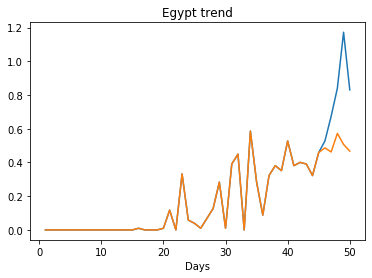

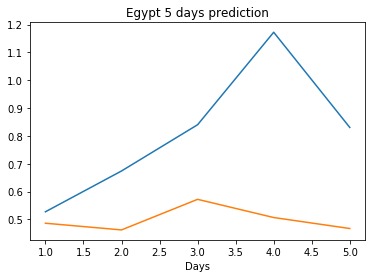

Creating directory ./offline5/United Arab Emirates/training/
United Arab Emirates
Saving the best model weights at Epoch [1], Best Valid Loss: 33.3655
Saving the best model weights at Epoch [2], Best Valid Loss: 25.9176
Saving the best model weights at Epoch [3], Best Valid Loss: 20.0951


/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Saving the best model weights at Epoch [7], Best Valid Loss: 18.2202
Saving the best model weights at Epoch [9], Best Valid Loss: 14.7058
Saving the best model weights at Epoch [10], Best Valid Loss: 14.1469
train error: 0.33384527554435117
14.146867752075195
Saving the best model weights at Epoch [1], Best Valid Loss: 27.0654
Saving the best model weights at Epoch [2], Best Valid Loss: 21.8552
Saving the best model weights at Epoch [3], Best Valid Loss: 12.1583
Saving the best model weights at Epoch [9], Best Valid Loss: 9.4835
train error: 0.2397743480340127
9.483521461486816
Saving the best model weights at Epoch [1], Best Valid Loss: 30.0419
Saving the best model weights at Epoch [2], Best Valid Loss: 23.9830
Saving the best model weights at Epoch [4], Best Valid Loss: 20.0507
Saving the best model weights at Epoch [6], Best Valid Loss: 15.7020
Saving the best model weights at Epoch [7], Best Valid Loss: 14.0243
Saving the best model weights at Epoch [11], Best Valid Loss: 10.7143


Saving the best model weights at Epoch [17], Best Valid Loss: 9.6460
Saving the best model weights at Epoch [18], Best Valid Loss: 9.6388
Saving the best model weights at Epoch [39], Best Valid Loss: 8.8636
train error: 0.7897507387303537
8.863555908203125
Saving the best model weights at Epoch [1], Best Valid Loss: 25.9697
Saving the best model weights at Epoch [3], Best Valid Loss: 22.7550
Saving the best model weights at Epoch [6], Best Valid Loss: 20.9342
Saving the best model weights at Epoch [7], Best Valid Loss: 18.4628
Saving the best model weights at Epoch [8], Best Valid Loss: 16.3049
Saving the best model weights at Epoch [20], Best Valid Loss: 14.0776
Saving the best model weights at Epoch [24], Best Valid Loss: 12.8083
Saving the best model weights at Epoch [25], Best Valid Loss: 9.7857
train error: 1.1874758798268534
9.785664558410645
Saving the best model weights at Epoch [1], Best Valid Loss: 31.9713
Saving the best model weights at Epoch [3], Best Valid Loss: 18.8214
S

Saving the best model weights at Epoch [3], Best Valid Loss: 21.7140
Saving the best model weights at Epoch [4], Best Valid Loss: 14.4541
Saving the best model weights at Epoch [9], Best Valid Loss: 14.0918
Saving the best model weights at Epoch [16], Best Valid Loss: 13.9495
Saving the best model weights at Epoch [18], Best Valid Loss: 12.7725
train error: 0.2930384956961197
12.772454261779785
Saving the best model weights at Epoch [1], Best Valid Loss: 30.3762
Saving the best model weights at Epoch [2], Best Valid Loss: 29.0914
Saving the best model weights at Epoch [3], Best Valid Loss: 18.0012
Saving the best model weights at Epoch [4], Best Valid Loss: 14.7612
Saving the best model weights at Epoch [7], Best Valid Loss: 12.6168
Saving the best model weights at Epoch [9], Best Valid Loss: 9.1981
train error: 0.19770805916238215
9.198103904724121
Saving the best model weights at Epoch [1], Best Valid Loss: 28.8147
Saving the best model weights at Epoch [2], Best Valid Loss: 19.9907


Saving the best model weights at Epoch [7], Best Valid Loss: 13.1259
train error: 3.9046403881042235
13.12589168548584
Saving the best model weights at Epoch [1], Best Valid Loss: 31.5670
Saving the best model weights at Epoch [2], Best Valid Loss: 30.9130
Saving the best model weights at Epoch [3], Best Valid Loss: 30.1131
Saving the best model weights at Epoch [6], Best Valid Loss: 28.6090
Saving the best model weights at Epoch [11], Best Valid Loss: 28.0366
Saving the best model weights at Epoch [13], Best Valid Loss: 27.7655
Saving the best model weights at Epoch [18], Best Valid Loss: 26.9977
Saving the best model weights at Epoch [19], Best Valid Loss: 25.7720
Saving the best model weights at Epoch [20], Best Valid Loss: 18.4347
Saving the best model weights at Epoch [21], Best Valid Loss: 14.0957
Saving the best model weights at Epoch [22], Best Valid Loss: 13.8615
Saving the best model weights at Epoch [24], Best Valid Loss: 13.7511
Saving the best model weights at Epoch [29], 

train error: 3.79755996023455
11.491302490234375
Saving the best model weights at Epoch [1], Best Valid Loss: 30.1382
Saving the best model weights at Epoch [3], Best Valid Loss: 29.9488
Saving the best model weights at Epoch [4], Best Valid Loss: 28.7215
Saving the best model weights at Epoch [32], Best Valid Loss: 28.6340
Saving the best model weights at Epoch [33], Best Valid Loss: 28.6339
train error: 5.305291941089015
28.633930206298828
Saving the best model weights at Epoch [1], Best Valid Loss: 30.9167
Saving the best model weights at Epoch [2], Best Valid Loss: 30.3653
Saving the best model weights at Epoch [3], Best Valid Loss: 30.3311
Saving the best model weights at Epoch [4], Best Valid Loss: 27.0233
Saving the best model weights at Epoch [8], Best Valid Loss: 26.9629
train error: 5.29209146576543
26.962860107421875
Saving the best model weights at Epoch [1], Best Valid Loss: 31.6715
Saving the best model weights at Epoch [2], Best Valid Loss: 30.3921
Saving the best model 

Saving the best model weights at Epoch [6], Best Valid Loss: 28.8664
Saving the best model weights at Epoch [13], Best Valid Loss: 28.8368
Saving the best model weights at Epoch [33], Best Valid Loss: 28.2822
Saving the best model weights at Epoch [38], Best Valid Loss: 27.7911
train error: 5.337986300068517
27.791091918945312
Saving the best model weights at Epoch [1], Best Valid Loss: 29.5285
Saving the best model weights at Epoch [2], Best Valid Loss: 29.0271
Saving the best model weights at Epoch [9], Best Valid Loss: 26.7912
Saving the best model weights at Epoch [16], Best Valid Loss: 26.3870
train error: 5.367832208833387
26.38703727722168
Saving the best model weights at Epoch [1], Best Valid Loss: 37.5082
Saving the best model weights at Epoch [2], Best Valid Loss: 28.4617
Saving the best model weights at Epoch [8], Best Valid Loss: 28.3723
Saving the best model weights at Epoch [14], Best Valid Loss: 26.3441
Saving the best model weights at Epoch [24], Best Valid Loss: 25.636

Saving the best model weights at Epoch [4], Best Valid Loss: 35.9921
Saving the best model weights at Epoch [5], Best Valid Loss: 34.4265
Saving the best model weights at Epoch [6], Best Valid Loss: 33.0428
Saving the best model weights at Epoch [7], Best Valid Loss: 31.8094
Saving the best model weights at Epoch [8], Best Valid Loss: 30.6619
Saving the best model weights at Epoch [9], Best Valid Loss: 29.6505
Saving the best model weights at Epoch [10], Best Valid Loss: 28.7181
Saving the best model weights at Epoch [11], Best Valid Loss: 27.7598
Saving the best model weights at Epoch [12], Best Valid Loss: 26.9342
Saving the best model weights at Epoch [13], Best Valid Loss: 26.1126
Saving the best model weights at Epoch [14], Best Valid Loss: 25.5317
Saving the best model weights at Epoch [15], Best Valid Loss: 25.0442
Saving the best model weights at Epoch [16], Best Valid Loss: 24.4113
Saving the best model weights at Epoch [17], Best Valid Loss: 23.7036
Saving the best model weig

Saving the best model weights at Epoch [4], Best Valid Loss: 32.9218
Saving the best model weights at Epoch [5], Best Valid Loss: 30.6164
Saving the best model weights at Epoch [6], Best Valid Loss: 28.3343
Saving the best model weights at Epoch [7], Best Valid Loss: 26.2811
Saving the best model weights at Epoch [8], Best Valid Loss: 24.3745
Saving the best model weights at Epoch [9], Best Valid Loss: 22.8226
Saving the best model weights at Epoch [10], Best Valid Loss: 21.3924
Saving the best model weights at Epoch [11], Best Valid Loss: 20.1919
Saving the best model weights at Epoch [12], Best Valid Loss: 19.0580
Saving the best model weights at Epoch [13], Best Valid Loss: 18.0080
Saving the best model weights at Epoch [14], Best Valid Loss: 17.2152
Saving the best model weights at Epoch [15], Best Valid Loss: 16.4315
Saving the best model weights at Epoch [16], Best Valid Loss: 15.7437
Saving the best model weights at Epoch [17], Best Valid Loss: 15.1635
Saving the best model weig

train error: 0.1505740111198036
10.877402305603027
Saving the best model weights at Epoch [1], Best Valid Loss: 40.1379
Saving the best model weights at Epoch [2], Best Valid Loss: 36.9063
Saving the best model weights at Epoch [3], Best Valid Loss: 33.5633
Saving the best model weights at Epoch [4], Best Valid Loss: 30.1144
Saving the best model weights at Epoch [5], Best Valid Loss: 26.7121
Saving the best model weights at Epoch [6], Best Valid Loss: 23.4456
Saving the best model weights at Epoch [7], Best Valid Loss: 20.7374
Saving the best model weights at Epoch [8], Best Valid Loss: 18.3168
Saving the best model weights at Epoch [9], Best Valid Loss: 16.6680
Saving the best model weights at Epoch [10], Best Valid Loss: 15.3029
Saving the best model weights at Epoch [11], Best Valid Loss: 14.4827
Saving the best model weights at Epoch [12], Best Valid Loss: 13.9470
Saving the best model weights at Epoch [13], Best Valid Loss: 13.7228
Saving the best model weights at Epoch [14], Bes

Saving the best model weights at Epoch [26], Best Valid Loss: 29.4352
Saving the best model weights at Epoch [27], Best Valid Loss: 29.4132
Saving the best model weights at Epoch [28], Best Valid Loss: 29.4076
Saving the best model weights at Epoch [29], Best Valid Loss: 29.3498
Saving the best model weights at Epoch [30], Best Valid Loss: 29.2974
Saving the best model weights at Epoch [31], Best Valid Loss: 29.2163
Saving the best model weights at Epoch [32], Best Valid Loss: 29.1181
Saving the best model weights at Epoch [33], Best Valid Loss: 28.9195
Saving the best model weights at Epoch [34], Best Valid Loss: 28.7802
Saving the best model weights at Epoch [35], Best Valid Loss: 28.6177
Saving the best model weights at Epoch [36], Best Valid Loss: 28.3867
Saving the best model weights at Epoch [37], Best Valid Loss: 28.1614
Saving the best model weights at Epoch [38], Best Valid Loss: 27.9181
Saving the best model weights at Epoch [39], Best Valid Loss: 27.5715
Saving the best mode

Saving the best model weights at Epoch [6], Best Valid Loss: 34.9029
Saving the best model weights at Epoch [7], Best Valid Loss: 34.0277
Saving the best model weights at Epoch [8], Best Valid Loss: 33.3182
Saving the best model weights at Epoch [9], Best Valid Loss: 32.7481
Saving the best model weights at Epoch [10], Best Valid Loss: 32.2060
Saving the best model weights at Epoch [11], Best Valid Loss: 31.7528
Saving the best model weights at Epoch [12], Best Valid Loss: 31.3273
Saving the best model weights at Epoch [13], Best Valid Loss: 31.0014
Saving the best model weights at Epoch [14], Best Valid Loss: 30.6764
Saving the best model weights at Epoch [15], Best Valid Loss: 30.4321
Saving the best model weights at Epoch [16], Best Valid Loss: 30.1696
Saving the best model weights at Epoch [17], Best Valid Loss: 29.9270
Saving the best model weights at Epoch [18], Best Valid Loss: 29.7189
Saving the best model weights at Epoch [19], Best Valid Loss: 29.5095
Saving the best model we

Saving the best model weights at Epoch [22], Best Valid Loss: 24.1364
Saving the best model weights at Epoch [23], Best Valid Loss: 23.0103
Saving the best model weights at Epoch [24], Best Valid Loss: 21.1801
Saving the best model weights at Epoch [25], Best Valid Loss: 19.7962
Saving the best model weights at Epoch [26], Best Valid Loss: 18.1283
Saving the best model weights at Epoch [27], Best Valid Loss: 16.6994
Saving the best model weights at Epoch [28], Best Valid Loss: 15.5885
Saving the best model weights at Epoch [29], Best Valid Loss: 14.7824
Saving the best model weights at Epoch [30], Best Valid Loss: 14.2518
Saving the best model weights at Epoch [31], Best Valid Loss: 13.7714
Saving the best model weights at Epoch [33], Best Valid Loss: 13.5722
train error: 2.0329733952399223
13.572165489196777
Saving the best model weights at Epoch [1], Best Valid Loss: 38.9545
Saving the best model weights at Epoch [2], Best Valid Loss: 35.0845
Saving the best model weights at Epoch [3

Saving the best model weights at Epoch [28], Best Valid Loss: 24.2798
Saving the best model weights at Epoch [29], Best Valid Loss: 23.5864
Saving the best model weights at Epoch [30], Best Valid Loss: 22.6796
Saving the best model weights at Epoch [31], Best Valid Loss: 21.7223
Saving the best model weights at Epoch [32], Best Valid Loss: 20.8194
Saving the best model weights at Epoch [33], Best Valid Loss: 19.5964
Saving the best model weights at Epoch [34], Best Valid Loss: 18.6389
Saving the best model weights at Epoch [35], Best Valid Loss: 17.4436
Saving the best model weights at Epoch [36], Best Valid Loss: 16.5213
Saving the best model weights at Epoch [37], Best Valid Loss: 15.6039
Saving the best model weights at Epoch [38], Best Valid Loss: 14.9173
Saving the best model weights at Epoch [39], Best Valid Loss: 14.3982
Saving the best model weights at Epoch [40], Best Valid Loss: 13.9607
Saving the best model weights at Epoch [41], Best Valid Loss: 13.7405
Saving the best mode

Saving the best model weights at Epoch [45], Best Valid Loss: 14.3194
Saving the best model weights at Epoch [46], Best Valid Loss: 13.9834
Saving the best model weights at Epoch [47], Best Valid Loss: 13.7858
Saving the best model weights at Epoch [48], Best Valid Loss: 13.6897
train error: 2.5116873160004616
13.689659118652344
Saving the best model weights at Epoch [1], Best Valid Loss: 40.1872
Saving the best model weights at Epoch [2], Best Valid Loss: 38.0429
Saving the best model weights at Epoch [3], Best Valid Loss: 36.3203
Saving the best model weights at Epoch [4], Best Valid Loss: 35.0683
Saving the best model weights at Epoch [5], Best Valid Loss: 33.8197
Saving the best model weights at Epoch [6], Best Valid Loss: 32.9086
Saving the best model weights at Epoch [7], Best Valid Loss: 32.1325
Saving the best model weights at Epoch [8], Best Valid Loss: 31.4610
Saving the best model weights at Epoch [9], Best Valid Loss: 30.9052
Saving the best model weights at Epoch [10], Bes

Saving the best model weights at Epoch [28], Best Valid Loss: 29.9586
Saving the best model weights at Epoch [29], Best Valid Loss: 29.9515
Saving the best model weights at Epoch [31], Best Valid Loss: 29.9478
Saving the best model weights at Epoch [33], Best Valid Loss: 29.9059
Saving the best model weights at Epoch [35], Best Valid Loss: 29.8896
Saving the best model weights at Epoch [36], Best Valid Loss: 29.8647
Saving the best model weights at Epoch [38], Best Valid Loss: 29.8438
Saving the best model weights at Epoch [41], Best Valid Loss: 29.8265
Saving the best model weights at Epoch [42], Best Valid Loss: 29.8183
Saving the best model weights at Epoch [43], Best Valid Loss: 29.8113
Saving the best model weights at Epoch [45], Best Valid Loss: 29.7859
Saving the best model weights at Epoch [46], Best Valid Loss: 29.7718
Saving the best model weights at Epoch [47], Best Valid Loss: 29.7578
Saving the best model weights at Epoch [48], Best Valid Loss: 29.7311
train error: 5.12557

Saving the best model weights at Epoch [22], Best Valid Loss: 30.1944
Saving the best model weights at Epoch [23], Best Valid Loss: 30.1613
Saving the best model weights at Epoch [24], Best Valid Loss: 30.1045
Saving the best model weights at Epoch [25], Best Valid Loss: 30.0451
Saving the best model weights at Epoch [26], Best Valid Loss: 29.9945
Saving the best model weights at Epoch [27], Best Valid Loss: 29.9477
Saving the best model weights at Epoch [28], Best Valid Loss: 29.9193
Saving the best model weights at Epoch [29], Best Valid Loss: 29.8952
Saving the best model weights at Epoch [30], Best Valid Loss: 29.8735
Saving the best model weights at Epoch [31], Best Valid Loss: 29.8730
Saving the best model weights at Epoch [32], Best Valid Loss: 29.8543
Saving the best model weights at Epoch [33], Best Valid Loss: 29.8448
Saving the best model weights at Epoch [34], Best Valid Loss: 29.7943
Saving the best model weights at Epoch [39], Best Valid Loss: 29.7897
Saving the best mode

Saving the best model weights at Epoch [15], Best Valid Loss: 30.9681
Saving the best model weights at Epoch [16], Best Valid Loss: 30.7884
Saving the best model weights at Epoch [17], Best Valid Loss: 30.6342
Saving the best model weights at Epoch [18], Best Valid Loss: 30.5131
Saving the best model weights at Epoch [19], Best Valid Loss: 30.3593
Saving the best model weights at Epoch [20], Best Valid Loss: 30.2734
Saving the best model weights at Epoch [21], Best Valid Loss: 30.2335
Saving the best model weights at Epoch [22], Best Valid Loss: 30.1787
Saving the best model weights at Epoch [23], Best Valid Loss: 30.0983
Saving the best model weights at Epoch [24], Best Valid Loss: 30.0572
Saving the best model weights at Epoch [25], Best Valid Loss: 30.0334
Saving the best model weights at Epoch [26], Best Valid Loss: 29.9781
Saving the best model weights at Epoch [28], Best Valid Loss: 29.9566
Saving the best model weights at Epoch [29], Best Valid Loss: 29.8990
Saving the best mode

Saving the best model weights at Epoch [14], Best Valid Loss: 31.0942
Saving the best model weights at Epoch [15], Best Valid Loss: 30.9173
Saving the best model weights at Epoch [16], Best Valid Loss: 30.7134
Saving the best model weights at Epoch [17], Best Valid Loss: 30.5801
Saving the best model weights at Epoch [18], Best Valid Loss: 30.4470
Saving the best model weights at Epoch [19], Best Valid Loss: 30.3232
Saving the best model weights at Epoch [20], Best Valid Loss: 30.2340
Saving the best model weights at Epoch [21], Best Valid Loss: 30.1387
Saving the best model weights at Epoch [22], Best Valid Loss: 30.1161
Saving the best model weights at Epoch [23], Best Valid Loss: 30.0501
Saving the best model weights at Epoch [24], Best Valid Loss: 30.0191
Saving the best model weights at Epoch [25], Best Valid Loss: 29.9811
Saving the best model weights at Epoch [26], Best Valid Loss: 29.9218
Saving the best model weights at Epoch [27], Best Valid Loss: 29.9046
Saving the best mode

train error: 2.0148376990710535
12.16342830657959
Saving the best model weights at Epoch [1], Best Valid Loss: 41.7118
Saving the best model weights at Epoch [2], Best Valid Loss: 39.9575
Saving the best model weights at Epoch [3], Best Valid Loss: 38.4530
Saving the best model weights at Epoch [4], Best Valid Loss: 37.1733
Saving the best model weights at Epoch [5], Best Valid Loss: 36.1167
Saving the best model weights at Epoch [6], Best Valid Loss: 35.2175
Saving the best model weights at Epoch [7], Best Valid Loss: 34.4452
Saving the best model weights at Epoch [8], Best Valid Loss: 33.7342
Saving the best model weights at Epoch [9], Best Valid Loss: 33.1456
Saving the best model weights at Epoch [10], Best Valid Loss: 32.6820
Saving the best model weights at Epoch [11], Best Valid Loss: 32.2721
Saving the best model weights at Epoch [12], Best Valid Loss: 31.8993
Saving the best model weights at Epoch [13], Best Valid Loss: 31.5908
Saving the best model weights at Epoch [14], Best

Saving the best model weights at Epoch [10], Best Valid Loss: 32.4888
Saving the best model weights at Epoch [11], Best Valid Loss: 32.0460
Saving the best model weights at Epoch [12], Best Valid Loss: 31.7153
Saving the best model weights at Epoch [13], Best Valid Loss: 31.4272
Saving the best model weights at Epoch [14], Best Valid Loss: 31.1915
Saving the best model weights at Epoch [15], Best Valid Loss: 30.9775
Saving the best model weights at Epoch [16], Best Valid Loss: 30.7862
Saving the best model weights at Epoch [17], Best Valid Loss: 30.6403
Saving the best model weights at Epoch [18], Best Valid Loss: 30.5002
Saving the best model weights at Epoch [19], Best Valid Loss: 30.3747
Saving the best model weights at Epoch [20], Best Valid Loss: 30.2986
Saving the best model weights at Epoch [21], Best Valid Loss: 30.1704
Saving the best model weights at Epoch [22], Best Valid Loss: 30.1006
Saving the best model weights at Epoch [23], Best Valid Loss: 30.0714
Saving the best mode

Saving the best model weights at Epoch [1], Best Valid Loss: 41.3608
Saving the best model weights at Epoch [2], Best Valid Loss: 39.2155
Saving the best model weights at Epoch [3], Best Valid Loss: 37.3453
Saving the best model weights at Epoch [4], Best Valid Loss: 35.9556
Saving the best model weights at Epoch [5], Best Valid Loss: 34.7304
Saving the best model weights at Epoch [6], Best Valid Loss: 33.7882
Saving the best model weights at Epoch [7], Best Valid Loss: 33.0762
Saving the best model weights at Epoch [8], Best Valid Loss: 32.4852
Saving the best model weights at Epoch [9], Best Valid Loss: 31.9873
Saving the best model weights at Epoch [10], Best Valid Loss: 31.5726
Saving the best model weights at Epoch [11], Best Valid Loss: 31.3281
Saving the best model weights at Epoch [12], Best Valid Loss: 31.0056
Saving the best model weights at Epoch [13], Best Valid Loss: 30.8346
Saving the best model weights at Epoch [14], Best Valid Loss: 30.5960
Saving the best model weights

Saving the best model weights at Epoch [16], Best Valid Loss: 30.2393
Saving the best model weights at Epoch [17], Best Valid Loss: 30.1521
Saving the best model weights at Epoch [18], Best Valid Loss: 30.1479
Saving the best model weights at Epoch [19], Best Valid Loss: 30.0087
Saving the best model weights at Epoch [20], Best Valid Loss: 29.9814
Saving the best model weights at Epoch [21], Best Valid Loss: 29.9196
Saving the best model weights at Epoch [25], Best Valid Loss: 29.8580
Saving the best model weights at Epoch [26], Best Valid Loss: 29.7742
Saving the best model weights at Epoch [27], Best Valid Loss: 29.7698
Saving the best model weights at Epoch [28], Best Valid Loss: 29.7103
Saving the best model weights at Epoch [29], Best Valid Loss: 29.6970
train error: 5.137903771092815
29.697025299072266
Saving the best model weights at Epoch [1], Best Valid Loss: 40.1270
Saving the best model weights at Epoch [2], Best Valid Loss: 37.3904
Saving the best model weights at Epoch [3]

Saving the best model weights at Epoch [10], Best Valid Loss: 30.6142
Saving the best model weights at Epoch [11], Best Valid Loss: 30.3964
Saving the best model weights at Epoch [12], Best Valid Loss: 30.1752
Saving the best model weights at Epoch [13], Best Valid Loss: 30.1157
Saving the best model weights at Epoch [14], Best Valid Loss: 30.0872
Saving the best model weights at Epoch [15], Best Valid Loss: 29.9059
Saving the best model weights at Epoch [19], Best Valid Loss: 29.8553
Saving the best model weights at Epoch [21], Best Valid Loss: 29.8539
Saving the best model weights at Epoch [29], Best Valid Loss: 29.7811
Saving the best model weights at Epoch [33], Best Valid Loss: 29.7378
train error: 5.150976257939493
29.737812042236328
Saving the best model weights at Epoch [1], Best Valid Loss: 38.6749
Saving the best model weights at Epoch [2], Best Valid Loss: 35.4575
Saving the best model weights at Epoch [3], Best Valid Loss: 32.9260
Saving the best model weights at Epoch [4],

Saving the best model weights at Epoch [6], Best Valid Loss: 30.4761
Saving the best model weights at Epoch [7], Best Valid Loss: 30.0936
Saving the best model weights at Epoch [9], Best Valid Loss: 29.9367
Saving the best model weights at Epoch [10], Best Valid Loss: 29.8972
Saving the best model weights at Epoch [11], Best Valid Loss: 29.7663
Saving the best model weights at Epoch [12], Best Valid Loss: 29.7556
Saving the best model weights at Epoch [14], Best Valid Loss: 29.6937
train error: 5.152527091964599
29.69373893737793
Saving the best model weights at Epoch [1], Best Valid Loss: 34.6618
Saving the best model weights at Epoch [2], Best Valid Loss: 28.3606
train error: 5.182155099607283
28.360563278198242
Saving the best model weights at Epoch [1], Best Valid Loss: 40.8880
Saving the best model weights at Epoch [2], Best Valid Loss: 39.1433
Saving the best model weights at Epoch [3], Best Valid Loss: 37.6891
Saving the best model weights at Epoch [4], Best Valid Loss: 36.4456


train error: 5.259743903913805
28.328027725219727
Saving the best model weights at Epoch [1], Best Valid Loss: 41.5913
Saving the best model weights at Epoch [2], Best Valid Loss: 39.8259
Saving the best model weights at Epoch [3], Best Valid Loss: 38.3335
Saving the best model weights at Epoch [4], Best Valid Loss: 37.0347
Saving the best model weights at Epoch [5], Best Valid Loss: 35.9291
Saving the best model weights at Epoch [6], Best Valid Loss: 35.0231
Saving the best model weights at Epoch [7], Best Valid Loss: 34.2394
Saving the best model weights at Epoch [8], Best Valid Loss: 33.5949
Saving the best model weights at Epoch [9], Best Valid Loss: 33.0151
Saving the best model weights at Epoch [10], Best Valid Loss: 32.5207
Saving the best model weights at Epoch [11], Best Valid Loss: 32.1152
Saving the best model weights at Epoch [12], Best Valid Loss: 31.7715
Saving the best model weights at Epoch [13], Best Valid Loss: 31.4833
Saving the best model weights at Epoch [14], Best

Saving the best model weights at Epoch [19], Best Valid Loss: 39.3710
Saving the best model weights at Epoch [20], Best Valid Loss: 39.1182
Saving the best model weights at Epoch [21], Best Valid Loss: 38.8657
Saving the best model weights at Epoch [22], Best Valid Loss: 38.6112
Saving the best model weights at Epoch [23], Best Valid Loss: 38.3539
Saving the best model weights at Epoch [24], Best Valid Loss: 38.0982
Saving the best model weights at Epoch [25], Best Valid Loss: 37.8321
Saving the best model weights at Epoch [26], Best Valid Loss: 37.5706
Saving the best model weights at Epoch [27], Best Valid Loss: 37.3034
Saving the best model weights at Epoch [28], Best Valid Loss: 37.0309
Saving the best model weights at Epoch [29], Best Valid Loss: 36.7588
Saving the best model weights at Epoch [30], Best Valid Loss: 36.4874
Saving the best model weights at Epoch [31], Best Valid Loss: 36.2173
Saving the best model weights at Epoch [32], Best Valid Loss: 35.9510
Saving the best mode

Saving the best model weights at Epoch [35], Best Valid Loss: 33.3195
Saving the best model weights at Epoch [36], Best Valid Loss: 33.1547
Saving the best model weights at Epoch [37], Best Valid Loss: 32.9898
Saving the best model weights at Epoch [38], Best Valid Loss: 32.8154
Saving the best model weights at Epoch [39], Best Valid Loss: 32.6708
Saving the best model weights at Epoch [40], Best Valid Loss: 32.5006
Saving the best model weights at Epoch [41], Best Valid Loss: 32.3205
Saving the best model weights at Epoch [42], Best Valid Loss: 32.1355
Saving the best model weights at Epoch [43], Best Valid Loss: 31.9583
Saving the best model weights at Epoch [44], Best Valid Loss: 31.7971
Saving the best model weights at Epoch [45], Best Valid Loss: 31.6222
Saving the best model weights at Epoch [46], Best Valid Loss: 31.4508
Saving the best model weights at Epoch [47], Best Valid Loss: 31.2799
Saving the best model weights at Epoch [48], Best Valid Loss: 31.1142
Saving the best mode

Saving the best model weights at Epoch [15], Best Valid Loss: 39.6532
Saving the best model weights at Epoch [16], Best Valid Loss: 39.3932
Saving the best model weights at Epoch [17], Best Valid Loss: 39.1384
Saving the best model weights at Epoch [18], Best Valid Loss: 38.8867
Saving the best model weights at Epoch [19], Best Valid Loss: 38.6368
Saving the best model weights at Epoch [20], Best Valid Loss: 38.3901
Saving the best model weights at Epoch [21], Best Valid Loss: 38.1453
Saving the best model weights at Epoch [22], Best Valid Loss: 37.9028
Saving the best model weights at Epoch [23], Best Valid Loss: 37.6621
Saving the best model weights at Epoch [24], Best Valid Loss: 37.4241
Saving the best model weights at Epoch [25], Best Valid Loss: 37.1865
Saving the best model weights at Epoch [26], Best Valid Loss: 36.9511
Saving the best model weights at Epoch [27], Best Valid Loss: 36.7174
Saving the best model weights at Epoch [28], Best Valid Loss: 36.4852
Saving the best mode

Saving the best model weights at Epoch [32], Best Valid Loss: 28.1494
Saving the best model weights at Epoch [33], Best Valid Loss: 27.6859
Saving the best model weights at Epoch [34], Best Valid Loss: 27.2402
Saving the best model weights at Epoch [35], Best Valid Loss: 26.8812
Saving the best model weights at Epoch [36], Best Valid Loss: 26.3975
Saving the best model weights at Epoch [37], Best Valid Loss: 26.0021
Saving the best model weights at Epoch [38], Best Valid Loss: 25.5225
Saving the best model weights at Epoch [39], Best Valid Loss: 25.1484
Saving the best model weights at Epoch [40], Best Valid Loss: 24.7822
Saving the best model weights at Epoch [41], Best Valid Loss: 24.3466
Saving the best model weights at Epoch [42], Best Valid Loss: 23.9698
Saving the best model weights at Epoch [43], Best Valid Loss: 23.5880
Saving the best model weights at Epoch [44], Best Valid Loss: 23.2301
Saving the best model weights at Epoch [45], Best Valid Loss: 22.8834
Saving the best mode

Saving the best model weights at Epoch [30], Best Valid Loss: 34.5149
Saving the best model weights at Epoch [31], Best Valid Loss: 34.2217
Saving the best model weights at Epoch [32], Best Valid Loss: 33.9290
Saving the best model weights at Epoch [33], Best Valid Loss: 33.6362
Saving the best model weights at Epoch [34], Best Valid Loss: 33.3432
Saving the best model weights at Epoch [35], Best Valid Loss: 33.0543
Saving the best model weights at Epoch [36], Best Valid Loss: 32.7594
Saving the best model weights at Epoch [37], Best Valid Loss: 32.4687
Saving the best model weights at Epoch [38], Best Valid Loss: 32.1775
Saving the best model weights at Epoch [39], Best Valid Loss: 31.8874
Saving the best model weights at Epoch [40], Best Valid Loss: 31.5985
Saving the best model weights at Epoch [41], Best Valid Loss: 31.3173
Saving the best model weights at Epoch [42], Best Valid Loss: 31.0208
Saving the best model weights at Epoch [43], Best Valid Loss: 30.7431
Saving the best mode

Saving the best model weights at Epoch [46], Best Valid Loss: 19.4614
Saving the best model weights at Epoch [47], Best Valid Loss: 19.1309
Saving the best model weights at Epoch [48], Best Valid Loss: 18.8344
Saving the best model weights at Epoch [49], Best Valid Loss: 18.5356
Saving the best model weights at Epoch [50], Best Valid Loss: 18.2836
train error: 3.7998407050486533
18.28359603881836
Saving the best model weights at Epoch [1], Best Valid Loss: 42.3110
Saving the best model weights at Epoch [2], Best Valid Loss: 41.1885
Saving the best model weights at Epoch [3], Best Valid Loss: 40.1499
Saving the best model weights at Epoch [4], Best Valid Loss: 39.0655
Saving the best model weights at Epoch [5], Best Valid Loss: 37.9864
Saving the best model weights at Epoch [6], Best Valid Loss: 36.9343
Saving the best model weights at Epoch [7], Best Valid Loss: 35.9261
Saving the best model weights at Epoch [8], Best Valid Loss: 34.8239
Saving the best model weights at Epoch [9], Best

Saving the best model weights at Epoch [42], Best Valid Loss: 28.7066
Saving the best model weights at Epoch [43], Best Valid Loss: 28.3704
Saving the best model weights at Epoch [44], Best Valid Loss: 28.0412
Saving the best model weights at Epoch [45], Best Valid Loss: 27.7175
Saving the best model weights at Epoch [46], Best Valid Loss: 27.3839
Saving the best model weights at Epoch [47], Best Valid Loss: 27.0584
Saving the best model weights at Epoch [48], Best Valid Loss: 26.7344
Saving the best model weights at Epoch [49], Best Valid Loss: 26.4112
Saving the best model weights at Epoch [50], Best Valid Loss: 26.0913
train error: 4.620607746224249
26.091266632080078
Saving the best model weights at Epoch [1], Best Valid Loss: 43.3524
Saving the best model weights at Epoch [2], Best Valid Loss: 42.8267
Saving the best model weights at Epoch [3], Best Valid Loss: 42.3201
Saving the best model weights at Epoch [4], Best Valid Loss: 41.8328
Saving the best model weights at Epoch [5], 

Saving the best model weights at Epoch [9], Best Valid Loss: 34.7589
Saving the best model weights at Epoch [10], Best Valid Loss: 33.6132
Saving the best model weights at Epoch [11], Best Valid Loss: 32.5865
Saving the best model weights at Epoch [12], Best Valid Loss: 31.5841
Saving the best model weights at Epoch [13], Best Valid Loss: 30.5576
Saving the best model weights at Epoch [14], Best Valid Loss: 29.5731
Saving the best model weights at Epoch [15], Best Valid Loss: 28.6170
Saving the best model weights at Epoch [16], Best Valid Loss: 27.5719
Saving the best model weights at Epoch [17], Best Valid Loss: 26.5786
Saving the best model weights at Epoch [18], Best Valid Loss: 25.8843
Saving the best model weights at Epoch [19], Best Valid Loss: 24.6651
Saving the best model weights at Epoch [20], Best Valid Loss: 23.9045
Saving the best model weights at Epoch [21], Best Valid Loss: 22.9355
Saving the best model weights at Epoch [22], Best Valid Loss: 22.0422
Saving the best model

Saving the best model weights at Epoch [13], Best Valid Loss: 39.2645
Saving the best model weights at Epoch [14], Best Valid Loss: 39.0639
Saving the best model weights at Epoch [15], Best Valid Loss: 38.8790
Saving the best model weights at Epoch [16], Best Valid Loss: 38.6793
Saving the best model weights at Epoch [17], Best Valid Loss: 38.4926
Saving the best model weights at Epoch [18], Best Valid Loss: 38.3113
Saving the best model weights at Epoch [19], Best Valid Loss: 38.1328
Saving the best model weights at Epoch [20], Best Valid Loss: 37.9566
Saving the best model weights at Epoch [21], Best Valid Loss: 37.7856
Saving the best model weights at Epoch [22], Best Valid Loss: 37.6185
Saving the best model weights at Epoch [23], Best Valid Loss: 37.4560
Saving the best model weights at Epoch [24], Best Valid Loss: 37.2944
Saving the best model weights at Epoch [25], Best Valid Loss: 37.1381
Saving the best model weights at Epoch [26], Best Valid Loss: 36.9850
Saving the best mode

Saving the best model weights at Epoch [30], Best Valid Loss: 32.7492
Saving the best model weights at Epoch [31], Best Valid Loss: 32.6093
Saving the best model weights at Epoch [32], Best Valid Loss: 32.5142
Saving the best model weights at Epoch [33], Best Valid Loss: 32.3514
Saving the best model weights at Epoch [34], Best Valid Loss: 32.2451
Saving the best model weights at Epoch [35], Best Valid Loss: 32.1820
Saving the best model weights at Epoch [36], Best Valid Loss: 32.0061
Saving the best model weights at Epoch [37], Best Valid Loss: 31.9607
Saving the best model weights at Epoch [38], Best Valid Loss: 31.8553
Saving the best model weights at Epoch [39], Best Valid Loss: 31.7185
Saving the best model weights at Epoch [40], Best Valid Loss: 31.6690
Saving the best model weights at Epoch [41], Best Valid Loss: 31.5711
Saving the best model weights at Epoch [42], Best Valid Loss: 31.4631
Saving the best model weights at Epoch [43], Best Valid Loss: 31.3965
Saving the best mode

Saving the best model weights at Epoch [19], Best Valid Loss: 38.8927
Saving the best model weights at Epoch [20], Best Valid Loss: 38.6976
Saving the best model weights at Epoch [21], Best Valid Loss: 38.5048
Saving the best model weights at Epoch [22], Best Valid Loss: 38.3203
Saving the best model weights at Epoch [23], Best Valid Loss: 38.1363
Saving the best model weights at Epoch [24], Best Valid Loss: 37.9556
Saving the best model weights at Epoch [25], Best Valid Loss: 37.7794
Saving the best model weights at Epoch [26], Best Valid Loss: 37.6069
Saving the best model weights at Epoch [27], Best Valid Loss: 37.4385
Saving the best model weights at Epoch [28], Best Valid Loss: 37.2750
Saving the best model weights at Epoch [29], Best Valid Loss: 37.1130
Saving the best model weights at Epoch [30], Best Valid Loss: 36.9623
Saving the best model weights at Epoch [31], Best Valid Loss: 36.7983
Saving the best model weights at Epoch [32], Best Valid Loss: 36.6455
Saving the best mode

Saving the best model weights at Epoch [36], Best Valid Loss: 31.5611
Saving the best model weights at Epoch [37], Best Valid Loss: 31.4313
Saving the best model weights at Epoch [38], Best Valid Loss: 31.3503
Saving the best model weights at Epoch [39], Best Valid Loss: 31.2101
Saving the best model weights at Epoch [40], Best Valid Loss: 31.1063
Saving the best model weights at Epoch [41], Best Valid Loss: 30.9805
Saving the best model weights at Epoch [42], Best Valid Loss: 30.9231
Saving the best model weights at Epoch [43], Best Valid Loss: 30.7992
Saving the best model weights at Epoch [44], Best Valid Loss: 30.6659
Saving the best model weights at Epoch [45], Best Valid Loss: 30.5963
Saving the best model weights at Epoch [46], Best Valid Loss: 30.5187
Saving the best model weights at Epoch [47], Best Valid Loss: 30.4848
Saving the best model weights at Epoch [48], Best Valid Loss: 30.3381
Saving the best model weights at Epoch [49], Best Valid Loss: 30.2499
Saving the best mode

Saving the best model weights at Epoch [8], Best Valid Loss: 40.8152
Saving the best model weights at Epoch [9], Best Valid Loss: 40.5814
Saving the best model weights at Epoch [10], Best Valid Loss: 40.3510
Saving the best model weights at Epoch [11], Best Valid Loss: 40.1267
Saving the best model weights at Epoch [12], Best Valid Loss: 39.9055
Saving the best model weights at Epoch [13], Best Valid Loss: 39.6905
Saving the best model weights at Epoch [14], Best Valid Loss: 39.4790
Saving the best model weights at Epoch [15], Best Valid Loss: 39.2743
Saving the best model weights at Epoch [16], Best Valid Loss: 39.0785
Saving the best model weights at Epoch [17], Best Valid Loss: 38.8804
Saving the best model weights at Epoch [18], Best Valid Loss: 38.6821
Saving the best model weights at Epoch [19], Best Valid Loss: 38.4996
Saving the best model weights at Epoch [20], Best Valid Loss: 38.3109
Saving the best model weights at Epoch [21], Best Valid Loss: 38.1237
Saving the best model 

Saving the best model weights at Epoch [25], Best Valid Loss: 33.4757
Saving the best model weights at Epoch [26], Best Valid Loss: 33.2307
Saving the best model weights at Epoch [27], Best Valid Loss: 33.0574
Saving the best model weights at Epoch [28], Best Valid Loss: 32.8617
Saving the best model weights at Epoch [29], Best Valid Loss: 32.6876
Saving the best model weights at Epoch [30], Best Valid Loss: 32.5088
Saving the best model weights at Epoch [31], Best Valid Loss: 32.3101
Saving the best model weights at Epoch [32], Best Valid Loss: 32.1781
Saving the best model weights at Epoch [33], Best Valid Loss: 32.0245
Saving the best model weights at Epoch [34], Best Valid Loss: 31.9261
Saving the best model weights at Epoch [35], Best Valid Loss: 31.7825
Saving the best model weights at Epoch [36], Best Valid Loss: 31.6355
Saving the best model weights at Epoch [37], Best Valid Loss: 31.5214
Saving the best model weights at Epoch [38], Best Valid Loss: 31.3690
Saving the best mode

Saving the best model weights at Epoch [42], Best Valid Loss: 36.7034
Saving the best model weights at Epoch [43], Best Valid Loss: 36.5844
Saving the best model weights at Epoch [44], Best Valid Loss: 36.4689
Saving the best model weights at Epoch [45], Best Valid Loss: 36.3507
Saving the best model weights at Epoch [46], Best Valid Loss: 36.2372
Saving the best model weights at Epoch [47], Best Valid Loss: 36.1246
Saving the best model weights at Epoch [48], Best Valid Loss: 36.0141
Saving the best model weights at Epoch [49], Best Valid Loss: 35.9053
Saving the best model weights at Epoch [50], Best Valid Loss: 35.7971
train error: 5.516409977789848
35.7971305847168
Saving the best model weights at Epoch [1], Best Valid Loss: 43.1076
Saving the best model weights at Epoch [2], Best Valid Loss: 42.8114
Saving the best model weights at Epoch [3], Best Valid Loss: 42.5181
Saving the best model weights at Epoch [4], Best Valid Loss: 42.2341
Saving the best model weights at Epoch [5], Be

Saving the best model weights at Epoch [9], Best Valid Loss: 38.3003
Saving the best model weights at Epoch [10], Best Valid Loss: 37.8441
Saving the best model weights at Epoch [11], Best Valid Loss: 37.4264
Saving the best model weights at Epoch [12], Best Valid Loss: 37.0642
Saving the best model weights at Epoch [13], Best Valid Loss: 36.6576
Saving the best model weights at Epoch [14], Best Valid Loss: 36.3220
Saving the best model weights at Epoch [15], Best Valid Loss: 35.9258
Saving the best model weights at Epoch [16], Best Valid Loss: 35.6713
Saving the best model weights at Epoch [17], Best Valid Loss: 35.2929
Saving the best model weights at Epoch [18], Best Valid Loss: 34.9864
Saving the best model weights at Epoch [19], Best Valid Loss: 34.7190
Saving the best model weights at Epoch [20], Best Valid Loss: 34.4391
Saving the best model weights at Epoch [21], Best Valid Loss: 34.1895
Saving the best model weights at Epoch [22], Best Valid Loss: 33.9131
Saving the best model

Saving the best model weights at Epoch [27], Best Valid Loss: 37.5238
Saving the best model weights at Epoch [28], Best Valid Loss: 37.4016
Saving the best model weights at Epoch [29], Best Valid Loss: 37.2821
Saving the best model weights at Epoch [30], Best Valid Loss: 37.1645
Saving the best model weights at Epoch [31], Best Valid Loss: 37.0494
Saving the best model weights at Epoch [32], Best Valid Loss: 36.9354
Saving the best model weights at Epoch [33], Best Valid Loss: 36.8236
Saving the best model weights at Epoch [34], Best Valid Loss: 36.7132
Saving the best model weights at Epoch [35], Best Valid Loss: 36.6052
Saving the best model weights at Epoch [36], Best Valid Loss: 36.5014
Saving the best model weights at Epoch [37], Best Valid Loss: 36.3965
Saving the best model weights at Epoch [38], Best Valid Loss: 36.2910
Saving the best model weights at Epoch [39], Best Valid Loss: 36.1922
Saving the best model weights at Epoch [40], Best Valid Loss: 36.0901
Saving the best mode

Saving the best model weights at Epoch [44], Best Valid Loss: 33.5130
Saving the best model weights at Epoch [45], Best Valid Loss: 33.4192
Saving the best model weights at Epoch [46], Best Valid Loss: 33.3000
Saving the best model weights at Epoch [47], Best Valid Loss: 33.1934
Saving the best model weights at Epoch [48], Best Valid Loss: 33.0872
Saving the best model weights at Epoch [49], Best Valid Loss: 32.9908
Saving the best model weights at Epoch [50], Best Valid Loss: 32.8971
train error: 5.2449143163619505
32.8970947265625
Saving the best model weights at Epoch [1], Best Valid Loss: 42.4358
Saving the best model weights at Epoch [2], Best Valid Loss: 41.8511
Saving the best model weights at Epoch [3], Best Valid Loss: 41.2184
Saving the best model weights at Epoch [4], Best Valid Loss: 40.7662
Saving the best model weights at Epoch [5], Best Valid Loss: 40.1731
Saving the best model weights at Epoch [6], Best Valid Loss: 39.6493
Saving the best model weights at Epoch [7], Bes

Saving the best model weights at Epoch [36], Best Valid Loss: 36.9146
Saving the best model weights at Epoch [37], Best Valid Loss: 36.7960
Saving the best model weights at Epoch [38], Best Valid Loss: 36.6796
Saving the best model weights at Epoch [39], Best Valid Loss: 36.5648
Saving the best model weights at Epoch [40], Best Valid Loss: 36.4517
Saving the best model weights at Epoch [41], Best Valid Loss: 36.3406
Saving the best model weights at Epoch [42], Best Valid Loss: 36.2320
Saving the best model weights at Epoch [43], Best Valid Loss: 36.1240
Saving the best model weights at Epoch [44], Best Valid Loss: 36.0187
Saving the best model weights at Epoch [45], Best Valid Loss: 35.9149
Saving the best model weights at Epoch [46], Best Valid Loss: 35.8124
Saving the best model weights at Epoch [47], Best Valid Loss: 35.7145
Saving the best model weights at Epoch [48], Best Valid Loss: 35.6133
Saving the best model weights at Epoch [49], Best Valid Loss: 35.5162
Saving the best mode

Saving the best model weights at Epoch [2], Best Valid Loss: 40.8949
Saving the best model weights at Epoch [3], Best Valid Loss: 40.3060
Saving the best model weights at Epoch [4], Best Valid Loss: 39.7965
Saving the best model weights at Epoch [5], Best Valid Loss: 39.3099
Saving the best model weights at Epoch [6], Best Valid Loss: 38.8444
Saving the best model weights at Epoch [7], Best Valid Loss: 38.4309
Saving the best model weights at Epoch [8], Best Valid Loss: 38.0145
Saving the best model weights at Epoch [9], Best Valid Loss: 37.6286
Saving the best model weights at Epoch [10], Best Valid Loss: 37.1990
Saving the best model weights at Epoch [11], Best Valid Loss: 36.8547
Saving the best model weights at Epoch [12], Best Valid Loss: 36.5053
Saving the best model weights at Epoch [13], Best Valid Loss: 36.2517
Saving the best model weights at Epoch [14], Best Valid Loss: 35.8879
Saving the best model weights at Epoch [15], Best Valid Loss: 35.6402
Saving the best model weight

Saving the best model weights at Epoch [42], Best Valid Loss: 36.7306
Saving the best model weights at Epoch [43], Best Valid Loss: 36.6172
Saving the best model weights at Epoch [44], Best Valid Loss: 36.5064
Saving the best model weights at Epoch [45], Best Valid Loss: 36.3995
Saving the best model weights at Epoch [46], Best Valid Loss: 36.2898
Saving the best model weights at Epoch [47], Best Valid Loss: 36.1855
Saving the best model weights at Epoch [48], Best Valid Loss: 36.0796
Saving the best model weights at Epoch [49], Best Valid Loss: 35.9776
Saving the best model weights at Epoch [50], Best Valid Loss: 35.8765
train error: 5.516830765431927
35.8764533996582
Saving the best model weights at Epoch [1], Best Valid Loss: 43.4650
Saving the best model weights at Epoch [2], Best Valid Loss: 43.1737
Saving the best model weights at Epoch [3], Best Valid Loss: 42.8986
Saving the best model weights at Epoch [4], Best Valid Loss: 42.6172
Saving the best model weights at Epoch [5], Be

Saving the best model weights at Epoch [8], Best Valid Loss: 38.9978
Saving the best model weights at Epoch [9], Best Valid Loss: 38.5397
Saving the best model weights at Epoch [10], Best Valid Loss: 38.1538
Saving the best model weights at Epoch [11], Best Valid Loss: 37.6821
Saving the best model weights at Epoch [12], Best Valid Loss: 37.2847
Saving the best model weights at Epoch [13], Best Valid Loss: 36.9128
Saving the best model weights at Epoch [14], Best Valid Loss: 36.5901
Saving the best model weights at Epoch [15], Best Valid Loss: 36.2546
Saving the best model weights at Epoch [16], Best Valid Loss: 35.9389
Saving the best model weights at Epoch [17], Best Valid Loss: 35.6342
Saving the best model weights at Epoch [18], Best Valid Loss: 35.3608
Saving the best model weights at Epoch [19], Best Valid Loss: 35.0794
Saving the best model weights at Epoch [20], Best Valid Loss: 34.8131
Saving the best model weights at Epoch [21], Best Valid Loss: 34.5456
Saving the best model 

Saving the best model weights at Epoch [44], Best Valid Loss: 36.6790
Saving the best model weights at Epoch [45], Best Valid Loss: 36.5656
Saving the best model weights at Epoch [46], Best Valid Loss: 36.4552
Saving the best model weights at Epoch [47], Best Valid Loss: 36.3462
Saving the best model weights at Epoch [48], Best Valid Loss: 36.2402
Saving the best model weights at Epoch [49], Best Valid Loss: 36.1330
Saving the best model weights at Epoch [50], Best Valid Loss: 36.0288
train error: 5.538845571779436
36.02878189086914
Saving the best model weights at Epoch [1], Best Valid Loss: 43.3340
Saving the best model weights at Epoch [2], Best Valid Loss: 43.0466
Saving the best model weights at Epoch [3], Best Valid Loss: 42.7656
Saving the best model weights at Epoch [4], Best Valid Loss: 42.4931
Saving the best model weights at Epoch [5], Best Valid Loss: 42.2232
Saving the best model weights at Epoch [6], Best Valid Loss: 41.9716
Saving the best model weights at Epoch [7], Bes

Saving the best model weights at Epoch [10], Best Valid Loss: 37.9956
Saving the best model weights at Epoch [11], Best Valid Loss: 37.5951
Saving the best model weights at Epoch [12], Best Valid Loss: 37.2044
Saving the best model weights at Epoch [13], Best Valid Loss: 36.8491
Saving the best model weights at Epoch [14], Best Valid Loss: 36.5227
Saving the best model weights at Epoch [15], Best Valid Loss: 36.2520
Saving the best model weights at Epoch [16], Best Valid Loss: 35.9110
Saving the best model weights at Epoch [17], Best Valid Loss: 35.6171
Saving the best model weights at Epoch [18], Best Valid Loss: 35.3120
Saving the best model weights at Epoch [19], Best Valid Loss: 35.0577
Saving the best model weights at Epoch [20], Best Valid Loss: 34.8047
Saving the best model weights at Epoch [21], Best Valid Loss: 34.5669
Saving the best model weights at Epoch [22], Best Valid Loss: 34.3469
Saving the best model weights at Epoch [23], Best Valid Loss: 34.1266
Saving the best mode

Saving the best model weights at Epoch [47], Best Valid Loss: 35.6804
Saving the best model weights at Epoch [48], Best Valid Loss: 35.5926
Saving the best model weights at Epoch [49], Best Valid Loss: 35.5020
Saving the best model weights at Epoch [50], Best Valid Loss: 35.4157
train error: 5.446971929842426
35.41566848754883
Saving the best model weights at Epoch [1], Best Valid Loss: 42.4045
Saving the best model weights at Epoch [2], Best Valid Loss: 42.1312
Saving the best model weights at Epoch [3], Best Valid Loss: 41.8705
Saving the best model weights at Epoch [4], Best Valid Loss: 41.6004
Saving the best model weights at Epoch [5], Best Valid Loss: 41.3449
Saving the best model weights at Epoch [6], Best Valid Loss: 41.0983
Saving the best model weights at Epoch [7], Best Valid Loss: 40.8596
Saving the best model weights at Epoch [8], Best Valid Loss: 40.6099
Saving the best model weights at Epoch [9], Best Valid Loss: 40.3775
Saving the best model weights at Epoch [10], Best 

Saving the best model weights at Epoch [13], Best Valid Loss: 38.1016
Saving the best model weights at Epoch [14], Best Valid Loss: 37.7308
Saving the best model weights at Epoch [15], Best Valid Loss: 37.3605
Saving the best model weights at Epoch [16], Best Valid Loss: 36.9883
Saving the best model weights at Epoch [17], Best Valid Loss: 36.6444
Saving the best model weights at Epoch [18], Best Valid Loss: 36.3508
Saving the best model weights at Epoch [19], Best Valid Loss: 36.0365
Saving the best model weights at Epoch [20], Best Valid Loss: 35.7384
Saving the best model weights at Epoch [21], Best Valid Loss: 35.4823
Saving the best model weights at Epoch [22], Best Valid Loss: 35.2141
Saving the best model weights at Epoch [23], Best Valid Loss: 34.9739
Saving the best model weights at Epoch [24], Best Valid Loss: 34.7377
Saving the best model weights at Epoch [25], Best Valid Loss: 34.5197
Saving the best model weights at Epoch [26], Best Valid Loss: 34.3015
Saving the best mode

Saving the best model weights at Epoch [48], Best Valid Loss: 35.8278
Saving the best model weights at Epoch [49], Best Valid Loss: 35.7310
Saving the best model weights at Epoch [50], Best Valid Loss: 35.6324
train error: 5.505197375051437
35.632442474365234
Saving the best model weights at Epoch [1], Best Valid Loss: 42.7396
Saving the best model weights at Epoch [2], Best Valid Loss: 42.4590
Saving the best model weights at Epoch [3], Best Valid Loss: 42.1897
Saving the best model weights at Epoch [4], Best Valid Loss: 41.9262
Saving the best model weights at Epoch [5], Best Valid Loss: 41.6677
Saving the best model weights at Epoch [6], Best Valid Loss: 41.4224
Saving the best model weights at Epoch [7], Best Valid Loss: 41.1715
Saving the best model weights at Epoch [8], Best Valid Loss: 40.9274
Saving the best model weights at Epoch [9], Best Valid Loss: 40.6930
Saving the best model weights at Epoch [10], Best Valid Loss: 40.4625
Saving the best model weights at Epoch [11], Best

Saving the best model weights at Epoch [16], Best Valid Loss: 35.9406
Saving the best model weights at Epoch [17], Best Valid Loss: 35.6434
Saving the best model weights at Epoch [18], Best Valid Loss: 35.3085
Saving the best model weights at Epoch [19], Best Valid Loss: 35.0716
Saving the best model weights at Epoch [20], Best Valid Loss: 34.8486
Saving the best model weights at Epoch [21], Best Valid Loss: 34.5887
Saving the best model weights at Epoch [22], Best Valid Loss: 34.3313
Saving the best model weights at Epoch [23], Best Valid Loss: 34.1177
Saving the best model weights at Epoch [24], Best Valid Loss: 33.9585
Saving the best model weights at Epoch [25], Best Valid Loss: 33.6992
Saving the best model weights at Epoch [26], Best Valid Loss: 33.4930
Saving the best model weights at Epoch [27], Best Valid Loss: 33.3517
Saving the best model weights at Epoch [28], Best Valid Loss: 33.1871
Saving the best model weights at Epoch [29], Best Valid Loss: 32.9926
Saving the best mode

Saving the best model weights at Epoch [2], Best Valid Loss: 43.1020
Saving the best model weights at Epoch [3], Best Valid Loss: 42.8115
Saving the best model weights at Epoch [4], Best Valid Loss: 42.5408
Saving the best model weights at Epoch [5], Best Valid Loss: 42.2562
Saving the best model weights at Epoch [6], Best Valid Loss: 41.9881
Saving the best model weights at Epoch [7], Best Valid Loss: 41.7284
Saving the best model weights at Epoch [8], Best Valid Loss: 41.4708
Saving the best model weights at Epoch [9], Best Valid Loss: 41.2213
Saving the best model weights at Epoch [10], Best Valid Loss: 40.9760
Saving the best model weights at Epoch [11], Best Valid Loss: 40.7391
Saving the best model weights at Epoch [12], Best Valid Loss: 40.5049
Saving the best model weights at Epoch [13], Best Valid Loss: 40.2762
Saving the best model weights at Epoch [14], Best Valid Loss: 40.0590
Saving the best model weights at Epoch [15], Best Valid Loss: 39.8465
Saving the best model weight

Saving the best model weights at Epoch [20], Best Valid Loss: 35.2313
Saving the best model weights at Epoch [21], Best Valid Loss: 34.9414
Saving the best model weights at Epoch [22], Best Valid Loss: 34.6925
Saving the best model weights at Epoch [23], Best Valid Loss: 34.4291
Saving the best model weights at Epoch [24], Best Valid Loss: 34.2355
Saving the best model weights at Epoch [25], Best Valid Loss: 34.0505
Saving the best model weights at Epoch [26], Best Valid Loss: 33.8306
Saving the best model weights at Epoch [27], Best Valid Loss: 33.6316
Saving the best model weights at Epoch [28], Best Valid Loss: 33.4489
Saving the best model weights at Epoch [29], Best Valid Loss: 33.2762
Saving the best model weights at Epoch [30], Best Valid Loss: 33.1294
Saving the best model weights at Epoch [31], Best Valid Loss: 32.9784
Saving the best model weights at Epoch [32], Best Valid Loss: 32.8204
Saving the best model weights at Epoch [33], Best Valid Loss: 32.7140
Saving the best mode

Saving the best model weights at Epoch [12], Best Valid Loss: 40.2323
Saving the best model weights at Epoch [13], Best Valid Loss: 40.0188
Saving the best model weights at Epoch [14], Best Valid Loss: 39.7907
Saving the best model weights at Epoch [15], Best Valid Loss: 39.5753
Saving the best model weights at Epoch [16], Best Valid Loss: 39.3663
Saving the best model weights at Epoch [17], Best Valid Loss: 39.1653
Saving the best model weights at Epoch [18], Best Valid Loss: 38.9712
Saving the best model weights at Epoch [19], Best Valid Loss: 38.7687
Saving the best model weights at Epoch [20], Best Valid Loss: 38.5754
Saving the best model weights at Epoch [21], Best Valid Loss: 38.3882
Saving the best model weights at Epoch [22], Best Valid Loss: 38.2046
Saving the best model weights at Epoch [23], Best Valid Loss: 38.0237
Saving the best model weights at Epoch [24], Best Valid Loss: 37.8481
Saving the best model weights at Epoch [25], Best Valid Loss: 37.6803
Saving the best mode

Saving the best model weights at Epoch [28], Best Valid Loss: 33.1176
Saving the best model weights at Epoch [29], Best Valid Loss: 32.9493
Saving the best model weights at Epoch [30], Best Valid Loss: 32.7876
Saving the best model weights at Epoch [31], Best Valid Loss: 32.6474
Saving the best model weights at Epoch [32], Best Valid Loss: 32.5956
Saving the best model weights at Epoch [33], Best Valid Loss: 32.3580
Saving the best model weights at Epoch [34], Best Valid Loss: 32.2358
Saving the best model weights at Epoch [35], Best Valid Loss: 32.1087
Saving the best model weights at Epoch [36], Best Valid Loss: 32.0148
Saving the best model weights at Epoch [37], Best Valid Loss: 31.9055
Saving the best model weights at Epoch [38], Best Valid Loss: 31.8277
Saving the best model weights at Epoch [39], Best Valid Loss: 31.6706
Saving the best model weights at Epoch [40], Best Valid Loss: 31.6213
Saving the best model weights at Epoch [41], Best Valid Loss: 31.5297
Saving the best mode

Saving the best model weights at Epoch [18], Best Valid Loss: 39.7788
Saving the best model weights at Epoch [19], Best Valid Loss: 39.5778
Saving the best model weights at Epoch [20], Best Valid Loss: 39.3818
Saving the best model weights at Epoch [21], Best Valid Loss: 39.1889
Saving the best model weights at Epoch [22], Best Valid Loss: 38.9989
Saving the best model weights at Epoch [23], Best Valid Loss: 38.8155
Saving the best model weights at Epoch [24], Best Valid Loss: 38.6374
Saving the best model weights at Epoch [25], Best Valid Loss: 38.4588
Saving the best model weights at Epoch [26], Best Valid Loss: 38.2861
Saving the best model weights at Epoch [27], Best Valid Loss: 38.1187
Saving the best model weights at Epoch [28], Best Valid Loss: 37.9514
Saving the best model weights at Epoch [29], Best Valid Loss: 37.7897
Saving the best model weights at Epoch [30], Best Valid Loss: 37.6328
Saving the best model weights at Epoch [31], Best Valid Loss: 37.4772
Saving the best mode

Saving the best model weights at Epoch [34], Best Valid Loss: 32.2749
Saving the best model weights at Epoch [35], Best Valid Loss: 32.1592
Saving the best model weights at Epoch [36], Best Valid Loss: 32.0379
Saving the best model weights at Epoch [37], Best Valid Loss: 31.9468
Saving the best model weights at Epoch [38], Best Valid Loss: 31.8305
Saving the best model weights at Epoch [39], Best Valid Loss: 31.7326
Saving the best model weights at Epoch [40], Best Valid Loss: 31.6390
Saving the best model weights at Epoch [41], Best Valid Loss: 31.5785
Saving the best model weights at Epoch [42], Best Valid Loss: 31.4986
Saving the best model weights at Epoch [43], Best Valid Loss: 31.4057
Saving the best model weights at Epoch [44], Best Valid Loss: 31.3181
Saving the best model weights at Epoch [45], Best Valid Loss: 31.2760
Saving the best model weights at Epoch [46], Best Valid Loss: 31.1868
Saving the best model weights at Epoch [47], Best Valid Loss: 31.1393
Saving the best mode

Saving the best model weights at Epoch [20], Best Valid Loss: 38.5721
Saving the best model weights at Epoch [21], Best Valid Loss: 38.3871
Saving the best model weights at Epoch [22], Best Valid Loss: 38.2168
Saving the best model weights at Epoch [23], Best Valid Loss: 38.0294
Saving the best model weights at Epoch [24], Best Valid Loss: 37.8555
Saving the best model weights at Epoch [25], Best Valid Loss: 37.6880
Saving the best model weights at Epoch [26], Best Valid Loss: 37.5203
Saving the best model weights at Epoch [27], Best Valid Loss: 37.3595
Saving the best model weights at Epoch [28], Best Valid Loss: 37.1994
Saving the best model weights at Epoch [29], Best Valid Loss: 37.0462
Saving the best model weights at Epoch [30], Best Valid Loss: 36.8937
Saving the best model weights at Epoch [31], Best Valid Loss: 36.7489
Saving the best model weights at Epoch [32], Best Valid Loss: 36.5983
Saving the best model weights at Epoch [33], Best Valid Loss: 36.4571
Saving the best mode

Saving the best model weights at Epoch [36], Best Valid Loss: 32.2040
Saving the best model weights at Epoch [37], Best Valid Loss: 32.0434
Saving the best model weights at Epoch [38], Best Valid Loss: 31.9178
Saving the best model weights at Epoch [39], Best Valid Loss: 31.8115
Saving the best model weights at Epoch [40], Best Valid Loss: 31.7040
Saving the best model weights at Epoch [41], Best Valid Loss: 31.6195
Saving the best model weights at Epoch [42], Best Valid Loss: 31.5320
Saving the best model weights at Epoch [43], Best Valid Loss: 31.4310
Saving the best model weights at Epoch [44], Best Valid Loss: 31.3430
Saving the best model weights at Epoch [45], Best Valid Loss: 31.2592
Saving the best model weights at Epoch [46], Best Valid Loss: 31.2098
Saving the best model weights at Epoch [47], Best Valid Loss: 31.1295
Saving the best model weights at Epoch [48], Best Valid Loss: 31.0658
Saving the best model weights at Epoch [49], Best Valid Loss: 31.0101
train error: 5.12739

Saving the best model weights at Epoch [26], Best Valid Loss: 37.7292
Saving the best model weights at Epoch [27], Best Valid Loss: 37.5535
Saving the best model weights at Epoch [28], Best Valid Loss: 37.3956
Saving the best model weights at Epoch [29], Best Valid Loss: 37.2422
Saving the best model weights at Epoch [30], Best Valid Loss: 37.0799
Saving the best model weights at Epoch [31], Best Valid Loss: 36.9279
Saving the best model weights at Epoch [32], Best Valid Loss: 36.7818
Saving the best model weights at Epoch [33], Best Valid Loss: 36.6369
Saving the best model weights at Epoch [34], Best Valid Loss: 36.4971
Saving the best model weights at Epoch [35], Best Valid Loss: 36.3580
Saving the best model weights at Epoch [36], Best Valid Loss: 36.2227
Saving the best model weights at Epoch [37], Best Valid Loss: 36.0954
Saving the best model weights at Epoch [38], Best Valid Loss: 35.9586
Saving the best model weights at Epoch [39], Best Valid Loss: 35.8400
Saving the best mode

Saving the best model weights at Epoch [42], Best Valid Loss: 31.5122
Saving the best model weights at Epoch [43], Best Valid Loss: 31.3828
Saving the best model weights at Epoch [44], Best Valid Loss: 31.3058
Saving the best model weights at Epoch [45], Best Valid Loss: 31.2381
Saving the best model weights at Epoch [46], Best Valid Loss: 31.1686
Saving the best model weights at Epoch [47], Best Valid Loss: 31.0909
Saving the best model weights at Epoch [48], Best Valid Loss: 31.0452
Saving the best model weights at Epoch [49], Best Valid Loss: 31.0211
Saving the best model weights at Epoch [50], Best Valid Loss: 30.9649
train error: 5.12668304481814
30.96488380432129
Saving the best model weights at Epoch [1], Best Valid Loss: 41.7973
Saving the best model weights at Epoch [2], Best Valid Loss: 39.9466
Saving the best model weights at Epoch [3], Best Valid Loss: 38.4481
Saving the best model weights at Epoch [4], Best Valid Loss: 37.0496
Saving the best model weights at Epoch [5], Be

Saving the best model weights at Epoch [28], Best Valid Loss: 37.2552
Saving the best model weights at Epoch [29], Best Valid Loss: 37.0974
Saving the best model weights at Epoch [30], Best Valid Loss: 36.9479
Saving the best model weights at Epoch [31], Best Valid Loss: 36.7948
Saving the best model weights at Epoch [32], Best Valid Loss: 36.6474
Saving the best model weights at Epoch [33], Best Valid Loss: 36.5014
Saving the best model weights at Epoch [34], Best Valid Loss: 36.3608
Saving the best model weights at Epoch [35], Best Valid Loss: 36.2267
Saving the best model weights at Epoch [36], Best Valid Loss: 36.0891
Saving the best model weights at Epoch [37], Best Valid Loss: 35.9565
Saving the best model weights at Epoch [38], Best Valid Loss: 35.8242
Saving the best model weights at Epoch [39], Best Valid Loss: 35.6978
Saving the best model weights at Epoch [40], Best Valid Loss: 35.5732
Saving the best model weights at Epoch [41], Best Valid Loss: 35.4521
Saving the best mode

Saving the best model weights at Epoch [44], Best Valid Loss: 31.3202
Saving the best model weights at Epoch [45], Best Valid Loss: 31.2270
Saving the best model weights at Epoch [46], Best Valid Loss: 31.1414
Saving the best model weights at Epoch [47], Best Valid Loss: 31.0673
Saving the best model weights at Epoch [48], Best Valid Loss: 31.0039
Saving the best model weights at Epoch [49], Best Valid Loss: 30.9748
Saving the best model weights at Epoch [50], Best Valid Loss: 30.9090
train error: 5.124166517488418
30.908985137939453
Saving the best model weights at Epoch [1], Best Valid Loss: 42.3579
Saving the best model weights at Epoch [2], Best Valid Loss: 40.5291
Saving the best model weights at Epoch [3], Best Valid Loss: 38.9521
Saving the best model weights at Epoch [4], Best Valid Loss: 37.5946
Saving the best model weights at Epoch [5], Best Valid Loss: 36.2936
Saving the best model weights at Epoch [6], Best Valid Loss: 35.4612
Saving the best model weights at Epoch [7], Be

Saving the best model weights at Epoch [41], Best Valid Loss: 14.6778
Saving the best model weights at Epoch [42], Best Valid Loss: 14.6301
Saving the best model weights at Epoch [44], Best Valid Loss: 14.4682
Saving the best model weights at Epoch [46], Best Valid Loss: 14.3261
train error: 2.237620598606525
14.32610034942627
Saving the best model weights at Epoch [1], Best Valid Loss: 39.3181
Saving the best model weights at Epoch [2], Best Valid Loss: 37.5856
Saving the best model weights at Epoch [3], Best Valid Loss: 35.9929
Saving the best model weights at Epoch [4], Best Valid Loss: 34.6272
Saving the best model weights at Epoch [5], Best Valid Loss: 33.3462
Saving the best model weights at Epoch [6], Best Valid Loss: 32.0541
Saving the best model weights at Epoch [7], Best Valid Loss: 30.8908
Saving the best model weights at Epoch [8], Best Valid Loss: 29.7163
Saving the best model weights at Epoch [9], Best Valid Loss: 28.7524
Saving the best model weights at Epoch [10], Best 

Saving the best model weights at Epoch [17], Best Valid Loss: 20.6098
Saving the best model weights at Epoch [18], Best Valid Loss: 19.8830
Saving the best model weights at Epoch [19], Best Valid Loss: 19.1951
Saving the best model weights at Epoch [20], Best Valid Loss: 18.5508
Saving the best model weights at Epoch [21], Best Valid Loss: 18.0042
Saving the best model weights at Epoch [22], Best Valid Loss: 17.5114
Saving the best model weights at Epoch [23], Best Valid Loss: 17.0171
Saving the best model weights at Epoch [24], Best Valid Loss: 16.5801
Saving the best model weights at Epoch [25], Best Valid Loss: 16.1755
Saving the best model weights at Epoch [26], Best Valid Loss: 15.7847
Saving the best model weights at Epoch [27], Best Valid Loss: 15.4511
Saving the best model weights at Epoch [28], Best Valid Loss: 15.1081
Saving the best model weights at Epoch [29], Best Valid Loss: 14.8094
Saving the best model weights at Epoch [30], Best Valid Loss: 14.5440
Saving the best mode

Saving the best model weights at Epoch [18], Best Valid Loss: 19.9319
Saving the best model weights at Epoch [19], Best Valid Loss: 19.1839
Saving the best model weights at Epoch [20], Best Valid Loss: 18.5053
Saving the best model weights at Epoch [21], Best Valid Loss: 17.9283
Saving the best model weights at Epoch [22], Best Valid Loss: 17.3995
Saving the best model weights at Epoch [23], Best Valid Loss: 16.9339
Saving the best model weights at Epoch [24], Best Valid Loss: 16.5298
Saving the best model weights at Epoch [25], Best Valid Loss: 16.1528
Saving the best model weights at Epoch [26], Best Valid Loss: 15.8578
Saving the best model weights at Epoch [27], Best Valid Loss: 15.5739
Saving the best model weights at Epoch [28], Best Valid Loss: 15.3574
Saving the best model weights at Epoch [29], Best Valid Loss: 15.1464
Saving the best model weights at Epoch [30], Best Valid Loss: 15.0021
Saving the best model weights at Epoch [31], Best Valid Loss: 14.8728
Saving the best mode

Saving the best model weights at Epoch [9], Best Valid Loss: 22.8866
Saving the best model weights at Epoch [10], Best Valid Loss: 21.1005
Saving the best model weights at Epoch [11], Best Valid Loss: 19.3729
Saving the best model weights at Epoch [12], Best Valid Loss: 17.9250
Saving the best model weights at Epoch [13], Best Valid Loss: 16.7494
Saving the best model weights at Epoch [14], Best Valid Loss: 15.8663
Saving the best model weights at Epoch [15], Best Valid Loss: 15.0740
Saving the best model weights at Epoch [16], Best Valid Loss: 14.4635
Saving the best model weights at Epoch [17], Best Valid Loss: 14.0630
Saving the best model weights at Epoch [18], Best Valid Loss: 13.8032
Saving the best model weights at Epoch [19], Best Valid Loss: 13.6596
Saving the best model weights at Epoch [20], Best Valid Loss: 13.6367
train error: 1.6621405654136212
13.636740684509277
Saving the best model weights at Epoch [1], Best Valid Loss: 40.0285
Saving the best model weights at Epoch [2

Saving the best model weights at Epoch [25], Best Valid Loss: 30.7182
Saving the best model weights at Epoch [26], Best Valid Loss: 30.6054
Saving the best model weights at Epoch [27], Best Valid Loss: 30.5094
Saving the best model weights at Epoch [28], Best Valid Loss: 30.4382
Saving the best model weights at Epoch [29], Best Valid Loss: 30.2893
Saving the best model weights at Epoch [30], Best Valid Loss: 30.2540
Saving the best model weights at Epoch [31], Best Valid Loss: 30.1103
Saving the best model weights at Epoch [32], Best Valid Loss: 30.0234
Saving the best model weights at Epoch [33], Best Valid Loss: 29.9588
Saving the best model weights at Epoch [34], Best Valid Loss: 29.8974
Saving the best model weights at Epoch [35], Best Valid Loss: 29.8483
Saving the best model weights at Epoch [36], Best Valid Loss: 29.7839
Saving the best model weights at Epoch [37], Best Valid Loss: 29.7349
Saving the best model weights at Epoch [38], Best Valid Loss: 29.6935
Saving the best mode

Saving the best model weights at Epoch [7], Best Valid Loss: 29.5163
Saving the best model weights at Epoch [8], Best Valid Loss: 29.2194
Saving the best model weights at Epoch [12], Best Valid Loss: 29.2148
Saving the best model weights at Epoch [13], Best Valid Loss: 28.5424
Saving the best model weights at Epoch [14], Best Valid Loss: 28.0588
Saving the best model weights at Epoch [15], Best Valid Loss: 26.0735
Saving the best model weights at Epoch [16], Best Valid Loss: 25.1778
Saving the best model weights at Epoch [17], Best Valid Loss: 22.9189
Saving the best model weights at Epoch [18], Best Valid Loss: 20.7237
Saving the best model weights at Epoch [19], Best Valid Loss: 19.6997
Saving the best model weights at Epoch [20], Best Valid Loss: 17.8414
Saving the best model weights at Epoch [21], Best Valid Loss: 16.3832
Saving the best model weights at Epoch [23], Best Valid Loss: 16.1693
Saving the best model weights at Epoch [24], Best Valid Loss: 16.1197
Saving the best model 

Saving the best model weights at Epoch [1], Best Valid Loss: 41.4813
Saving the best model weights at Epoch [2], Best Valid Loss: 39.7711
Saving the best model weights at Epoch [3], Best Valid Loss: 38.3221
Saving the best model weights at Epoch [4], Best Valid Loss: 37.1229
Saving the best model weights at Epoch [5], Best Valid Loss: 36.0603
Saving the best model weights at Epoch [6], Best Valid Loss: 35.1538
Saving the best model weights at Epoch [7], Best Valid Loss: 34.3417
Saving the best model weights at Epoch [8], Best Valid Loss: 33.6608
Saving the best model weights at Epoch [9], Best Valid Loss: 33.0401
Saving the best model weights at Epoch [10], Best Valid Loss: 32.5531
Saving the best model weights at Epoch [11], Best Valid Loss: 32.0820
Saving the best model weights at Epoch [12], Best Valid Loss: 31.7813
Saving the best model weights at Epoch [13], Best Valid Loss: 31.3063
Saving the best model weights at Epoch [14], Best Valid Loss: 31.0043
Saving the best model weights

Saving the best model weights at Epoch [12], Best Valid Loss: 34.3518
Saving the best model weights at Epoch [13], Best Valid Loss: 33.9512
Saving the best model weights at Epoch [14], Best Valid Loss: 33.5839
Saving the best model weights at Epoch [15], Best Valid Loss: 33.2407
Saving the best model weights at Epoch [16], Best Valid Loss: 32.9312
Saving the best model weights at Epoch [17], Best Valid Loss: 32.6282
Saving the best model weights at Epoch [18], Best Valid Loss: 32.3480
Saving the best model weights at Epoch [19], Best Valid Loss: 32.0972
Saving the best model weights at Epoch [20], Best Valid Loss: 31.8636
Saving the best model weights at Epoch [21], Best Valid Loss: 31.6264
Saving the best model weights at Epoch [22], Best Valid Loss: 31.4181
Saving the best model weights at Epoch [23], Best Valid Loss: 31.2267
Saving the best model weights at Epoch [24], Best Valid Loss: 31.0422
Saving the best model weights at Epoch [25], Best Valid Loss: 30.8681
Saving the best mode

Saving the best model weights at Epoch [29], Best Valid Loss: 26.6650
Saving the best model weights at Epoch [30], Best Valid Loss: 26.2756
Saving the best model weights at Epoch [31], Best Valid Loss: 25.9099
Saving the best model weights at Epoch [32], Best Valid Loss: 25.5220
Saving the best model weights at Epoch [33], Best Valid Loss: 25.1023
Saving the best model weights at Epoch [34], Best Valid Loss: 24.6220
Saving the best model weights at Epoch [35], Best Valid Loss: 24.0862
Saving the best model weights at Epoch [36], Best Valid Loss: 23.5535
Saving the best model weights at Epoch [37], Best Valid Loss: 22.9208
Saving the best model weights at Epoch [38], Best Valid Loss: 22.2940
Saving the best model weights at Epoch [39], Best Valid Loss: 21.6296
Saving the best model weights at Epoch [40], Best Valid Loss: 20.8971
Saving the best model weights at Epoch [41], Best Valid Loss: 20.1444
Saving the best model weights at Epoch [42], Best Valid Loss: 19.4923
Saving the best mode

Saving the best model weights at Epoch [48], Best Valid Loss: 26.4454
Saving the best model weights at Epoch [49], Best Valid Loss: 26.2387
Saving the best model weights at Epoch [50], Best Valid Loss: 25.9939
train error: 4.752192470335191
25.99393653869629
Saving the best model weights at Epoch [1], Best Valid Loss: 41.9654
Saving the best model weights at Epoch [2], Best Valid Loss: 40.7129
Saving the best model weights at Epoch [3], Best Valid Loss: 39.5752
Saving the best model weights at Epoch [4], Best Valid Loss: 38.5876
Saving the best model weights at Epoch [5], Best Valid Loss: 37.6549
Saving the best model weights at Epoch [6], Best Valid Loss: 36.8354
Saving the best model weights at Epoch [7], Best Valid Loss: 36.1219
Saving the best model weights at Epoch [8], Best Valid Loss: 35.4564
Saving the best model weights at Epoch [9], Best Valid Loss: 34.8626
Saving the best model weights at Epoch [10], Best Valid Loss: 34.2705
Saving the best model weights at Epoch [11], Best 

Saving the best model weights at Epoch [15], Best Valid Loss: 27.8387
Saving the best model weights at Epoch [16], Best Valid Loss: 27.1662
Saving the best model weights at Epoch [17], Best Valid Loss: 26.8582
Saving the best model weights at Epoch [18], Best Valid Loss: 25.6700
Saving the best model weights at Epoch [19], Best Valid Loss: 25.1193
Saving the best model weights at Epoch [20], Best Valid Loss: 24.0778
Saving the best model weights at Epoch [21], Best Valid Loss: 23.2999
Saving the best model weights at Epoch [22], Best Valid Loss: 22.4468
Saving the best model weights at Epoch [23], Best Valid Loss: 21.1281
Saving the best model weights at Epoch [24], Best Valid Loss: 19.5243
Saving the best model weights at Epoch [25], Best Valid Loss: 18.6187
Saving the best model weights at Epoch [26], Best Valid Loss: 17.2863
Saving the best model weights at Epoch [27], Best Valid Loss: 16.2153
Saving the best model weights at Epoch [28], Best Valid Loss: 15.2711
Saving the best mode

Saving the best model weights at Epoch [37], Best Valid Loss: 30.0754
Saving the best model weights at Epoch [38], Best Valid Loss: 30.0676
Saving the best model weights at Epoch [39], Best Valid Loss: 30.0317
Saving the best model weights at Epoch [41], Best Valid Loss: 30.0113
Saving the best model weights at Epoch [42], Best Valid Loss: 29.9871
Saving the best model weights at Epoch [44], Best Valid Loss: 29.9746
Saving the best model weights at Epoch [46], Best Valid Loss: 29.9545
Saving the best model weights at Epoch [47], Best Valid Loss: 29.9486
Saving the best model weights at Epoch [49], Best Valid Loss: 29.9266
Saving the best model weights at Epoch [50], Best Valid Loss: 29.8960
train error: 5.116376488439498
29.896047592163086
Saving the best model weights at Epoch [1], Best Valid Loss: 42.0990
Saving the best model weights at Epoch [2], Best Valid Loss: 40.5195
Saving the best model weights at Epoch [3], Best Valid Loss: 38.9493
Saving the best model weights at Epoch [4],

Saving the best model weights at Epoch [40], Best Valid Loss: 30.3080
Saving the best model weights at Epoch [41], Best Valid Loss: 30.2705
Saving the best model weights at Epoch [42], Best Valid Loss: 30.2283
Saving the best model weights at Epoch [43], Best Valid Loss: 30.2084
Saving the best model weights at Epoch [44], Best Valid Loss: 30.1602
Saving the best model weights at Epoch [45], Best Valid Loss: 30.1377
Saving the best model weights at Epoch [46], Best Valid Loss: 30.1112
Saving the best model weights at Epoch [47], Best Valid Loss: 30.0814
Saving the best model weights at Epoch [48], Best Valid Loss: 30.0623
Saving the best model weights at Epoch [49], Best Valid Loss: 30.0476
Saving the best model weights at Epoch [50], Best Valid Loss: 30.0347
train error: 5.113711693594532
30.034671783447266
Saving the best model weights at Epoch [1], Best Valid Loss: 42.1126
Saving the best model weights at Epoch [2], Best Valid Loss: 40.8641
Saving the best model weights at Epoch [3]

Saving the best model weights at Epoch [2], Best Valid Loss: 33.3827
Saving the best model weights at Epoch [3], Best Valid Loss: 30.9072
Saving the best model weights at Epoch [4], Best Valid Loss: 29.7836
Saving the best model weights at Epoch [7], Best Valid Loss: 29.3850
Saving the best model weights at Epoch [12], Best Valid Loss: 29.2318
Saving the best model weights at Epoch [14], Best Valid Loss: 29.1847
Saving the best model weights at Epoch [26], Best Valid Loss: 29.1105
Saving the best model weights at Epoch [35], Best Valid Loss: 28.9028
Saving the best model weights at Epoch [37], Best Valid Loss: 28.2370
Saving the best model weights at Epoch [41], Best Valid Loss: 26.9869
Saving the best model weights at Epoch [42], Best Valid Loss: 25.0365
Saving the best model weights at Epoch [43], Best Valid Loss: 23.0344
Saving the best model weights at Epoch [44], Best Valid Loss: 20.6999
Saving the best model weights at Epoch [45], Best Valid Loss: 16.9995
Saving the best model we

Saving the best model weights at Epoch [7], Best Valid Loss: 34.9721
Saving the best model weights at Epoch [8], Best Valid Loss: 34.2972
Saving the best model weights at Epoch [9], Best Valid Loss: 33.7047
Saving the best model weights at Epoch [10], Best Valid Loss: 33.0927
Saving the best model weights at Epoch [11], Best Valid Loss: 32.6285
Saving the best model weights at Epoch [12], Best Valid Loss: 32.2669
Saving the best model weights at Epoch [13], Best Valid Loss: 31.9196
Saving the best model weights at Epoch [14], Best Valid Loss: 31.6111
Saving the best model weights at Epoch [15], Best Valid Loss: 31.4090
Saving the best model weights at Epoch [16], Best Valid Loss: 31.2396
Saving the best model weights at Epoch [17], Best Valid Loss: 30.9350
Saving the best model weights at Epoch [18], Best Valid Loss: 30.7895
Saving the best model weights at Epoch [19], Best Valid Loss: 30.6485
Saving the best model weights at Epoch [20], Best Valid Loss: 30.5268
Saving the best model w

Saving the best model weights at Epoch [2], Best Valid Loss: 41.0220
Saving the best model weights at Epoch [3], Best Valid Loss: 39.8924
Saving the best model weights at Epoch [4], Best Valid Loss: 38.8706
Saving the best model weights at Epoch [5], Best Valid Loss: 37.8980
Saving the best model weights at Epoch [6], Best Valid Loss: 37.0826
Saving the best model weights at Epoch [7], Best Valid Loss: 36.3100
Saving the best model weights at Epoch [8], Best Valid Loss: 35.6876
Saving the best model weights at Epoch [9], Best Valid Loss: 35.0345
Saving the best model weights at Epoch [10], Best Valid Loss: 34.4982
Saving the best model weights at Epoch [11], Best Valid Loss: 34.0466
Saving the best model weights at Epoch [12], Best Valid Loss: 33.5497
Saving the best model weights at Epoch [13], Best Valid Loss: 33.1667
Saving the best model weights at Epoch [14], Best Valid Loss: 32.8133
Saving the best model weights at Epoch [15], Best Valid Loss: 32.4996
Saving the best model weight

train error: 2.167208509099099
12.53754711151123
Saving the best model weights at Epoch [1], Best Valid Loss: 41.0086
Saving the best model weights at Epoch [2], Best Valid Loss: 40.1294
Saving the best model weights at Epoch [3], Best Valid Loss: 39.3204
Saving the best model weights at Epoch [4], Best Valid Loss: 38.5621
Saving the best model weights at Epoch [5], Best Valid Loss: 37.8728
Saving the best model weights at Epoch [6], Best Valid Loss: 37.2387
Saving the best model weights at Epoch [7], Best Valid Loss: 36.6554
Saving the best model weights at Epoch [8], Best Valid Loss: 36.1193
Saving the best model weights at Epoch [9], Best Valid Loss: 35.6255
Saving the best model weights at Epoch [10], Best Valid Loss: 35.1722
Saving the best model weights at Epoch [11], Best Valid Loss: 34.7585
Saving the best model weights at Epoch [12], Best Valid Loss: 34.3649
Saving the best model weights at Epoch [13], Best Valid Loss: 34.0094
Saving the best model weights at Epoch [14], Best 

Saving the best model weights at Epoch [22], Best Valid Loss: 30.3580
Saving the best model weights at Epoch [23], Best Valid Loss: 30.2786
Saving the best model weights at Epoch [24], Best Valid Loss: 30.2276
Saving the best model weights at Epoch [25], Best Valid Loss: 30.1522
Saving the best model weights at Epoch [26], Best Valid Loss: 30.1392
Saving the best model weights at Epoch [27], Best Valid Loss: 30.0565
Saving the best model weights at Epoch [28], Best Valid Loss: 30.0418
Saving the best model weights at Epoch [29], Best Valid Loss: 30.0303
Saving the best model weights at Epoch [31], Best Valid Loss: 29.9982
Saving the best model weights at Epoch [32], Best Valid Loss: 29.9518
Saving the best model weights at Epoch [34], Best Valid Loss: 29.9513
Saving the best model weights at Epoch [37], Best Valid Loss: 29.9124
Saving the best model weights at Epoch [38], Best Valid Loss: 29.9095
Saving the best model weights at Epoch [39], Best Valid Loss: 29.9007
Saving the best mode

Saving the best model weights at Epoch [24], Best Valid Loss: 30.8789
Saving the best model weights at Epoch [25], Best Valid Loss: 30.8130
Saving the best model weights at Epoch [26], Best Valid Loss: 30.6665
Saving the best model weights at Epoch [27], Best Valid Loss: 30.5826
Saving the best model weights at Epoch [28], Best Valid Loss: 30.5272
Saving the best model weights at Epoch [29], Best Valid Loss: 30.4587
Saving the best model weights at Epoch [30], Best Valid Loss: 30.3936
Saving the best model weights at Epoch [31], Best Valid Loss: 30.3274
Saving the best model weights at Epoch [32], Best Valid Loss: 30.2803
Saving the best model weights at Epoch [33], Best Valid Loss: 30.2474
Saving the best model weights at Epoch [34], Best Valid Loss: 30.2133
Saving the best model weights at Epoch [35], Best Valid Loss: 30.1832
Saving the best model weights at Epoch [36], Best Valid Loss: 30.1688
Saving the best model weights at Epoch [37], Best Valid Loss: 30.1263
Saving the best mode

Saving the best model weights at Epoch [34], Best Valid Loss: 30.6159
Saving the best model weights at Epoch [35], Best Valid Loss: 30.5481
Saving the best model weights at Epoch [36], Best Valid Loss: 30.4905
Saving the best model weights at Epoch [37], Best Valid Loss: 30.4418
Saving the best model weights at Epoch [38], Best Valid Loss: 30.3982
Saving the best model weights at Epoch [39], Best Valid Loss: 30.3501
Saving the best model weights at Epoch [40], Best Valid Loss: 30.3104
Saving the best model weights at Epoch [41], Best Valid Loss: 30.2736
Saving the best model weights at Epoch [42], Best Valid Loss: 30.2623
Saving the best model weights at Epoch [43], Best Valid Loss: 30.2345
Saving the best model weights at Epoch [44], Best Valid Loss: 30.1915
Saving the best model weights at Epoch [45], Best Valid Loss: 30.1691
Saving the best model weights at Epoch [46], Best Valid Loss: 30.1447
Saving the best model weights at Epoch [47], Best Valid Loss: 30.1242
Saving the best mode

Saving the best model weights at Epoch [20], Best Valid Loss: 30.0159
Saving the best model weights at Epoch [21], Best Valid Loss: 30.0141
Saving the best model weights at Epoch [22], Best Valid Loss: 29.8071
Saving the best model weights at Epoch [27], Best Valid Loss: 29.7574
Saving the best model weights at Epoch [30], Best Valid Loss: 29.7248
train error: 5.134322314493118
29.72482681274414
Saving the best model weights at Epoch [1], Best Valid Loss: 37.0657
Saving the best model weights at Epoch [2], Best Valid Loss: 33.0559
Saving the best model weights at Epoch [3], Best Valid Loss: 30.8606
Saving the best model weights at Epoch [4], Best Valid Loss: 30.1796
Saving the best model weights at Epoch [6], Best Valid Loss: 29.2366
Saving the best model weights at Epoch [32], Best Valid Loss: 29.1479
Saving the best model weights at Epoch [33], Best Valid Loss: 29.0676
train error: 5.18771824144548
29.06756591796875
Saving the best model weights at Epoch [1], Best Valid Loss: 42.1964

Saving the best model weights at Epoch [8], Best Valid Loss: 34.0813
Saving the best model weights at Epoch [9], Best Valid Loss: 33.5553
Saving the best model weights at Epoch [10], Best Valid Loss: 32.9413
Saving the best model weights at Epoch [11], Best Valid Loss: 32.5278
Saving the best model weights at Epoch [12], Best Valid Loss: 32.0914
Saving the best model weights at Epoch [13], Best Valid Loss: 31.7483
Saving the best model weights at Epoch [14], Best Valid Loss: 31.4743
Saving the best model weights at Epoch [15], Best Valid Loss: 31.3169
Saving the best model weights at Epoch [16], Best Valid Loss: 31.0226
Saving the best model weights at Epoch [17], Best Valid Loss: 30.8691
Saving the best model weights at Epoch [18], Best Valid Loss: 30.7561
Saving the best model weights at Epoch [19], Best Valid Loss: 30.5715
Saving the best model weights at Epoch [20], Best Valid Loss: 30.4997
Saving the best model weights at Epoch [21], Best Valid Loss: 30.4483
Saving the best model 

Saving the best model weights at Epoch [10], Best Valid Loss: 34.8816
Saving the best model weights at Epoch [11], Best Valid Loss: 34.3450
Saving the best model weights at Epoch [12], Best Valid Loss: 33.9000
Saving the best model weights at Epoch [13], Best Valid Loss: 33.4993
Saving the best model weights at Epoch [14], Best Valid Loss: 33.1381
Saving the best model weights at Epoch [15], Best Valid Loss: 32.8342
Saving the best model weights at Epoch [16], Best Valid Loss: 32.5241
Saving the best model weights at Epoch [17], Best Valid Loss: 32.2052
Saving the best model weights at Epoch [18], Best Valid Loss: 31.9571
Saving the best model weights at Epoch [19], Best Valid Loss: 31.7844
Saving the best model weights at Epoch [20], Best Valid Loss: 31.5658
Saving the best model weights at Epoch [21], Best Valid Loss: 31.3824
Saving the best model weights at Epoch [22], Best Valid Loss: 31.2628
Saving the best model weights at Epoch [23], Best Valid Loss: 31.0796
Saving the best mode

Saving the best model weights at Epoch [20], Best Valid Loss: 32.3439
Saving the best model weights at Epoch [21], Best Valid Loss: 32.1490
Saving the best model weights at Epoch [22], Best Valid Loss: 31.9578
Saving the best model weights at Epoch [23], Best Valid Loss: 31.7805
Saving the best model weights at Epoch [24], Best Valid Loss: 31.6182
Saving the best model weights at Epoch [25], Best Valid Loss: 31.4729
Saving the best model weights at Epoch [26], Best Valid Loss: 31.3506
Saving the best model weights at Epoch [27], Best Valid Loss: 31.2288
Saving the best model weights at Epoch [28], Best Valid Loss: 31.1113
Saving the best model weights at Epoch [29], Best Valid Loss: 31.0103
Saving the best model weights at Epoch [30], Best Valid Loss: 30.9103
Saving the best model weights at Epoch [31], Best Valid Loss: 30.8225
Saving the best model weights at Epoch [32], Best Valid Loss: 30.7335
Saving the best model weights at Epoch [33], Best Valid Loss: 30.6644
Saving the best mode

Saving the best model weights at Epoch [2], Best Valid Loss: 38.0598
Saving the best model weights at Epoch [3], Best Valid Loss: 36.2948
Saving the best model weights at Epoch [4], Best Valid Loss: 35.1430
Saving the best model weights at Epoch [5], Best Valid Loss: 33.8087
Saving the best model weights at Epoch [6], Best Valid Loss: 33.0734
Saving the best model weights at Epoch [7], Best Valid Loss: 32.3827
Saving the best model weights at Epoch [8], Best Valid Loss: 31.7881
Saving the best model weights at Epoch [9], Best Valid Loss: 31.4084
Saving the best model weights at Epoch [10], Best Valid Loss: 30.9845
Saving the best model weights at Epoch [12], Best Valid Loss: 30.4863
Saving the best model weights at Epoch [13], Best Valid Loss: 30.3816
Saving the best model weights at Epoch [15], Best Valid Loss: 30.2095
Saving the best model weights at Epoch [16], Best Valid Loss: 30.2006
Saving the best model weights at Epoch [17], Best Valid Loss: 30.0713
Saving the best model weight

Saving the best model weights at Epoch [46], Best Valid Loss: 29.9565
Saving the best model weights at Epoch [47], Best Valid Loss: 29.9508
Saving the best model weights at Epoch [48], Best Valid Loss: 29.9498
train error: 5.1181887599729725
29.94978904724121
Saving the best model weights at Epoch [1], Best Valid Loss: 41.9848
Saving the best model weights at Epoch [2], Best Valid Loss: 40.1766
Saving the best model weights at Epoch [3], Best Valid Loss: 38.8489
Saving the best model weights at Epoch [4], Best Valid Loss: 37.5091
Saving the best model weights at Epoch [5], Best Valid Loss: 36.4382
Saving the best model weights at Epoch [6], Best Valid Loss: 35.5202
Saving the best model weights at Epoch [7], Best Valid Loss: 34.7271
Saving the best model weights at Epoch [8], Best Valid Loss: 34.0705
Saving the best model weights at Epoch [9], Best Valid Loss: 33.5162
Saving the best model weights at Epoch [10], Best Valid Loss: 33.0179
Saving the best model weights at Epoch [11], Best

Saving the best model weights at Epoch [50], Best Valid Loss: 30.0715
train error: 5.115503003520351
30.071523666381836
Saving the best model weights at Epoch [1], Best Valid Loss: 41.9499
Saving the best model weights at Epoch [2], Best Valid Loss: 40.7308
Saving the best model weights at Epoch [3], Best Valid Loss: 39.5741
Saving the best model weights at Epoch [4], Best Valid Loss: 38.5528
Saving the best model weights at Epoch [5], Best Valid Loss: 37.6479
Saving the best model weights at Epoch [6], Best Valid Loss: 36.8467
Saving the best model weights at Epoch [7], Best Valid Loss: 36.1159
Saving the best model weights at Epoch [8], Best Valid Loss: 35.4600
Saving the best model weights at Epoch [9], Best Valid Loss: 34.8715
Saving the best model weights at Epoch [10], Best Valid Loss: 34.3943
Saving the best model weights at Epoch [11], Best Valid Loss: 33.8827
Saving the best model weights at Epoch [12], Best Valid Loss: 33.4751
Saving the best model weights at Epoch [13], Best

Saving the best model weights at Epoch [12], Best Valid Loss: 40.7466
Saving the best model weights at Epoch [13], Best Valid Loss: 40.7231
Saving the best model weights at Epoch [14], Best Valid Loss: 40.6992
Saving the best model weights at Epoch [15], Best Valid Loss: 40.6754
Saving the best model weights at Epoch [16], Best Valid Loss: 40.6517
Saving the best model weights at Epoch [17], Best Valid Loss: 40.6281
Saving the best model weights at Epoch [18], Best Valid Loss: 40.6044
Saving the best model weights at Epoch [19], Best Valid Loss: 40.5808
Saving the best model weights at Epoch [20], Best Valid Loss: 40.5571
Saving the best model weights at Epoch [21], Best Valid Loss: 40.5336
Saving the best model weights at Epoch [22], Best Valid Loss: 40.5099
Saving the best model weights at Epoch [23], Best Valid Loss: 40.4863
Saving the best model weights at Epoch [24], Best Valid Loss: 40.4628
Saving the best model weights at Epoch [25], Best Valid Loss: 40.4392
Saving the best mode

Saving the best model weights at Epoch [30], Best Valid Loss: 39.9632
Saving the best model weights at Epoch [31], Best Valid Loss: 39.9269
Saving the best model weights at Epoch [32], Best Valid Loss: 39.8908
Saving the best model weights at Epoch [33], Best Valid Loss: 39.8556
Saving the best model weights at Epoch [34], Best Valid Loss: 39.8192
Saving the best model weights at Epoch [35], Best Valid Loss: 39.7845
Saving the best model weights at Epoch [36], Best Valid Loss: 39.7475
Saving the best model weights at Epoch [37], Best Valid Loss: 39.7114
Saving the best model weights at Epoch [38], Best Valid Loss: 39.6763
Saving the best model weights at Epoch [39], Best Valid Loss: 39.6399
Saving the best model weights at Epoch [40], Best Valid Loss: 39.6078
Saving the best model weights at Epoch [41], Best Valid Loss: 39.5696
Saving the best model weights at Epoch [42], Best Valid Loss: 39.5339
Saving the best model weights at Epoch [43], Best Valid Loss: 39.5002
Saving the best mode

Saving the best model weights at Epoch [48], Best Valid Loss: 34.5271
Saving the best model weights at Epoch [49], Best Valid Loss: 34.3615
Saving the best model weights at Epoch [50], Best Valid Loss: 34.2009
train error: 5.195362727968924
34.2009162902832
Saving the best model weights at Epoch [1], Best Valid Loss: 43.8262
Saving the best model weights at Epoch [2], Best Valid Loss: 43.7939
Saving the best model weights at Epoch [3], Best Valid Loss: 43.7619
Saving the best model weights at Epoch [4], Best Valid Loss: 43.7302
Saving the best model weights at Epoch [5], Best Valid Loss: 43.6982
Saving the best model weights at Epoch [6], Best Valid Loss: 43.6664
Saving the best model weights at Epoch [7], Best Valid Loss: 43.6347
Saving the best model weights at Epoch [8], Best Valid Loss: 43.6031
Saving the best model weights at Epoch [9], Best Valid Loss: 43.5716
Saving the best model weights at Epoch [10], Best Valid Loss: 43.5401
Saving the best model weights at Epoch [11], Best V

Saving the best model weights at Epoch [15], Best Valid Loss: 42.7167
Saving the best model weights at Epoch [16], Best Valid Loss: 42.6677
Saving the best model weights at Epoch [17], Best Valid Loss: 42.6200
Saving the best model weights at Epoch [18], Best Valid Loss: 42.5712
Saving the best model weights at Epoch [19], Best Valid Loss: 42.5248
Saving the best model weights at Epoch [20], Best Valid Loss: 42.4755
Saving the best model weights at Epoch [21], Best Valid Loss: 42.4288
Saving the best model weights at Epoch [22], Best Valid Loss: 42.3801
Saving the best model weights at Epoch [23], Best Valid Loss: 42.3330
Saving the best model weights at Epoch [24], Best Valid Loss: 42.2861
Saving the best model weights at Epoch [25], Best Valid Loss: 42.2388
Saving the best model weights at Epoch [26], Best Valid Loss: 42.1938
Saving the best model weights at Epoch [27], Best Valid Loss: 42.1457
Saving the best model weights at Epoch [28], Best Valid Loss: 42.1041
Saving the best mode

Saving the best model weights at Epoch [32], Best Valid Loss: 34.9371
Saving the best model weights at Epoch [33], Best Valid Loss: 34.6584
Saving the best model weights at Epoch [34], Best Valid Loss: 34.3925
Saving the best model weights at Epoch [35], Best Valid Loss: 34.1760
Saving the best model weights at Epoch [36], Best Valid Loss: 33.9086
Saving the best model weights at Epoch [37], Best Valid Loss: 33.6392
Saving the best model weights at Epoch [38], Best Valid Loss: 33.4511
Saving the best model weights at Epoch [39], Best Valid Loss: 33.2160
Saving the best model weights at Epoch [40], Best Valid Loss: 32.8988
Saving the best model weights at Epoch [41], Best Valid Loss: 32.6712
Saving the best model weights at Epoch [42], Best Valid Loss: 32.4591
Saving the best model weights at Epoch [43], Best Valid Loss: 32.2041
Saving the best model weights at Epoch [44], Best Valid Loss: 31.9910
Saving the best model weights at Epoch [45], Best Valid Loss: 31.7100
Saving the best mode

Saving the best model weights at Epoch [1], Best Valid Loss: 44.7375
Saving the best model weights at Epoch [2], Best Valid Loss: 44.6685
Saving the best model weights at Epoch [3], Best Valid Loss: 44.6042
Saving the best model weights at Epoch [4], Best Valid Loss: 44.5382
Saving the best model weights at Epoch [5], Best Valid Loss: 44.4730
Saving the best model weights at Epoch [6], Best Valid Loss: 44.4151
Saving the best model weights at Epoch [7], Best Valid Loss: 44.3475
Saving the best model weights at Epoch [8], Best Valid Loss: 44.2803
Saving the best model weights at Epoch [9], Best Valid Loss: 44.2221
Saving the best model weights at Epoch [10], Best Valid Loss: 44.1529
Saving the best model weights at Epoch [11], Best Valid Loss: 44.0890
Saving the best model weights at Epoch [12], Best Valid Loss: 44.0280
Saving the best model weights at Epoch [13], Best Valid Loss: 43.9636
Saving the best model weights at Epoch [14], Best Valid Loss: 43.9016
Saving the best model weights

Saving the best model weights at Epoch [18], Best Valid Loss: 37.3804
Saving the best model weights at Epoch [19], Best Valid Loss: 37.0818
Saving the best model weights at Epoch [20], Best Valid Loss: 36.7379
Saving the best model weights at Epoch [21], Best Valid Loss: 36.4161
Saving the best model weights at Epoch [22], Best Valid Loss: 36.1670
Saving the best model weights at Epoch [23], Best Valid Loss: 35.8456
Saving the best model weights at Epoch [24], Best Valid Loss: 35.5615
Saving the best model weights at Epoch [25], Best Valid Loss: 35.2517
Saving the best model weights at Epoch [26], Best Valid Loss: 35.0228
Saving the best model weights at Epoch [27], Best Valid Loss: 34.7124
Saving the best model weights at Epoch [28], Best Valid Loss: 34.4231
Saving the best model weights at Epoch [29], Best Valid Loss: 34.0796
Saving the best model weights at Epoch [30], Best Valid Loss: 33.8314
Saving the best model weights at Epoch [31], Best Valid Loss: 33.5214
Saving the best mode

Saving the best model weights at Epoch [36], Best Valid Loss: 41.3471
Saving the best model weights at Epoch [37], Best Valid Loss: 41.2991
Saving the best model weights at Epoch [38], Best Valid Loss: 41.2544
Saving the best model weights at Epoch [39], Best Valid Loss: 41.2038
Saving the best model weights at Epoch [40], Best Valid Loss: 41.1563
Saving the best model weights at Epoch [41], Best Valid Loss: 41.1088
Saving the best model weights at Epoch [42], Best Valid Loss: 41.0616
Saving the best model weights at Epoch [43], Best Valid Loss: 41.0142
Saving the best model weights at Epoch [44], Best Valid Loss: 40.9700
Saving the best model weights at Epoch [45], Best Valid Loss: 40.9230
Saving the best model weights at Epoch [46], Best Valid Loss: 40.8732
Saving the best model weights at Epoch [47], Best Valid Loss: 40.8265
Saving the best model weights at Epoch [48], Best Valid Loss: 40.7798
Saving the best model weights at Epoch [49], Best Valid Loss: 40.7329
Saving the best mode

Saving the best model weights at Epoch [3], Best Valid Loss: 43.1109
Saving the best model weights at Epoch [4], Best Valid Loss: 42.7293
Saving the best model weights at Epoch [5], Best Valid Loss: 42.4457
Saving the best model weights at Epoch [6], Best Valid Loss: 42.1569
Saving the best model weights at Epoch [7], Best Valid Loss: 41.8424
Saving the best model weights at Epoch [8], Best Valid Loss: 41.5359
Saving the best model weights at Epoch [9], Best Valid Loss: 41.1809
Saving the best model weights at Epoch [10], Best Valid Loss: 40.9205
Saving the best model weights at Epoch [11], Best Valid Loss: 40.6027
Saving the best model weights at Epoch [12], Best Valid Loss: 40.3116
Saving the best model weights at Epoch [13], Best Valid Loss: 40.0427
Saving the best model weights at Epoch [14], Best Valid Loss: 39.6894
Saving the best model weights at Epoch [15], Best Valid Loss: 39.3790
Saving the best model weights at Epoch [16], Best Valid Loss: 39.1299
Saving the best model weigh

Saving the best model weights at Epoch [20], Best Valid Loss: 44.5324
Saving the best model weights at Epoch [21], Best Valid Loss: 44.5012
Saving the best model weights at Epoch [22], Best Valid Loss: 44.4695
Saving the best model weights at Epoch [23], Best Valid Loss: 44.4369
Saving the best model weights at Epoch [24], Best Valid Loss: 44.4050
Saving the best model weights at Epoch [25], Best Valid Loss: 44.3742
Saving the best model weights at Epoch [26], Best Valid Loss: 44.3416
Saving the best model weights at Epoch [27], Best Valid Loss: 44.3109
Saving the best model weights at Epoch [28], Best Valid Loss: 44.2786
Saving the best model weights at Epoch [29], Best Valid Loss: 44.2473
Saving the best model weights at Epoch [30], Best Valid Loss: 44.2170
Saving the best model weights at Epoch [31], Best Valid Loss: 44.1849
Saving the best model weights at Epoch [32], Best Valid Loss: 44.1537
Saving the best model weights at Epoch [33], Best Valid Loss: 44.1226
Saving the best mode

Saving the best model weights at Epoch [37], Best Valid Loss: 42.0297
Saving the best model weights at Epoch [38], Best Valid Loss: 41.9687
Saving the best model weights at Epoch [39], Best Valid Loss: 41.9082
Saving the best model weights at Epoch [40], Best Valid Loss: 41.8535
Saving the best model weights at Epoch [41], Best Valid Loss: 41.7907
Saving the best model weights at Epoch [42], Best Valid Loss: 41.7330
Saving the best model weights at Epoch [43], Best Valid Loss: 41.6732
Saving the best model weights at Epoch [44], Best Valid Loss: 41.6127
Saving the best model weights at Epoch [45], Best Valid Loss: 41.5528
Saving the best model weights at Epoch [46], Best Valid Loss: 41.4942
Saving the best model weights at Epoch [47], Best Valid Loss: 41.4391
Saving the best model weights at Epoch [48], Best Valid Loss: 41.3786
Saving the best model weights at Epoch [49], Best Valid Loss: 41.3239
Saving the best model weights at Epoch [50], Best Valid Loss: 41.2678
train error: 6.51552

Saving the best model weights at Epoch [4], Best Valid Loss: 43.3484
Saving the best model weights at Epoch [5], Best Valid Loss: 43.3180
Saving the best model weights at Epoch [6], Best Valid Loss: 43.2872
Saving the best model weights at Epoch [7], Best Valid Loss: 43.2566
Saving the best model weights at Epoch [8], Best Valid Loss: 43.2263
Saving the best model weights at Epoch [9], Best Valid Loss: 43.1958
Saving the best model weights at Epoch [10], Best Valid Loss: 43.1657
Saving the best model weights at Epoch [11], Best Valid Loss: 43.1351
Saving the best model weights at Epoch [12], Best Valid Loss: 43.1053
Saving the best model weights at Epoch [13], Best Valid Loss: 43.0750
Saving the best model weights at Epoch [14], Best Valid Loss: 43.0448
Saving the best model weights at Epoch [15], Best Valid Loss: 43.0150
Saving the best model weights at Epoch [16], Best Valid Loss: 42.9850
Saving the best model weights at Epoch [17], Best Valid Loss: 42.9551
Saving the best model weig

Saving the best model weights at Epoch [21], Best Valid Loss: 41.6875
Saving the best model weights at Epoch [22], Best Valid Loss: 41.6305
Saving the best model weights at Epoch [23], Best Valid Loss: 41.5675
Saving the best model weights at Epoch [24], Best Valid Loss: 41.5115
Saving the best model weights at Epoch [25], Best Valid Loss: 41.4495
Saving the best model weights at Epoch [26], Best Valid Loss: 41.4004
Saving the best model weights at Epoch [27], Best Valid Loss: 41.3320
Saving the best model weights at Epoch [28], Best Valid Loss: 41.2781
Saving the best model weights at Epoch [29], Best Valid Loss: 41.2164
Saving the best model weights at Epoch [30], Best Valid Loss: 41.1606
Saving the best model weights at Epoch [31], Best Valid Loss: 41.1033
Saving the best model weights at Epoch [32], Best Valid Loss: 41.0450
Saving the best model weights at Epoch [33], Best Valid Loss: 40.9869
Saving the best model weights at Epoch [34], Best Valid Loss: 40.9302
Saving the best mode

Saving the best model weights at Epoch [38], Best Valid Loss: 42.3579
Saving the best model weights at Epoch [39], Best Valid Loss: 42.3364
Saving the best model weights at Epoch [40], Best Valid Loss: 42.3148
Saving the best model weights at Epoch [41], Best Valid Loss: 42.2933
Saving the best model weights at Epoch [42], Best Valid Loss: 42.2721
Saving the best model weights at Epoch [43], Best Valid Loss: 42.2505
Saving the best model weights at Epoch [44], Best Valid Loss: 42.2291
Saving the best model weights at Epoch [45], Best Valid Loss: 42.2078
Saving the best model weights at Epoch [46], Best Valid Loss: 42.1865
Saving the best model weights at Epoch [47], Best Valid Loss: 42.1652
Saving the best model weights at Epoch [48], Best Valid Loss: 42.1440
Saving the best model weights at Epoch [49], Best Valid Loss: 42.1228
Saving the best model weights at Epoch [50], Best Valid Loss: 42.1017
train error: 6.70362414678018
42.10172653198242
Saving the best model weights at Epoch [1]

Saving the best model weights at Epoch [5], Best Valid Loss: 42.1890
Saving the best model weights at Epoch [6], Best Valid Loss: 42.1214
Saving the best model weights at Epoch [7], Best Valid Loss: 42.0545
Saving the best model weights at Epoch [8], Best Valid Loss: 41.9889
Saving the best model weights at Epoch [9], Best Valid Loss: 41.9301
Saving the best model weights at Epoch [10], Best Valid Loss: 41.8653
Saving the best model weights at Epoch [11], Best Valid Loss: 41.8018
Saving the best model weights at Epoch [12], Best Valid Loss: 41.7412
Saving the best model weights at Epoch [13], Best Valid Loss: 41.6766
Saving the best model weights at Epoch [14], Best Valid Loss: 41.6141
Saving the best model weights at Epoch [15], Best Valid Loss: 41.5559
Saving the best model weights at Epoch [16], Best Valid Loss: 41.4913
Saving the best model weights at Epoch [17], Best Valid Loss: 41.4299
Saving the best model weights at Epoch [18], Best Valid Loss: 41.3694
Saving the best model wei

Saving the best model weights at Epoch [22], Best Valid Loss: 42.4802
Saving the best model weights at Epoch [23], Best Valid Loss: 42.4578
Saving the best model weights at Epoch [24], Best Valid Loss: 42.4356
Saving the best model weights at Epoch [25], Best Valid Loss: 42.4136
Saving the best model weights at Epoch [26], Best Valid Loss: 42.3911
Saving the best model weights at Epoch [27], Best Valid Loss: 42.3690
Saving the best model weights at Epoch [28], Best Valid Loss: 42.3468
Saving the best model weights at Epoch [29], Best Valid Loss: 42.3247
Saving the best model weights at Epoch [30], Best Valid Loss: 42.3027
Saving the best model weights at Epoch [31], Best Valid Loss: 42.2807
Saving the best model weights at Epoch [32], Best Valid Loss: 42.2589
Saving the best model weights at Epoch [33], Best Valid Loss: 42.2370
Saving the best model weights at Epoch [34], Best Valid Loss: 42.2149
Saving the best model weights at Epoch [35], Best Valid Loss: 42.1931
Saving the best mode

Saving the best model weights at Epoch [38], Best Valid Loss: 41.6900
Saving the best model weights at Epoch [39], Best Valid Loss: 41.6523
Saving the best model weights at Epoch [40], Best Valid Loss: 41.6153
Saving the best model weights at Epoch [41], Best Valid Loss: 41.5792
Saving the best model weights at Epoch [42], Best Valid Loss: 41.5418
Saving the best model weights at Epoch [43], Best Valid Loss: 41.5067
Saving the best model weights at Epoch [44], Best Valid Loss: 41.4677
Saving the best model weights at Epoch [45], Best Valid Loss: 41.4314
Saving the best model weights at Epoch [46], Best Valid Loss: 41.3941
Saving the best model weights at Epoch [47], Best Valid Loss: 41.3576
Saving the best model weights at Epoch [48], Best Valid Loss: 41.3216
Saving the best model weights at Epoch [49], Best Valid Loss: 41.2874
Saving the best model weights at Epoch [50], Best Valid Loss: 41.2493
train error: 6.492199226012153
41.24930953979492
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [4], Best Valid Loss: 43.5079
Saving the best model weights at Epoch [5], Best Valid Loss: 43.4838
Saving the best model weights at Epoch [6], Best Valid Loss: 43.4601
Saving the best model weights at Epoch [7], Best Valid Loss: 43.4359
Saving the best model weights at Epoch [8], Best Valid Loss: 43.4120
Saving the best model weights at Epoch [9], Best Valid Loss: 43.3881
Saving the best model weights at Epoch [10], Best Valid Loss: 43.3645
Saving the best model weights at Epoch [11], Best Valid Loss: 43.3406
Saving the best model weights at Epoch [12], Best Valid Loss: 43.3168
Saving the best model weights at Epoch [13], Best Valid Loss: 43.2931
Saving the best model weights at Epoch [14], Best Valid Loss: 43.2695
Saving the best model weights at Epoch [15], Best Valid Loss: 43.2459
Saving the best model weights at Epoch [16], Best Valid Loss: 43.2225
Saving the best model weights at Epoch [17], Best Valid Loss: 43.1988
Saving the best model weig

Saving the best model weights at Epoch [20], Best Valid Loss: 42.3826
Saving the best model weights at Epoch [21], Best Valid Loss: 42.3467
Saving the best model weights at Epoch [22], Best Valid Loss: 42.3060
Saving the best model weights at Epoch [23], Best Valid Loss: 42.2678
Saving the best model weights at Epoch [24], Best Valid Loss: 42.2325
Saving the best model weights at Epoch [25], Best Valid Loss: 42.1914
Saving the best model weights at Epoch [26], Best Valid Loss: 42.1541
Saving the best model weights at Epoch [27], Best Valid Loss: 42.1160
Saving the best model weights at Epoch [28], Best Valid Loss: 42.0794
Saving the best model weights at Epoch [29], Best Valid Loss: 42.0410
Saving the best model weights at Epoch [30], Best Valid Loss: 42.0036
Saving the best model weights at Epoch [31], Best Valid Loss: 41.9662
Saving the best model weights at Epoch [32], Best Valid Loss: 41.9289
Saving the best model weights at Epoch [33], Best Valid Loss: 41.8955
Saving the best mode

Saving the best model weights at Epoch [37], Best Valid Loss: 37.2822
Saving the best model weights at Epoch [38], Best Valid Loss: 37.1502
Saving the best model weights at Epoch [39], Best Valid Loss: 37.0504
Saving the best model weights at Epoch [40], Best Valid Loss: 36.9626
Saving the best model weights at Epoch [41], Best Valid Loss: 36.8161
Saving the best model weights at Epoch [42], Best Valid Loss: 36.7038
Saving the best model weights at Epoch [43], Best Valid Loss: 36.6156
Saving the best model weights at Epoch [44], Best Valid Loss: 36.5104
Saving the best model weights at Epoch [45], Best Valid Loss: 36.4279
Saving the best model weights at Epoch [46], Best Valid Loss: 36.2975
Saving the best model weights at Epoch [47], Best Valid Loss: 36.1876
Saving the best model weights at Epoch [48], Best Valid Loss: 36.0991
Saving the best model weights at Epoch [49], Best Valid Loss: 36.0078
Saving the best model weights at Epoch [50], Best Valid Loss: 35.9055
train error: 5.47501

Saving the best model weights at Epoch [5], Best Valid Loss: 42.7523
Saving the best model weights at Epoch [6], Best Valid Loss: 42.7151
Saving the best model weights at Epoch [7], Best Valid Loss: 42.6752
Saving the best model weights at Epoch [8], Best Valid Loss: 42.6366
Saving the best model weights at Epoch [9], Best Valid Loss: 42.5976
Saving the best model weights at Epoch [10], Best Valid Loss: 42.5594
Saving the best model weights at Epoch [11], Best Valid Loss: 42.5228
Saving the best model weights at Epoch [12], Best Valid Loss: 42.4831
Saving the best model weights at Epoch [13], Best Valid Loss: 42.4455
Saving the best model weights at Epoch [14], Best Valid Loss: 42.4059
Saving the best model weights at Epoch [15], Best Valid Loss: 42.3686
Saving the best model weights at Epoch [16], Best Valid Loss: 42.3306
Saving the best model weights at Epoch [17], Best Valid Loss: 42.2930
Saving the best model weights at Epoch [18], Best Valid Loss: 42.2582
Saving the best model wei

Saving the best model weights at Epoch [22], Best Valid Loss: 40.1105
Saving the best model weights at Epoch [23], Best Valid Loss: 39.9345
Saving the best model weights at Epoch [24], Best Valid Loss: 39.7936
Saving the best model weights at Epoch [25], Best Valid Loss: 39.6353
Saving the best model weights at Epoch [26], Best Valid Loss: 39.4945
Saving the best model weights at Epoch [27], Best Valid Loss: 39.3591
Saving the best model weights at Epoch [28], Best Valid Loss: 39.2330
Saving the best model weights at Epoch [29], Best Valid Loss: 39.1117
Saving the best model weights at Epoch [30], Best Valid Loss: 38.9494
Saving the best model weights at Epoch [31], Best Valid Loss: 38.8283
Saving the best model weights at Epoch [32], Best Valid Loss: 38.6988
Saving the best model weights at Epoch [33], Best Valid Loss: 38.5753
Saving the best model weights at Epoch [34], Best Valid Loss: 38.4499
Saving the best model weights at Epoch [35], Best Valid Loss: 38.3190
Saving the best mode

Saving the best model weights at Epoch [38], Best Valid Loss: 42.6976
Saving the best model weights at Epoch [39], Best Valid Loss: 42.6698
Saving the best model weights at Epoch [40], Best Valid Loss: 42.6422
Saving the best model weights at Epoch [41], Best Valid Loss: 42.6135
Saving the best model weights at Epoch [42], Best Valid Loss: 42.5856
Saving the best model weights at Epoch [43], Best Valid Loss: 42.5576
Saving the best model weights at Epoch [44], Best Valid Loss: 42.5295
Saving the best model weights at Epoch [45], Best Valid Loss: 42.5019
Saving the best model weights at Epoch [46], Best Valid Loss: 42.4743
Saving the best model weights at Epoch [47], Best Valid Loss: 42.4466
Saving the best model weights at Epoch [48], Best Valid Loss: 42.4193
Saving the best model weights at Epoch [49], Best Valid Loss: 42.3915
Saving the best model weights at Epoch [50], Best Valid Loss: 42.3639
train error: 6.7594879249170905
42.363895416259766
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [4], Best Valid Loss: 42.4605
Saving the best model weights at Epoch [5], Best Valid Loss: 42.2558
Saving the best model weights at Epoch [6], Best Valid Loss: 42.0636
Saving the best model weights at Epoch [7], Best Valid Loss: 41.8700
Saving the best model weights at Epoch [8], Best Valid Loss: 41.6687
Saving the best model weights at Epoch [9], Best Valid Loss: 41.5000
Saving the best model weights at Epoch [10], Best Valid Loss: 41.3193
Saving the best model weights at Epoch [11], Best Valid Loss: 41.1470
Saving the best model weights at Epoch [12], Best Valid Loss: 40.9596
Saving the best model weights at Epoch [13], Best Valid Loss: 40.7661
Saving the best model weights at Epoch [14], Best Valid Loss: 40.6017
Saving the best model weights at Epoch [15], Best Valid Loss: 40.4364
Saving the best model weights at Epoch [16], Best Valid Loss: 40.2541
Saving the best model weights at Epoch [17], Best Valid Loss: 40.1145
Saving the best model weig

Saving the best model weights at Epoch [22], Best Valid Loss: 42.8424
Saving the best model weights at Epoch [23], Best Valid Loss: 42.8145
Saving the best model weights at Epoch [24], Best Valid Loss: 42.7848
Saving the best model weights at Epoch [25], Best Valid Loss: 42.7574
Saving the best model weights at Epoch [26], Best Valid Loss: 42.7283
Saving the best model weights at Epoch [27], Best Valid Loss: 42.6991
Saving the best model weights at Epoch [28], Best Valid Loss: 42.6707
Saving the best model weights at Epoch [29], Best Valid Loss: 42.6420
Saving the best model weights at Epoch [30], Best Valid Loss: 42.6138
Saving the best model weights at Epoch [31], Best Valid Loss: 42.5865
Saving the best model weights at Epoch [32], Best Valid Loss: 42.5575
Saving the best model weights at Epoch [33], Best Valid Loss: 42.5293
Saving the best model weights at Epoch [34], Best Valid Loss: 42.5021
Saving the best model weights at Epoch [35], Best Valid Loss: 42.4738
Saving the best mode

Saving the best model weights at Epoch [38], Best Valid Loss: 41.0999
Saving the best model weights at Epoch [39], Best Valid Loss: 41.0405
Saving the best model weights at Epoch [40], Best Valid Loss: 40.9964
Saving the best model weights at Epoch [41], Best Valid Loss: 40.9350
Saving the best model weights at Epoch [42], Best Valid Loss: 40.8797
Saving the best model weights at Epoch [43], Best Valid Loss: 40.8244
Saving the best model weights at Epoch [44], Best Valid Loss: 40.7678
Saving the best model weights at Epoch [45], Best Valid Loss: 40.7167
Saving the best model weights at Epoch [46], Best Valid Loss: 40.6591
Saving the best model weights at Epoch [47], Best Valid Loss: 40.6143
Saving the best model weights at Epoch [48], Best Valid Loss: 40.5533
Saving the best model weights at Epoch [49], Best Valid Loss: 40.4967
Saving the best model weights at Epoch [50], Best Valid Loss: 40.4495
train error: 6.274636760834725
40.449459075927734
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [4], Best Valid Loss: 44.5498
Saving the best model weights at Epoch [5], Best Valid Loss: 44.5175
Saving the best model weights at Epoch [6], Best Valid Loss: 44.4855
Saving the best model weights at Epoch [7], Best Valid Loss: 44.4532
Saving the best model weights at Epoch [8], Best Valid Loss: 44.4213
Saving the best model weights at Epoch [9], Best Valid Loss: 44.3893
Saving the best model weights at Epoch [10], Best Valid Loss: 44.3574
Saving the best model weights at Epoch [11], Best Valid Loss: 44.3258
Saving the best model weights at Epoch [12], Best Valid Loss: 44.2939
Saving the best model weights at Epoch [13], Best Valid Loss: 44.2622
Saving the best model weights at Epoch [14], Best Valid Loss: 44.2311
Saving the best model weights at Epoch [15], Best Valid Loss: 44.1994
Saving the best model weights at Epoch [16], Best Valid Loss: 44.1682
Saving the best model weights at Epoch [17], Best Valid Loss: 44.1367
Saving the best model weig

Saving the best model weights at Epoch [20], Best Valid Loss: 41.7132
Saving the best model weights at Epoch [21], Best Valid Loss: 41.6443
Saving the best model weights at Epoch [22], Best Valid Loss: 41.5828
Saving the best model weights at Epoch [23], Best Valid Loss: 41.5232
Saving the best model weights at Epoch [24], Best Valid Loss: 41.4600
Saving the best model weights at Epoch [25], Best Valid Loss: 41.3998
Saving the best model weights at Epoch [26], Best Valid Loss: 41.3420
Saving the best model weights at Epoch [27], Best Valid Loss: 41.2817
Saving the best model weights at Epoch [28], Best Valid Loss: 41.2172
Saving the best model weights at Epoch [29], Best Valid Loss: 41.1643
Saving the best model weights at Epoch [30], Best Valid Loss: 41.1058
Saving the best model weights at Epoch [31], Best Valid Loss: 41.0489
Saving the best model weights at Epoch [32], Best Valid Loss: 40.9815
Saving the best model weights at Epoch [33], Best Valid Loss: 40.9239
Saving the best mode

Saving the best model weights at Epoch [36], Best Valid Loss: 43.6616
Saving the best model weights at Epoch [37], Best Valid Loss: 43.6376
Saving the best model weights at Epoch [38], Best Valid Loss: 43.6140
Saving the best model weights at Epoch [39], Best Valid Loss: 43.5906
Saving the best model weights at Epoch [40], Best Valid Loss: 43.5669
Saving the best model weights at Epoch [41], Best Valid Loss: 43.5435
Saving the best model weights at Epoch [42], Best Valid Loss: 43.5201
Saving the best model weights at Epoch [43], Best Valid Loss: 43.4966
Saving the best model weights at Epoch [44], Best Valid Loss: 43.4733
Saving the best model weights at Epoch [45], Best Valid Loss: 43.4500
Saving the best model weights at Epoch [46], Best Valid Loss: 43.4267
Saving the best model weights at Epoch [47], Best Valid Loss: 43.4036
Saving the best model weights at Epoch [48], Best Valid Loss: 43.3804
Saving the best model weights at Epoch [49], Best Valid Loss: 43.3573
Saving the best mode

Saving the best model weights at Epoch [2], Best Valid Loss: 43.0518
Saving the best model weights at Epoch [3], Best Valid Loss: 42.9811
Saving the best model weights at Epoch [4], Best Valid Loss: 42.9183
Saving the best model weights at Epoch [5], Best Valid Loss: 42.8429
Saving the best model weights at Epoch [6], Best Valid Loss: 42.7788
Saving the best model weights at Epoch [7], Best Valid Loss: 42.7123
Saving the best model weights at Epoch [8], Best Valid Loss: 42.6417
Saving the best model weights at Epoch [9], Best Valid Loss: 42.5791
Saving the best model weights at Epoch [10], Best Valid Loss: 42.5083
Saving the best model weights at Epoch [11], Best Valid Loss: 42.4460
Saving the best model weights at Epoch [12], Best Valid Loss: 42.3787
Saving the best model weights at Epoch [13], Best Valid Loss: 42.3116
Saving the best model weights at Epoch [14], Best Valid Loss: 42.2454
Saving the best model weights at Epoch [15], Best Valid Loss: 42.1847
Saving the best model weight

Saving the best model weights at Epoch [18], Best Valid Loss: 43.0270
Saving the best model weights at Epoch [19], Best Valid Loss: 43.0050
Saving the best model weights at Epoch [20], Best Valid Loss: 42.9827
Saving the best model weights at Epoch [21], Best Valid Loss: 42.9606
Saving the best model weights at Epoch [22], Best Valid Loss: 42.9385
Saving the best model weights at Epoch [23], Best Valid Loss: 42.9167
Saving the best model weights at Epoch [24], Best Valid Loss: 42.8944
Saving the best model weights at Epoch [25], Best Valid Loss: 42.8728
Saving the best model weights at Epoch [26], Best Valid Loss: 42.8506
Saving the best model weights at Epoch [27], Best Valid Loss: 42.8287
Saving the best model weights at Epoch [28], Best Valid Loss: 42.8069
Saving the best model weights at Epoch [29], Best Valid Loss: 42.7851
Saving the best model weights at Epoch [30], Best Valid Loss: 42.7634
Saving the best model weights at Epoch [31], Best Valid Loss: 42.7416
Saving the best mode

Saving the best model weights at Epoch [34], Best Valid Loss: 42.0215
Saving the best model weights at Epoch [35], Best Valid Loss: 41.9843
Saving the best model weights at Epoch [36], Best Valid Loss: 41.9503
Saving the best model weights at Epoch [37], Best Valid Loss: 41.9111
Saving the best model weights at Epoch [38], Best Valid Loss: 41.8756
Saving the best model weights at Epoch [39], Best Valid Loss: 41.8378
Saving the best model weights at Epoch [40], Best Valid Loss: 41.8041
Saving the best model weights at Epoch [41], Best Valid Loss: 41.7658
Saving the best model weights at Epoch [42], Best Valid Loss: 41.7301
Saving the best model weights at Epoch [43], Best Valid Loss: 41.6929
Saving the best model weights at Epoch [44], Best Valid Loss: 41.6581
Saving the best model weights at Epoch [45], Best Valid Loss: 41.6219
Saving the best model weights at Epoch [46], Best Valid Loss: 41.5858
Saving the best model weights at Epoch [47], Best Valid Loss: 41.5524
Saving the best mode

Saving the best model weights at Epoch [1], Best Valid Loss: 42.9627
Saving the best model weights at Epoch [2], Best Valid Loss: 42.9407
Saving the best model weights at Epoch [3], Best Valid Loss: 42.9182
Saving the best model weights at Epoch [4], Best Valid Loss: 42.8961
Saving the best model weights at Epoch [5], Best Valid Loss: 42.8740
Saving the best model weights at Epoch [6], Best Valid Loss: 42.8518
Saving the best model weights at Epoch [7], Best Valid Loss: 42.8298
Saving the best model weights at Epoch [8], Best Valid Loss: 42.8079
Saving the best model weights at Epoch [9], Best Valid Loss: 42.7858
Saving the best model weights at Epoch [10], Best Valid Loss: 42.7639
Saving the best model weights at Epoch [11], Best Valid Loss: 42.7420
Saving the best model weights at Epoch [12], Best Valid Loss: 42.7202
Saving the best model weights at Epoch [13], Best Valid Loss: 42.6983
Saving the best model weights at Epoch [14], Best Valid Loss: 42.6766
Saving the best model weights

Saving the best model weights at Epoch [19], Best Valid Loss: 42.4032
Saving the best model weights at Epoch [20], Best Valid Loss: 42.3653
Saving the best model weights at Epoch [21], Best Valid Loss: 42.3266
Saving the best model weights at Epoch [22], Best Valid Loss: 42.2891
Saving the best model weights at Epoch [23], Best Valid Loss: 42.2536
Saving the best model weights at Epoch [24], Best Valid Loss: 42.2152
Saving the best model weights at Epoch [25], Best Valid Loss: 42.1764
Saving the best model weights at Epoch [26], Best Valid Loss: 42.1387
Saving the best model weights at Epoch [27], Best Valid Loss: 42.1010
Saving the best model weights at Epoch [28], Best Valid Loss: 42.0647
Saving the best model weights at Epoch [29], Best Valid Loss: 42.0278
Saving the best model weights at Epoch [30], Best Valid Loss: 41.9903
Saving the best model weights at Epoch [31], Best Valid Loss: 41.9528
Saving the best model weights at Epoch [32], Best Valid Loss: 41.9178
Saving the best mode

Saving the best model weights at Epoch [35], Best Valid Loss: 37.9465
Saving the best model weights at Epoch [36], Best Valid Loss: 37.8361
Saving the best model weights at Epoch [37], Best Valid Loss: 37.7191
Saving the best model weights at Epoch [38], Best Valid Loss: 37.5946
Saving the best model weights at Epoch [39], Best Valid Loss: 37.4902
Saving the best model weights at Epoch [40], Best Valid Loss: 37.3817
Saving the best model weights at Epoch [41], Best Valid Loss: 37.2642
Saving the best model weights at Epoch [42], Best Valid Loss: 37.1449
Saving the best model weights at Epoch [43], Best Valid Loss: 37.0347
Saving the best model weights at Epoch [44], Best Valid Loss: 36.9433
Saving the best model weights at Epoch [45], Best Valid Loss: 36.8295
Saving the best model weights at Epoch [46], Best Valid Loss: 36.7362
Saving the best model weights at Epoch [47], Best Valid Loss: 36.6372
Saving the best model weights at Epoch [48], Best Valid Loss: 36.5255
Saving the best mode

Saving the best model weights at Epoch [1], Best Valid Loss: 43.7273
Saving the best model weights at Epoch [2], Best Valid Loss: 43.6842
Saving the best model weights at Epoch [3], Best Valid Loss: 43.6433
Saving the best model weights at Epoch [4], Best Valid Loss: 43.6008
Saving the best model weights at Epoch [5], Best Valid Loss: 43.5594
Saving the best model weights at Epoch [6], Best Valid Loss: 43.5187
Saving the best model weights at Epoch [7], Best Valid Loss: 43.4769
Saving the best model weights at Epoch [8], Best Valid Loss: 43.4350
Saving the best model weights at Epoch [9], Best Valid Loss: 43.3940
Saving the best model weights at Epoch [10], Best Valid Loss: 43.3554
Saving the best model weights at Epoch [11], Best Valid Loss: 43.3127
Saving the best model weights at Epoch [12], Best Valid Loss: 43.2719
Saving the best model weights at Epoch [13], Best Valid Loss: 43.2341
Saving the best model weights at Epoch [14], Best Valid Loss: 43.1915
Saving the best model weights

Saving the best model weights at Epoch [19], Best Valid Loss: 38.6932
Saving the best model weights at Epoch [20], Best Valid Loss: 38.5564
Saving the best model weights at Epoch [21], Best Valid Loss: 38.4386
Saving the best model weights at Epoch [22], Best Valid Loss: 38.3115
Saving the best model weights at Epoch [23], Best Valid Loss: 38.1837
Saving the best model weights at Epoch [24], Best Valid Loss: 38.0596
Saving the best model weights at Epoch [25], Best Valid Loss: 37.9393
Saving the best model weights at Epoch [26], Best Valid Loss: 37.8204
Saving the best model weights at Epoch [27], Best Valid Loss: 37.6986
Saving the best model weights at Epoch [28], Best Valid Loss: 37.5908
Saving the best model weights at Epoch [29], Best Valid Loss: 37.4931
Saving the best model weights at Epoch [30], Best Valid Loss: 37.3610
Saving the best model weights at Epoch [31], Best Valid Loss: 37.2466
Saving the best model weights at Epoch [32], Best Valid Loss: 37.1630
Saving the best mode

Saving the best model weights at Epoch [35], Best Valid Loss: 42.3176
Saving the best model weights at Epoch [36], Best Valid Loss: 42.2916
Saving the best model weights at Epoch [37], Best Valid Loss: 42.2640
Saving the best model weights at Epoch [38], Best Valid Loss: 42.2368
Saving the best model weights at Epoch [39], Best Valid Loss: 42.2097
Saving the best model weights at Epoch [40], Best Valid Loss: 42.1829
Saving the best model weights at Epoch [41], Best Valid Loss: 42.1564
Saving the best model weights at Epoch [42], Best Valid Loss: 42.1303
Saving the best model weights at Epoch [43], Best Valid Loss: 42.1030
Saving the best model weights at Epoch [44], Best Valid Loss: 42.0764
Saving the best model weights at Epoch [45], Best Valid Loss: 42.0503
Saving the best model weights at Epoch [46], Best Valid Loss: 42.0239
Saving the best model weights at Epoch [47], Best Valid Loss: 41.9969
Saving the best model weights at Epoch [48], Best Valid Loss: 41.9706
Saving the best mode

Saving the best model weights at Epoch [1], Best Valid Loss: 43.7664
Saving the best model weights at Epoch [2], Best Valid Loss: 43.5970
Saving the best model weights at Epoch [3], Best Valid Loss: 43.3476
Saving the best model weights at Epoch [4], Best Valid Loss: 43.1545
Saving the best model weights at Epoch [5], Best Valid Loss: 42.9573
Saving the best model weights at Epoch [6], Best Valid Loss: 42.7386
Saving the best model weights at Epoch [7], Best Valid Loss: 42.5404
Saving the best model weights at Epoch [8], Best Valid Loss: 42.3534
Saving the best model weights at Epoch [9], Best Valid Loss: 42.1601
Saving the best model weights at Epoch [10], Best Valid Loss: 41.9688
Saving the best model weights at Epoch [11], Best Valid Loss: 41.7764
Saving the best model weights at Epoch [12], Best Valid Loss: 41.6150
Saving the best model weights at Epoch [13], Best Valid Loss: 41.4297
Saving the best model weights at Epoch [14], Best Valid Loss: 41.2467
Saving the best model weights

Saving the best model weights at Epoch [19], Best Valid Loss: 43.1783
Saving the best model weights at Epoch [20], Best Valid Loss: 43.1488
Saving the best model weights at Epoch [21], Best Valid Loss: 43.1196
Saving the best model weights at Epoch [22], Best Valid Loss: 43.0898
Saving the best model weights at Epoch [23], Best Valid Loss: 43.0616
Saving the best model weights at Epoch [24], Best Valid Loss: 43.0313
Saving the best model weights at Epoch [25], Best Valid Loss: 43.0021
Saving the best model weights at Epoch [26], Best Valid Loss: 42.9733
Saving the best model weights at Epoch [27], Best Valid Loss: 42.9438
Saving the best model weights at Epoch [28], Best Valid Loss: 42.9148
Saving the best model weights at Epoch [29], Best Valid Loss: 42.8860
Saving the best model weights at Epoch [30], Best Valid Loss: 42.8570
Saving the best model weights at Epoch [31], Best Valid Loss: 42.8287
Saving the best model weights at Epoch [32], Best Valid Loss: 42.8000
Saving the best mode

Saving the best model weights at Epoch [35], Best Valid Loss: 41.0986
Saving the best model weights at Epoch [36], Best Valid Loss: 41.0380
Saving the best model weights at Epoch [37], Best Valid Loss: 40.9868
Saving the best model weights at Epoch [38], Best Valid Loss: 40.9324
Saving the best model weights at Epoch [39], Best Valid Loss: 40.8717
Saving the best model weights at Epoch [40], Best Valid Loss: 40.8173
Saving the best model weights at Epoch [41], Best Valid Loss: 40.7654
Saving the best model weights at Epoch [42], Best Valid Loss: 40.7074
Saving the best model weights at Epoch [43], Best Valid Loss: 40.6527
Saving the best model weights at Epoch [44], Best Valid Loss: 40.6010
Saving the best model weights at Epoch [45], Best Valid Loss: 40.5493
Saving the best model weights at Epoch [46], Best Valid Loss: 40.4905
Saving the best model weights at Epoch [47], Best Valid Loss: 40.4420
Saving the best model weights at Epoch [48], Best Valid Loss: 40.3851
Saving the best mode

Saving the best model weights at Epoch [1], Best Valid Loss: 43.2881
Saving the best model weights at Epoch [2], Best Valid Loss: 43.2587
Saving the best model weights at Epoch [3], Best Valid Loss: 43.2293
Saving the best model weights at Epoch [4], Best Valid Loss: 43.1998
Saving the best model weights at Epoch [5], Best Valid Loss: 43.1709
Saving the best model weights at Epoch [6], Best Valid Loss: 43.1413
Saving the best model weights at Epoch [7], Best Valid Loss: 43.1122
Saving the best model weights at Epoch [8], Best Valid Loss: 43.0833
Saving the best model weights at Epoch [9], Best Valid Loss: 43.0545
Saving the best model weights at Epoch [10], Best Valid Loss: 43.0251
Saving the best model weights at Epoch [11], Best Valid Loss: 42.9965
Saving the best model weights at Epoch [12], Best Valid Loss: 42.9684
Saving the best model weights at Epoch [13], Best Valid Loss: 42.9388
Saving the best model weights at Epoch [14], Best Valid Loss: 42.9100
Saving the best model weights

Saving the best model weights at Epoch [19], Best Valid Loss: 42.7192
Saving the best model weights at Epoch [20], Best Valid Loss: 42.6503
Saving the best model weights at Epoch [21], Best Valid Loss: 42.5868
Saving the best model weights at Epoch [22], Best Valid Loss: 42.5225
Saving the best model weights at Epoch [23], Best Valid Loss: 42.4559
Saving the best model weights at Epoch [24], Best Valid Loss: 42.3915
Saving the best model weights at Epoch [25], Best Valid Loss: 42.3345
Saving the best model weights at Epoch [26], Best Valid Loss: 42.2712
Saving the best model weights at Epoch [27], Best Valid Loss: 42.2035
Saving the best model weights at Epoch [28], Best Valid Loss: 42.1477
Saving the best model weights at Epoch [29], Best Valid Loss: 42.0783
Saving the best model weights at Epoch [30], Best Valid Loss: 42.0189
Saving the best model weights at Epoch [31], Best Valid Loss: 41.9580
Saving the best model weights at Epoch [32], Best Valid Loss: 41.8987
Saving the best mode

Saving the best model weights at Epoch [37], Best Valid Loss: 40.2613
Saving the best model weights at Epoch [38], Best Valid Loss: 40.1803
Saving the best model weights at Epoch [39], Best Valid Loss: 40.0998
Saving the best model weights at Epoch [40], Best Valid Loss: 40.0196
Saving the best model weights at Epoch [41], Best Valid Loss: 39.9413
Saving the best model weights at Epoch [42], Best Valid Loss: 39.8610
Saving the best model weights at Epoch [43], Best Valid Loss: 39.7831
Saving the best model weights at Epoch [44], Best Valid Loss: 39.7044
Saving the best model weights at Epoch [45], Best Valid Loss: 39.6268
Saving the best model weights at Epoch [46], Best Valid Loss: 39.5496
Saving the best model weights at Epoch [47], Best Valid Loss: 39.4732
Saving the best model weights at Epoch [48], Best Valid Loss: 39.3970
Saving the best model weights at Epoch [49], Best Valid Loss: 39.3220
Saving the best model weights at Epoch [50], Best Valid Loss: 39.2459
train error: 5.95745

Saving the best model weights at Epoch [4], Best Valid Loss: 39.4376
Saving the best model weights at Epoch [5], Best Valid Loss: 39.1153
Saving the best model weights at Epoch [6], Best Valid Loss: 38.8143
Saving the best model weights at Epoch [7], Best Valid Loss: 38.5109
Saving the best model weights at Epoch [8], Best Valid Loss: 38.2073
Saving the best model weights at Epoch [9], Best Valid Loss: 37.9133
Saving the best model weights at Epoch [10], Best Valid Loss: 37.6256
Saving the best model weights at Epoch [11], Best Valid Loss: 37.3191
Saving the best model weights at Epoch [12], Best Valid Loss: 37.0464
Saving the best model weights at Epoch [13], Best Valid Loss: 36.7835
Saving the best model weights at Epoch [14], Best Valid Loss: 36.4846
Saving the best model weights at Epoch [15], Best Valid Loss: 36.2216
Saving the best model weights at Epoch [16], Best Valid Loss: 35.9627
Saving the best model weights at Epoch [17], Best Valid Loss: 35.7180
Saving the best model weig

Saving the best model weights at Epoch [22], Best Valid Loss: 40.2143
Saving the best model weights at Epoch [23], Best Valid Loss: 40.0557
Saving the best model weights at Epoch [24], Best Valid Loss: 39.8996
Saving the best model weights at Epoch [25], Best Valid Loss: 39.7416
Saving the best model weights at Epoch [26], Best Valid Loss: 39.5859
Saving the best model weights at Epoch [27], Best Valid Loss: 39.4308
Saving the best model weights at Epoch [28], Best Valid Loss: 39.2796
Saving the best model weights at Epoch [29], Best Valid Loss: 39.1231
Saving the best model weights at Epoch [30], Best Valid Loss: 38.9700
Saving the best model weights at Epoch [31], Best Valid Loss: 38.8177
Saving the best model weights at Epoch [32], Best Valid Loss: 38.6663
Saving the best model weights at Epoch [33], Best Valid Loss: 38.5150
Saving the best model weights at Epoch [34], Best Valid Loss: 38.3643
Saving the best model weights at Epoch [35], Best Valid Loss: 38.2146
Saving the best mode

Saving the best model weights at Epoch [38], Best Valid Loss: 34.3490
Saving the best model weights at Epoch [39], Best Valid Loss: 34.0982
Saving the best model weights at Epoch [40], Best Valid Loss: 33.8601
Saving the best model weights at Epoch [41], Best Valid Loss: 33.6176
Saving the best model weights at Epoch [42], Best Valid Loss: 33.3838
Saving the best model weights at Epoch [43], Best Valid Loss: 33.1743
Saving the best model weights at Epoch [44], Best Valid Loss: 32.8897
Saving the best model weights at Epoch [45], Best Valid Loss: 32.6879
Saving the best model weights at Epoch [46], Best Valid Loss: 32.4226
Saving the best model weights at Epoch [47], Best Valid Loss: 32.1669
Saving the best model weights at Epoch [48], Best Valid Loss: 31.9221
Saving the best model weights at Epoch [49], Best Valid Loss: 31.6893
Saving the best model weights at Epoch [50], Best Valid Loss: 31.4357
train error: 4.995354211618824
31.435657501220703
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [13], Best Valid Loss: 42.4653
Saving the best model weights at Epoch [14], Best Valid Loss: 42.2813
Saving the best model weights at Epoch [15], Best Valid Loss: 42.0977
Saving the best model weights at Epoch [16], Best Valid Loss: 41.9181
Saving the best model weights at Epoch [17], Best Valid Loss: 41.7316
Saving the best model weights at Epoch [18], Best Valid Loss: 41.5483
Saving the best model weights at Epoch [19], Best Valid Loss: 41.3656
Saving the best model weights at Epoch [20], Best Valid Loss: 41.1831
Saving the best model weights at Epoch [21], Best Valid Loss: 41.0005
Saving the best model weights at Epoch [22], Best Valid Loss: 40.8182
Saving the best model weights at Epoch [23], Best Valid Loss: 40.6356
Saving the best model weights at Epoch [24], Best Valid Loss: 40.4573
Saving the best model weights at Epoch [25], Best Valid Loss: 40.2713
Saving the best model weights at Epoch [26], Best Valid Loss: 40.0895
Saving the best mode

Saving the best model weights at Epoch [30], Best Valid Loss: 34.5793
Saving the best model weights at Epoch [31], Best Valid Loss: 34.3314
Saving the best model weights at Epoch [32], Best Valid Loss: 34.0956
Saving the best model weights at Epoch [33], Best Valid Loss: 33.8120
Saving the best model weights at Epoch [34], Best Valid Loss: 33.5678
Saving the best model weights at Epoch [35], Best Valid Loss: 33.3302
Saving the best model weights at Epoch [36], Best Valid Loss: 33.0420
Saving the best model weights at Epoch [37], Best Valid Loss: 32.7910
Saving the best model weights at Epoch [38], Best Valid Loss: 32.5418
Saving the best model weights at Epoch [39], Best Valid Loss: 32.2866
Saving the best model weights at Epoch [40], Best Valid Loss: 32.0442
Saving the best model weights at Epoch [41], Best Valid Loss: 31.7887
Saving the best model weights at Epoch [42], Best Valid Loss: 31.5852
Saving the best model weights at Epoch [43], Best Valid Loss: 31.2940
Saving the best mode

Saving the best model weights at Epoch [12], Best Valid Loss: 41.6838
Saving the best model weights at Epoch [13], Best Valid Loss: 41.5001
Saving the best model weights at Epoch [14], Best Valid Loss: 41.3189
Saving the best model weights at Epoch [15], Best Valid Loss: 41.1392
Saving the best model weights at Epoch [16], Best Valid Loss: 40.9602
Saving the best model weights at Epoch [17], Best Valid Loss: 40.7827
Saving the best model weights at Epoch [18], Best Valid Loss: 40.6060
Saving the best model weights at Epoch [19], Best Valid Loss: 40.4297
Saving the best model weights at Epoch [20], Best Valid Loss: 40.2546
Saving the best model weights at Epoch [21], Best Valid Loss: 40.0802
Saving the best model weights at Epoch [22], Best Valid Loss: 39.9063
Saving the best model weights at Epoch [23], Best Valid Loss: 39.7334
Saving the best model weights at Epoch [24], Best Valid Loss: 39.5605
Saving the best model weights at Epoch [25], Best Valid Loss: 39.3919
Saving the best mode

Saving the best model weights at Epoch [29], Best Valid Loss: 34.0946
Saving the best model weights at Epoch [30], Best Valid Loss: 33.7818
Saving the best model weights at Epoch [31], Best Valid Loss: 33.4957
Saving the best model weights at Epoch [32], Best Valid Loss: 33.1397
Saving the best model weights at Epoch [33], Best Valid Loss: 32.8316
Saving the best model weights at Epoch [34], Best Valid Loss: 32.5180
Saving the best model weights at Epoch [35], Best Valid Loss: 32.2077
Saving the best model weights at Epoch [36], Best Valid Loss: 31.9120
Saving the best model weights at Epoch [37], Best Valid Loss: 31.5850
Saving the best model weights at Epoch [38], Best Valid Loss: 31.3007
Saving the best model weights at Epoch [39], Best Valid Loss: 30.9633
Saving the best model weights at Epoch [40], Best Valid Loss: 30.6532
Saving the best model weights at Epoch [41], Best Valid Loss: 30.3627
Saving the best model weights at Epoch [42], Best Valid Loss: 30.0329
Saving the best mode

Saving the best model weights at Epoch [15], Best Valid Loss: 42.1955
Saving the best model weights at Epoch [16], Best Valid Loss: 42.0920
Saving the best model weights at Epoch [17], Best Valid Loss: 41.9896
Saving the best model weights at Epoch [18], Best Valid Loss: 41.8881
Saving the best model weights at Epoch [19], Best Valid Loss: 41.7876
Saving the best model weights at Epoch [20], Best Valid Loss: 41.6891
Saving the best model weights at Epoch [21], Best Valid Loss: 41.5891
Saving the best model weights at Epoch [22], Best Valid Loss: 41.4915
Saving the best model weights at Epoch [23], Best Valid Loss: 41.3944
Saving the best model weights at Epoch [24], Best Valid Loss: 41.2984
Saving the best model weights at Epoch [25], Best Valid Loss: 41.2033
Saving the best model weights at Epoch [26], Best Valid Loss: 41.1089
Saving the best model weights at Epoch [27], Best Valid Loss: 41.0152
Saving the best model weights at Epoch [28], Best Valid Loss: 40.9224
Saving the best mode

Saving the best model weights at Epoch [32], Best Valid Loss: 39.3438
Saving the best model weights at Epoch [33], Best Valid Loss: 39.2019
Saving the best model weights at Epoch [34], Best Valid Loss: 39.0668
Saving the best model weights at Epoch [35], Best Valid Loss: 38.9448
Saving the best model weights at Epoch [36], Best Valid Loss: 38.7981
Saving the best model weights at Epoch [37], Best Valid Loss: 38.6656
Saving the best model weights at Epoch [38], Best Valid Loss: 38.5335
Saving the best model weights at Epoch [39], Best Valid Loss: 38.4070
Saving the best model weights at Epoch [40], Best Valid Loss: 38.2803
Saving the best model weights at Epoch [41], Best Valid Loss: 38.1619
Saving the best model weights at Epoch [42], Best Valid Loss: 38.0336
Saving the best model weights at Epoch [43], Best Valid Loss: 37.9115
Saving the best model weights at Epoch [44], Best Valid Loss: 37.7977
Saving the best model weights at Epoch [45], Best Valid Loss: 37.6774
Saving the best mode

Saving the best model weights at Epoch [4], Best Valid Loss: 42.9419
Saving the best model weights at Epoch [5], Best Valid Loss: 42.8327
Saving the best model weights at Epoch [6], Best Valid Loss: 42.7236
Saving the best model weights at Epoch [7], Best Valid Loss: 42.6145
Saving the best model weights at Epoch [8], Best Valid Loss: 42.5065
Saving the best model weights at Epoch [9], Best Valid Loss: 42.4003
Saving the best model weights at Epoch [10], Best Valid Loss: 42.2950
Saving the best model weights at Epoch [11], Best Valid Loss: 42.1915
Saving the best model weights at Epoch [12], Best Valid Loss: 42.0868
Saving the best model weights at Epoch [13], Best Valid Loss: 41.9843
Saving the best model weights at Epoch [14], Best Valid Loss: 41.8824
Saving the best model weights at Epoch [15], Best Valid Loss: 41.7816
Saving the best model weights at Epoch [16], Best Valid Loss: 41.6817
Saving the best model weights at Epoch [17], Best Valid Loss: 41.5827
Saving the best model weig

Saving the best model weights at Epoch [20], Best Valid Loss: 40.0845
Saving the best model weights at Epoch [21], Best Valid Loss: 39.9215
Saving the best model weights at Epoch [22], Best Valid Loss: 39.7677
Saving the best model weights at Epoch [23], Best Valid Loss: 39.6075
Saving the best model weights at Epoch [24], Best Valid Loss: 39.4483
Saving the best model weights at Epoch [25], Best Valid Loss: 39.3018
Saving the best model weights at Epoch [26], Best Valid Loss: 39.1617
Saving the best model weights at Epoch [27], Best Valid Loss: 39.0166
Saving the best model weights at Epoch [28], Best Valid Loss: 38.8624
Saving the best model weights at Epoch [29], Best Valid Loss: 38.7233
Saving the best model weights at Epoch [30], Best Valid Loss: 38.5821
Saving the best model weights at Epoch [31], Best Valid Loss: 38.4484
Saving the best model weights at Epoch [32], Best Valid Loss: 38.3146
Saving the best model weights at Epoch [33], Best Valid Loss: 38.1808
Saving the best mode

Saving the best model weights at Epoch [37], Best Valid Loss: 30.2111
Saving the best model weights at Epoch [38], Best Valid Loss: 30.1866
Saving the best model weights at Epoch [39], Best Valid Loss: 30.0235
Saving the best model weights at Epoch [40], Best Valid Loss: 29.9847
Saving the best model weights at Epoch [41], Best Valid Loss: 29.8380
Saving the best model weights at Epoch [43], Best Valid Loss: 29.7516
Saving the best model weights at Epoch [45], Best Valid Loss: 29.6831
Saving the best model weights at Epoch [46], Best Valid Loss: 29.5891
Saving the best model weights at Epoch [47], Best Valid Loss: 29.5680
Saving the best model weights at Epoch [48], Best Valid Loss: 29.4669
Saving the best model weights at Epoch [49], Best Valid Loss: 29.3035
train error: 5.026099695313361
29.303455352783203
Saving the best model weights at Epoch [1], Best Valid Loss: 43.0132
Saving the best model weights at Epoch [2], Best Valid Loss: 42.8997
Saving the best model weights at Epoch [3]

Saving the best model weights at Epoch [7], Best Valid Loss: 42.8520
Saving the best model weights at Epoch [8], Best Valid Loss: 42.6696
Saving the best model weights at Epoch [9], Best Valid Loss: 42.4658
Saving the best model weights at Epoch [10], Best Valid Loss: 42.2889
Saving the best model weights at Epoch [11], Best Valid Loss: 42.0918
Saving the best model weights at Epoch [12], Best Valid Loss: 41.9108
Saving the best model weights at Epoch [13], Best Valid Loss: 41.7476
Saving the best model weights at Epoch [14], Best Valid Loss: 41.5520
Saving the best model weights at Epoch [15], Best Valid Loss: 41.3853
Saving the best model weights at Epoch [16], Best Valid Loss: 41.2156
Saving the best model weights at Epoch [17], Best Valid Loss: 41.0444
Saving the best model weights at Epoch [18], Best Valid Loss: 40.8715
Saving the best model weights at Epoch [19], Best Valid Loss: 40.7114
Saving the best model weights at Epoch [20], Best Valid Loss: 40.5510
Saving the best model w

Saving the best model weights at Epoch [24], Best Valid Loss: 31.3135
Saving the best model weights at Epoch [25], Best Valid Loss: 31.1376
Saving the best model weights at Epoch [26], Best Valid Loss: 30.9090
Saving the best model weights at Epoch [27], Best Valid Loss: 30.7401
Saving the best model weights at Epoch [28], Best Valid Loss: 30.5676
Saving the best model weights at Epoch [29], Best Valid Loss: 30.3575
Saving the best model weights at Epoch [30], Best Valid Loss: 30.2834
Saving the best model weights at Epoch [31], Best Valid Loss: 30.1896
Saving the best model weights at Epoch [32], Best Valid Loss: 30.1320
Saving the best model weights at Epoch [33], Best Valid Loss: 29.8223
Saving the best model weights at Epoch [34], Best Valid Loss: 29.6344
Saving the best model weights at Epoch [36], Best Valid Loss: 29.4960
Saving the best model weights at Epoch [37], Best Valid Loss: 29.3997
Saving the best model weights at Epoch [38], Best Valid Loss: 29.3141
Saving the best mode

Saving the best model weights at Epoch [42], Best Valid Loss: 38.2054
Saving the best model weights at Epoch [43], Best Valid Loss: 38.1103
Saving the best model weights at Epoch [44], Best Valid Loss: 38.0172
Saving the best model weights at Epoch [45], Best Valid Loss: 37.9243
Saving the best model weights at Epoch [46], Best Valid Loss: 37.8333
Saving the best model weights at Epoch [47], Best Valid Loss: 37.7431
Saving the best model weights at Epoch [48], Best Valid Loss: 37.6526
Saving the best model weights at Epoch [49], Best Valid Loss: 37.5650
Saving the best model weights at Epoch [50], Best Valid Loss: 37.4766
train error: 5.822673833658619
37.476619720458984
Saving the best model weights at Epoch [1], Best Valid Loss: 42.9773
Saving the best model weights at Epoch [2], Best Valid Loss: 42.7790
Saving the best model weights at Epoch [3], Best Valid Loss: 42.5714
Saving the best model weights at Epoch [4], Best Valid Loss: 42.3730
Saving the best model weights at Epoch [5], 

Saving the best model weights at Epoch [9], Best Valid Loss: 36.8524
Saving the best model weights at Epoch [10], Best Valid Loss: 36.2373
Saving the best model weights at Epoch [11], Best Valid Loss: 35.8294
Saving the best model weights at Epoch [12], Best Valid Loss: 35.2753
Saving the best model weights at Epoch [13], Best Valid Loss: 34.7624
Saving the best model weights at Epoch [14], Best Valid Loss: 34.4280
Saving the best model weights at Epoch [15], Best Valid Loss: 33.9490
Saving the best model weights at Epoch [16], Best Valid Loss: 33.5564
Saving the best model weights at Epoch [17], Best Valid Loss: 33.2573
Saving the best model weights at Epoch [18], Best Valid Loss: 32.9415
Saving the best model weights at Epoch [19], Best Valid Loss: 32.5784
Saving the best model weights at Epoch [20], Best Valid Loss: 32.4639
Saving the best model weights at Epoch [21], Best Valid Loss: 32.0693
Saving the best model weights at Epoch [22], Best Valid Loss: 31.8119
Saving the best model

Saving the best model weights at Epoch [28], Best Valid Loss: 41.7532
Saving the best model weights at Epoch [29], Best Valid Loss: 41.6233
Saving the best model weights at Epoch [30], Best Valid Loss: 41.5001
Saving the best model weights at Epoch [31], Best Valid Loss: 41.3751
Saving the best model weights at Epoch [32], Best Valid Loss: 41.2520
Saving the best model weights at Epoch [33], Best Valid Loss: 41.1346
Saving the best model weights at Epoch [34], Best Valid Loss: 41.0116
Saving the best model weights at Epoch [35], Best Valid Loss: 40.8942
Saving the best model weights at Epoch [36], Best Valid Loss: 40.7763
Saving the best model weights at Epoch [37], Best Valid Loss: 40.6614
Saving the best model weights at Epoch [38], Best Valid Loss: 40.5466
Saving the best model weights at Epoch [39], Best Valid Loss: 40.4328
Saving the best model weights at Epoch [40], Best Valid Loss: 40.3216
Saving the best model weights at Epoch [41], Best Valid Loss: 40.2106
Saving the best mode

Saving the best model weights at Epoch [44], Best Valid Loss: 35.0939
Saving the best model weights at Epoch [45], Best Valid Loss: 34.9739
Saving the best model weights at Epoch [46], Best Valid Loss: 34.8614
Saving the best model weights at Epoch [47], Best Valid Loss: 34.7377
Saving the best model weights at Epoch [48], Best Valid Loss: 34.6274
Saving the best model weights at Epoch [49], Best Valid Loss: 34.5028
Saving the best model weights at Epoch [50], Best Valid Loss: 34.3890
train error: 5.354547731338009
34.3890495300293
Saving the best model weights at Epoch [1], Best Valid Loss: 43.2437
Saving the best model weights at Epoch [2], Best Valid Loss: 42.3163
Saving the best model weights at Epoch [3], Best Valid Loss: 41.3698
Saving the best model weights at Epoch [4], Best Valid Loss: 40.6834
Saving the best model weights at Epoch [5], Best Valid Loss: 39.7397
Saving the best model weights at Epoch [6], Best Valid Loss: 39.1871
Saving the best model weights at Epoch [7], Best

Saving the best model weights at Epoch [14], Best Valid Loss: 41.5093
Saving the best model weights at Epoch [15], Best Valid Loss: 41.3829
Saving the best model weights at Epoch [16], Best Valid Loss: 41.2593
Saving the best model weights at Epoch [17], Best Valid Loss: 41.1354
Saving the best model weights at Epoch [18], Best Valid Loss: 41.0166
Saving the best model weights at Epoch [19], Best Valid Loss: 40.8930
Saving the best model weights at Epoch [20], Best Valid Loss: 40.7742
Saving the best model weights at Epoch [21], Best Valid Loss: 40.6561
Saving the best model weights at Epoch [22], Best Valid Loss: 40.5424
Saving the best model weights at Epoch [23], Best Valid Loss: 40.4229
Saving the best model weights at Epoch [24], Best Valid Loss: 40.3088
Saving the best model weights at Epoch [25], Best Valid Loss: 40.1959
Saving the best model weights at Epoch [26], Best Valid Loss: 40.0892
Saving the best model weights at Epoch [27], Best Valid Loss: 39.9785
Saving the best mode

Saving the best model weights at Epoch [30], Best Valid Loss: 35.8812
Saving the best model weights at Epoch [31], Best Valid Loss: 35.7404
Saving the best model weights at Epoch [32], Best Valid Loss: 35.5906
Saving the best model weights at Epoch [33], Best Valid Loss: 35.4685
Saving the best model weights at Epoch [34], Best Valid Loss: 35.3438
Saving the best model weights at Epoch [35], Best Valid Loss: 35.1911
Saving the best model weights at Epoch [36], Best Valid Loss: 35.0803
Saving the best model weights at Epoch [37], Best Valid Loss: 34.9379
Saving the best model weights at Epoch [38], Best Valid Loss: 34.8088
Saving the best model weights at Epoch [39], Best Valid Loss: 34.6877
Saving the best model weights at Epoch [40], Best Valid Loss: 34.5695
Saving the best model weights at Epoch [41], Best Valid Loss: 34.4820
Saving the best model weights at Epoch [42], Best Valid Loss: 34.3554
Saving the best model weights at Epoch [43], Best Valid Loss: 34.2384
Saving the best mode

Saving the best model weights at Epoch [2], Best Valid Loss: 43.7384
Saving the best model weights at Epoch [3], Best Valid Loss: 43.5898
Saving the best model weights at Epoch [4], Best Valid Loss: 43.4432
Saving the best model weights at Epoch [5], Best Valid Loss: 43.3034
Saving the best model weights at Epoch [6], Best Valid Loss: 43.1543
Saving the best model weights at Epoch [7], Best Valid Loss: 43.0138
Saving the best model weights at Epoch [8], Best Valid Loss: 42.8783
Saving the best model weights at Epoch [9], Best Valid Loss: 42.7352
Saving the best model weights at Epoch [10], Best Valid Loss: 42.5979
Saving the best model weights at Epoch [11], Best Valid Loss: 42.4609
Saving the best model weights at Epoch [12], Best Valid Loss: 42.3270
Saving the best model weights at Epoch [13], Best Valid Loss: 42.1973
Saving the best model weights at Epoch [14], Best Valid Loss: 42.0644
Saving the best model weights at Epoch [15], Best Valid Loss: 41.9342
Saving the best model weight

Saving the best model weights at Epoch [19], Best Valid Loss: 38.3379
Saving the best model weights at Epoch [20], Best Valid Loss: 38.1210
Saving the best model weights at Epoch [21], Best Valid Loss: 37.9237
Saving the best model weights at Epoch [22], Best Valid Loss: 37.7184
Saving the best model weights at Epoch [23], Best Valid Loss: 37.5219
Saving the best model weights at Epoch [24], Best Valid Loss: 37.3338
Saving the best model weights at Epoch [25], Best Valid Loss: 37.1574
Saving the best model weights at Epoch [26], Best Valid Loss: 36.9640
Saving the best model weights at Epoch [27], Best Valid Loss: 36.8071
Saving the best model weights at Epoch [28], Best Valid Loss: 36.6246
Saving the best model weights at Epoch [29], Best Valid Loss: 36.4586
Saving the best model weights at Epoch [30], Best Valid Loss: 36.2912
Saving the best model weights at Epoch [31], Best Valid Loss: 36.1367
Saving the best model weights at Epoch [32], Best Valid Loss: 35.9936
Saving the best mode

Saving the best model weights at Epoch [40], Best Valid Loss: 39.4307
Saving the best model weights at Epoch [41], Best Valid Loss: 39.3503
Saving the best model weights at Epoch [42], Best Valid Loss: 39.2709
Saving the best model weights at Epoch [43], Best Valid Loss: 39.1922
Saving the best model weights at Epoch [44], Best Valid Loss: 39.1143
Saving the best model weights at Epoch [45], Best Valid Loss: 39.0367
Saving the best model weights at Epoch [46], Best Valid Loss: 38.9603
Saving the best model weights at Epoch [47], Best Valid Loss: 38.8841
Saving the best model weights at Epoch [48], Best Valid Loss: 38.8097
Saving the best model weights at Epoch [49], Best Valid Loss: 38.7343
Saving the best model weights at Epoch [50], Best Valid Loss: 38.6607
train error: 5.975290015820534
38.66073226928711
Saving the best model weights at Epoch [1], Best Valid Loss: 42.8229
Saving the best model weights at Epoch [2], Best Valid Loss: 42.6828
Saving the best model weights at Epoch [3],

Saving the best model weights at Epoch [6], Best Valid Loss: 41.5434
Saving the best model weights at Epoch [7], Best Valid Loss: 41.2508
Saving the best model weights at Epoch [8], Best Valid Loss: 40.9828
Saving the best model weights at Epoch [9], Best Valid Loss: 40.6719
Saving the best model weights at Epoch [10], Best Valid Loss: 40.4272
Saving the best model weights at Epoch [11], Best Valid Loss: 40.1544
Saving the best model weights at Epoch [12], Best Valid Loss: 39.9011
Saving the best model weights at Epoch [13], Best Valid Loss: 39.6635
Saving the best model weights at Epoch [14], Best Valid Loss: 39.4135
Saving the best model weights at Epoch [15], Best Valid Loss: 39.1678
Saving the best model weights at Epoch [16], Best Valid Loss: 38.9659
Saving the best model weights at Epoch [17], Best Valid Loss: 38.7156
Saving the best model weights at Epoch [18], Best Valid Loss: 38.5061
Saving the best model weights at Epoch [19], Best Valid Loss: 38.3062
Saving the best model we

Saving the best model weights at Epoch [30], Best Valid Loss: 40.6827
Saving the best model weights at Epoch [31], Best Valid Loss: 40.5944
Saving the best model weights at Epoch [32], Best Valid Loss: 40.5072
Saving the best model weights at Epoch [33], Best Valid Loss: 40.4209
Saving the best model weights at Epoch [34], Best Valid Loss: 40.3353
Saving the best model weights at Epoch [35], Best Valid Loss: 40.2514
Saving the best model weights at Epoch [36], Best Valid Loss: 40.1663
Saving the best model weights at Epoch [37], Best Valid Loss: 40.0828
Saving the best model weights at Epoch [38], Best Valid Loss: 40.0001
Saving the best model weights at Epoch [39], Best Valid Loss: 39.9187
Saving the best model weights at Epoch [40], Best Valid Loss: 39.8367
Saving the best model weights at Epoch [41], Best Valid Loss: 39.7560
Saving the best model weights at Epoch [42], Best Valid Loss: 39.6761
Saving the best model weights at Epoch [43], Best Valid Loss: 39.5968
Saving the best mode

Saving the best model weights at Epoch [46], Best Valid Loss: 36.7922
Saving the best model weights at Epoch [47], Best Valid Loss: 36.6899
Saving the best model weights at Epoch [48], Best Valid Loss: 36.6019
Saving the best model weights at Epoch [49], Best Valid Loss: 36.4953
Saving the best model weights at Epoch [50], Best Valid Loss: 36.4002
train error: 5.585230374047833
36.40022659301758
Saving the best model weights at Epoch [1], Best Valid Loss: 44.1886
Saving the best model weights at Epoch [2], Best Valid Loss: 43.8402
Saving the best model weights at Epoch [3], Best Valid Loss: 43.4920
Saving the best model weights at Epoch [4], Best Valid Loss: 43.1501
Saving the best model weights at Epoch [5], Best Valid Loss: 42.8187
Saving the best model weights at Epoch [6], Best Valid Loss: 42.4935
Saving the best model weights at Epoch [7], Best Valid Loss: 42.1969
Saving the best model weights at Epoch [8], Best Valid Loss: 41.8994
Saving the best model weights at Epoch [9], Best 

Saving the best model weights at Epoch [16], Best Valid Loss: 41.1266
Saving the best model weights at Epoch [17], Best Valid Loss: 41.0337
Saving the best model weights at Epoch [18], Best Valid Loss: 40.9391
Saving the best model weights at Epoch [19], Best Valid Loss: 40.8466
Saving the best model weights at Epoch [20], Best Valid Loss: 40.7551
Saving the best model weights at Epoch [21], Best Valid Loss: 40.6641
Saving the best model weights at Epoch [22], Best Valid Loss: 40.5741
Saving the best model weights at Epoch [23], Best Valid Loss: 40.4845
Saving the best model weights at Epoch [24], Best Valid Loss: 40.3961
Saving the best model weights at Epoch [25], Best Valid Loss: 40.3084
Saving the best model weights at Epoch [26], Best Valid Loss: 40.2214
Saving the best model weights at Epoch [27], Best Valid Loss: 40.1351
Saving the best model weights at Epoch [28], Best Valid Loss: 40.0497
Saving the best model weights at Epoch [29], Best Valid Loss: 39.9647
Saving the best mode

Saving the best model weights at Epoch [33], Best Valid Loss: 38.4036
Saving the best model weights at Epoch [34], Best Valid Loss: 38.2766
Saving the best model weights at Epoch [35], Best Valid Loss: 38.1501
Saving the best model weights at Epoch [36], Best Valid Loss: 38.0157
Saving the best model weights at Epoch [37], Best Valid Loss: 37.8910
Saving the best model weights at Epoch [38], Best Valid Loss: 37.7726
Saving the best model weights at Epoch [39], Best Valid Loss: 37.6471
Saving the best model weights at Epoch [40], Best Valid Loss: 37.5322
Saving the best model weights at Epoch [41], Best Valid Loss: 37.4095
Saving the best model weights at Epoch [42], Best Valid Loss: 37.2949
Saving the best model weights at Epoch [43], Best Valid Loss: 37.1810
Saving the best model weights at Epoch [44], Best Valid Loss: 37.0721
Saving the best model weights at Epoch [45], Best Valid Loss: 36.9573
Saving the best model weights at Epoch [46], Best Valid Loss: 36.8462
Saving the best mode

Saving the best model weights at Epoch [5], Best Valid Loss: 42.2955
Saving the best model weights at Epoch [6], Best Valid Loss: 42.1923
Saving the best model weights at Epoch [7], Best Valid Loss: 42.0916
Saving the best model weights at Epoch [8], Best Valid Loss: 41.9889
Saving the best model weights at Epoch [9], Best Valid Loss: 41.8882
Saving the best model weights at Epoch [10], Best Valid Loss: 41.7889
Saving the best model weights at Epoch [11], Best Valid Loss: 41.6903
Saving the best model weights at Epoch [12], Best Valid Loss: 41.5932
Saving the best model weights at Epoch [13], Best Valid Loss: 41.4953
Saving the best model weights at Epoch [14], Best Valid Loss: 41.3990
Saving the best model weights at Epoch [15], Best Valid Loss: 41.3046
Saving the best model weights at Epoch [16], Best Valid Loss: 41.2097
Saving the best model weights at Epoch [17], Best Valid Loss: 41.1157
Saving the best model weights at Epoch [18], Best Valid Loss: 41.0227
Saving the best model wei

Saving the best model weights at Epoch [21], Best Valid Loss: 39.1321
Saving the best model weights at Epoch [22], Best Valid Loss: 38.9872
Saving the best model weights at Epoch [23], Best Valid Loss: 38.8510
Saving the best model weights at Epoch [24], Best Valid Loss: 38.7214
Saving the best model weights at Epoch [25], Best Valid Loss: 38.5891
Saving the best model weights at Epoch [26], Best Valid Loss: 38.4574
Saving the best model weights at Epoch [27], Best Valid Loss: 38.3263
Saving the best model weights at Epoch [28], Best Valid Loss: 38.1989
Saving the best model weights at Epoch [29], Best Valid Loss: 38.0762
Saving the best model weights at Epoch [30], Best Valid Loss: 37.9532
Saving the best model weights at Epoch [31], Best Valid Loss: 37.8302
Saving the best model weights at Epoch [32], Best Valid Loss: 37.7196
Saving the best model weights at Epoch [33], Best Valid Loss: 37.6034
Saving the best model weights at Epoch [34], Best Valid Loss: 37.4841
Saving the best mode

Saving the best model weights at Epoch [39], Best Valid Loss: 30.4464
Saving the best model weights at Epoch [42], Best Valid Loss: 30.2750
Saving the best model weights at Epoch [44], Best Valid Loss: 30.2531
Saving the best model weights at Epoch [45], Best Valid Loss: 30.1815
Saving the best model weights at Epoch [46], Best Valid Loss: 30.1786
Saving the best model weights at Epoch [47], Best Valid Loss: 30.1150
Saving the best model weights at Epoch [50], Best Valid Loss: 30.0217
train error: 5.121164729518275
30.021747589111328
Saving the best model weights at Epoch [1], Best Valid Loss: 43.6238
Saving the best model weights at Epoch [2], Best Valid Loss: 43.5081
Saving the best model weights at Epoch [3], Best Valid Loss: 43.3951
Saving the best model weights at Epoch [4], Best Valid Loss: 43.2804
Saving the best model weights at Epoch [5], Best Valid Loss: 43.1687
Saving the best model weights at Epoch [6], Best Valid Loss: 43.0562
Saving the best model weights at Epoch [7], Be

Saving the best model weights at Epoch [10], Best Valid Loss: 41.5405
Saving the best model weights at Epoch [11], Best Valid Loss: 41.3605
Saving the best model weights at Epoch [12], Best Valid Loss: 41.1892
Saving the best model weights at Epoch [13], Best Valid Loss: 41.0223
Saving the best model weights at Epoch [14], Best Valid Loss: 40.8516
Saving the best model weights at Epoch [15], Best Valid Loss: 40.6853
Saving the best model weights at Epoch [16], Best Valid Loss: 40.5232
Saving the best model weights at Epoch [17], Best Valid Loss: 40.3681
Saving the best model weights at Epoch [18], Best Valid Loss: 40.2171
Saving the best model weights at Epoch [19], Best Valid Loss: 40.0505
Saving the best model weights at Epoch [20], Best Valid Loss: 39.8981
Saving the best model weights at Epoch [21], Best Valid Loss: 39.7508
Saving the best model weights at Epoch [22], Best Valid Loss: 39.6109
Saving the best model weights at Epoch [23], Best Valid Loss: 39.4571
Saving the best mode

Saving the best model weights at Epoch [27], Best Valid Loss: 31.6604
Saving the best model weights at Epoch [28], Best Valid Loss: 31.6139
Saving the best model weights at Epoch [29], Best Valid Loss: 31.4137
Saving the best model weights at Epoch [30], Best Valid Loss: 31.3522
Saving the best model weights at Epoch [31], Best Valid Loss: 31.1212
Saving the best model weights at Epoch [32], Best Valid Loss: 30.9853
Saving the best model weights at Epoch [33], Best Valid Loss: 30.9239
Saving the best model weights at Epoch [34], Best Valid Loss: 30.8709
Saving the best model weights at Epoch [35], Best Valid Loss: 30.7640
Saving the best model weights at Epoch [37], Best Valid Loss: 30.7151
Saving the best model weights at Epoch [38], Best Valid Loss: 30.6027
Saving the best model weights at Epoch [39], Best Valid Loss: 30.5091
Saving the best model weights at Epoch [41], Best Valid Loss: 30.4275
Saving the best model weights at Epoch [42], Best Valid Loss: 30.4234
Saving the best mode

Saving the best model weights at Epoch [49], Best Valid Loss: 38.1729
Saving the best model weights at Epoch [50], Best Valid Loss: 38.0802
train error: 5.874594202445399
38.08015823364258
Saving the best model weights at Epoch [1], Best Valid Loss: 41.1452
Saving the best model weights at Epoch [2], Best Valid Loss: 40.9823
Saving the best model weights at Epoch [3], Best Valid Loss: 40.8180
Saving the best model weights at Epoch [4], Best Valid Loss: 40.6619
Saving the best model weights at Epoch [5], Best Valid Loss: 40.5065
Saving the best model weights at Epoch [6], Best Valid Loss: 40.3527
Saving the best model weights at Epoch [7], Best Valid Loss: 40.2123
Saving the best model weights at Epoch [8], Best Valid Loss: 40.0497
Saving the best model weights at Epoch [9], Best Valid Loss: 39.9140
Saving the best model weights at Epoch [10], Best Valid Loss: 39.7582
Saving the best model weights at Epoch [11], Best Valid Loss: 39.6234
Saving the best model weights at Epoch [12], Best 

Saving the best model weights at Epoch [15], Best Valid Loss: 35.0058
Saving the best model weights at Epoch [16], Best Valid Loss: 34.7260
Saving the best model weights at Epoch [17], Best Valid Loss: 34.4125
Saving the best model weights at Epoch [18], Best Valid Loss: 34.0411
Saving the best model weights at Epoch [19], Best Valid Loss: 33.7845
Saving the best model weights at Epoch [20], Best Valid Loss: 33.4253
Saving the best model weights at Epoch [21], Best Valid Loss: 33.2348
Saving the best model weights at Epoch [22], Best Valid Loss: 32.8928
Saving the best model weights at Epoch [23], Best Valid Loss: 32.7279
Saving the best model weights at Epoch [24], Best Valid Loss: 32.4936
Saving the best model weights at Epoch [25], Best Valid Loss: 32.3636
Saving the best model weights at Epoch [26], Best Valid Loss: 32.1184
Saving the best model weights at Epoch [27], Best Valid Loss: 32.0595
Saving the best model weights at Epoch [28], Best Valid Loss: 31.8642
Saving the best mode

Saving the best model weights at Epoch [35], Best Valid Loss: 38.9373
Saving the best model weights at Epoch [36], Best Valid Loss: 38.8398
Saving the best model weights at Epoch [37], Best Valid Loss: 38.7414
Saving the best model weights at Epoch [38], Best Valid Loss: 38.6460
Saving the best model weights at Epoch [39], Best Valid Loss: 38.5507
Saving the best model weights at Epoch [40], Best Valid Loss: 38.4567
Saving the best model weights at Epoch [41], Best Valid Loss: 38.3639
Saving the best model weights at Epoch [42], Best Valid Loss: 38.2702
Saving the best model weights at Epoch [43], Best Valid Loss: 38.1815
Saving the best model weights at Epoch [44], Best Valid Loss: 38.0900
Saving the best model weights at Epoch [45], Best Valid Loss: 37.9996
Saving the best model weights at Epoch [46], Best Valid Loss: 37.9117
Saving the best model weights at Epoch [47], Best Valid Loss: 37.8241
Saving the best model weights at Epoch [48], Best Valid Loss: 37.7380
Saving the best mode

Saving the best model weights at Epoch [1], Best Valid Loss: 43.4799
Saving the best model weights at Epoch [2], Best Valid Loss: 42.4099
Saving the best model weights at Epoch [3], Best Valid Loss: 41.4810
Saving the best model weights at Epoch [4], Best Valid Loss: 40.7206
Saving the best model weights at Epoch [5], Best Valid Loss: 39.7489
Saving the best model weights at Epoch [6], Best Valid Loss: 39.0027
Saving the best model weights at Epoch [7], Best Valid Loss: 38.4297
Saving the best model weights at Epoch [8], Best Valid Loss: 37.8100
Saving the best model weights at Epoch [9], Best Valid Loss: 37.2017
Saving the best model weights at Epoch [10], Best Valid Loss: 36.7130
Saving the best model weights at Epoch [11], Best Valid Loss: 36.1389
Saving the best model weights at Epoch [12], Best Valid Loss: 35.7294
Saving the best model weights at Epoch [13], Best Valid Loss: 35.2969
Saving the best model weights at Epoch [14], Best Valid Loss: 34.8348
Saving the best model weights

Saving the best model weights at Epoch [24], Best Valid Loss: 39.9315
Saving the best model weights at Epoch [25], Best Valid Loss: 39.8237
Saving the best model weights at Epoch [26], Best Valid Loss: 39.7216
Saving the best model weights at Epoch [27], Best Valid Loss: 39.6157
Saving the best model weights at Epoch [28], Best Valid Loss: 39.5096
Saving the best model weights at Epoch [29], Best Valid Loss: 39.4030
Saving the best model weights at Epoch [30], Best Valid Loss: 39.3008
Saving the best model weights at Epoch [31], Best Valid Loss: 39.1996
Saving the best model weights at Epoch [32], Best Valid Loss: 39.0994
Saving the best model weights at Epoch [33], Best Valid Loss: 39.0019
Saving the best model weights at Epoch [34], Best Valid Loss: 38.9042
Saving the best model weights at Epoch [35], Best Valid Loss: 38.8075
Saving the best model weights at Epoch [36], Best Valid Loss: 38.7109
Saving the best model weights at Epoch [37], Best Valid Loss: 38.6164
Saving the best mode

Saving the best model weights at Epoch [40], Best Valid Loss: 34.6927
Saving the best model weights at Epoch [41], Best Valid Loss: 34.5509
Saving the best model weights at Epoch [42], Best Valid Loss: 34.4372
Saving the best model weights at Epoch [43], Best Valid Loss: 34.2974
Saving the best model weights at Epoch [44], Best Valid Loss: 34.1927
Saving the best model weights at Epoch [45], Best Valid Loss: 34.1142
Saving the best model weights at Epoch [46], Best Valid Loss: 33.9816
Saving the best model weights at Epoch [47], Best Valid Loss: 33.8775
Saving the best model weights at Epoch [48], Best Valid Loss: 33.7755
Saving the best model weights at Epoch [49], Best Valid Loss: 33.6881
Saving the best model weights at Epoch [50], Best Valid Loss: 33.5892
train error: 5.279649044236829
33.58916473388672
Saving the best model weights at Epoch [1], Best Valid Loss: 43.2738
Saving the best model weights at Epoch [2], Best Valid Loss: 42.3172
Saving the best model weights at Epoch [3],

Saving the best model weights at Epoch [12], Best Valid Loss: 41.6431
Saving the best model weights at Epoch [13], Best Valid Loss: 41.5170
Saving the best model weights at Epoch [14], Best Valid Loss: 41.3909
Saving the best model weights at Epoch [15], Best Valid Loss: 41.2668
Saving the best model weights at Epoch [16], Best Valid Loss: 41.1439
Saving the best model weights at Epoch [17], Best Valid Loss: 41.0227
Saving the best model weights at Epoch [18], Best Valid Loss: 40.9028
Saving the best model weights at Epoch [19], Best Valid Loss: 40.7842
Saving the best model weights at Epoch [20], Best Valid Loss: 40.6730
Saving the best model weights at Epoch [21], Best Valid Loss: 40.5512
Saving the best model weights at Epoch [22], Best Valid Loss: 40.4375
Saving the best model weights at Epoch [23], Best Valid Loss: 40.3233
Saving the best model weights at Epoch [24], Best Valid Loss: 40.2116
Saving the best model weights at Epoch [25], Best Valid Loss: 40.0995
Saving the best mode

Saving the best model weights at Epoch [28], Best Valid Loss: 36.5921
Saving the best model weights at Epoch [29], Best Valid Loss: 36.4112
Saving the best model weights at Epoch [30], Best Valid Loss: 36.2536
Saving the best model weights at Epoch [31], Best Valid Loss: 36.0951
Saving the best model weights at Epoch [32], Best Valid Loss: 35.9222
Saving the best model weights at Epoch [33], Best Valid Loss: 35.7950
Saving the best model weights at Epoch [34], Best Valid Loss: 35.6152
Saving the best model weights at Epoch [35], Best Valid Loss: 35.4905
Saving the best model weights at Epoch [36], Best Valid Loss: 35.3258
Saving the best model weights at Epoch [37], Best Valid Loss: 35.2107
Saving the best model weights at Epoch [38], Best Valid Loss: 35.0470
Saving the best model weights at Epoch [39], Best Valid Loss: 34.9299
Saving the best model weights at Epoch [40], Best Valid Loss: 34.7937
Saving the best model weights at Epoch [41], Best Valid Loss: 34.6616
Saving the best mode

Saving the best model weights at Epoch [1], Best Valid Loss: 41.8374
Saving the best model weights at Epoch [2], Best Valid Loss: 41.8340
Saving the best model weights at Epoch [3], Best Valid Loss: 41.8307
Saving the best model weights at Epoch [4], Best Valid Loss: 41.8275
Saving the best model weights at Epoch [5], Best Valid Loss: 41.8240
Saving the best model weights at Epoch [6], Best Valid Loss: 41.8207
Saving the best model weights at Epoch [7], Best Valid Loss: 41.8174
Saving the best model weights at Epoch [8], Best Valid Loss: 41.8141
Saving the best model weights at Epoch [9], Best Valid Loss: 41.8108
Saving the best model weights at Epoch [10], Best Valid Loss: 41.8074
Saving the best model weights at Epoch [11], Best Valid Loss: 41.8041
Saving the best model weights at Epoch [12], Best Valid Loss: 41.8008
Saving the best model weights at Epoch [13], Best Valid Loss: 41.7975
Saving the best model weights at Epoch [14], Best Valid Loss: 41.7941
Saving the best model weights

Saving the best model weights at Epoch [18], Best Valid Loss: 41.0814
Saving the best model weights at Epoch [19], Best Valid Loss: 41.0723
Saving the best model weights at Epoch [20], Best Valid Loss: 41.0641
Saving the best model weights at Epoch [21], Best Valid Loss: 41.0558
Saving the best model weights at Epoch [22], Best Valid Loss: 41.0487
Saving the best model weights at Epoch [23], Best Valid Loss: 41.0402
Saving the best model weights at Epoch [24], Best Valid Loss: 41.0316
Saving the best model weights at Epoch [25], Best Valid Loss: 41.0241
Saving the best model weights at Epoch [26], Best Valid Loss: 41.0160
Saving the best model weights at Epoch [27], Best Valid Loss: 41.0080
Saving the best model weights at Epoch [28], Best Valid Loss: 40.9999
Saving the best model weights at Epoch [29], Best Valid Loss: 40.9913
Saving the best model weights at Epoch [30], Best Valid Loss: 40.9836
Saving the best model weights at Epoch [31], Best Valid Loss: 40.9753
Saving the best mode

Saving the best model weights at Epoch [35], Best Valid Loss: 42.9628
Saving the best model weights at Epoch [36], Best Valid Loss: 42.9594
Saving the best model weights at Epoch [37], Best Valid Loss: 42.9560
Saving the best model weights at Epoch [38], Best Valid Loss: 42.9526
Saving the best model weights at Epoch [39], Best Valid Loss: 42.9492
Saving the best model weights at Epoch [40], Best Valid Loss: 42.9458
Saving the best model weights at Epoch [41], Best Valid Loss: 42.9424
Saving the best model weights at Epoch [42], Best Valid Loss: 42.9390
Saving the best model weights at Epoch [43], Best Valid Loss: 42.9356
Saving the best model weights at Epoch [44], Best Valid Loss: 42.9322
Saving the best model weights at Epoch [45], Best Valid Loss: 42.9288
Saving the best model weights at Epoch [46], Best Valid Loss: 42.9254
Saving the best model weights at Epoch [47], Best Valid Loss: 42.9220
Saving the best model weights at Epoch [48], Best Valid Loss: 42.9186
Saving the best mode

Saving the best model weights at Epoch [2], Best Valid Loss: 43.5493
Saving the best model weights at Epoch [3], Best Valid Loss: 43.5397
Saving the best model weights at Epoch [4], Best Valid Loss: 43.5308
Saving the best model weights at Epoch [5], Best Valid Loss: 43.5211
Saving the best model weights at Epoch [6], Best Valid Loss: 43.5120
Saving the best model weights at Epoch [7], Best Valid Loss: 43.5023
Saving the best model weights at Epoch [8], Best Valid Loss: 43.4936
Saving the best model weights at Epoch [9], Best Valid Loss: 43.4834
Saving the best model weights at Epoch [10], Best Valid Loss: 43.4746
Saving the best model weights at Epoch [11], Best Valid Loss: 43.4650
Saving the best model weights at Epoch [12], Best Valid Loss: 43.4559
Saving the best model weights at Epoch [13], Best Valid Loss: 43.4467
Saving the best model weights at Epoch [14], Best Valid Loss: 43.4375
Saving the best model weights at Epoch [15], Best Valid Loss: 43.4288
Saving the best model weight

Saving the best model weights at Epoch [19], Best Valid Loss: 45.6239
Saving the best model weights at Epoch [20], Best Valid Loss: 45.6198
Saving the best model weights at Epoch [21], Best Valid Loss: 45.6157
Saving the best model weights at Epoch [22], Best Valid Loss: 45.6116
Saving the best model weights at Epoch [23], Best Valid Loss: 45.6075
Saving the best model weights at Epoch [24], Best Valid Loss: 45.6035
Saving the best model weights at Epoch [25], Best Valid Loss: 45.5994
Saving the best model weights at Epoch [26], Best Valid Loss: 45.5953
Saving the best model weights at Epoch [27], Best Valid Loss: 45.5912
Saving the best model weights at Epoch [28], Best Valid Loss: 45.5872
Saving the best model weights at Epoch [29], Best Valid Loss: 45.5831
Saving the best model weights at Epoch [30], Best Valid Loss: 45.5790
Saving the best model weights at Epoch [31], Best Valid Loss: 45.5750
Saving the best model weights at Epoch [32], Best Valid Loss: 45.5709
Saving the best mode

Saving the best model weights at Epoch [36], Best Valid Loss: 43.0837
Saving the best model weights at Epoch [37], Best Valid Loss: 43.0772
Saving the best model weights at Epoch [38], Best Valid Loss: 43.0715
Saving the best model weights at Epoch [39], Best Valid Loss: 43.0652
Saving the best model weights at Epoch [40], Best Valid Loss: 43.0589
Saving the best model weights at Epoch [41], Best Valid Loss: 43.0531
Saving the best model weights at Epoch [42], Best Valid Loss: 43.0474
Saving the best model weights at Epoch [43], Best Valid Loss: 43.0407
Saving the best model weights at Epoch [44], Best Valid Loss: 43.0346
Saving the best model weights at Epoch [45], Best Valid Loss: 43.0285
Saving the best model weights at Epoch [46], Best Valid Loss: 43.0225
Saving the best model weights at Epoch [47], Best Valid Loss: 43.0164
Saving the best model weights at Epoch [48], Best Valid Loss: 43.0106
Saving the best model weights at Epoch [49], Best Valid Loss: 43.0046
Saving the best mode

Saving the best model weights at Epoch [3], Best Valid Loss: 43.3628
Saving the best model weights at Epoch [4], Best Valid Loss: 43.3589
Saving the best model weights at Epoch [5], Best Valid Loss: 43.3550
Saving the best model weights at Epoch [6], Best Valid Loss: 43.3512
Saving the best model weights at Epoch [7], Best Valid Loss: 43.3473
Saving the best model weights at Epoch [8], Best Valid Loss: 43.3435
Saving the best model weights at Epoch [9], Best Valid Loss: 43.3396
Saving the best model weights at Epoch [10], Best Valid Loss: 43.3358
Saving the best model weights at Epoch [11], Best Valid Loss: 43.3320
Saving the best model weights at Epoch [12], Best Valid Loss: 43.3281
Saving the best model weights at Epoch [13], Best Valid Loss: 43.3242
Saving the best model weights at Epoch [14], Best Valid Loss: 43.3205
Saving the best model weights at Epoch [15], Best Valid Loss: 43.3166
Saving the best model weights at Epoch [16], Best Valid Loss: 43.3127
Saving the best model weigh

Saving the best model weights at Epoch [20], Best Valid Loss: 42.9814
Saving the best model weights at Epoch [21], Best Valid Loss: 42.9744
Saving the best model weights at Epoch [22], Best Valid Loss: 42.9677
Saving the best model weights at Epoch [23], Best Valid Loss: 42.9608
Saving the best model weights at Epoch [24], Best Valid Loss: 42.9535
Saving the best model weights at Epoch [25], Best Valid Loss: 42.9467
Saving the best model weights at Epoch [26], Best Valid Loss: 42.9399
Saving the best model weights at Epoch [27], Best Valid Loss: 42.9328
Saving the best model weights at Epoch [28], Best Valid Loss: 42.9260
Saving the best model weights at Epoch [29], Best Valid Loss: 42.9189
Saving the best model weights at Epoch [30], Best Valid Loss: 42.9120
Saving the best model weights at Epoch [31], Best Valid Loss: 42.9050
Saving the best model weights at Epoch [32], Best Valid Loss: 42.8981
Saving the best model weights at Epoch [33], Best Valid Loss: 42.8917
Saving the best mode

Saving the best model weights at Epoch [37], Best Valid Loss: 41.4790
Saving the best model weights at Epoch [38], Best Valid Loss: 41.4439
Saving the best model weights at Epoch [39], Best Valid Loss: 41.4130
Saving the best model weights at Epoch [40], Best Valid Loss: 41.3686
Saving the best model weights at Epoch [41], Best Valid Loss: 41.3354
Saving the best model weights at Epoch [42], Best Valid Loss: 41.2995
Saving the best model weights at Epoch [43], Best Valid Loss: 41.2685
Saving the best model weights at Epoch [44], Best Valid Loss: 41.2280
Saving the best model weights at Epoch [45], Best Valid Loss: 41.1969
Saving the best model weights at Epoch [46], Best Valid Loss: 41.1568
Saving the best model weights at Epoch [47], Best Valid Loss: 41.1242
Saving the best model weights at Epoch [48], Best Valid Loss: 41.0804
Saving the best model weights at Epoch [49], Best Valid Loss: 41.0489
Saving the best model weights at Epoch [50], Best Valid Loss: 41.0108
train error: 6.62008

Saving the best model weights at Epoch [4], Best Valid Loss: 43.5009
Saving the best model weights at Epoch [5], Best Valid Loss: 43.4970
Saving the best model weights at Epoch [6], Best Valid Loss: 43.4928
Saving the best model weights at Epoch [7], Best Valid Loss: 43.4885
Saving the best model weights at Epoch [8], Best Valid Loss: 43.4843
Saving the best model weights at Epoch [9], Best Valid Loss: 43.4803
Saving the best model weights at Epoch [10], Best Valid Loss: 43.4760
Saving the best model weights at Epoch [11], Best Valid Loss: 43.4717
Saving the best model weights at Epoch [12], Best Valid Loss: 43.4676
Saving the best model weights at Epoch [13], Best Valid Loss: 43.4634
Saving the best model weights at Epoch [14], Best Valid Loss: 43.4592
Saving the best model weights at Epoch [15], Best Valid Loss: 43.4551
Saving the best model weights at Epoch [16], Best Valid Loss: 43.4511
Saving the best model weights at Epoch [17], Best Valid Loss: 43.4468
Saving the best model weig

Saving the best model weights at Epoch [21], Best Valid Loss: 42.0062
Saving the best model weights at Epoch [22], Best Valid Loss: 41.9874
Saving the best model weights at Epoch [23], Best Valid Loss: 41.9654
Saving the best model weights at Epoch [24], Best Valid Loss: 41.9467
Saving the best model weights at Epoch [25], Best Valid Loss: 41.9264
Saving the best model weights at Epoch [26], Best Valid Loss: 41.9062
Saving the best model weights at Epoch [27], Best Valid Loss: 41.8884
Saving the best model weights at Epoch [28], Best Valid Loss: 41.8677
Saving the best model weights at Epoch [29], Best Valid Loss: 41.8480
Saving the best model weights at Epoch [30], Best Valid Loss: 41.8274
Saving the best model weights at Epoch [31], Best Valid Loss: 41.8073
Saving the best model weights at Epoch [32], Best Valid Loss: 41.7885
Saving the best model weights at Epoch [33], Best Valid Loss: 41.7680
Saving the best model weights at Epoch [34], Best Valid Loss: 41.7484
Saving the best mode

Saving the best model weights at Epoch [38], Best Valid Loss: 43.5637
Saving the best model weights at Epoch [39], Best Valid Loss: 43.5607
Saving the best model weights at Epoch [40], Best Valid Loss: 43.5578
Saving the best model weights at Epoch [41], Best Valid Loss: 43.5548
Saving the best model weights at Epoch [42], Best Valid Loss: 43.5519
Saving the best model weights at Epoch [43], Best Valid Loss: 43.5488
Saving the best model weights at Epoch [44], Best Valid Loss: 43.5458
Saving the best model weights at Epoch [45], Best Valid Loss: 43.5428
Saving the best model weights at Epoch [46], Best Valid Loss: 43.5398
Saving the best model weights at Epoch [47], Best Valid Loss: 43.5369
Saving the best model weights at Epoch [48], Best Valid Loss: 43.5339
Saving the best model weights at Epoch [49], Best Valid Loss: 43.5309
Saving the best model weights at Epoch [50], Best Valid Loss: 43.5279
train error: 6.932885004988601
43.52793502807617
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [5], Best Valid Loss: 43.8648
Saving the best model weights at Epoch [6], Best Valid Loss: 43.8422
Saving the best model weights at Epoch [7], Best Valid Loss: 43.8216
Saving the best model weights at Epoch [8], Best Valid Loss: 43.8006
Saving the best model weights at Epoch [9], Best Valid Loss: 43.7785
Saving the best model weights at Epoch [10], Best Valid Loss: 43.7578
Saving the best model weights at Epoch [11], Best Valid Loss: 43.7344
Saving the best model weights at Epoch [12], Best Valid Loss: 43.7144
Saving the best model weights at Epoch [13], Best Valid Loss: 43.6916
Saving the best model weights at Epoch [14], Best Valid Loss: 43.6719
Saving the best model weights at Epoch [15], Best Valid Loss: 43.6517
Saving the best model weights at Epoch [16], Best Valid Loss: 43.6272
Saving the best model weights at Epoch [17], Best Valid Loss: 43.6060
Saving the best model weights at Epoch [18], Best Valid Loss: 43.5859
Saving the best model wei

Saving the best model weights at Epoch [21], Best Valid Loss: 43.1462
Saving the best model weights at Epoch [22], Best Valid Loss: 43.1432
Saving the best model weights at Epoch [23], Best Valid Loss: 43.1403
Saving the best model weights at Epoch [24], Best Valid Loss: 43.1372
Saving the best model weights at Epoch [25], Best Valid Loss: 43.1343
Saving the best model weights at Epoch [26], Best Valid Loss: 43.1313
Saving the best model weights at Epoch [27], Best Valid Loss: 43.1284
Saving the best model weights at Epoch [28], Best Valid Loss: 43.1254
Saving the best model weights at Epoch [29], Best Valid Loss: 43.1224
Saving the best model weights at Epoch [30], Best Valid Loss: 43.1194
Saving the best model weights at Epoch [31], Best Valid Loss: 43.1165
Saving the best model weights at Epoch [32], Best Valid Loss: 43.1136
Saving the best model weights at Epoch [33], Best Valid Loss: 43.1105
Saving the best model weights at Epoch [34], Best Valid Loss: 43.1076
Saving the best mode

Saving the best model weights at Epoch [38], Best Valid Loss: 43.5011
Saving the best model weights at Epoch [39], Best Valid Loss: 43.4945
Saving the best model weights at Epoch [40], Best Valid Loss: 43.4871
Saving the best model weights at Epoch [41], Best Valid Loss: 43.4795
Saving the best model weights at Epoch [42], Best Valid Loss: 43.4728
Saving the best model weights at Epoch [43], Best Valid Loss: 43.4657
Saving the best model weights at Epoch [44], Best Valid Loss: 43.4587
Saving the best model weights at Epoch [45], Best Valid Loss: 43.4519
Saving the best model weights at Epoch [46], Best Valid Loss: 43.4449
Saving the best model weights at Epoch [47], Best Valid Loss: 43.4375
Saving the best model weights at Epoch [48], Best Valid Loss: 43.4308
Saving the best model weights at Epoch [49], Best Valid Loss: 43.4235
Saving the best model weights at Epoch [50], Best Valid Loss: 43.4170
train error: 6.941682345203815
43.41703414916992
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [4], Best Valid Loss: 43.1815
Saving the best model weights at Epoch [5], Best Valid Loss: 43.1785
Saving the best model weights at Epoch [6], Best Valid Loss: 43.1755
Saving the best model weights at Epoch [7], Best Valid Loss: 43.1725
Saving the best model weights at Epoch [8], Best Valid Loss: 43.1694
Saving the best model weights at Epoch [9], Best Valid Loss: 43.1664
Saving the best model weights at Epoch [10], Best Valid Loss: 43.1634
Saving the best model weights at Epoch [11], Best Valid Loss: 43.1605
Saving the best model weights at Epoch [12], Best Valid Loss: 43.1574
Saving the best model weights at Epoch [13], Best Valid Loss: 43.1544
Saving the best model weights at Epoch [14], Best Valid Loss: 43.1513
Saving the best model weights at Epoch [15], Best Valid Loss: 43.1483
Saving the best model weights at Epoch [16], Best Valid Loss: 43.1453
Saving the best model weights at Epoch [17], Best Valid Loss: 43.1423
Saving the best model weig

Saving the best model weights at Epoch [20], Best Valid Loss: 43.3768
Saving the best model weights at Epoch [21], Best Valid Loss: 43.3702
Saving the best model weights at Epoch [22], Best Valid Loss: 43.3624
Saving the best model weights at Epoch [23], Best Valid Loss: 43.3556
Saving the best model weights at Epoch [24], Best Valid Loss: 43.3484
Saving the best model weights at Epoch [25], Best Valid Loss: 43.3417
Saving the best model weights at Epoch [26], Best Valid Loss: 43.3348
Saving the best model weights at Epoch [27], Best Valid Loss: 43.3269
Saving the best model weights at Epoch [28], Best Valid Loss: 43.3196
Saving the best model weights at Epoch [29], Best Valid Loss: 43.3127
Saving the best model weights at Epoch [30], Best Valid Loss: 43.3055
Saving the best model weights at Epoch [31], Best Valid Loss: 43.2985
Saving the best model weights at Epoch [32], Best Valid Loss: 43.2915
Saving the best model weights at Epoch [33], Best Valid Loss: 43.2844
Saving the best mode

Saving the best model weights at Epoch [37], Best Valid Loss: 42.4206
Saving the best model weights at Epoch [38], Best Valid Loss: 42.4185
Saving the best model weights at Epoch [39], Best Valid Loss: 42.4164
Saving the best model weights at Epoch [40], Best Valid Loss: 42.4143
Saving the best model weights at Epoch [41], Best Valid Loss: 42.4122
Saving the best model weights at Epoch [42], Best Valid Loss: 42.4100
Saving the best model weights at Epoch [43], Best Valid Loss: 42.4079
Saving the best model weights at Epoch [44], Best Valid Loss: 42.4058
Saving the best model weights at Epoch [45], Best Valid Loss: 42.4037
Saving the best model weights at Epoch [46], Best Valid Loss: 42.4015
Saving the best model weights at Epoch [47], Best Valid Loss: 42.3994
Saving the best model weights at Epoch [48], Best Valid Loss: 42.3973
Saving the best model weights at Epoch [49], Best Valid Loss: 42.3952
Saving the best model weights at Epoch [50], Best Valid Loss: 42.3931
train error: 6.84137

Saving the best model weights at Epoch [3], Best Valid Loss: 43.7966
Saving the best model weights at Epoch [4], Best Valid Loss: 43.7895
Saving the best model weights at Epoch [5], Best Valid Loss: 43.7822
Saving the best model weights at Epoch [6], Best Valid Loss: 43.7752
Saving the best model weights at Epoch [7], Best Valid Loss: 43.7681
Saving the best model weights at Epoch [8], Best Valid Loss: 43.7614
Saving the best model weights at Epoch [9], Best Valid Loss: 43.7541
Saving the best model weights at Epoch [10], Best Valid Loss: 43.7468
Saving the best model weights at Epoch [11], Best Valid Loss: 43.7397
Saving the best model weights at Epoch [12], Best Valid Loss: 43.7330
Saving the best model weights at Epoch [13], Best Valid Loss: 43.7255
Saving the best model weights at Epoch [14], Best Valid Loss: 43.7185
Saving the best model weights at Epoch [15], Best Valid Loss: 43.7117
Saving the best model weights at Epoch [16], Best Valid Loss: 43.7045
Saving the best model weigh

Saving the best model weights at Epoch [20], Best Valid Loss: 43.3175
Saving the best model weights at Epoch [21], Best Valid Loss: 43.3153
Saving the best model weights at Epoch [22], Best Valid Loss: 43.3130
Saving the best model weights at Epoch [23], Best Valid Loss: 43.3107
Saving the best model weights at Epoch [24], Best Valid Loss: 43.3085
Saving the best model weights at Epoch [25], Best Valid Loss: 43.3062
Saving the best model weights at Epoch [26], Best Valid Loss: 43.3040
Saving the best model weights at Epoch [27], Best Valid Loss: 43.3017
Saving the best model weights at Epoch [28], Best Valid Loss: 43.2994
Saving the best model weights at Epoch [29], Best Valid Loss: 43.2971
Saving the best model weights at Epoch [30], Best Valid Loss: 43.2949
Saving the best model weights at Epoch [31], Best Valid Loss: 43.2926
Saving the best model weights at Epoch [32], Best Valid Loss: 43.2904
Saving the best model weights at Epoch [33], Best Valid Loss: 43.2881
Saving the best mode

Saving the best model weights at Epoch [36], Best Valid Loss: 43.0138
Saving the best model weights at Epoch [37], Best Valid Loss: 43.0099
Saving the best model weights at Epoch [38], Best Valid Loss: 43.0059
Saving the best model weights at Epoch [39], Best Valid Loss: 43.0019
Saving the best model weights at Epoch [40], Best Valid Loss: 42.9980
Saving the best model weights at Epoch [41], Best Valid Loss: 42.9942
Saving the best model weights at Epoch [42], Best Valid Loss: 42.9899
Saving the best model weights at Epoch [43], Best Valid Loss: 42.9860
Saving the best model weights at Epoch [44], Best Valid Loss: 42.9821
Saving the best model weights at Epoch [45], Best Valid Loss: 42.9781
Saving the best model weights at Epoch [46], Best Valid Loss: 42.9740
Saving the best model weights at Epoch [47], Best Valid Loss: 42.9701
Saving the best model weights at Epoch [48], Best Valid Loss: 42.9661
Saving the best model weights at Epoch [49], Best Valid Loss: 42.9622
Saving the best mode

Saving the best model weights at Epoch [2], Best Valid Loss: 44.0097
Saving the best model weights at Epoch [3], Best Valid Loss: 44.0073
Saving the best model weights at Epoch [4], Best Valid Loss: 44.0049
Saving the best model weights at Epoch [5], Best Valid Loss: 44.0025
Saving the best model weights at Epoch [6], Best Valid Loss: 44.0001
Saving the best model weights at Epoch [7], Best Valid Loss: 43.9977
Saving the best model weights at Epoch [8], Best Valid Loss: 43.9952
Saving the best model weights at Epoch [9], Best Valid Loss: 43.9928
Saving the best model weights at Epoch [10], Best Valid Loss: 43.9904
Saving the best model weights at Epoch [11], Best Valid Loss: 43.9880
Saving the best model weights at Epoch [12], Best Valid Loss: 43.9856
Saving the best model weights at Epoch [13], Best Valid Loss: 43.9832
Saving the best model weights at Epoch [14], Best Valid Loss: 43.9808
Saving the best model weights at Epoch [15], Best Valid Loss: 43.9784
Saving the best model weight

Saving the best model weights at Epoch [19], Best Valid Loss: 43.1939
Saving the best model weights at Epoch [20], Best Valid Loss: 43.1898
Saving the best model weights at Epoch [21], Best Valid Loss: 43.1857
Saving the best model weights at Epoch [22], Best Valid Loss: 43.1816
Saving the best model weights at Epoch [23], Best Valid Loss: 43.1775
Saving the best model weights at Epoch [24], Best Valid Loss: 43.1735
Saving the best model weights at Epoch [25], Best Valid Loss: 43.1695
Saving the best model weights at Epoch [26], Best Valid Loss: 43.1655
Saving the best model weights at Epoch [27], Best Valid Loss: 43.1613
Saving the best model weights at Epoch [28], Best Valid Loss: 43.1573
Saving the best model weights at Epoch [29], Best Valid Loss: 43.1531
Saving the best model weights at Epoch [30], Best Valid Loss: 43.1490
Saving the best model weights at Epoch [31], Best Valid Loss: 43.1449
Saving the best model weights at Epoch [32], Best Valid Loss: 43.1408
Saving the best mode

Saving the best model weights at Epoch [35], Best Valid Loss: 42.7446
Saving the best model weights at Epoch [36], Best Valid Loss: 42.7272
Saving the best model weights at Epoch [37], Best Valid Loss: 42.7068
Saving the best model weights at Epoch [38], Best Valid Loss: 42.6876
Saving the best model weights at Epoch [39], Best Valid Loss: 42.6682
Saving the best model weights at Epoch [40], Best Valid Loss: 42.6502
Saving the best model weights at Epoch [41], Best Valid Loss: 42.6307
Saving the best model weights at Epoch [42], Best Valid Loss: 42.6100
Saving the best model weights at Epoch [43], Best Valid Loss: 42.5911
Saving the best model weights at Epoch [44], Best Valid Loss: 42.5727
Saving the best model weights at Epoch [45], Best Valid Loss: 42.5549
Saving the best model weights at Epoch [46], Best Valid Loss: 42.5368
Saving the best model weights at Epoch [47], Best Valid Loss: 42.5151
Saving the best model weights at Epoch [48], Best Valid Loss: 42.4972
Saving the best mode

Saving the best model weights at Epoch [1], Best Valid Loss: 43.0822
Saving the best model weights at Epoch [2], Best Valid Loss: 43.0783
Saving the best model weights at Epoch [3], Best Valid Loss: 43.0742
Saving the best model weights at Epoch [4], Best Valid Loss: 43.0702
Saving the best model weights at Epoch [5], Best Valid Loss: 43.0662
Saving the best model weights at Epoch [6], Best Valid Loss: 43.0622
Saving the best model weights at Epoch [7], Best Valid Loss: 43.0584
Saving the best model weights at Epoch [8], Best Valid Loss: 43.0542
Saving the best model weights at Epoch [9], Best Valid Loss: 43.0501
Saving the best model weights at Epoch [10], Best Valid Loss: 43.0463
Saving the best model weights at Epoch [11], Best Valid Loss: 43.0423
Saving the best model weights at Epoch [12], Best Valid Loss: 43.0381
Saving the best model weights at Epoch [13], Best Valid Loss: 43.0343
Saving the best model weights at Epoch [14], Best Valid Loss: 43.0300
Saving the best model weights

Saving the best model weights at Epoch [19], Best Valid Loss: 43.2097
Saving the best model weights at Epoch [20], Best Valid Loss: 43.1885
Saving the best model weights at Epoch [21], Best Valid Loss: 43.1679
Saving the best model weights at Epoch [22], Best Valid Loss: 43.1483
Saving the best model weights at Epoch [23], Best Valid Loss: 43.1285
Saving the best model weights at Epoch [24], Best Valid Loss: 43.1062
Saving the best model weights at Epoch [25], Best Valid Loss: 43.0879
Saving the best model weights at Epoch [26], Best Valid Loss: 43.0648
Saving the best model weights at Epoch [27], Best Valid Loss: 43.0466
Saving the best model weights at Epoch [28], Best Valid Loss: 43.0264
Saving the best model weights at Epoch [29], Best Valid Loss: 43.0056
Saving the best model weights at Epoch [30], Best Valid Loss: 42.9866
Saving the best model weights at Epoch [31], Best Valid Loss: 42.9656
Saving the best model weights at Epoch [32], Best Valid Loss: 42.9485
Saving the best mode

Saving the best model weights at Epoch [35], Best Valid Loss: 44.6225
Saving the best model weights at Epoch [36], Best Valid Loss: 44.6191
Saving the best model weights at Epoch [37], Best Valid Loss: 44.6159
Saving the best model weights at Epoch [38], Best Valid Loss: 44.6126
Saving the best model weights at Epoch [39], Best Valid Loss: 44.6094
Saving the best model weights at Epoch [40], Best Valid Loss: 44.6061
Saving the best model weights at Epoch [41], Best Valid Loss: 44.6029
Saving the best model weights at Epoch [42], Best Valid Loss: 44.5996
Saving the best model weights at Epoch [43], Best Valid Loss: 44.5964
Saving the best model weights at Epoch [44], Best Valid Loss: 44.5932
Saving the best model weights at Epoch [45], Best Valid Loss: 44.5899
Saving the best model weights at Epoch [46], Best Valid Loss: 44.5867
Saving the best model weights at Epoch [47], Best Valid Loss: 44.5834
Saving the best model weights at Epoch [48], Best Valid Loss: 44.5802
Saving the best mode

Saving the best model weights at Epoch [1], Best Valid Loss: 43.4375
Saving the best model weights at Epoch [2], Best Valid Loss: 43.4170
Saving the best model weights at Epoch [3], Best Valid Loss: 43.3938
Saving the best model weights at Epoch [4], Best Valid Loss: 43.3719
Saving the best model weights at Epoch [5], Best Valid Loss: 43.3525
Saving the best model weights at Epoch [6], Best Valid Loss: 43.3333
Saving the best model weights at Epoch [7], Best Valid Loss: 43.3105
Saving the best model weights at Epoch [8], Best Valid Loss: 43.2911
Saving the best model weights at Epoch [9], Best Valid Loss: 43.2681
Saving the best model weights at Epoch [10], Best Valid Loss: 43.2462
Saving the best model weights at Epoch [11], Best Valid Loss: 43.2292
Saving the best model weights at Epoch [12], Best Valid Loss: 43.2059
Saving the best model weights at Epoch [13], Best Valid Loss: 43.1869
Saving the best model weights at Epoch [14], Best Valid Loss: 43.1679
Saving the best model weights

Saving the best model weights at Epoch [18], Best Valid Loss: 43.6288
Saving the best model weights at Epoch [19], Best Valid Loss: 43.6258
Saving the best model weights at Epoch [20], Best Valid Loss: 43.6227
Saving the best model weights at Epoch [21], Best Valid Loss: 43.6197
Saving the best model weights at Epoch [22], Best Valid Loss: 43.6167
Saving the best model weights at Epoch [23], Best Valid Loss: 43.6137
Saving the best model weights at Epoch [24], Best Valid Loss: 43.6106
Saving the best model weights at Epoch [25], Best Valid Loss: 43.6076
Saving the best model weights at Epoch [26], Best Valid Loss: 43.6045
Saving the best model weights at Epoch [27], Best Valid Loss: 43.6015
Saving the best model weights at Epoch [28], Best Valid Loss: 43.5985
Saving the best model weights at Epoch [29], Best Valid Loss: 43.5955
Saving the best model weights at Epoch [30], Best Valid Loss: 43.5925
Saving the best model weights at Epoch [31], Best Valid Loss: 43.5895
Saving the best mode

Saving the best model weights at Epoch [35], Best Valid Loss: 42.9457
Saving the best model weights at Epoch [36], Best Valid Loss: 42.9394
Saving the best model weights at Epoch [37], Best Valid Loss: 42.9324
Saving the best model weights at Epoch [38], Best Valid Loss: 42.9257
Saving the best model weights at Epoch [39], Best Valid Loss: 42.9191
Saving the best model weights at Epoch [40], Best Valid Loss: 42.9124
Saving the best model weights at Epoch [41], Best Valid Loss: 42.9057
Saving the best model weights at Epoch [42], Best Valid Loss: 42.8996
Saving the best model weights at Epoch [43], Best Valid Loss: 42.8927
Saving the best model weights at Epoch [44], Best Valid Loss: 42.8860
Saving the best model weights at Epoch [45], Best Valid Loss: 42.8796
Saving the best model weights at Epoch [46], Best Valid Loss: 42.8735
Saving the best model weights at Epoch [47], Best Valid Loss: 42.8667
Saving the best model weights at Epoch [48], Best Valid Loss: 42.8594
Saving the best mode

Saving the best model weights at Epoch [1], Best Valid Loss: 42.7470
Saving the best model weights at Epoch [2], Best Valid Loss: 42.7443
Saving the best model weights at Epoch [3], Best Valid Loss: 42.7413
Saving the best model weights at Epoch [4], Best Valid Loss: 42.7385
Saving the best model weights at Epoch [5], Best Valid Loss: 42.7357
Saving the best model weights at Epoch [6], Best Valid Loss: 42.7329
Saving the best model weights at Epoch [7], Best Valid Loss: 42.7301
Saving the best model weights at Epoch [8], Best Valid Loss: 42.7272
Saving the best model weights at Epoch [9], Best Valid Loss: 42.7244
Saving the best model weights at Epoch [10], Best Valid Loss: 42.7216
Saving the best model weights at Epoch [11], Best Valid Loss: 42.7188
Saving the best model weights at Epoch [12], Best Valid Loss: 42.7161
Saving the best model weights at Epoch [13], Best Valid Loss: 42.7132
Saving the best model weights at Epoch [14], Best Valid Loss: 42.7104
Saving the best model weights

Saving the best model weights at Epoch [19], Best Valid Loss: 43.5254
Saving the best model weights at Epoch [20], Best Valid Loss: 43.5183
Saving the best model weights at Epoch [21], Best Valid Loss: 43.5118
Saving the best model weights at Epoch [22], Best Valid Loss: 43.5043
Saving the best model weights at Epoch [23], Best Valid Loss: 43.4977
Saving the best model weights at Epoch [24], Best Valid Loss: 43.4910
Saving the best model weights at Epoch [25], Best Valid Loss: 43.4839
Saving the best model weights at Epoch [26], Best Valid Loss: 43.4765
Saving the best model weights at Epoch [27], Best Valid Loss: 43.4696
Saving the best model weights at Epoch [28], Best Valid Loss: 43.4632
Saving the best model weights at Epoch [29], Best Valid Loss: 43.4561
Saving the best model weights at Epoch [30], Best Valid Loss: 43.4493
Saving the best model weights at Epoch [31], Best Valid Loss: 43.4426
Saving the best model weights at Epoch [32], Best Valid Loss: 43.4352
Saving the best mode

Saving the best model weights at Epoch [36], Best Valid Loss: 42.7401
Saving the best model weights at Epoch [37], Best Valid Loss: 42.7380
Saving the best model weights at Epoch [38], Best Valid Loss: 42.7358
Saving the best model weights at Epoch [39], Best Valid Loss: 42.7337
Saving the best model weights at Epoch [40], Best Valid Loss: 42.7315
Saving the best model weights at Epoch [41], Best Valid Loss: 42.7294
Saving the best model weights at Epoch [42], Best Valid Loss: 42.7272
Saving the best model weights at Epoch [43], Best Valid Loss: 42.7250
Saving the best model weights at Epoch [44], Best Valid Loss: 42.7229
Saving the best model weights at Epoch [45], Best Valid Loss: 42.7207
Saving the best model weights at Epoch [46], Best Valid Loss: 42.7186
Saving the best model weights at Epoch [47], Best Valid Loss: 42.7164
Saving the best model weights at Epoch [48], Best Valid Loss: 42.7143
Saving the best model weights at Epoch [49], Best Valid Loss: 42.7121
Saving the best mode

Saving the best model weights at Epoch [3], Best Valid Loss: 43.5598
Saving the best model weights at Epoch [4], Best Valid Loss: 43.5531
Saving the best model weights at Epoch [5], Best Valid Loss: 43.5457
Saving the best model weights at Epoch [6], Best Valid Loss: 43.5390
Saving the best model weights at Epoch [7], Best Valid Loss: 43.5318
Saving the best model weights at Epoch [8], Best Valid Loss: 43.5252
Saving the best model weights at Epoch [9], Best Valid Loss: 43.5186
Saving the best model weights at Epoch [10], Best Valid Loss: 43.5109
Saving the best model weights at Epoch [11], Best Valid Loss: 43.5036
Saving the best model weights at Epoch [12], Best Valid Loss: 43.4967
Saving the best model weights at Epoch [13], Best Valid Loss: 43.4898
Saving the best model weights at Epoch [14], Best Valid Loss: 43.4829
Saving the best model weights at Epoch [15], Best Valid Loss: 43.4757
Saving the best model weights at Epoch [16], Best Valid Loss: 43.4687
Saving the best model weigh

Saving the best model weights at Epoch [19], Best Valid Loss: 42.3522
Saving the best model weights at Epoch [20], Best Valid Loss: 42.3500
Saving the best model weights at Epoch [21], Best Valid Loss: 42.3479
Saving the best model weights at Epoch [22], Best Valid Loss: 42.3457
Saving the best model weights at Epoch [23], Best Valid Loss: 42.3435
Saving the best model weights at Epoch [24], Best Valid Loss: 42.3413
Saving the best model weights at Epoch [25], Best Valid Loss: 42.3392
Saving the best model weights at Epoch [26], Best Valid Loss: 42.3370
Saving the best model weights at Epoch [27], Best Valid Loss: 42.3348
Saving the best model weights at Epoch [28], Best Valid Loss: 42.3326
Saving the best model weights at Epoch [29], Best Valid Loss: 42.3305
Saving the best model weights at Epoch [30], Best Valid Loss: 42.3283
Saving the best model weights at Epoch [31], Best Valid Loss: 42.3261
Saving the best model weights at Epoch [32], Best Valid Loss: 42.3240
Saving the best mode

Saving the best model weights at Epoch [35], Best Valid Loss: 44.1865
Saving the best model weights at Epoch [36], Best Valid Loss: 44.1816
Saving the best model weights at Epoch [37], Best Valid Loss: 44.1771
Saving the best model weights at Epoch [38], Best Valid Loss: 44.1724
Saving the best model weights at Epoch [39], Best Valid Loss: 44.1679
Saving the best model weights at Epoch [40], Best Valid Loss: 44.1633
Saving the best model weights at Epoch [41], Best Valid Loss: 44.1587
Saving the best model weights at Epoch [42], Best Valid Loss: 44.1542
Saving the best model weights at Epoch [43], Best Valid Loss: 44.1496
Saving the best model weights at Epoch [44], Best Valid Loss: 44.1451
Saving the best model weights at Epoch [45], Best Valid Loss: 44.1405
Saving the best model weights at Epoch [46], Best Valid Loss: 44.1360
Saving the best model weights at Epoch [47], Best Valid Loss: 44.1314
Saving the best model weights at Epoch [48], Best Valid Loss: 44.1268
Saving the best mode

Saving the best model weights at Epoch [1], Best Valid Loss: 43.9453
Saving the best model weights at Epoch [2], Best Valid Loss: 43.9430
Saving the best model weights at Epoch [3], Best Valid Loss: 43.9406
Saving the best model weights at Epoch [4], Best Valid Loss: 43.9382
Saving the best model weights at Epoch [5], Best Valid Loss: 43.9358
Saving the best model weights at Epoch [6], Best Valid Loss: 43.9335
Saving the best model weights at Epoch [7], Best Valid Loss: 43.9311
Saving the best model weights at Epoch [8], Best Valid Loss: 43.9287
Saving the best model weights at Epoch [9], Best Valid Loss: 43.9263
Saving the best model weights at Epoch [10], Best Valid Loss: 43.9240
Saving the best model weights at Epoch [11], Best Valid Loss: 43.9216
Saving the best model weights at Epoch [12], Best Valid Loss: 43.9192
Saving the best model weights at Epoch [13], Best Valid Loss: 43.9169
Saving the best model weights at Epoch [14], Best Valid Loss: 43.9145
Saving the best model weights

Saving the best model weights at Epoch [19], Best Valid Loss: 43.2267
Saving the best model weights at Epoch [20], Best Valid Loss: 43.2226
Saving the best model weights at Epoch [21], Best Valid Loss: 43.2186
Saving the best model weights at Epoch [22], Best Valid Loss: 43.2147
Saving the best model weights at Epoch [23], Best Valid Loss: 43.2103
Saving the best model weights at Epoch [24], Best Valid Loss: 43.2062
Saving the best model weights at Epoch [25], Best Valid Loss: 43.2021
Saving the best model weights at Epoch [26], Best Valid Loss: 43.1980
Saving the best model weights at Epoch [27], Best Valid Loss: 43.1938
Saving the best model weights at Epoch [28], Best Valid Loss: 43.1898
Saving the best model weights at Epoch [29], Best Valid Loss: 43.1857
Saving the best model weights at Epoch [30], Best Valid Loss: 43.1816
Saving the best model weights at Epoch [31], Best Valid Loss: 43.1775
Saving the best model weights at Epoch [32], Best Valid Loss: 43.1734
Saving the best mode

Saving the best model weights at Epoch [35], Best Valid Loss: 44.0022
Saving the best model weights at Epoch [36], Best Valid Loss: 43.9831
Saving the best model weights at Epoch [37], Best Valid Loss: 43.9604
Saving the best model weights at Epoch [38], Best Valid Loss: 43.9389
Saving the best model weights at Epoch [39], Best Valid Loss: 43.9175
Saving the best model weights at Epoch [40], Best Valid Loss: 43.8941
Saving the best model weights at Epoch [41], Best Valid Loss: 43.8721
Saving the best model weights at Epoch [42], Best Valid Loss: 43.8527
Saving the best model weights at Epoch [43], Best Valid Loss: 43.8282
Saving the best model weights at Epoch [44], Best Valid Loss: 43.8098
Saving the best model weights at Epoch [45], Best Valid Loss: 43.7887
Saving the best model weights at Epoch [46], Best Valid Loss: 43.7659
Saving the best model weights at Epoch [47], Best Valid Loss: 43.7429
Saving the best model weights at Epoch [48], Best Valid Loss: 43.7251
Saving the best mode

Saving the best model weights at Epoch [1], Best Valid Loss: 42.7220
Saving the best model weights at Epoch [2], Best Valid Loss: 42.7180
Saving the best model weights at Epoch [3], Best Valid Loss: 42.7140
Saving the best model weights at Epoch [4], Best Valid Loss: 42.7101
Saving the best model weights at Epoch [5], Best Valid Loss: 42.7062
Saving the best model weights at Epoch [6], Best Valid Loss: 42.7023
Saving the best model weights at Epoch [7], Best Valid Loss: 42.6983
Saving the best model weights at Epoch [8], Best Valid Loss: 42.6945
Saving the best model weights at Epoch [9], Best Valid Loss: 42.6905
Saving the best model weights at Epoch [10], Best Valid Loss: 42.6867
Saving the best model weights at Epoch [11], Best Valid Loss: 42.6827
Saving the best model weights at Epoch [12], Best Valid Loss: 42.6788
Saving the best model weights at Epoch [13], Best Valid Loss: 42.6748
Saving the best model weights at Epoch [14], Best Valid Loss: 42.6710
Saving the best model weights

Saving the best model weights at Epoch [19], Best Valid Loss: 43.0850
Saving the best model weights at Epoch [20], Best Valid Loss: 43.0668
Saving the best model weights at Epoch [21], Best Valid Loss: 43.0487
Saving the best model weights at Epoch [22], Best Valid Loss: 43.0265
Saving the best model weights at Epoch [23], Best Valid Loss: 43.0077
Saving the best model weights at Epoch [24], Best Valid Loss: 42.9885
Saving the best model weights at Epoch [25], Best Valid Loss: 42.9672
Saving the best model weights at Epoch [26], Best Valid Loss: 42.9456
Saving the best model weights at Epoch [27], Best Valid Loss: 42.9263
Saving the best model weights at Epoch [28], Best Valid Loss: 42.9085
Saving the best model weights at Epoch [29], Best Valid Loss: 42.8879
Saving the best model weights at Epoch [30], Best Valid Loss: 42.8686
Saving the best model weights at Epoch [31], Best Valid Loss: 42.8476
Saving the best model weights at Epoch [32], Best Valid Loss: 42.8307
Saving the best mode

Saving the best model weights at Epoch [35], Best Valid Loss: 43.6675
Saving the best model weights at Epoch [36], Best Valid Loss: 43.6644
Saving the best model weights at Epoch [37], Best Valid Loss: 43.6614
Saving the best model weights at Epoch [38], Best Valid Loss: 43.6584
Saving the best model weights at Epoch [39], Best Valid Loss: 43.6555
Saving the best model weights at Epoch [40], Best Valid Loss: 43.6524
Saving the best model weights at Epoch [41], Best Valid Loss: 43.6494
Saving the best model weights at Epoch [42], Best Valid Loss: 43.6464
Saving the best model weights at Epoch [43], Best Valid Loss: 43.6434
Saving the best model weights at Epoch [44], Best Valid Loss: 43.6405
Saving the best model weights at Epoch [45], Best Valid Loss: 43.6374
Saving the best model weights at Epoch [46], Best Valid Loss: 43.6344
Saving the best model weights at Epoch [47], Best Valid Loss: 43.6314
Saving the best model weights at Epoch [48], Best Valid Loss: 43.6284
Saving the best mode

Saving the best model weights at Epoch [1], Best Valid Loss: 43.3071
Saving the best model weights at Epoch [2], Best Valid Loss: 43.2845
Saving the best model weights at Epoch [3], Best Valid Loss: 43.2641
Saving the best model weights at Epoch [4], Best Valid Loss: 43.2430
Saving the best model weights at Epoch [5], Best Valid Loss: 43.2243
Saving the best model weights at Epoch [6], Best Valid Loss: 43.2017
Saving the best model weights at Epoch [7], Best Valid Loss: 43.1822
Saving the best model weights at Epoch [8], Best Valid Loss: 43.1622
Saving the best model weights at Epoch [9], Best Valid Loss: 43.1426
Saving the best model weights at Epoch [10], Best Valid Loss: 43.1221
Saving the best model weights at Epoch [11], Best Valid Loss: 43.1020
Saving the best model weights at Epoch [12], Best Valid Loss: 43.0799
Saving the best model weights at Epoch [13], Best Valid Loss: 43.0611
Saving the best model weights at Epoch [14], Best Valid Loss: 43.0402
Saving the best model weights

Saving the best model weights at Epoch [20], Best Valid Loss: 42.8686
Saving the best model weights at Epoch [21], Best Valid Loss: 42.8682
Saving the best model weights at Epoch [22], Best Valid Loss: 42.8678
Saving the best model weights at Epoch [23], Best Valid Loss: 42.8674
Saving the best model weights at Epoch [24], Best Valid Loss: 42.8671
Saving the best model weights at Epoch [25], Best Valid Loss: 42.8667
Saving the best model weights at Epoch [26], Best Valid Loss: 42.8663
Saving the best model weights at Epoch [27], Best Valid Loss: 42.8659
Saving the best model weights at Epoch [28], Best Valid Loss: 42.8655
Saving the best model weights at Epoch [29], Best Valid Loss: 42.8651
Saving the best model weights at Epoch [30], Best Valid Loss: 42.8647
Saving the best model weights at Epoch [31], Best Valid Loss: 42.8644
Saving the best model weights at Epoch [32], Best Valid Loss: 42.8640
Saving the best model weights at Epoch [33], Best Valid Loss: 42.8636
Saving the best mode

Saving the best model weights at Epoch [38], Best Valid Loss: 44.7451
Saving the best model weights at Epoch [39], Best Valid Loss: 44.7439
Saving the best model weights at Epoch [40], Best Valid Loss: 44.7429
Saving the best model weights at Epoch [41], Best Valid Loss: 44.7419
Saving the best model weights at Epoch [42], Best Valid Loss: 44.7409
Saving the best model weights at Epoch [43], Best Valid Loss: 44.7400
Saving the best model weights at Epoch [44], Best Valid Loss: 44.7389
Saving the best model weights at Epoch [45], Best Valid Loss: 44.7380
Saving the best model weights at Epoch [46], Best Valid Loss: 44.7370
Saving the best model weights at Epoch [47], Best Valid Loss: 44.7359
Saving the best model weights at Epoch [48], Best Valid Loss: 44.7350
Saving the best model weights at Epoch [49], Best Valid Loss: 44.7340
Saving the best model weights at Epoch [50], Best Valid Loss: 44.7330
train error: 7.279541546538953
44.73295974731445
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [5], Best Valid Loss: 42.6834
Saving the best model weights at Epoch [6], Best Valid Loss: 42.6829
Saving the best model weights at Epoch [7], Best Valid Loss: 42.6825
Saving the best model weights at Epoch [8], Best Valid Loss: 42.6821
Saving the best model weights at Epoch [9], Best Valid Loss: 42.6817
Saving the best model weights at Epoch [10], Best Valid Loss: 42.6813
Saving the best model weights at Epoch [11], Best Valid Loss: 42.6808
Saving the best model weights at Epoch [12], Best Valid Loss: 42.6804
Saving the best model weights at Epoch [13], Best Valid Loss: 42.6800
Saving the best model weights at Epoch [14], Best Valid Loss: 42.6796
Saving the best model weights at Epoch [15], Best Valid Loss: 42.6791
Saving the best model weights at Epoch [16], Best Valid Loss: 42.6787
Saving the best model weights at Epoch [17], Best Valid Loss: 42.6783
Saving the best model weights at Epoch [18], Best Valid Loss: 42.6779
Saving the best model wei

Saving the best model weights at Epoch [22], Best Valid Loss: 42.5526
Saving the best model weights at Epoch [23], Best Valid Loss: 42.5516
Saving the best model weights at Epoch [24], Best Valid Loss: 42.5506
Saving the best model weights at Epoch [25], Best Valid Loss: 42.5496
Saving the best model weights at Epoch [26], Best Valid Loss: 42.5487
Saving the best model weights at Epoch [27], Best Valid Loss: 42.5477
Saving the best model weights at Epoch [28], Best Valid Loss: 42.5467
Saving the best model weights at Epoch [29], Best Valid Loss: 42.5457
Saving the best model weights at Epoch [30], Best Valid Loss: 42.5447
Saving the best model weights at Epoch [31], Best Valid Loss: 42.5437
Saving the best model weights at Epoch [32], Best Valid Loss: 42.5427
Saving the best model weights at Epoch [33], Best Valid Loss: 42.5418
Saving the best model weights at Epoch [34], Best Valid Loss: 42.5407
Saving the best model weights at Epoch [35], Best Valid Loss: 42.5399
Saving the best mode

Saving the best model weights at Epoch [39], Best Valid Loss: 43.8857
Saving the best model weights at Epoch [40], Best Valid Loss: 43.8853
Saving the best model weights at Epoch [41], Best Valid Loss: 43.8850
Saving the best model weights at Epoch [42], Best Valid Loss: 43.8846
Saving the best model weights at Epoch [43], Best Valid Loss: 43.8842
Saving the best model weights at Epoch [44], Best Valid Loss: 43.8838
Saving the best model weights at Epoch [45], Best Valid Loss: 43.8835
Saving the best model weights at Epoch [46], Best Valid Loss: 43.8831
Saving the best model weights at Epoch [47], Best Valid Loss: 43.8827
Saving the best model weights at Epoch [48], Best Valid Loss: 43.8823
Saving the best model weights at Epoch [49], Best Valid Loss: 43.8820
Saving the best model weights at Epoch [50], Best Valid Loss: 43.8816
train error: 6.971717365686932
43.881587982177734
Saving the best model weights at Epoch [1], Best Valid Loss: 44.9566
Saving the best model weights at Epoch [2

Saving the best model weights at Epoch [6], Best Valid Loss: 44.0452
Saving the best model weights at Epoch [7], Best Valid Loss: 44.0442
Saving the best model weights at Epoch [8], Best Valid Loss: 44.0432
Saving the best model weights at Epoch [9], Best Valid Loss: 44.0422
Saving the best model weights at Epoch [10], Best Valid Loss: 44.0412
Saving the best model weights at Epoch [11], Best Valid Loss: 44.0403
Saving the best model weights at Epoch [12], Best Valid Loss: 44.0393
Saving the best model weights at Epoch [13], Best Valid Loss: 44.0384
Saving the best model weights at Epoch [14], Best Valid Loss: 44.0373
Saving the best model weights at Epoch [15], Best Valid Loss: 44.0365
Saving the best model weights at Epoch [16], Best Valid Loss: 44.0355
Saving the best model weights at Epoch [17], Best Valid Loss: 44.0344
Saving the best model weights at Epoch [18], Best Valid Loss: 44.0334
Saving the best model weights at Epoch [19], Best Valid Loss: 44.0325
Saving the best model we

Saving the best model weights at Epoch [22], Best Valid Loss: 43.3892
Saving the best model weights at Epoch [23], Best Valid Loss: 43.3888
Saving the best model weights at Epoch [24], Best Valid Loss: 43.3884
Saving the best model weights at Epoch [25], Best Valid Loss: 43.3880
Saving the best model weights at Epoch [26], Best Valid Loss: 43.3875
Saving the best model weights at Epoch [27], Best Valid Loss: 43.3871
Saving the best model weights at Epoch [28], Best Valid Loss: 43.3867
Saving the best model weights at Epoch [29], Best Valid Loss: 43.3863
Saving the best model weights at Epoch [30], Best Valid Loss: 43.3858
Saving the best model weights at Epoch [31], Best Valid Loss: 43.3854
Saving the best model weights at Epoch [32], Best Valid Loss: 43.3850
Saving the best model weights at Epoch [33], Best Valid Loss: 43.3846
Saving the best model weights at Epoch [34], Best Valid Loss: 43.3842
Saving the best model weights at Epoch [35], Best Valid Loss: 43.3838
Saving the best mode

Saving the best model weights at Epoch [39], Best Valid Loss: 43.3273
Saving the best model weights at Epoch [40], Best Valid Loss: 43.3266
Saving the best model weights at Epoch [41], Best Valid Loss: 43.3259
Saving the best model weights at Epoch [42], Best Valid Loss: 43.3252
Saving the best model weights at Epoch [43], Best Valid Loss: 43.3245
Saving the best model weights at Epoch [44], Best Valid Loss: 43.3238
Saving the best model weights at Epoch [45], Best Valid Loss: 43.3232
Saving the best model weights at Epoch [46], Best Valid Loss: 43.3225
Saving the best model weights at Epoch [47], Best Valid Loss: 43.3218
Saving the best model weights at Epoch [48], Best Valid Loss: 43.3211
Saving the best model weights at Epoch [49], Best Valid Loss: 43.3204
Saving the best model weights at Epoch [50], Best Valid Loss: 43.3197
train error: 7.001439848974828
43.31974411010742
Saving the best model weights at Epoch [1], Best Valid Loss: 42.8214
Saving the best model weights at Epoch [2]

Saving the best model weights at Epoch [6], Best Valid Loss: 43.9850
Saving the best model weights at Epoch [7], Best Valid Loss: 43.9847
Saving the best model weights at Epoch [8], Best Valid Loss: 43.9845
Saving the best model weights at Epoch [9], Best Valid Loss: 43.9843
Saving the best model weights at Epoch [10], Best Valid Loss: 43.9841
Saving the best model weights at Epoch [11], Best Valid Loss: 43.9838
Saving the best model weights at Epoch [12], Best Valid Loss: 43.9836
Saving the best model weights at Epoch [13], Best Valid Loss: 43.9834
Saving the best model weights at Epoch [14], Best Valid Loss: 43.9831
Saving the best model weights at Epoch [15], Best Valid Loss: 43.9829
Saving the best model weights at Epoch [16], Best Valid Loss: 43.9827
Saving the best model weights at Epoch [17], Best Valid Loss: 43.9824
Saving the best model weights at Epoch [18], Best Valid Loss: 43.9822
Saving the best model weights at Epoch [19], Best Valid Loss: 43.9820
Saving the best model we

Saving the best model weights at Epoch [23], Best Valid Loss: 42.7509
Saving the best model weights at Epoch [24], Best Valid Loss: 42.7505
Saving the best model weights at Epoch [25], Best Valid Loss: 42.7501
Saving the best model weights at Epoch [26], Best Valid Loss: 42.7497
Saving the best model weights at Epoch [27], Best Valid Loss: 42.7493
Saving the best model weights at Epoch [28], Best Valid Loss: 42.7489
Saving the best model weights at Epoch [29], Best Valid Loss: 42.7485
Saving the best model weights at Epoch [30], Best Valid Loss: 42.7481
Saving the best model weights at Epoch [31], Best Valid Loss: 42.7478
Saving the best model weights at Epoch [32], Best Valid Loss: 42.7474
Saving the best model weights at Epoch [33], Best Valid Loss: 42.7470
Saving the best model weights at Epoch [34], Best Valid Loss: 42.7466
Saving the best model weights at Epoch [35], Best Valid Loss: 42.7462
Saving the best model weights at Epoch [36], Best Valid Loss: 42.7458
Saving the best mode

Saving the best model weights at Epoch [40], Best Valid Loss: 43.8917
Saving the best model weights at Epoch [41], Best Valid Loss: 43.8897
Saving the best model weights at Epoch [42], Best Valid Loss: 43.8871
Saving the best model weights at Epoch [43], Best Valid Loss: 43.8851
Saving the best model weights at Epoch [44], Best Valid Loss: 43.8829
Saving the best model weights at Epoch [45], Best Valid Loss: 43.8809
Saving the best model weights at Epoch [46], Best Valid Loss: 43.8789
Saving the best model weights at Epoch [47], Best Valid Loss: 43.8766
Saving the best model weights at Epoch [48], Best Valid Loss: 43.8746
Saving the best model weights at Epoch [49], Best Valid Loss: 43.8725
Saving the best model weights at Epoch [50], Best Valid Loss: 43.8703
train error: 6.821605012661988
43.87034225463867
Saving the best model weights at Epoch [1], Best Valid Loss: 44.6875
Saving the best model weights at Epoch [2], Best Valid Loss: 44.6872
Saving the best model weights at Epoch [3],

Saving the best model weights at Epoch [7], Best Valid Loss: 43.3739
Saving the best model weights at Epoch [8], Best Valid Loss: 43.3734
Saving the best model weights at Epoch [9], Best Valid Loss: 43.3730
Saving the best model weights at Epoch [10], Best Valid Loss: 43.3726
Saving the best model weights at Epoch [11], Best Valid Loss: 43.3721
Saving the best model weights at Epoch [12], Best Valid Loss: 43.3717
Saving the best model weights at Epoch [13], Best Valid Loss: 43.3713
Saving the best model weights at Epoch [14], Best Valid Loss: 43.3709
Saving the best model weights at Epoch [15], Best Valid Loss: 43.3704
Saving the best model weights at Epoch [16], Best Valid Loss: 43.3700
Saving the best model weights at Epoch [17], Best Valid Loss: 43.3696
Saving the best model weights at Epoch [18], Best Valid Loss: 43.3691
Saving the best model weights at Epoch [19], Best Valid Loss: 43.3687
Saving the best model weights at Epoch [20], Best Valid Loss: 43.3683
Saving the best model w

Saving the best model weights at Epoch [24], Best Valid Loss: 44.2741
Saving the best model weights at Epoch [25], Best Valid Loss: 44.2719
Saving the best model weights at Epoch [26], Best Valid Loss: 44.2696
Saving the best model weights at Epoch [27], Best Valid Loss: 44.2672
Saving the best model weights at Epoch [28], Best Valid Loss: 44.2649
Saving the best model weights at Epoch [29], Best Valid Loss: 44.2626
Saving the best model weights at Epoch [30], Best Valid Loss: 44.2607
Saving the best model weights at Epoch [31], Best Valid Loss: 44.2583
Saving the best model weights at Epoch [32], Best Valid Loss: 44.2559
Saving the best model weights at Epoch [33], Best Valid Loss: 44.2537
Saving the best model weights at Epoch [34], Best Valid Loss: 44.2514
Saving the best model weights at Epoch [35], Best Valid Loss: 44.2491
Saving the best model weights at Epoch [36], Best Valid Loss: 44.2471
Saving the best model weights at Epoch [37], Best Valid Loss: 44.2448
Saving the best mode

Saving the best model weights at Epoch [41], Best Valid Loss: 43.8625
Saving the best model weights at Epoch [42], Best Valid Loss: 43.8622
Saving the best model weights at Epoch [43], Best Valid Loss: 43.8619
Saving the best model weights at Epoch [44], Best Valid Loss: 43.8616
Saving the best model weights at Epoch [45], Best Valid Loss: 43.8613
Saving the best model weights at Epoch [46], Best Valid Loss: 43.8610
Saving the best model weights at Epoch [47], Best Valid Loss: 43.8606
Saving the best model weights at Epoch [48], Best Valid Loss: 43.8603
Saving the best model weights at Epoch [49], Best Valid Loss: 43.8600
Saving the best model weights at Epoch [50], Best Valid Loss: 43.8597
train error: 7.065991085863883
43.85968017578125
Saving the best model weights at Epoch [1], Best Valid Loss: 43.6789
Saving the best model weights at Epoch [2], Best Valid Loss: 43.6785
Saving the best model weights at Epoch [3], Best Valid Loss: 43.6781
Saving the best model weights at Epoch [4], 

Saving the best model weights at Epoch [8], Best Valid Loss: 43.7858
Saving the best model weights at Epoch [9], Best Valid Loss: 43.7836
Saving the best model weights at Epoch [10], Best Valid Loss: 43.7813
Saving the best model weights at Epoch [11], Best Valid Loss: 43.7790
Saving the best model weights at Epoch [12], Best Valid Loss: 43.7769
Saving the best model weights at Epoch [13], Best Valid Loss: 43.7747
Saving the best model weights at Epoch [14], Best Valid Loss: 43.7725
Saving the best model weights at Epoch [15], Best Valid Loss: 43.7702
Saving the best model weights at Epoch [16], Best Valid Loss: 43.7685
Saving the best model weights at Epoch [17], Best Valid Loss: 43.7659
Saving the best model weights at Epoch [18], Best Valid Loss: 43.7638
Saving the best model weights at Epoch [19], Best Valid Loss: 43.7618
Saving the best model weights at Epoch [20], Best Valid Loss: 43.7596
Saving the best model weights at Epoch [21], Best Valid Loss: 43.7575
Saving the best model 

Saving the best model weights at Epoch [25], Best Valid Loss: 43.0215
Saving the best model weights at Epoch [26], Best Valid Loss: 43.0212
Saving the best model weights at Epoch [27], Best Valid Loss: 43.0209
Saving the best model weights at Epoch [28], Best Valid Loss: 43.0206
Saving the best model weights at Epoch [29], Best Valid Loss: 43.0203
Saving the best model weights at Epoch [30], Best Valid Loss: 43.0200
Saving the best model weights at Epoch [31], Best Valid Loss: 43.0197
Saving the best model weights at Epoch [32], Best Valid Loss: 43.0194
Saving the best model weights at Epoch [33], Best Valid Loss: 43.0191
Saving the best model weights at Epoch [34], Best Valid Loss: 43.0188
Saving the best model weights at Epoch [35], Best Valid Loss: 43.0185
Saving the best model weights at Epoch [36], Best Valid Loss: 43.0182
Saving the best model weights at Epoch [37], Best Valid Loss: 43.0179
Saving the best model weights at Epoch [38], Best Valid Loss: 43.0176
Saving the best mode

Saving the best model weights at Epoch [42], Best Valid Loss: 43.5561
Saving the best model weights at Epoch [43], Best Valid Loss: 43.5554
Saving the best model weights at Epoch [44], Best Valid Loss: 43.5547
Saving the best model weights at Epoch [45], Best Valid Loss: 43.5540
Saving the best model weights at Epoch [46], Best Valid Loss: 43.5533
Saving the best model weights at Epoch [47], Best Valid Loss: 43.5526
Saving the best model weights at Epoch [48], Best Valid Loss: 43.5519
Saving the best model weights at Epoch [49], Best Valid Loss: 43.5511
Saving the best model weights at Epoch [50], Best Valid Loss: 43.5504
train error: 6.945342526801171
43.55039978027344
Saving the best model weights at Epoch [1], Best Valid Loss: 43.7834
Saving the best model weights at Epoch [2], Best Valid Loss: 43.7812
Saving the best model weights at Epoch [3], Best Valid Loss: 43.7792
Saving the best model weights at Epoch [4], Best Valid Loss: 43.7769
Saving the best model weights at Epoch [5], B

Saving the best model weights at Epoch [8], Best Valid Loss: 43.7688
Saving the best model weights at Epoch [9], Best Valid Loss: 43.7685
Saving the best model weights at Epoch [10], Best Valid Loss: 43.7682
Saving the best model weights at Epoch [11], Best Valid Loss: 43.7679
Saving the best model weights at Epoch [12], Best Valid Loss: 43.7676
Saving the best model weights at Epoch [13], Best Valid Loss: 43.7673
Saving the best model weights at Epoch [14], Best Valid Loss: 43.7670
Saving the best model weights at Epoch [15], Best Valid Loss: 43.7667
Saving the best model weights at Epoch [16], Best Valid Loss: 43.7664
Saving the best model weights at Epoch [17], Best Valid Loss: 43.7661
Saving the best model weights at Epoch [18], Best Valid Loss: 43.7658
Saving the best model weights at Epoch [19], Best Valid Loss: 43.7655
Saving the best model weights at Epoch [20], Best Valid Loss: 43.7652
Saving the best model weights at Epoch [21], Best Valid Loss: 43.7649
Saving the best model 

Saving the best model weights at Epoch [25], Best Valid Loss: 44.1886
Saving the best model weights at Epoch [26], Best Valid Loss: 44.1878
Saving the best model weights at Epoch [27], Best Valid Loss: 44.1871
Saving the best model weights at Epoch [28], Best Valid Loss: 44.1863
Saving the best model weights at Epoch [29], Best Valid Loss: 44.1855
Saving the best model weights at Epoch [30], Best Valid Loss: 44.1848
Saving the best model weights at Epoch [31], Best Valid Loss: 44.1840
Saving the best model weights at Epoch [32], Best Valid Loss: 44.1833
Saving the best model weights at Epoch [33], Best Valid Loss: 44.1825
Saving the best model weights at Epoch [34], Best Valid Loss: 44.1817
Saving the best model weights at Epoch [35], Best Valid Loss: 44.1810
Saving the best model weights at Epoch [36], Best Valid Loss: 44.1802
Saving the best model weights at Epoch [37], Best Valid Loss: 44.1794
Saving the best model weights at Epoch [38], Best Valid Loss: 44.1786
Saving the best mode

Saving the best model weights at Epoch [41], Best Valid Loss: 44.4348
Saving the best model weights at Epoch [42], Best Valid Loss: 44.4345
Saving the best model weights at Epoch [43], Best Valid Loss: 44.4343
Saving the best model weights at Epoch [44], Best Valid Loss: 44.4340
Saving the best model weights at Epoch [45], Best Valid Loss: 44.4338
Saving the best model weights at Epoch [46], Best Valid Loss: 44.4335
Saving the best model weights at Epoch [47], Best Valid Loss: 44.4333
Saving the best model weights at Epoch [48], Best Valid Loss: 44.4330
Saving the best model weights at Epoch [49], Best Valid Loss: 44.4328
Saving the best model weights at Epoch [50], Best Valid Loss: 44.4325
train error: 7.17014106531297
44.432525634765625
Saving the best model weights at Epoch [1], Best Valid Loss: 42.4482
Saving the best model weights at Epoch [2], Best Valid Loss: 42.4479
Saving the best model weights at Epoch [3], Best Valid Loss: 42.4477
Saving the best model weights at Epoch [4], 

Saving the best model weights at Epoch [8], Best Valid Loss: 42.2869
Saving the best model weights at Epoch [9], Best Valid Loss: 42.2863
Saving the best model weights at Epoch [10], Best Valid Loss: 42.2857
Saving the best model weights at Epoch [11], Best Valid Loss: 42.2851
Saving the best model weights at Epoch [12], Best Valid Loss: 42.2844
Saving the best model weights at Epoch [13], Best Valid Loss: 42.2838
Saving the best model weights at Epoch [14], Best Valid Loss: 42.2831
Saving the best model weights at Epoch [15], Best Valid Loss: 42.2824
Saving the best model weights at Epoch [16], Best Valid Loss: 42.2818
Saving the best model weights at Epoch [17], Best Valid Loss: 42.2812
Saving the best model weights at Epoch [18], Best Valid Loss: 42.2806
Saving the best model weights at Epoch [19], Best Valid Loss: 42.2799
Saving the best model weights at Epoch [20], Best Valid Loss: 42.2792
Saving the best model weights at Epoch [21], Best Valid Loss: 42.2786
Saving the best model 

Saving the best model weights at Epoch [25], Best Valid Loss: 42.8344
Saving the best model weights at Epoch [26], Best Valid Loss: 42.8342
Saving the best model weights at Epoch [27], Best Valid Loss: 42.8340
Saving the best model weights at Epoch [28], Best Valid Loss: 42.8338
Saving the best model weights at Epoch [29], Best Valid Loss: 42.8335
Saving the best model weights at Epoch [30], Best Valid Loss: 42.8333
Saving the best model weights at Epoch [31], Best Valid Loss: 42.8331
Saving the best model weights at Epoch [32], Best Valid Loss: 42.8329
Saving the best model weights at Epoch [33], Best Valid Loss: 42.8327
Saving the best model weights at Epoch [34], Best Valid Loss: 42.8325
Saving the best model weights at Epoch [35], Best Valid Loss: 42.8322
Saving the best model weights at Epoch [36], Best Valid Loss: 42.8320
Saving the best model weights at Epoch [37], Best Valid Loss: 42.8318
Saving the best model weights at Epoch [38], Best Valid Loss: 42.8316
Saving the best mode

Saving the best model weights at Epoch [41], Best Valid Loss: 43.4621
Saving the best model weights at Epoch [42], Best Valid Loss: 43.4617
Saving the best model weights at Epoch [43], Best Valid Loss: 43.4613
Saving the best model weights at Epoch [44], Best Valid Loss: 43.4609
Saving the best model weights at Epoch [45], Best Valid Loss: 43.4605
Saving the best model weights at Epoch [46], Best Valid Loss: 43.4600
Saving the best model weights at Epoch [47], Best Valid Loss: 43.4596
Saving the best model weights at Epoch [48], Best Valid Loss: 43.4592
Saving the best model weights at Epoch [49], Best Valid Loss: 43.4588
Saving the best model weights at Epoch [50], Best Valid Loss: 43.4584
train error: 6.973772929560754
43.458404541015625
Saving the best model weights at Epoch [1], Best Valid Loss: 44.1639
Saving the best model weights at Epoch [2], Best Valid Loss: 44.1632
Saving the best model weights at Epoch [3], Best Valid Loss: 44.1625
Saving the best model weights at Epoch [4],

Saving the best model weights at Epoch [7], Best Valid Loss: 43.3936
Saving the best model weights at Epoch [8], Best Valid Loss: 43.3933
Saving the best model weights at Epoch [9], Best Valid Loss: 43.3931
Saving the best model weights at Epoch [10], Best Valid Loss: 43.3929
Saving the best model weights at Epoch [11], Best Valid Loss: 43.3926
Saving the best model weights at Epoch [12], Best Valid Loss: 43.3924
Saving the best model weights at Epoch [13], Best Valid Loss: 43.3922
Saving the best model weights at Epoch [14], Best Valid Loss: 43.3919
Saving the best model weights at Epoch [15], Best Valid Loss: 43.3917
Saving the best model weights at Epoch [16], Best Valid Loss: 43.3915
Saving the best model weights at Epoch [17], Best Valid Loss: 43.3913
Saving the best model weights at Epoch [18], Best Valid Loss: 43.3910
Saving the best model weights at Epoch [19], Best Valid Loss: 43.3908
Saving the best model weights at Epoch [20], Best Valid Loss: 43.3906
Saving the best model w

Saving the best model weights at Epoch [24], Best Valid Loss: 43.9620
Saving the best model weights at Epoch [25], Best Valid Loss: 43.9615
Saving the best model weights at Epoch [26], Best Valid Loss: 43.9611
Saving the best model weights at Epoch [27], Best Valid Loss: 43.9607
Saving the best model weights at Epoch [28], Best Valid Loss: 43.9602
Saving the best model weights at Epoch [29], Best Valid Loss: 43.9598
Saving the best model weights at Epoch [30], Best Valid Loss: 43.9593
Saving the best model weights at Epoch [31], Best Valid Loss: 43.9589
Saving the best model weights at Epoch [32], Best Valid Loss: 43.9585
Saving the best model weights at Epoch [33], Best Valid Loss: 43.9581
Saving the best model weights at Epoch [34], Best Valid Loss: 43.9576
Saving the best model weights at Epoch [35], Best Valid Loss: 43.9572
Saving the best model weights at Epoch [36], Best Valid Loss: 43.9567
Saving the best model weights at Epoch [37], Best Valid Loss: 43.9563
Saving the best mode

Saving the best model weights at Epoch [40], Best Valid Loss: 43.3828
Saving the best model weights at Epoch [41], Best Valid Loss: 43.3811
Saving the best model weights at Epoch [42], Best Valid Loss: 43.3788
Saving the best model weights at Epoch [43], Best Valid Loss: 43.3768
Saving the best model weights at Epoch [44], Best Valid Loss: 43.3748
Saving the best model weights at Epoch [45], Best Valid Loss: 43.3728
Saving the best model weights at Epoch [46], Best Valid Loss: 43.3705
Saving the best model weights at Epoch [47], Best Valid Loss: 43.3684
Saving the best model weights at Epoch [48], Best Valid Loss: 43.3664
Saving the best model weights at Epoch [49], Best Valid Loss: 43.3647
Saving the best model weights at Epoch [50], Best Valid Loss: 43.3624
train error: 6.970840099958643
43.36238479614258
Saving the best model weights at Epoch [1], Best Valid Loss: 42.1476
Saving the best model weights at Epoch [2], Best Valid Loss: 42.1474
Saving the best model weights at Epoch [3],

Saving the best model weights at Epoch [6], Best Valid Loss: 44.5507
Saving the best model weights at Epoch [7], Best Valid Loss: 44.5503
Saving the best model weights at Epoch [8], Best Valid Loss: 44.5499
Saving the best model weights at Epoch [9], Best Valid Loss: 44.5494
Saving the best model weights at Epoch [10], Best Valid Loss: 44.5490
Saving the best model weights at Epoch [11], Best Valid Loss: 44.5485
Saving the best model weights at Epoch [12], Best Valid Loss: 44.5481
Saving the best model weights at Epoch [13], Best Valid Loss: 44.5477
Saving the best model weights at Epoch [14], Best Valid Loss: 44.5473
Saving the best model weights at Epoch [15], Best Valid Loss: 44.5468
Saving the best model weights at Epoch [16], Best Valid Loss: 44.5464
Saving the best model weights at Epoch [17], Best Valid Loss: 44.5459
Saving the best model weights at Epoch [18], Best Valid Loss: 44.5455
Saving the best model weights at Epoch [19], Best Valid Loss: 44.5451
Saving the best model we

Saving the best model weights at Epoch [23], Best Valid Loss: 43.1423
Saving the best model weights at Epoch [24], Best Valid Loss: 43.1401
Saving the best model weights at Epoch [25], Best Valid Loss: 43.1383
Saving the best model weights at Epoch [26], Best Valid Loss: 43.1359
Saving the best model weights at Epoch [27], Best Valid Loss: 43.1339
Saving the best model weights at Epoch [28], Best Valid Loss: 43.1320
Saving the best model weights at Epoch [29], Best Valid Loss: 43.1300
Saving the best model weights at Epoch [30], Best Valid Loss: 43.1278
Saving the best model weights at Epoch [31], Best Valid Loss: 43.1258
Saving the best model weights at Epoch [32], Best Valid Loss: 43.1237
Saving the best model weights at Epoch [33], Best Valid Loss: 43.1216
Saving the best model weights at Epoch [34], Best Valid Loss: 43.1195
Saving the best model weights at Epoch [35], Best Valid Loss: 43.1177
Saving the best model weights at Epoch [36], Best Valid Loss: 43.1155
Saving the best mode

Saving the best model weights at Epoch [39], Best Valid Loss: 43.3886
Saving the best model weights at Epoch [40], Best Valid Loss: 43.3883
Saving the best model weights at Epoch [41], Best Valid Loss: 43.3880
Saving the best model weights at Epoch [42], Best Valid Loss: 43.3877
Saving the best model weights at Epoch [43], Best Valid Loss: 43.3874
Saving the best model weights at Epoch [44], Best Valid Loss: 43.3871
Saving the best model weights at Epoch [45], Best Valid Loss: 43.3868
Saving the best model weights at Epoch [46], Best Valid Loss: 43.3865
Saving the best model weights at Epoch [47], Best Valid Loss: 43.3862
Saving the best model weights at Epoch [48], Best Valid Loss: 43.3859
Saving the best model weights at Epoch [49], Best Valid Loss: 43.3856
Saving the best model weights at Epoch [50], Best Valid Loss: 43.3853
train error: 7.070835757760271
43.38532257080078
Saving the best model weights at Epoch [1], Best Valid Loss: 43.7359
Saving the best model weights at Epoch [2]

Saving the best model weights at Epoch [5], Best Valid Loss: 43.4328
Saving the best model weights at Epoch [6], Best Valid Loss: 43.4306
Saving the best model weights at Epoch [7], Best Valid Loss: 43.4281
Saving the best model weights at Epoch [8], Best Valid Loss: 43.4262
Saving the best model weights at Epoch [9], Best Valid Loss: 43.4243
Saving the best model weights at Epoch [10], Best Valid Loss: 43.4218
Saving the best model weights at Epoch [11], Best Valid Loss: 43.4199
Saving the best model weights at Epoch [12], Best Valid Loss: 43.4178
Saving the best model weights at Epoch [13], Best Valid Loss: 43.4155
Saving the best model weights at Epoch [14], Best Valid Loss: 43.4134
Saving the best model weights at Epoch [15], Best Valid Loss: 43.4114
Saving the best model weights at Epoch [16], Best Valid Loss: 43.4093
Saving the best model weights at Epoch [17], Best Valid Loss: 43.4070
Saving the best model weights at Epoch [18], Best Valid Loss: 43.4051
Saving the best model wei

Saving the best model weights at Epoch [21], Best Valid Loss: 43.7890
Saving the best model weights at Epoch [22], Best Valid Loss: 43.7887
Saving the best model weights at Epoch [23], Best Valid Loss: 43.7884
Saving the best model weights at Epoch [24], Best Valid Loss: 43.7881
Saving the best model weights at Epoch [25], Best Valid Loss: 43.7878
Saving the best model weights at Epoch [26], Best Valid Loss: 43.7875
Saving the best model weights at Epoch [27], Best Valid Loss: 43.7872
Saving the best model weights at Epoch [28], Best Valid Loss: 43.7869
Saving the best model weights at Epoch [29], Best Valid Loss: 43.7866
Saving the best model weights at Epoch [30], Best Valid Loss: 43.7863
Saving the best model weights at Epoch [31], Best Valid Loss: 43.7860
Saving the best model weights at Epoch [32], Best Valid Loss: 43.7857
Saving the best model weights at Epoch [33], Best Valid Loss: 43.7853
Saving the best model weights at Epoch [34], Best Valid Loss: 43.7850
Saving the best mode

Saving the best model weights at Epoch [37], Best Valid Loss: 43.3472
Saving the best model weights at Epoch [38], Best Valid Loss: 43.3465
Saving the best model weights at Epoch [39], Best Valid Loss: 43.3458
Saving the best model weights at Epoch [40], Best Valid Loss: 43.3451
Saving the best model weights at Epoch [41], Best Valid Loss: 43.3445
Saving the best model weights at Epoch [42], Best Valid Loss: 43.3437
Saving the best model weights at Epoch [43], Best Valid Loss: 43.3431
Saving the best model weights at Epoch [44], Best Valid Loss: 43.3424
Saving the best model weights at Epoch [45], Best Valid Loss: 43.3417
Saving the best model weights at Epoch [46], Best Valid Loss: 43.3410
Saving the best model weights at Epoch [47], Best Valid Loss: 43.3403
Saving the best model weights at Epoch [48], Best Valid Loss: 43.3396
Saving the best model weights at Epoch [49], Best Valid Loss: 43.3389
Saving the best model weights at Epoch [50], Best Valid Loss: 43.3382
train error: 7.02222

Saving the best model weights at Epoch [3], Best Valid Loss: 43.3027
Saving the best model weights at Epoch [4], Best Valid Loss: 43.3024
Saving the best model weights at Epoch [5], Best Valid Loss: 43.3021
Saving the best model weights at Epoch [6], Best Valid Loss: 43.3018
Saving the best model weights at Epoch [7], Best Valid Loss: 43.3015
Saving the best model weights at Epoch [8], Best Valid Loss: 43.3012
Saving the best model weights at Epoch [9], Best Valid Loss: 43.3009
Saving the best model weights at Epoch [10], Best Valid Loss: 43.3006
Saving the best model weights at Epoch [11], Best Valid Loss: 43.3003
Saving the best model weights at Epoch [12], Best Valid Loss: 43.3001
Saving the best model weights at Epoch [13], Best Valid Loss: 43.2998
Saving the best model weights at Epoch [14], Best Valid Loss: 43.2995
Saving the best model weights at Epoch [15], Best Valid Loss: 43.2992
Saving the best model weights at Epoch [16], Best Valid Loss: 43.2989
Saving the best model weigh

Saving the best model weights at Epoch [19], Best Valid Loss: 43.2984
Saving the best model weights at Epoch [20], Best Valid Loss: 43.2977
Saving the best model weights at Epoch [21], Best Valid Loss: 43.2971
Saving the best model weights at Epoch [22], Best Valid Loss: 43.2963
Saving the best model weights at Epoch [23], Best Valid Loss: 43.2956
Saving the best model weights at Epoch [24], Best Valid Loss: 43.2949
Saving the best model weights at Epoch [25], Best Valid Loss: 43.2942
Saving the best model weights at Epoch [26], Best Valid Loss: 43.2935
Saving the best model weights at Epoch [27], Best Valid Loss: 43.2928
Saving the best model weights at Epoch [28], Best Valid Loss: 43.2921
Saving the best model weights at Epoch [29], Best Valid Loss: 43.2915
Saving the best model weights at Epoch [30], Best Valid Loss: 43.2908
Saving the best model weights at Epoch [31], Best Valid Loss: 43.2901
Saving the best model weights at Epoch [32], Best Valid Loss: 43.2894
Saving the best mode

Saving the best model weights at Epoch [36], Best Valid Loss: 43.5326
Saving the best model weights at Epoch [37], Best Valid Loss: 43.5324
Saving the best model weights at Epoch [38], Best Valid Loss: 43.5322
Saving the best model weights at Epoch [39], Best Valid Loss: 43.5319
Saving the best model weights at Epoch [40], Best Valid Loss: 43.5317
Saving the best model weights at Epoch [41], Best Valid Loss: 43.5315
Saving the best model weights at Epoch [42], Best Valid Loss: 43.5312
Saving the best model weights at Epoch [43], Best Valid Loss: 43.5310
Saving the best model weights at Epoch [44], Best Valid Loss: 43.5307
Saving the best model weights at Epoch [45], Best Valid Loss: 43.5305
Saving the best model weights at Epoch [46], Best Valid Loss: 43.5303
Saving the best model weights at Epoch [47], Best Valid Loss: 43.5300
Saving the best model weights at Epoch [48], Best Valid Loss: 43.5298
Saving the best model weights at Epoch [49], Best Valid Loss: 43.5296
Saving the best mode

Saving the best model weights at Epoch [2], Best Valid Loss: 44.6376
Saving the best model weights at Epoch [3], Best Valid Loss: 44.6369
Saving the best model weights at Epoch [4], Best Valid Loss: 44.6362
Saving the best model weights at Epoch [5], Best Valid Loss: 44.6353
Saving the best model weights at Epoch [6], Best Valid Loss: 44.6346
Saving the best model weights at Epoch [7], Best Valid Loss: 44.6338
Saving the best model weights at Epoch [8], Best Valid Loss: 44.6330
Saving the best model weights at Epoch [9], Best Valid Loss: 44.6323
Saving the best model weights at Epoch [10], Best Valid Loss: 44.6316
Saving the best model weights at Epoch [11], Best Valid Loss: 44.6309
Saving the best model weights at Epoch [12], Best Valid Loss: 44.6301
Saving the best model weights at Epoch [13], Best Valid Loss: 44.6293
Saving the best model weights at Epoch [14], Best Valid Loss: 44.6286
Saving the best model weights at Epoch [15], Best Valid Loss: 44.6278
Saving the best model weight

Saving the best model weights at Epoch [18], Best Valid Loss: 43.3029
Saving the best model weights at Epoch [19], Best Valid Loss: 43.3027
Saving the best model weights at Epoch [20], Best Valid Loss: 43.3024
Saving the best model weights at Epoch [21], Best Valid Loss: 43.3022
Saving the best model weights at Epoch [22], Best Valid Loss: 43.3020
Saving the best model weights at Epoch [23], Best Valid Loss: 43.3018
Saving the best model weights at Epoch [24], Best Valid Loss: 43.3015
Saving the best model weights at Epoch [25], Best Valid Loss: 43.3013
Saving the best model weights at Epoch [26], Best Valid Loss: 43.3011
Saving the best model weights at Epoch [27], Best Valid Loss: 43.3008
Saving the best model weights at Epoch [28], Best Valid Loss: 43.3006
Saving the best model weights at Epoch [29], Best Valid Loss: 43.3004
Saving the best model weights at Epoch [30], Best Valid Loss: 43.3002
Saving the best model weights at Epoch [31], Best Valid Loss: 43.2999
Saving the best mode

Saving the best model weights at Epoch [34], Best Valid Loss: 42.5750
Saving the best model weights at Epoch [35], Best Valid Loss: 42.5746
Saving the best model weights at Epoch [36], Best Valid Loss: 42.5742
Saving the best model weights at Epoch [37], Best Valid Loss: 42.5738
Saving the best model weights at Epoch [38], Best Valid Loss: 42.5734
Saving the best model weights at Epoch [39], Best Valid Loss: 42.5730
Saving the best model weights at Epoch [40], Best Valid Loss: 42.5726
Saving the best model weights at Epoch [41], Best Valid Loss: 42.5723
Saving the best model weights at Epoch [42], Best Valid Loss: 42.5719
Saving the best model weights at Epoch [43], Best Valid Loss: 42.5715
Saving the best model weights at Epoch [44], Best Valid Loss: 42.5711
Saving the best model weights at Epoch [45], Best Valid Loss: 42.5707
Saving the best model weights at Epoch [46], Best Valid Loss: 42.5703
Saving the best model weights at Epoch [47], Best Valid Loss: 42.5699
Saving the best mode

Saving the best model weights at Epoch [50], Best Valid Loss: 43.7219
train error: 7.096082990929004
43.72187423706055
Saving the best model weights at Epoch [1], Best Valid Loss: 43.7352
Saving the best model weights at Epoch [2], Best Valid Loss: 43.7350
Saving the best model weights at Epoch [3], Best Valid Loss: 43.7347
Saving the best model weights at Epoch [4], Best Valid Loss: 43.7345
Saving the best model weights at Epoch [5], Best Valid Loss: 43.7343
Saving the best model weights at Epoch [6], Best Valid Loss: 43.7340
Saving the best model weights at Epoch [7], Best Valid Loss: 43.7338
Saving the best model weights at Epoch [8], Best Valid Loss: 43.7336
Saving the best model weights at Epoch [9], Best Valid Loss: 43.7333
Saving the best model weights at Epoch [10], Best Valid Loss: 43.7331
Saving the best model weights at Epoch [11], Best Valid Loss: 43.7329
Saving the best model weights at Epoch [12], Best Valid Loss: 43.7326
Saving the best model weights at Epoch [13], Best 

Saving the best model weights at Epoch [16], Best Valid Loss: 43.3966
Saving the best model weights at Epoch [17], Best Valid Loss: 43.3962
Saving the best model weights at Epoch [18], Best Valid Loss: 43.3958
Saving the best model weights at Epoch [19], Best Valid Loss: 43.3954
Saving the best model weights at Epoch [20], Best Valid Loss: 43.3950
Saving the best model weights at Epoch [21], Best Valid Loss: 43.3946
Saving the best model weights at Epoch [22], Best Valid Loss: 43.3941
Saving the best model weights at Epoch [23], Best Valid Loss: 43.3937
Saving the best model weights at Epoch [24], Best Valid Loss: 43.3933
Saving the best model weights at Epoch [25], Best Valid Loss: 43.3929
Saving the best model weights at Epoch [26], Best Valid Loss: 43.3925
Saving the best model weights at Epoch [27], Best Valid Loss: 43.3921
Saving the best model weights at Epoch [28], Best Valid Loss: 43.3917
Saving the best model weights at Epoch [29], Best Valid Loss: 43.3913
Saving the best mode

Saving the best model weights at Epoch [32], Best Valid Loss: 42.7209
Saving the best model weights at Epoch [33], Best Valid Loss: 42.7190
Saving the best model weights at Epoch [34], Best Valid Loss: 42.7171
Saving the best model weights at Epoch [35], Best Valid Loss: 42.7149
Saving the best model weights at Epoch [36], Best Valid Loss: 42.7130
Saving the best model weights at Epoch [37], Best Valid Loss: 42.7109
Saving the best model weights at Epoch [38], Best Valid Loss: 42.7090
Saving the best model weights at Epoch [39], Best Valid Loss: 42.7072
Saving the best model weights at Epoch [40], Best Valid Loss: 42.7050
Saving the best model weights at Epoch [41], Best Valid Loss: 42.7032
Saving the best model weights at Epoch [42], Best Valid Loss: 42.7013
Saving the best model weights at Epoch [43], Best Valid Loss: 42.6992
Saving the best model weights at Epoch [44], Best Valid Loss: 42.6974
Saving the best model weights at Epoch [45], Best Valid Loss: 42.6952
Saving the best mode

Saving the best model weights at Epoch [48], Best Valid Loss: 42.3316
Saving the best model weights at Epoch [49], Best Valid Loss: 42.3313
Saving the best model weights at Epoch [50], Best Valid Loss: 42.3311
train error: 6.749339610939065
42.3310661315918
Saving the best model weights at Epoch [1], Best Valid Loss: 43.2812
Saving the best model weights at Epoch [2], Best Valid Loss: 43.2808
Saving the best model weights at Epoch [3], Best Valid Loss: 43.2803
Saving the best model weights at Epoch [4], Best Valid Loss: 43.2800
Saving the best model weights at Epoch [5], Best Valid Loss: 43.2796
Saving the best model weights at Epoch [6], Best Valid Loss: 43.2791
Saving the best model weights at Epoch [7], Best Valid Loss: 43.2787
Saving the best model weights at Epoch [8], Best Valid Loss: 43.2783
Saving the best model weights at Epoch [9], Best Valid Loss: 43.2779
Saving the best model weights at Epoch [10], Best Valid Loss: 43.2775
Saving the best model weights at Epoch [11], Best V

Saving the best model weights at Epoch [14], Best Valid Loss: 42.9681
Saving the best model weights at Epoch [15], Best Valid Loss: 42.9660
Saving the best model weights at Epoch [16], Best Valid Loss: 42.9638
Saving the best model weights at Epoch [17], Best Valid Loss: 42.9618
Saving the best model weights at Epoch [18], Best Valid Loss: 42.9600
Saving the best model weights at Epoch [19], Best Valid Loss: 42.9580
Saving the best model weights at Epoch [20], Best Valid Loss: 42.9559
Saving the best model weights at Epoch [21], Best Valid Loss: 42.9538
Saving the best model weights at Epoch [22], Best Valid Loss: 42.9517
Saving the best model weights at Epoch [23], Best Valid Loss: 42.9500
Saving the best model weights at Epoch [24], Best Valid Loss: 42.9478
Saving the best model weights at Epoch [25], Best Valid Loss: 42.9457
Saving the best model weights at Epoch [26], Best Valid Loss: 42.9437
Saving the best model weights at Epoch [27], Best Valid Loss: 42.9417
Saving the best mode

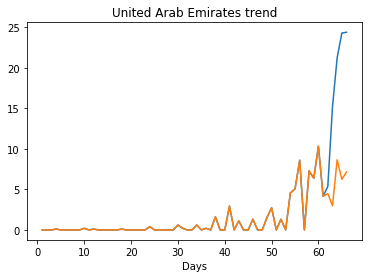

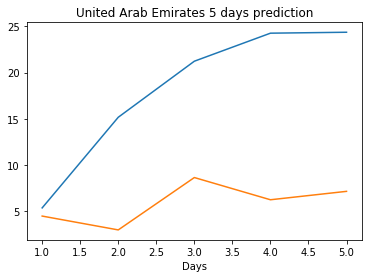

Creating directory ./offline5/India/training/
India
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0089


/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Saving the best model weights at Epoch [3], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0067
train error: 0.0008015839892323128
0.006703563965857029
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0058
train error: 0.0007714922983723227
0.005837191361933947
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0063
Sav

Saving the best model weights at Epoch [13], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0052
train error: 0.0008917590496518339
0.005220277700573206
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0043
train error: 0.0008641559505728462
0.0043488903902471066
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0061


Saving the best model weights at Epoch [4], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0037
train error: 0.0009854906074906467
0.0036597151774913073
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0021
train error: 0.0007806085945048835
0.002077724551782012
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [23], Best Valid Loss: 0.006

train error: 0.0007899808731356946
0.004552100785076618
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0060
train error: 0.0007909003795551447
0.005975782871246338
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0060
train error: 0.0007781496150225091
0.0059569100849330425
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0075
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0059
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0053
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0047
train error

Saving the best model weights at Epoch [7], Best Valid Loss: 0.0060
train error: 0.000813358597952174
0.005972815211862326
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0054
train error: 0.0008287931773035477
0.005441844463348389
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0057
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0046
train error: 0.0009417900308714404
0.004555870313197374
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0121
Saving the bes

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0317
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0269
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0157
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0075
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0067
Saving the best model weights at E

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0100
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0069
Saving the best model weights at Epoch

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0063
train error: 0.0007658061937642439
0.006294038146734238
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0162
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0075
Saving the best model weights at Epoch [12], Best Valid Lo

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0066
Saving the best model weights at E

Saving the best model weights at Epoch [27], Best Valid Loss: 0.0066
train error: 0.0007611163212762525
0.00655743945389986
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0064
train error: 0.0007664524547484082
0.00638702604919672
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0063
train error: 0.0007801592687125473
0.006292406469583511
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0059
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0032
train error: 0.0007593571538260827
0.0031826705671846867
Saving the best model weight

Saving the best model weights at Epoch [49], Best Valid Loss: 0.0066
train error: 0.0007594167150576443
0.006604897323995829
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0075
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [13], Best Valid 

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0066
Saving the best model weights at E

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0066
train error: 0.0007608454718138092
0.006611350458115339
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [6], Best Val

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0066
train error: 0.0007604755337524693
0.006608257535845041
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0352
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0173
Saving the best model weights at Epoch [4], Best V

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0066
train error: 0.000762240239419043
0.0065973857417702675
Saving the best model weights at Epoch [1], Bes

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [8], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0067
Saving the best model weights at Epo

Saving the best model weights at Epoch [31], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0066
train error: 0.0007601327677548397
0.006615203805267811
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [2], Best

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0063
train error: 0.000771541168311766
0.006344409193843603
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0100
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [11], Best Valid Los

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0246
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0238
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0224
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0217
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0194
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0183
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0174
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0170
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0068
train error: 0.0007906426767779824
0.0068097240291535854
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [5], Best V

Saving the best model weights at Epoch [11], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0170
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0134
Saving the best model weights at E

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0044
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0044
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0044
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0044
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0042
Saving the best model weights at E

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0081
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0066
train error: 0.000757117754498419
0.006586037576198578
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0809
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0791
Saving the best model weights at Epoch [3], Best V

Saving the best model weights at Epoch [7], Best Valid Loss: 0.0755
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0727
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0700
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0674
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0649
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0625
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0602
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0581
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0560
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0540
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0521
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0503
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0486
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0469
Saving the best model weights at Epoc

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0066
train error: 0.000761209282791242
0.0065888650715351105
Saving the best model weights at Epoch [1], Bes

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0273
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0265
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0250
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0243
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0230
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0223
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0218
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0212
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0191
Saving the best model weights at Epoch

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0066
train error: 0.0007572820281590491
0.006600785534828901
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0262
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0258
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0254
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0250
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0246
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0235
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0229
Saving the best model weights at Epoch [11], Best Valid 

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0048
train error: 0.0011260974056009824
0.004772597458213568
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [12], Best Valid 

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0100
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0096
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0100
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0095
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0086
Saving the best model weights at E

Saving the best model weights at Epoch [17], Best Valid Loss: 0.0190
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0181
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0173
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0162
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0143
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0075
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0070
train error: 0.0013749338705868772

Saving the best model weights at Epoch [39], Best Valid Loss: 0.0167
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0162
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0144
train error: 0.002800342937310537
0.014389808289706707
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0174
Saving the best model weights at Epoch [2], Best 

train error: 0.0007574101849362099
0.004802870564162731
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0248
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0244
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0233
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0229
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0226
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0222
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0216
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0213
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0210
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [14], Best Valid 

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0095
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0075
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [24], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0066
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0178
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0159
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0153
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0117
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0075
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0068
Saving the best model weights at E

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0220
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0213
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0194
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0183
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0178
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0173
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0164
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0152
Saving the best model weights at E

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0066
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0221
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0194
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0067
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0075
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [45], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0066
train error: 0.0007590176501253154
0.0066106878221035
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0418
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0409
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0400
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0392
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0384
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0376
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0361
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0354
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0347
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0340
Saving the best model weights at Epoch [12], Best Valid Lo

Saving the best model weights at Epoch [17], Best Valid Loss: 0.0273
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0265
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0258
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0244
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0225
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0214
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0194
Saving the best model weights at E

Saving the best model weights at Epoch [8], Best Valid Loss: 0.0167
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0153
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0128
Saving the best model weights at Epo

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0076
Saving the best model weights at E

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0293
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0289
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0280
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0276
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0271
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0263
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0259
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0255
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0252
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0248
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0244
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0241
Saving the best model weights at Epoch

Saving the best model weights at Epoch [24], Best Valid Loss: 0.0162
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0159
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0153
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0129
Saving the best model weights at E

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0117
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0106
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0066
train error: 0.0007572259501709293
0.006579605396836996
Saving the best model weights at Epoch [1], Best Valid 

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0075
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0066
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0066
Saving the best model weights at E

Saving the best model weights at Epoch [7], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0066
Saving the best model weights at Epoc

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0068
train error: 0.0007602526258172778
0.0067812250927090645
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0407
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0336
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0280
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [6], Best Va

Saving the best model weights at Epoch [30], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0066
Saving the best model weights at E

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0075
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0075
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0070
Saving the best model weights at E

Saving the best model weights at Epoch [27], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0075
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0075
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0070
Saving the best model weights at E

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0075
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0062
Saving the best model weights at E

Saving the best model weights at Epoch [8], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0104
Saving the best model weights at Epo

Saving the best model weights at Epoch [8], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0086
Saving the best model weights at Epo

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0066
train error: 0.0007594029867808179
0.006586343981325626
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [3], Best 

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0190
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0174
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0086
Saving the best model weights at Epoch

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0066
train error: 0.0007613185451191384
0.006583366543054581
Saving the best model weights at Epoch [1], Bes

Saving the best model weights at Epoch [32], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0066
train error: 0.000758760008951261


Saving the best model weights at Epoch [16], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0095
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0078
Saving the best model weights at E

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0067
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0068
train error: 0.0007942815025065405
0.00675309170037508
Saving the best model weights at Epoch [1], Best

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0057
train error: 0.0007682873983867466
0.005657370667904615
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0250
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0228
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0178
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [12], Best Valid Lo

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [17

Saving the best model weights at Epoch [40], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0067
train error: 0.0007595075034866265
0.006698563229292631
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0059
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [3], Best 

Saving the best model weights at Epoch [37], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0066
train error: 0.0007584955453542837
0.006620459258556366
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [7], Best Vali

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0658
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0656
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0654
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0652
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0650
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0648
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0646
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0644
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0642
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0640
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0638
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0636
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0634
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0633
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.0493
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0490
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0486
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0482
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0479
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0475
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0472
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0468
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0465
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0462
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0458
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0455
train error: 0.03972091873486837
0.045497991144657135
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [2], Best V

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0308
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0306
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0306
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0304
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0304
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0303
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0302
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0302
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0301
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0301
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0300
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0299
Saving the best model weights at Epoch

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0075
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0075
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0075
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0075
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0075
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0075
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0075
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0176
train error: 0.007957809263219436
0.017588019371032715
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [7], Best Valid

Saving the best model weights at Epoch [13], Best Valid Loss: 0.0299
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0298
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0296
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0295
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0293
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0292
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0291
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0289
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0288
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0285
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0282
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0281
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.0184
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0184
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0183
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0183
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0183
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0183
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0181
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0181
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0181
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0181
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0181
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0178
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0178
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0174
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0173
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0173
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0288
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0287
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0285
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0282
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0281
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0280
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0279
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0279
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0277
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 0.0340
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0338
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0337
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0336
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0335
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0333
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0332
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0331
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0330
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0328
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0327
train error: 0.0200083094338576
0.032722290605306625
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0527
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0524
Saving the best model weights at Epoch [3], Best Val

Saving the best model weights at Epoch [7], Best Valid Loss: 0.0178
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0178
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0178
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0178
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0175
Saving the best model weights at Epoc

Saving the best model weights at Epoch [27], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0174
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0173
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0173
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0170
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0170
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0169
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0063
train error: 0.0014443307203085471
0.006316409446299076
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0100
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [10], Best Valid 

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0218
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0217
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0216
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0216
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0214
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0214
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0213
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0212
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0212
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0210
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0210
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0209
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0065
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0102
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 0.0646
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0644
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0643
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0641
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0639
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0638
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0636
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0634
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0633
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0631
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0629
train error: 0.036932783263425036
0.06292830407619476
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0324
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0323
Saving the best model weights at Epoch [3], Best Va

Saving the best model weights at Epoch [7], Best Valid Loss: 0.0490
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0481
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0473
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0464
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0456
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0448
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0440
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0432
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0424
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0417
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0403
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0396
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0389
Saving the best model weights at Epoc

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0085
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0203
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0199
train error: 0.009032716245080034
0.01990421675145626
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [7], Best Valid 

Saving the best model weights at Epoch [11], Best Valid Loss: 0.0445
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0444
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0443
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0442
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0441
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0440
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0439
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0438
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0437
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0436
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0435
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0434
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0433
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0432
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0109
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0077
train error: 0.0017397964315023274
0.007658159825950861
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0203
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0203
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [11], Best Valid 

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0072
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0117
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0117
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0117
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0117
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0116
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0213
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0210
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0203
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0198
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0194
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0194
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0194
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0191
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.0279
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0279
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0277
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0276
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0275
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0274
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0273
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0272
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0271
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0270
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0270
train error: 0.013366635764638583
0.02696114592254162
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [2], Best V

Saving the best model weights at Epoch [18], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0117
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0075
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0075
train error: 0.004200814478099346


Saving the best model weights at Epoch [5], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0150
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [23], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0101
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0100
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0097
train error: 0.001754703341672818
0.009661313146352768
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0462
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0461
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0460
Saving the best model weights at Epoch [4], Best Va

Saving the best model weights at Epoch [9], Best Valid Loss: 0.0248
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0247
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0246
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0244
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0243
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0241
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0241
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0238
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0237
Saving the best model weights at Ep

Saving the best model weights at Epoch [27], Best Valid Loss: 0.0335
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0323
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0317
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0312
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0301
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0296
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0291
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0282
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0277
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0272
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0268
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 0.0336
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0336
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0335
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0333
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0333
train error: 0.014626210276037454
0.03325480967760086
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [8], Best Valid L

Saving the best model weights at Epoch [13], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0048
train error: 0.0018154766915055613

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0190
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0190
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0184
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0184
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0183
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0054
train error: 0.0016825581338101377
0.005357030779123306
Saving the best model weights at Epoch [1], Bes

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0178
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0174
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0174
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0173
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0170
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0514
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0509
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0505
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0500
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0491
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0487
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0483
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0479
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0474
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0470
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0466
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0462
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0458
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0120
train error: 0.007560525306810935
0.011998138390481472
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0300
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0272
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0259
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0247
Saving the best model weights at Epoch [6], Best Vali

Saving the best model weights at Epoch [11], Best Valid Loss: 0.0313
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0311
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0308
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0303
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0300
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0298
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0295
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0293
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0291
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0288
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0281
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0066
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0080
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0067
train error: 0.0007587092386529548
0.006669627968221903
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0174
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0173
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0170
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [7], Best Vali

Saving the best model weights at Epoch [13], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0124
Saving the best model weights at E

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0261
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0252
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0248
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0244
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0228
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0224
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0220
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0217
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0213
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0209
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.0297
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0289
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0281
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0274
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0253
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0246
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0234
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0228
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0223
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0218
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0212
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 0.0208
train error: 0.005572214078468581
0.02078002132475376
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0174
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0167
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0164
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [13], Best Valid Lo

Saving the best model weights at Epoch [17], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0062
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0100
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0100
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0095
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0095
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0095
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0092
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0078
train error: 0.0013195429540549715
0.007773237768560648
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0162
Saving the best model weights at Epoch [3], Best 

Saving the best model weights at Epoch [7], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0105
Saving the best model weights at Epoc

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0226
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0220
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0214
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0203
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0198
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0184
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0172
Saving the best model weights at E

Saving the best model weights at Epoch [5], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0121
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [24], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0095
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0088
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0103
train error: 0.003023785868814836
0.010343565605580807
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0117
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [5], Best Val

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0075
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0075
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0073
Saving the best model weights at E

Saving the best model weights at Epoch [5], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0198
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0184
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0178
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0174
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0172
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [24], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0066
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0585
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0571
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0558
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0545
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0532
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0520
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0508
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0485
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0474
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0463
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0452
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0442
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0432
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0077
Saving the best model weights at E

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0123
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0085
train error: 0.0017964114978288612
0.008461246266961098
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0198
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0194
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0190
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [7], Best Vali

Saving the best model weights at Epoch [11], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0198
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0194
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0190
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0184
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0102
Saving the best model weights at E

Saving the best model weights at Epoch [24], Best Valid Loss: 0.0358
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0347
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0343
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0340
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0336
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0332
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0325
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0322
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0315
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0312
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0345
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0339
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0328
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0323
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0312
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0307
train error: 0.01551165853937467
0.030732769519090652
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0441
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0427
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0414
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0401
Saving the best model weights at Epoch [5], Best Vali

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0360
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0357
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0354
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0348
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0345
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0342
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0339
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0336
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0333
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0331
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0328
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0325
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0323
Saving the best model weights at E

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0222
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0212
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0203
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0194
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0183
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0032
train error: 0.004719289423276981
0.0032464154064655304
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0280
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0276
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0273
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0270
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0264
Saving the best model weights at Epoch [7], Best Vali

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0159
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0096
Saving the best model weights at E

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0060
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 0.0109
train error: 0.0016321845245935644
0.010858903639018536
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0117
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [13], Best Valid 

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0641
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0640
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0640
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0640
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0640
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0639
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0639
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0639
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0639
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0639
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0638
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0638
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0638
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0638
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.0575
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0575
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0574
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0574
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0573
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0573
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0573
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0572
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0572
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0571
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0571
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0571
train error: 0.04190849972267945
0.057061221450567245
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0430
Saving the best model weights at Epoch [2], Best V

Saving the best model weights at Epoch [7], Best Valid Loss: 0.0317
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0317
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0316
Saving the best model weights at Epoc

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0117
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0117
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0117
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0117
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0117
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0117
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0117
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0116
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 0.0289
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0289
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0289
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0289
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0289
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0289
train error: 0.01644911114126444
0.028906429186463356
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [8], Best Valid L

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0079
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0158
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [19], Best Valid Loss: 0.0386
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0386
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0386
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0386
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0386
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0386
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0386
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0386
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0386
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0386
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0386
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0386
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0386
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0385
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0109
train error: 0.011392705903078119
0.01086540799587965
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0383
Saving the best model weights at Epoch [2], Best V

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0150
Saving the best model weights at Epoch

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0415
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0415
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0414
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0414
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0414
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0414
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0414
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0414
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0414
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0414
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0413
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0413
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0413
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0413
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.0221
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0220
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0220
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0220
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0219
train error: 0.01011517719986538
0.021945958957076073
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0230
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0230
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0230
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0229
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0229
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0229
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0229
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0229
Saving the best model weights at Epoch [9], Best Valid Lo

Saving the best model weights at Epoch [13], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0200
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.0203
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0203
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0203
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0200
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [23], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0079
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0807
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0807
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0806
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0806
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0806
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0806
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0805
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0805
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0805
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0805
train error: 0.054773352170983954
0.0804671123623848
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0968
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0968
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0968
Saving the best model weights at Epoch [4], Best Vali

Saving the best model weights at Epoch [9], Best Valid Loss: 0.0725
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0723
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0722
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0720
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0719
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0718
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0716
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0715
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0714
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0712
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0711
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0709
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0708
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0707
Saving the best model weights at Ep

Saving the best model weights at Epoch [27], Best Valid Loss: 0.0258
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0258
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0258
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0258
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0258
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0258
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0258
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0258
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0258
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0258
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0258
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0258
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0257
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0316
train error: 0.011258144738773505
0.031600356101989746
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0311
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0311
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0309
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0309
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0308
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0308
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [10], Best Valid L

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0161
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0042
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0127
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0663
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0663
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0663
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0662
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0662
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0662
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0662
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0662
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0662
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0661
train error: 0.056808597221970555
0.06614594161510468
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0625
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0625
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0625
Saving the best model weights at Epoch [4], Best Val

Saving the best model weights at Epoch [8], Best Valid Loss: 0.0567
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0566
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0566
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0565
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0565
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0565
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0564
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0564
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0563
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0563
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0563
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0562
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0562
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0561
Saving the best model weights at Epo

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0365
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0365
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0365
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0364
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0364
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0364
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0364
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0364
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0364
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0364
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0364
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0364
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0364
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0364
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0128
train error: 0.005375710098693768
0.012827265076339245
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0281
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0281
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0281
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0281
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0281
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0280
Saving the best model weights at Epoch [7], Best Valid

Saving the best model weights at Epoch [11], Best Valid Loss: 0.0261
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0261
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0261
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0261
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0261
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0261
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0261
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0261
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0261
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0261
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0261
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0260
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0121
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0099
train error: 0.0073995689706255995
0.009857880882918835
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [11], Best Valid 

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0038
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0108
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0541
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0541
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0541
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0541
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0540
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0540
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0540
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0540
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0540
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0539
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0539
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0539
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0539
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0538
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0328
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0327
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0327
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0326
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0325
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0325
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0324
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0323
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0323
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0322
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0321
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0321
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0320
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 0.0322
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0321
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0321
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0321
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0321
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0321
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0321
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0321
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0321
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0321
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0321
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0321
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0321
train error: 0.01204215120524168
0.03207135945558548
Saving the best model weights at Epoch [1], Best V

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0241
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0241
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0238
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0238
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0238
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0237
Saving the best model weights at Epoch

Saving the best model weights at Epoch [24], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0138
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0113
train error: 0.008492049854248762
0.011321617290377617
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [5], Best Val

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0170
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0170
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0170
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0170
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0170
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0170
Saving the best model weights at E

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0137
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0092
train error: 0.024873187641302745
0.009164240211248398
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0534
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0534
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0534
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0534
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0534
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0534
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0534
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0534
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0534
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [11], Best Valid L

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0579
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0579
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0579
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0579
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0579
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0579
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0579
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0578
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0578
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0578
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0578
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0578
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0578
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0578
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0219
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [24], Best Valid Loss: 0.0291
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0291
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0291
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0291
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0291
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0291
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0291
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0291
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0291
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0291
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0291
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0291
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0291
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0291
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0094
train error: 0.00992166631234189
0.009390360675752163
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0174
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0174
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0174
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0174
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0174
Saving the best model weights at Epoch [6], Best Valid

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0126
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0127
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0439
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0439
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0439
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0439
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0439
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0439
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0439
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0439
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0439
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0439
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0439
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0439
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0439
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0439
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.0632
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0631
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0631
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0631
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0631
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0631
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0631
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0630
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0630
train error: 0.0656166107704242
0.06302643567323685
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [5], Best Valid 

Saving the best model weights at Epoch [9], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0176
Saving the best model weights at Ep

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0316
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0188
train error: 0.0051408458268269895
0.018844835460186005
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [12], Best Valid 

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0240
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0090
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0630
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0630
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0630
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0630
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0630
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0630
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0630
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0630
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0630
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0630
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0630
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0630
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0630
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0630
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 0.0597
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0597
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0597
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0596
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0596
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0596
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0596
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0596
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0596
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0596
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0596
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0595
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0595
train error: 0.050508604198694226
0.059530504047870636
Saving the best model weights at Epoch [1], Best

Saving the best model weights at Epoch [5], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0128
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [24], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0082
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0283
train error: 0.011796235603590806
0.02832767926156521
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [6], Best Valid

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0103
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0122
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0240
train error: 0.007616610623275241
0.023996325209736824
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [11], Best Valid L

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0962
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0962
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0962
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0962
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0962
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0962
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0962
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0962
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0962
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0962
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0962
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0962
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0962
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0962
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.0395
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0395
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0395
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0394
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0394
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0394
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0394
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0394
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0394
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0394
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0394
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0394
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0394
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0394
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0107
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 0.0212
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0212
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0212
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0212
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0212
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0212
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0212
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0212
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0212
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0212
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0212
train error: 0.012765069647381702
0.021177275106310844
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0336
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0336
Saving the best model weights at Epoch [3], Best V

Saving the best model weights at Epoch [8], Best Valid Loss: 0.0314
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0314
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0314
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0314
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0314
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0314
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0314
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0314
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0314
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0314
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0314
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0314
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0314
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0313
Saving the best model weights at Epo

Saving the best model weights at Epoch [24], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0082
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0081
train error: 0.00309537451248616
0.008105200715363026
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [6], Best Valid

Saving the best model weights at Epoch [11], Best Valid Loss: 0.0409
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0409
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0409
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0409
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0409
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0409
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0409
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0409
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0409
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0408
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0408
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0408
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0408
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0408
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0201
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0149
train error: 0.012488178132722775
0.014898319728672504
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [10], Best Valid L

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0145
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0118
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [19], Best Valid Loss: 0.0095
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0095
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0095
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0095
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0095
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0095
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0095
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0095
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0095
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0095
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0095
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0095
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0095
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0095
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0204
train error: 0.0068304004380479455

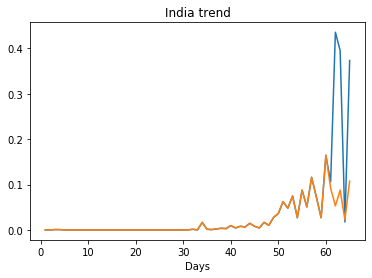

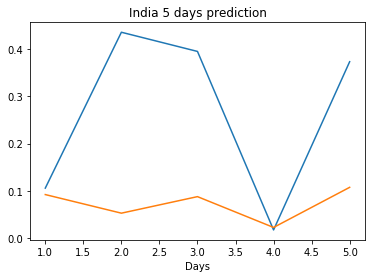

Creating directory ./offline5/Nepal/training/
Nepal
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0004


/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


train error: 9.594664955199862e-05
0.00039952853694558144
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0004
train error: 9.720865303149496e-05
0.0003956368309445679
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0004
train error: 9.48232304153862e-05
0.0003943287010770291
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0004
Saving the

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0004
train error: 9.454375107062723e-05
0.00039007700979709625
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0002
train error: 9.58606161150653e-05
0.00023646453337278217
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0004
train error: 9.695927814651181e-05
0.00038379483157768846
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0004
train error: 9.995642056180389e-05
0.0003627442929428071
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0003
train error: 0.00012316837763657012
0.0002612439857330173
Saving the best model weight

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0004
train error: 9.59337114311763e-05
0.0003948232624679804
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0004
train error: 9.622570885637417e-05
0.00035077493521384895
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0003
train error: 9.814151193755346e-05
0.00034804505412466824
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0004
Saving the 

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0004
train error: 9.91315139194577e-05
0.00037325185257941484
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0003
train error: 0.00010860361053996062
0.00028969187405891716
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0004
train error: 9.460733672312926e-05
0.0003928059304598719
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0004
train

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0004
train error: 0.00010166307204794326
0.0003735101781785488
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0003
train error: 0.0001227754002684378
0.0003403189475648105
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [36], Best Valid Loss: 0.00

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0004
train error: 9.31553960981546e-05
0.0004260902351234108
Saving the best model weights at Epoch [1], Best Va

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0004
Saving the best model weights at Epoch

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0004
train error: 9.230037958332104e-05
0.0004126611165702343
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0002
train error: 9.208638304179269e-05
0.00021681294310837984
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [2], Best Valid Loss: 0.00

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0004
train error: 9.2754903666251e-05
0.00040895986603572965
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0004
train error: 9.30258442167542e-05
0.00037527811946347

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0004
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0004
train error: 9.205941506869359e-05
0.00041228588088415563
Saving the best model weights at Epoch [1], B

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0004
train error: 9.208322605575501e-05
0.0004124050901737064
Saving the best model weights at Epoch [1], Be

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0004
train error: 9.196460663848223e-05
0.0004120681551285088
Saving the best model weights at Epoch [1], Be

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0004
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0004
train error: 9.197012693350969e-05
0.0004127723223064095
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0057
Saving the best model weights at Epoch [2], Bes

Saving the best model weights at Epoch [44], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0004
train error: 9.196816985682485e-05
0.0004136286734137684
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [8], Best Vali

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0004
train error: 9.206944962768051e-05
0.0003925955097656697
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [13], Best Valid

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0057
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0004
Saving the best model weights at E

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0004
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0091
train error: 0.007685637939721346
0.00908069871366024
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0301
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0289
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0277
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0266
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0255
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0235
Saving the best model weights at Epoch [8], Best Valid L

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0018
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0023
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0162
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0056
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [24], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0007
Saving the best model weights at E

Saving the best model weights at Epoch [7], Best Valid Loss: 0.0053
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0044
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0036
Saving the best model weights at Epoc

Saving the best model weights at Epoch [27], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0007
Saving the best model weights at E

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0087
Saving the best model weights at Epoch

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0002
train error: 0.0001262695594050456
0.0001708654745016247
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0595
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0442
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0328
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0244
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [9], Best Valid

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0075
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0059
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0057
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0004
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0009
Saving the best model weights at E

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0004
Saving the best model weights at Epoch

Saving the best model weights at Epoch [49], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0007
train error: 0.0007924610948456185
0.0006619563791900873
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0035
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [12], Best Valid

Saving the best model weights at Epoch [18], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0004
train error: 9.173797360355301e-05
0.00040755970985628664
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0333
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0322
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0312
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0302
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0292
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0282
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0273
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0264
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0255
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0247
Saving the best model weights at Epoch [11], Best Vali

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0230
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0218
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0167
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0159
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0116
Saving the best model weights at E

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0057
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0055
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0006
Saving the best model weights at E

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0010
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0015
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0007
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0008
train error: 0.00021738773897855674
0.0008421883103437722
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0035
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [12], Best Vali

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0225
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0218
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0212
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0166
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0157
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0152
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.0057
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0047
train error: 0.0032691829438720433
0.004731494002044201
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0178
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [9], Best Valid 

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0010
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0012
train error: 0.00039897454054360946
0.0012198667973279953
Saving the best model weights at Epoch [1], B

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0044
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0035
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0033
Saving the best model weights at E

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0016
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0006
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.0053
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0050
train error: 0.005669198464602232
0.0049995905719697475
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [11], Best Valid 

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0056
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0016
Saving the best model weights at E

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0044
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0035
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0025
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0003
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0018
Saving the best model weights at E

Saving the best model weights at Epoch [8], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0003
train error: 9.169658021294579e-05
0.0003032553649973124
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0035
Saving the best model weights at Epoch [7], Best Valid

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0010
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0004
Saving the best model weights at E

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0004
Saving the best model weights at Epoch

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0004
train error: 9.140195054767122e-05

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0004
Saving the best model weights at E

Saving the best model weights at Epoch [13], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0004
train error: 9.28023658031764e-05
0.00040960762999020517
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [11], Best Valid

Saving the best model weights at Epoch [5], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0044
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0010
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [47], Best Valid Loss: 0.0004
train error: 9.281902408214851e-05
0.00040492438711225986
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0075
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [13], Best Vali

Saving the best model weights at Epoch [38], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0004
train error: 9.262039358353442e-05
0.00040563326911069453
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0056
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [12], Best Vali

Saving the best model weights at Epoch [17], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0004
train error: 9.208094725181582e-05
0.00037555533344857395
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [12], Best Vali

Saving the best model weights at Epoch [8], Best Valid Loss: 0.0004
train error: 9.207152423706638e-05
0.0003840973076876253
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0004
train error: 9.299512135580049e-05
0.0004062853695359081
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0400
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0339
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0287
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0244
Sa

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0004
Saving the best model weights at E

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0004
train error: 9.215005793521414e-05
0.0004095050971955061
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [12], Best Val

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0002
train error: 9.193882184003347e-05
0.00020198053971398622
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [7], Best Valid Los

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0004
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0005
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0002
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0002
train error: 9.204731166911578e-05
0.00019416376017034054
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [5], Best Valid Lo

Saving the best model weights at Epoch [50], Best Valid Loss: 0.0004
train error: 9.190159539035189e-05
0.000421924953116104
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0100
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0059
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [13], Best Valid 

Saving the best model weights at Epoch [32], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0005
Saving the best model weights at E

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0005
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0004
train error: 9.289627398954638e-05
0.00040489458478987217
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0249
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [3], Best Valid 

Saving the best model weights at Epoch [18], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0004
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0004
train error: 9.460895037461471e-05
0.0004260025452822447
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [11], Best Valid

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0004
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0004
train error: 9.266416735564625e-05
0.00042320784996263683
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [9], Best Vali

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0004
train error: 9.254585415224678e-05
0.00040694960625842214
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0153
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0153
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [9], Best Valid L

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0064
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0183
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0178
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0173
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0164
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0132
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0100
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0075
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0060
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0059
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0059
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0059
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0059
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0057
train error: 0.006341857729213579
0.00574854901060462
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [4], Best Val

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0018
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0008
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 0.0019
train error: 0.0015697834747178214
0.0018826614832505584
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [13], Best Valid

Saving the best model weights at Epoch [17], Best Valid Loss: 0.0343
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0342
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0340
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0339
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0337
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0336
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0333
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0331
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0330
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0328
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0327
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0325
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0324
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0212
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0210
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0208
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0198
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0194
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0190
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0187
Saving the best model weights at E

Saving the best model weights at Epoch [5], Best Valid Loss: 0.0198
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0198
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0194
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0190
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0188
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0184
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0181
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0174
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0166
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.0056
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0055
train error: 0.0042325321584939955
0.005459731910377741
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0117
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0117
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [7], Best Vali

Saving the best model weights at Epoch [11], Best Valid Loss: 0.0035
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0030
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0036
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.0057
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0056
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0056
train error: 0.0036963594212595908
0.0056178695522248745
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [11], Best Valid

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0331
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0330
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0328
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0327
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0326
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0324
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0323
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0322
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0321
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0320
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0317
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.0383
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0381
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0378
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0376
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0372
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0370
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0365
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0363
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0361
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0357
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0355
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0059
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0059
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0059
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0059
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0059
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0059
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0057
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0057
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0198
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0194
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0190
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0185
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0019
train error: 0.0017874427605420351
0.0018857471877709031
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0056
Saving the best model weights at Epoch [2], Bes

Saving the best model weights at Epoch [7], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0076
Saving the best model weights at Epoc

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0035
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0035
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0026
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0018
train error: 0.00108897222172735
0.00179584592115134
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [6], Best Valid 

Saving the best model weights at Epoch [11], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0035
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0027
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0137
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0100
train error: 0.01179601326584816
0.010018661618232727
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0590
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0572
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0555
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0538
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0521
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0505
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0490
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0475
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0460
Saving the best model weights at Epoch [10], Best Valid Lo

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0143
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0117
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0111
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [19], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0007
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0006
train error: 0.0005963943657531802

Saving the best model weights at Epoch [5], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0039
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [23], Best Valid Loss: 0.0159
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0157
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0157
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0153
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0208
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0203
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0198
train error: 0.017258281500211786
0.019796719774603844
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0369
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0365
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0362
Saving the best model weights at Epoch [4], Best Va

Saving the best model weights at Epoch [9], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0142
Saving the best model weights at Ep

Saving the best model weights at Epoch [27], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0082
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0035
train error: 0.0028132959767909987
0.0035296163987368345
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0053
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0053
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0053
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0053
Saving the best model weights at Epoch [8], Best Vali

Saving the best model weights at Epoch [13], Best Valid Loss: 0.0057
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0056
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0056
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0056
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0056
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0053
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0035
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0026
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0024
train error: 0.003015554463490844
0.002407762687653303
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [12], Best Valid L

Saving the best model weights at Epoch [17], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0025
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.0213
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0208
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0194
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0190
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0181
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0173
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0158
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0366
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0317
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0274
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0178
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0117
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0044
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0035
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0034
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0007
train error: 0.0003098633136167856
0.0006762270350009203
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [4], Best 

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0044
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0036
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0006
train error: 0.0005776229888267283
0.0005639683804474771
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0100
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [11], Best Valid

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0035
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0028
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0007
train error: 0.0005700681084168277
0.0007217976381070912
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [3], Best

Saving the best model weights at Epoch [7], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0100
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0082
Saving the best model weights at Epoc

Saving the best model weights at Epoch [27], Best Valid Loss: 0.0210
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0183
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0153
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0118
Saving the best model weights at E

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0021
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0004
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0015
train error: 0.0028122607618570328
0.0015015632379800081
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0059
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0056
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0053
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [12], Best Valid

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0035
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0021
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0059
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0059
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0057
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0056
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0056
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0053
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0053
Saving the best model weights at E

Saving the best model weights at Epoch [5], Best Valid Loss: 0.0059
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0057
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0044
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0035
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0034
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [23], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0100
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0094
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0035
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0028
train error: 0.0040938019752502445
0.0027636783197522163
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0167
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0159
Saving the best model weights at Epoch [4], Best 

Saving the best model weights at Epoch [9], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0059
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0058
Saving the best model weights at Ep

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0017
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0004
train error: 0.00010255464362022135
0.0004281521833036095
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [10], Best Vali

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0044
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0035
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0032
Saving the best model weights at E

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0010
Saving the best model weights at Epoch

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0009
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0004
train error: 9.293948377100085e-05
0.00042509366176091135
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0067
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0064
Saving the best model weights at Epoch [6], Best V

Saving the best model weights at Epoch [11], Best Valid Loss: 0.0427
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0415
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0403
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0392
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0381
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0370
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0349
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0339
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0320
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0311
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0302
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0293
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0006
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0005
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.0044
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0041
train error: 0.004459700440721853
0.00411210348829627
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [10], Best Valid Lo

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0023
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0020
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0014
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0010
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0009
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0008
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0007
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0057
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0053
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0044
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0043
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0056
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0022
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0019
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0013
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0012
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0011
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0016
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0015
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0015
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0003
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0003
train error: 0.0003433679001838235
0.000267974566668272
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [2], Best

Saving the best model weights at Epoch [7], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0303
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0297
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0291
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0285
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0280
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0274
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0269
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0263
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0258
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0253
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0248
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0243
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0238
Saving the best model weights at Epoc

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0075
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0066
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0063
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0053
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0051
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0044
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0038
train error: 0.004900254901232464
0.003820533398538828
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [6], Best Vali

Saving the best model weights at Epoch [11], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0043
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0041
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0035
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0028
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0027
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0027
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0026
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0023
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0017
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0016
train error: 0.0015135340991296938
0.001615094835869968
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0060
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0057
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [10], Best Valid 

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0035
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0032
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0029
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0004
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0004
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0277
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0277
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0277
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0277
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0277
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0277
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0277
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0277
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0277
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0277
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0574
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0573
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0573
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0573
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0572
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0572
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0572
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0571
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0571
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0571
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0570
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0570
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0569
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0569
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0418
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0417
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0415
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0414
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0413
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0412
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0409
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0408
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0407
train error: 0.04055520934717996
0.04068334400653839
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [4], Best Vali

Saving the best model weights at Epoch [8], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0235
Saving the best model weights at Epo

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0111
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0071
train error: 0.004672036905373845
0.007054282817989588
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [11], Best Valid L

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0079
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0078
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0076
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0048
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0397
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0397
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0397
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0396
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0396
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0396
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0396
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0396
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0396
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0395
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0395
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0395
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0395
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0395
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.0586
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0586
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0585
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0584
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0584
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0583
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0583
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0582
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0582
train error: 0.052948084260736196
0.05816032364964485
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0528
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0526
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0525
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0523
Saving the best model weights at Epoch [5], Best Vali

Saving the best model weights at Epoch [9], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0054
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0053
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0053
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0053
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0053
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0053
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0053
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0053
Saving the best model weights at Ep

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0073
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0042
train error: 0.006694112678191491
0.004197471775114536
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [11], Best Valid L

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0062
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0073
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0046
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0148
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 0.0471
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0471
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0470
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0470
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0470
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0469
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0469
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0469
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0469
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0468
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0468
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0468
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0468
train error: 0.03964388711111886
0.04677277430891991
Saving the best model weights at Epoch [1], Best V

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0236
Saving the best model weights at Epoch

Saving the best model weights at Epoch [24], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0155
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0086
train error: 0.011128367510225091
0.00861360039561987
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [6], Best Valid

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0101
Saving the best model weights at E

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0018
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0018
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0040
train error: 0.004156844218128494
0.003954417072236538
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0021
Saving the best model weights at Epoch [9], Best Valid L

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0031
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0030
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0030
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0306
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0306
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0306
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0306
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0306
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0306
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0306
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0306
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 0.0237
train error: 0.024780885662351336
0.02371399663388729
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0338
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0337
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0336
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0335
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0333
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0332
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0331
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0330
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0328
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0327
Saving the best model weights at Epoch [13], Best Valid Lo

Saving the best model weights at Epoch [18], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0091
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0194
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0194
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0194
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0194
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [23], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0145
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0036
train error: 0.002735833397933415
0.0036464023869484663
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0045
Saving the best model weights at Epoch [5], Best Va

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0070
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0070
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0255
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0255
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0255
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0254
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0254
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0254
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0254
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0254
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0254
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0254
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0254
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0254
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0254
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0254
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0541
train error: 0.04684376940131187
0.05412743613123894
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0367
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0367
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0366
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0366
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0366
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0365
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0365
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0364
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0364
Saving the best model weights at Epoch [10], Best Valid Los

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0132
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0068
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0068
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0036
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [19], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0164
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0164
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0164
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0164
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0164
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0164
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0164
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0164
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0164
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0164
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0164
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0163
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0111
train error: 0.00886109827884606
0

Saving the best model weights at Epoch [5], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0037
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [23], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0050
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0048
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.0393
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0393
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0393
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0392
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0392
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0392
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0392
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0392
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0392
train error: 0.04185806459614209
0.03924151882529259
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0314
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0314
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0314
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0314
Saving the best model weights at Epoch [5], Best Valid

Saving the best model weights at Epoch [9], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0138
Saving the best model weights at Ep

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0047
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0150
train error: 0.014348204247653484
0.014978534542024136
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [12], Best Valid L

Saving the best model weights at Epoch [19], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0146
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0141
train error: 0.013888131960162095


Saving the best model weights at Epoch [4], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [23], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0034
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0033
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0033
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0453
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0453
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0453
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0453
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0453
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0453
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0453
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0453
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0453
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0453
train error: 0.04790131918021611
0.045264583081007004
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0582
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0582
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0582
Saving the best model weights at Epoch [4], Best Val

Saving the best model weights at Epoch [8], Best Valid Loss: 0.0243
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0243
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0243
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0243
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0243
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0243
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0243
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0243
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0242
Saving the best model weights at Epo

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0107
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0126
train error: 0.009259268535034997
0.012551063671708107
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [11], Best Valid L

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0080
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0058
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0024
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0029
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0029
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0037
train error: 0.0033926980902573892
0.0037350126076489687
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0297
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0297
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0297
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0297
Saving the best model weights at Epoch [5], Best V

Saving the best model weights at Epoch [9], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0368
Saving the best model weights at Ep

Saving the best model weights at Epoch [27], Best Valid Loss: 0.0389
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0389
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0389
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0389
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0389
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0389
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0389
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0389
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0388
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0239
train error: 0.020331530858363422
0.023890674114227295
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [10], Best Valid L

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0131
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0040
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0077
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [19], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0061
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0061
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0039
train error: 0.004241658348057951
0.003928960766643286
Saving the best model weights at Epoch [1], Best

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0221
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0221
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0221
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0221
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0221
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0221
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0221
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0221
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0221
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0221
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0221
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0221
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0221
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0221
Saving the best model weights at Epoch

Saving the best model weights at Epoch [24], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0149
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0108
train error: 0.01339420745415347
0.010847947560250759
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [6], Best Valid

Saving the best model weights at Epoch [11], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0114
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0085
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0005
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0005
train error: 0.001069119303221149
0.00048593778046779335
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [10], Best Valid

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0007
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0007
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0025
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0553
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0553
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0553
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0553
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0553
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0553
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0553
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0552
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0552
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0552
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0552
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0552
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0552
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0552
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0388
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0241
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0241
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0241
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0241
train error: 0.019422904242362295
0.024127375334501266
Saving the best model weights at Epoch [1], Best

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0160
Saving the best model weights at Epoch

Saving the best model weights at Epoch [24], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0197
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0108
train error: 0.009029224967317923
0.010824382305145264
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [5], Best Val

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0132
Saving the best model weights at E

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0038
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0038
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0040
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0040
train error: 0.004187011226479497
0.003989337477833033
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0025
Saving the best model weights at Epoch [9], Best Valid L

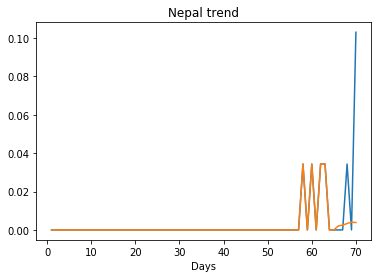

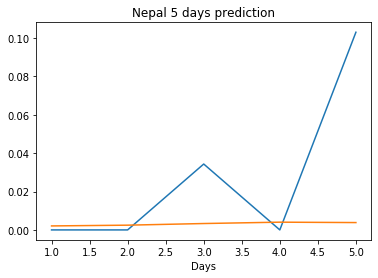

Creating directory ./offline5/Sri Lanka/training/
Sri Lanka
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0057


/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Saving the best model weights at Epoch [6], Best Valid Loss: 0.0054
train error: 0.038291978565129364
0.005434123333543539
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0282
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0155
train error: 0.03499736837252523
0.015514385886490345
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0093
train error: 0.030330573279184824
0.009268532507121563
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0079
train error: 0.028539045003002906
0.007909278385341167
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0203
Saving the best model weights at

train error: 0.049357720566066826
0.010056152008473873
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0099
train error: 0.050250111373536514
0.00993116945028305
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0079
train error: 0.04310625283555551
0.00794694572687149
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0254
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0200
Saving the best mod

train error: 0.05000664609851259
0.009420384652912617
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0090
train error: 0.051658345329942124
0.009017112664878368
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0077
train error: 0.05201617765212149
0.007737135048955679
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0120
Saving the best mo

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0094
train error: 0.05113671855493025
0.009441787376999855
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0080
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0080
train error: 0.053981749820664074
0.007968973368406296
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0076
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0074
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0073

train error: 0.06303610927848653
0.005879906937479973
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0104
train error: 0.04964677385534301
0.010353827849030495
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0099
train error: 0.050302673864996796
0.009926063939929008
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0166
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0123
Saving the best mode

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0353
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0259
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0208
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0178
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0162
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0141
train error: 0.046243305543832706
0.014125354588031769
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0259
Saving the best model weights at Epoch [2], Best Valid L

Saving the best model weights at Epoch [13], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0162
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0159
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0157
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0153
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0147
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0112
train error: 0.0462852373267665
0.0111780

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0127
train error: 0.04829203433385401
0.012691176496446133
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0481
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0254
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0167
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [7], Best Valid 

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0122
train error: 0.048021512388279945
0.012187930755317211
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0376
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0256
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [46], Best Valid 

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0114
train error: 0.048922028872325565
0.011400318704545498
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0357
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0304
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0264
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0233
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0210
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0167
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0159
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [12], Best Valid Los

Saving the best model weights at Epoch [11], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0184
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0174
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0166
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0159
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0153
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0131
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.0123
train error: 0.048188731469439736
0.012292173691093922
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0571
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0455
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0372
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0312
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0268
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0178
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0166
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0157
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [13], Best Valid L

train error: 0.04826870498557886
0.01222934853285551
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0120
train error: 0.04833867098910339
0.01196763850748539
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0364
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0235
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0132
Saving the

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0118
train error: 0.04863657633011991
0.011772598139941692
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0111
train error: 0.048841278830712494
0.01110037975013256
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0787
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0634
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0518
S

Saving the best model weights at Epoch [9], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0126
Saving the best model weights at Ep

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0126
Saving the best model weights at Epoch

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0122
train error: 0.04823940837134918
0.01222152542322874
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0225
Saving the best model weights at Epoch [2], Best Va

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0120
train error: 0.048406266212237606
0.012016751803457737
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [2], Best Valid 

Saving the best model weights at Epoch [17], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0119
train error: 0.04833362384163069
0.01190072949975729
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0117
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0108
train error: 0.04881625577355876
0.010780622251331806
S

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0124
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0402
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0395
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0381
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0362
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0356
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0350
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0344
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0338
train error: 0.0655454586711571
0.03383374959230423
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0424
Saving the best model weights at Epoch [2], Best Val

Saving the best model weights at Epoch [6], Best Valid Loss: 0.1167
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1091
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1025
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0964
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0906
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0853
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0806
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0759
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0716
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0677
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0640
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0607
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0578
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0548
Saving the best model weights at Epoch

Saving the best model weights at Epoch [49], Best Valid Loss: 0.0210
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0208
train error: 0.05115222084251317
0.020769240334630013
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0645
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0628
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0612
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0597
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0582
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0568
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0554
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0540
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0528
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0503
Saving the best model weights at Epoch [12], Best Valid Lo

Saving the best model weights at Epoch [18], Best Valid Loss: 0.0282
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0271
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0261
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0250
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0234
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0226
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0220
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0213
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0187
Saving the best model weights at E

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0454
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0444
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0434
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0424
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0414
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0405
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0397
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0380
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0372
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0364
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0357
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0350
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0343
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0164
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0140
Saving the best model weights at E

Saving the best model weights at Epoch [19], Best Valid Loss: 0.0224
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0210
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0198
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0181
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0178
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0176
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0133
train error: 0.04748487478178559
0.013273057527840137
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0458
Saving the best model weights at Epoch [2], Best V

Saving the best model weights at Epoch [23], Best Valid Loss: 0.0353
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0345
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0337
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0322
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0315
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0308
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0302
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0295
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0289
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0272
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0267
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0185
train error: 0.04919988498317473
0.018457232043147087
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1636
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1288
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1032
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0833
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0691
Saving the best model weights at Epoch [6], Best Valid

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0235
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0230
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0226
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0221
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0217
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0213
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0210
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0190
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0187
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0144
train error: 0.04861043647608974
0.014447408728301525
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0710
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0584
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0489
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0416
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0350
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0306
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0268
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0217
Saving the best model weights at Epoch [10], Best Valid Lo

Saving the best model weights at Epoch [32], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0212
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0210
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0185
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0331
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0290
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0248
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0222
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [46], Best Valid Loss: 0.0228
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0226
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0223
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0221
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0218
train error: 0.05081516382933566
0.02181236632168293
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0514
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0479
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0463
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0448
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0434
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0420
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0406
Saving the best model weights at Epoch [9], Best Valid Los

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0122
train error: 0.04802897352386604
0.01220665406435728
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1949
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1895
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1842
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1790
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1741
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1692
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1646
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1601
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1557
Saving the best model weights at Epoch [10], Best Valid Los

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0501
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0487
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0472
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0458
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0445
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0433
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0421
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0398
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0387
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0378
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0350
Saving the best model weights at E

Saving the best model weights at Epoch [8], Best Valid Loss: 0.0415
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0408
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0400
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0393
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0386
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0379
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0373
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0366
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0360
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0354
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0348
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0342
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0336
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0331
Saving the best model weights at Epo

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0293
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0285
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0277
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0270
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0263
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0234
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0229
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0224
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0215
Saving the best model weights at E

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0373
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0366
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0353
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0346
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0340
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0328
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0323
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0317
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0312
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0302
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0297
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0167
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0164
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0162
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0157
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0153
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0150
Saving the best model weights at E

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0361
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0348
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0342
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0337
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0331
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0325
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0320
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0315
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0300
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0170
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0167
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0162
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0159
train error: 0.04928088515545383
0.01588532328605652
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0617
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0577
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0544
Saving the best model weights at Epoch [4], Best Vali

Saving the best model weights at Epoch [32], Best Valid Loss: 0.0439
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0431
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0424
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0417
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0403
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0397
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0391
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0384
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0378
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0373
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0367
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0361
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0356
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 0.0178
train error: 0.05098663654291269
0.01780480518937111
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1098
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1017
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0946
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0877
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0819
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0759
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0710
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0663
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0618
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0579
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0543
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0509
Saving the best model weights at Epoch [13], Best Valid Los

Saving the best model weights at Epoch [8], Best Valid Loss: 0.0184
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0181
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0173
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0170
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0166
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0162
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0160
Saving the best model weights at Epo

train error: 0.04804862660327644
0.011816535145044327
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0275
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [15], Best Valid Lo

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0405
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0390
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0377
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0365
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0353
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0341
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0330
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0320
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0311
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0301
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0293
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0285
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0277
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0269
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0121
train error: 0.04807834530418569
0.012090781703591347
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0583
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0570
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0557
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0544
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0532
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0520
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0509
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [9], Best Valid Lo

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0244
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0225
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0220
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0214
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0181
Saving the best model weights at E

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0390
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0384
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0378
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0372
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0366
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0361
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0356
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0350
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0345
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0340
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0335
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0331
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0326
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0322
Saving the best model weights at E

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0089
train error: 0.04984523367249605
0.008890819735825062
Saving the best model weights at Epoch [1], Best 

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0303
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0298
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0293
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0289
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0279
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0275
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0271
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0263
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0259
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0255
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0248
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.0198
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0186
train error: 0.05141245054476189
0.01857702247798443
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0715
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0667
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0620
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0579
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0543
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0509
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0475
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0446
Saving the best model weights at Epoch [9], Best Valid Los

Saving the best model weights at Epoch [34], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0263
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0256
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0253
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0250
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0247
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0244
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0241
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0238
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0235
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0230
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0227
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0618
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0581
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0548
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0518
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0489
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0463
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0437
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0416
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0394
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0377
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0342
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0327
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0312
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [42], Best Valid Loss: 0.0214
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0212
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0203
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0197
train error: 0.05223686008177923
0.019722340628504753
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0354
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0345
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0335
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0326
Saving the best model weights at Epoch [5], Best Vali

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0246
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0227
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0213
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0183
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0168
Saving the best model weights at E

Saving the best model weights at Epoch [8], Best Valid Loss: 0.0157
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0100
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0095
Saving the best model weights at Epo

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0119
Saving the best model weights at E

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0162
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0153
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0112
Saving the best model weights at E

train error: 0.04672010378404097
0.012282428331673145
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0358
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0141
train error: 0.04207961165317983
0.014137526042759418
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0485
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0442
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0404
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0371
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0342
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0317
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0295
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0276
Saving t

Saving the best model weights at Epoch [18], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0109
Saving the best model weights at E

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0126
train error: 0.048119473666178456
0.012621319852769375
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0328
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [7], Best Va

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0210
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0167
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0132
Saving the best model weights at E

Saving the best model weights at Epoch [13], Best Valid Loss: 0.0203
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0139
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0126
Saving the best model weights at E

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0123
train error: 0.04823847402903167
0.012268155813217163
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0282
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0174
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0119
train error: 0.048480821745187946
0.011915864422917366
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0407
S

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0121
train error: 0.04813518964995941
0.012067868374288082
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0420
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0212
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0117
train error: 0.04853308395567266
0.011743273586034775
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0281
Sa

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0122
train error: 0.04815326664935459
0.012249073013663292
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0461
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0360
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [6], Best Valid

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0157
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0153
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0131
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0129
Saving the best model weights at E

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0174
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0134
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0122
train error: 0.04815227930631601
0.012205242179334164
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0447
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0320
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [6], Best Valid

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0367
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0314
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0274
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0217
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0198
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0183
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0125
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.0174
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0162
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0153
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0139
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.0112
train error: 0.04960276265487527
0.011186695657670498
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0453
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0418
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0387
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0360
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0335
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0313
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0294
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0277
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0262
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0248
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0226
Saving the best model weights at Epoch [13], Best Valid Lo

Saving the best model weights at Epoch [18], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0124
Saving the best model weights at E

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0246
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0230
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0216
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0194
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0178
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0146
Saving the best model weights at E

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0174
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0157
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0140
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0208
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [43], Best Valid Loss: 0.1384
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1380
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1375
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1371
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1366
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1362
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1357
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1353
train error: 0.13868317961918586
0.13529111444950104
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0297
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0296
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0295
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0294
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0292
Saving the best model weights at Epoch [6], Best Valid 

Saving the best model weights at Epoch [11], Best Valid Loss: 0.0924
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0908
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0891
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0875
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0860
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0845
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0830
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0815
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0801
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0788
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0774
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0761
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0748
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0736
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0583
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0582
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0580
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0578
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0576
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0575
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0573
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0571
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0570
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0568
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0566
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0565
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0563
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0561
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.0342
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0340
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0338
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0336
train error: 0.06784270530933457
0.03362579271197319
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0573
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0562
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0551
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0540
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0529
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0519
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0509
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0498
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0489
Saving the best model weights at Epoch [10], Best Valid Los

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0268
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0268
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0266
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0266
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0265
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0265
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0264
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0263
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0263
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0262
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0261
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0261
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0260
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.0593
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0589
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0586
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0583
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0579
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0576
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0573
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0570
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0566
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0563
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0560
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0557
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0554
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0551
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 0.0553
train error: 0.07481093980569506
0.055277884006500244
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0416
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0415
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0414
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0413
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0412
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0409
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0408
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0407
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0406
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0405
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0404
Saving the best model weights at Epoch [13], Best Valid Lo

Saving the best model weights at Epoch [17], Best Valid Loss: 0.0480
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0477
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0474
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0472
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0469
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0467
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0464
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0461
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0459
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0457
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0454
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0452
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0449
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0447
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.0606
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0604
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0603
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0601
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0599
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0598
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0596
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0595
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0593
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0592
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0590
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0588
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0587
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0585
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0635
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0631
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0626
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0621
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0617
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0612
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0607
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0603
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0598
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0594
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0589
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0585
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0581
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0576
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0670
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0668
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0666
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0665
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0663
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0662
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0660
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0658
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0657
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0655
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0654
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0652
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0650
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0649
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.0423
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0422
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0420
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0419
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0418
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0416
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0415
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0413
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0412
train error: 0.06536211383486674
0.04120536521077156
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0352
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0350
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0348
Saving the best model weights at Epoch [5], Best Valid

Saving the best model weights at Epoch [9], Best Valid Loss: 0.0786
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0784
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0783
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0781
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0779
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0777
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0775
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0773
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0771
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0770
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0768
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0766
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0764
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0762
Saving the best model weights at Ep

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0322
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0321
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0317
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0315
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0314
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0313
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0312
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0311
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0309
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0308
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0119
train error: 0.05432819236408581
0.011897601187229156
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0557
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0556
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0555
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0554
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0553
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0551
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0550
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0549
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0548
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0547
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0546
Saving the best model weights at Epoch [12], Best Valid Lo

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0303
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0302
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0301
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0300
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0299
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0298
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0297
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0296
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0295
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0294
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0293
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0292
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0291
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0290
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0290
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0279
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0275
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0272
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0269
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0266
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0262
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0259
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0256
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0253
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0250
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0248
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0794
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0790
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0786
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0782
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0779
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0775
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0771
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0767
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0764
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0760
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0756
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0753
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0749
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0746
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0159
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0122
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0625
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0623
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0622
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0620
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0618
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0617
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0615
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0613
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0611
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0610
train error: 0.08001795947325951
0.06098181754350662
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0387
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0386
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0384
Saving the best model weights at Epoch [4], Best Vali

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0302
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0298
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0294
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0291
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0287
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0281
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0274
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0272
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0268
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0265
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0262
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0260
Saving the best model weights at E

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0478
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0477
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0475
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0474
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0472
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0471
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0469
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0468
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0466
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0465
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0464
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0462
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0461
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0459
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.0536
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0530
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0527
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0524
train error: 0.07183680159505457
0.05237109586596489
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0420
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0413
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0406
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0399
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0392
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0386
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0380
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0373
Saving the best model weights at Epoch [9], Best Valid Los

Saving the best model weights at Epoch [13], Best Valid Loss: 0.0338
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0337
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0336
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0335
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0333
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0332
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0331
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0331
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0330
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0328
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0327
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0326
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.0328
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0327
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0325
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0323
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0322
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0320
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0317
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0315
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0314
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0312
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0311
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0309
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0307
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 0.0510
train error: 0.07143874675261253
0.05096420645713806
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0412
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0411
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0409
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0408
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0407
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0406
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0405
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0404
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0403
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0402
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0401
Saving the best model weights at Epoch [13], Best Valid Los

Saving the best model weights at Epoch [18], Best Valid Loss: 0.0350
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0348
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0346
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0344
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0343
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0341
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0339
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0338
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0336
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0332
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0331
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0328
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0776
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0774
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0773
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0771
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0769
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0767
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0765
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0763
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0761
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0760
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0758
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0756
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0754
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0752
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0959
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0952
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0945
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0938
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0931
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0924
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0918
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0911
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0904
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0898
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0891
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0885
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0878
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0872
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0306
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0306
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0304
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0304
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0303
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0302
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0302
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0301
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0301
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0300
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0300
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0299
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0593
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0591
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0589
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0587
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0584
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0582
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0580
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0578
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0576
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0574
train error: 0.075662520488329
0.05740145593881607
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0591
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0587
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0583
Saving the best model weights at Epoch [4], Best Valid 

Saving the best model weights at Epoch [9], Best Valid Loss: 0.0482
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0481
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0480
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0479
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0478
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0477
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0476
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0475
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0474
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0473
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0472
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0471
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0470
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0468
Saving the best model weights at Ep

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0579
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0577
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0575
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0573
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0571
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0568
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0566
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0564
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0562
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0560
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0558
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0556
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0553
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0551
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.0212
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0210
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0203
train error: 0.05430858311328021
0.02030552551150322
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0947
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0945
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0943
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0941
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0938
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0936
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0934
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0932
Saving the best model weights at Epoch [9], Best Valid Los

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0694
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0690
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0687
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0683
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0680
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0676
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0672
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0669
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0665
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0662
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0658
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0655
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0651
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0648
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.0512
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0502
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0492
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0482
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0472
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0463
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0454
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0445
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0436
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0428
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0420
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0411
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0403
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0396
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 0.0464
train error: 0.06621168737271518
0.04640249162912369
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0966
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0962
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0958
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0954
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0950
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0945
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0941
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0937
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0933
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0929
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0925
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0921
Saving the best model weights at Epoch [13], Best Valid Los

Saving the best model weights at Epoch [18], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0184
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0181
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0178
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0174
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0170
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0167
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0238
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0238
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0238
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0235
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0235
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0234
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0234
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0234
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0661
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0649
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0636
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0625
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0614
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0601
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0590
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0579
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0569
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0558
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0548
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0539
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0528
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0519
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0506
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0504
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0503
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0502
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0501
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0500
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0498
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0493
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0492
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0491
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0490
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 0.0479
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0476
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0473
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0470
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0467
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0464
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0462
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0459
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0456
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0453
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0450
train error: 0.07149342671354217
0.04504930600523949
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0372
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0367
Saving the best model weights at Epoch [3], Best Val

Saving the best model weights at Epoch [7], Best Valid Loss: 0.1272
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1250
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1229
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1209
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1189
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1169
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1150
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1131
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1112
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1094
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1076
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1059
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1042
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1025
Saving the best model weights at Epoc

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0301
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0273
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0248
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0228
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0181
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0173
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0249
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0247
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0243
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0238
train error: 0.05496070116306796
0.023799365386366844
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0343
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0338
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0324
Saving the best model weights at Epoch [6], Best Valid

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0280
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0263
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0248
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0235
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0190
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0181
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0154
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0325
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0321
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0314
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0304
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0300
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0297
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0294
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0291
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0288
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0285
train error: 0.06335403306663713
0

Saving the best model weights at Epoch [7], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0162
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0123
Saving the best model weights at Epoc

Saving the best model weights at Epoch [40], Best Valid Loss: 0.0311
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0304
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0300
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0297
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0293
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0290
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0280
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0277
train error: 0.06110773414768504
0.027707025408744812
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0380
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [3], Best Va

Saving the best model weights at Epoch [7], Best Valid Loss: 0.0210
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0174
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0164
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0159
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0124
Saving the best model weights at Epoc

Saving the best model weights at Epoch [39], Best Valid Loss: 0.0248
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0243
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0235
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0230
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0227
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0225
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0223
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0220
train error: 0.059852116822377975
0.022049685940146446
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0679
Saving the best model weights at Epoch [2], Best 

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0720
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0656
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0598
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0547
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0505
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0467
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0431
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0401
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0375
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0347
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0326
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0306
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0290
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0273
Saving the best model weights at Epoch

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0383
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0379
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0375
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0371
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0364
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0361
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0357
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0354
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0347
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0344
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0341
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0338
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0138
train error: 0.05000567989367427
0.013787852600216866
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0279
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0253
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0233
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0218
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0190
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [9], Best Valid Lo

Saving the best model weights at Epoch [40], Best Valid Loss: 0.0386
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0382
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0378
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0370
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0366
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0362
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0348
train error: 0.060273627334302575
0.03476421535015106
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0619
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0606
Saving the best model weights at Epoch [3], Best Va

Saving the best model weights at Epoch [7], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0289
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0273
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0258
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0244
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0221
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0212
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0203
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0198
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0184
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0178
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0173
Saving the best model weights at Epoc

Saving the best model weights at Epoch [30], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0255
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0252
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0250
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0247
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0243
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0241
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0238
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0234
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0230
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 0.0186
train error: 0.05141305467678291
0.018595287576317787
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0332
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0308
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0287
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0265
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0238
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0225
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0212
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0203
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0194
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [13], Best Valid Lo

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0162
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0159
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0153
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0130
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0416
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0406
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0396
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0387
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0378
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0369
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0361
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0352
train error: 0.05876362339283029
0.03524785488843918
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0913
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0823
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0735
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0665
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0600
Saving the best model weights at Epoch [6], Best Valid 

Saving the best model weights at Epoch [13], Best Valid Loss: 0.0399
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0393
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0387
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0381
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0375
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0370
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0364
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0354
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0348
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0343
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0338
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0329
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.0224
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0220
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0217
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0214
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0208
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0194
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0190
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0188
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0363
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0358
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0352
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0347
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0342
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0338
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0333
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0328
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0324
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0315
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0311
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0303
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [23], Best Valid Loss: 0.0273
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0269
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0264
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0259
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0255
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0247
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0243
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0229
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0225
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0222
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0194
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0192
train error: 0.05124253535530332
0.0192162673920393
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0304
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0301
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0297
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0294
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0290
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0287
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [8], Best Valid Los

Saving the best model weights at Epoch [13], Best Valid Loss: 0.0258
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0254
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0250
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0241
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0234
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0230
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0227
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0223
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0220
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0216
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0214
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0210
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.0464
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0460
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0455
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0450
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0446
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0442
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0437
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0433
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0429
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0425
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0421
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0417
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0413
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0409
train error: 0.06816474297507243
0

Saving the best model weights at Epoch [5], Best Valid Loss: 0.0798
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0769
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0742
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0714
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0690
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0666
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0643
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0621
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0601
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0580
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0561
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0543
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0525
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0509
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [30], Best Valid Loss: 0.0259
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0256
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0253
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0250
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0247
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0234
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0229
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0227
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0224
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0198
train error: 0.051879292212878216
0.019815785810351372
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0559
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0524
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0508
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0493
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0478
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0464
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0449
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0436
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0425
Saving the best model weights at Epoch [11], Best Valid L

Saving the best model weights at Epoch [17], Best Valid Loss: 0.0627
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0620
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0614
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0607
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0600
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0594
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0587
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0581
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0575
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0569
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0563
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0557
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0551
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0545
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0402
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0396
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0390
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0384
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0379
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0373
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0363
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0358
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0353
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0348
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0343
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0339
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0334
Saving the best model weights at E

Saving the best model weights at Epoch [9], Best Valid Loss: 0.0556
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0550
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0545
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0539
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0528
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0523
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0517
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0512
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0507
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0502
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0492
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0487
Saving the best model weights at Ep

Saving the best model weights at Epoch [27], Best Valid Loss: 0.0341
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0337
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0332
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0327
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0323
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0314
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0306
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0302
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0298
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0295
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0291
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0287
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0346
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0341
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0337
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0332
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0328
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0324
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0320
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0312
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0308
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0304
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0301
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0297
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0293
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0493
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0484
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0477
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0469
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0461
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0453
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0446
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0439
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0432
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0425
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0418
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0412
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0405
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0399
Saving the best model weights at E

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0637
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0630
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0622
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0615
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0608
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0601
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0594
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0587
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0581
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0574
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0567
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0561
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0555
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0549
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.0421
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0415
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0404
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0398
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0393
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0383
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0378
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0373
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0363
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0354
Saving the best model weights at E

Saving the best model weights at Epoch [18], Best Valid Loss: 0.0393
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0389
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0386
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0382
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0379
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0375
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0372
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0369
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0366
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0362
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0356
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0353
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0350
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0256
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0253
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0249
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0246
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0243
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0234
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0228
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0226
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0223
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0220
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0218
Saving the best model weights at E

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0279
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0277
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0275
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0273
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0271
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0269
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0265
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0263
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0261
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0258
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0256
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0254
Saving the best model weights at E

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0423
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0417
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0411
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0405
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0399
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0393
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0382
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0377
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0371
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0366
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0362
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0357
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0352
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0606
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0606
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0606
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0606
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0606
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0606
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0605
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0605
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0605
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0605
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0605
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0605
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0605
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0605
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [19], Best Valid Loss: 0.1715
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1714
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1714
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1713
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1712
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1711
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1711
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1710
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1709
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1708
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1708
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1707
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1706
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1705
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.0941
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0939
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0937
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0935
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0933
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0931
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0929
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0927
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0926
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0924
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0922
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0920
train error: 0.09550947244420196
0.09200260043144226
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0978
Saving the best model weights at Epoch [2], Best Va

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0498
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0498
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0498
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0498
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0498
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0498
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0497
Saving the best model weights at Epoch

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0819
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0817
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0815
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0814
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0812
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0810
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0809
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0807
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0805
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0804
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0802
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0800
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0799
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0797
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 0.0885
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0884
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0884
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0884
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0884
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0883
train error: 0.1030413501641967
0.08833920210599899
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0335
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [8], Best Valid Los

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0538
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0537
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0536
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0535
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0534
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0532
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0531
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0530
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0529
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0528
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0527
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0526
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0526
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.0489
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0489
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0488
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0488
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0488
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0488
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0488
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0488
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0488
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0488
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0488
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0487
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0487
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0487
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 0.0536
train error: 0.08322669572733117
0.05364317446947098
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0508
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0507
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0505
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0504
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0503
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0502
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0501
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0500
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0498
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [13], Best Valid Los

Saving the best model weights at Epoch [19], Best Valid Loss: 0.1081
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1081
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1080
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1080
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1080
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1079
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1079
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1079
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1078
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1078
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1078
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1077
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1077
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1076
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.0880
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0880
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0879
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0878
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0878
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0877
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0877
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0876
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0875
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0875
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0874
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0874
train error: 0.09521419509793773
0.08736202120780945
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0645
Saving the best model weights at Epoch [2], Best Va

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0337
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0337
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0336
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0336
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0336
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0336
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0336
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0336
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0336
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0336
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0336
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0336
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0335
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0335
Saving the best model weights at Epoch

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0836
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0836
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0835
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0835
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0834
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0834
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0833
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0832
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0832
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0831
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0831
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0830
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0830
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0829
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0350
train error: 0.06932268716451345
0.03504328802227974
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0725
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0725
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0725
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0725
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0725
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0724
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0724
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0724
Saving the best model weights at Epoch [9], Best Valid Los

Saving the best model weights at Epoch [13], Best Valid Loss: 0.0439
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0439
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0438
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0438
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0438
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0438
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0437
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0437
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0437
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0437
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0436
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0436
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0436
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0436
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.0466
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0466
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0466
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0466
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0466
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0466
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0466
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0466
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0466
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0466
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0465
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0465
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0465
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0465
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0486
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0486
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0485
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0485
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0485
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0485
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0484
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0484
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0484
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0484
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0483
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0483
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0483
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0482
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0984
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0983
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0983
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0983
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0983
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0982
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0982
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0982
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0982
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0981
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0981
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0981
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0981
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0980
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.0384
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0384
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0383
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0383
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0383
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0383
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0383
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0383
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0382
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0382
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0382
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0382
train error: 0.08429381319067696
0.038181498646736145
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0439
Saving the best model weights at Epoch [2], Best V

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0726
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0726
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0726
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0726
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0726
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0725
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0725
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0725
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0725
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0725
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0725
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0724
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0724
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0724
Saving the best model weights at Epoch

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0249
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0249
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0249
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0249
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0249
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0249
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0249
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0249
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0249
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0248
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0248
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0248
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0248
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0248
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0660
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0659
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0658
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0657
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0656
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0655
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0653
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0652
train error: 0.07701364137006528
0.06521154940128326
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0574
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0574
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0574
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0574
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0573
Saving the best model weights at Epoch [6], Best Valid 

Saving the best model weights at Epoch [11], Best Valid Loss: 0.0557
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0557
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0557
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0557
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0556
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0556
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0556
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0556
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0555
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0555
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0555
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0555
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0554
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0554
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0387
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0387
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0386
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0385
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0385
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0384
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0383
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0383
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0382
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0381
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0381
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0380
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0379
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.0466
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0466
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0466
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0466
train error: 0.07808247425903876
0.04658222571015358
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0393
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0392
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0392
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0392
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0392
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0392
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0392
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0392
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0391
Saving the best model weights at Epoch [10], Best Valid Los

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0250
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0250
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0250
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0249
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0249
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0248
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0248
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0248
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0247
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0247
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0246
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0246
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0246
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.1836
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1836
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1835
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1834
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1834
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1833
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1833
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1832
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1832
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1831
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1830
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1830
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1829
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1829
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 0.0705
train error: 0.08960341989542499
0.07050323486328125
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0951
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0949
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0947
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0945
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0943
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0941
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0939
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0937
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0935
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0934
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0932
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0930
Saving the best model weights at Epoch [13], Best Valid Los

Saving the best model weights at Epoch [18], Best Valid Loss: 0.0337
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0337
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0337
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0337
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0337
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0337
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0337
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0337
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0337
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0337
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0336
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0336
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0336
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0336
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0948
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0947
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0947
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0946
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0945
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0945
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0944
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0943
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0943
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0942
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0941
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0941
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0940
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0940
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0806
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0806
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0805
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0805
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0805
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0805
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0804
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0804
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0804
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0804
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0803
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0803
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0803
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0803
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0629
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0629
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0628
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0628
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0628
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0627
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0627
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0626
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0626
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0626
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0625
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0625
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0625
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0624
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 0.0779
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0779
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0779
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0779
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0778
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0778
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0778
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0778
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0778
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0778
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0777
train error: 0.09189599673404839
0.07774195075035095
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0370
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0370
Saving the best model weights at Epoch [3], Best Val

Saving the best model weights at Epoch [8], Best Valid Loss: 0.0657
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0656
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0656
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0655
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0655
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0655
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0654
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0654
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0653
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0653
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0653
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0652
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0652
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0651
Saving the best model weights at Epo

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0788
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0787
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0787
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0787
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0787
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0786
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0786
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0786
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0786
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0785
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0785
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0785
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0785
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0784
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.0967
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0967
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0966
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0966
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0965
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0965
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0965
train error: 0.10857262180158586
0.09645993262529373
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1321
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1320
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1319
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1318
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1317
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1316
Saving the best model weights at Epoch [7], Best Valid L

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0641
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0641
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0641
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0641
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0640
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0640
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0640
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0640
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0640
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0640
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0640
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0639
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0639
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0639
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.1155
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1154
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1154
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1153
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1153
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1152
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1152
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1151
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1151
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1150
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1150
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1149
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1149
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1148
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.0736
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0735
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0733
train error: 0.08685143749144944
0.0733465775847435
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0614
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0614
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0614
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0613
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0613
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0613
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0613
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0613
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0613
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0613
Saving the best model weights at Epoch [11], Best Valid Loss

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0562
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0562
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0562
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0561
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0561
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0561
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0561
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0560
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0560
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0560
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0560
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0559
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0559
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0559
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.0667
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0666
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0665
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0663
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0662
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0661
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0659
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0658
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0657
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0656
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0655
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0653
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0652
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0651
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0498
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0498
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0498
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0498
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0498
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0498
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0594
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0593
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0592
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0591
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0590
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0588
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0587
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0586
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0585
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0583
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0582
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0581
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0580
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0579
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.0544
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0544
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0544
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0544
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0544
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0544
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0544
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0544
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0544
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0544
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0544
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0544
train error: 0.09892967450573589
0.05439451336860657
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [2], Best Va

Saving the best model weights at Epoch [8], Best Valid Loss: 0.1662
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1661
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1661
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1660
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1660
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1659
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1659
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1659
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1658
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1658
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1657
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1657
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1656
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1656
Saving the best model weights at Epo

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0845
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0844
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0844
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0844
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0844
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0844
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0844
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0844
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0844
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0844
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0844
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0844
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0844
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0844
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.0682
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0682
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0682
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0682
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0682
train error: 0.0938024754269105
0.06820473074913025
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0846
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0846
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0846
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0846
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0845
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0845
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0845
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0845
Saving the best model weights at Epoch [9], Best Valid Loss

Saving the best model weights at Epoch [13], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0542
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0542
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.0696
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0696
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0696
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0696
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0696
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0696
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0695
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0695
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0695
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0695
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0695
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0695
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0695
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0695
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0414
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0414
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0414
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0414
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0414
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0414
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0414
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0414
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0414
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0414
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0414
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0414
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0414
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0414
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [23], Best Valid Loss: 0.0578
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0578
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0578
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0578
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0578
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0578
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0578
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0578
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0578
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0578
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0578
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0578
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0578
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0578
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.1200
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1200
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1200
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1200
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1200
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1200
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1200
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1200
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1200
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1200
train error: 0.11917195576384212
0.11998170614242554
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1877
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1876
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1876
Saving the best model weights at Epoch [4], Best Vali

Saving the best model weights at Epoch [8], Best Valid Loss: 0.0546
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0546
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0546
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0546
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0546
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0546
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0546
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0546
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0546
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0546
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0546
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0546
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0546
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0546
Saving the best model weights at Epo

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0520
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0520
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0520
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0520
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0520
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0520
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0520
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0520
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0520
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0520
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0520
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0520
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0520
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0520
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.0843
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0843
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0842
train error: 0.09418363101554639
0.0842498317360878
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [11], Best Valid Loss

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0564
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0564
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0564
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0563
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0563
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0563
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0563
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0563
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0563
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0563
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0563
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0563
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0563
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0563
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.0762
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0762
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0762
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0762
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0762
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0762
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0762
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0762
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0762
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0762
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0762
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0762
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0762
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0762
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0501
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0501
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0501
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0501
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0501
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0501
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0501
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0501
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0501
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0501
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0501
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0501
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0501
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0501
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0429
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0429
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0429
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0428
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0428
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0428
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0428
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0428
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0428
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0428
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0428
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0428
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0428
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0428
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0350
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0350
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0350
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0350
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0350
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0350
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0350
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0350
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0350
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0350
train error: 0.061572215533956434
0.0349544957280159
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1535
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1535
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1535
Saving the best model weights at Epoch [4], Best Vali

Saving the best model weights at Epoch [9], Best Valid Loss: 0.1187
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1187
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1187
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1187
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1187
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1187
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1187
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1187
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1187
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1187
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1187
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1187
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1187
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1186
Saving the best model weights at Ep

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0472
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0472
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0472
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0471
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0471
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0471
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0471
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0471
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0471
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0471
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0471
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0471
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0470
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0470
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.0519
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0519
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0519
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0519
train error: 0.08494352154207951
0.05189385637640953
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0612
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0612
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0612
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0612
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0612
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0612
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0612
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0612
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0612
Saving the best model weights at Epoch [10], Best Valid Los

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0280
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0280
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0280
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0280
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0280
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0280
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0280
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0280
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0279
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0279
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0279
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0279
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0279
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0279
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.0512
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0512
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0512
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0512
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0512
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0512
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0512
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0512
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0512
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0512
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0512
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0512
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0512
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0512
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0549
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0549
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0549
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0549
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0549
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0549
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0549
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0549
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0549
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0548
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0548
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0548
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0548
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0548
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [19], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0334
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.0534
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0533
train error: 0.07216669853325143
0

Saving the best model weights at Epoch [4], Best Valid Loss: 0.1410
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1410
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1410
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1410
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1410
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1410
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1410
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1410
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1410
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1410
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1410
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1410
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1410
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1410
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [23], Best Valid Loss: 0.0750
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0750
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0750
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0749
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0749
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0749
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0749
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0749
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0749
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0749
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0749
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0749
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0749
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0749
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0225
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0225
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0225
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0225
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0225
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0225
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0225
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0225
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0225
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0225
train error: 0.07056434785552097
0.02249930240213871
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0458
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0458
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0458
Saving the best model weights at Epoch [4], Best Vali

Saving the best model weights at Epoch [9], Best Valid Loss: 0.0373
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0373
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0373
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0373
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0373
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0373
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0373
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0373
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0373
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0373
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0373
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0373
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0373
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0372
Saving the best model weights at Ep

Saving the best model weights at Epoch [27], Best Valid Loss: 0.0298
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0298
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0298
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0298
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0298
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0298
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0298
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0298
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0298
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0298
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0298
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0298
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0298
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0298
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 0.0313
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0313
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0313
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0313
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0313
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0313
train error: 0.05990609488534657
0.03131168708205223
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0523
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0523
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0523
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0523
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0523
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0523
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0523
Saving the best model weights at Epoch [8], Best Valid Lo

Saving the best model weights at Epoch [13], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0368
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.0437
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0437
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0437
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0437
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0437
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0437
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0437
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0437
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0437
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0437
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0437
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0436
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0436
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0436
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.0361
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0361
train error: 0.07160426962725593
0.03607742860913277
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0313
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0313
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0313
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0313
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0313
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0313
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0313
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0313
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0313
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0313
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0313
Saving the best model weights at Epoch [12], Best Valid Los

Saving the best model weights at Epoch [17], Best Valid Loss: 0.1359
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1359
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1359
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1359
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1359
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1359
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1359
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1359
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1359
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1359
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1359
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1359
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1359
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1359
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.0985
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0985
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0985
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0985
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0984
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0984
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0984
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0984
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0983
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0983
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0983
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0983
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0982
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0982
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0450
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0450
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0450
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0450
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0450
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0449
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0449
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0449
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0449
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0449
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0449
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0449
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0449
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0449
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0640
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0639
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0639
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0639
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0639
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0639
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0639
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0639
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0639
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0638
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0638
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0638
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0638
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0638
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.0562
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0562
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0562
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0562
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0562
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0562
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0562
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0562
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0562
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0562
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0562
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0561
train error: 0.073460423952025
0.056148793548345566
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0532
Saving the best model weights at Epoch [2], Best Val

Saving the best model weights at Epoch [7], Best Valid Loss: 0.0297
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0297
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0297
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0297
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0297
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0297
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0297
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0297
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0297
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0297
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0297
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0297
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0297
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0297
Saving the best model weights at Epoc

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0528
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0528
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0528
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0528
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0528
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0528
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0528
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0528
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0528
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0528
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0528
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0528
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0528
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0528
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0484
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0484
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0484
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0484
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0484
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0484
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0484
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0484
train error: 0.0815373181196099
0.048382412642240524
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [6], Best Valid 

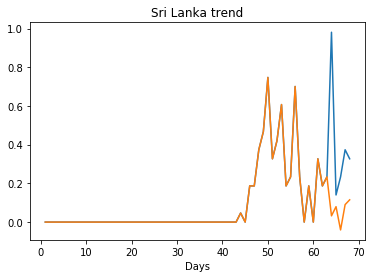

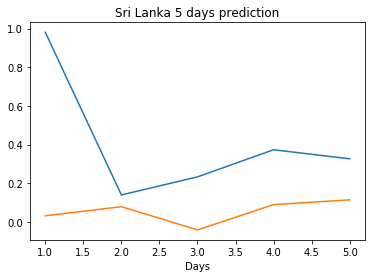

Creating directory ./offline5/Taiwan*/training/
Taiwan*
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1448
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0957


/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Saving the best model weights at Epoch [3], Best Valid Loss: 0.0755
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0689
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0657
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0550
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0414
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0340
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0300
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0290
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0222
train error: 0.03436201339661095
0.02219553105533123
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1284
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1014
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0824
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0459
Saving the best model weights at Epoch [6], Best Valid Loss: 

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0457
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0401
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0221
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0097
train error: 0.03919304923252448
0.009744588285684586
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1419
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0928
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0696
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0539
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0477
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0190
Saving the best model weights at Epoch [8], Best Valid Loss

train error: 0.03641572874345768
0.02131853997707367
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0369
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0148
train error: 0.02641915355956084
0.014815719798207283
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1852
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1244
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1189
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0920
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0878
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0772
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0696
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0693
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0512
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0468
Sa

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0557
train error: 0.13077705027535558
0.05571521446108818
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1643
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1521
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0711
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0326
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0305
train error: 0.1302423232210506
0.030477851629257202
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1264
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1154
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1043
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0987
train error: 0.1229223856506379
0.09873347729444504
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1372
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1266
Saving the best model w

Saving the best model weights at Epoch [11], Best Valid Loss: 0.1091
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1064
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1049
train error: 0.12411797963278859
0.10490691661834717
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1219
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1157
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1127
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1046
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0967
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0893
train error: 0.12437413027510047
0.08933456987142563
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1482
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1425
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0829
train error: 0.12733873060757392
0.08289863914251328
Saving the best mode

Saving the best model weights at Epoch [2], Best Valid Loss: 0.1240
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0447
train error: 0.1292343466591678
0.04466157406568527
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0951
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0111
train error: 0.13804334028329895
0.011100192554295063
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1197
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1164
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1159
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1128
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1020
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0980
train error: 0.12413067919643302
0.09800704568624496
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1454
Saving the best mode

Saving the best model weights at Epoch [8], Best Valid Loss: 0.1490
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1418
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1368
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1314
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1279
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1256
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1229
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1208
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1186
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1165
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1157
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1146
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1135
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1131
Saving the best model weights at Epo

Saving the best model weights at Epoch [30], Best Valid Loss: 0.0173
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0170
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0150
train error: 0.051103964717568534
0.014976306818425655
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1436
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1103
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1050
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0974
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0963
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0772
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0540
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0531
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0436
Saving the best model weights at Epoch [10], Best Valid L

Saving the best model weights at Epoch [2], Best Valid Loss: 0.1831
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1588
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1422
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1299
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1218
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1156
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1098
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1032
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1031
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0977
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0959
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0930
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0918
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0877
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [24], Best Valid Loss: 0.1101
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1083
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1072
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1056
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1048
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1031
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1012
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0996
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0989
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0978
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0964
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0951
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0942
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0932
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0325
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0301
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0289
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0271
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0255
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0226
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0217
train error: 0.07699190533572906
0.021714622154831886
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2774
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1921
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1549
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1310
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1176
Saving the best model weights at Epoch [6], Best Valid

Saving the best model weights at Epoch [19], Best Valid Loss: 0.0885
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0874
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0850
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0835
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0816
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0796
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0790
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0771
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0759
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0739
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0725
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0706
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0684
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0670
Saving the best model weights at E

Saving the best model weights at Epoch [9], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0183
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0126
train error: 0.041020798760368245
0.012642738409340382
Saving the best model weights at Epoch [1], Best Valid Loss: 0.4408
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3710
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3189
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2782
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2474
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2237
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2051
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1907
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1793
Saving the best model weights at Epoch [10], Best Valid Lo

Saving the best model weights at Epoch [2], Best Valid Loss: 0.3056
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2681
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2399
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2179
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1992
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1850
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1747
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1664
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1600
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1548
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1501
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1465
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1435
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1397
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [5], Best Valid Loss: 0.1872
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1766
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1683
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1618
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1565
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1526
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1489
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1462
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1434
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1411
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1390
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1380
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1363
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1359
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [12], Best Valid Loss: 0.1491
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1448
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1417
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1397
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1384
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1366
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1358
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1344
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1332
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1324
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1319
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1313
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1309
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1302
Saving the best model weights at E

Saving the best model weights at Epoch [8], Best Valid Loss: 0.1617
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1561
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1514
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1469
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1436
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1412
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1390
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1374
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1361
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1353
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1344
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1337
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1325
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1320
Saving the best model weights at Epo

Saving the best model weights at Epoch [4], Best Valid Loss: 0.2429
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2170
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1968
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1808
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1697
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1603
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1519
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1466
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1430
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1396
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1373
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1351
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1344
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1321
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [8], Best Valid Loss: 0.1395
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1357
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1329
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1317
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1306
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1286
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1285
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1284
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1278
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1266
train error: 0.12018131300512898
0.12659712135791779
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2634
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2046
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1708
Saving the best model weights at Epoch [4], Best Valid 

Saving the best model weights at Epoch [6], Best Valid Loss: 0.1404
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1312
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1275
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1257
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1250
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1241
train error: 0.12038228121635161
0.12409549206495285
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1525
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1378
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1230
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1026
train error: 0.12197656775089472
0.10262439399957657
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3357
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2877
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2511
Saving

Saving the best model weights at Epoch [10], Best Valid Loss: 0.1533
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1487
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1452
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1423
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1398
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1386
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1368
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1354
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1345
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1342
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1331
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1322
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1318
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1312
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.1291
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1290
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1288
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1287
train error: 0.1198793682269752
0.12866352498531342
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3346
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2813
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2427
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2153
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1951
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1779
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1676
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1585
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1516
Saving the best model weights at Epoch [10], Best Valid Loss

Saving the best model weights at Epoch [28], Best Valid Loss: 0.1298
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1293
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1290
train error: 0.12009247836019647
0.12899179756641388
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2571
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2145
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1865
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1696
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1570
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1483
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1440
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1394
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1366
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1319
Saving the best model weights at Epoch [11], Best Valid Los

Saving the best model weights at Epoch [8], Best Valid Loss: 0.1303
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1289
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1287
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1263
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1261
train error: 0.12122359099846922
0.12610246241092682
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1475
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1224
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1133
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1124
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1089
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1080
train error: 0.12180120458728388
0.10799632221460342
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3682
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3160
Savi

Saving the best model weights at Epoch [14], Best Valid Loss: 0.1413
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1392
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1378
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1360
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1346
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1342
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1335
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1327
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1319
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1316
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1311
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1307
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1306
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1303
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.2439
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2144
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1939
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1795
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1687
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1598
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1525
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1483
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1433
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1400
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1388
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1359
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1349
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1330
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [13], Best Valid Loss: 0.3095
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3032
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2972
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2915
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2861
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2806
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2754
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2704
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2656
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2611
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2563
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2519
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2479
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2437
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.1877
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1851
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1830
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1805
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1777
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1757
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1731
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1717
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1698
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1676
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1665
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1643
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1626
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1620
Saving the best model weights at E

Saving the best model weights at Epoch [9], Best Valid Loss: 0.3177
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3108
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3043
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2979
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2916
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2857
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2798
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2742
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2689
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2637
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2587
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2538
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2492
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2447
Saving the best model weights at Ep

Saving the best model weights at Epoch [29], Best Valid Loss: 0.1485
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1459
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1424
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1393
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1369
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1340
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1326
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1296
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1272
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1258
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1233
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1217
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1204
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1184
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.3233
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3169
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3106
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3046
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2990
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2933
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2879
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2827
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2776
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2728
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2682
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2635
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2592
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2549
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [20], Best Valid Loss: 0.1974
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1936
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1880
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1844
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1798
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1762
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1730
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1692
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1659
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1630
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1600
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1578
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1552
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1527
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.2080
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2063
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2046
train error: 0.12809483655483314
0.20458625257015228
Saving the best model weights at Epoch [1], Best Valid Loss: 0.4000
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3909
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3824
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3741
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3663
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3584
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3510
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3438
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3368
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3302
Saving the best model weights at Epoch [11], Best Valid Los

Saving the best model weights at Epoch [15], Best Valid Loss: 0.1961
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1917
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1859
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1808
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1764
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1724
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1683
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1643
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1611
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1580
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1551
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1523
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1492
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1466
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 0.2195
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2173
Saving the best model weights at Epoch [42], Best Valid Loss: 0.2151
Saving the best model weights at Epoch [43], Best Valid Loss: 0.2130
Saving the best model weights at Epoch [44], Best Valid Loss: 0.2110
Saving the best model weights at Epoch [45], Best Valid Loss: 0.2090
Saving the best model weights at Epoch [46], Best Valid Loss: 0.2070
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2051
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2033
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2015
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1997
train error: 0.13509228781453872
0.19972625374794006
Saving the best model weights at Epoch [1], Best Valid Loss: 0.4727
Saving the best model weights at Epoch [2], Best Valid Loss: 0.4611
Saving the best model weights at Epoch [3], Best Val

Saving the best model weights at Epoch [7], Best Valid Loss: 0.2369
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2296
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2237
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2181
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2123
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2067
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2026
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1975
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1933
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1899
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1860
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1826
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1794
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1762
Saving the best model weights at Epoc

Saving the best model weights at Epoch [1], Best Valid Loss: 0.3037
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2985
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2936
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2889
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2843
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2799
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2756
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2715
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2675
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2636
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2597
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2561
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2525
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2491
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [20], Best Valid Loss: 0.1690
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1673
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1647
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1629
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1612
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1594
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1578
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1567
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1549
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1536
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1527
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1518
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1501
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1489
Saving the best model weights at E

Saving the best model weights at Epoch [11], Best Valid Loss: 0.2744
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2703
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2661
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2622
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2585
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2547
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2511
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2477
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2442
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2410
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2378
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2348
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2319
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2290
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.1621
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1594
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1583
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1565
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1542
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1529
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1518
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1498
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1486
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1475
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1465
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1459
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1449
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1439
Saving the best model weights at E

Saving the best model weights at Epoch [22], Best Valid Loss: 0.2500
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2467
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2433
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2399
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2368
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2338
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2308
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2279
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2253
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2226
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2199
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2174
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2151
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2126
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 0.1460
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1451
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1439
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1437
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1429
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1416
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1416
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1400
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1395
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1389
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1385
train error: 0.11943420608478941
0.1385265439748764
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3735
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3252
Saving the best model weights at Epoch [3], Best Vali

Saving the best model weights at Epoch [28], Best Valid Loss: 0.2504
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2470
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2438
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2407
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2376
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2347
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2319
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2292
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2265
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2238
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2214
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2190
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2165
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2142
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.1585
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1568
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1558
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1542
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1528
train error: 0.12058396353141258
0.15275327861309052
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3288
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2903
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2628
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2339
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2135
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1986
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1836
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1752
Saving the best model weights at Epoch [9], Best Valid Los

Saving the best model weights at Epoch [38], Best Valid Loss: 0.1881
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1865
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1850
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1836
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1822
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1807
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1793
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1781
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1768
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1755
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1744
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1731
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1720
train error: 0.12393488764370743
0.1719980686903
Saving the best model weights at Epoch [1], Best Valid

Saving the best model weights at Epoch [5], Best Valid Loss: 0.2053
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1912
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1791
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1690
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1657
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1592
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1563
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1492
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1445
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1433
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1400
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1398
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1378
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1361
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [48], Best Valid Loss: 0.1891
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1877
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1860
train error: 0.12587306498991033
0.18602998554706573
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3428
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3339
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3251
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3169
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3093
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3019
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2943
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2878
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2812
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2749
Saving the best model weights at Epoch [11], Best Valid Los

Saving the best model weights at Epoch [16], Best Valid Loss: 0.1395
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1385
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1356
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1346
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1325
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1296
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1288
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1284
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1282
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1275
train error: 0.11956596972518846
0.127454474568367
Saving the best model weights at Epoch [1], Best Valid Loss: 0.4012
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3947
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3885
Saving the best model weights at Epoch [4], Best Valid 

Saving the best model weights at Epoch [9], Best Valid Loss: 0.3140
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3065
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2994
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2928
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2862
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2799
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2742
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2686
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2633
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2578
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2528
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2479
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2434
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2390
Saving the best model weights at Ep

train error: 0.11960147857960117
0.12694762647151947
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3013
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2973
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2934
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2896
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2859
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2822
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2788
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2753
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2719
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2687
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2655
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2624
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2594
Saving the best model weights at Epoch [14], Best Valid Los

Saving the best model weights at Epoch [18], Best Valid Loss: 0.2258
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2220
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2188
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2151
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2118
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2087
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2061
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2029
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2003
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1975
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1948
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1924
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1902
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1878
Saving the best model weights at E

Saving the best model weights at Epoch [12], Best Valid Loss: 0.2352
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2329
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2306
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2283
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2261
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2240
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2219
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2198
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2179
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2159
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2141
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2122
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2104
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2086
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.1815
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1796
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1778
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1758
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1743
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1725
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1709
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1693
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1682
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1665
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1651
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1640
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1626
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1614
Saving the best model weights at E

Saving the best model weights at Epoch [22], Best Valid Loss: 0.2607
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2578
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2549
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2521
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2494
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2467
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2441
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2416
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2391
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2367
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2343
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2320
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2298
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2276
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 0.1875
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1854
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1834
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1815
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1797
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1778
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1761
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1748
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1729
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1715
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1700
train error: 0.12274092470148676
0.17002931237220764
Saving the best model weights at Epoch [1], Best Valid Loss: 0.4032
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3837
Saving the best model weights at Epoch [3], Best Val

Saving the best model weights at Epoch [28], Best Valid Loss: 0.2620
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2591
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2563
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2536
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2509
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2483
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2457
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2432
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2408
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2384
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2361
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2338
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2316
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2295
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.1703
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1692
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1678
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1661
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1648
train error: 0.12292593602385175
0.16476629674434662
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3176
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3059
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2941
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2833
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2730
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2640
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2549
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2478
Saving the best model weights at Epoch [9], Best Valid Los

Saving the best model weights at Epoch [38], Best Valid Loss: 0.2585
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2557
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2529
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2503
Saving the best model weights at Epoch [42], Best Valid Loss: 0.2477
Saving the best model weights at Epoch [43], Best Valid Loss: 0.2452
Saving the best model weights at Epoch [44], Best Valid Loss: 0.2427
Saving the best model weights at Epoch [45], Best Valid Loss: 0.2403
Saving the best model weights at Epoch [46], Best Valid Loss: 0.2379
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2356
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2333
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2311
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2290
train error: 0.13779134977314816
0.22899805009365082
Saving the best model weights at Epoch [1], Best V

Saving the best model weights at Epoch [6], Best Valid Loss: 0.4065
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3880
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3691
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3538
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3382
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3238
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3110
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2994
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2879
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2783
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2686
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2590
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2514
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2435
Saving the best model weights at Epoch

Saving the best model weights at Epoch [48], Best Valid Loss: 0.2002
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1987
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1972
train error: 0.13022290635854006
0.19724750518798828
Saving the best model weights at Epoch [1], Best Valid Loss: 0.4241
Saving the best model weights at Epoch [2], Best Valid Loss: 0.4152
Saving the best model weights at Epoch [3], Best Valid Loss: 0.4067
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3985
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3904
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3828
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3752
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3680
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3611
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3545
Saving the best model weights at Epoch [11], Best Valid Los

Saving the best model weights at Epoch [16], Best Valid Loss: 0.2405
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2341
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2271
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2215
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2158
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2105
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2066
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2014
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1968
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1932
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1892
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1859
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1830
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1797
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.4055
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3973
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3892
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3813
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3735
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3662
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3593
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3523
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3457
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3392
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3331
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3271
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3214
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3158
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [22], Best Valid Loss: 0.1788
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1759
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1741
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1704
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1682
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1663
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1637
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1617
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1604
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1581
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1574
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1552
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1538
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1522
Saving the best model weights at E

Saving the best model weights at Epoch [14], Best Valid Loss: 0.2774
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2733
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2690
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2651
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2612
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2576
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2539
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2503
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2470
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2437
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2405
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2375
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2344
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2315
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.1669
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1648
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1631
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1611
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1596
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1577
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1567
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1547
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1531
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1515
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1502
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1494
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1488
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1479
Saving the best model weights at E

Saving the best model weights at Epoch [24], Best Valid Loss: 0.1093
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1077
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1056
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1039
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1023
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1009
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0998
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0981
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0972
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0960
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0948
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0937
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0930
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0916
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.2221
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1520
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1278
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1105
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1049
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1040
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0938
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0780
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0745
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0661
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0624
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0579
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0504
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0478
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [49], Best Valid Loss: 0.0911
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0904
train error: 0.11226065795084364
0.09040603786706924
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3303
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2916
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2609
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2363
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2165
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2008
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1865
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1772
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1686
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1596
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1533
Saving the best model weights at Epoch [12], Best Valid Los

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0114
train error: 0.04494512918417489
0.01140010915696621
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3595
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3312
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3067
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2850
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2660
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2494
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2346
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2213
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2094
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1991
Saving the best model weights at Epoch [11], Best Valid Los

Saving the best model weights at Epoch [17], Best Valid Loss: 0.1160
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1133
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1108
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1090
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1070
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1045
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1023
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1007
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0994
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0976
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0964
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0961
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0933
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0922
Saving the best model weights at E

Saving the best model weights at Epoch [21], Best Valid Loss: 0.1492
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1455
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1423
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1391
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1363
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1338
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1316
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1292
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1272
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1256
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1239
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1223
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1207
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1192
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0741
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0735
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0713
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0701
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0699
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0684
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0675
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0653
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0640
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0634
train error: 0.10070093012856025
0.06338532269001007
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3655
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2920
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2395
Saving the best model weights at Epoch [4], Best Vali

Saving the best model weights at Epoch [41], Best Valid Loss: 0.1332
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1328
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1324
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1323
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1320
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1318
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1317
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1313
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1310
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1307
train error: 0.11928116334112067
0.1307467222213745
Saving the best model weights at Epoch [1], Best Valid Loss: 0.4193
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3766
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3395
Saving the best model weights at Epoch [4], Best Valid

Saving the best model weights at Epoch [3], Best Valid Loss: 0.3479
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3243
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3038
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2855
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2694
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2550
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2424
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2312
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2211
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2125
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2044
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1972
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1907
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1848
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [28], Best Valid Loss: 0.1293
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1292
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1290
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1280
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1277
train error: 0.11943213119612713
0.1276676505804062
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2485
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2129
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1908
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1692
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1579
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1529
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1468
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1414
Saving the best model weights at Epoch [9], Best Valid Loss

Saving the best model weights at Epoch [36], Best Valid Loss: 0.1295
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1294
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1294
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1290
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1289
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1288
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1286
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1285
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1283
train error: 0.11944220930730041
0.12834692001342773
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3085
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2758
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2498
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2266
Saving the best model weights at Epoch [5], Best Valid

Saving the best model weights at Epoch [40], Best Valid Loss: 0.1321
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1317
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1314
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1310
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1308
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1304
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1300
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1299
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1294
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1292
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1290
train error: 0.11919139440808642
0.12899191677570343
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3451
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3143
Saving the best model weights at Epoch [3], Best Val

Saving the best model weights at Epoch [3], Best Valid Loss: 0.1403
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1339
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1284
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1225
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1216
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1167
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1165
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1153
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1142
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1118
train error: 0.1190234757224588
0.11178459227085114
Saving the best model weights at Epoch [1], Best Valid Loss: 0.4357
Saving the best model weights at Epoch [2], Best Valid Loss: 0.4010
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3705
Saving the best model weights at Epoch [4], Best Valid Loss

Saving the best model weights at Epoch [14], Best Valid Loss: 0.1449
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1438
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1411
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1396
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1372
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1357
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1338
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1334
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1331
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1323
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1314
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1312
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1309
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1303
Saving the best model weights at E

Saving the best model weights at Epoch [21], Best Valid Loss: 0.1458
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1437
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1423
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1407
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1393
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1383
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1380
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1367
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1360
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1354
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1348
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1338
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1337
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1329
Saving the best model weights at E

Saving the best model weights at Epoch [28], Best Valid Loss: 0.1427
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1414
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1404
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1395
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1385
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1376
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1367
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1359
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1354
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1348
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1343
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1338
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1334
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1330
Saving the best model weights at E

Saving the best model weights at Epoch [23], Best Valid Loss: 0.1291
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1287
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1284
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1283
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1269
train error: 0.12019500016283832
0.12693244218826294
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2113
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1523
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1374
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1250
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1236
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1201
train error: 0.120949500313911
0.12011565268039703
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3336
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3108
Savin

Saving the best model weights at Epoch [15], Best Valid Loss: 0.1439
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1414
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1406
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1382
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1371
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1355
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1336
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1328
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1319
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1316
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1302
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1299
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1294
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1288
train error: 0.11983749464056209
0

Saving the best model weights at Epoch [24], Best Valid Loss: 0.1526
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1501
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1480
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1462
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1442
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1427
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1417
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1399
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1388
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1382
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1370
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1365
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1356
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1346
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.1383
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1377
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1370
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1364
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1357
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1352
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1348
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1341
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1337
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1333
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1330
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1327
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1323
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1320
Saving the best model weights at E

Saving the best model weights at Epoch [20], Best Valid Loss: 0.1289
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1285
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1270
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1259
train error: 0.12071189671558769
0.12588949501514435
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2191
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1552
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1373
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1261
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1253
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1206
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1189
train error: 0.12082490234292652
0.11885464191436768
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3732
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3464
Savi

Saving the best model weights at Epoch [13], Best Valid Loss: 0.1460
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1435
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1416
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1393
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1379
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1366
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1363
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1349
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1332
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1330
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1315
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1308
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1303
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1298
Saving the best model weights at E

Saving the best model weights at Epoch [24], Best Valid Loss: 0.1387
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1379
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1368
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1361
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1352
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1349
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1340
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1338
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1334
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1326
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1322
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1318
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1315
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1312
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.1317
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1315
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1315
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1314
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1312
train error: 0.11963758071100242
0.13116340339183807
Saving the best model weights at Epoch [1], Best Valid Loss: 0.4400
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3930
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3548
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3231
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2964
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2734
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2542
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2371
Saving the best model weights at Epoch [9], Best Valid Los

Saving the best model weights at Epoch [6], Best Valid Loss: 0.2240
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2141
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2053
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1977
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1908
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1848
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1793
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1744
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1701
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1662
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1627
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1593
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1567
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1542
Saving the best model weights at Epoch

Saving the best model weights at Epoch [28], Best Valid Loss: 0.1302
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1300
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1292
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1291
train error: 0.1197837774249676
0.1291036158800125
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3347
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2774
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2313
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2067
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1846
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1680
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1607
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1516
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1445
Saving the best model weights at Epoch [10], Best Valid Loss:

Saving the best model weights at Epoch [36], Best Valid Loss: 0.1320
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1315
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1309
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1308
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1305
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1302
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1301
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1299
train error: 0.11967967933435973
0.12993405759334564
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3767
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3289
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2885
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2586
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2346
Saving the best model weights at Epoch [6], Best Valid 

Saving the best model weights at Epoch [48], Best Valid Loss: 0.1321
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1320
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1318
train error: 0.1196165389479383
0.1318420022726059
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3414
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3120
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2879
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2674
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2487
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2333
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2201
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2088
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1991
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1899
Saving the best model weights at Epoch [11], Best Valid Loss:

Saving the best model weights at Epoch [12], Best Valid Loss: 0.2023
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2021
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2019
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2017
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2014
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2012
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2010
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2008
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2006
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2004
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2002
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2000
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1998
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1996
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.4182
Saving the best model weights at Epoch [32], Best Valid Loss: 0.4168
Saving the best model weights at Epoch [33], Best Valid Loss: 0.4154
Saving the best model weights at Epoch [34], Best Valid Loss: 0.4140
Saving the best model weights at Epoch [35], Best Valid Loss: 0.4127
Saving the best model weights at Epoch [36], Best Valid Loss: 0.4113
Saving the best model weights at Epoch [37], Best Valid Loss: 0.4100
Saving the best model weights at Epoch [38], Best Valid Loss: 0.4086
Saving the best model weights at Epoch [39], Best Valid Loss: 0.4073
Saving the best model weights at Epoch [40], Best Valid Loss: 0.4060
Saving the best model weights at Epoch [41], Best Valid Loss: 0.4047
Saving the best model weights at Epoch [42], Best Valid Loss: 0.4034
Saving the best model weights at Epoch [43], Best Valid Loss: 0.4020
Saving the best model weights at Epoch [44], Best Valid Loss: 0.4007
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 0.1754
train error: 0.1316710269617799
0.1753515750169754
Saving the best model weights at Epoch [1], Best Valid Loss: 0.4321
Saving the best model weights at Epoch [2], Best Valid Loss: 0.4314
Saving the best model weights at Epoch [3], Best Valid Loss: 0.4306
Saving the best model weights at Epoch [4], Best Valid Loss: 0.4298
Saving the best model weights at Epoch [5], Best Valid Loss: 0.4290
Saving the best model weights at Epoch [6], Best Valid Loss: 0.4283
Saving the best model weights at Epoch [7], Best Valid Loss: 0.4275
Saving the best model weights at Epoch [8], Best Valid Loss: 0.4267
Saving the best model weights at Epoch [9], Best Valid Loss: 0.4260
Saving the best model weights at Epoch [10], Best Valid Loss: 0.4252
Saving the best model weights at Epoch [11], Best Valid Loss: 0.4244
Saving the best model weights at Epoch [12], Best Valid Loss: 0.4237
Saving the best model weights at Epoch [13], Best Valid Loss:

Saving the best model weights at Epoch [18], Best Valid Loss: 0.3277
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3268
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3258
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3249
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3240
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3232
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3223
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3213
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3205
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3196
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3188
Saving the best model weights at Epoch [29], Best Valid Loss: 0.3179
Saving the best model weights at Epoch [30], Best Valid Loss: 0.3170
Saving the best model weights at Epoch [31], Best Valid Loss: 0.3161
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 0.2359
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2328
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2303
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2275
Saving the best model weights at Epoch [42], Best Valid Loss: 0.2255
Saving the best model weights at Epoch [43], Best Valid Loss: 0.2221
Saving the best model weights at Epoch [44], Best Valid Loss: 0.2200
Saving the best model weights at Epoch [45], Best Valid Loss: 0.2179
Saving the best model weights at Epoch [46], Best Valid Loss: 0.2152
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2132
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2111
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2092
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2067
train error: 0.13322390946804694
0.20671501755714417
Saving the best model weights at Epoch [1], Best V

Saving the best model weights at Epoch [5], Best Valid Loss: 0.3362
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3351
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3342
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3331
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3322
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3312
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3302
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3292
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3283
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3273
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3263
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3254
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3244
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3235
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [25], Best Valid Loss: 0.2719
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2682
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2652
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2620
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2591
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2562
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2534
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2511
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2476
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2453
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2422
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2398
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2371
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2349
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 0.3895
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3887
Saving the best model weights at Epoch [47], Best Valid Loss: 0.3878
Saving the best model weights at Epoch [48], Best Valid Loss: 0.3869
Saving the best model weights at Epoch [49], Best Valid Loss: 0.3861
Saving the best model weights at Epoch [50], Best Valid Loss: 0.3852
train error: 0.19833692440174913
0.38524356484413147
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3913
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3901
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3890
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3878
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3867
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3855
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3844
Saving the best model weights at Epoch [8], Best Valid Lo

Saving the best model weights at Epoch [12], Best Valid Loss: 0.2746
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2713
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2680
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2649
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2620
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2591
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2560
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2534
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2504
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2481
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2451
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2431
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2399
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2380
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.4031
Saving the best model weights at Epoch [32], Best Valid Loss: 0.4023
Saving the best model weights at Epoch [33], Best Valid Loss: 0.4014
Saving the best model weights at Epoch [34], Best Valid Loss: 0.4006
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3997
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3989
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3980
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3972
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3964
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3955
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3947
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3939
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3930
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3922
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 0.4266
train error: 0.22938115801662207
0.426593542098999
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2705
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2672
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2642
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2609
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2580
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2556
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2524
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2500
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2470
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2444
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2421
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2396
Saving the best model weights at Epoch [13], Best Valid Loss:

Saving the best model weights at Epoch [17], Best Valid Loss: 0.3893
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3884
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3876
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3868
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3860
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3852
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3844
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3835
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3827
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3819
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3811
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3803
Saving the best model weights at Epoch [29], Best Valid Loss: 0.3795
Saving the best model weights at Epoch [30], Best Valid Loss: 0.3787
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.3654
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3638
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3622
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3607
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3591
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3575
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3560
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3544
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3528
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3513
Saving the best model weights at Epoch [45], Best Valid Loss: 0.3498
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3483
Saving the best model weights at Epoch [47], Best Valid Loss: 0.3468
Saving the best model weights at Epoch [48], Best Valid Loss: 0.3454
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.3909
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3901
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3893
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3885
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3877
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3870
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3862
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3854
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3847
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3839
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3831
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3824
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3816
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3808
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [24], Best Valid Loss: 0.3230
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3217
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3203
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3189
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3176
Saving the best model weights at Epoch [29], Best Valid Loss: 0.3162
Saving the best model weights at Epoch [30], Best Valid Loss: 0.3150
Saving the best model weights at Epoch [31], Best Valid Loss: 0.3136
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3124
Saving the best model weights at Epoch [33], Best Valid Loss: 0.3111
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3097
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3085
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3072
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3060
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.3740
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3734
Saving the best model weights at Epoch [45], Best Valid Loss: 0.3728
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3723
Saving the best model weights at Epoch [47], Best Valid Loss: 0.3717
Saving the best model weights at Epoch [48], Best Valid Loss: 0.3711
Saving the best model weights at Epoch [49], Best Valid Loss: 0.3706
Saving the best model weights at Epoch [50], Best Valid Loss: 0.3700
train error: 0.18442799601287238
0.3700171113014221
Saving the best model weights at Epoch [1], Best Valid Loss: 0.4039
Saving the best model weights at Epoch [2], Best Valid Loss: 0.4030
Saving the best model weights at Epoch [3], Best Valid Loss: 0.4021
Saving the best model weights at Epoch [4], Best Valid Loss: 0.4013
Saving the best model weights at Epoch [5], Best Valid Loss: 0.4005
Saving the best model weights at Epoch [6], Best Valid L

Saving the best model weights at Epoch [12], Best Valid Loss: 0.3556
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3540
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3524
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3508
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3494
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3478
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3463
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3447
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3433
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3417
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3403
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3388
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3373
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3359
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.3035
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3031
Saving the best model weights at Epoch [33], Best Valid Loss: 0.3027
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3023
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3018
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3014
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3010
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3006
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3002
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2997
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2993
Saving the best model weights at Epoch [42], Best Valid Loss: 0.2989
Saving the best model weights at Epoch [43], Best Valid Loss: 0.2985
Saving the best model weights at Epoch [44], Best Valid Loss: 0.2981
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 0.5277
train error: 0.2829271310352181
0.5277273058891296
Saving the best model weights at Epoch [1], Best Valid Loss: 0.4254
Saving the best model weights at Epoch [2], Best Valid Loss: 0.4232
Saving the best model weights at Epoch [3], Best Valid Loss: 0.4210
Saving the best model weights at Epoch [4], Best Valid Loss: 0.4188
Saving the best model weights at Epoch [5], Best Valid Loss: 0.4168
Saving the best model weights at Epoch [6], Best Valid Loss: 0.4147
Saving the best model weights at Epoch [7], Best Valid Loss: 0.4127
Saving the best model weights at Epoch [8], Best Valid Loss: 0.4106
Saving the best model weights at Epoch [9], Best Valid Loss: 0.4086
Saving the best model weights at Epoch [10], Best Valid Loss: 0.4065
Saving the best model weights at Epoch [11], Best Valid Loss: 0.4045
Saving the best model weights at Epoch [12], Best Valid Loss: 0.4025
Saving the best model weights at Epoch [13], Best Valid Loss:

Saving the best model weights at Epoch [18], Best Valid Loss: 0.3469
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3464
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3458
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3453
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3448
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3442
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3437
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3432
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3427
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3421
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3416
Saving the best model weights at Epoch [29], Best Valid Loss: 0.3411
Saving the best model weights at Epoch [30], Best Valid Loss: 0.3406
Saving the best model weights at Epoch [31], Best Valid Loss: 0.3401
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.2876
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2869
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2863
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2857
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2850
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2844
Saving the best model weights at Epoch [42], Best Valid Loss: 0.2838
Saving the best model weights at Epoch [43], Best Valid Loss: 0.2832
Saving the best model weights at Epoch [44], Best Valid Loss: 0.2826
Saving the best model weights at Epoch [45], Best Valid Loss: 0.2820
Saving the best model weights at Epoch [46], Best Valid Loss: 0.2814
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2807
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2802
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2796
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.4574
Saving the best model weights at Epoch [5], Best Valid Loss: 0.4566
Saving the best model weights at Epoch [6], Best Valid Loss: 0.4558
Saving the best model weights at Epoch [7], Best Valid Loss: 0.4549
Saving the best model weights at Epoch [8], Best Valid Loss: 0.4541
Saving the best model weights at Epoch [9], Best Valid Loss: 0.4533
Saving the best model weights at Epoch [10], Best Valid Loss: 0.4525
Saving the best model weights at Epoch [11], Best Valid Loss: 0.4516
Saving the best model weights at Epoch [12], Best Valid Loss: 0.4508
Saving the best model weights at Epoch [13], Best Valid Loss: 0.4500
Saving the best model weights at Epoch [14], Best Valid Loss: 0.4492
Saving the best model weights at Epoch [15], Best Valid Loss: 0.4484
Saving the best model weights at Epoch [16], Best Valid Loss: 0.4476
Saving the best model weights at Epoch [17], Best Valid Loss: 0.4468
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [22], Best Valid Loss: 0.2846
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2840
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2833
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2827
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2821
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2815
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2808
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2802
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2796
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2790
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2784
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2777
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2771
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2765
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.2211
Saving the best model weights at Epoch [42], Best Valid Loss: 0.2198
Saving the best model weights at Epoch [43], Best Valid Loss: 0.2178
Saving the best model weights at Epoch [44], Best Valid Loss: 0.2164
Saving the best model weights at Epoch [45], Best Valid Loss: 0.2145
Saving the best model weights at Epoch [46], Best Valid Loss: 0.2130
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2114
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2099
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2088
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2067
train error: 0.13114085469983125
0.20668135583400726
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3675
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3669
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3663
Saving the best model weights at Epoch [4], Best Vali

Saving the best model weights at Epoch [8], Best Valid Loss: 0.3404
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3395
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3386
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3377
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3368
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3359
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3351
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3342
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3333
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3324
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3316
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3307
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3298
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3290
Saving the best model weights at Epo

Saving the best model weights at Epoch [26], Best Valid Loss: 0.2766
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2732
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2703
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2678
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2653
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2622
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2595
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2567
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2545
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2521
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2494
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2473
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2449
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2424
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.3001
Saving the best model weights at Epoch [45], Best Valid Loss: 0.2996
Saving the best model weights at Epoch [46], Best Valid Loss: 0.2991
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2986
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2981
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2977
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2972
train error: 0.16054904833436012
0.29717493057250977
Saving the best model weights at Epoch [1], Best Valid Loss: 0.4820
Saving the best model weights at Epoch [2], Best Valid Loss: 0.4803
Saving the best model weights at Epoch [3], Best Valid Loss: 0.4787
Saving the best model weights at Epoch [4], Best Valid Loss: 0.4770
Saving the best model weights at Epoch [5], Best Valid Loss: 0.4754
Saving the best model weights at Epoch [6], Best Valid Loss: 0.4737
Saving the best model weights at Epoch [7], Best Valid L

Saving the best model weights at Epoch [12], Best Valid Loss: 0.2904
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2874
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2841
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2816
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2780
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2755
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2722
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2696
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2667
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2640
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2616
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2588
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2566
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2536
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.3819
Saving the best model weights at Epoch [31], Best Valid Loss: 0.3812
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3804
Saving the best model weights at Epoch [33], Best Valid Loss: 0.3796
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3789
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3781
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3774
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3766
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3759
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3751
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3744
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3736
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3729
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3721
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.2841
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2831
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2820
train error: 0.15681478636351562
0.2819994390010834
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3949
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3888
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3833
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3778
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3719
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3670
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3618
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3570
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3516
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3472
Saving the best model weights at Epoch [11], Best Valid Loss

Saving the best model weights at Epoch [16], Best Valid Loss: 0.3983
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3974
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3966
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3958
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3949
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3941
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3933
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3925
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3916
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3908
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3900
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3892
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3884
Saving the best model weights at Epoch [29], Best Valid Loss: 0.3875
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.3773
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3756
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3738
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3721
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3704
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3687
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3671
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3655
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3638
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3621
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3605
Saving the best model weights at Epoch [45], Best Valid Loss: 0.3589
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3573
Saving the best model weights at Epoch [47], Best Valid Loss: 0.3557
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.3765
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3757
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3749
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3742
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3734
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3727
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3719
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3712
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3704
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3696
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3689
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3681
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3674
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3667
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [20], Best Valid Loss: 0.3385
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3371
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3356
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3341
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3327
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3312
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3299
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3284
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3270
Saving the best model weights at Epoch [29], Best Valid Loss: 0.3257
Saving the best model weights at Epoch [30], Best Valid Loss: 0.3242
Saving the best model weights at Epoch [31], Best Valid Loss: 0.3229
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3216
Saving the best model weights at Epoch [33], Best Valid Loss: 0.3203
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 0.4500
Saving the best model weights at Epoch [39], Best Valid Loss: 0.4492
Saving the best model weights at Epoch [40], Best Valid Loss: 0.4485
Saving the best model weights at Epoch [41], Best Valid Loss: 0.4477
Saving the best model weights at Epoch [42], Best Valid Loss: 0.4469
Saving the best model weights at Epoch [43], Best Valid Loss: 0.4462
Saving the best model weights at Epoch [44], Best Valid Loss: 0.4454
Saving the best model weights at Epoch [45], Best Valid Loss: 0.4447
Saving the best model weights at Epoch [46], Best Valid Loss: 0.4439
Saving the best model weights at Epoch [47], Best Valid Loss: 0.4432
Saving the best model weights at Epoch [48], Best Valid Loss: 0.4424
Saving the best model weights at Epoch [49], Best Valid Loss: 0.4417
Saving the best model weights at Epoch [50], Best Valid Loss: 0.4409
train error: 0.2188427527190039
0.44090554118156433
Saving the best model weights at Epoch [1], Best Va

Saving the best model weights at Epoch [6], Best Valid Loss: 0.4230
Saving the best model weights at Epoch [7], Best Valid Loss: 0.4207
Saving the best model weights at Epoch [8], Best Valid Loss: 0.4185
Saving the best model weights at Epoch [9], Best Valid Loss: 0.4161
Saving the best model weights at Epoch [10], Best Valid Loss: 0.4139
Saving the best model weights at Epoch [11], Best Valid Loss: 0.4117
Saving the best model weights at Epoch [12], Best Valid Loss: 0.4095
Saving the best model weights at Epoch [13], Best Valid Loss: 0.4073
Saving the best model weights at Epoch [14], Best Valid Loss: 0.4051
Saving the best model weights at Epoch [15], Best Valid Loss: 0.4030
Saving the best model weights at Epoch [16], Best Valid Loss: 0.4009
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3988
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3966
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3947
Saving the best model weights at Epoch

Saving the best model weights at Epoch [24], Best Valid Loss: 0.3871
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3864
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3858
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3852
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3845
Saving the best model weights at Epoch [29], Best Valid Loss: 0.3839
Saving the best model weights at Epoch [30], Best Valid Loss: 0.3833
Saving the best model weights at Epoch [31], Best Valid Loss: 0.3827
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3820
Saving the best model weights at Epoch [33], Best Valid Loss: 0.3814
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3808
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3802
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3796
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3790
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.3742
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3731
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3721
Saving the best model weights at Epoch [45], Best Valid Loss: 0.3710
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3700
Saving the best model weights at Epoch [47], Best Valid Loss: 0.3689
Saving the best model weights at Epoch [48], Best Valid Loss: 0.3679
Saving the best model weights at Epoch [49], Best Valid Loss: 0.3669
Saving the best model weights at Epoch [50], Best Valid Loss: 0.3659
train error: 0.19162791517048486
0.3658912777900696
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3832
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3813
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3795
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3776
Saving the best model weights at Epoch [5], Best Valid 

Saving the best model weights at Epoch [10], Best Valid Loss: 0.4078
Saving the best model weights at Epoch [11], Best Valid Loss: 0.4072
Saving the best model weights at Epoch [12], Best Valid Loss: 0.4065
Saving the best model weights at Epoch [13], Best Valid Loss: 0.4058
Saving the best model weights at Epoch [14], Best Valid Loss: 0.4051
Saving the best model weights at Epoch [15], Best Valid Loss: 0.4045
Saving the best model weights at Epoch [16], Best Valid Loss: 0.4038
Saving the best model weights at Epoch [17], Best Valid Loss: 0.4032
Saving the best model weights at Epoch [18], Best Valid Loss: 0.4025
Saving the best model weights at Epoch [19], Best Valid Loss: 0.4018
Saving the best model weights at Epoch [20], Best Valid Loss: 0.4012
Saving the best model weights at Epoch [21], Best Valid Loss: 0.4005
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3999
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3992
Saving the best model weights at E

Saving the best model weights at Epoch [28], Best Valid Loss: 0.3186
Saving the best model weights at Epoch [29], Best Valid Loss: 0.3178
Saving the best model weights at Epoch [30], Best Valid Loss: 0.3171
Saving the best model weights at Epoch [31], Best Valid Loss: 0.3163
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3155
Saving the best model weights at Epoch [33], Best Valid Loss: 0.3147
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3139
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3132
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3124
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3117
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3109
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3102
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3094
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3087
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.2234
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2221
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2198
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2181
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2167
train error: 0.13507962627581468
0.21673567593097687
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3637
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3631
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3626
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3620
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3615
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3609
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3604
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3598
Saving the best model weights at Epoch [9], Best Valid Los

Saving the best model weights at Epoch [14], Best Valid Loss: 0.3238
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3230
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3222
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3215
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3207
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3199
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3191
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3184
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3176
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3168
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3161
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3153
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3145
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3138
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.2509
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2481
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2465
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2440
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2417
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2395
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2374
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2352
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2330
Saving the best model weights at Epoch [42], Best Valid Loss: 0.2312
Saving the best model weights at Epoch [43], Best Valid Loss: 0.2289
Saving the best model weights at Epoch [44], Best Valid Loss: 0.2269
Saving the best model weights at Epoch [45], Best Valid Loss: 0.2253
Saving the best model weights at Epoch [46], Best Valid Loss: 0.2237
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.4995
Saving the best model weights at Epoch [4], Best Valid Loss: 0.4915
Saving the best model weights at Epoch [5], Best Valid Loss: 0.4840
Saving the best model weights at Epoch [6], Best Valid Loss: 0.4761
Saving the best model weights at Epoch [7], Best Valid Loss: 0.4687
Saving the best model weights at Epoch [8], Best Valid Loss: 0.4616
Saving the best model weights at Epoch [9], Best Valid Loss: 0.4543
Saving the best model weights at Epoch [10], Best Valid Loss: 0.4476
Saving the best model weights at Epoch [11], Best Valid Loss: 0.4405
Saving the best model weights at Epoch [12], Best Valid Loss: 0.4340
Saving the best model weights at Epoch [13], Best Valid Loss: 0.4275
Saving the best model weights at Epoch [14], Best Valid Loss: 0.4214
Saving the best model weights at Epoch [15], Best Valid Loss: 0.4152
Saving the best model weights at Epoch [16], Best Valid Loss: 0.4091
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [21], Best Valid Loss: 0.1622
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1585
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1539
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1526
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1490
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1464
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1439
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1411
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1386
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1351
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1340
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1330
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1300
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1282
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.2887
Saving the best model weights at Epoch [44], Best Valid Loss: 0.2865
Saving the best model weights at Epoch [45], Best Valid Loss: 0.2844
Saving the best model weights at Epoch [46], Best Valid Loss: 0.2823
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2802
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2782
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2762
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2742
train error: 0.14563399007372363
0.2742097079753876
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3855
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3791
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3733
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3672
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3614
Saving the best model weights at Epoch [6], Best Valid L

Saving the best model weights at Epoch [10], Best Valid Loss: 0.1927
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1850
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1789
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1757
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1700
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1651
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1613
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1578
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1550
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1516
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1480
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1458
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1442
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1417
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.2372
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2354
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2334
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2316
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2298
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2280
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2263
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2246
Saving the best model weights at Epoch [42], Best Valid Loss: 0.2228
Saving the best model weights at Epoch [43], Best Valid Loss: 0.2211
Saving the best model weights at Epoch [44], Best Valid Loss: 0.2194
Saving the best model weights at Epoch [45], Best Valid Loss: 0.2179
Saving the best model weights at Epoch [46], Best Valid Loss: 0.2162
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2146
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.2893
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2737
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2578
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2424
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2294
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2210
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2089
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2008
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1938
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1855
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1783
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1720
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1666
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1608
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [22], Best Valid Loss: 0.3290
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3258
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3226
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3195
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3164
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3134
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3104
Saving the best model weights at Epoch [29], Best Valid Loss: 0.3075
Saving the best model weights at Epoch [30], Best Valid Loss: 0.3047
Saving the best model weights at Epoch [31], Best Valid Loss: 0.3018
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2990
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2963
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2936
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2909
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.1794
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1772
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1753
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1728
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1712
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1689
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1675
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1652
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1635
train error: 0.12204850143998076
0.16351185739040375
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3661
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3417
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3205
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2997
Saving the best model weights at Epoch [5], Best Valid

Saving the best model weights at Epoch [11], Best Valid Loss: 0.3613
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3573
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3534
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3495
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3457
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3420
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3384
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3349
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3314
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3279
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3245
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3212
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3180
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3149
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.2107
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2077
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2054
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2034
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2009
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1985
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1965
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1943
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1924
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1906
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1885
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1867
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1849
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1835
Saving the best model weights at E

Saving the best model weights at Epoch [7], Best Valid Loss: 0.4075
Saving the best model weights at Epoch [8], Best Valid Loss: 0.4031
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3988
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3945
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3904
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3862
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3822
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3783
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3744
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3706
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3668
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3631
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3595
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3559
Saving the best model weights at Epoc

Saving the best model weights at Epoch [27], Best Valid Loss: 0.2200
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2171
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2141
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2116
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2096
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2068
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2044
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2022
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1998
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1977
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1959
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1937
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1917
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1900
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.4028
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3987
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3945
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3905
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3865
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3826
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3787
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3749
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3712
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3675
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3639
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3603
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3569
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3534
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [24], Best Valid Loss: 0.2634
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2591
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2547
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2504
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2466
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2432
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2390
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2354
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2323
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2286
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2253
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2225
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2193
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2166
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.3828
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3790
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3751
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3714
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3677
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3641
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3606
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3572
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3538
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3504
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3471
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3439
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3407
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3375
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [20], Best Valid Loss: 0.2528
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2483
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2448
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2408
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2368
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2334
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2298
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2268
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2235
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2204
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2175
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2150
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2120
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2097
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.3185
Saving the best model weights at Epoch [47], Best Valid Loss: 0.3162
Saving the best model weights at Epoch [48], Best Valid Loss: 0.3138
Saving the best model weights at Epoch [49], Best Valid Loss: 0.3115
Saving the best model weights at Epoch [50], Best Valid Loss: 0.3092
train error: 0.18635254725813866
0.3092074990272522
Saving the best model weights at Epoch [1], Best Valid Loss: 0.4784
Saving the best model weights at Epoch [2], Best Valid Loss: 0.4729
Saving the best model weights at Epoch [3], Best Valid Loss: 0.4676
Saving the best model weights at Epoch [4], Best Valid Loss: 0.4624
Saving the best model weights at Epoch [5], Best Valid Loss: 0.4574
Saving the best model weights at Epoch [6], Best Valid Loss: 0.4524
Saving the best model weights at Epoch [7], Best Valid Loss: 0.4475
Saving the best model weights at Epoch [8], Best Valid Loss: 0.4426
Saving the best model weights at Epoch [9], Best Valid Loss

Saving the best model weights at Epoch [13], Best Valid Loss: 0.2969
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2911
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2853
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2804
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2746
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2700
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2650
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2603
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2561
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2515
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2478
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2438
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2399
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2361
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.2847
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2830
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2814
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2797
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2781
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2765
Saving the best model weights at Epoch [42], Best Valid Loss: 0.2749
Saving the best model weights at Epoch [43], Best Valid Loss: 0.2733
Saving the best model weights at Epoch [44], Best Valid Loss: 0.2717
Saving the best model weights at Epoch [45], Best Valid Loss: 0.2702
Saving the best model weights at Epoch [46], Best Valid Loss: 0.2687
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2672
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2657
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2642
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.4354
Saving the best model weights at Epoch [4], Best Valid Loss: 0.4246
Saving the best model weights at Epoch [5], Best Valid Loss: 0.4144
Saving the best model weights at Epoch [6], Best Valid Loss: 0.4050
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3950
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3859
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3775
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3687
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3612
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3530
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3454
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3379
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3313
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3248
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [27], Best Valid Loss: 0.3544
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3518
Saving the best model weights at Epoch [29], Best Valid Loss: 0.3492
Saving the best model weights at Epoch [30], Best Valid Loss: 0.3467
Saving the best model weights at Epoch [31], Best Valid Loss: 0.3442
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3417
Saving the best model weights at Epoch [33], Best Valid Loss: 0.3393
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3369
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3345
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3322
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3298
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3275
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3253
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3231
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 0.2210
Saving the best model weights at Epoch [46], Best Valid Loss: 0.2191
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2174
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2157
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2141
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2125
train error: 0.1321050209042273
0.2124839872121811
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3891
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3796
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3716
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3632
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3550
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3480
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3402
Saving the best model weights at Epoch [8], Best Valid Loss

Saving the best model weights at Epoch [21], Best Valid Loss: 0.3326
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3303
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3280
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3258
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3236
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3214
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3192
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3171
Saving the best model weights at Epoch [29], Best Valid Loss: 0.3150
Saving the best model weights at Epoch [30], Best Valid Loss: 0.3129
Saving the best model weights at Epoch [31], Best Valid Loss: 0.3108
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3088
Saving the best model weights at Epoch [33], Best Valid Loss: 0.3068
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3048
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.2476
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2453
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2430
Saving the best model weights at Epoch [42], Best Valid Loss: 0.2407
Saving the best model weights at Epoch [43], Best Valid Loss: 0.2387
Saving the best model weights at Epoch [44], Best Valid Loss: 0.2365
Saving the best model weights at Epoch [45], Best Valid Loss: 0.2344
Saving the best model weights at Epoch [46], Best Valid Loss: 0.2325
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2304
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2286
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2266
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2249
train error: 0.1367850471900678
0.22488322854042053
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3989
Saving the best model weights at Epoch [2], Best Val

Saving the best model weights at Epoch [15], Best Valid Loss: 0.3051
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3027
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3003
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2979
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2956
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2933
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2910
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2888
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2866
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2844
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2823
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2802
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2781
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2761
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.2050
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2035
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2019
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2006
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1990
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1977
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1963
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1950
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1936
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1925
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1911
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1899
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1888
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1876
Saving the best model weights at E

Saving the best model weights at Epoch [15], Best Valid Loss: 0.2966
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2946
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2927
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2908
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2889
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2870
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2852
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2834
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2816
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2798
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2780
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2763
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2746
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2729
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.2480
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2454
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2430
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2406
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2383
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2362
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2342
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2318
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2298
Saving the best model weights at Epoch [42], Best Valid Loss: 0.2277
Saving the best model weights at Epoch [43], Best Valid Loss: 0.2258
Saving the best model weights at Epoch [44], Best Valid Loss: 0.2238
Saving the best model weights at Epoch [45], Best Valid Loss: 0.2220
Saving the best model weights at Epoch [46], Best Valid Loss: 0.2200
Saving the best model weights at E

Saving the best model weights at Epoch [6], Best Valid Loss: 0.3119
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3098
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3077
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3057
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3037
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3017
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2997
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2978
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2959
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2940
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2922
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2903
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2885
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2867
Saving the best model weights at Epoch

Saving the best model weights at Epoch [24], Best Valid Loss: 0.2312
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2290
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2269
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2250
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2231
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2210
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2192
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2173
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2155
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2137
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2118
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2102
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2085
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2069
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.3531
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3505
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3480
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3455
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3430
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3405
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3381
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3357
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3333
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3310
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3286
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3264
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3241
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3219
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [20], Best Valid Loss: 0.2637
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2610
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2582
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2557
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2532
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2505
Saving the best model weights at Epoch [26], Best Valid Loss: 0.2481
Saving the best model weights at Epoch [27], Best Valid Loss: 0.2457
Saving the best model weights at Epoch [28], Best Valid Loss: 0.2435
Saving the best model weights at Epoch [29], Best Valid Loss: 0.2411
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2390
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2368
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2346
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2326
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.1346
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1345
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1344
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1328
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1327
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1324
train error: 0.11964397813732687
0.13236315548419952
Saving the best model weights at Epoch [1], Best Valid Loss: 0.5336
Saving the best model weights at Epoch [2], Best Valid Loss: 0.5283
Saving the best model weights at Epoch [3], Best Valid Loss: 0.5232
Saving the best model weights at Epoch [4], Best Valid Loss: 0.5181
Saving the best model weights at Epoch [5], Best Valid Loss: 0.5131
Saving the best model weights at Epoch [6], Best Valid Loss: 0.5082
Saving the best model weights at Epoch [7], Best Valid Loss: 0.5033
Saving the best model weights at Epoch [8], Best Valid Lo

Saving the best model weights at Epoch [12], Best Valid Loss: 0.3013
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2976
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2943
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2908
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2875
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2843
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2813
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2782
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2753
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2723
Saving the best model weights at Epoch [22], Best Valid Loss: 0.2694
Saving the best model weights at Epoch [23], Best Valid Loss: 0.2666
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2640
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2613
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.1480
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1473
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1443
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1434
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1421
Saving the best model weights at Epoch [35], Best Valid Loss: 0.1413
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1397
Saving the best model weights at Epoch [37], Best Valid Loss: 0.1392
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1377
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1372
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1350
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1342
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1342
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1332
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.3526
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3476
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3429
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3381
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3336
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3293
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3248
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3206
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3165
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3126
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3086
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3047
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3011
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2975
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [22], Best Valid Loss: 0.1627
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1606
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1562
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1542
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1524
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1501
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1484
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1474
Saving the best model weights at Epoch [30], Best Valid Loss: 0.1452
Saving the best model weights at Epoch [31], Best Valid Loss: 0.1444
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1431
Saving the best model weights at Epoch [33], Best Valid Loss: 0.1427
Saving the best model weights at Epoch [34], Best Valid Loss: 0.1407
Saving the best model weights at Epoch [36], Best Valid Loss: 0.1390
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.2404
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2387
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2372
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2357
train error: 0.14140205060769068
0.23566250503063202
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3110
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3073
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3036
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3001
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2968
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2935
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2900
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2869
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2837
Saving the best model weights at Epoch [10], Best Valid Los

Saving the best model weights at Epoch [15], Best Valid Loss: 0.1951
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1869
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1830
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1769
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1736
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1693
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1654
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1632
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1593
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1568
Saving the best model weights at Epoch [25], Best Valid Loss: 0.1544
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1518
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1495
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1493
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 0.2695
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2675
Saving the best model weights at Epoch [42], Best Valid Loss: 0.2655
Saving the best model weights at Epoch [43], Best Valid Loss: 0.2635
Saving the best model weights at Epoch [44], Best Valid Loss: 0.2616
Saving the best model weights at Epoch [45], Best Valid Loss: 0.2597
Saving the best model weights at Epoch [46], Best Valid Loss: 0.2579
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2560
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2542
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2525
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2506
train error: 0.14531844793083637
0.25063344836235046
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3741
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3692
Saving the best model weights at Epoch [3], Best Val

Saving the best model weights at Epoch [8], Best Valid Loss: 0.2619
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2490
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2364
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2277
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2179
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2115
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2028
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1976
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1911
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1848
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1803
Saving the best model weights at Epoch [19], Best Valid Loss: 0.1753
Saving the best model weights at Epoch [20], Best Valid Loss: 0.1718
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1691
Saving the best model weights at Epo

Saving the best model weights at Epoch [32], Best Valid Loss: 0.6313
Saving the best model weights at Epoch [33], Best Valid Loss: 0.6311
Saving the best model weights at Epoch [34], Best Valid Loss: 0.6309
Saving the best model weights at Epoch [35], Best Valid Loss: 0.6308
Saving the best model weights at Epoch [36], Best Valid Loss: 0.6306
Saving the best model weights at Epoch [37], Best Valid Loss: 0.6305
Saving the best model weights at Epoch [38], Best Valid Loss: 0.6303
Saving the best model weights at Epoch [39], Best Valid Loss: 0.6302
Saving the best model weights at Epoch [40], Best Valid Loss: 0.6300
Saving the best model weights at Epoch [41], Best Valid Loss: 0.6299
Saving the best model weights at Epoch [42], Best Valid Loss: 0.6297
Saving the best model weights at Epoch [43], Best Valid Loss: 0.6296
Saving the best model weights at Epoch [44], Best Valid Loss: 0.6294
Saving the best model weights at Epoch [45], Best Valid Loss: 0.6293
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.5339
Saving the best model weights at Epoch [3], Best Valid Loss: 0.5330
Saving the best model weights at Epoch [4], Best Valid Loss: 0.5320
Saving the best model weights at Epoch [5], Best Valid Loss: 0.5310
Saving the best model weights at Epoch [6], Best Valid Loss: 0.5301
Saving the best model weights at Epoch [7], Best Valid Loss: 0.5291
Saving the best model weights at Epoch [8], Best Valid Loss: 0.5283
Saving the best model weights at Epoch [9], Best Valid Loss: 0.5273
Saving the best model weights at Epoch [10], Best Valid Loss: 0.5263
Saving the best model weights at Epoch [11], Best Valid Loss: 0.5255
Saving the best model weights at Epoch [12], Best Valid Loss: 0.5245
Saving the best model weights at Epoch [13], Best Valid Loss: 0.5236
Saving the best model weights at Epoch [14], Best Valid Loss: 0.5227
Saving the best model weights at Epoch [15], Best Valid Loss: 0.5217
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [22], Best Valid Loss: 0.3955
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3954
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3953
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3952
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3951
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3951
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3950
Saving the best model weights at Epoch [29], Best Valid Loss: 0.3949
Saving the best model weights at Epoch [30], Best Valid Loss: 0.3948
Saving the best model weights at Epoch [31], Best Valid Loss: 0.3947
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3946
Saving the best model weights at Epoch [33], Best Valid Loss: 0.3946
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3945
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3944
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.5016
Saving the best model weights at Epoch [43], Best Valid Loss: 0.5014
Saving the best model weights at Epoch [44], Best Valid Loss: 0.5011
Saving the best model weights at Epoch [45], Best Valid Loss: 0.5008
Saving the best model weights at Epoch [46], Best Valid Loss: 0.5006
Saving the best model weights at Epoch [47], Best Valid Loss: 0.5003
Saving the best model weights at Epoch [48], Best Valid Loss: 0.5000
Saving the best model weights at Epoch [49], Best Valid Loss: 0.4998
Saving the best model weights at Epoch [50], Best Valid Loss: 0.4995
train error: 0.23710146193441592
0.49953675270080566
Saving the best model weights at Epoch [1], Best Valid Loss: 0.4111
Saving the best model weights at Epoch [2], Best Valid Loss: 0.4105
Saving the best model weights at Epoch [3], Best Valid Loss: 0.4097
Saving the best model weights at Epoch [4], Best Valid Loss: 0.4091
Saving the best model weights at Epoch [5], Best Valid

Saving the best model weights at Epoch [9], Best Valid Loss: 0.3223
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3222
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3222
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3221
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3220
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3220
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3219
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3218
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3218
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3217
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3217
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3216
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3215
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3215
Saving the best model weights at Ep

Saving the best model weights at Epoch [29], Best Valid Loss: 0.3818
Saving the best model weights at Epoch [30], Best Valid Loss: 0.3816
Saving the best model weights at Epoch [31], Best Valid Loss: 0.3814
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3812
Saving the best model weights at Epoch [33], Best Valid Loss: 0.3810
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3808
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3806
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3804
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3802
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3800
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3798
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3796
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3794
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3792
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.4156
Saving the best model weights at Epoch [50], Best Valid Loss: 0.4156
train error: 0.21673425162014992
0.41555577516555786
Saving the best model weights at Epoch [1], Best Valid Loss: 0.4082
Saving the best model weights at Epoch [2], Best Valid Loss: 0.4081
Saving the best model weights at Epoch [3], Best Valid Loss: 0.4080
Saving the best model weights at Epoch [4], Best Valid Loss: 0.4079
Saving the best model weights at Epoch [5], Best Valid Loss: 0.4078
Saving the best model weights at Epoch [6], Best Valid Loss: 0.4077
Saving the best model weights at Epoch [7], Best Valid Loss: 0.4076
Saving the best model weights at Epoch [8], Best Valid Loss: 0.4075
Saving the best model weights at Epoch [9], Best Valid Loss: 0.4074
Saving the best model weights at Epoch [10], Best Valid Loss: 0.4073
Saving the best model weights at Epoch [11], Best Valid Loss: 0.4072
Saving the best model weights at Epoch [12], Best Valid Los

Saving the best model weights at Epoch [16], Best Valid Loss: 0.4021
Saving the best model weights at Epoch [17], Best Valid Loss: 0.4019
Saving the best model weights at Epoch [18], Best Valid Loss: 0.4017
Saving the best model weights at Epoch [19], Best Valid Loss: 0.4015
Saving the best model weights at Epoch [20], Best Valid Loss: 0.4013
Saving the best model weights at Epoch [21], Best Valid Loss: 0.4010
Saving the best model weights at Epoch [22], Best Valid Loss: 0.4008
Saving the best model weights at Epoch [23], Best Valid Loss: 0.4006
Saving the best model weights at Epoch [24], Best Valid Loss: 0.4004
Saving the best model weights at Epoch [25], Best Valid Loss: 0.4002
Saving the best model weights at Epoch [26], Best Valid Loss: 0.4000
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3998
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3996
Saving the best model weights at Epoch [29], Best Valid Loss: 0.3993
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.3806
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3806
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3805
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3804
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3804
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3803
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3803
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3802
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3801
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3801
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3800
Saving the best model weights at Epoch [45], Best Valid Loss: 0.3800
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3799
Saving the best model weights at Epoch [47], Best Valid Loss: 0.3798
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.2439
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2438
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2437
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2436
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2436
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2435
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2434
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2433
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2433
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2432
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2431
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2430
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2430
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2429
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [19], Best Valid Loss: 0.3612
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3612
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3611
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3611
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3610
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3610
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3609
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3609
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3608
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3607
Saving the best model weights at Epoch [29], Best Valid Loss: 0.3607
Saving the best model weights at Epoch [30], Best Valid Loss: 0.3606
Saving the best model weights at Epoch [31], Best Valid Loss: 0.3606
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3605
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.4076
Saving the best model weights at Epoch [40], Best Valid Loss: 0.4075
Saving the best model weights at Epoch [41], Best Valid Loss: 0.4073
Saving the best model weights at Epoch [42], Best Valid Loss: 0.4072
Saving the best model weights at Epoch [43], Best Valid Loss: 0.4071
Saving the best model weights at Epoch [44], Best Valid Loss: 0.4070
Saving the best model weights at Epoch [45], Best Valid Loss: 0.4069
Saving the best model weights at Epoch [46], Best Valid Loss: 0.4067
Saving the best model weights at Epoch [47], Best Valid Loss: 0.4066
Saving the best model weights at Epoch [48], Best Valid Loss: 0.4065
Saving the best model weights at Epoch [49], Best Valid Loss: 0.4064
Saving the best model weights at Epoch [50], Best Valid Loss: 0.4063
train error: 0.20456737421428492
0.40626081824302673
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3450
Saving the best model weights at Epoch [2], Best Va

Saving the best model weights at Epoch [8], Best Valid Loss: 0.2952
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2952
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2951
Saving the best model weights at Epoch [11], Best Valid Loss: 0.2951
Saving the best model weights at Epoch [12], Best Valid Loss: 0.2950
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2950
Saving the best model weights at Epoch [14], Best Valid Loss: 0.2949
Saving the best model weights at Epoch [15], Best Valid Loss: 0.2949
Saving the best model weights at Epoch [16], Best Valid Loss: 0.2949
Saving the best model weights at Epoch [17], Best Valid Loss: 0.2948
Saving the best model weights at Epoch [18], Best Valid Loss: 0.2948
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2947
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2947
Saving the best model weights at Epoch [21], Best Valid Loss: 0.2947
Saving the best model weights at Epo

Saving the best model weights at Epoch [27], Best Valid Loss: 0.4445
Saving the best model weights at Epoch [28], Best Valid Loss: 0.4444
Saving the best model weights at Epoch [29], Best Valid Loss: 0.4442
Saving the best model weights at Epoch [30], Best Valid Loss: 0.4441
Saving the best model weights at Epoch [31], Best Valid Loss: 0.4440
Saving the best model weights at Epoch [32], Best Valid Loss: 0.4438
Saving the best model weights at Epoch [33], Best Valid Loss: 0.4437
Saving the best model weights at Epoch [34], Best Valid Loss: 0.4435
Saving the best model weights at Epoch [35], Best Valid Loss: 0.4434
Saving the best model weights at Epoch [36], Best Valid Loss: 0.4433
Saving the best model weights at Epoch [37], Best Valid Loss: 0.4431
Saving the best model weights at Epoch [38], Best Valid Loss: 0.4430
Saving the best model weights at Epoch [39], Best Valid Loss: 0.4428
Saving the best model weights at Epoch [40], Best Valid Loss: 0.4427
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.4022
Saving the best model weights at Epoch [47], Best Valid Loss: 0.4017
Saving the best model weights at Epoch [48], Best Valid Loss: 0.4010
Saving the best model weights at Epoch [49], Best Valid Loss: 0.4005
Saving the best model weights at Epoch [50], Best Valid Loss: 0.3999
train error: 0.2084693146354862
0.3998967707157135
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3909
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3908
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3907
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3907
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3906
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3905
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3905
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3904
Saving the best model weights at Epoch [9], Best Valid Loss:

Saving the best model weights at Epoch [13], Best Valid Loss: 0.3599
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3598
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3597
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3596
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3595
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3593
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3592
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3591
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3590
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3589
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3588
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3587
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3586
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3585
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.4004
Saving the best model weights at Epoch [33], Best Valid Loss: 0.3998
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3992
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3986
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3980
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3974
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3968
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3962
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3957
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3950
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3945
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3939
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3934
Saving the best model weights at Epoch [45], Best Valid Loss: 0.3928
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.3058
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3057
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3056
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3055
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3055
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3054
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3053
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3052
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3051
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3050
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3049
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3049
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3048
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3047
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [19], Best Valid Loss: 0.3470
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3464
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3460
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3454
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3449
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3444
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3439
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3434
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3429
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3424
Saving the best model weights at Epoch [29], Best Valid Loss: 0.3419
Saving the best model weights at Epoch [30], Best Valid Loss: 0.3413
Saving the best model weights at Epoch [31], Best Valid Loss: 0.3408
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3403
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.4617
Saving the best model weights at Epoch [38], Best Valid Loss: 0.4616
Saving the best model weights at Epoch [39], Best Valid Loss: 0.4615
Saving the best model weights at Epoch [40], Best Valid Loss: 0.4614
Saving the best model weights at Epoch [41], Best Valid Loss: 0.4613
Saving the best model weights at Epoch [42], Best Valid Loss: 0.4612
Saving the best model weights at Epoch [43], Best Valid Loss: 0.4611
Saving the best model weights at Epoch [44], Best Valid Loss: 0.4610
Saving the best model weights at Epoch [45], Best Valid Loss: 0.4609
Saving the best model weights at Epoch [46], Best Valid Loss: 0.4608
Saving the best model weights at Epoch [47], Best Valid Loss: 0.4606
Saving the best model weights at Epoch [48], Best Valid Loss: 0.4605
Saving the best model weights at Epoch [49], Best Valid Loss: 0.4604
Saving the best model weights at Epoch [50], Best Valid Loss: 0.4603
train error: 0.23453503930451056
0

Saving the best model weights at Epoch [5], Best Valid Loss: 0.4230
Saving the best model weights at Epoch [6], Best Valid Loss: 0.4224
Saving the best model weights at Epoch [7], Best Valid Loss: 0.4218
Saving the best model weights at Epoch [8], Best Valid Loss: 0.4212
Saving the best model weights at Epoch [9], Best Valid Loss: 0.4205
Saving the best model weights at Epoch [10], Best Valid Loss: 0.4199
Saving the best model weights at Epoch [11], Best Valid Loss: 0.4193
Saving the best model weights at Epoch [12], Best Valid Loss: 0.4186
Saving the best model weights at Epoch [13], Best Valid Loss: 0.4180
Saving the best model weights at Epoch [14], Best Valid Loss: 0.4174
Saving the best model weights at Epoch [15], Best Valid Loss: 0.4168
Saving the best model weights at Epoch [16], Best Valid Loss: 0.4161
Saving the best model weights at Epoch [17], Best Valid Loss: 0.4156
Saving the best model weights at Epoch [18], Best Valid Loss: 0.4150
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [24], Best Valid Loss: 0.4407
Saving the best model weights at Epoch [25], Best Valid Loss: 0.4406
Saving the best model weights at Epoch [26], Best Valid Loss: 0.4405
Saving the best model weights at Epoch [27], Best Valid Loss: 0.4404
Saving the best model weights at Epoch [28], Best Valid Loss: 0.4403
Saving the best model weights at Epoch [29], Best Valid Loss: 0.4402
Saving the best model weights at Epoch [30], Best Valid Loss: 0.4401
Saving the best model weights at Epoch [31], Best Valid Loss: 0.4400
Saving the best model weights at Epoch [32], Best Valid Loss: 0.4399
Saving the best model weights at Epoch [33], Best Valid Loss: 0.4398
Saving the best model weights at Epoch [34], Best Valid Loss: 0.4397
Saving the best model weights at Epoch [35], Best Valid Loss: 0.4396
Saving the best model weights at Epoch [36], Best Valid Loss: 0.4395
Saving the best model weights at Epoch [37], Best Valid Loss: 0.4394
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.4105
Saving the best model weights at Epoch [43], Best Valid Loss: 0.4103
Saving the best model weights at Epoch [44], Best Valid Loss: 0.4101
Saving the best model weights at Epoch [45], Best Valid Loss: 0.4099
Saving the best model weights at Epoch [46], Best Valid Loss: 0.4097
Saving the best model weights at Epoch [47], Best Valid Loss: 0.4095
Saving the best model weights at Epoch [48], Best Valid Loss: 0.4093
Saving the best model weights at Epoch [49], Best Valid Loss: 0.4091
Saving the best model weights at Epoch [50], Best Valid Loss: 0.4089
train error: 0.2080897513139797
0.4088882505893707
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3369
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3364
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3360
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3355
Saving the best model weights at Epoch [5], Best Valid L

Saving the best model weights at Epoch [9], Best Valid Loss: 0.3427
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3426
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3425
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3425
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3424
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3423
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3423
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3422
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3421
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3421
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3420
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3419
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3419
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3418
Saving the best model weights at Ep

Saving the best model weights at Epoch [27], Best Valid Loss: 0.3675
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3673
Saving the best model weights at Epoch [29], Best Valid Loss: 0.3671
Saving the best model weights at Epoch [30], Best Valid Loss: 0.3669
Saving the best model weights at Epoch [31], Best Valid Loss: 0.3667
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3666
Saving the best model weights at Epoch [33], Best Valid Loss: 0.3664
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3662
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3660
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3659
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3657
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3655
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3654
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3652
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 0.2485
Saving the best model weights at Epoch [46], Best Valid Loss: 0.2484
Saving the best model weights at Epoch [47], Best Valid Loss: 0.2484
Saving the best model weights at Epoch [48], Best Valid Loss: 0.2484
Saving the best model weights at Epoch [49], Best Valid Loss: 0.2483
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2483
train error: 0.14892880219083868
0.24832168221473694
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3213
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3212
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3211
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3210
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3210
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3209
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3208
Saving the best model weights at Epoch [8], Best Valid Lo

Saving the best model weights at Epoch [13], Best Valid Loss: 0.4905
Saving the best model weights at Epoch [14], Best Valid Loss: 0.4903
Saving the best model weights at Epoch [15], Best Valid Loss: 0.4900
Saving the best model weights at Epoch [16], Best Valid Loss: 0.4897
Saving the best model weights at Epoch [17], Best Valid Loss: 0.4894
Saving the best model weights at Epoch [18], Best Valid Loss: 0.4891
Saving the best model weights at Epoch [19], Best Valid Loss: 0.4888
Saving the best model weights at Epoch [20], Best Valid Loss: 0.4885
Saving the best model weights at Epoch [21], Best Valid Loss: 0.4883
Saving the best model weights at Epoch [22], Best Valid Loss: 0.4880
Saving the best model weights at Epoch [23], Best Valid Loss: 0.4877
Saving the best model weights at Epoch [24], Best Valid Loss: 0.4874
Saving the best model weights at Epoch [25], Best Valid Loss: 0.4871
Saving the best model weights at Epoch [26], Best Valid Loss: 0.4869
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.3572
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3571
Saving the best model weights at Epoch [33], Best Valid Loss: 0.3571
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3570
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3570
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3569
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3569
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3568
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3568
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3567
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3567
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3566
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3566
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3565
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.4274
Saving the best model weights at Epoch [50], Best Valid Loss: 0.4272
train error: 0.21243807590125421
0.42723503708839417
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3493
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3491
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3489
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3488
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3486
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3484
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3483
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3481
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3479
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3478
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3476
Saving the best model weights at Epoch [12], Best Valid Los

Saving the best model weights at Epoch [17], Best Valid Loss: 0.4073
Saving the best model weights at Epoch [18], Best Valid Loss: 0.4072
Saving the best model weights at Epoch [19], Best Valid Loss: 0.4072
Saving the best model weights at Epoch [20], Best Valid Loss: 0.4071
Saving the best model weights at Epoch [21], Best Valid Loss: 0.4070
Saving the best model weights at Epoch [22], Best Valid Loss: 0.4070
Saving the best model weights at Epoch [23], Best Valid Loss: 0.4069
Saving the best model weights at Epoch [24], Best Valid Loss: 0.4068
Saving the best model weights at Epoch [25], Best Valid Loss: 0.4068
Saving the best model weights at Epoch [26], Best Valid Loss: 0.4067
Saving the best model weights at Epoch [27], Best Valid Loss: 0.4066
Saving the best model weights at Epoch [28], Best Valid Loss: 0.4066
Saving the best model weights at Epoch [29], Best Valid Loss: 0.4065
Saving the best model weights at Epoch [30], Best Valid Loss: 0.4064
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.3938
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3937
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3936
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3935
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3934
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3932
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3931
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3930
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3929
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3928
Saving the best model weights at Epoch [45], Best Valid Loss: 0.3927
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3926
Saving the best model weights at Epoch [47], Best Valid Loss: 0.3924
Saving the best model weights at Epoch [48], Best Valid Loss: 0.3923
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.3705
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3704
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3703
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3703
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3702
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3702
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3701
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3700
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3700
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3699
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3699
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3698
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3698
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3697
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [21], Best Valid Loss: 0.3286
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3285
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3284
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3283
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3282
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3282
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3281
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3280
Saving the best model weights at Epoch [29], Best Valid Loss: 0.3279
Saving the best model weights at Epoch [30], Best Valid Loss: 0.3278
Saving the best model weights at Epoch [31], Best Valid Loss: 0.3277
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3277
Saving the best model weights at Epoch [33], Best Valid Loss: 0.3276
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3275
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.3870
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3865
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3860
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3854
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3848
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3843
Saving the best model weights at Epoch [45], Best Valid Loss: 0.3837
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3832
Saving the best model weights at Epoch [47], Best Valid Loss: 0.3826
Saving the best model weights at Epoch [48], Best Valid Loss: 0.3821
Saving the best model weights at Epoch [49], Best Valid Loss: 0.3815
Saving the best model weights at Epoch [50], Best Valid Loss: 0.3810
train error: 0.19759818659114994
0.3810059726238251
Saving the best model weights at Epoch [1], Best Valid Loss: 0.4727
Saving the best model weights at Epoch [2], Best Val

Saving the best model weights at Epoch [7], Best Valid Loss: 0.3659
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3658
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3657
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3656
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3655
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3654
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3653
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3652
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3651
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3650
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3649
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3648
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3647
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3646
Saving the best model weights at Epoc

Saving the best model weights at Epoch [25], Best Valid Loss: 0.3506
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3501
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3495
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3491
Saving the best model weights at Epoch [29], Best Valid Loss: 0.3486
Saving the best model weights at Epoch [30], Best Valid Loss: 0.3481
Saving the best model weights at Epoch [31], Best Valid Loss: 0.3476
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3471
Saving the best model weights at Epoch [33], Best Valid Loss: 0.3466
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3461
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3456
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3452
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3447
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3442
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.3777
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3777
Saving the best model weights at Epoch [45], Best Valid Loss: 0.3776
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3775
Saving the best model weights at Epoch [47], Best Valid Loss: 0.3774
Saving the best model weights at Epoch [48], Best Valid Loss: 0.3773
Saving the best model weights at Epoch [49], Best Valid Loss: 0.3773
Saving the best model weights at Epoch [50], Best Valid Loss: 0.3772
train error: 0.2023870860667605
0.37718772888183594
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3336
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3335
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3334
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3333
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3332
Saving the best model weights at Epoch [6], Best Valid L

Saving the best model weights at Epoch [11], Best Valid Loss: 0.4223
Saving the best model weights at Epoch [12], Best Valid Loss: 0.4217
Saving the best model weights at Epoch [13], Best Valid Loss: 0.4210
Saving the best model weights at Epoch [14], Best Valid Loss: 0.4204
Saving the best model weights at Epoch [15], Best Valid Loss: 0.4198
Saving the best model weights at Epoch [16], Best Valid Loss: 0.4191
Saving the best model weights at Epoch [17], Best Valid Loss: 0.4185
Saving the best model weights at Epoch [18], Best Valid Loss: 0.4178
Saving the best model weights at Epoch [19], Best Valid Loss: 0.4172
Saving the best model weights at Epoch [20], Best Valid Loss: 0.4166
Saving the best model weights at Epoch [21], Best Valid Loss: 0.4160
Saving the best model weights at Epoch [22], Best Valid Loss: 0.4154
Saving the best model weights at Epoch [23], Best Valid Loss: 0.4147
Saving the best model weights at Epoch [24], Best Valid Loss: 0.4141
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 0.2959
Saving the best model weights at Epoch [30], Best Valid Loss: 0.2958
Saving the best model weights at Epoch [31], Best Valid Loss: 0.2958
Saving the best model weights at Epoch [32], Best Valid Loss: 0.2957
Saving the best model weights at Epoch [33], Best Valid Loss: 0.2957
Saving the best model weights at Epoch [34], Best Valid Loss: 0.2956
Saving the best model weights at Epoch [35], Best Valid Loss: 0.2956
Saving the best model weights at Epoch [36], Best Valid Loss: 0.2955
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2955
Saving the best model weights at Epoch [38], Best Valid Loss: 0.2954
Saving the best model weights at Epoch [39], Best Valid Loss: 0.2954
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2953
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2953
Saving the best model weights at Epoch [42], Best Valid Loss: 0.2952
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.3676
Saving the best model weights at Epoch [48], Best Valid Loss: 0.3675
Saving the best model weights at Epoch [49], Best Valid Loss: 0.3673
Saving the best model weights at Epoch [50], Best Valid Loss: 0.3671
train error: 0.19728019620340906
0.36712387204170227
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3300
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3295
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3291
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3287
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3282
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3278
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3274
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3270
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3264
Saving the best model weights at Epoch [10], Best Valid Los

Saving the best model weights at Epoch [15], Best Valid Loss: 0.3595
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3594
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3593
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3593
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3592
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3591
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3591
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3590
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3589
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3588
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3588
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3587
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3586
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3586
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.3993
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3991
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3989
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3987
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3985
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3983
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3981
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3979
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3977
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3976
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3973
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3972
Saving the best model weights at Epoch [45], Best Valid Loss: 0.3970
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3968
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.3965
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3964
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3964
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3964
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3964
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3964
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3964
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3964
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3964
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3964
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3964
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3964
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3963
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3963
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [20], Best Valid Loss: 0.5500
Saving the best model weights at Epoch [21], Best Valid Loss: 0.5500
Saving the best model weights at Epoch [22], Best Valid Loss: 0.5500
Saving the best model weights at Epoch [23], Best Valid Loss: 0.5499
Saving the best model weights at Epoch [24], Best Valid Loss: 0.5499
Saving the best model weights at Epoch [25], Best Valid Loss: 0.5499
Saving the best model weights at Epoch [26], Best Valid Loss: 0.5498
Saving the best model weights at Epoch [27], Best Valid Loss: 0.5498
Saving the best model weights at Epoch [28], Best Valid Loss: 0.5498
Saving the best model weights at Epoch [29], Best Valid Loss: 0.5497
Saving the best model weights at Epoch [30], Best Valid Loss: 0.5497
Saving the best model weights at Epoch [31], Best Valid Loss: 0.5497
Saving the best model weights at Epoch [32], Best Valid Loss: 0.5496
Saving the best model weights at Epoch [33], Best Valid Loss: 0.5496
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 0.4116
Saving the best model weights at Epoch [41], Best Valid Loss: 0.4116
Saving the best model weights at Epoch [42], Best Valid Loss: 0.4116
Saving the best model weights at Epoch [43], Best Valid Loss: 0.4116
Saving the best model weights at Epoch [44], Best Valid Loss: 0.4116
Saving the best model weights at Epoch [45], Best Valid Loss: 0.4116
Saving the best model weights at Epoch [46], Best Valid Loss: 0.4116
Saving the best model weights at Epoch [47], Best Valid Loss: 0.4116
Saving the best model weights at Epoch [48], Best Valid Loss: 0.4116
Saving the best model weights at Epoch [49], Best Valid Loss: 0.4116
Saving the best model weights at Epoch [50], Best Valid Loss: 0.4116
train error: 0.2097200527664666
0.41156521439552307
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3747
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3747
Saving the best model weights at Epoch [3], Best Vali

Saving the best model weights at Epoch [7], Best Valid Loss: 0.3785
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3785
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3784
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3784
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3784
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3784
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3784
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3783
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3783
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3783
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3783
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3783
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3782
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3782
Saving the best model weights at Epoc

Saving the best model weights at Epoch [27], Best Valid Loss: 0.3565
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3565
Saving the best model weights at Epoch [29], Best Valid Loss: 0.3565
Saving the best model weights at Epoch [30], Best Valid Loss: 0.3565
Saving the best model weights at Epoch [31], Best Valid Loss: 0.3565
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3565
Saving the best model weights at Epoch [33], Best Valid Loss: 0.3565
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3565
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3564
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3564
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3564
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3564
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3564
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3564
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.3577
Saving the best model weights at Epoch [48], Best Valid Loss: 0.3577
Saving the best model weights at Epoch [49], Best Valid Loss: 0.3577
Saving the best model weights at Epoch [50], Best Valid Loss: 0.3577
train error: 0.19099052561643093
0.3577185273170471
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2779
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2778
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2778
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2778
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2778
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2778
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2778
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2778
Saving the best model weights at Epoch [9], Best Valid Loss: 0.2778
Saving the best model weights at Epoch [10], Best Valid Loss

Saving the best model weights at Epoch [14], Best Valid Loss: 0.3613
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3613
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3613
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3612
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3612
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3612
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3612
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3612
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3612
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3612
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3612
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3612
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3612
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3612
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.4110
Saving the best model weights at Epoch [35], Best Valid Loss: 0.4109
Saving the best model weights at Epoch [36], Best Valid Loss: 0.4109
Saving the best model weights at Epoch [37], Best Valid Loss: 0.4109
Saving the best model weights at Epoch [38], Best Valid Loss: 0.4109
Saving the best model weights at Epoch [39], Best Valid Loss: 0.4109
Saving the best model weights at Epoch [40], Best Valid Loss: 0.4109
Saving the best model weights at Epoch [41], Best Valid Loss: 0.4109
Saving the best model weights at Epoch [42], Best Valid Loss: 0.4109
Saving the best model weights at Epoch [43], Best Valid Loss: 0.4108
Saving the best model weights at Epoch [44], Best Valid Loss: 0.4108
Saving the best model weights at Epoch [45], Best Valid Loss: 0.4108
Saving the best model weights at Epoch [46], Best Valid Loss: 0.4108
Saving the best model weights at Epoch [47], Best Valid Loss: 0.4108
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.3259
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3259
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3259
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3259
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3259
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3259
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3259
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3259
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3259
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3259
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3259
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3259
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3259
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3259
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [21], Best Valid Loss: 0.3320
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3320
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3320
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3320
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3320
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3320
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3320
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3319
Saving the best model weights at Epoch [29], Best Valid Loss: 0.3319
Saving the best model weights at Epoch [30], Best Valid Loss: 0.3319
Saving the best model weights at Epoch [31], Best Valid Loss: 0.3319
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3319
Saving the best model weights at Epoch [33], Best Valid Loss: 0.3319
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3319
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 0.3980
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3980
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3979
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3978
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3978
Saving the best model weights at Epoch [45], Best Valid Loss: 0.3977
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3977
Saving the best model weights at Epoch [47], Best Valid Loss: 0.3976
Saving the best model weights at Epoch [48], Best Valid Loss: 0.3975
Saving the best model weights at Epoch [49], Best Valid Loss: 0.3975
Saving the best model weights at Epoch [50], Best Valid Loss: 0.3974
train error: 0.23426136109781892
0.3974123001098633
Saving the best model weights at Epoch [1], Best Valid Loss: 0.4687
Saving the best model weights at Epoch [2], Best Valid Loss: 0.4687
Saving the best model weights at Epoch [3], Best Vali

Saving the best model weights at Epoch [7], Best Valid Loss: 0.3903
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3903
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3903
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3902
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3902
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3902
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3902
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3902
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3902
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3902
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3902
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3902
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3901
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3901
Saving the best model weights at Epoc

Saving the best model weights at Epoch [26], Best Valid Loss: 0.4298
Saving the best model weights at Epoch [27], Best Valid Loss: 0.4298
Saving the best model weights at Epoch [28], Best Valid Loss: 0.4297
Saving the best model weights at Epoch [29], Best Valid Loss: 0.4296
Saving the best model weights at Epoch [30], Best Valid Loss: 0.4296
Saving the best model weights at Epoch [31], Best Valid Loss: 0.4295
Saving the best model weights at Epoch [32], Best Valid Loss: 0.4294
Saving the best model weights at Epoch [33], Best Valid Loss: 0.4294
Saving the best model weights at Epoch [34], Best Valid Loss: 0.4293
Saving the best model weights at Epoch [35], Best Valid Loss: 0.4292
Saving the best model weights at Epoch [36], Best Valid Loss: 0.4292
Saving the best model weights at Epoch [37], Best Valid Loss: 0.4291
Saving the best model weights at Epoch [38], Best Valid Loss: 0.4290
Saving the best model weights at Epoch [39], Best Valid Loss: 0.4289
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.3805
Saving the best model weights at Epoch [47], Best Valid Loss: 0.3805
Saving the best model weights at Epoch [48], Best Valid Loss: 0.3805
Saving the best model weights at Epoch [49], Best Valid Loss: 0.3805
Saving the best model weights at Epoch [50], Best Valid Loss: 0.3805
train error: 0.1957249248424839
0.3804980218410492
Saving the best model weights at Epoch [1], Best Valid Loss: 0.2943
Saving the best model weights at Epoch [2], Best Valid Loss: 0.2943
Saving the best model weights at Epoch [3], Best Valid Loss: 0.2943
Saving the best model weights at Epoch [4], Best Valid Loss: 0.2943
Saving the best model weights at Epoch [5], Best Valid Loss: 0.2943
Saving the best model weights at Epoch [6], Best Valid Loss: 0.2943
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2943
Saving the best model weights at Epoch [8], Best Valid Loss: 0.2943
Saving the best model weights at Epoch [9], Best Valid Loss:

Saving the best model weights at Epoch [15], Best Valid Loss: 0.3130
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3129
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3129
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3128
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3128
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3128
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3127
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3127
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3126
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3126
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3126
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3125
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3125
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3124
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.3875
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3875
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3875
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3875
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3875
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3875
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3875
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3874
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3874
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3874
Saving the best model weights at Epoch [45], Best Valid Loss: 0.3874
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3874
Saving the best model weights at Epoch [47], Best Valid Loss: 0.3874
Saving the best model weights at Epoch [48], Best Valid Loss: 0.3874
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.3195
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3194
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3194
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3193
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3193
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3193
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3192
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3192
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3191
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3191
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3190
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3190
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3190
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3189
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [21], Best Valid Loss: 0.4892
Saving the best model weights at Epoch [22], Best Valid Loss: 0.4892
Saving the best model weights at Epoch [23], Best Valid Loss: 0.4892
Saving the best model weights at Epoch [24], Best Valid Loss: 0.4892
Saving the best model weights at Epoch [25], Best Valid Loss: 0.4891
Saving the best model weights at Epoch [26], Best Valid Loss: 0.4891
Saving the best model weights at Epoch [27], Best Valid Loss: 0.4891
Saving the best model weights at Epoch [28], Best Valid Loss: 0.4891
Saving the best model weights at Epoch [29], Best Valid Loss: 0.4891
Saving the best model weights at Epoch [30], Best Valid Loss: 0.4891
Saving the best model weights at Epoch [31], Best Valid Loss: 0.4891
Saving the best model weights at Epoch [32], Best Valid Loss: 0.4891
Saving the best model weights at Epoch [33], Best Valid Loss: 0.4891
Saving the best model weights at Epoch [34], Best Valid Loss: 0.4890
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.4741
Saving the best model weights at Epoch [40], Best Valid Loss: 0.4741
Saving the best model weights at Epoch [41], Best Valid Loss: 0.4741
Saving the best model weights at Epoch [42], Best Valid Loss: 0.4740
Saving the best model weights at Epoch [43], Best Valid Loss: 0.4740
Saving the best model weights at Epoch [44], Best Valid Loss: 0.4740
Saving the best model weights at Epoch [45], Best Valid Loss: 0.4740
Saving the best model weights at Epoch [46], Best Valid Loss: 0.4739
Saving the best model weights at Epoch [47], Best Valid Loss: 0.4739
Saving the best model weights at Epoch [48], Best Valid Loss: 0.4739
Saving the best model weights at Epoch [49], Best Valid Loss: 0.4739
Saving the best model weights at Epoch [50], Best Valid Loss: 0.4738
train error: 0.23027810072036167
0.47383880615234375
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3931
Saving the best model weights at Epoch [2], Best Va

Saving the best model weights at Epoch [6], Best Valid Loss: 0.3668
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3667
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3667
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3667
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3667
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3667
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3667
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3667
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3667
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3667
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3667
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3667
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3667
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3667
Saving the best model weights at Epoch

Saving the best model weights at Epoch [24], Best Valid Loss: 0.4744
Saving the best model weights at Epoch [25], Best Valid Loss: 0.4744
Saving the best model weights at Epoch [26], Best Valid Loss: 0.4744
Saving the best model weights at Epoch [27], Best Valid Loss: 0.4744
Saving the best model weights at Epoch [28], Best Valid Loss: 0.4743
Saving the best model weights at Epoch [29], Best Valid Loss: 0.4743
Saving the best model weights at Epoch [30], Best Valid Loss: 0.4743
Saving the best model weights at Epoch [31], Best Valid Loss: 0.4742
Saving the best model weights at Epoch [32], Best Valid Loss: 0.4742
Saving the best model weights at Epoch [33], Best Valid Loss: 0.4742
Saving the best model weights at Epoch [34], Best Valid Loss: 0.4742
Saving the best model weights at Epoch [35], Best Valid Loss: 0.4741
Saving the best model weights at Epoch [36], Best Valid Loss: 0.4741
Saving the best model weights at Epoch [37], Best Valid Loss: 0.4741
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.3939
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3939
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3939
Saving the best model weights at Epoch [45], Best Valid Loss: 0.3939
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3939
Saving the best model weights at Epoch [47], Best Valid Loss: 0.3939
Saving the best model weights at Epoch [48], Best Valid Loss: 0.3939
Saving the best model weights at Epoch [49], Best Valid Loss: 0.3939
Saving the best model weights at Epoch [50], Best Valid Loss: 0.3939
train error: 0.2039461984225598
0.3938705623149872
Saving the best model weights at Epoch [1], Best Valid Loss: 0.4005
Saving the best model weights at Epoch [2], Best Valid Loss: 0.4005
Saving the best model weights at Epoch [3], Best Valid Loss: 0.4005
Saving the best model weights at Epoch [4], Best Valid Loss: 0.4005
Saving the best model weights at Epoch [5], Best Valid L

Saving the best model weights at Epoch [10], Best Valid Loss: 0.3504
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3504
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3504
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3504
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3503
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3503
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3503
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3503
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3503
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3503
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3503
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3502
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3502
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3502
Saving the best model weights at E

Saving the best model weights at Epoch [28], Best Valid Loss: 0.3776
Saving the best model weights at Epoch [29], Best Valid Loss: 0.3776
Saving the best model weights at Epoch [30], Best Valid Loss: 0.3776
Saving the best model weights at Epoch [31], Best Valid Loss: 0.3776
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3776
Saving the best model weights at Epoch [33], Best Valid Loss: 0.3776
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3776
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3776
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3776
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3776
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3776
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3776
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3775
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3775
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.4047
Saving the best model weights at Epoch [47], Best Valid Loss: 0.4047
Saving the best model weights at Epoch [48], Best Valid Loss: 0.4047
Saving the best model weights at Epoch [49], Best Valid Loss: 0.4047
Saving the best model weights at Epoch [50], Best Valid Loss: 0.4047
train error: 0.207703828284713
0.4046790301799774
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3762
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3762
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3762
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3762
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3762
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3761
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3761
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3761
Saving the best model weights at Epoch [9], Best Valid Loss: 

Saving the best model weights at Epoch [13], Best Valid Loss: 0.5050
Saving the best model weights at Epoch [14], Best Valid Loss: 0.5050
Saving the best model weights at Epoch [15], Best Valid Loss: 0.5049
Saving the best model weights at Epoch [16], Best Valid Loss: 0.5049
Saving the best model weights at Epoch [17], Best Valid Loss: 0.5049
Saving the best model weights at Epoch [18], Best Valid Loss: 0.5049
Saving the best model weights at Epoch [19], Best Valid Loss: 0.5049
Saving the best model weights at Epoch [20], Best Valid Loss: 0.5049
Saving the best model weights at Epoch [21], Best Valid Loss: 0.5049
Saving the best model weights at Epoch [22], Best Valid Loss: 0.5049
Saving the best model weights at Epoch [23], Best Valid Loss: 0.5049
Saving the best model weights at Epoch [24], Best Valid Loss: 0.5049
Saving the best model weights at Epoch [25], Best Valid Loss: 0.5049
Saving the best model weights at Epoch [26], Best Valid Loss: 0.5048
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.4811
Saving the best model weights at Epoch [32], Best Valid Loss: 0.4811
Saving the best model weights at Epoch [33], Best Valid Loss: 0.4811
Saving the best model weights at Epoch [34], Best Valid Loss: 0.4810
Saving the best model weights at Epoch [35], Best Valid Loss: 0.4810
Saving the best model weights at Epoch [36], Best Valid Loss: 0.4810
Saving the best model weights at Epoch [37], Best Valid Loss: 0.4810
Saving the best model weights at Epoch [38], Best Valid Loss: 0.4810
Saving the best model weights at Epoch [39], Best Valid Loss: 0.4810
Saving the best model weights at Epoch [40], Best Valid Loss: 0.4809
Saving the best model weights at Epoch [41], Best Valid Loss: 0.4809
Saving the best model weights at Epoch [42], Best Valid Loss: 0.4809
Saving the best model weights at Epoch [43], Best Valid Loss: 0.4809
Saving the best model weights at Epoch [44], Best Valid Loss: 0.4809
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.2945
Saving the best model weights at Epoch [50], Best Valid Loss: 0.2945
train error: 0.16005478064088444
0.294461190700531
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3698
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3698
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3697
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3697
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3697
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3697
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3697
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3697
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3697
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3697
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3697
Saving the best model weights at Epoch [12], Best Valid Loss:

Saving the best model weights at Epoch [17], Best Valid Loss: 0.4071
Saving the best model weights at Epoch [18], Best Valid Loss: 0.4071
Saving the best model weights at Epoch [19], Best Valid Loss: 0.4070
Saving the best model weights at Epoch [20], Best Valid Loss: 0.4070
Saving the best model weights at Epoch [21], Best Valid Loss: 0.4070
Saving the best model weights at Epoch [22], Best Valid Loss: 0.4070
Saving the best model weights at Epoch [23], Best Valid Loss: 0.4070
Saving the best model weights at Epoch [24], Best Valid Loss: 0.4070
Saving the best model weights at Epoch [25], Best Valid Loss: 0.4070
Saving the best model weights at Epoch [26], Best Valid Loss: 0.4070
Saving the best model weights at Epoch [27], Best Valid Loss: 0.4069
Saving the best model weights at Epoch [28], Best Valid Loss: 0.4069
Saving the best model weights at Epoch [29], Best Valid Loss: 0.4069
Saving the best model weights at Epoch [30], Best Valid Loss: 0.4069
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.3708
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3707
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3707
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3706
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3705
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3705
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3705
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3704
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3703
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3703
Saving the best model weights at Epoch [45], Best Valid Loss: 0.3702
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3702
Saving the best model weights at Epoch [47], Best Valid Loss: 0.3701
Saving the best model weights at Epoch [48], Best Valid Loss: 0.3701
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.3890
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3889
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3889
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3889
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3889
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3889
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3889
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3889
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3889
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3889
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3888
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3888
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3888
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3888
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [21], Best Valid Loss: 0.3034
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3034
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3034
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3033
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3033
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3032
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3032
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3032
Saving the best model weights at Epoch [29], Best Valid Loss: 0.3031
Saving the best model weights at Epoch [30], Best Valid Loss: 0.3031
Saving the best model weights at Epoch [31], Best Valid Loss: 0.3031
Saving the best model weights at Epoch [32], Best Valid Loss: 0.3030
Saving the best model weights at Epoch [33], Best Valid Loss: 0.3030
Saving the best model weights at Epoch [34], Best Valid Loss: 0.3030
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.3929
Saving the best model weights at Epoch [40], Best Valid Loss: 0.3929
Saving the best model weights at Epoch [41], Best Valid Loss: 0.3929
Saving the best model weights at Epoch [42], Best Valid Loss: 0.3929
Saving the best model weights at Epoch [43], Best Valid Loss: 0.3929
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3929
Saving the best model weights at Epoch [45], Best Valid Loss: 0.3929
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3929
Saving the best model weights at Epoch [47], Best Valid Loss: 0.3928
Saving the best model weights at Epoch [48], Best Valid Loss: 0.3928
Saving the best model weights at Epoch [49], Best Valid Loss: 0.3928
Saving the best model weights at Epoch [50], Best Valid Loss: 0.3928
train error: 0.20267963875697828
0.39282363653182983
Saving the best model weights at Epoch [1], Best Valid Loss: 0.4012
Saving the best model weights at Epoch [2], Best Va

Saving the best model weights at Epoch [7], Best Valid Loss: 0.3807
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3806
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3806
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3805
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3805
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3804
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3804
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3803
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3802
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3802
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3801
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3801
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3800
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3800
Saving the best model weights at Epoc

Saving the best model weights at Epoch [25], Best Valid Loss: 0.5408
Saving the best model weights at Epoch [26], Best Valid Loss: 0.5408
Saving the best model weights at Epoch [27], Best Valid Loss: 0.5408
Saving the best model weights at Epoch [28], Best Valid Loss: 0.5408
Saving the best model weights at Epoch [29], Best Valid Loss: 0.5408
Saving the best model weights at Epoch [30], Best Valid Loss: 0.5408
Saving the best model weights at Epoch [31], Best Valid Loss: 0.5407
Saving the best model weights at Epoch [32], Best Valid Loss: 0.5407
Saving the best model weights at Epoch [33], Best Valid Loss: 0.5407
Saving the best model weights at Epoch [34], Best Valid Loss: 0.5407
Saving the best model weights at Epoch [35], Best Valid Loss: 0.5407
Saving the best model weights at Epoch [36], Best Valid Loss: 0.5407
Saving the best model weights at Epoch [37], Best Valid Loss: 0.5407
Saving the best model weights at Epoch [38], Best Valid Loss: 0.5407
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.3090
Saving the best model weights at Epoch [44], Best Valid Loss: 0.3090
Saving the best model weights at Epoch [45], Best Valid Loss: 0.3090
Saving the best model weights at Epoch [46], Best Valid Loss: 0.3090
Saving the best model weights at Epoch [47], Best Valid Loss: 0.3090
Saving the best model weights at Epoch [48], Best Valid Loss: 0.3090
Saving the best model weights at Epoch [49], Best Valid Loss: 0.3089
Saving the best model weights at Epoch [50], Best Valid Loss: 0.3089
train error: 0.19205567750491595
0.30893585085868835
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3663
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3662
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3662
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3661
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3661
Saving the best model weights at Epoch [6], Best Valid 

Saving the best model weights at Epoch [11], Best Valid Loss: 0.3948
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3948
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3948
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3948
Saving the best model weights at Epoch [15], Best Valid Loss: 0.3948
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3948
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3948
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3948
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3948
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3948
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3948
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3948
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3947
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3947
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 0.4820
Saving the best model weights at Epoch [30], Best Valid Loss: 0.4820
Saving the best model weights at Epoch [31], Best Valid Loss: 0.4820
Saving the best model weights at Epoch [32], Best Valid Loss: 0.4819
Saving the best model weights at Epoch [33], Best Valid Loss: 0.4819
Saving the best model weights at Epoch [34], Best Valid Loss: 0.4819
Saving the best model weights at Epoch [35], Best Valid Loss: 0.4819
Saving the best model weights at Epoch [36], Best Valid Loss: 0.4818
Saving the best model weights at Epoch [37], Best Valid Loss: 0.4818
Saving the best model weights at Epoch [38], Best Valid Loss: 0.4818
Saving the best model weights at Epoch [39], Best Valid Loss: 0.4818
Saving the best model weights at Epoch [40], Best Valid Loss: 0.4817
Saving the best model weights at Epoch [41], Best Valid Loss: 0.4817
Saving the best model weights at Epoch [42], Best Valid Loss: 0.4817
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.4628
Saving the best model weights at Epoch [48], Best Valid Loss: 0.4628
Saving the best model weights at Epoch [49], Best Valid Loss: 0.4628
Saving the best model weights at Epoch [50], Best Valid Loss: 0.4628
train error: 0.2286484609112928
0.4627828299999237
Saving the best model weights at Epoch [1], Best Valid Loss: 0.3656
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3655
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3655
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3655
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3655
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3655
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3655
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3655
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3655
Saving the best model weights at Epoch [10], Best Valid Loss:

Saving the best model weights at Epoch [15], Best Valid Loss: 0.3585
Saving the best model weights at Epoch [16], Best Valid Loss: 0.3585
Saving the best model weights at Epoch [17], Best Valid Loss: 0.3585
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3585
Saving the best model weights at Epoch [19], Best Valid Loss: 0.3585
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3584
Saving the best model weights at Epoch [21], Best Valid Loss: 0.3584
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3584
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3584
Saving the best model weights at Epoch [24], Best Valid Loss: 0.3584
Saving the best model weights at Epoch [25], Best Valid Loss: 0.3584
Saving the best model weights at Epoch [26], Best Valid Loss: 0.3583
Saving the best model weights at Epoch [27], Best Valid Loss: 0.3583
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3583
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.4007
Saving the best model weights at Epoch [34], Best Valid Loss: 0.4007
Saving the best model weights at Epoch [35], Best Valid Loss: 0.4007
Saving the best model weights at Epoch [36], Best Valid Loss: 0.4007
Saving the best model weights at Epoch [37], Best Valid Loss: 0.4007
Saving the best model weights at Epoch [38], Best Valid Loss: 0.4007
Saving the best model weights at Epoch [39], Best Valid Loss: 0.4007
Saving the best model weights at Epoch [40], Best Valid Loss: 0.4007
Saving the best model weights at Epoch [41], Best Valid Loss: 0.4007
Saving the best model weights at Epoch [42], Best Valid Loss: 0.4006
Saving the best model weights at Epoch [43], Best Valid Loss: 0.4006
Saving the best model weights at Epoch [44], Best Valid Loss: 0.4006
Saving the best model weights at Epoch [45], Best Valid Loss: 0.4006
Saving the best model weights at Epoch [46], Best Valid Loss: 0.4006
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.3336
Saving the best model weights at Epoch [2], Best Valid Loss: 0.3336
Saving the best model weights at Epoch [3], Best Valid Loss: 0.3336
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3335
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3335
Saving the best model weights at Epoch [6], Best Valid Loss: 0.3335
Saving the best model weights at Epoch [7], Best Valid Loss: 0.3335
Saving the best model weights at Epoch [8], Best Valid Loss: 0.3335
Saving the best model weights at Epoch [9], Best Valid Loss: 0.3335
Saving the best model weights at Epoch [10], Best Valid Loss: 0.3334
Saving the best model weights at Epoch [11], Best Valid Loss: 0.3334
Saving the best model weights at Epoch [12], Best Valid Loss: 0.3334
Saving the best model weights at Epoch [13], Best Valid Loss: 0.3334
Saving the best model weights at Epoch [14], Best Valid Loss: 0.3334
Saving the best model weights at Epoch [15]

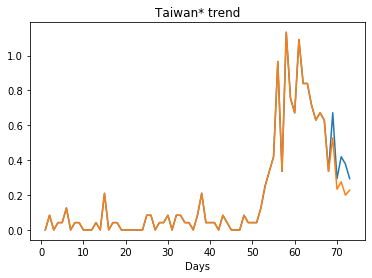

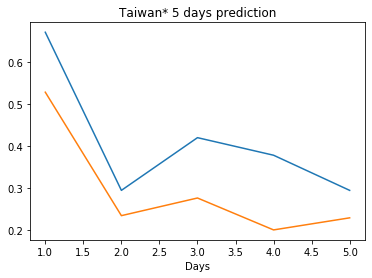

Creating directory ./offline5/Korea, South/training/
Korea, South
Saving the best model weights at Epoch [1], Best Valid Loss: 1.9599


/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Saving the best model weights at Epoch [13], Best Valid Loss: 1.1261
Saving the best model weights at Epoch [14], Best Valid Loss: 0.8034
Saving the best model weights at Epoch [45], Best Valid Loss: 0.2906
train error: 34.09453573352412
0.290648877620697
Saving the best model weights at Epoch [1], Best Valid Loss: 1.4347
Saving the best model weights at Epoch [11], Best Valid Loss: 1.1085
Saving the best model weights at Epoch [22], Best Valid Loss: 1.0696
Saving the best model weights at Epoch [25], Best Valid Loss: 0.8381
Saving the best model weights at Epoch [34], Best Valid Loss: 0.7254
train error: 59.46120790901937
0.72541743516922
Saving the best model weights at Epoch [1], Best Valid Loss: 44.9509
Saving the best model weights at Epoch [2], Best Valid Loss: 3.5904
Saving the best model weights at Epoch [3], Best Valid Loss: 1.2585
Saving the best model weights at Epoch [9], Best Valid Loss: 1.2020
train error: 71.62082335196044
1.2020061016082764
Saving the best model weights

Saving the best model weights at Epoch [9], Best Valid Loss: 2.8437
train error: 76.68223286302467
2.843677520751953
Saving the best model weights at Epoch [1], Best Valid Loss: 3.9392
train error: 74.15043253647654
3.9391751289367676
Saving the best model weights at Epoch [1], Best Valid Loss: 123.6094
Saving the best model weights at Epoch [2], Best Valid Loss: 25.7393
Saving the best model weights at Epoch [4], Best Valid Loss: 22.8246
Saving the best model weights at Epoch [6], Best Valid Loss: 4.7819
Saving the best model weights at Epoch [8], Best Valid Loss: 1.4466
train error: 93.5311057191146
1.4466460943222046
Saving the best model weights at Epoch [1], Best Valid Loss: 0.5262
train error: 32.69529472056188
0.5261766314506531
Saving the best model weights at Epoch [1], Best Valid Loss: 0.8220
Saving the best model weights at Epoch [3], Best Valid Loss: 0.7280
Saving the best model weights at Epoch [15], Best Valid Loss: 0.4096
train error: 26.45018269670637
0.4095786213874817

Saving the best model weights at Epoch [3], Best Valid Loss: 24.4747
Saving the best model weights at Epoch [5], Best Valid Loss: 23.2663
Saving the best model weights at Epoch [6], Best Valid Loss: 18.5434
Saving the best model weights at Epoch [7], Best Valid Loss: 18.0725
Saving the best model weights at Epoch [8], Best Valid Loss: 8.1387
Saving the best model weights at Epoch [23], Best Valid Loss: 5.3183
Saving the best model weights at Epoch [28], Best Valid Loss: 2.9083
train error: 80.09326022549679
2.9082629680633545
Saving the best model weights at Epoch [1], Best Valid Loss: 32.9955
Saving the best model weights at Epoch [5], Best Valid Loss: 27.3974
Saving the best model weights at Epoch [6], Best Valid Loss: 20.6586
Saving the best model weights at Epoch [7], Best Valid Loss: 19.0337
Saving the best model weights at Epoch [12], Best Valid Loss: 4.4499
Saving the best model weights at Epoch [18], Best Valid Loss: 1.9889
train error: 139.3021766888468
1.9889122247695923
Savi

Saving the best model weights at Epoch [6], Best Valid Loss: 0.9927
Saving the best model weights at Epoch [39], Best Valid Loss: 0.7280
train error: 94.01813111807171
0.7279956340789795
Saving the best model weights at Epoch [1], Best Valid Loss: 55.2250
Saving the best model weights at Epoch [2], Best Valid Loss: 2.7848
train error: 91.07179817400481
2.7847657203674316
Saving the best model weights at Epoch [1], Best Valid Loss: 84.1745
Saving the best model weights at Epoch [2], Best Valid Loss: 0.8628
Saving the best model weights at Epoch [12], Best Valid Loss: 0.8247
Saving the best model weights at Epoch [22], Best Valid Loss: 0.5106
Saving the best model weights at Epoch [44], Best Valid Loss: 0.4256
train error: 32.93103919903699
0.42558667063713074
Saving the best model weights at Epoch [1], Best Valid Loss: 21.3709
Saving the best model weights at Epoch [2], Best Valid Loss: 19.5513
Saving the best model weights at Epoch [11], Best Valid Loss: 19.1605
Saving the best model w

Saving the best model weights at Epoch [2], Best Valid Loss: 10.6556
Saving the best model weights at Epoch [7], Best Valid Loss: 2.3129
train error: 76.3457064879568
2.3129260540008545
Saving the best model weights at Epoch [1], Best Valid Loss: 17.3178
Saving the best model weights at Epoch [11], Best Valid Loss: 15.3255
Saving the best model weights at Epoch [12], Best Valid Loss: 13.5103
train error: 76.8023948794917
13.510268211364746
Saving the best model weights at Epoch [1], Best Valid Loss: 14.0816
Saving the best model weights at Epoch [6], Best Valid Loss: 8.6709
Saving the best model weights at Epoch [12], Best Valid Loss: 3.8973
train error: 79.08928714300457
3.897341251373291
Saving the best model weights at Epoch [1], Best Valid Loss: 48.2966
Saving the best model weights at Epoch [2], Best Valid Loss: 19.3462
Saving the best model weights at Epoch [9], Best Valid Loss: 0.8720
train error: 96.99895979228772
0.8720362782478333
Saving the best model weights at Epoch [1], B

Saving the best model weights at Epoch [29], Best Valid Loss: 1.1779
Saving the best model weights at Epoch [50], Best Valid Loss: 0.5885
train error: 19.431003620750026
0.5885370373725891
Saving the best model weights at Epoch [1], Best Valid Loss: 6.5297
Saving the best model weights at Epoch [2], Best Valid Loss: 0.8783
Saving the best model weights at Epoch [5], Best Valid Loss: 0.8541
train error: 31.480754839746577
0.8541194796562195
Saving the best model weights at Epoch [1], Best Valid Loss: 4.7671
Saving the best model weights at Epoch [2], Best Valid Loss: 0.9083
Saving the best model weights at Epoch [6], Best Valid Loss: 0.7755
train error: 23.63732516138177
0.7755085825920105
Saving the best model weights at Epoch [1], Best Valid Loss: 3.0832
Saving the best model weights at Epoch [2], Best Valid Loss: 2.1703
Saving the best model weights at Epoch [3], Best Valid Loss: 1.8116
Saving the best model weights at Epoch [4], Best Valid Loss: 0.7683
train error: 42.59828906310232

Saving the best model weights at Epoch [2], Best Valid Loss: 2.2215
Saving the best model weights at Epoch [4], Best Valid Loss: 1.6551
Saving the best model weights at Epoch [6], Best Valid Loss: 1.0114
train error: 38.46118831869803
1.0113587379455566
Saving the best model weights at Epoch [1], Best Valid Loss: 1.7249
Saving the best model weights at Epoch [4], Best Valid Loss: 1.1224
Saving the best model weights at Epoch [6], Best Valid Loss: 0.9058
train error: 42.17456381336639
0.9058093428611755
Saving the best model weights at Epoch [1], Best Valid Loss: 2.6910
Saving the best model weights at Epoch [3], Best Valid Loss: 0.7921
train error: 57.8475707518427
0.7921435832977295
Saving the best model weights at Epoch [1], Best Valid Loss: 34.6266
Saving the best model weights at Epoch [2], Best Valid Loss: 5.3077
Saving the best model weights at Epoch [5], Best Valid Loss: 0.9681
Saving the best model weights at Epoch [32], Best Valid Loss: 0.6272
Saving the best model weights at 

train error: 30.71029354239765
0.9894302487373352
Saving the best model weights at Epoch [1], Best Valid Loss: 1.4151
Saving the best model weights at Epoch [7], Best Valid Loss: 1.1186
Saving the best model weights at Epoch [8], Best Valid Loss: 0.8753
train error: 41.20347688307888
0.8752704858779907
Saving the best model weights at Epoch [1], Best Valid Loss: 1.7417
Saving the best model weights at Epoch [5], Best Valid Loss: 0.8195
train error: 76.72732419089267
0.8195236325263977
Saving the best model weights at Epoch [1], Best Valid Loss: 92.7062
Saving the best model weights at Epoch [2], Best Valid Loss: 17.7924
Saving the best model weights at Epoch [3], Best Valid Loss: 16.4390
Saving the best model weights at Epoch [16], Best Valid Loss: 8.1305
train error: 74.1623217306639
8.13052749633789
Saving the best model weights at Epoch [1], Best Valid Loss: 6.5915
Saving the best model weights at Epoch [2], Best Valid Loss: 0.9553
Saving the best model weights at Epoch [7], Best Va

Saving the best model weights at Epoch [6], Best Valid Loss: 5.6342
Saving the best model weights at Epoch [7], Best Valid Loss: 4.0713
Saving the best model weights at Epoch [8], Best Valid Loss: 2.9361
Saving the best model weights at Epoch [9], Best Valid Loss: 1.8453
Saving the best model weights at Epoch [10], Best Valid Loss: 1.0693
Saving the best model weights at Epoch [11], Best Valid Loss: 0.7901
Saving the best model weights at Epoch [12], Best Valid Loss: 0.6793
Saving the best model weights at Epoch [34], Best Valid Loss: 0.6641
Saving the best model weights at Epoch [35], Best Valid Loss: 0.6462
Saving the best model weights at Epoch [36], Best Valid Loss: 0.4947
Saving the best model weights at Epoch [49], Best Valid Loss: 0.4812
train error: 30.305177065886948
0.48118385672569275
Saving the best model weights at Epoch [1], Best Valid Loss: 14.4547
Saving the best model weights at Epoch [2], Best Valid Loss: 12.4590
Saving the best model weights at Epoch [3], Best Valid 

train error: 6.9920546480111385
0.804664134979248
Saving the best model weights at Epoch [1], Best Valid Loss: 11.3940
Saving the best model weights at Epoch [2], Best Valid Loss: 0.7563
Saving the best model weights at Epoch [12], Best Valid Loss: 0.7066
train error: 6.189539140580516
0.7065660357475281
Saving the best model weights at Epoch [1], Best Valid Loss: 15.5566
Saving the best model weights at Epoch [2], Best Valid Loss: 14.3353
Saving the best model weights at Epoch [3], Best Valid Loss: 13.1810
Saving the best model weights at Epoch [4], Best Valid Loss: 12.0881
Saving the best model weights at Epoch [5], Best Valid Loss: 11.0468
Saving the best model weights at Epoch [6], Best Valid Loss: 10.0575
Saving the best model weights at Epoch [7], Best Valid Loss: 9.1188
Saving the best model weights at Epoch [8], Best Valid Loss: 8.2124
Saving the best model weights at Epoch [9], Best Valid Loss: 7.3501
Saving the best model weights at Epoch [10], Best Valid Loss: 6.5229
Saving 

Saving the best model weights at Epoch [7], Best Valid Loss: 0.7466
Saving the best model weights at Epoch [8], Best Valid Loss: 0.7321
train error: 13.381032806478048
0.7321085333824158
Saving the best model weights at Epoch [1], Best Valid Loss: 8.3350
Saving the best model weights at Epoch [2], Best Valid Loss: 0.9505
Saving the best model weights at Epoch [5], Best Valid Loss: 0.9190
train error: 25.597849199646397
0.9189529418945312
Saving the best model weights at Epoch [1], Best Valid Loss: 15.9732
Saving the best model weights at Epoch [2], Best Valid Loss: 14.6312
Saving the best model weights at Epoch [3], Best Valid Loss: 13.3266
Saving the best model weights at Epoch [4], Best Valid Loss: 12.0269
Saving the best model weights at Epoch [5], Best Valid Loss: 10.6947
Saving the best model weights at Epoch [6], Best Valid Loss: 9.3188
Saving the best model weights at Epoch [7], Best Valid Loss: 7.8630
Saving the best model weights at Epoch [8], Best Valid Loss: 6.3481
Saving th

Saving the best model weights at Epoch [10], Best Valid Loss: 4.4453
Saving the best model weights at Epoch [11], Best Valid Loss: 3.6876
Saving the best model weights at Epoch [12], Best Valid Loss: 3.0082
Saving the best model weights at Epoch [13], Best Valid Loss: 2.4089
Saving the best model weights at Epoch [14], Best Valid Loss: 1.9078
Saving the best model weights at Epoch [15], Best Valid Loss: 1.4969
Saving the best model weights at Epoch [16], Best Valid Loss: 1.1922
Saving the best model weights at Epoch [17], Best Valid Loss: 0.9994
Saving the best model weights at Epoch [18], Best Valid Loss: 0.9219
train error: 66.13182778107493
0.9218597412109375
Saving the best model weights at Epoch [1], Best Valid Loss: 15.5509
Saving the best model weights at Epoch [2], Best Valid Loss: 13.3655
Saving the best model weights at Epoch [3], Best Valid Loss: 11.3526
Saving the best model weights at Epoch [4], Best Valid Loss: 9.5666
Saving the best model weights at Epoch [5], Best Valid

Saving the best model weights at Epoch [16], Best Valid Loss: 2.1121
Saving the best model weights at Epoch [17], Best Valid Loss: 1.6171
Saving the best model weights at Epoch [18], Best Valid Loss: 1.2205
Saving the best model weights at Epoch [19], Best Valid Loss: 0.9375
Saving the best model weights at Epoch [20], Best Valid Loss: 0.7873
Saving the best model weights at Epoch [21], Best Valid Loss: 0.7812
train error: 22.161913393359434
0.7811691164970398
Saving the best model weights at Epoch [1], Best Valid Loss: 15.5437
Saving the best model weights at Epoch [2], Best Valid Loss: 13.9386
Saving the best model weights at Epoch [3], Best Valid Loss: 12.3925
Saving the best model weights at Epoch [4], Best Valid Loss: 10.9694
Saving the best model weights at Epoch [5], Best Valid Loss: 9.6365
Saving the best model weights at Epoch [6], Best Valid Loss: 8.3844
Saving the best model weights at Epoch [7], Best Valid Loss: 7.1919
Saving the best model weights at Epoch [8], Best Valid 

Saving the best model weights at Epoch [8], Best Valid Loss: 8.5074
Saving the best model weights at Epoch [9], Best Valid Loss: 7.6094
Saving the best model weights at Epoch [10], Best Valid Loss: 6.7626
Saving the best model weights at Epoch [11], Best Valid Loss: 5.9653
Saving the best model weights at Epoch [12], Best Valid Loss: 5.2206
Saving the best model weights at Epoch [13], Best Valid Loss: 4.5282
Saving the best model weights at Epoch [14], Best Valid Loss: 3.8887
Saving the best model weights at Epoch [15], Best Valid Loss: 3.3058
Saving the best model weights at Epoch [16], Best Valid Loss: 2.7838
Saving the best model weights at Epoch [17], Best Valid Loss: 2.3280
Saving the best model weights at Epoch [18], Best Valid Loss: 1.9347
Saving the best model weights at Epoch [19], Best Valid Loss: 1.6203
Saving the best model weights at Epoch [20], Best Valid Loss: 1.3822
Saving the best model weights at Epoch [21], Best Valid Loss: 1.2312
Saving the best model weights at Epo

Saving the best model weights at Epoch [6], Best Valid Loss: 1.1442
Saving the best model weights at Epoch [7], Best Valid Loss: 0.7807
train error: 20.96921073135577
0.78069669008255
Saving the best model weights at Epoch [1], Best Valid Loss: 9.2836
Saving the best model weights at Epoch [2], Best Valid Loss: 2.9719
Saving the best model weights at Epoch [3], Best Valid Loss: 0.8709
train error: 21.560810197340814
0.8709484934806824
Saving the best model weights at Epoch [1], Best Valid Loss: 16.4595
Saving the best model weights at Epoch [2], Best Valid Loss: 15.1325
Saving the best model weights at Epoch [3], Best Valid Loss: 13.8884
Saving the best model weights at Epoch [4], Best Valid Loss: 12.7100
Saving the best model weights at Epoch [5], Best Valid Loss: 11.6003
Saving the best model weights at Epoch [6], Best Valid Loss: 10.5310
Saving the best model weights at Epoch [7], Best Valid Loss: 9.5199
Saving the best model weights at Epoch [8], Best Valid Loss: 8.5607
Saving the 

Saving the best model weights at Epoch [12], Best Valid Loss: 0.8781
Saving the best model weights at Epoch [36], Best Valid Loss: 0.8251
Saving the best model weights at Epoch [37], Best Valid Loss: 0.7813
train error: 18.97528394429307
0.781254768371582
Saving the best model weights at Epoch [1], Best Valid Loss: 13.9440
Saving the best model weights at Epoch [2], Best Valid Loss: 10.5843
Saving the best model weights at Epoch [3], Best Valid Loss: 7.7873
Saving the best model weights at Epoch [4], Best Valid Loss: 5.2108
Saving the best model weights at Epoch [5], Best Valid Loss: 3.2309
Saving the best model weights at Epoch [6], Best Valid Loss: 1.6014
Saving the best model weights at Epoch [7], Best Valid Loss: 0.8938
Saving the best model weights at Epoch [23], Best Valid Loss: 0.8689
train error: 19.797457117783395
0.8689185976982117
Saving the best model weights at Epoch [1], Best Valid Loss: 8.9076
Saving the best model weights at Epoch [2], Best Valid Loss: 2.1726
Saving the

Saving the best model weights at Epoch [16], Best Valid Loss: 1.0265
Saving the best model weights at Epoch [17], Best Valid Loss: 0.8205
Saving the best model weights at Epoch [18], Best Valid Loss: 0.7581
train error: 73.23764678051597
0.7581095099449158
Saving the best model weights at Epoch [1], Best Valid Loss: 13.9916
Saving the best model weights at Epoch [2], Best Valid Loss: 11.8872
Saving the best model weights at Epoch [3], Best Valid Loss: 9.9604
Saving the best model weights at Epoch [4], Best Valid Loss: 8.2461
Saving the best model weights at Epoch [5], Best Valid Loss: 6.6730
Saving the best model weights at Epoch [6], Best Valid Loss: 5.2534
Saving the best model weights at Epoch [7], Best Valid Loss: 4.0032
Saving the best model weights at Epoch [8], Best Valid Loss: 2.8864
Saving the best model weights at Epoch [9], Best Valid Loss: 1.9629
Saving the best model weights at Epoch [10], Best Valid Loss: 1.2958
Saving the best model weights at Epoch [11], Best Valid Loss

Saving the best model weights at Epoch [10], Best Valid Loss: 4.2485
Saving the best model weights at Epoch [11], Best Valid Loss: 3.3488
Saving the best model weights at Epoch [12], Best Valid Loss: 2.5505
Saving the best model weights at Epoch [13], Best Valid Loss: 1.8738
Saving the best model weights at Epoch [14], Best Valid Loss: 1.3480
Saving the best model weights at Epoch [15], Best Valid Loss: 0.9931
Saving the best model weights at Epoch [16], Best Valid Loss: 0.8557
train error: 73.25611588829442
0.8557425737380981
Saving the best model weights at Epoch [1], Best Valid Loss: 15.2154
Saving the best model weights at Epoch [2], Best Valid Loss: 13.0000
Saving the best model weights at Epoch [3], Best Valid Loss: 11.0061
Saving the best model weights at Epoch [4], Best Valid Loss: 9.0794
Saving the best model weights at Epoch [5], Best Valid Loss: 7.3610
Saving the best model weights at Epoch [6], Best Valid Loss: 5.7594
Saving the best model weights at Epoch [7], Best Valid L

Saving the best model weights at Epoch [16], Best Valid Loss: 0.6837
train error: 8.161371924375233
0.683678388595581
Saving the best model weights at Epoch [1], Best Valid Loss: 6.0992
Saving the best model weights at Epoch [3], Best Valid Loss: 2.6708
Saving the best model weights at Epoch [5], Best Valid Loss: 0.9082
Saving the best model weights at Epoch [26], Best Valid Loss: 0.8455
Saving the best model weights at Epoch [31], Best Valid Loss: 0.5118
Saving the best model weights at Epoch [35], Best Valid Loss: 0.3104
train error: 12.137428894246879
0.310433030128479
Saving the best model weights at Epoch [1], Best Valid Loss: 10.5997
Saving the best model weights at Epoch [2], Best Valid Loss: 6.1049
Saving the best model weights at Epoch [3], Best Valid Loss: 2.7276
Saving the best model weights at Epoch [4], Best Valid Loss: 0.9769
Saving the best model weights at Epoch [6], Best Valid Loss: 0.9746
Saving the best model weights at Epoch [7], Best Valid Loss: 0.8163
train error:

Saving the best model weights at Epoch [2], Best Valid Loss: 4.4234
Saving the best model weights at Epoch [3], Best Valid Loss: 1.3284
Saving the best model weights at Epoch [4], Best Valid Loss: 0.8615
train error: 28.578767358472472
0.861480712890625
Saving the best model weights at Epoch [1], Best Valid Loss: 7.5875
Saving the best model weights at Epoch [2], Best Valid Loss: 2.1407
Saving the best model weights at Epoch [3], Best Valid Loss: 1.3123
Saving the best model weights at Epoch [10], Best Valid Loss: 1.1771
Saving the best model weights at Epoch [17], Best Valid Loss: 1.1507
train error: 19.056890915098943
1.1507362127304077
Saving the best model weights at Epoch [1], Best Valid Loss: 4.0970
Saving the best model weights at Epoch [2], Best Valid Loss: 2.1187
Saving the best model weights at Epoch [6], Best Valid Loss: 1.1624
Saving the best model weights at Epoch [9], Best Valid Loss: 0.9183
train error: 21.907256359332486
0.9182555079460144
Saving the best model weights 

Saving the best model weights at Epoch [15], Best Valid Loss: 0.8018
train error: 46.10785013515698
0.8017964363098145
Saving the best model weights at Epoch [1], Best Valid Loss: 7.2500
Saving the best model weights at Epoch [10], Best Valid Loss: 4.1953
Saving the best model weights at Epoch [11], Best Valid Loss: 2.6464
Saving the best model weights at Epoch [12], Best Valid Loss: 1.7400
Saving the best model weights at Epoch [13], Best Valid Loss: 1.0035
train error: 65.41295015184502
1.0034751892089844
Saving the best model weights at Epoch [1], Best Valid Loss: 11.0995
Saving the best model weights at Epoch [2], Best Valid Loss: 6.4979
Saving the best model weights at Epoch [3], Best Valid Loss: 3.1213
Saving the best model weights at Epoch [4], Best Valid Loss: 1.1021
Saving the best model weights at Epoch [5], Best Valid Loss: 1.0757
Saving the best model weights at Epoch [19], Best Valid Loss: 0.8128
Saving the best model weights at Epoch [20], Best Valid Loss: 0.8004
train er

Saving the best model weights at Epoch [26], Best Valid Loss: 2.1233
Saving the best model weights at Epoch [30], Best Valid Loss: 1.7015
Saving the best model weights at Epoch [32], Best Valid Loss: 1.4440
Saving the best model weights at Epoch [33], Best Valid Loss: 1.2767
Saving the best model weights at Epoch [34], Best Valid Loss: 1.1485
train error: 32.82753531556381
1.148512840270996
Saving the best model weights at Epoch [1], Best Valid Loss: 4.5420
train error: 73.80330990490161
4.5420355796813965
Saving the best model weights at Epoch [1], Best Valid Loss: 11.0568
Saving the best model weights at Epoch [2], Best Valid Loss: 6.3840
Saving the best model weights at Epoch [3], Best Valid Loss: 2.7848
Saving the best model weights at Epoch [4], Best Valid Loss: 0.8650
train error: 24.030332097097446
0.8649523854255676
Saving the best model weights at Epoch [1], Best Valid Loss: 9.7307
Saving the best model weights at Epoch [2], Best Valid Loss: 4.1067
Saving the best model weight

Saving the best model weights at Epoch [10], Best Valid Loss: 17.4433
Saving the best model weights at Epoch [11], Best Valid Loss: 17.2621
Saving the best model weights at Epoch [12], Best Valid Loss: 17.0785
Saving the best model weights at Epoch [13], Best Valid Loss: 16.9023
Saving the best model weights at Epoch [14], Best Valid Loss: 16.7244
Saving the best model weights at Epoch [15], Best Valid Loss: 16.5531
Saving the best model weights at Epoch [16], Best Valid Loss: 16.3811
Saving the best model weights at Epoch [17], Best Valid Loss: 16.2128
Saving the best model weights at Epoch [18], Best Valid Loss: 16.0446
Saving the best model weights at Epoch [19], Best Valid Loss: 15.8800
Saving the best model weights at Epoch [20], Best Valid Loss: 15.7175
Saving the best model weights at Epoch [21], Best Valid Loss: 15.5561
Saving the best model weights at Epoch [22], Best Valid Loss: 15.4007
Saving the best model weights at Epoch [23], Best Valid Loss: 15.2447
Saving the best mode

Saving the best model weights at Epoch [27], Best Valid Loss: 7.8667
Saving the best model weights at Epoch [28], Best Valid Loss: 7.5297
Saving the best model weights at Epoch [29], Best Valid Loss: 7.2030
Saving the best model weights at Epoch [30], Best Valid Loss: 6.8738
Saving the best model weights at Epoch [31], Best Valid Loss: 6.5439
Saving the best model weights at Epoch [32], Best Valid Loss: 6.2232
Saving the best model weights at Epoch [33], Best Valid Loss: 5.9083
Saving the best model weights at Epoch [34], Best Valid Loss: 5.6041
Saving the best model weights at Epoch [35], Best Valid Loss: 5.3112
Saving the best model weights at Epoch [36], Best Valid Loss: 5.0185
Saving the best model weights at Epoch [37], Best Valid Loss: 4.7644
Saving the best model weights at Epoch [38], Best Valid Loss: 4.5024
Saving the best model weights at Epoch [39], Best Valid Loss: 4.2565
Saving the best model weights at Epoch [40], Best Valid Loss: 3.9877
Saving the best model weights at E

Saving the best model weights at Epoch [20], Best Valid Loss: 11.0285
Saving the best model weights at Epoch [21], Best Valid Loss: 10.6607
Saving the best model weights at Epoch [22], Best Valid Loss: 10.2782
Saving the best model weights at Epoch [23], Best Valid Loss: 9.8911
Saving the best model weights at Epoch [24], Best Valid Loss: 9.4972
Saving the best model weights at Epoch [25], Best Valid Loss: 9.1017
Saving the best model weights at Epoch [26], Best Valid Loss: 8.6941
Saving the best model weights at Epoch [27], Best Valid Loss: 8.2143
Saving the best model weights at Epoch [28], Best Valid Loss: 7.7835
Saving the best model weights at Epoch [29], Best Valid Loss: 7.3226
Saving the best model weights at Epoch [30], Best Valid Loss: 6.8736
Saving the best model weights at Epoch [31], Best Valid Loss: 6.4066
Saving the best model weights at Epoch [32], Best Valid Loss: 5.9644
Saving the best model weights at Epoch [33], Best Valid Loss: 5.5647
Saving the best model weights a

train error: 18.022322823342524
0.6230589151382446
Saving the best model weights at Epoch [1], Best Valid Loss: 17.4318
Saving the best model weights at Epoch [2], Best Valid Loss: 17.2525
Saving the best model weights at Epoch [3], Best Valid Loss: 17.0585
Saving the best model weights at Epoch [4], Best Valid Loss: 16.8473
Saving the best model weights at Epoch [5], Best Valid Loss: 16.6101
Saving the best model weights at Epoch [6], Best Valid Loss: 16.3420
Saving the best model weights at Epoch [7], Best Valid Loss: 16.0310
Saving the best model weights at Epoch [8], Best Valid Loss: 15.6805
Saving the best model weights at Epoch [9], Best Valid Loss: 15.2888
Saving the best model weights at Epoch [10], Best Valid Loss: 14.8220
Saving the best model weights at Epoch [11], Best Valid Loss: 14.3058
Saving the best model weights at Epoch [12], Best Valid Loss: 13.7285
Saving the best model weights at Epoch [13], Best Valid Loss: 13.1460
Saving the best model weights at Epoch [14], Bes

Saving the best model weights at Epoch [24], Best Valid Loss: 0.6008
Saving the best model weights at Epoch [25], Best Valid Loss: 0.5832
Saving the best model weights at Epoch [26], Best Valid Loss: 0.5738
Saving the best model weights at Epoch [28], Best Valid Loss: 0.5738
Saving the best model weights at Epoch [29], Best Valid Loss: 0.5726
Saving the best model weights at Epoch [30], Best Valid Loss: 0.5674
Saving the best model weights at Epoch [31], Best Valid Loss: 0.5671
Saving the best model weights at Epoch [32], Best Valid Loss: 0.5636
train error: 42.659012792926085
0.5635652542114258
Saving the best model weights at Epoch [1], Best Valid Loss: 15.5725
Saving the best model weights at Epoch [2], Best Valid Loss: 14.7451
Saving the best model weights at Epoch [3], Best Valid Loss: 13.8348
Saving the best model weights at Epoch [4], Best Valid Loss: 12.7492
Saving the best model weights at Epoch [5], Best Valid Loss: 11.4626
Saving the best model weights at Epoch [6], Best Val

Saving the best model weights at Epoch [6], Best Valid Loss: 12.5475
Saving the best model weights at Epoch [7], Best Valid Loss: 11.2847
Saving the best model weights at Epoch [8], Best Valid Loss: 9.8859
Saving the best model weights at Epoch [9], Best Valid Loss: 8.3303
Saving the best model weights at Epoch [10], Best Valid Loss: 6.7250
Saving the best model weights at Epoch [11], Best Valid Loss: 5.2273
Saving the best model weights at Epoch [12], Best Valid Loss: 3.8727
Saving the best model weights at Epoch [13], Best Valid Loss: 2.8521
Saving the best model weights at Epoch [14], Best Valid Loss: 2.0813
Saving the best model weights at Epoch [15], Best Valid Loss: 1.5558
Saving the best model weights at Epoch [16], Best Valid Loss: 1.1897
Saving the best model weights at Epoch [17], Best Valid Loss: 0.9466
Saving the best model weights at Epoch [18], Best Valid Loss: 0.7972
Saving the best model weights at Epoch [19], Best Valid Loss: 0.7202
Saving the best model weights at Epo

Saving the best model weights at Epoch [30], Best Valid Loss: 12.4228
Saving the best model weights at Epoch [31], Best Valid Loss: 12.2766
Saving the best model weights at Epoch [32], Best Valid Loss: 12.1350
Saving the best model weights at Epoch [33], Best Valid Loss: 11.9916
Saving the best model weights at Epoch [34], Best Valid Loss: 11.8493
Saving the best model weights at Epoch [35], Best Valid Loss: 11.7073
Saving the best model weights at Epoch [36], Best Valid Loss: 11.5702
Saving the best model weights at Epoch [37], Best Valid Loss: 11.4288
Saving the best model weights at Epoch [38], Best Valid Loss: 11.2912
Saving the best model weights at Epoch [39], Best Valid Loss: 11.1540
Saving the best model weights at Epoch [40], Best Valid Loss: 11.0177
Saving the best model weights at Epoch [41], Best Valid Loss: 10.8832
Saving the best model weights at Epoch [42], Best Valid Loss: 10.7486
Saving the best model weights at Epoch [43], Best Valid Loss: 10.6160
Saving the best mode

Saving the best model weights at Epoch [47], Best Valid Loss: 1.9066
Saving the best model weights at Epoch [48], Best Valid Loss: 1.7307
Saving the best model weights at Epoch [49], Best Valid Loss: 1.5901
Saving the best model weights at Epoch [50], Best Valid Loss: 1.4371
train error: 108.23368221521378
1.4370626211166382
Saving the best model weights at Epoch [1], Best Valid Loss: 16.5974
Saving the best model weights at Epoch [2], Best Valid Loss: 15.3592
Saving the best model weights at Epoch [3], Best Valid Loss: 14.2768
Saving the best model weights at Epoch [4], Best Valid Loss: 13.2105
Saving the best model weights at Epoch [5], Best Valid Loss: 12.1495
Saving the best model weights at Epoch [6], Best Valid Loss: 11.2312
Saving the best model weights at Epoch [7], Best Valid Loss: 10.3190
Saving the best model weights at Epoch [8], Best Valid Loss: 9.4066
Saving the best model weights at Epoch [9], Best Valid Loss: 8.5782
Saving the best model weights at Epoch [10], Best Vali

Saving the best model weights at Epoch [40], Best Valid Loss: 10.7358
Saving the best model weights at Epoch [41], Best Valid Loss: 10.6011
Saving the best model weights at Epoch [42], Best Valid Loss: 10.4615
Saving the best model weights at Epoch [43], Best Valid Loss: 10.3266
Saving the best model weights at Epoch [44], Best Valid Loss: 10.1888
Saving the best model weights at Epoch [45], Best Valid Loss: 10.0521
Saving the best model weights at Epoch [46], Best Valid Loss: 9.9167
Saving the best model weights at Epoch [47], Best Valid Loss: 9.7849
Saving the best model weights at Epoch [48], Best Valid Loss: 9.6469
Saving the best model weights at Epoch [49], Best Valid Loss: 9.5126
Saving the best model weights at Epoch [50], Best Valid Loss: 9.3801
train error: 141.54832561392533
9.380050659179688
Saving the best model weights at Epoch [1], Best Valid Loss: 16.8730
Saving the best model weights at Epoch [2], Best Valid Loss: 16.6191
Saving the best model weights at Epoch [3], Bes

Saving the best model weights at Epoch [7], Best Valid Loss: 9.1473
Saving the best model weights at Epoch [8], Best Valid Loss: 8.0582
Saving the best model weights at Epoch [9], Best Valid Loss: 7.1763
Saving the best model weights at Epoch [10], Best Valid Loss: 6.2178
Saving the best model weights at Epoch [11], Best Valid Loss: 5.1668
Saving the best model weights at Epoch [12], Best Valid Loss: 4.4685
Saving the best model weights at Epoch [13], Best Valid Loss: 3.4748
Saving the best model weights at Epoch [14], Best Valid Loss: 2.7280
Saving the best model weights at Epoch [15], Best Valid Loss: 1.9970
Saving the best model weights at Epoch [16], Best Valid Loss: 1.3868
Saving the best model weights at Epoch [17], Best Valid Loss: 0.9409
Saving the best model weights at Epoch [18], Best Valid Loss: 0.7237
train error: 25.189367265293473
0.7237169742584229
Saving the best model weights at Epoch [1], Best Valid Loss: 16.9032
Saving the best model weights at Epoch [2], Best Valid 

Saving the best model weights at Epoch [5], Best Valid Loss: 15.9391
Saving the best model weights at Epoch [6], Best Valid Loss: 15.6987
Saving the best model weights at Epoch [7], Best Valid Loss: 15.4535
Saving the best model weights at Epoch [8], Best Valid Loss: 15.2147
Saving the best model weights at Epoch [9], Best Valid Loss: 14.9748
Saving the best model weights at Epoch [10], Best Valid Loss: 14.7386
Saving the best model weights at Epoch [11], Best Valid Loss: 14.5023
Saving the best model weights at Epoch [12], Best Valid Loss: 14.2760
Saving the best model weights at Epoch [13], Best Valid Loss: 14.0441
Saving the best model weights at Epoch [14], Best Valid Loss: 13.8071
Saving the best model weights at Epoch [15], Best Valid Loss: 13.5765
Saving the best model weights at Epoch [16], Best Valid Loss: 13.3451
Saving the best model weights at Epoch [17], Best Valid Loss: 13.1212
Saving the best model weights at Epoch [18], Best Valid Loss: 12.8877
Saving the best model wei

Saving the best model weights at Epoch [18], Best Valid Loss: 14.9399
Saving the best model weights at Epoch [19], Best Valid Loss: 14.7915
Saving the best model weights at Epoch [20], Best Valid Loss: 14.6437
Saving the best model weights at Epoch [21], Best Valid Loss: 14.4948
Saving the best model weights at Epoch [22], Best Valid Loss: 14.3461
Saving the best model weights at Epoch [23], Best Valid Loss: 14.1967
Saving the best model weights at Epoch [24], Best Valid Loss: 14.0476
Saving the best model weights at Epoch [25], Best Valid Loss: 13.8975
Saving the best model weights at Epoch [26], Best Valid Loss: 13.7464
Saving the best model weights at Epoch [27], Best Valid Loss: 13.5952
Saving the best model weights at Epoch [28], Best Valid Loss: 13.4434
Saving the best model weights at Epoch [29], Best Valid Loss: 13.2897
Saving the best model weights at Epoch [30], Best Valid Loss: 13.1350
Saving the best model weights at Epoch [31], Best Valid Loss: 12.9791
Saving the best mode

Saving the best model weights at Epoch [36], Best Valid Loss: 6.8556
Saving the best model weights at Epoch [37], Best Valid Loss: 6.4432
Saving the best model weights at Epoch [38], Best Valid Loss: 6.0111
Saving the best model weights at Epoch [39], Best Valid Loss: 5.5848
Saving the best model weights at Epoch [40], Best Valid Loss: 5.1418
Saving the best model weights at Epoch [41], Best Valid Loss: 4.7035
Saving the best model weights at Epoch [42], Best Valid Loss: 4.2822
Saving the best model weights at Epoch [43], Best Valid Loss: 3.8557
Saving the best model weights at Epoch [44], Best Valid Loss: 3.4421
Saving the best model weights at Epoch [45], Best Valid Loss: 3.0537
Saving the best model weights at Epoch [46], Best Valid Loss: 2.6803
Saving the best model weights at Epoch [47], Best Valid Loss: 2.3374
Saving the best model weights at Epoch [48], Best Valid Loss: 2.0280
Saving the best model weights at Epoch [49], Best Valid Loss: 1.7439
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 11.8338
Saving the best model weights at Epoch [45], Best Valid Loss: 11.7254
Saving the best model weights at Epoch [46], Best Valid Loss: 11.6164
Saving the best model weights at Epoch [47], Best Valid Loss: 11.5086
Saving the best model weights at Epoch [48], Best Valid Loss: 11.4013
Saving the best model weights at Epoch [49], Best Valid Loss: 11.2949
Saving the best model weights at Epoch [50], Best Valid Loss: 11.1893
train error: 148.9108070009633
11.189254760742188
Saving the best model weights at Epoch [1], Best Valid Loss: 17.5504
Saving the best model weights at Epoch [2], Best Valid Loss: 17.3678
Saving the best model weights at Epoch [3], Best Valid Loss: 17.1894
Saving the best model weights at Epoch [4], Best Valid Loss: 17.0066
Saving the best model weights at Epoch [5], Best Valid Loss: 16.8283
Saving the best model weights at Epoch [6], Best Valid Loss: 16.6504
Saving the best model weights at Epoch [7], Be

Saving the best model weights at Epoch [11], Best Valid Loss: 13.3553
Saving the best model weights at Epoch [12], Best Valid Loss: 13.0123
Saving the best model weights at Epoch [13], Best Valid Loss: 12.6588
Saving the best model weights at Epoch [14], Best Valid Loss: 12.3086
Saving the best model weights at Epoch [15], Best Valid Loss: 11.9655
Saving the best model weights at Epoch [16], Best Valid Loss: 11.6346
Saving the best model weights at Epoch [17], Best Valid Loss: 11.2993
Saving the best model weights at Epoch [18], Best Valid Loss: 10.9731
Saving the best model weights at Epoch [19], Best Valid Loss: 10.6580
Saving the best model weights at Epoch [20], Best Valid Loss: 10.3321
Saving the best model weights at Epoch [21], Best Valid Loss: 10.0271
Saving the best model weights at Epoch [22], Best Valid Loss: 9.7174
Saving the best model weights at Epoch [23], Best Valid Loss: 9.4355
Saving the best model weights at Epoch [24], Best Valid Loss: 9.1170
Saving the best model w

Saving the best model weights at Epoch [2], Best Valid Loss: 16.6802
Saving the best model weights at Epoch [3], Best Valid Loss: 16.5067
Saving the best model weights at Epoch [4], Best Valid Loss: 16.3293
Saving the best model weights at Epoch [5], Best Valid Loss: 16.1562
Saving the best model weights at Epoch [6], Best Valid Loss: 15.9851
Saving the best model weights at Epoch [7], Best Valid Loss: 15.8141
Saving the best model weights at Epoch [8], Best Valid Loss: 15.6456
Saving the best model weights at Epoch [9], Best Valid Loss: 15.4776
Saving the best model weights at Epoch [10], Best Valid Loss: 15.3112
Saving the best model weights at Epoch [11], Best Valid Loss: 15.1448
Saving the best model weights at Epoch [12], Best Valid Loss: 14.9776
Saving the best model weights at Epoch [13], Best Valid Loss: 14.8148
Saving the best model weights at Epoch [14], Best Valid Loss: 14.6523
Saving the best model weights at Epoch [15], Best Valid Loss: 14.4899
Saving the best model weight

Saving the best model weights at Epoch [19], Best Valid Loss: 10.2605
Saving the best model weights at Epoch [20], Best Valid Loss: 9.9513
Saving the best model weights at Epoch [21], Best Valid Loss: 9.6578
Saving the best model weights at Epoch [22], Best Valid Loss: 9.3554
Saving the best model weights at Epoch [23], Best Valid Loss: 9.0717
Saving the best model weights at Epoch [24], Best Valid Loss: 8.7816
Saving the best model weights at Epoch [25], Best Valid Loss: 8.4997
Saving the best model weights at Epoch [26], Best Valid Loss: 8.2170
Saving the best model weights at Epoch [27], Best Valid Loss: 7.9612
Saving the best model weights at Epoch [28], Best Valid Loss: 7.6822
Saving the best model weights at Epoch [29], Best Valid Loss: 7.4049
Saving the best model weights at Epoch [30], Best Valid Loss: 7.1527
Saving the best model weights at Epoch [31], Best Valid Loss: 6.9028
Saving the best model weights at Epoch [32], Best Valid Loss: 6.6439
Saving the best model weights at 

Saving the best model weights at Epoch [10], Best Valid Loss: 15.4092
Saving the best model weights at Epoch [11], Best Valid Loss: 15.2423
Saving the best model weights at Epoch [12], Best Valid Loss: 15.0766
Saving the best model weights at Epoch [13], Best Valid Loss: 14.9120
Saving the best model weights at Epoch [14], Best Valid Loss: 14.7485
Saving the best model weights at Epoch [15], Best Valid Loss: 14.5885
Saving the best model weights at Epoch [16], Best Valid Loss: 14.4249
Saving the best model weights at Epoch [17], Best Valid Loss: 14.2658
Saving the best model weights at Epoch [18], Best Valid Loss: 14.1063
Saving the best model weights at Epoch [19], Best Valid Loss: 13.9484
Saving the best model weights at Epoch [20], Best Valid Loss: 13.7949
Saving the best model weights at Epoch [21], Best Valid Loss: 13.6367
Saving the best model weights at Epoch [22], Best Valid Loss: 13.4822
Saving the best model weights at Epoch [23], Best Valid Loss: 13.3294
Saving the best mode

Saving the best model weights at Epoch [28], Best Valid Loss: 7.6534
Saving the best model weights at Epoch [29], Best Valid Loss: 7.3627
Saving the best model weights at Epoch [30], Best Valid Loss: 7.0906
Saving the best model weights at Epoch [31], Best Valid Loss: 6.8144
Saving the best model weights at Epoch [32], Best Valid Loss: 6.5369
Saving the best model weights at Epoch [33], Best Valid Loss: 6.2679
Saving the best model weights at Epoch [34], Best Valid Loss: 6.0011
Saving the best model weights at Epoch [35], Best Valid Loss: 5.7464
Saving the best model weights at Epoch [36], Best Valid Loss: 5.4921
Saving the best model weights at Epoch [37], Best Valid Loss: 5.2350
Saving the best model weights at Epoch [38], Best Valid Loss: 4.9980
Saving the best model weights at Epoch [39], Best Valid Loss: 4.7433
Saving the best model weights at Epoch [40], Best Valid Loss: 4.5041
Saving the best model weights at Epoch [41], Best Valid Loss: 4.2750
Saving the best model weights at E

Saving the best model weights at Epoch [20], Best Valid Loss: 13.8431
Saving the best model weights at Epoch [21], Best Valid Loss: 13.6862
Saving the best model weights at Epoch [22], Best Valid Loss: 13.5256
Saving the best model weights at Epoch [23], Best Valid Loss: 13.3682
Saving the best model weights at Epoch [24], Best Valid Loss: 13.2130
Saving the best model weights at Epoch [25], Best Valid Loss: 13.0582
Saving the best model weights at Epoch [26], Best Valid Loss: 12.9033
Saving the best model weights at Epoch [27], Best Valid Loss: 12.7501
Saving the best model weights at Epoch [28], Best Valid Loss: 12.5977
Saving the best model weights at Epoch [29], Best Valid Loss: 12.4479
Saving the best model weights at Epoch [30], Best Valid Loss: 12.2971
Saving the best model weights at Epoch [31], Best Valid Loss: 12.1460
Saving the best model weights at Epoch [32], Best Valid Loss: 11.9967
Saving the best model weights at Epoch [33], Best Valid Loss: 11.8517
Saving the best mode

Saving the best model weights at Epoch [38], Best Valid Loss: 5.2000
Saving the best model weights at Epoch [39], Best Valid Loss: 4.9656
Saving the best model weights at Epoch [40], Best Valid Loss: 4.7053
Saving the best model weights at Epoch [41], Best Valid Loss: 4.4892
Saving the best model weights at Epoch [42], Best Valid Loss: 4.2365
Saving the best model weights at Epoch [43], Best Valid Loss: 4.0059
Saving the best model weights at Epoch [44], Best Valid Loss: 3.7801
Saving the best model weights at Epoch [45], Best Valid Loss: 3.5593
Saving the best model weights at Epoch [46], Best Valid Loss: 3.3341
Saving the best model weights at Epoch [47], Best Valid Loss: 3.1407
Saving the best model weights at Epoch [48], Best Valid Loss: 2.9317
Saving the best model weights at Epoch [49], Best Valid Loss: 2.7238
Saving the best model weights at Epoch [50], Best Valid Loss: 2.5280
train error: 118.17441337359578
2.527963876724243
Saving the best model weights at Epoch [1], Best Vali

Saving the best model weights at Epoch [30], Best Valid Loss: 11.9220
Saving the best model weights at Epoch [31], Best Valid Loss: 11.7753
Saving the best model weights at Epoch [32], Best Valid Loss: 11.6291
Saving the best model weights at Epoch [33], Best Valid Loss: 11.4855
Saving the best model weights at Epoch [34], Best Valid Loss: 11.3423
Saving the best model weights at Epoch [35], Best Valid Loss: 11.2018
Saving the best model weights at Epoch [36], Best Valid Loss: 11.0616
Saving the best model weights at Epoch [37], Best Valid Loss: 10.9190
Saving the best model weights at Epoch [38], Best Valid Loss: 10.7798
Saving the best model weights at Epoch [39], Best Valid Loss: 10.6416
Saving the best model weights at Epoch [40], Best Valid Loss: 10.5042
Saving the best model weights at Epoch [41], Best Valid Loss: 10.3703
Saving the best model weights at Epoch [42], Best Valid Loss: 10.2326
Saving the best model weights at Epoch [43], Best Valid Loss: 10.0968
Saving the best mode

Saving the best model weights at Epoch [48], Best Valid Loss: 3.6006
Saving the best model weights at Epoch [49], Best Valid Loss: 3.4310
Saving the best model weights at Epoch [50], Best Valid Loss: 3.2692
train error: 123.0307298867326
3.269181966781616
Saving the best model weights at Epoch [1], Best Valid Loss: 16.0990
Saving the best model weights at Epoch [2], Best Valid Loss: 14.9598
Saving the best model weights at Epoch [3], Best Valid Loss: 13.9605
Saving the best model weights at Epoch [4], Best Valid Loss: 12.8860
Saving the best model weights at Epoch [5], Best Valid Loss: 11.8847
Saving the best model weights at Epoch [6], Best Valid Loss: 10.9029
Saving the best model weights at Epoch [7], Best Valid Loss: 10.0505
Saving the best model weights at Epoch [8], Best Valid Loss: 9.1499
Saving the best model weights at Epoch [9], Best Valid Loss: 8.4825
Saving the best model weights at Epoch [10], Best Valid Loss: 7.6139
Saving the best model weights at Epoch [11], Best Valid 

Saving the best model weights at Epoch [38], Best Valid Loss: 10.4770
Saving the best model weights at Epoch [39], Best Valid Loss: 10.3441
Saving the best model weights at Epoch [40], Best Valid Loss: 10.2108
Saving the best model weights at Epoch [41], Best Valid Loss: 10.0800
Saving the best model weights at Epoch [42], Best Valid Loss: 9.9489
Saving the best model weights at Epoch [43], Best Valid Loss: 9.8198
Saving the best model weights at Epoch [44], Best Valid Loss: 9.6916
Saving the best model weights at Epoch [45], Best Valid Loss: 9.5628
Saving the best model weights at Epoch [46], Best Valid Loss: 9.4332
Saving the best model weights at Epoch [47], Best Valid Loss: 9.3070
Saving the best model weights at Epoch [48], Best Valid Loss: 9.1804
Saving the best model weights at Epoch [49], Best Valid Loss: 9.0556
Saving the best model weights at Epoch [50], Best Valid Loss: 8.9315
train error: 142.11770031954111
8.931462287902832
Saving the best model weights at Epoch [1], Best 

Saving the best model weights at Epoch [4], Best Valid Loss: 12.3739
Saving the best model weights at Epoch [5], Best Valid Loss: 11.3068
Saving the best model weights at Epoch [6], Best Valid Loss: 10.3883
Saving the best model weights at Epoch [7], Best Valid Loss: 9.4261
Saving the best model weights at Epoch [8], Best Valid Loss: 8.5231
Saving the best model weights at Epoch [9], Best Valid Loss: 7.6888
Saving the best model weights at Epoch [10], Best Valid Loss: 6.8931
Saving the best model weights at Epoch [11], Best Valid Loss: 6.1400
Saving the best model weights at Epoch [12], Best Valid Loss: 5.4283
Saving the best model weights at Epoch [13], Best Valid Loss: 4.6989
Saving the best model weights at Epoch [14], Best Valid Loss: 4.0514
Saving the best model weights at Epoch [15], Best Valid Loss: 3.4386
Saving the best model weights at Epoch [16], Best Valid Loss: 2.8849
Saving the best model weights at Epoch [17], Best Valid Loss: 2.3812
Saving the best model weights at Epoc

Saving the best model weights at Epoch [48], Best Valid Loss: 9.7560
Saving the best model weights at Epoch [49], Best Valid Loss: 9.6318
Saving the best model weights at Epoch [50], Best Valid Loss: 9.5092
train error: 143.60589250137932
9.509236335754395
Saving the best model weights at Epoch [1], Best Valid Loss: 16.9222
Saving the best model weights at Epoch [2], Best Valid Loss: 16.6721
Saving the best model weights at Epoch [3], Best Valid Loss: 16.4336
Saving the best model weights at Epoch [4], Best Valid Loss: 16.1801
Saving the best model weights at Epoch [5], Best Valid Loss: 15.9413
Saving the best model weights at Epoch [6], Best Valid Loss: 15.6997
Saving the best model weights at Epoch [7], Best Valid Loss: 15.4639
Saving the best model weights at Epoch [8], Best Valid Loss: 15.2307
Saving the best model weights at Epoch [9], Best Valid Loss: 14.9969
Saving the best model weights at Epoch [10], Best Valid Loss: 14.7726
Saving the best model weights at Epoch [11], Best Va

Saving the best model weights at Epoch [16], Best Valid Loss: 2.9246
Saving the best model weights at Epoch [17], Best Valid Loss: 2.4352
Saving the best model weights at Epoch [18], Best Valid Loss: 1.9045
Saving the best model weights at Epoch [19], Best Valid Loss: 1.5249
Saving the best model weights at Epoch [20], Best Valid Loss: 1.2344
Saving the best model weights at Epoch [21], Best Valid Loss: 1.0023
Saving the best model weights at Epoch [22], Best Valid Loss: 0.8846
Saving the best model weights at Epoch [23], Best Valid Loss: 0.8721
train error: 72.79397488895215
0.8720678687095642
Saving the best model weights at Epoch [1], Best Valid Loss: 17.4875
Saving the best model weights at Epoch [2], Best Valid Loss: 17.3453
Saving the best model weights at Epoch [3], Best Valid Loss: 17.2025
Saving the best model weights at Epoch [4], Best Valid Loss: 17.0614
Saving the best model weights at Epoch [5], Best Valid Loss: 16.9209
Saving the best model weights at Epoch [6], Best Vali

Saving the best model weights at Epoch [10], Best Valid Loss: 15.0031
Saving the best model weights at Epoch [11], Best Valid Loss: 14.7733
Saving the best model weights at Epoch [12], Best Valid Loss: 14.5507
Saving the best model weights at Epoch [13], Best Valid Loss: 14.3209
Saving the best model weights at Epoch [14], Best Valid Loss: 14.0997
Saving the best model weights at Epoch [15], Best Valid Loss: 13.8835
Saving the best model weights at Epoch [16], Best Valid Loss: 13.6589
Saving the best model weights at Epoch [17], Best Valid Loss: 13.4427
Saving the best model weights at Epoch [18], Best Valid Loss: 13.2254
Saving the best model weights at Epoch [19], Best Valid Loss: 13.0141
Saving the best model weights at Epoch [20], Best Valid Loss: 12.8040
Saving the best model weights at Epoch [21], Best Valid Loss: 12.5937
Saving the best model weights at Epoch [22], Best Valid Loss: 12.3868
Saving the best model weights at Epoch [23], Best Valid Loss: 12.1805
Saving the best mode

Saving the best model weights at Epoch [4], Best Valid Loss: 16.7643
Saving the best model weights at Epoch [5], Best Valid Loss: 16.6247
Saving the best model weights at Epoch [6], Best Valid Loss: 16.4858
Saving the best model weights at Epoch [7], Best Valid Loss: 16.3485
Saving the best model weights at Epoch [8], Best Valid Loss: 16.2112
Saving the best model weights at Epoch [9], Best Valid Loss: 16.0753
Saving the best model weights at Epoch [10], Best Valid Loss: 15.9402
Saving the best model weights at Epoch [11], Best Valid Loss: 15.8047
Saving the best model weights at Epoch [12], Best Valid Loss: 15.6711
Saving the best model weights at Epoch [13], Best Valid Loss: 15.5388
Saving the best model weights at Epoch [14], Best Valid Loss: 15.4058
Saving the best model weights at Epoch [15], Best Valid Loss: 15.2750
Saving the best model weights at Epoch [16], Best Valid Loss: 15.1438
Saving the best model weights at Epoch [17], Best Valid Loss: 15.0146
Saving the best model weig

Saving the best model weights at Epoch [20], Best Valid Loss: 12.9784
Saving the best model weights at Epoch [21], Best Valid Loss: 12.7634
Saving the best model weights at Epoch [22], Best Valid Loss: 12.5589
Saving the best model weights at Epoch [23], Best Valid Loss: 12.3531
Saving the best model weights at Epoch [24], Best Valid Loss: 12.1500
Saving the best model weights at Epoch [25], Best Valid Loss: 11.9485
Saving the best model weights at Epoch [26], Best Valid Loss: 11.7568
Saving the best model weights at Epoch [27], Best Valid Loss: 11.5554
Saving the best model weights at Epoch [28], Best Valid Loss: 11.3590
Saving the best model weights at Epoch [29], Best Valid Loss: 11.1638
Saving the best model weights at Epoch [30], Best Valid Loss: 10.9723
Saving the best model weights at Epoch [31], Best Valid Loss: 10.7811
Saving the best model weights at Epoch [32], Best Valid Loss: 10.5938
Saving the best model weights at Epoch [33], Best Valid Loss: 10.4062
Saving the best mode

Saving the best model weights at Epoch [14], Best Valid Loss: 15.3351
Saving the best model weights at Epoch [15], Best Valid Loss: 15.2041
Saving the best model weights at Epoch [16], Best Valid Loss: 15.0746
Saving the best model weights at Epoch [17], Best Valid Loss: 14.9442
Saving the best model weights at Epoch [18], Best Valid Loss: 14.8155
Saving the best model weights at Epoch [19], Best Valid Loss: 14.6876
Saving the best model weights at Epoch [20], Best Valid Loss: 14.5600
Saving the best model weights at Epoch [21], Best Valid Loss: 14.4333
Saving the best model weights at Epoch [22], Best Valid Loss: 14.3075
Saving the best model weights at Epoch [23], Best Valid Loss: 14.1821
Saving the best model weights at Epoch [24], Best Valid Loss: 14.0575
Saving the best model weights at Epoch [25], Best Valid Loss: 13.9344
Saving the best model weights at Epoch [26], Best Valid Loss: 13.8104
Saving the best model weights at Epoch [27], Best Valid Loss: 13.6882
Saving the best mode

Saving the best model weights at Epoch [30], Best Valid Loss: 11.3441
Saving the best model weights at Epoch [31], Best Valid Loss: 11.1445
Saving the best model weights at Epoch [32], Best Valid Loss: 10.9493
Saving the best model weights at Epoch [33], Best Valid Loss: 10.7528
Saving the best model weights at Epoch [34], Best Valid Loss: 10.5600
Saving the best model weights at Epoch [35], Best Valid Loss: 10.3696
Saving the best model weights at Epoch [36], Best Valid Loss: 10.1811
Saving the best model weights at Epoch [37], Best Valid Loss: 9.9942
Saving the best model weights at Epoch [38], Best Valid Loss: 9.8018
Saving the best model weights at Epoch [39], Best Valid Loss: 9.6232
Saving the best model weights at Epoch [40], Best Valid Loss: 9.4365
Saving the best model weights at Epoch [41], Best Valid Loss: 9.2541
Saving the best model weights at Epoch [42], Best Valid Loss: 9.0712
Saving the best model weights at Epoch [43], Best Valid Loss: 8.8917
Saving the best model weigh

Saving the best model weights at Epoch [22], Best Valid Loss: 14.8793
Saving the best model weights at Epoch [23], Best Valid Loss: 14.7529
Saving the best model weights at Epoch [24], Best Valid Loss: 14.6278
Saving the best model weights at Epoch [25], Best Valid Loss: 14.5022
Saving the best model weights at Epoch [26], Best Valid Loss: 14.3784
Saving the best model weights at Epoch [27], Best Valid Loss: 14.2546
Saving the best model weights at Epoch [28], Best Valid Loss: 14.1312
Saving the best model weights at Epoch [29], Best Valid Loss: 14.0090
Saving the best model weights at Epoch [30], Best Valid Loss: 13.8871
Saving the best model weights at Epoch [31], Best Valid Loss: 13.7664
Saving the best model weights at Epoch [32], Best Valid Loss: 13.6456
Saving the best model weights at Epoch [33], Best Valid Loss: 13.5262
Saving the best model weights at Epoch [34], Best Valid Loss: 13.4074
Saving the best model weights at Epoch [35], Best Valid Loss: 13.2884
Saving the best mode

Saving the best model weights at Epoch [38], Best Valid Loss: 8.8269
Saving the best model weights at Epoch [39], Best Valid Loss: 8.6507
Saving the best model weights at Epoch [40], Best Valid Loss: 8.4795
Saving the best model weights at Epoch [41], Best Valid Loss: 8.3049
Saving the best model weights at Epoch [42], Best Valid Loss: 8.1354
Saving the best model weights at Epoch [43], Best Valid Loss: 7.9719
Saving the best model weights at Epoch [44], Best Valid Loss: 7.7980
Saving the best model weights at Epoch [45], Best Valid Loss: 7.6340
Saving the best model weights at Epoch [46], Best Valid Loss: 7.4635
Saving the best model weights at Epoch [47], Best Valid Loss: 7.3015
Saving the best model weights at Epoch [48], Best Valid Loss: 7.1418
Saving the best model weights at Epoch [49], Best Valid Loss: 6.9820
Saving the best model weights at Epoch [50], Best Valid Loss: 6.8183
train error: 135.70306214533355
6.818323612213135
Saving the best model weights at Epoch [1], Best Vali

Saving the best model weights at Epoch [32], Best Valid Loss: 13.0624
Saving the best model weights at Epoch [33], Best Valid Loss: 12.9453
Saving the best model weights at Epoch [34], Best Valid Loss: 12.8293
Saving the best model weights at Epoch [35], Best Valid Loss: 12.7128
Saving the best model weights at Epoch [36], Best Valid Loss: 12.5974
Saving the best model weights at Epoch [37], Best Valid Loss: 12.4824
Saving the best model weights at Epoch [38], Best Valid Loss: 12.3682
Saving the best model weights at Epoch [39], Best Valid Loss: 12.2550
Saving the best model weights at Epoch [40], Best Valid Loss: 12.1416
Saving the best model weights at Epoch [41], Best Valid Loss: 12.0286
Saving the best model weights at Epoch [42], Best Valid Loss: 11.9167
Saving the best model weights at Epoch [43], Best Valid Loss: 11.8052
Saving the best model weights at Epoch [44], Best Valid Loss: 11.6946
Saving the best model weights at Epoch [45], Best Valid Loss: 11.5838
Saving the best mode

Saving the best model weights at Epoch [50], Best Valid Loss: 7.2630
train error: 137.04589568313799
7.263004302978516
Saving the best model weights at Epoch [1], Best Valid Loss: 16.9072
Saving the best model weights at Epoch [2], Best Valid Loss: 16.4958
Saving the best model weights at Epoch [3], Best Valid Loss: 16.0924
Saving the best model weights at Epoch [4], Best Valid Loss: 15.7076
Saving the best model weights at Epoch [5], Best Valid Loss: 15.3023
Saving the best model weights at Epoch [6], Best Valid Loss: 14.9239
Saving the best model weights at Epoch [7], Best Valid Loss: 14.5670
Saving the best model weights at Epoch [8], Best Valid Loss: 14.1758
Saving the best model weights at Epoch [9], Best Valid Loss: 13.8115
Saving the best model weights at Epoch [10], Best Valid Loss: 13.4496
Saving the best model weights at Epoch [11], Best Valid Loss: 13.1078
Saving the best model weights at Epoch [12], Best Valid Loss: 12.7497
Saving the best model weights at Epoch [13], Best 

Saving the best model weights at Epoch [45], Best Valid Loss: 1.0991
Saving the best model weights at Epoch [46], Best Valid Loss: 1.0577
Saving the best model weights at Epoch [47], Best Valid Loss: 1.0203
Saving the best model weights at Epoch [48], Best Valid Loss: 0.9875
Saving the best model weights at Epoch [49], Best Valid Loss: 0.9577
Saving the best model weights at Epoch [50], Best Valid Loss: 0.9309
train error: 53.13887801452687
0.9308883547782898
Saving the best model weights at Epoch [1], Best Valid Loss: 17.1462
Saving the best model weights at Epoch [2], Best Valid Loss: 16.2957
Saving the best model weights at Epoch [3], Best Valid Loss: 15.2853
Saving the best model weights at Epoch [4], Best Valid Loss: 14.0728
Saving the best model weights at Epoch [5], Best Valid Loss: 13.0403
Saving the best model weights at Epoch [6], Best Valid Loss: 12.1045
Saving the best model weights at Epoch [7], Best Valid Loss: 11.1208
Saving the best model weights at Epoch [8], Best Vali

Saving the best model weights at Epoch [27], Best Valid Loss: 0.8594
Saving the best model weights at Epoch [31], Best Valid Loss: 0.8378
train error: 23.25134688145236
0.8378406763076782
Saving the best model weights at Epoch [1], Best Valid Loss: 15.2756
Saving the best model weights at Epoch [2], Best Valid Loss: 11.8465
Saving the best model weights at Epoch [3], Best Valid Loss: 8.6538
Saving the best model weights at Epoch [4], Best Valid Loss: 5.6401
Saving the best model weights at Epoch [5], Best Valid Loss: 3.2137
Saving the best model weights at Epoch [6], Best Valid Loss: 1.8463
Saving the best model weights at Epoch [7], Best Valid Loss: 1.2665
Saving the best model weights at Epoch [8], Best Valid Loss: 1.1492
Saving the best model weights at Epoch [14], Best Valid Loss: 1.0611
Saving the best model weights at Epoch [15], Best Valid Loss: 1.0169
train error: 17.111199100158718
1.0168664455413818
Saving the best model weights at Epoch [1], Best Valid Loss: 11.0019
Saving t

Saving the best model weights at Epoch [18], Best Valid Loss: 8.1376
Saving the best model weights at Epoch [19], Best Valid Loss: 7.7196
Saving the best model weights at Epoch [20], Best Valid Loss: 7.3157
Saving the best model weights at Epoch [21], Best Valid Loss: 6.9249
Saving the best model weights at Epoch [22], Best Valid Loss: 6.5422
Saving the best model weights at Epoch [23], Best Valid Loss: 6.1711
Saving the best model weights at Epoch [24], Best Valid Loss: 5.8086
Saving the best model weights at Epoch [25], Best Valid Loss: 5.4571
Saving the best model weights at Epoch [26], Best Valid Loss: 5.1145
Saving the best model weights at Epoch [27], Best Valid Loss: 4.7832
Saving the best model weights at Epoch [28], Best Valid Loss: 4.4598
Saving the best model weights at Epoch [29], Best Valid Loss: 4.1464
Saving the best model weights at Epoch [30], Best Valid Loss: 3.8434
Saving the best model weights at Epoch [31], Best Valid Loss: 3.5520
Saving the best model weights at E

Saving the best model weights at Epoch [7], Best Valid Loss: 12.4937
Saving the best model weights at Epoch [8], Best Valid Loss: 11.8824
Saving the best model weights at Epoch [9], Best Valid Loss: 11.2698
Saving the best model weights at Epoch [10], Best Valid Loss: 10.6643
Saving the best model weights at Epoch [11], Best Valid Loss: 10.0550
Saving the best model weights at Epoch [12], Best Valid Loss: 9.4514
Saving the best model weights at Epoch [13], Best Valid Loss: 8.8500
Saving the best model weights at Epoch [14], Best Valid Loss: 8.2506
Saving the best model weights at Epoch [15], Best Valid Loss: 7.6421
Saving the best model weights at Epoch [16], Best Valid Loss: 7.0338
Saving the best model weights at Epoch [17], Best Valid Loss: 6.4236
Saving the best model weights at Epoch [18], Best Valid Loss: 5.8172
Saving the best model weights at Epoch [19], Best Valid Loss: 5.2145
Saving the best model weights at Epoch [20], Best Valid Loss: 4.6253
Saving the best model weights at

Saving the best model weights at Epoch [4], Best Valid Loss: 14.0096
Saving the best model weights at Epoch [5], Best Valid Loss: 13.1273
Saving the best model weights at Epoch [6], Best Valid Loss: 12.2296
Saving the best model weights at Epoch [7], Best Valid Loss: 11.2948
Saving the best model weights at Epoch [8], Best Valid Loss: 10.3200
Saving the best model weights at Epoch [9], Best Valid Loss: 9.3133
Saving the best model weights at Epoch [10], Best Valid Loss: 8.2218
Saving the best model weights at Epoch [11], Best Valid Loss: 7.1237
Saving the best model weights at Epoch [12], Best Valid Loss: 5.9591
Saving the best model weights at Epoch [13], Best Valid Loss: 4.7951
Saving the best model weights at Epoch [14], Best Valid Loss: 3.6723
Saving the best model weights at Epoch [15], Best Valid Loss: 2.6493
Saving the best model weights at Epoch [16], Best Valid Loss: 1.7782
Saving the best model weights at Epoch [17], Best Valid Loss: 1.1474
Saving the best model weights at Ep

Saving the best model weights at Epoch [8], Best Valid Loss: 12.8006
Saving the best model weights at Epoch [9], Best Valid Loss: 12.2498
Saving the best model weights at Epoch [10], Best Valid Loss: 11.7159
Saving the best model weights at Epoch [11], Best Valid Loss: 11.1962
Saving the best model weights at Epoch [12], Best Valid Loss: 10.6925
Saving the best model weights at Epoch [13], Best Valid Loss: 10.2058
Saving the best model weights at Epoch [14], Best Valid Loss: 9.7268
Saving the best model weights at Epoch [15], Best Valid Loss: 9.2656
Saving the best model weights at Epoch [16], Best Valid Loss: 8.8165
Saving the best model weights at Epoch [17], Best Valid Loss: 8.3810
Saving the best model weights at Epoch [18], Best Valid Loss: 7.9579
Saving the best model weights at Epoch [19], Best Valid Loss: 7.5475
Saving the best model weights at Epoch [20], Best Valid Loss: 7.1493
Saving the best model weights at Epoch [21], Best Valid Loss: 6.7630
Saving the best model weights 

Saving the best model weights at Epoch [12], Best Valid Loss: 1.6609
Saving the best model weights at Epoch [13], Best Valid Loss: 1.1560
Saving the best model weights at Epoch [14], Best Valid Loss: 0.8071
Saving the best model weights at Epoch [15], Best Valid Loss: 0.6622
train error: 66.18130100400825
0.6622262597084045
Saving the best model weights at Epoch [1], Best Valid Loss: 12.9365
Saving the best model weights at Epoch [2], Best Valid Loss: 8.3465
Saving the best model weights at Epoch [3], Best Valid Loss: 4.9843
Saving the best model weights at Epoch [4], Best Valid Loss: 2.5814
Saving the best model weights at Epoch [5], Best Valid Loss: 1.0835
Saving the best model weights at Epoch [6], Best Valid Loss: 0.7866
train error: 38.009878658934646
0.7866227030754089
Saving the best model weights at Epoch [1], Best Valid Loss: 16.2929
Saving the best model weights at Epoch [2], Best Valid Loss: 15.6192
Saving the best model weights at Epoch [3], Best Valid Loss: 14.9673
Saving 

Saving the best model weights at Epoch [9], Best Valid Loss: 3.9378
Saving the best model weights at Epoch [10], Best Valid Loss: 3.0125
Saving the best model weights at Epoch [11], Best Valid Loss: 2.2163
Saving the best model weights at Epoch [12], Best Valid Loss: 1.6248
Saving the best model weights at Epoch [13], Best Valid Loss: 1.1692
Saving the best model weights at Epoch [14], Best Valid Loss: 0.9160
Saving the best model weights at Epoch [15], Best Valid Loss: 0.8853
Saving the best model weights at Epoch [38], Best Valid Loss: 0.8776
train error: 21.63889120440734
0.8776037096977234
Saving the best model weights at Epoch [1], Best Valid Loss: 12.9121
Saving the best model weights at Epoch [2], Best Valid Loss: 8.4253
Saving the best model weights at Epoch [3], Best Valid Loss: 5.1347
Saving the best model weights at Epoch [4], Best Valid Loss: 2.4178
Saving the best model weights at Epoch [5], Best Valid Loss: 1.0794
Saving the best model weights at Epoch [14], Best Valid Lo

Saving the best model weights at Epoch [8], Best Valid Loss: 4.8745
Saving the best model weights at Epoch [9], Best Valid Loss: 3.7388
Saving the best model weights at Epoch [10], Best Valid Loss: 2.7574
Saving the best model weights at Epoch [11], Best Valid Loss: 1.9526
Saving the best model weights at Epoch [12], Best Valid Loss: 1.2732
Saving the best model weights at Epoch [13], Best Valid Loss: 0.8956
Saving the best model weights at Epoch [14], Best Valid Loss: 0.7694
train error: 17.301841146459704
0.7694095969200134
Saving the best model weights at Epoch [1], Best Valid Loss: 13.0242
Saving the best model weights at Epoch [2], Best Valid Loss: 8.0574
Saving the best model weights at Epoch [3], Best Valid Loss: 4.5281
Saving the best model weights at Epoch [4], Best Valid Loss: 1.8095
Saving the best model weights at Epoch [5], Best Valid Loss: 0.8511
Saving the best model weights at Epoch [12], Best Valid Loss: 0.8395
train error: 19.79411223452342
0.8394891619682312
Saving t

train error: 16.50029903415002
0.810276210308075
Saving the best model weights at Epoch [1], Best Valid Loss: 13.0571
Saving the best model weights at Epoch [2], Best Valid Loss: 8.2616
Saving the best model weights at Epoch [3], Best Valid Loss: 4.4938
Saving the best model weights at Epoch [4], Best Valid Loss: 2.0549
Saving the best model weights at Epoch [5], Best Valid Loss: 0.8180
Saving the best model weights at Epoch [10], Best Valid Loss: 0.8031
train error: 16.533945073226565
0.8030935525894165
Saving the best model weights at Epoch [1], Best Valid Loss: 16.7816
Saving the best model weights at Epoch [2], Best Valid Loss: 16.1201
Saving the best model weights at Epoch [3], Best Valid Loss: 15.4799
Saving the best model weights at Epoch [4], Best Valid Loss: 14.8541
Saving the best model weights at Epoch [5], Best Valid Loss: 14.2413
Saving the best model weights at Epoch [6], Best Valid Loss: 13.6486
Saving the best model weights at Epoch [7], Best Valid Loss: 13.0719
Saving 

train error: 76.79388107751545
0.8870363235473633
Saving the best model weights at Epoch [1], Best Valid Loss: 15.6760
Saving the best model weights at Epoch [2], Best Valid Loss: 13.7774
Saving the best model weights at Epoch [3], Best Valid Loss: 12.0250
Saving the best model weights at Epoch [4], Best Valid Loss: 10.4285
Saving the best model weights at Epoch [5], Best Valid Loss: 8.9744
Saving the best model weights at Epoch [6], Best Valid Loss: 7.6331
Saving the best model weights at Epoch [7], Best Valid Loss: 6.4052
Saving the best model weights at Epoch [8], Best Valid Loss: 5.3132
Saving the best model weights at Epoch [9], Best Valid Loss: 4.2508
Saving the best model weights at Epoch [10], Best Valid Loss: 3.3529
Saving the best model weights at Epoch [11], Best Valid Loss: 2.5666
Saving the best model weights at Epoch [12], Best Valid Loss: 1.9097
Saving the best model weights at Epoch [13], Best Valid Loss: 1.4274
Saving the best model weights at Epoch [14], Best Valid Lo

Saving the best model weights at Epoch [20], Best Valid Loss: 1.3869
Saving the best model weights at Epoch [21], Best Valid Loss: 1.1293
Saving the best model weights at Epoch [22], Best Valid Loss: 0.9646
Saving the best model weights at Epoch [23], Best Valid Loss: 0.8804
train error: 73.50055764850818
0.880433201789856
Saving the best model weights at Epoch [1], Best Valid Loss: 15.8045
Saving the best model weights at Epoch [2], Best Valid Loss: 13.9213
Saving the best model weights at Epoch [3], Best Valid Loss: 12.1444
Saving the best model weights at Epoch [4], Best Valid Loss: 10.5519
Saving the best model weights at Epoch [5], Best Valid Loss: 9.0322
Saving the best model weights at Epoch [6], Best Valid Loss: 7.6382
Saving the best model weights at Epoch [7], Best Valid Loss: 6.2656
Saving the best model weights at Epoch [8], Best Valid Loss: 5.1292
Saving the best model weights at Epoch [9], Best Valid Loss: 4.0286
Saving the best model weights at Epoch [10], Best Valid Los

Saving the best model weights at Epoch [16], Best Valid Loss: 3.2900
Saving the best model weights at Epoch [17], Best Valid Loss: 2.7396
Saving the best model weights at Epoch [18], Best Valid Loss: 2.2490
Saving the best model weights at Epoch [19], Best Valid Loss: 1.8259
Saving the best model weights at Epoch [20], Best Valid Loss: 1.4825
Saving the best model weights at Epoch [21], Best Valid Loss: 1.1927
Saving the best model weights at Epoch [22], Best Valid Loss: 0.9856
Saving the best model weights at Epoch [23], Best Valid Loss: 0.8805
Saving the best model weights at Epoch [24], Best Valid Loss: 0.8699
train error: 73.3856268431011
0.8698644638061523
Saving the best model weights at Epoch [1], Best Valid Loss: 15.5197
Saving the best model weights at Epoch [2], Best Valid Loss: 13.6097
Saving the best model weights at Epoch [3], Best Valid Loss: 11.8709
Saving the best model weights at Epoch [4], Best Valid Loss: 10.0548
Saving the best model weights at Epoch [5], Best Valid

Saving the best model weights at Epoch [16], Best Valid Loss: 3.0730
Saving the best model weights at Epoch [17], Best Valid Loss: 2.5419
Saving the best model weights at Epoch [18], Best Valid Loss: 2.0488
Saving the best model weights at Epoch [19], Best Valid Loss: 1.6265
Saving the best model weights at Epoch [20], Best Valid Loss: 1.2904
Saving the best model weights at Epoch [21], Best Valid Loss: 1.0326
Saving the best model weights at Epoch [22], Best Valid Loss: 0.8747
Saving the best model weights at Epoch [23], Best Valid Loss: 0.8135
train error: 71.47138224150005
0.8134741187095642
Saving the best model weights at Epoch [1], Best Valid Loss: 15.4870
Saving the best model weights at Epoch [2], Best Valid Loss: 13.6461
Saving the best model weights at Epoch [3], Best Valid Loss: 11.9497
Saving the best model weights at Epoch [4], Best Valid Loss: 10.4188
Saving the best model weights at Epoch [5], Best Valid Loss: 8.8449
Saving the best model weights at Epoch [6], Best Valid

Saving the best model weights at Epoch [10], Best Valid Loss: 5.7788
Saving the best model weights at Epoch [11], Best Valid Loss: 5.0146
Saving the best model weights at Epoch [12], Best Valid Loss: 4.3457
Saving the best model weights at Epoch [13], Best Valid Loss: 3.6621
Saving the best model weights at Epoch [14], Best Valid Loss: 3.0593
Saving the best model weights at Epoch [15], Best Valid Loss: 2.5383
Saving the best model weights at Epoch [16], Best Valid Loss: 2.0679
Saving the best model weights at Epoch [17], Best Valid Loss: 1.6750
Saving the best model weights at Epoch [18], Best Valid Loss: 1.3797
Saving the best model weights at Epoch [19], Best Valid Loss: 1.1443
Saving the best model weights at Epoch [20], Best Valid Loss: 0.9856
Saving the best model weights at Epoch [21], Best Valid Loss: 0.9297
train error: 74.23703826101203
0.9297434091567993
Saving the best model weights at Epoch [1], Best Valid Loss: 15.4022
Saving the best model weights at Epoch [2], Best Vali

Saving the best model weights at Epoch [6], Best Valid Loss: 10.4496
Saving the best model weights at Epoch [7], Best Valid Loss: 9.5407
Saving the best model weights at Epoch [8], Best Valid Loss: 8.6656
Saving the best model weights at Epoch [9], Best Valid Loss: 7.8572
Saving the best model weights at Epoch [10], Best Valid Loss: 7.0730
Saving the best model weights at Epoch [11], Best Valid Loss: 6.3273
Saving the best model weights at Epoch [12], Best Valid Loss: 5.5726
Saving the best model weights at Epoch [13], Best Valid Loss: 4.8927
Saving the best model weights at Epoch [14], Best Valid Loss: 4.2473
Saving the best model weights at Epoch [15], Best Valid Loss: 3.6729
Saving the best model weights at Epoch [16], Best Valid Loss: 3.1211
Saving the best model weights at Epoch [17], Best Valid Loss: 2.6265
Saving the best model weights at Epoch [18], Best Valid Loss: 2.1618
Saving the best model weights at Epoch [19], Best Valid Loss: 1.7835
Saving the best model weights at Epoc

Saving the best model weights at Epoch [36], Best Valid Loss: 0.7589
train error: 84.31539902561589
0.7588821649551392
Saving the best model weights at Epoch [1], Best Valid Loss: 16.1072
Saving the best model weights at Epoch [2], Best Valid Loss: 14.9104
Saving the best model weights at Epoch [3], Best Valid Loss: 13.7834
Saving the best model weights at Epoch [4], Best Valid Loss: 12.7280
Saving the best model weights at Epoch [5], Best Valid Loss: 11.7000
Saving the best model weights at Epoch [6], Best Valid Loss: 10.7146
Saving the best model weights at Epoch [7], Best Valid Loss: 9.7987
Saving the best model weights at Epoch [8], Best Valid Loss: 8.8990
Saving the best model weights at Epoch [9], Best Valid Loss: 8.0315
Saving the best model weights at Epoch [10], Best Valid Loss: 7.1622
Saving the best model weights at Epoch [11], Best Valid Loss: 6.3656
Saving the best model weights at Epoch [12], Best Valid Loss: 5.5967
Saving the best model weights at Epoch [13], Best Valid 

train error: 77.76061064946025
0.7410282492637634
Saving the best model weights at Epoch [1], Best Valid Loss: 16.2623
Saving the best model weights at Epoch [2], Best Valid Loss: 15.0872
Saving the best model weights at Epoch [3], Best Valid Loss: 13.9796
Saving the best model weights at Epoch [4], Best Valid Loss: 12.9108
Saving the best model weights at Epoch [5], Best Valid Loss: 11.8944
Saving the best model weights at Epoch [6], Best Valid Loss: 10.9063
Saving the best model weights at Epoch [7], Best Valid Loss: 9.9624
Saving the best model weights at Epoch [8], Best Valid Loss: 9.0804
Saving the best model weights at Epoch [9], Best Valid Loss: 8.2148
Saving the best model weights at Epoch [10], Best Valid Loss: 7.4118
Saving the best model weights at Epoch [11], Best Valid Loss: 6.6053
Saving the best model weights at Epoch [12], Best Valid Loss: 5.8667
Saving the best model weights at Epoch [13], Best Valid Loss: 5.1204
Saving the best model weights at Epoch [14], Best Valid 

Saving the best model weights at Epoch [25], Best Valid Loss: 15.9155
Saving the best model weights at Epoch [26], Best Valid Loss: 15.8949
Saving the best model weights at Epoch [27], Best Valid Loss: 15.8739
Saving the best model weights at Epoch [28], Best Valid Loss: 15.8535
Saving the best model weights at Epoch [29], Best Valid Loss: 15.8327
Saving the best model weights at Epoch [30], Best Valid Loss: 15.8119
Saving the best model weights at Epoch [31], Best Valid Loss: 15.7914
Saving the best model weights at Epoch [32], Best Valid Loss: 15.7709
Saving the best model weights at Epoch [33], Best Valid Loss: 15.7505
Saving the best model weights at Epoch [34], Best Valid Loss: 15.7305
Saving the best model weights at Epoch [35], Best Valid Loss: 15.7100
Saving the best model weights at Epoch [36], Best Valid Loss: 15.6895
Saving the best model weights at Epoch [37], Best Valid Loss: 15.6696
Saving the best model weights at Epoch [38], Best Valid Loss: 15.6494
Saving the best mode

Saving the best model weights at Epoch [42], Best Valid Loss: 15.6005
Saving the best model weights at Epoch [43], Best Valid Loss: 15.5444
Saving the best model weights at Epoch [44], Best Valid Loss: 15.4856
Saving the best model weights at Epoch [45], Best Valid Loss: 15.4327
Saving the best model weights at Epoch [46], Best Valid Loss: 15.3744
Saving the best model weights at Epoch [47], Best Valid Loss: 15.3206
Saving the best model weights at Epoch [48], Best Valid Loss: 15.2621
Saving the best model weights at Epoch [49], Best Valid Loss: 15.2104
Saving the best model weights at Epoch [50], Best Valid Loss: 15.1561
train error: 150.96803744843132
15.1560697555542
Saving the best model weights at Epoch [1], Best Valid Loss: 16.2572
Saving the best model weights at Epoch [2], Best Valid Loss: 16.1234
Saving the best model weights at Epoch [3], Best Valid Loss: 16.0008
Saving the best model weights at Epoch [4], Best Valid Loss: 15.8618
Saving the best model weights at Epoch [5], B

Saving the best model weights at Epoch [8], Best Valid Loss: 16.1919
Saving the best model weights at Epoch [9], Best Valid Loss: 16.1654
Saving the best model weights at Epoch [10], Best Valid Loss: 16.1389
Saving the best model weights at Epoch [11], Best Valid Loss: 16.1133
Saving the best model weights at Epoch [12], Best Valid Loss: 16.0867
Saving the best model weights at Epoch [13], Best Valid Loss: 16.0609
Saving the best model weights at Epoch [14], Best Valid Loss: 16.0350
Saving the best model weights at Epoch [15], Best Valid Loss: 16.0092
Saving the best model weights at Epoch [16], Best Valid Loss: 15.9835
Saving the best model weights at Epoch [17], Best Valid Loss: 15.9574
Saving the best model weights at Epoch [18], Best Valid Loss: 15.9315
Saving the best model weights at Epoch [19], Best Valid Loss: 15.9059
Saving the best model weights at Epoch [20], Best Valid Loss: 15.8795
Saving the best model weights at Epoch [21], Best Valid Loss: 15.8534
Saving the best model 

Saving the best model weights at Epoch [25], Best Valid Loss: 16.0181
Saving the best model weights at Epoch [26], Best Valid Loss: 15.9675
Saving the best model weights at Epoch [27], Best Valid Loss: 15.9163
Saving the best model weights at Epoch [28], Best Valid Loss: 15.8650
Saving the best model weights at Epoch [29], Best Valid Loss: 15.8158
Saving the best model weights at Epoch [30], Best Valid Loss: 15.7639
Saving the best model weights at Epoch [31], Best Valid Loss: 15.7150
Saving the best model weights at Epoch [32], Best Valid Loss: 15.6632
Saving the best model weights at Epoch [33], Best Valid Loss: 15.6113
Saving the best model weights at Epoch [34], Best Valid Loss: 15.5602
Saving the best model weights at Epoch [35], Best Valid Loss: 15.5098
Saving the best model weights at Epoch [36], Best Valid Loss: 15.4604
Saving the best model weights at Epoch [37], Best Valid Loss: 15.4085
Saving the best model weights at Epoch [38], Best Valid Loss: 15.3562
Saving the best mode

Saving the best model weights at Epoch [44], Best Valid Loss: 18.0875
Saving the best model weights at Epoch [45], Best Valid Loss: 18.0634
Saving the best model weights at Epoch [46], Best Valid Loss: 18.0390
Saving the best model weights at Epoch [47], Best Valid Loss: 18.0146
Saving the best model weights at Epoch [48], Best Valid Loss: 17.9901
Saving the best model weights at Epoch [49], Best Valid Loss: 17.9655
Saving the best model weights at Epoch [50], Best Valid Loss: 17.9407
train error: 154.62467201132523
17.940683364868164
Saving the best model weights at Epoch [1], Best Valid Loss: 17.3232
Saving the best model weights at Epoch [2], Best Valid Loss: 17.2741
Saving the best model weights at Epoch [3], Best Valid Loss: 17.2242
Saving the best model weights at Epoch [4], Best Valid Loss: 17.1740
Saving the best model weights at Epoch [5], Best Valid Loss: 17.1228
Saving the best model weights at Epoch [6], Best Valid Loss: 17.0717
Saving the best model weights at Epoch [7], B

Saving the best model weights at Epoch [11], Best Valid Loss: 17.5382
Saving the best model weights at Epoch [12], Best Valid Loss: 17.4592
Saving the best model weights at Epoch [13], Best Valid Loss: 17.3805
Saving the best model weights at Epoch [14], Best Valid Loss: 17.3045
Saving the best model weights at Epoch [15], Best Valid Loss: 17.2268
Saving the best model weights at Epoch [16], Best Valid Loss: 17.1484
Saving the best model weights at Epoch [17], Best Valid Loss: 17.0727
Saving the best model weights at Epoch [18], Best Valid Loss: 16.9973
Saving the best model weights at Epoch [19], Best Valid Loss: 16.9186
Saving the best model weights at Epoch [20], Best Valid Loss: 16.8406
Saving the best model weights at Epoch [21], Best Valid Loss: 16.7614
Saving the best model weights at Epoch [22], Best Valid Loss: 16.6877
Saving the best model weights at Epoch [23], Best Valid Loss: 16.5940
Saving the best model weights at Epoch [24], Best Valid Loss: 16.5044
Saving the best mode

Saving the best model weights at Epoch [28], Best Valid Loss: 15.7045
Saving the best model weights at Epoch [29], Best Valid Loss: 15.6546
Saving the best model weights at Epoch [30], Best Valid Loss: 15.6043
Saving the best model weights at Epoch [31], Best Valid Loss: 15.5534
Saving the best model weights at Epoch [32], Best Valid Loss: 15.5022
Saving the best model weights at Epoch [33], Best Valid Loss: 15.4506
Saving the best model weights at Epoch [34], Best Valid Loss: 15.3986
Saving the best model weights at Epoch [35], Best Valid Loss: 15.3461
Saving the best model weights at Epoch [36], Best Valid Loss: 15.2929
Saving the best model weights at Epoch [37], Best Valid Loss: 15.2390
Saving the best model weights at Epoch [38], Best Valid Loss: 15.1848
Saving the best model weights at Epoch [39], Best Valid Loss: 15.1299
Saving the best model weights at Epoch [40], Best Valid Loss: 15.0744
Saving the best model weights at Epoch [41], Best Valid Loss: 15.0182
Saving the best mode

Saving the best model weights at Epoch [45], Best Valid Loss: 11.6180
Saving the best model weights at Epoch [46], Best Valid Loss: 11.4854
Saving the best model weights at Epoch [47], Best Valid Loss: 11.3520
Saving the best model weights at Epoch [48], Best Valid Loss: 11.2191
Saving the best model weights at Epoch [49], Best Valid Loss: 11.0824
Saving the best model weights at Epoch [50], Best Valid Loss: 10.9417
train error: 137.01793759747557
10.941741943359375
Saving the best model weights at Epoch [1], Best Valid Loss: 17.2669
Saving the best model weights at Epoch [2], Best Valid Loss: 17.1290
Saving the best model weights at Epoch [3], Best Valid Loss: 16.9845
Saving the best model weights at Epoch [4], Best Valid Loss: 16.7973
Saving the best model weights at Epoch [5], Best Valid Loss: 16.5542
Saving the best model weights at Epoch [6], Best Valid Loss: 16.2775
Saving the best model weights at Epoch [7], Best Valid Loss: 16.0355
Saving the best model weights at Epoch [8], Be

Saving the best model weights at Epoch [18], Best Valid Loss: 18.1812
Saving the best model weights at Epoch [19], Best Valid Loss: 18.1666
Saving the best model weights at Epoch [20], Best Valid Loss: 18.1520
Saving the best model weights at Epoch [21], Best Valid Loss: 18.1375
Saving the best model weights at Epoch [22], Best Valid Loss: 18.1229
Saving the best model weights at Epoch [23], Best Valid Loss: 18.1084
Saving the best model weights at Epoch [24], Best Valid Loss: 18.0939
Saving the best model weights at Epoch [25], Best Valid Loss: 18.0794
Saving the best model weights at Epoch [26], Best Valid Loss: 18.0649
Saving the best model weights at Epoch [27], Best Valid Loss: 18.0503
Saving the best model weights at Epoch [28], Best Valid Loss: 18.0359
Saving the best model weights at Epoch [29], Best Valid Loss: 18.0215
Saving the best model weights at Epoch [30], Best Valid Loss: 18.0069
Saving the best model weights at Epoch [31], Best Valid Loss: 17.9925
Saving the best mode

Saving the best model weights at Epoch [35], Best Valid Loss: 17.1771
Saving the best model weights at Epoch [36], Best Valid Loss: 17.1530
Saving the best model weights at Epoch [37], Best Valid Loss: 17.1292
Saving the best model weights at Epoch [38], Best Valid Loss: 17.1046
Saving the best model weights at Epoch [39], Best Valid Loss: 17.0797
Saving the best model weights at Epoch [40], Best Valid Loss: 17.0553
Saving the best model weights at Epoch [41], Best Valid Loss: 17.0318
Saving the best model weights at Epoch [42], Best Valid Loss: 17.0067
Saving the best model weights at Epoch [43], Best Valid Loss: 16.9827
Saving the best model weights at Epoch [44], Best Valid Loss: 16.9584
Saving the best model weights at Epoch [45], Best Valid Loss: 16.9345
Saving the best model weights at Epoch [46], Best Valid Loss: 16.9100
Saving the best model weights at Epoch [47], Best Valid Loss: 16.8862
Saving the best model weights at Epoch [48], Best Valid Loss: 16.8629
Saving the best mode

Saving the best model weights at Epoch [2], Best Valid Loss: 17.9287
Saving the best model weights at Epoch [3], Best Valid Loss: 17.9139
Saving the best model weights at Epoch [4], Best Valid Loss: 17.8992
Saving the best model weights at Epoch [5], Best Valid Loss: 17.8843
Saving the best model weights at Epoch [6], Best Valid Loss: 17.8696
Saving the best model weights at Epoch [7], Best Valid Loss: 17.8549
Saving the best model weights at Epoch [8], Best Valid Loss: 17.8401
Saving the best model weights at Epoch [9], Best Valid Loss: 17.8254
Saving the best model weights at Epoch [10], Best Valid Loss: 17.8107
Saving the best model weights at Epoch [11], Best Valid Loss: 17.7960
Saving the best model weights at Epoch [12], Best Valid Loss: 17.7813
Saving the best model weights at Epoch [13], Best Valid Loss: 17.7666
Saving the best model weights at Epoch [14], Best Valid Loss: 17.7520
Saving the best model weights at Epoch [15], Best Valid Loss: 17.7373
Saving the best model weight

Saving the best model weights at Epoch [19], Best Valid Loss: 16.5160
Saving the best model weights at Epoch [20], Best Valid Loss: 16.4931
Saving the best model weights at Epoch [21], Best Valid Loss: 16.4696
Saving the best model weights at Epoch [22], Best Valid Loss: 16.4463
Saving the best model weights at Epoch [23], Best Valid Loss: 16.4239
Saving the best model weights at Epoch [24], Best Valid Loss: 16.4004
Saving the best model weights at Epoch [25], Best Valid Loss: 16.3777
Saving the best model weights at Epoch [26], Best Valid Loss: 16.3543
Saving the best model weights at Epoch [27], Best Valid Loss: 16.3315
Saving the best model weights at Epoch [28], Best Valid Loss: 16.3081
Saving the best model weights at Epoch [29], Best Valid Loss: 16.2854
Saving the best model weights at Epoch [30], Best Valid Loss: 16.2625
Saving the best model weights at Epoch [31], Best Valid Loss: 16.2392
Saving the best model weights at Epoch [32], Best Valid Loss: 16.2165
Saving the best mode

Saving the best model weights at Epoch [36], Best Valid Loss: 13.0828
Saving the best model weights at Epoch [37], Best Valid Loss: 12.9627
Saving the best model weights at Epoch [38], Best Valid Loss: 12.8515
Saving the best model weights at Epoch [39], Best Valid Loss: 12.7290
Saving the best model weights at Epoch [40], Best Valid Loss: 12.6182
Saving the best model weights at Epoch [41], Best Valid Loss: 12.5061
Saving the best model weights at Epoch [42], Best Valid Loss: 12.3816
Saving the best model weights at Epoch [43], Best Valid Loss: 12.2639
Saving the best model weights at Epoch [44], Best Valid Loss: 12.1454
Saving the best model weights at Epoch [45], Best Valid Loss: 12.0289
Saving the best model weights at Epoch [46], Best Valid Loss: 11.9057
Saving the best model weights at Epoch [47], Best Valid Loss: 11.8013
Saving the best model weights at Epoch [48], Best Valid Loss: 11.6840
Saving the best model weights at Epoch [49], Best Valid Loss: 11.5611
Saving the best mode

Saving the best model weights at Epoch [2], Best Valid Loss: 17.3484
Saving the best model weights at Epoch [3], Best Valid Loss: 17.3209
Saving the best model weights at Epoch [4], Best Valid Loss: 17.2938
Saving the best model weights at Epoch [5], Best Valid Loss: 17.2662
Saving the best model weights at Epoch [6], Best Valid Loss: 17.2394
Saving the best model weights at Epoch [7], Best Valid Loss: 17.2122
Saving the best model weights at Epoch [8], Best Valid Loss: 17.1849
Saving the best model weights at Epoch [9], Best Valid Loss: 17.1578
Saving the best model weights at Epoch [10], Best Valid Loss: 17.1309
Saving the best model weights at Epoch [11], Best Valid Loss: 17.1035
Saving the best model weights at Epoch [12], Best Valid Loss: 17.0767
Saving the best model weights at Epoch [13], Best Valid Loss: 17.0506
Saving the best model weights at Epoch [14], Best Valid Loss: 17.0231
Saving the best model weights at Epoch [15], Best Valid Loss: 16.9961
Saving the best model weight

Saving the best model weights at Epoch [19], Best Valid Loss: 14.3620
Saving the best model weights at Epoch [20], Best Valid Loss: 14.2296
Saving the best model weights at Epoch [21], Best Valid Loss: 14.1147
Saving the best model weights at Epoch [22], Best Valid Loss: 13.9997
Saving the best model weights at Epoch [23], Best Valid Loss: 13.8800
Saving the best model weights at Epoch [24], Best Valid Loss: 13.7618
Saving the best model weights at Epoch [25], Best Valid Loss: 13.6429
Saving the best model weights at Epoch [26], Best Valid Loss: 13.5181
Saving the best model weights at Epoch [27], Best Valid Loss: 13.4041
Saving the best model weights at Epoch [28], Best Valid Loss: 13.2871
Saving the best model weights at Epoch [29], Best Valid Loss: 13.1671
Saving the best model weights at Epoch [30], Best Valid Loss: 13.0429
Saving the best model weights at Epoch [31], Best Valid Loss: 12.9276
Saving the best model weights at Epoch [32], Best Valid Loss: 12.8132
Saving the best mode

Saving the best model weights at Epoch [37], Best Valid Loss: 16.2135
Saving the best model weights at Epoch [38], Best Valid Loss: 16.1947
Saving the best model weights at Epoch [39], Best Valid Loss: 16.1760
Saving the best model weights at Epoch [40], Best Valid Loss: 16.1573
Saving the best model weights at Epoch [41], Best Valid Loss: 16.1382
Saving the best model weights at Epoch [42], Best Valid Loss: 16.1193
Saving the best model weights at Epoch [43], Best Valid Loss: 16.1006
Saving the best model weights at Epoch [44], Best Valid Loss: 16.0817
Saving the best model weights at Epoch [45], Best Valid Loss: 16.0632
Saving the best model weights at Epoch [46], Best Valid Loss: 16.0442
Saving the best model weights at Epoch [47], Best Valid Loss: 16.0256
Saving the best model weights at Epoch [48], Best Valid Loss: 16.0068
Saving the best model weights at Epoch [49], Best Valid Loss: 15.9878
Saving the best model weights at Epoch [50], Best Valid Loss: 15.9689
train error: 159.978

Saving the best model weights at Epoch [3], Best Valid Loss: 16.8109
Saving the best model weights at Epoch [4], Best Valid Loss: 16.6749
Saving the best model weights at Epoch [5], Best Valid Loss: 16.5359
Saving the best model weights at Epoch [6], Best Valid Loss: 16.4065
Saving the best model weights at Epoch [7], Best Valid Loss: 16.2840
Saving the best model weights at Epoch [8], Best Valid Loss: 16.1455
Saving the best model weights at Epoch [9], Best Valid Loss: 16.0050
Saving the best model weights at Epoch [10], Best Valid Loss: 15.8779
Saving the best model weights at Epoch [11], Best Valid Loss: 15.7377
Saving the best model weights at Epoch [12], Best Valid Loss: 15.6035
Saving the best model weights at Epoch [13], Best Valid Loss: 15.4811
Saving the best model weights at Epoch [14], Best Valid Loss: 15.3467
Saving the best model weights at Epoch [15], Best Valid Loss: 15.2106
Saving the best model weights at Epoch [16], Best Valid Loss: 15.0822
Saving the best model weigh

Saving the best model weights at Epoch [20], Best Valid Loss: 17.5446
Saving the best model weights at Epoch [21], Best Valid Loss: 17.5261
Saving the best model weights at Epoch [22], Best Valid Loss: 17.5076
Saving the best model weights at Epoch [23], Best Valid Loss: 17.4891
Saving the best model weights at Epoch [24], Best Valid Loss: 17.4705
Saving the best model weights at Epoch [25], Best Valid Loss: 17.4523
Saving the best model weights at Epoch [26], Best Valid Loss: 17.4336
Saving the best model weights at Epoch [27], Best Valid Loss: 17.4151
Saving the best model weights at Epoch [28], Best Valid Loss: 17.3968
Saving the best model weights at Epoch [29], Best Valid Loss: 17.3782
Saving the best model weights at Epoch [30], Best Valid Loss: 17.3601
Saving the best model weights at Epoch [31], Best Valid Loss: 17.3416
Saving the best model weights at Epoch [32], Best Valid Loss: 17.3232
Saving the best model weights at Epoch [33], Best Valid Loss: 17.3047
Saving the best mode

Saving the best model weights at Epoch [36], Best Valid Loss: 16.6532
Saving the best model weights at Epoch [37], Best Valid Loss: 16.6105
Saving the best model weights at Epoch [38], Best Valid Loss: 16.5701
Saving the best model weights at Epoch [39], Best Valid Loss: 16.5285
Saving the best model weights at Epoch [40], Best Valid Loss: 16.4864
Saving the best model weights at Epoch [41], Best Valid Loss: 16.4442
Saving the best model weights at Epoch [42], Best Valid Loss: 16.4051
Saving the best model weights at Epoch [43], Best Valid Loss: 16.3629
Saving the best model weights at Epoch [44], Best Valid Loss: 16.3210
Saving the best model weights at Epoch [45], Best Valid Loss: 16.2813
Saving the best model weights at Epoch [46], Best Valid Loss: 16.2375
Saving the best model weights at Epoch [47], Best Valid Loss: 16.1964
Saving the best model weights at Epoch [48], Best Valid Loss: 16.1562
Saving the best model weights at Epoch [49], Best Valid Loss: 16.1151
Saving the best mode

Saving the best model weights at Epoch [3], Best Valid Loss: 16.9184
Saving the best model weights at Epoch [4], Best Valid Loss: 16.9010
Saving the best model weights at Epoch [5], Best Valid Loss: 16.8830
Saving the best model weights at Epoch [6], Best Valid Loss: 16.8654
Saving the best model weights at Epoch [7], Best Valid Loss: 16.8477
Saving the best model weights at Epoch [8], Best Valid Loss: 16.8300
Saving the best model weights at Epoch [9], Best Valid Loss: 16.8124
Saving the best model weights at Epoch [10], Best Valid Loss: 16.7949
Saving the best model weights at Epoch [11], Best Valid Loss: 16.7773
Saving the best model weights at Epoch [12], Best Valid Loss: 16.7595
Saving the best model weights at Epoch [13], Best Valid Loss: 16.7420
Saving the best model weights at Epoch [14], Best Valid Loss: 16.7244
Saving the best model weights at Epoch [15], Best Valid Loss: 16.7069
Saving the best model weights at Epoch [16], Best Valid Loss: 16.6893
Saving the best model weigh

Saving the best model weights at Epoch [19], Best Valid Loss: 16.4890
Saving the best model weights at Epoch [20], Best Valid Loss: 16.4476
Saving the best model weights at Epoch [21], Best Valid Loss: 16.4075
Saving the best model weights at Epoch [22], Best Valid Loss: 16.3675
Saving the best model weights at Epoch [23], Best Valid Loss: 16.3278
Saving the best model weights at Epoch [24], Best Valid Loss: 16.2881
Saving the best model weights at Epoch [25], Best Valid Loss: 16.2499
Saving the best model weights at Epoch [26], Best Valid Loss: 16.2089
Saving the best model weights at Epoch [27], Best Valid Loss: 16.1697
Saving the best model weights at Epoch [28], Best Valid Loss: 16.1304
Saving the best model weights at Epoch [29], Best Valid Loss: 16.0903
Saving the best model weights at Epoch [30], Best Valid Loss: 16.0515
Saving the best model weights at Epoch [31], Best Valid Loss: 16.0135
Saving the best model weights at Epoch [32], Best Valid Loss: 15.9723
Saving the best mode

Saving the best model weights at Epoch [35], Best Valid Loss: 17.1049
Saving the best model weights at Epoch [36], Best Valid Loss: 17.0908
Saving the best model weights at Epoch [37], Best Valid Loss: 17.0767
Saving the best model weights at Epoch [38], Best Valid Loss: 17.0626
Saving the best model weights at Epoch [39], Best Valid Loss: 17.0486
Saving the best model weights at Epoch [40], Best Valid Loss: 17.0345
Saving the best model weights at Epoch [41], Best Valid Loss: 17.0205
Saving the best model weights at Epoch [42], Best Valid Loss: 17.0065
Saving the best model weights at Epoch [43], Best Valid Loss: 16.9924
Saving the best model weights at Epoch [44], Best Valid Loss: 16.9784
Saving the best model weights at Epoch [45], Best Valid Loss: 16.9644
Saving the best model weights at Epoch [46], Best Valid Loss: 16.9504
Saving the best model weights at Epoch [47], Best Valid Loss: 16.9364
Saving the best model weights at Epoch [48], Best Valid Loss: 16.9225
Saving the best mode

Saving the best model weights at Epoch [3], Best Valid Loss: 17.6755
Saving the best model weights at Epoch [4], Best Valid Loss: 17.6325
Saving the best model weights at Epoch [5], Best Valid Loss: 17.5907
Saving the best model weights at Epoch [6], Best Valid Loss: 17.5479
Saving the best model weights at Epoch [7], Best Valid Loss: 17.5060
Saving the best model weights at Epoch [8], Best Valid Loss: 17.4635
Saving the best model weights at Epoch [9], Best Valid Loss: 17.4201
Saving the best model weights at Epoch [10], Best Valid Loss: 17.3764
Saving the best model weights at Epoch [11], Best Valid Loss: 17.3360
Saving the best model weights at Epoch [12], Best Valid Loss: 17.2924
Saving the best model weights at Epoch [13], Best Valid Loss: 17.2506
Saving the best model weights at Epoch [14], Best Valid Loss: 17.2072
Saving the best model weights at Epoch [15], Best Valid Loss: 17.1658
Saving the best model weights at Epoch [16], Best Valid Loss: 17.1238
Saving the best model weigh

Saving the best model weights at Epoch [20], Best Valid Loss: 17.2305
Saving the best model weights at Epoch [21], Best Valid Loss: 17.2163
Saving the best model weights at Epoch [22], Best Valid Loss: 17.2022
Saving the best model weights at Epoch [23], Best Valid Loss: 17.1880
Saving the best model weights at Epoch [24], Best Valid Loss: 17.1739
Saving the best model weights at Epoch [25], Best Valid Loss: 17.1598
Saving the best model weights at Epoch [26], Best Valid Loss: 17.1456
Saving the best model weights at Epoch [27], Best Valid Loss: 17.1315
Saving the best model weights at Epoch [28], Best Valid Loss: 17.1174
Saving the best model weights at Epoch [29], Best Valid Loss: 17.1033
Saving the best model weights at Epoch [30], Best Valid Loss: 17.0893
Saving the best model weights at Epoch [31], Best Valid Loss: 17.0752
Saving the best model weights at Epoch [32], Best Valid Loss: 17.0611
Saving the best model weights at Epoch [33], Best Valid Loss: 17.0471
Saving the best mode

Saving the best model weights at Epoch [36], Best Valid Loss: 16.4746
Saving the best model weights at Epoch [37], Best Valid Loss: 16.4504
Saving the best model weights at Epoch [38], Best Valid Loss: 16.4255
Saving the best model weights at Epoch [39], Best Valid Loss: 16.4020
Saving the best model weights at Epoch [40], Best Valid Loss: 16.3774
Saving the best model weights at Epoch [41], Best Valid Loss: 16.3538
Saving the best model weights at Epoch [42], Best Valid Loss: 16.3289
Saving the best model weights at Epoch [43], Best Valid Loss: 16.3051
Saving the best model weights at Epoch [44], Best Valid Loss: 16.2811
Saving the best model weights at Epoch [45], Best Valid Loss: 16.2562
Saving the best model weights at Epoch [46], Best Valid Loss: 16.2325
Saving the best model weights at Epoch [47], Best Valid Loss: 16.2083
Saving the best model weights at Epoch [48], Best Valid Loss: 16.1844
Saving the best model weights at Epoch [49], Best Valid Loss: 16.1606
Saving the best mode

Saving the best model weights at Epoch [3], Best Valid Loss: 16.7797
Saving the best model weights at Epoch [4], Best Valid Loss: 16.7659
Saving the best model weights at Epoch [5], Best Valid Loss: 16.7521
Saving the best model weights at Epoch [6], Best Valid Loss: 16.7384
Saving the best model weights at Epoch [7], Best Valid Loss: 16.7247
Saving the best model weights at Epoch [8], Best Valid Loss: 16.7110
Saving the best model weights at Epoch [9], Best Valid Loss: 16.6973
Saving the best model weights at Epoch [10], Best Valid Loss: 16.6835
Saving the best model weights at Epoch [11], Best Valid Loss: 16.6698
Saving the best model weights at Epoch [12], Best Valid Loss: 16.6562
Saving the best model weights at Epoch [13], Best Valid Loss: 16.6425
Saving the best model weights at Epoch [14], Best Valid Loss: 16.6288
Saving the best model weights at Epoch [15], Best Valid Loss: 16.6151
Saving the best model weights at Epoch [16], Best Valid Loss: 16.6015
Saving the best model weigh

Saving the best model weights at Epoch [19], Best Valid Loss: 16.8666
Saving the best model weights at Epoch [20], Best Valid Loss: 16.8429
Saving the best model weights at Epoch [21], Best Valid Loss: 16.8188
Saving the best model weights at Epoch [22], Best Valid Loss: 16.7947
Saving the best model weights at Epoch [23], Best Valid Loss: 16.7703
Saving the best model weights at Epoch [24], Best Valid Loss: 16.7463
Saving the best model weights at Epoch [25], Best Valid Loss: 16.7224
Saving the best model weights at Epoch [26], Best Valid Loss: 16.6986
Saving the best model weights at Epoch [27], Best Valid Loss: 16.6743
Saving the best model weights at Epoch [28], Best Valid Loss: 16.6504
Saving the best model weights at Epoch [29], Best Valid Loss: 16.6270
Saving the best model weights at Epoch [30], Best Valid Loss: 16.6026
Saving the best model weights at Epoch [31], Best Valid Loss: 16.5785
Saving the best model weights at Epoch [32], Best Valid Loss: 16.5552
Saving the best mode

Saving the best model weights at Epoch [35], Best Valid Loss: 14.6074
Saving the best model weights at Epoch [36], Best Valid Loss: 14.4986
Saving the best model weights at Epoch [37], Best Valid Loss: 14.3771
Saving the best model weights at Epoch [38], Best Valid Loss: 14.2690
Saving the best model weights at Epoch [39], Best Valid Loss: 14.1515
Saving the best model weights at Epoch [40], Best Valid Loss: 14.0368
Saving the best model weights at Epoch [41], Best Valid Loss: 13.9238
Saving the best model weights at Epoch [42], Best Valid Loss: 13.8191
Saving the best model weights at Epoch [43], Best Valid Loss: 13.7020
Saving the best model weights at Epoch [44], Best Valid Loss: 13.5919
Saving the best model weights at Epoch [45], Best Valid Loss: 13.4799
Saving the best model weights at Epoch [46], Best Valid Loss: 13.3765
Saving the best model weights at Epoch [47], Best Valid Loss: 13.2577
Saving the best model weights at Epoch [48], Best Valid Loss: 13.1522
Saving the best mode

Saving the best model weights at Epoch [1], Best Valid Loss: 17.4960
Saving the best model weights at Epoch [2], Best Valid Loss: 17.4699
Saving the best model weights at Epoch [3], Best Valid Loss: 17.4441
Saving the best model weights at Epoch [4], Best Valid Loss: 17.4192
Saving the best model weights at Epoch [5], Best Valid Loss: 17.3933
Saving the best model weights at Epoch [6], Best Valid Loss: 17.3677
Saving the best model weights at Epoch [7], Best Valid Loss: 17.3419
Saving the best model weights at Epoch [8], Best Valid Loss: 17.3172
Saving the best model weights at Epoch [9], Best Valid Loss: 17.2910
Saving the best model weights at Epoch [10], Best Valid Loss: 17.2658
Saving the best model weights at Epoch [11], Best Valid Loss: 17.2409
Saving the best model weights at Epoch [12], Best Valid Loss: 17.2151
Saving the best model weights at Epoch [13], Best Valid Loss: 17.1902
Saving the best model weights at Epoch [14], Best Valid Loss: 17.1653
Saving the best model weights

Saving the best model weights at Epoch [19], Best Valid Loss: 15.3659
Saving the best model weights at Epoch [20], Best Valid Loss: 15.2405
Saving the best model weights at Epoch [21], Best Valid Loss: 15.1233
Saving the best model weights at Epoch [22], Best Valid Loss: 15.0138
Saving the best model weights at Epoch [23], Best Valid Loss: 14.8957
Saving the best model weights at Epoch [24], Best Valid Loss: 14.7734
Saving the best model weights at Epoch [25], Best Valid Loss: 14.6649
Saving the best model weights at Epoch [26], Best Valid Loss: 14.5512
Saving the best model weights at Epoch [27], Best Valid Loss: 14.4405
Saving the best model weights at Epoch [28], Best Valid Loss: 14.3200
Saving the best model weights at Epoch [29], Best Valid Loss: 14.2130
Saving the best model weights at Epoch [30], Best Valid Loss: 14.0911
Saving the best model weights at Epoch [31], Best Valid Loss: 13.9843
Saving the best model weights at Epoch [32], Best Valid Loss: 13.8804
Saving the best mode

Saving the best model weights at Epoch [35], Best Valid Loss: 17.3237
Saving the best model weights at Epoch [36], Best Valid Loss: 17.3054
Saving the best model weights at Epoch [37], Best Valid Loss: 17.2873
Saving the best model weights at Epoch [38], Best Valid Loss: 17.2691
Saving the best model weights at Epoch [39], Best Valid Loss: 17.2509
Saving the best model weights at Epoch [40], Best Valid Loss: 17.2327
Saving the best model weights at Epoch [41], Best Valid Loss: 17.2145
Saving the best model weights at Epoch [42], Best Valid Loss: 17.1964
Saving the best model weights at Epoch [43], Best Valid Loss: 17.1783
Saving the best model weights at Epoch [44], Best Valid Loss: 17.1604
Saving the best model weights at Epoch [45], Best Valid Loss: 17.1422
Saving the best model weights at Epoch [46], Best Valid Loss: 17.1241
Saving the best model weights at Epoch [47], Best Valid Loss: 17.1062
Saving the best model weights at Epoch [48], Best Valid Loss: 17.0883
Saving the best mode

Saving the best model weights at Epoch [1], Best Valid Loss: 16.9507
Saving the best model weights at Epoch [2], Best Valid Loss: 16.8178
Saving the best model weights at Epoch [3], Best Valid Loss: 16.6992
Saving the best model weights at Epoch [4], Best Valid Loss: 16.5769
Saving the best model weights at Epoch [5], Best Valid Loss: 16.4493
Saving the best model weights at Epoch [6], Best Valid Loss: 16.3264
Saving the best model weights at Epoch [7], Best Valid Loss: 16.2150
Saving the best model weights at Epoch [8], Best Valid Loss: 16.0919
Saving the best model weights at Epoch [9], Best Valid Loss: 15.9732
Saving the best model weights at Epoch [10], Best Valid Loss: 15.8523
Saving the best model weights at Epoch [11], Best Valid Loss: 15.7311
Saving the best model weights at Epoch [12], Best Valid Loss: 15.6165
Saving the best model weights at Epoch [13], Best Valid Loss: 15.4961
Saving the best model weights at Epoch [14], Best Valid Loss: 15.3790
Saving the best model weights

Saving the best model weights at Epoch [17], Best Valid Loss: 17.1138
Saving the best model weights at Epoch [18], Best Valid Loss: 17.0961
Saving the best model weights at Epoch [19], Best Valid Loss: 17.0780
Saving the best model weights at Epoch [20], Best Valid Loss: 17.0601
Saving the best model weights at Epoch [21], Best Valid Loss: 17.0419
Saving the best model weights at Epoch [22], Best Valid Loss: 17.0242
Saving the best model weights at Epoch [23], Best Valid Loss: 17.0061
Saving the best model weights at Epoch [24], Best Valid Loss: 16.9882
Saving the best model weights at Epoch [25], Best Valid Loss: 16.9703
Saving the best model weights at Epoch [26], Best Valid Loss: 16.9525
Saving the best model weights at Epoch [27], Best Valid Loss: 16.9347
Saving the best model weights at Epoch [28], Best Valid Loss: 16.9168
Saving the best model weights at Epoch [29], Best Valid Loss: 16.8993
Saving the best model weights at Epoch [30], Best Valid Loss: 16.8812
Saving the best mode

Saving the best model weights at Epoch [33], Best Valid Loss: 16.1114
Saving the best model weights at Epoch [34], Best Valid Loss: 16.0704
Saving the best model weights at Epoch [35], Best Valid Loss: 16.0295
Saving the best model weights at Epoch [36], Best Valid Loss: 15.9897
Saving the best model weights at Epoch [37], Best Valid Loss: 15.9501
Saving the best model weights at Epoch [38], Best Valid Loss: 15.9107
Saving the best model weights at Epoch [39], Best Valid Loss: 15.8711
Saving the best model weights at Epoch [40], Best Valid Loss: 15.8298
Saving the best model weights at Epoch [41], Best Valid Loss: 15.7912
Saving the best model weights at Epoch [42], Best Valid Loss: 15.7499
Saving the best model weights at Epoch [43], Best Valid Loss: 15.7108
Saving the best model weights at Epoch [44], Best Valid Loss: 15.6715
Saving the best model weights at Epoch [45], Best Valid Loss: 15.6322
Saving the best model weights at Epoch [46], Best Valid Loss: 15.5927
Saving the best mode

Saving the best model weights at Epoch [49], Best Valid Loss: 17.6848
Saving the best model weights at Epoch [50], Best Valid Loss: 17.6708
train error: 163.79456058301423
17.670766830444336
Saving the best model weights at Epoch [1], Best Valid Loss: 16.3745
Saving the best model weights at Epoch [2], Best Valid Loss: 16.3577
Saving the best model weights at Epoch [3], Best Valid Loss: 16.3409
Saving the best model weights at Epoch [4], Best Valid Loss: 16.3244
Saving the best model weights at Epoch [5], Best Valid Loss: 16.3073
Saving the best model weights at Epoch [6], Best Valid Loss: 16.2906
Saving the best model weights at Epoch [7], Best Valid Loss: 16.2742
Saving the best model weights at Epoch [8], Best Valid Loss: 16.2573
Saving the best model weights at Epoch [9], Best Valid Loss: 16.2406
Saving the best model weights at Epoch [10], Best Valid Loss: 16.2238
Saving the best model weights at Epoch [11], Best Valid Loss: 16.2073
Saving the best model weights at Epoch [12], Bes

Saving the best model weights at Epoch [15], Best Valid Loss: 16.1761
Saving the best model weights at Epoch [16], Best Valid Loss: 16.1362
Saving the best model weights at Epoch [17], Best Valid Loss: 16.0956
Saving the best model weights at Epoch [18], Best Valid Loss: 16.0552
Saving the best model weights at Epoch [19], Best Valid Loss: 16.0157
Saving the best model weights at Epoch [20], Best Valid Loss: 15.9774
Saving the best model weights at Epoch [21], Best Valid Loss: 15.9379
Saving the best model weights at Epoch [22], Best Valid Loss: 15.8965
Saving the best model weights at Epoch [23], Best Valid Loss: 15.8577
Saving the best model weights at Epoch [24], Best Valid Loss: 15.8193
Saving the best model weights at Epoch [25], Best Valid Loss: 15.7782
Saving the best model weights at Epoch [26], Best Valid Loss: 15.7389
Saving the best model weights at Epoch [27], Best Valid Loss: 15.7005
Saving the best model weights at Epoch [28], Best Valid Loss: 15.6615
Saving the best mode

Saving the best model weights at Epoch [31], Best Valid Loss: 16.7917
Saving the best model weights at Epoch [32], Best Valid Loss: 16.7776
Saving the best model weights at Epoch [33], Best Valid Loss: 16.7636
Saving the best model weights at Epoch [34], Best Valid Loss: 16.7495
Saving the best model weights at Epoch [35], Best Valid Loss: 16.7354
Saving the best model weights at Epoch [36], Best Valid Loss: 16.7213
Saving the best model weights at Epoch [37], Best Valid Loss: 16.7072
Saving the best model weights at Epoch [38], Best Valid Loss: 16.6933
Saving the best model weights at Epoch [39], Best Valid Loss: 16.6791
Saving the best model weights at Epoch [40], Best Valid Loss: 16.6651
Saving the best model weights at Epoch [41], Best Valid Loss: 16.6511
Saving the best model weights at Epoch [42], Best Valid Loss: 16.6370
Saving the best model weights at Epoch [43], Best Valid Loss: 16.6230
Saving the best model weights at Epoch [44], Best Valid Loss: 16.6091
Saving the best mode

Saving the best model weights at Epoch [47], Best Valid Loss: 15.8791
Saving the best model weights at Epoch [48], Best Valid Loss: 15.8555
Saving the best model weights at Epoch [49], Best Valid Loss: 15.8309
Saving the best model weights at Epoch [50], Best Valid Loss: 15.8076
train error: 159.9017831902755
15.807580947875977
Saving the best model weights at Epoch [1], Best Valid Loss: 17.0172
Saving the best model weights at Epoch [2], Best Valid Loss: 16.9747
Saving the best model weights at Epoch [3], Best Valid Loss: 16.9339
Saving the best model weights at Epoch [4], Best Valid Loss: 16.8919
Saving the best model weights at Epoch [5], Best Valid Loss: 16.8497
Saving the best model weights at Epoch [6], Best Valid Loss: 16.8087
Saving the best model weights at Epoch [7], Best Valid Loss: 16.7645
Saving the best model weights at Epoch [8], Best Valid Loss: 16.7234
Saving the best model weights at Epoch [9], Best Valid Loss: 16.6836
Saving the best model weights at Epoch [10], Best

Saving the best model weights at Epoch [13], Best Valid Loss: 17.3797
Saving the best model weights at Epoch [14], Best Valid Loss: 17.3657
Saving the best model weights at Epoch [15], Best Valid Loss: 17.3515
Saving the best model weights at Epoch [16], Best Valid Loss: 17.3375
Saving the best model weights at Epoch [17], Best Valid Loss: 17.3234
Saving the best model weights at Epoch [18], Best Valid Loss: 17.3094
Saving the best model weights at Epoch [19], Best Valid Loss: 17.2953
Saving the best model weights at Epoch [20], Best Valid Loss: 17.2813
Saving the best model weights at Epoch [21], Best Valid Loss: 17.2673
Saving the best model weights at Epoch [22], Best Valid Loss: 17.2534
Saving the best model weights at Epoch [23], Best Valid Loss: 17.2393
Saving the best model weights at Epoch [24], Best Valid Loss: 17.2253
Saving the best model weights at Epoch [25], Best Valid Loss: 17.2113
Saving the best model weights at Epoch [26], Best Valid Loss: 17.1973
Saving the best mode

Saving the best model weights at Epoch [29], Best Valid Loss: 16.7126
Saving the best model weights at Epoch [30], Best Valid Loss: 16.6881
Saving the best model weights at Epoch [31], Best Valid Loss: 16.6646
Saving the best model weights at Epoch [32], Best Valid Loss: 16.6393
Saving the best model weights at Epoch [33], Best Valid Loss: 16.6152
Saving the best model weights at Epoch [34], Best Valid Loss: 16.5908
Saving the best model weights at Epoch [35], Best Valid Loss: 16.5667
Saving the best model weights at Epoch [36], Best Valid Loss: 16.5420
Saving the best model weights at Epoch [37], Best Valid Loss: 16.5179
Saving the best model weights at Epoch [38], Best Valid Loss: 16.4932
Saving the best model weights at Epoch [39], Best Valid Loss: 16.4691
Saving the best model weights at Epoch [40], Best Valid Loss: 16.4448
Saving the best model weights at Epoch [41], Best Valid Loss: 16.4204
Saving the best model weights at Epoch [42], Best Valid Loss: 16.3962
Saving the best mode

Saving the best model weights at Epoch [45], Best Valid Loss: 12.4959
Saving the best model weights at Epoch [46], Best Valid Loss: 12.4013
Saving the best model weights at Epoch [47], Best Valid Loss: 12.2975
Saving the best model weights at Epoch [48], Best Valid Loss: 12.1996
Saving the best model weights at Epoch [49], Best Valid Loss: 12.0922
Saving the best model weights at Epoch [50], Best Valid Loss: 11.9970
train error: 150.31142396048494
11.996980667114258
Saving the best model weights at Epoch [1], Best Valid Loss: 17.5345
Saving the best model weights at Epoch [2], Best Valid Loss: 17.5203
Saving the best model weights at Epoch [3], Best Valid Loss: 17.5061
Saving the best model weights at Epoch [4], Best Valid Loss: 17.4920
Saving the best model weights at Epoch [5], Best Valid Loss: 17.4778
Saving the best model weights at Epoch [6], Best Valid Loss: 17.4637
Saving the best model weights at Epoch [7], Best Valid Loss: 17.4496
Saving the best model weights at Epoch [8], Be

Saving the best model weights at Epoch [11], Best Valid Loss: 16.8795
Saving the best model weights at Epoch [12], Best Valid Loss: 16.8552
Saving the best model weights at Epoch [13], Best Valid Loss: 16.8290
Saving the best model weights at Epoch [14], Best Valid Loss: 16.8037
Saving the best model weights at Epoch [15], Best Valid Loss: 16.7794
Saving the best model weights at Epoch [16], Best Valid Loss: 16.7534
Saving the best model weights at Epoch [17], Best Valid Loss: 16.7291
Saving the best model weights at Epoch [18], Best Valid Loss: 16.7040
Saving the best model weights at Epoch [19], Best Valid Loss: 16.6787
Saving the best model weights at Epoch [20], Best Valid Loss: 16.6541
Saving the best model weights at Epoch [21], Best Valid Loss: 16.6283
Saving the best model weights at Epoch [22], Best Valid Loss: 16.6039
Saving the best model weights at Epoch [23], Best Valid Loss: 16.5789
Saving the best model weights at Epoch [24], Best Valid Loss: 16.5537
Saving the best mode

Saving the best model weights at Epoch [27], Best Valid Loss: 14.0923
Saving the best model weights at Epoch [28], Best Valid Loss: 13.9898
Saving the best model weights at Epoch [29], Best Valid Loss: 13.8801
Saving the best model weights at Epoch [30], Best Valid Loss: 13.7658
Saving the best model weights at Epoch [31], Best Valid Loss: 13.6510
Saving the best model weights at Epoch [32], Best Valid Loss: 13.5436
Saving the best model weights at Epoch [33], Best Valid Loss: 13.4383
Saving the best model weights at Epoch [34], Best Valid Loss: 13.3337
Saving the best model weights at Epoch [35], Best Valid Loss: 13.2296
Saving the best model weights at Epoch [36], Best Valid Loss: 13.1226
Saving the best model weights at Epoch [37], Best Valid Loss: 13.0214
Saving the best model weights at Epoch [38], Best Valid Loss: 12.9140
Saving the best model weights at Epoch [39], Best Valid Loss: 12.8048
Saving the best model weights at Epoch [40], Best Valid Loss: 12.7130
Saving the best mode

Saving the best model weights at Epoch [44], Best Valid Loss: 17.5933
Saving the best model weights at Epoch [45], Best Valid Loss: 17.5912
Saving the best model weights at Epoch [46], Best Valid Loss: 17.5893
Saving the best model weights at Epoch [47], Best Valid Loss: 17.5872
Saving the best model weights at Epoch [48], Best Valid Loss: 17.5852
Saving the best model weights at Epoch [49], Best Valid Loss: 17.5831
Saving the best model weights at Epoch [50], Best Valid Loss: 17.5811
train error: 165.4087295406743
17.581106185913086
Saving the best model weights at Epoch [1], Best Valid Loss: 18.9269
Saving the best model weights at Epoch [2], Best Valid Loss: 18.9230
Saving the best model weights at Epoch [3], Best Valid Loss: 18.9189
Saving the best model weights at Epoch [4], Best Valid Loss: 18.9149
Saving the best model weights at Epoch [5], Best Valid Loss: 18.9108
Saving the best model weights at Epoch [6], Best Valid Loss: 18.9068
Saving the best model weights at Epoch [7], Be

Saving the best model weights at Epoch [10], Best Valid Loss: 17.7210
Saving the best model weights at Epoch [11], Best Valid Loss: 17.7083
Saving the best model weights at Epoch [12], Best Valid Loss: 17.6973
Saving the best model weights at Epoch [13], Best Valid Loss: 17.6856
Saving the best model weights at Epoch [14], Best Valid Loss: 17.6736
Saving the best model weights at Epoch [15], Best Valid Loss: 17.6624
Saving the best model weights at Epoch [16], Best Valid Loss: 17.6504
Saving the best model weights at Epoch [17], Best Valid Loss: 17.6378
Saving the best model weights at Epoch [18], Best Valid Loss: 17.6263
Saving the best model weights at Epoch [19], Best Valid Loss: 17.6147
Saving the best model weights at Epoch [20], Best Valid Loss: 17.6030
Saving the best model weights at Epoch [21], Best Valid Loss: 17.5910
Saving the best model weights at Epoch [22], Best Valid Loss: 17.5794
Saving the best model weights at Epoch [23], Best Valid Loss: 17.5672
Saving the best mode

Saving the best model weights at Epoch [26], Best Valid Loss: 16.4000
Saving the best model weights at Epoch [27], Best Valid Loss: 16.3960
Saving the best model weights at Epoch [28], Best Valid Loss: 16.3921
Saving the best model weights at Epoch [29], Best Valid Loss: 16.3881
Saving the best model weights at Epoch [30], Best Valid Loss: 16.3842
Saving the best model weights at Epoch [31], Best Valid Loss: 16.3802
Saving the best model weights at Epoch [32], Best Valid Loss: 16.3763
Saving the best model weights at Epoch [33], Best Valid Loss: 16.3723
Saving the best model weights at Epoch [34], Best Valid Loss: 16.3684
Saving the best model weights at Epoch [35], Best Valid Loss: 16.3645
Saving the best model weights at Epoch [36], Best Valid Loss: 16.3606
Saving the best model weights at Epoch [37], Best Valid Loss: 16.3567
Saving the best model weights at Epoch [38], Best Valid Loss: 16.3527
Saving the best model weights at Epoch [39], Best Valid Loss: 16.3488
Saving the best mode

Saving the best model weights at Epoch [43], Best Valid Loss: 17.1477
Saving the best model weights at Epoch [44], Best Valid Loss: 17.1422
Saving the best model weights at Epoch [45], Best Valid Loss: 17.1367
Saving the best model weights at Epoch [46], Best Valid Loss: 17.1311
Saving the best model weights at Epoch [47], Best Valid Loss: 17.1254
Saving the best model weights at Epoch [48], Best Valid Loss: 17.1196
Saving the best model weights at Epoch [49], Best Valid Loss: 17.1142
Saving the best model weights at Epoch [50], Best Valid Loss: 17.1086
train error: 160.75232830800508
17.108627319335938
Saving the best model weights at Epoch [1], Best Valid Loss: 18.7521
Saving the best model weights at Epoch [2], Best Valid Loss: 18.7309
Saving the best model weights at Epoch [3], Best Valid Loss: 18.7114
Saving the best model weights at Epoch [4], Best Valid Loss: 18.6926
Saving the best model weights at Epoch [5], Best Valid Loss: 18.6709
Saving the best model weights at Epoch [6], 

Saving the best model weights at Epoch [9], Best Valid Loss: 16.9638
Saving the best model weights at Epoch [10], Best Valid Loss: 16.9596
Saving the best model weights at Epoch [11], Best Valid Loss: 16.9555
Saving the best model weights at Epoch [12], Best Valid Loss: 16.9513
Saving the best model weights at Epoch [13], Best Valid Loss: 16.9472
Saving the best model weights at Epoch [14], Best Valid Loss: 16.9431
Saving the best model weights at Epoch [15], Best Valid Loss: 16.9389
Saving the best model weights at Epoch [16], Best Valid Loss: 16.9348
Saving the best model weights at Epoch [17], Best Valid Loss: 16.9306
Saving the best model weights at Epoch [18], Best Valid Loss: 16.9265
Saving the best model weights at Epoch [19], Best Valid Loss: 16.9223
Saving the best model weights at Epoch [20], Best Valid Loss: 16.9181
Saving the best model weights at Epoch [21], Best Valid Loss: 16.9140
Saving the best model weights at Epoch [22], Best Valid Loss: 16.9098
Saving the best model

Saving the best model weights at Epoch [27], Best Valid Loss: 16.1283
Saving the best model weights at Epoch [28], Best Valid Loss: 16.1197
Saving the best model weights at Epoch [29], Best Valid Loss: 16.1108
Saving the best model weights at Epoch [30], Best Valid Loss: 16.1018
Saving the best model weights at Epoch [31], Best Valid Loss: 16.0932
Saving the best model weights at Epoch [32], Best Valid Loss: 16.0835
Saving the best model weights at Epoch [33], Best Valid Loss: 16.0748
Saving the best model weights at Epoch [34], Best Valid Loss: 16.0653
Saving the best model weights at Epoch [35], Best Valid Loss: 16.0563
Saving the best model weights at Epoch [36], Best Valid Loss: 16.0474
Saving the best model weights at Epoch [37], Best Valid Loss: 16.0374
Saving the best model weights at Epoch [38], Best Valid Loss: 16.0278
Saving the best model weights at Epoch [39], Best Valid Loss: 16.0185
Saving the best model weights at Epoch [40], Best Valid Loss: 16.0087
Saving the best mode

Saving the best model weights at Epoch [44], Best Valid Loss: 15.9579
Saving the best model weights at Epoch [45], Best Valid Loss: 15.9545
Saving the best model weights at Epoch [46], Best Valid Loss: 15.9510
Saving the best model weights at Epoch [47], Best Valid Loss: 15.9476
Saving the best model weights at Epoch [48], Best Valid Loss: 15.9441
Saving the best model weights at Epoch [49], Best Valid Loss: 15.9407
Saving the best model weights at Epoch [50], Best Valid Loss: 15.9373
train error: 161.58228753742418
15.937283515930176
Saving the best model weights at Epoch [1], Best Valid Loss: 17.6749
Saving the best model weights at Epoch [2], Best Valid Loss: 17.6696
Saving the best model weights at Epoch [3], Best Valid Loss: 17.6643
Saving the best model weights at Epoch [4], Best Valid Loss: 17.6591
Saving the best model weights at Epoch [5], Best Valid Loss: 17.6538
Saving the best model weights at Epoch [6], Best Valid Loss: 17.6486
Saving the best model weights at Epoch [7], B

Saving the best model weights at Epoch [11], Best Valid Loss: 16.9135
Saving the best model weights at Epoch [12], Best Valid Loss: 16.9035
Saving the best model weights at Epoch [13], Best Valid Loss: 16.8934
Saving the best model weights at Epoch [14], Best Valid Loss: 16.8833
Saving the best model weights at Epoch [15], Best Valid Loss: 16.8734
Saving the best model weights at Epoch [16], Best Valid Loss: 16.8635
Saving the best model weights at Epoch [17], Best Valid Loss: 16.8531
Saving the best model weights at Epoch [18], Best Valid Loss: 16.8429
Saving the best model weights at Epoch [19], Best Valid Loss: 16.8327
Saving the best model weights at Epoch [20], Best Valid Loss: 16.8224
Saving the best model weights at Epoch [21], Best Valid Loss: 16.8122
Saving the best model weights at Epoch [22], Best Valid Loss: 16.8020
Saving the best model weights at Epoch [23], Best Valid Loss: 16.7917
Saving the best model weights at Epoch [24], Best Valid Loss: 16.7819
Saving the best mode

Saving the best model weights at Epoch [28], Best Valid Loss: 18.1147
Saving the best model weights at Epoch [29], Best Valid Loss: 18.1133
Saving the best model weights at Epoch [30], Best Valid Loss: 18.1118
Saving the best model weights at Epoch [31], Best Valid Loss: 18.1104
Saving the best model weights at Epoch [32], Best Valid Loss: 18.1090
Saving the best model weights at Epoch [33], Best Valid Loss: 18.1076
Saving the best model weights at Epoch [34], Best Valid Loss: 18.1061
Saving the best model weights at Epoch [35], Best Valid Loss: 18.1047
Saving the best model weights at Epoch [36], Best Valid Loss: 18.1033
Saving the best model weights at Epoch [37], Best Valid Loss: 18.1018
Saving the best model weights at Epoch [38], Best Valid Loss: 18.1004
Saving the best model weights at Epoch [39], Best Valid Loss: 18.0990
Saving the best model weights at Epoch [40], Best Valid Loss: 18.0976
Saving the best model weights at Epoch [41], Best Valid Loss: 18.0961
Saving the best mode

Saving the best model weights at Epoch [45], Best Valid Loss: 16.8961
Saving the best model weights at Epoch [46], Best Valid Loss: 16.8936
Saving the best model weights at Epoch [47], Best Valid Loss: 16.8910
Saving the best model weights at Epoch [48], Best Valid Loss: 16.8885
Saving the best model weights at Epoch [49], Best Valid Loss: 16.8859
Saving the best model weights at Epoch [50], Best Valid Loss: 16.8834
train error: 162.73716072032326
16.88340187072754
Saving the best model weights at Epoch [1], Best Valid Loss: 17.5778
Saving the best model weights at Epoch [2], Best Valid Loss: 17.5736
Saving the best model weights at Epoch [3], Best Valid Loss: 17.5692
Saving the best model weights at Epoch [4], Best Valid Loss: 17.5652
Saving the best model weights at Epoch [5], Best Valid Loss: 17.5609
Saving the best model weights at Epoch [6], Best Valid Loss: 17.5565
Saving the best model weights at Epoch [7], Best Valid Loss: 17.5524
Saving the best model weights at Epoch [8], Bes

Saving the best model weights at Epoch [12], Best Valid Loss: 17.5873
Saving the best model weights at Epoch [13], Best Valid Loss: 17.5859
Saving the best model weights at Epoch [14], Best Valid Loss: 17.5845
Saving the best model weights at Epoch [15], Best Valid Loss: 17.5831
Saving the best model weights at Epoch [16], Best Valid Loss: 17.5818
Saving the best model weights at Epoch [17], Best Valid Loss: 17.5804
Saving the best model weights at Epoch [18], Best Valid Loss: 17.5790
Saving the best model weights at Epoch [19], Best Valid Loss: 17.5776
Saving the best model weights at Epoch [20], Best Valid Loss: 17.5762
Saving the best model weights at Epoch [21], Best Valid Loss: 17.5748
Saving the best model weights at Epoch [22], Best Valid Loss: 17.5734
Saving the best model weights at Epoch [23], Best Valid Loss: 17.5720
Saving the best model weights at Epoch [24], Best Valid Loss: 17.5706
Saving the best model weights at Epoch [25], Best Valid Loss: 17.5692
Saving the best mode

Saving the best model weights at Epoch [30], Best Valid Loss: 16.9156
Saving the best model weights at Epoch [31], Best Valid Loss: 16.9131
Saving the best model weights at Epoch [32], Best Valid Loss: 16.9105
Saving the best model weights at Epoch [33], Best Valid Loss: 16.9080
Saving the best model weights at Epoch [34], Best Valid Loss: 16.9055
Saving the best model weights at Epoch [35], Best Valid Loss: 16.9029
Saving the best model weights at Epoch [36], Best Valid Loss: 16.9005
Saving the best model weights at Epoch [37], Best Valid Loss: 16.8979
Saving the best model weights at Epoch [38], Best Valid Loss: 16.8953
Saving the best model weights at Epoch [39], Best Valid Loss: 16.8928
Saving the best model weights at Epoch [40], Best Valid Loss: 16.8903
Saving the best model weights at Epoch [41], Best Valid Loss: 16.8878
Saving the best model weights at Epoch [42], Best Valid Loss: 16.8853
Saving the best model weights at Epoch [43], Best Valid Loss: 16.8827
Saving the best mode

Saving the best model weights at Epoch [46], Best Valid Loss: 16.4071
Saving the best model weights at Epoch [47], Best Valid Loss: 16.3941
Saving the best model weights at Epoch [48], Best Valid Loss: 16.3811
Saving the best model weights at Epoch [49], Best Valid Loss: 16.3685
Saving the best model weights at Epoch [50], Best Valid Loss: 16.3556
train error: 160.71854792770586
16.355636596679688
Saving the best model weights at Epoch [1], Best Valid Loss: 17.4211
Saving the best model weights at Epoch [2], Best Valid Loss: 17.4196
Saving the best model weights at Epoch [3], Best Valid Loss: 17.4181
Saving the best model weights at Epoch [4], Best Valid Loss: 17.4165
Saving the best model weights at Epoch [5], Best Valid Loss: 17.4150
Saving the best model weights at Epoch [6], Best Valid Loss: 17.4135
Saving the best model weights at Epoch [7], Best Valid Loss: 17.4119
Saving the best model weights at Epoch [8], Best Valid Loss: 17.4104
Saving the best model weights at Epoch [9], Bes

Saving the best model weights at Epoch [12], Best Valid Loss: 17.0957
Saving the best model weights at Epoch [13], Best Valid Loss: 17.0931
Saving the best model weights at Epoch [14], Best Valid Loss: 17.0905
Saving the best model weights at Epoch [15], Best Valid Loss: 17.0879
Saving the best model weights at Epoch [16], Best Valid Loss: 17.0853
Saving the best model weights at Epoch [17], Best Valid Loss: 17.0827
Saving the best model weights at Epoch [18], Best Valid Loss: 17.0802
Saving the best model weights at Epoch [19], Best Valid Loss: 17.0775
Saving the best model weights at Epoch [20], Best Valid Loss: 17.0749
Saving the best model weights at Epoch [21], Best Valid Loss: 17.0723
Saving the best model weights at Epoch [22], Best Valid Loss: 17.0698
Saving the best model weights at Epoch [23], Best Valid Loss: 17.0672
Saving the best model weights at Epoch [24], Best Valid Loss: 17.0646
Saving the best model weights at Epoch [25], Best Valid Loss: 17.0620
Saving the best mode

Saving the best model weights at Epoch [28], Best Valid Loss: 16.8410
Saving the best model weights at Epoch [29], Best Valid Loss: 16.8270
Saving the best model weights at Epoch [30], Best Valid Loss: 16.8139
Saving the best model weights at Epoch [31], Best Valid Loss: 16.8005
Saving the best model weights at Epoch [32], Best Valid Loss: 16.7875
Saving the best model weights at Epoch [33], Best Valid Loss: 16.7745
Saving the best model weights at Epoch [34], Best Valid Loss: 16.7610
Saving the best model weights at Epoch [35], Best Valid Loss: 16.7472
Saving the best model weights at Epoch [36], Best Valid Loss: 16.7343
Saving the best model weights at Epoch [37], Best Valid Loss: 16.7205
Saving the best model weights at Epoch [38], Best Valid Loss: 16.7066
Saving the best model weights at Epoch [39], Best Valid Loss: 16.6932
Saving the best model weights at Epoch [40], Best Valid Loss: 16.6808
Saving the best model weights at Epoch [41], Best Valid Loss: 16.6679
Saving the best mode

Saving the best model weights at Epoch [44], Best Valid Loss: 16.9926
Saving the best model weights at Epoch [45], Best Valid Loss: 16.9907
Saving the best model weights at Epoch [46], Best Valid Loss: 16.9888
Saving the best model weights at Epoch [47], Best Valid Loss: 16.9868
Saving the best model weights at Epoch [48], Best Valid Loss: 16.9849
Saving the best model weights at Epoch [49], Best Valid Loss: 16.9830
Saving the best model weights at Epoch [50], Best Valid Loss: 16.9810
train error: 162.59042599326685
16.981042861938477
Saving the best model weights at Epoch [1], Best Valid Loss: 17.0918
Saving the best model weights at Epoch [2], Best Valid Loss: 17.0893
Saving the best model weights at Epoch [3], Best Valid Loss: 17.0867
Saving the best model weights at Epoch [4], Best Valid Loss: 17.0841
Saving the best model weights at Epoch [5], Best Valid Loss: 17.0815
Saving the best model weights at Epoch [6], Best Valid Loss: 17.0790
Saving the best model weights at Epoch [7], B

Saving the best model weights at Epoch [10], Best Valid Loss: 17.3273
Saving the best model weights at Epoch [11], Best Valid Loss: 17.3135
Saving the best model weights at Epoch [12], Best Valid Loss: 17.2991
Saving the best model weights at Epoch [13], Best Valid Loss: 17.2863
Saving the best model weights at Epoch [14], Best Valid Loss: 17.2720
Saving the best model weights at Epoch [15], Best Valid Loss: 17.2581
Saving the best model weights at Epoch [16], Best Valid Loss: 17.2459
Saving the best model weights at Epoch [17], Best Valid Loss: 17.2320
Saving the best model weights at Epoch [18], Best Valid Loss: 17.2174
Saving the best model weights at Epoch [19], Best Valid Loss: 17.2036
Saving the best model weights at Epoch [20], Best Valid Loss: 17.1900
Saving the best model weights at Epoch [21], Best Valid Loss: 17.1767
Saving the best model weights at Epoch [22], Best Valid Loss: 17.1635
Saving the best model weights at Epoch [23], Best Valid Loss: 17.1488
Saving the best mode

Saving the best model weights at Epoch [27], Best Valid Loss: 17.3614
Saving the best model weights at Epoch [28], Best Valid Loss: 17.3596
Saving the best model weights at Epoch [29], Best Valid Loss: 17.3577
Saving the best model weights at Epoch [30], Best Valid Loss: 17.3559
Saving the best model weights at Epoch [31], Best Valid Loss: 17.3540
Saving the best model weights at Epoch [32], Best Valid Loss: 17.3522
Saving the best model weights at Epoch [33], Best Valid Loss: 17.3504
Saving the best model weights at Epoch [34], Best Valid Loss: 17.3486
Saving the best model weights at Epoch [35], Best Valid Loss: 17.3467
Saving the best model weights at Epoch [36], Best Valid Loss: 17.3449
Saving the best model weights at Epoch [37], Best Valid Loss: 17.3430
Saving the best model weights at Epoch [38], Best Valid Loss: 17.3412
Saving the best model weights at Epoch [39], Best Valid Loss: 17.3394
Saving the best model weights at Epoch [40], Best Valid Loss: 17.3376
Saving the best mode

Saving the best model weights at Epoch [43], Best Valid Loss: 17.5061
Saving the best model weights at Epoch [44], Best Valid Loss: 17.5017
Saving the best model weights at Epoch [45], Best Valid Loss: 17.4972
Saving the best model weights at Epoch [46], Best Valid Loss: 17.4928
Saving the best model weights at Epoch [47], Best Valid Loss: 17.4886
Saving the best model weights at Epoch [48], Best Valid Loss: 17.4842
Saving the best model weights at Epoch [49], Best Valid Loss: 17.4798
Saving the best model weights at Epoch [50], Best Valid Loss: 17.4755
train error: 164.0698921304
17.475461959838867
Saving the best model weights at Epoch [1], Best Valid Loss: 16.4968
Saving the best model weights at Epoch [2], Best Valid Loss: 16.4834
Saving the best model weights at Epoch [3], Best Valid Loss: 16.4713
Saving the best model weights at Epoch [4], Best Valid Loss: 16.4574
Saving the best model weights at Epoch [5], Best Valid Loss: 16.4459
Saving the best model weights at Epoch [6], Best

Saving the best model weights at Epoch [9], Best Valid Loss: 17.9021
Saving the best model weights at Epoch [10], Best Valid Loss: 17.9002
Saving the best model weights at Epoch [11], Best Valid Loss: 17.8984
Saving the best model weights at Epoch [12], Best Valid Loss: 17.8965
Saving the best model weights at Epoch [13], Best Valid Loss: 17.8947
Saving the best model weights at Epoch [14], Best Valid Loss: 17.8929
Saving the best model weights at Epoch [15], Best Valid Loss: 17.8911
Saving the best model weights at Epoch [16], Best Valid Loss: 17.8892
Saving the best model weights at Epoch [17], Best Valid Loss: 17.8874
Saving the best model weights at Epoch [18], Best Valid Loss: 17.8855
Saving the best model weights at Epoch [19], Best Valid Loss: 17.8837
Saving the best model weights at Epoch [20], Best Valid Loss: 17.8819
Saving the best model weights at Epoch [21], Best Valid Loss: 17.8800
Saving the best model weights at Epoch [22], Best Valid Loss: 17.8782
Saving the best model

Saving the best model weights at Epoch [26], Best Valid Loss: 17.7125
Saving the best model weights at Epoch [27], Best Valid Loss: 17.7082
Saving the best model weights at Epoch [28], Best Valid Loss: 17.7040
Saving the best model weights at Epoch [29], Best Valid Loss: 17.6997
Saving the best model weights at Epoch [30], Best Valid Loss: 17.6955
Saving the best model weights at Epoch [31], Best Valid Loss: 17.6913
Saving the best model weights at Epoch [32], Best Valid Loss: 17.6868
Saving the best model weights at Epoch [33], Best Valid Loss: 17.6827
Saving the best model weights at Epoch [34], Best Valid Loss: 17.6784
Saving the best model weights at Epoch [35], Best Valid Loss: 17.6741
Saving the best model weights at Epoch [36], Best Valid Loss: 17.6698
Saving the best model weights at Epoch [37], Best Valid Loss: 17.6656
Saving the best model weights at Epoch [38], Best Valid Loss: 17.6615
Saving the best model weights at Epoch [39], Best Valid Loss: 17.6573
Saving the best mode

Saving the best model weights at Epoch [42], Best Valid Loss: 17.2248
Saving the best model weights at Epoch [43], Best Valid Loss: 17.2233
Saving the best model weights at Epoch [44], Best Valid Loss: 17.2219
Saving the best model weights at Epoch [45], Best Valid Loss: 17.2205
Saving the best model weights at Epoch [46], Best Valid Loss: 17.2190
Saving the best model weights at Epoch [47], Best Valid Loss: 17.2176
Saving the best model weights at Epoch [48], Best Valid Loss: 17.2162
Saving the best model weights at Epoch [49], Best Valid Loss: 17.2148
Saving the best model weights at Epoch [50], Best Valid Loss: 17.2133
train error: 163.28086523005837
17.21331787109375
Saving the best model weights at Epoch [1], Best Valid Loss: 17.2783
Saving the best model weights at Epoch [2], Best Valid Loss: 17.2765
Saving the best model weights at Epoch [3], Best Valid Loss: 17.2747
Saving the best model weights at Epoch [4], Best Valid Loss: 17.2728
Saving the best model weights at Epoch [5], 

Saving the best model weights at Epoch [8], Best Valid Loss: 17.0189
Saving the best model weights at Epoch [9], Best Valid Loss: 17.0148
Saving the best model weights at Epoch [10], Best Valid Loss: 17.0108
Saving the best model weights at Epoch [11], Best Valid Loss: 17.0064
Saving the best model weights at Epoch [12], Best Valid Loss: 17.0022
Saving the best model weights at Epoch [13], Best Valid Loss: 16.9981
Saving the best model weights at Epoch [14], Best Valid Loss: 16.9938
Saving the best model weights at Epoch [15], Best Valid Loss: 16.9896
Saving the best model weights at Epoch [16], Best Valid Loss: 16.9856
Saving the best model weights at Epoch [17], Best Valid Loss: 16.9813
Saving the best model weights at Epoch [18], Best Valid Loss: 16.9771
Saving the best model weights at Epoch [19], Best Valid Loss: 16.9730
Saving the best model weights at Epoch [20], Best Valid Loss: 16.9689
Saving the best model weights at Epoch [21], Best Valid Loss: 16.9646
Saving the best model 

Saving the best model weights at Epoch [24], Best Valid Loss: 16.9085
Saving the best model weights at Epoch [25], Best Valid Loss: 16.9071
Saving the best model weights at Epoch [26], Best Valid Loss: 16.9057
Saving the best model weights at Epoch [27], Best Valid Loss: 16.9043
Saving the best model weights at Epoch [28], Best Valid Loss: 16.9029
Saving the best model weights at Epoch [29], Best Valid Loss: 16.9015
Saving the best model weights at Epoch [30], Best Valid Loss: 16.9001
Saving the best model weights at Epoch [31], Best Valid Loss: 16.8987
Saving the best model weights at Epoch [32], Best Valid Loss: 16.8973
Saving the best model weights at Epoch [33], Best Valid Loss: 16.8959
Saving the best model weights at Epoch [34], Best Valid Loss: 16.8945
Saving the best model weights at Epoch [35], Best Valid Loss: 16.8931
Saving the best model weights at Epoch [36], Best Valid Loss: 16.8917
Saving the best model weights at Epoch [37], Best Valid Loss: 16.8903
Saving the best mode

Saving the best model weights at Epoch [40], Best Valid Loss: 17.4804
Saving the best model weights at Epoch [41], Best Valid Loss: 17.4779
Saving the best model weights at Epoch [42], Best Valid Loss: 17.4754
Saving the best model weights at Epoch [43], Best Valid Loss: 17.4728
Saving the best model weights at Epoch [44], Best Valid Loss: 17.4702
Saving the best model weights at Epoch [45], Best Valid Loss: 17.4677
Saving the best model weights at Epoch [46], Best Valid Loss: 17.4651
Saving the best model weights at Epoch [47], Best Valid Loss: 17.4626
Saving the best model weights at Epoch [48], Best Valid Loss: 17.4600
Saving the best model weights at Epoch [49], Best Valid Loss: 17.4575
Saving the best model weights at Epoch [50], Best Valid Loss: 17.4549
train error: 163.64547708159998
17.454891204833984
Saving the best model weights at Epoch [1], Best Valid Loss: 17.2056
Saving the best model weights at Epoch [2], Best Valid Loss: 17.2014
Saving the best model weights at Epoch [3

Saving the best model weights at Epoch [6], Best Valid Loss: 16.6493
Saving the best model weights at Epoch [7], Best Valid Loss: 16.6479
Saving the best model weights at Epoch [8], Best Valid Loss: 16.6465
Saving the best model weights at Epoch [9], Best Valid Loss: 16.6451
Saving the best model weights at Epoch [10], Best Valid Loss: 16.6437
Saving the best model weights at Epoch [11], Best Valid Loss: 16.6423
Saving the best model weights at Epoch [12], Best Valid Loss: 16.6409
Saving the best model weights at Epoch [13], Best Valid Loss: 16.6395
Saving the best model weights at Epoch [14], Best Valid Loss: 16.6381
Saving the best model weights at Epoch [15], Best Valid Loss: 16.6367
Saving the best model weights at Epoch [16], Best Valid Loss: 16.6353
Saving the best model weights at Epoch [17], Best Valid Loss: 16.6339
Saving the best model weights at Epoch [18], Best Valid Loss: 16.6325
Saving the best model weights at Epoch [19], Best Valid Loss: 16.6311
Saving the best model we

Saving the best model weights at Epoch [22], Best Valid Loss: 17.9811
Saving the best model weights at Epoch [23], Best Valid Loss: 17.9785
Saving the best model weights at Epoch [24], Best Valid Loss: 17.9759
Saving the best model weights at Epoch [25], Best Valid Loss: 17.9734
Saving the best model weights at Epoch [26], Best Valid Loss: 17.9708
Saving the best model weights at Epoch [27], Best Valid Loss: 17.9684
Saving the best model weights at Epoch [28], Best Valid Loss: 17.9657
Saving the best model weights at Epoch [29], Best Valid Loss: 17.9632
Saving the best model weights at Epoch [30], Best Valid Loss: 17.9607
Saving the best model weights at Epoch [31], Best Valid Loss: 17.9581
Saving the best model weights at Epoch [32], Best Valid Loss: 17.9556
Saving the best model weights at Epoch [33], Best Valid Loss: 17.9531
Saving the best model weights at Epoch [34], Best Valid Loss: 17.9506
Saving the best model weights at Epoch [35], Best Valid Loss: 17.9479
Saving the best mode

Saving the best model weights at Epoch [38], Best Valid Loss: 17.4397
Saving the best model weights at Epoch [39], Best Valid Loss: 17.4272
Saving the best model weights at Epoch [40], Best Valid Loss: 17.4137
Saving the best model weights at Epoch [41], Best Valid Loss: 17.4010
Saving the best model weights at Epoch [42], Best Valid Loss: 17.3883
Saving the best model weights at Epoch [43], Best Valid Loss: 17.3756
Saving the best model weights at Epoch [44], Best Valid Loss: 17.3635
Saving the best model weights at Epoch [45], Best Valid Loss: 17.3505
Saving the best model weights at Epoch [46], Best Valid Loss: 17.3380
Saving the best model weights at Epoch [47], Best Valid Loss: 17.3254
Saving the best model weights at Epoch [48], Best Valid Loss: 17.3126
Saving the best model weights at Epoch [49], Best Valid Loss: 17.2996
Saving the best model weights at Epoch [50], Best Valid Loss: 17.2874
train error: 163.78391154188859
17.28740882873535
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [4], Best Valid Loss: 17.1050
Saving the best model weights at Epoch [5], Best Valid Loss: 17.1025
Saving the best model weights at Epoch [6], Best Valid Loss: 17.1001
Saving the best model weights at Epoch [7], Best Valid Loss: 17.0977
Saving the best model weights at Epoch [8], Best Valid Loss: 17.0952
Saving the best model weights at Epoch [9], Best Valid Loss: 17.0927
Saving the best model weights at Epoch [10], Best Valid Loss: 17.0902
Saving the best model weights at Epoch [11], Best Valid Loss: 17.0878
Saving the best model weights at Epoch [12], Best Valid Loss: 17.0853
Saving the best model weights at Epoch [13], Best Valid Loss: 17.0828
Saving the best model weights at Epoch [14], Best Valid Loss: 17.0804
Saving the best model weights at Epoch [15], Best Valid Loss: 17.0779
Saving the best model weights at Epoch [16], Best Valid Loss: 17.0755
Saving the best model weights at Epoch [17], Best Valid Loss: 17.0730
Saving the best model weig

Saving the best model weights at Epoch [20], Best Valid Loss: 17.1060
Saving the best model weights at Epoch [21], Best Valid Loss: 17.0937
Saving the best model weights at Epoch [22], Best Valid Loss: 17.0803
Saving the best model weights at Epoch [23], Best Valid Loss: 17.0684
Saving the best model weights at Epoch [24], Best Valid Loss: 17.0551
Saving the best model weights at Epoch [25], Best Valid Loss: 17.0423
Saving the best model weights at Epoch [26], Best Valid Loss: 17.0307
Saving the best model weights at Epoch [27], Best Valid Loss: 17.0183
Saving the best model weights at Epoch [28], Best Valid Loss: 17.0046
Saving the best model weights at Epoch [29], Best Valid Loss: 16.9928
Saving the best model weights at Epoch [30], Best Valid Loss: 16.9807
Saving the best model weights at Epoch [31], Best Valid Loss: 16.9681
Saving the best model weights at Epoch [32], Best Valid Loss: 16.9555
Saving the best model weights at Epoch [33], Best Valid Loss: 16.9429
Saving the best mode

Saving the best model weights at Epoch [36], Best Valid Loss: 16.7040
Saving the best model weights at Epoch [37], Best Valid Loss: 16.7023
Saving the best model weights at Epoch [38], Best Valid Loss: 16.7005
Saving the best model weights at Epoch [39], Best Valid Loss: 16.6988
Saving the best model weights at Epoch [40], Best Valid Loss: 16.6970
Saving the best model weights at Epoch [41], Best Valid Loss: 16.6952
Saving the best model weights at Epoch [42], Best Valid Loss: 16.6935
Saving the best model weights at Epoch [43], Best Valid Loss: 16.6917
Saving the best model weights at Epoch [44], Best Valid Loss: 16.6900
Saving the best model weights at Epoch [45], Best Valid Loss: 16.6882
Saving the best model weights at Epoch [46], Best Valid Loss: 16.6865
Saving the best model weights at Epoch [47], Best Valid Loss: 16.6847
Saving the best model weights at Epoch [48], Best Valid Loss: 16.6829
Saving the best model weights at Epoch [49], Best Valid Loss: 16.6812
Saving the best mode

Saving the best model weights at Epoch [2], Best Valid Loss: 17.1947
Saving the best model weights at Epoch [3], Best Valid Loss: 17.1824
Saving the best model weights at Epoch [4], Best Valid Loss: 17.1698
Saving the best model weights at Epoch [5], Best Valid Loss: 17.1571
Saving the best model weights at Epoch [6], Best Valid Loss: 17.1445
Saving the best model weights at Epoch [7], Best Valid Loss: 17.1318
Saving the best model weights at Epoch [8], Best Valid Loss: 17.1191
Saving the best model weights at Epoch [9], Best Valid Loss: 17.1068
Saving the best model weights at Epoch [10], Best Valid Loss: 17.0938
Saving the best model weights at Epoch [11], Best Valid Loss: 17.0815
Saving the best model weights at Epoch [12], Best Valid Loss: 17.0686
Saving the best model weights at Epoch [13], Best Valid Loss: 17.0571
Saving the best model weights at Epoch [14], Best Valid Loss: 17.0444
Saving the best model weights at Epoch [15], Best Valid Loss: 17.0310
Saving the best model weight

Saving the best model weights at Epoch [18], Best Valid Loss: 17.0455
Saving the best model weights at Epoch [19], Best Valid Loss: 17.0438
Saving the best model weights at Epoch [20], Best Valid Loss: 17.0420
Saving the best model weights at Epoch [21], Best Valid Loss: 17.0401
Saving the best model weights at Epoch [22], Best Valid Loss: 17.0383
Saving the best model weights at Epoch [23], Best Valid Loss: 17.0366
Saving the best model weights at Epoch [24], Best Valid Loss: 17.0348
Saving the best model weights at Epoch [25], Best Valid Loss: 17.0330
Saving the best model weights at Epoch [26], Best Valid Loss: 17.0312
Saving the best model weights at Epoch [27], Best Valid Loss: 17.0294
Saving the best model weights at Epoch [28], Best Valid Loss: 17.0276
Saving the best model weights at Epoch [29], Best Valid Loss: 17.0258
Saving the best model weights at Epoch [30], Best Valid Loss: 17.0240
Saving the best model weights at Epoch [31], Best Valid Loss: 17.0222
Saving the best mode

Saving the best model weights at Epoch [34], Best Valid Loss: 17.3569
Saving the best model weights at Epoch [35], Best Valid Loss: 17.3526
Saving the best model weights at Epoch [36], Best Valid Loss: 17.3484
Saving the best model weights at Epoch [37], Best Valid Loss: 17.3443
Saving the best model weights at Epoch [38], Best Valid Loss: 17.3399
Saving the best model weights at Epoch [39], Best Valid Loss: 17.3357
Saving the best model weights at Epoch [40], Best Valid Loss: 17.3315
Saving the best model weights at Epoch [41], Best Valid Loss: 17.3271
Saving the best model weights at Epoch [42], Best Valid Loss: 17.3228
Saving the best model weights at Epoch [43], Best Valid Loss: 17.3188
Saving the best model weights at Epoch [44], Best Valid Loss: 17.3145
Saving the best model weights at Epoch [45], Best Valid Loss: 17.3103
Saving the best model weights at Epoch [46], Best Valid Loss: 17.3060
Saving the best model weights at Epoch [47], Best Valid Loss: 17.3019
Saving the best mode

Saving the best model weights at Epoch [50], Best Valid Loss: 15.7393
train error: 159.7342797204068
15.739267349243164
Saving the best model weights at Epoch [1], Best Valid Loss: 18.4504
Saving the best model weights at Epoch [2], Best Valid Loss: 18.4485
Saving the best model weights at Epoch [3], Best Valid Loss: 18.4465
Saving the best model weights at Epoch [4], Best Valid Loss: 18.4446
Saving the best model weights at Epoch [5], Best Valid Loss: 18.4426
Saving the best model weights at Epoch [6], Best Valid Loss: 18.4407
Saving the best model weights at Epoch [7], Best Valid Loss: 18.4387
Saving the best model weights at Epoch [8], Best Valid Loss: 18.4368
Saving the best model weights at Epoch [9], Best Valid Loss: 18.4349
Saving the best model weights at Epoch [10], Best Valid Loss: 18.4329
Saving the best model weights at Epoch [11], Best Valid Loss: 18.4310
Saving the best model weights at Epoch [12], Best Valid Loss: 18.4290
Saving the best model weights at Epoch [13], Best

Saving the best model weights at Epoch [16], Best Valid Loss: 16.5174
Saving the best model weights at Epoch [17], Best Valid Loss: 16.5131
Saving the best model weights at Epoch [18], Best Valid Loss: 16.5088
Saving the best model weights at Epoch [19], Best Valid Loss: 16.5045
Saving the best model weights at Epoch [20], Best Valid Loss: 16.5003
Saving the best model weights at Epoch [21], Best Valid Loss: 16.4959
Saving the best model weights at Epoch [22], Best Valid Loss: 16.4916
Saving the best model weights at Epoch [23], Best Valid Loss: 16.4872
Saving the best model weights at Epoch [24], Best Valid Loss: 16.4830
Saving the best model weights at Epoch [25], Best Valid Loss: 16.4790
Saving the best model weights at Epoch [26], Best Valid Loss: 16.4746
Saving the best model weights at Epoch [27], Best Valid Loss: 16.4702
Saving the best model weights at Epoch [28], Best Valid Loss: 16.4658
Saving the best model weights at Epoch [29], Best Valid Loss: 16.4614
Saving the best mode

Saving the best model weights at Epoch [32], Best Valid Loss: 17.1846
Saving the best model weights at Epoch [33], Best Valid Loss: 17.1832
Saving the best model weights at Epoch [34], Best Valid Loss: 17.1817
Saving the best model weights at Epoch [35], Best Valid Loss: 17.1803
Saving the best model weights at Epoch [36], Best Valid Loss: 17.1789
Saving the best model weights at Epoch [37], Best Valid Loss: 17.1775
Saving the best model weights at Epoch [38], Best Valid Loss: 17.1760
Saving the best model weights at Epoch [39], Best Valid Loss: 17.1746
Saving the best model weights at Epoch [40], Best Valid Loss: 17.1732
Saving the best model weights at Epoch [41], Best Valid Loss: 17.1717
Saving the best model weights at Epoch [42], Best Valid Loss: 17.1703
Saving the best model weights at Epoch [43], Best Valid Loss: 17.1689
Saving the best model weights at Epoch [44], Best Valid Loss: 17.1675
Saving the best model weights at Epoch [45], Best Valid Loss: 17.1660
Saving the best mode

Saving the best model weights at Epoch [48], Best Valid Loss: 17.8364
Saving the best model weights at Epoch [49], Best Valid Loss: 17.8339
Saving the best model weights at Epoch [50], Best Valid Loss: 17.8313
train error: 164.1488993920778
17.83125114440918
Saving the best model weights at Epoch [1], Best Valid Loss: 17.4431
Saving the best model weights at Epoch [2], Best Valid Loss: 17.4389
Saving the best model weights at Epoch [3], Best Valid Loss: 17.4346
Saving the best model weights at Epoch [4], Best Valid Loss: 17.4301
Saving the best model weights at Epoch [5], Best Valid Loss: 17.4258
Saving the best model weights at Epoch [6], Best Valid Loss: 17.4217
Saving the best model weights at Epoch [7], Best Valid Loss: 17.4174
Saving the best model weights at Epoch [8], Best Valid Loss: 17.4130
Saving the best model weights at Epoch [9], Best Valid Loss: 17.4088
Saving the best model weights at Epoch [10], Best Valid Loss: 17.4046
Saving the best model weights at Epoch [11], Best 

Saving the best model weights at Epoch [14], Best Valid Loss: 17.5501
Saving the best model weights at Epoch [15], Best Valid Loss: 17.5487
Saving the best model weights at Epoch [16], Best Valid Loss: 17.5472
Saving the best model weights at Epoch [17], Best Valid Loss: 17.5458
Saving the best model weights at Epoch [18], Best Valid Loss: 17.5444
Saving the best model weights at Epoch [19], Best Valid Loss: 17.5430
Saving the best model weights at Epoch [20], Best Valid Loss: 17.5415
Saving the best model weights at Epoch [21], Best Valid Loss: 17.5401
Saving the best model weights at Epoch [22], Best Valid Loss: 17.5387
Saving the best model weights at Epoch [23], Best Valid Loss: 17.5373
Saving the best model weights at Epoch [24], Best Valid Loss: 17.5358
Saving the best model weights at Epoch [25], Best Valid Loss: 17.5344
Saving the best model weights at Epoch [26], Best Valid Loss: 17.5330
Saving the best model weights at Epoch [27], Best Valid Loss: 17.5315
Saving the best mode

Saving the best model weights at Epoch [30], Best Valid Loss: 17.5857
Saving the best model weights at Epoch [31], Best Valid Loss: 17.5831
Saving the best model weights at Epoch [32], Best Valid Loss: 17.5805
Saving the best model weights at Epoch [33], Best Valid Loss: 17.5778
Saving the best model weights at Epoch [34], Best Valid Loss: 17.5752
Saving the best model weights at Epoch [35], Best Valid Loss: 17.5726
Saving the best model weights at Epoch [36], Best Valid Loss: 17.5699
Saving the best model weights at Epoch [37], Best Valid Loss: 17.5673
Saving the best model weights at Epoch [38], Best Valid Loss: 17.5647
Saving the best model weights at Epoch [39], Best Valid Loss: 17.5620
Saving the best model weights at Epoch [40], Best Valid Loss: 17.5594
Saving the best model weights at Epoch [41], Best Valid Loss: 17.5568
Saving the best model weights at Epoch [42], Best Valid Loss: 17.5542
Saving the best model weights at Epoch [43], Best Valid Loss: 17.5516
Saving the best mode

Saving the best model weights at Epoch [46], Best Valid Loss: 16.3157
Saving the best model weights at Epoch [47], Best Valid Loss: 16.3032
Saving the best model weights at Epoch [48], Best Valid Loss: 16.2908
Saving the best model weights at Epoch [49], Best Valid Loss: 16.2789
Saving the best model weights at Epoch [50], Best Valid Loss: 16.2669
train error: 160.99898443723978
16.26685905456543
Saving the best model weights at Epoch [1], Best Valid Loss: 16.9746
Saving the best model weights at Epoch [2], Best Valid Loss: 16.9732
Saving the best model weights at Epoch [3], Best Valid Loss: 16.9718
Saving the best model weights at Epoch [4], Best Valid Loss: 16.9704
Saving the best model weights at Epoch [5], Best Valid Loss: 16.9690
Saving the best model weights at Epoch [6], Best Valid Loss: 16.9676
Saving the best model weights at Epoch [7], Best Valid Loss: 16.9662
Saving the best model weights at Epoch [8], Best Valid Loss: 16.9648
Saving the best model weights at Epoch [9], Best

Saving the best model weights at Epoch [12], Best Valid Loss: 17.2441
Saving the best model weights at Epoch [13], Best Valid Loss: 17.2416
Saving the best model weights at Epoch [14], Best Valid Loss: 17.2390
Saving the best model weights at Epoch [15], Best Valid Loss: 17.2364
Saving the best model weights at Epoch [16], Best Valid Loss: 17.2339
Saving the best model weights at Epoch [17], Best Valid Loss: 17.2313
Saving the best model weights at Epoch [18], Best Valid Loss: 17.2287
Saving the best model weights at Epoch [19], Best Valid Loss: 17.2262
Saving the best model weights at Epoch [20], Best Valid Loss: 17.2236
Saving the best model weights at Epoch [21], Best Valid Loss: 17.2211
Saving the best model weights at Epoch [22], Best Valid Loss: 17.2185
Saving the best model weights at Epoch [23], Best Valid Loss: 17.2160
Saving the best model weights at Epoch [24], Best Valid Loss: 17.2134
Saving the best model weights at Epoch [25], Best Valid Loss: 17.2108
Saving the best mode

Saving the best model weights at Epoch [28], Best Valid Loss: 16.7891
Saving the best model weights at Epoch [29], Best Valid Loss: 16.7772
Saving the best model weights at Epoch [30], Best Valid Loss: 16.7647
Saving the best model weights at Epoch [31], Best Valid Loss: 16.7527
Saving the best model weights at Epoch [32], Best Valid Loss: 16.7396
Saving the best model weights at Epoch [33], Best Valid Loss: 16.7276
Saving the best model weights at Epoch [34], Best Valid Loss: 16.7154
Saving the best model weights at Epoch [35], Best Valid Loss: 16.7031
Saving the best model weights at Epoch [36], Best Valid Loss: 16.6910
Saving the best model weights at Epoch [37], Best Valid Loss: 16.6785
Saving the best model weights at Epoch [38], Best Valid Loss: 16.6659
Saving the best model weights at Epoch [39], Best Valid Loss: 16.6538
Saving the best model weights at Epoch [40], Best Valid Loss: 16.6415
Saving the best model weights at Epoch [41], Best Valid Loss: 16.6288
Saving the best mode

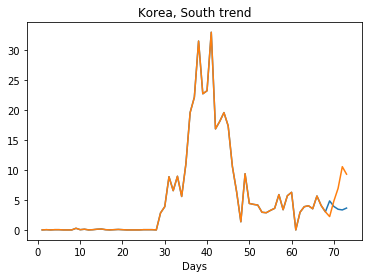

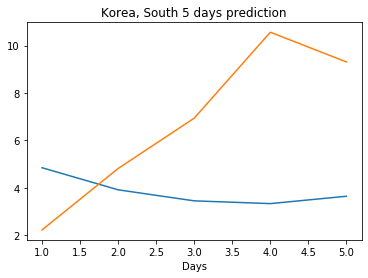

Creating directory ./offline5/Japan/training/
Japan
Saving the best model weights at Epoch [1], Best Valid Loss: 0.7632
Saving the best model weights at Epoch [2], Best Valid Loss: 0.7224


/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Saving the best model weights at Epoch [3], Best Valid Loss: 0.7217
Saving the best model weights at Epoch [5], Best Valid Loss: 0.7149
Saving the best model weights at Epoch [7], Best Valid Loss: 0.6896
Saving the best model weights at Epoch [9], Best Valid Loss: 0.6653
Saving the best model weights at Epoch [10], Best Valid Loss: 0.6590
Saving the best model weights at Epoch [11], Best Valid Loss: 0.6514
Saving the best model weights at Epoch [13], Best Valid Loss: 0.6341
Saving the best model weights at Epoch [14], Best Valid Loss: 0.6300
Saving the best model weights at Epoch [15], Best Valid Loss: 0.6236
Saving the best model weights at Epoch [17], Best Valid Loss: 0.5931
Saving the best model weights at Epoch [18], Best Valid Loss: 0.5780
Saving the best model weights at Epoch [20], Best Valid Loss: 0.5684
Saving the best model weights at Epoch [21], Best Valid Loss: 0.5683
Saving the best model weights at Epoch [22], Best Valid Loss: 0.5581
Saving the best model weights at Epoch

Saving the best model weights at Epoch [6], Best Valid Loss: 0.5086
Saving the best model weights at Epoch [12], Best Valid Loss: 0.4822
Saving the best model weights at Epoch [28], Best Valid Loss: 0.4822
Saving the best model weights at Epoch [32], Best Valid Loss: 0.4728
Saving the best model weights at Epoch [39], Best Valid Loss: 0.4061
Saving the best model weights at Epoch [47], Best Valid Loss: 0.4026
train error: 0.02278812507498323
0.4025816023349762
Saving the best model weights at Epoch [1], Best Valid Loss: 0.7362
Saving the best model weights at Epoch [2], Best Valid Loss: 0.6085
Saving the best model weights at Epoch [3], Best Valid Loss: 0.4772
Saving the best model weights at Epoch [12], Best Valid Loss: 0.4142
Saving the best model weights at Epoch [28], Best Valid Loss: 0.3937
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3406
Saving the best model weights at Epoch [49], Best Valid Loss: 0.3387
train error: 0.018986734711736637
0.338672399520874
Sav

Saving the best model weights at Epoch [29], Best Valid Loss: 0.5179
Saving the best model weights at Epoch [30], Best Valid Loss: 0.5084
Saving the best model weights at Epoch [31], Best Valid Loss: 0.4939
train error: 0.03540975922461305
0.4939452111721039
Saving the best model weights at Epoch [1], Best Valid Loss: 0.7229
Saving the best model weights at Epoch [2], Best Valid Loss: 0.7191
Saving the best model weights at Epoch [3], Best Valid Loss: 0.6902
Saving the best model weights at Epoch [6], Best Valid Loss: 0.6202
Saving the best model weights at Epoch [8], Best Valid Loss: 0.5670
Saving the best model weights at Epoch [11], Best Valid Loss: 0.5600
Saving the best model weights at Epoch [12], Best Valid Loss: 0.5499
Saving the best model weights at Epoch [13], Best Valid Loss: 0.5403
Saving the best model weights at Epoch [14], Best Valid Loss: 0.5170
Saving the best model weights at Epoch [20], Best Valid Loss: 0.5085
Saving the best model weights at Epoch [23], Best Valid 

Saving the best model weights at Epoch [44], Best Valid Loss: 0.5207
Saving the best model weights at Epoch [50], Best Valid Loss: 0.5007
train error: 0.03710503006923797
0.5006546378135681
Saving the best model weights at Epoch [1], Best Valid Loss: 0.6365
Saving the best model weights at Epoch [8], Best Valid Loss: 0.5525
Saving the best model weights at Epoch [14], Best Valid Loss: 0.5144
Saving the best model weights at Epoch [15], Best Valid Loss: 0.4910
Saving the best model weights at Epoch [16], Best Valid Loss: 0.4524
Saving the best model weights at Epoch [44], Best Valid Loss: 0.4213
train error: 0.03369421168156948
0.42134442925453186
Saving the best model weights at Epoch [1], Best Valid Loss: 0.7659
Saving the best model weights at Epoch [2], Best Valid Loss: 0.7522
Saving the best model weights at Epoch [5], Best Valid Loss: 0.7264
Saving the best model weights at Epoch [12], Best Valid Loss: 0.7233
Saving the best model weights at Epoch [16], Best Valid Loss: 0.7171
Sav

Saving the best model weights at Epoch [33], Best Valid Loss: 0.6982
train error: 0.0789047648370462
0.6981675028800964
Saving the best model weights at Epoch [1], Best Valid Loss: 0.7457
Saving the best model weights at Epoch [4], Best Valid Loss: 0.7293
Saving the best model weights at Epoch [5], Best Valid Loss: 0.6914
Saving the best model weights at Epoch [49], Best Valid Loss: 0.6722
train error: 0.0802345313621979
0.6721804141998291
Saving the best model weights at Epoch [1], Best Valid Loss: 0.7228
Saving the best model weights at Epoch [2], Best Valid Loss: 0.6802
Saving the best model weights at Epoch [4], Best Valid Loss: 0.6651
Saving the best model weights at Epoch [21], Best Valid Loss: 0.6620
Saving the best model weights at Epoch [31], Best Valid Loss: 0.6445
train error: 0.07881248694550443
0.6444776058197021
Saving the best model weights at Epoch [1], Best Valid Loss: 0.8298
Saving the best model weights at Epoch [2], Best Valid Loss: 0.6537
Saving the best model weig

Saving the best model weights at Epoch [5], Best Valid Loss: 0.7191
Saving the best model weights at Epoch [16], Best Valid Loss: 0.7151
Saving the best model weights at Epoch [18], Best Valid Loss: 0.6852
train error: 0.07808808276527807
0.685248076915741
Saving the best model weights at Epoch [1], Best Valid Loss: 0.7784
Saving the best model weights at Epoch [2], Best Valid Loss: 0.7711
Saving the best model weights at Epoch [3], Best Valid Loss: 0.7095
Saving the best model weights at Epoch [4], Best Valid Loss: 0.6999
Saving the best model weights at Epoch [44], Best Valid Loss: 0.6963
Saving the best model weights at Epoch [50], Best Valid Loss: 0.6806
train error: 0.07777559771937759
0.6805601119995117
Saving the best model weights at Epoch [1], Best Valid Loss: 0.7241
Saving the best model weights at Epoch [5], Best Valid Loss: 0.7100
Saving the best model weights at Epoch [7], Best Valid Loss: 0.7036
Saving the best model weights at Epoch [9], Best Valid Loss: 0.6740
Saving th

Saving the best model weights at Epoch [22], Best Valid Loss: 0.7079
Saving the best model weights at Epoch [23], Best Valid Loss: 0.6891
Saving the best model weights at Epoch [35], Best Valid Loss: 0.6828
train error: 0.07878701974588789
0.6827752590179443
Saving the best model weights at Epoch [1], Best Valid Loss: 0.7912
Saving the best model weights at Epoch [2], Best Valid Loss: 0.7346
Saving the best model weights at Epoch [5], Best Valid Loss: 0.7121
Saving the best model weights at Epoch [10], Best Valid Loss: 0.6720
train error: 0.07992980157417294
0.671956479549408
Saving the best model weights at Epoch [1], Best Valid Loss: 0.8064
Saving the best model weights at Epoch [2], Best Valid Loss: 0.7081
Saving the best model weights at Epoch [11], Best Valid Loss: 0.6577
Saving the best model weights at Epoch [28], Best Valid Loss: 0.6286
train error: 0.07663491923411034
0.6285516619682312
Saving the best model weights at Epoch [1], Best Valid Loss: 0.9052
Saving the best model w

Saving the best model weights at Epoch [24], Best Valid Loss: 0.7492
Saving the best model weights at Epoch [25], Best Valid Loss: 0.7484
Saving the best model weights at Epoch [26], Best Valid Loss: 0.7476
Saving the best model weights at Epoch [27], Best Valid Loss: 0.7466
Saving the best model weights at Epoch [28], Best Valid Loss: 0.7462
Saving the best model weights at Epoch [29], Best Valid Loss: 0.7455
Saving the best model weights at Epoch [30], Best Valid Loss: 0.7448
Saving the best model weights at Epoch [31], Best Valid Loss: 0.7442
Saving the best model weights at Epoch [32], Best Valid Loss: 0.7428
Saving the best model weights at Epoch [33], Best Valid Loss: 0.7422
Saving the best model weights at Epoch [34], Best Valid Loss: 0.7414
Saving the best model weights at Epoch [35], Best Valid Loss: 0.7400
Saving the best model weights at Epoch [36], Best Valid Loss: 0.7395
Saving the best model weights at Epoch [37], Best Valid Loss: 0.7392
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.7801
Saving the best model weights at Epoch [3], Best Valid Loss: 0.7225
Saving the best model weights at Epoch [4], Best Valid Loss: 0.6936
Saving the best model weights at Epoch [5], Best Valid Loss: 0.6730
Saving the best model weights at Epoch [6], Best Valid Loss: 0.6612
Saving the best model weights at Epoch [7], Best Valid Loss: 0.6565
Saving the best model weights at Epoch [8], Best Valid Loss: 0.6538
Saving the best model weights at Epoch [9], Best Valid Loss: 0.6483
Saving the best model weights at Epoch [10], Best Valid Loss: 0.6421
Saving the best model weights at Epoch [13], Best Valid Loss: 0.6404
Saving the best model weights at Epoch [16], Best Valid Loss: 0.6324
Saving the best model weights at Epoch [17], Best Valid Loss: 0.6307
Saving the best model weights at Epoch [18], Best Valid Loss: 0.6260
Saving the best model weights at Epoch [19], Best Valid Loss: 0.6256
Saving the best model weights at Epoch [20

Saving the best model weights at Epoch [10], Best Valid Loss: 0.7339
Saving the best model weights at Epoch [11], Best Valid Loss: 0.7283
Saving the best model weights at Epoch [12], Best Valid Loss: 0.7243
Saving the best model weights at Epoch [13], Best Valid Loss: 0.7202
Saving the best model weights at Epoch [14], Best Valid Loss: 0.7191
Saving the best model weights at Epoch [15], Best Valid Loss: 0.7159
Saving the best model weights at Epoch [16], Best Valid Loss: 0.7135
Saving the best model weights at Epoch [17], Best Valid Loss: 0.7111
Saving the best model weights at Epoch [18], Best Valid Loss: 0.7102
Saving the best model weights at Epoch [19], Best Valid Loss: 0.7086
Saving the best model weights at Epoch [20], Best Valid Loss: 0.7074
Saving the best model weights at Epoch [21], Best Valid Loss: 0.7049
Saving the best model weights at Epoch [22], Best Valid Loss: 0.7044
Saving the best model weights at Epoch [23], Best Valid Loss: 0.7026
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.7262
Saving the best model weights at Epoch [4], Best Valid Loss: 0.7254
Saving the best model weights at Epoch [6], Best Valid Loss: 0.6977
Saving the best model weights at Epoch [11], Best Valid Loss: 0.6893
Saving the best model weights at Epoch [13], Best Valid Loss: 0.6851
Saving the best model weights at Epoch [14], Best Valid Loss: 0.6787
Saving the best model weights at Epoch [15], Best Valid Loss: 0.6692
Saving the best model weights at Epoch [16], Best Valid Loss: 0.6541
Saving the best model weights at Epoch [18], Best Valid Loss: 0.6533
Saving the best model weights at Epoch [19], Best Valid Loss: 0.6466
Saving the best model weights at Epoch [20], Best Valid Loss: 0.6224
Saving the best model weights at Epoch [22], Best Valid Loss: 0.6107
Saving the best model weights at Epoch [24], Best Valid Loss: 0.6052
Saving the best model weights at Epoch [25], Best Valid Loss: 0.6014
Saving the best model weights at Epoc

Saving the best model weights at Epoch [1], Best Valid Loss: 1.0701
Saving the best model weights at Epoch [2], Best Valid Loss: 0.9522
Saving the best model weights at Epoch [3], Best Valid Loss: 0.8773
Saving the best model weights at Epoch [4], Best Valid Loss: 0.8264
Saving the best model weights at Epoch [5], Best Valid Loss: 0.7903
Saving the best model weights at Epoch [6], Best Valid Loss: 0.7641
Saving the best model weights at Epoch [7], Best Valid Loss: 0.7493
Saving the best model weights at Epoch [8], Best Valid Loss: 0.7346
Saving the best model weights at Epoch [9], Best Valid Loss: 0.7246
Saving the best model weights at Epoch [10], Best Valid Loss: 0.7187
Saving the best model weights at Epoch [11], Best Valid Loss: 0.7128
Saving the best model weights at Epoch [12], Best Valid Loss: 0.7118
Saving the best model weights at Epoch [13], Best Valid Loss: 0.7086
Saving the best model weights at Epoch [14], Best Valid Loss: 0.7050
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [12], Best Valid Loss: 0.7671
Saving the best model weights at Epoch [13], Best Valid Loss: 0.7604
Saving the best model weights at Epoch [14], Best Valid Loss: 0.7548
Saving the best model weights at Epoch [15], Best Valid Loss: 0.7504
Saving the best model weights at Epoch [16], Best Valid Loss: 0.7462
Saving the best model weights at Epoch [17], Best Valid Loss: 0.7438
Saving the best model weights at Epoch [18], Best Valid Loss: 0.7403
Saving the best model weights at Epoch [19], Best Valid Loss: 0.7385
Saving the best model weights at Epoch [20], Best Valid Loss: 0.7359
Saving the best model weights at Epoch [21], Best Valid Loss: 0.7342
Saving the best model weights at Epoch [22], Best Valid Loss: 0.7322
Saving the best model weights at Epoch [23], Best Valid Loss: 0.7312
Saving the best model weights at Epoch [24], Best Valid Loss: 0.7301
Saving the best model weights at Epoch [25], Best Valid Loss: 0.7288
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.6981
Saving the best model weights at Epoch [43], Best Valid Loss: 0.6959
Saving the best model weights at Epoch [45], Best Valid Loss: 0.6940
Saving the best model weights at Epoch [46], Best Valid Loss: 0.6931
Saving the best model weights at Epoch [47], Best Valid Loss: 0.6920
Saving the best model weights at Epoch [49], Best Valid Loss: 0.6883
Saving the best model weights at Epoch [50], Best Valid Loss: 0.6873
train error: 0.06563349672299075
0.6872881054878235
Saving the best model weights at Epoch [1], Best Valid Loss: 0.9678
Saving the best model weights at Epoch [2], Best Valid Loss: 0.8550
Saving the best model weights at Epoch [3], Best Valid Loss: 0.7975
Saving the best model weights at Epoch [4], Best Valid Loss: 0.7584
Saving the best model weights at Epoch [5], Best Valid Loss: 0.7435
Saving the best model weights at Epoch [6], Best Valid Loss: 0.7343
Saving the best model weights at Epoch [7], Best Valid Lo

Saving the best model weights at Epoch [17], Best Valid Loss: 0.7435
Saving the best model weights at Epoch [18], Best Valid Loss: 0.7432
Saving the best model weights at Epoch [19], Best Valid Loss: 0.7417
Saving the best model weights at Epoch [20], Best Valid Loss: 0.7395
Saving the best model weights at Epoch [21], Best Valid Loss: 0.7388
Saving the best model weights at Epoch [22], Best Valid Loss: 0.7386
Saving the best model weights at Epoch [23], Best Valid Loss: 0.7386
Saving the best model weights at Epoch [24], Best Valid Loss: 0.7380
Saving the best model weights at Epoch [25], Best Valid Loss: 0.7376
Saving the best model weights at Epoch [28], Best Valid Loss: 0.7371
Saving the best model weights at Epoch [33], Best Valid Loss: 0.7366
Saving the best model weights at Epoch [35], Best Valid Loss: 0.7361
Saving the best model weights at Epoch [36], Best Valid Loss: 0.7353
train error: 0.07470375194067233
0.7353203296661377
Saving the best model weights at Epoch [1], Best Va

train error: 0.07497822435719795
0.7346553206443787
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0054
Saving the best model weights at Epoch [2], Best Valid Loss: 0.9212
Saving the best model weights at Epoch [3], Best Valid Loss: 0.8661
Saving the best model weights at Epoch [4], Best Valid Loss: 0.8297
Saving the best model weights at Epoch [5], Best Valid Loss: 0.8044
Saving the best model weights at Epoch [6], Best Valid Loss: 0.7898
Saving the best model weights at Epoch [7], Best Valid Loss: 0.7726
Saving the best model weights at Epoch [8], Best Valid Loss: 0.7628
Saving the best model weights at Epoch [9], Best Valid Loss: 0.7563
Saving the best model weights at Epoch [10], Best Valid Loss: 0.7518
Saving the best model weights at Epoch [11], Best Valid Loss: 0.7482
Saving the best model weights at Epoch [12], Best Valid Loss: 0.7460
Saving the best model weights at Epoch [13], Best Valid Loss: 0.7428
Saving the best model weights at Epoch [14], Best Valid Loss

Saving the best model weights at Epoch [12], Best Valid Loss: 0.7464
Saving the best model weights at Epoch [14], Best Valid Loss: 0.7444
Saving the best model weights at Epoch [15], Best Valid Loss: 0.7431
Saving the best model weights at Epoch [18], Best Valid Loss: 0.7419
Saving the best model weights at Epoch [19], Best Valid Loss: 0.7409
Saving the best model weights at Epoch [21], Best Valid Loss: 0.7408
Saving the best model weights at Epoch [28], Best Valid Loss: 0.7404
Saving the best model weights at Epoch [38], Best Valid Loss: 0.7392
Saving the best model weights at Epoch [48], Best Valid Loss: 0.7382
Saving the best model weights at Epoch [50], Best Valid Loss: 0.7362
train error: 0.0749298277507095
0.7362293004989624
Saving the best model weights at Epoch [1], Best Valid Loss: 0.9459
Saving the best model weights at Epoch [2], Best Valid Loss: 0.8461
Saving the best model weights at Epoch [3], Best Valid Loss: 0.7945
Saving the best model weights at Epoch [4], Best Valid 

Saving the best model weights at Epoch [21], Best Valid Loss: 0.7380
Saving the best model weights at Epoch [22], Best Valid Loss: 0.7372
Saving the best model weights at Epoch [30], Best Valid Loss: 0.7366
Saving the best model weights at Epoch [31], Best Valid Loss: 0.7355
Saving the best model weights at Epoch [50], Best Valid Loss: 0.7344
train error: 0.07500680531130026
0.7344375848770142
Saving the best model weights at Epoch [1], Best Valid Loss: 0.9437
Saving the best model weights at Epoch [2], Best Valid Loss: 0.8473
Saving the best model weights at Epoch [3], Best Valid Loss: 0.7959
Saving the best model weights at Epoch [4], Best Valid Loss: 0.7694
Saving the best model weights at Epoch [5], Best Valid Loss: 0.7590
Saving the best model weights at Epoch [6], Best Valid Loss: 0.7493
Saving the best model weights at Epoch [7], Best Valid Loss: 0.7480
Saving the best model weights at Epoch [8], Best Valid Loss: 0.7375
Saving the best model weights at Epoch [10], Best Valid Los

Saving the best model weights at Epoch [19], Best Valid Loss: 0.7312
train error: 0.07548486556563723
0.731209397315979
Saving the best model weights at Epoch [1], Best Valid Loss: 0.7624
Saving the best model weights at Epoch [2], Best Valid Loss: 0.7363
Saving the best model weights at Epoch [3], Best Valid Loss: 0.7324
Saving the best model weights at Epoch [7], Best Valid Loss: 0.7277
Saving the best model weights at Epoch [14], Best Valid Loss: 0.7127
train error: 0.07594969411576658
0.7126592397689819
Saving the best model weights at Epoch [1], Best Valid Loss: 0.9963
Saving the best model weights at Epoch [2], Best Valid Loss: 0.9478
Saving the best model weights at Epoch [3], Best Valid Loss: 0.9089
Saving the best model weights at Epoch [4], Best Valid Loss: 0.8786
Saving the best model weights at Epoch [5], Best Valid Loss: 0.8533
Saving the best model weights at Epoch [6], Best Valid Loss: 0.8328
Saving the best model weights at Epoch [7], Best Valid Loss: 0.8167
Saving the 

Saving the best model weights at Epoch [10], Best Valid Loss: 0.7843
Saving the best model weights at Epoch [11], Best Valid Loss: 0.7756
Saving the best model weights at Epoch [12], Best Valid Loss: 0.7690
Saving the best model weights at Epoch [13], Best Valid Loss: 0.7638
Saving the best model weights at Epoch [14], Best Valid Loss: 0.7588
Saving the best model weights at Epoch [15], Best Valid Loss: 0.7552
Saving the best model weights at Epoch [16], Best Valid Loss: 0.7514
Saving the best model weights at Epoch [17], Best Valid Loss: 0.7491
Saving the best model weights at Epoch [18], Best Valid Loss: 0.7471
Saving the best model weights at Epoch [19], Best Valid Loss: 0.7456
Saving the best model weights at Epoch [20], Best Valid Loss: 0.7448
Saving the best model weights at Epoch [21], Best Valid Loss: 0.7442
Saving the best model weights at Epoch [22], Best Valid Loss: 0.7427
Saving the best model weights at Epoch [23], Best Valid Loss: 0.7416
Saving the best model weights at E

Saving the best model weights at Epoch [25], Best Valid Loss: 0.7422
Saving the best model weights at Epoch [26], Best Valid Loss: 0.7415
Saving the best model weights at Epoch [27], Best Valid Loss: 0.7413
Saving the best model weights at Epoch [28], Best Valid Loss: 0.7408
Saving the best model weights at Epoch [29], Best Valid Loss: 0.7402
Saving the best model weights at Epoch [30], Best Valid Loss: 0.7398
Saving the best model weights at Epoch [31], Best Valid Loss: 0.7392
Saving the best model weights at Epoch [32], Best Valid Loss: 0.7388
Saving the best model weights at Epoch [33], Best Valid Loss: 0.7387
Saving the best model weights at Epoch [41], Best Valid Loss: 0.7386
Saving the best model weights at Epoch [42], Best Valid Loss: 0.7386
Saving the best model weights at Epoch [43], Best Valid Loss: 0.7379
Saving the best model weights at Epoch [50], Best Valid Loss: 0.7378
train error: 0.07496496637989032
0.737804651260376
Saving the best model weights at Epoch [1], Best Val

Saving the best model weights at Epoch [2], Best Valid Loss: 1.0134
Saving the best model weights at Epoch [3], Best Valid Loss: 0.9416
Saving the best model weights at Epoch [4], Best Valid Loss: 0.8895
Saving the best model weights at Epoch [5], Best Valid Loss: 0.8527
Saving the best model weights at Epoch [6], Best Valid Loss: 0.8244
Saving the best model weights at Epoch [7], Best Valid Loss: 0.8033
Saving the best model weights at Epoch [8], Best Valid Loss: 0.7877
Saving the best model weights at Epoch [9], Best Valid Loss: 0.7761
Saving the best model weights at Epoch [10], Best Valid Loss: 0.7685
Saving the best model weights at Epoch [11], Best Valid Loss: 0.7616
Saving the best model weights at Epoch [12], Best Valid Loss: 0.7570
Saving the best model weights at Epoch [13], Best Valid Loss: 0.7519
Saving the best model weights at Epoch [14], Best Valid Loss: 0.7490
Saving the best model weights at Epoch [15], Best Valid Loss: 0.7465
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [22], Best Valid Loss: 0.7411
Saving the best model weights at Epoch [24], Best Valid Loss: 0.7407
Saving the best model weights at Epoch [25], Best Valid Loss: 0.7387
Saving the best model weights at Epoch [26], Best Valid Loss: 0.7382
Saving the best model weights at Epoch [34], Best Valid Loss: 0.7378
Saving the best model weights at Epoch [35], Best Valid Loss: 0.7369
Saving the best model weights at Epoch [41], Best Valid Loss: 0.7365
train error: 0.0750180606264621
0.736524760723114
Saving the best model weights at Epoch [1], Best Valid Loss: 0.9085
Saving the best model weights at Epoch [2], Best Valid Loss: 0.8522
Saving the best model weights at Epoch [3], Best Valid Loss: 0.8193
Saving the best model weights at Epoch [4], Best Valid Loss: 0.7961
Saving the best model weights at Epoch [5], Best Valid Loss: 0.7780
Saving the best model weights at Epoch [6], Best Valid Loss: 0.7681
Saving the best model weights at Epoch [7], Best Valid Loss

Saving the best model weights at Epoch [8], Best Valid Loss: 0.7576
Saving the best model weights at Epoch [9], Best Valid Loss: 0.7516
Saving the best model weights at Epoch [10], Best Valid Loss: 0.7454
Saving the best model weights at Epoch [11], Best Valid Loss: 0.7440
Saving the best model weights at Epoch [12], Best Valid Loss: 0.7420
Saving the best model weights at Epoch [13], Best Valid Loss: 0.7406
Saving the best model weights at Epoch [14], Best Valid Loss: 0.7399
Saving the best model weights at Epoch [15], Best Valid Loss: 0.7389
Saving the best model weights at Epoch [16], Best Valid Loss: 0.7388
Saving the best model weights at Epoch [17], Best Valid Loss: 0.7379
Saving the best model weights at Epoch [18], Best Valid Loss: 0.7365
train error: 0.07513898255695638
0.7364647388458252
Saving the best model weights at Epoch [1], Best Valid Loss: 0.9834
Saving the best model weights at Epoch [2], Best Valid Loss: 0.8634
Saving the best model weights at Epoch [3], Best Valid 

Saving the best model weights at Epoch [31], Best Valid Loss: 0.7339
Saving the best model weights at Epoch [32], Best Valid Loss: 0.7326
Saving the best model weights at Epoch [42], Best Valid Loss: 0.7306
train error: 0.07533962061432631
0.7305522561073303
Saving the best model weights at Epoch [1], Best Valid Loss: 0.8026
Saving the best model weights at Epoch [2], Best Valid Loss: 0.7250
Saving the best model weights at Epoch [5], Best Valid Loss: 0.7177
Saving the best model weights at Epoch [45], Best Valid Loss: 0.7173
train error: 0.07594817292288338
0.7173192501068115
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0880
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0211
Saving the best model weights at Epoch [3], Best Valid Loss: 0.9686
Saving the best model weights at Epoch [4], Best Valid Loss: 0.9261
Saving the best model weights at Epoch [5], Best Valid Loss: 0.8929
Saving the best model weights at Epoch [6], Best Valid Loss: 0.8648
Saving t

Saving the best model weights at Epoch [4], Best Valid Loss: 0.8764
Saving the best model weights at Epoch [5], Best Valid Loss: 0.8496
Saving the best model weights at Epoch [6], Best Valid Loss: 0.8293
Saving the best model weights at Epoch [7], Best Valid Loss: 0.8129
Saving the best model weights at Epoch [8], Best Valid Loss: 0.7994
Saving the best model weights at Epoch [9], Best Valid Loss: 0.7889
Saving the best model weights at Epoch [10], Best Valid Loss: 0.7792
Saving the best model weights at Epoch [11], Best Valid Loss: 0.7725
Saving the best model weights at Epoch [12], Best Valid Loss: 0.7674
Saving the best model weights at Epoch [13], Best Valid Loss: 0.7631
Saving the best model weights at Epoch [14], Best Valid Loss: 0.7586
Saving the best model weights at Epoch [15], Best Valid Loss: 0.7552
Saving the best model weights at Epoch [16], Best Valid Loss: 0.7528
Saving the best model weights at Epoch [17], Best Valid Loss: 0.7504
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [18], Best Valid Loss: 0.7499
Saving the best model weights at Epoch [19], Best Valid Loss: 0.7480
Saving the best model weights at Epoch [20], Best Valid Loss: 0.7461
Saving the best model weights at Epoch [21], Best Valid Loss: 0.7441
Saving the best model weights at Epoch [22], Best Valid Loss: 0.7434
Saving the best model weights at Epoch [23], Best Valid Loss: 0.7428
Saving the best model weights at Epoch [24], Best Valid Loss: 0.7421
Saving the best model weights at Epoch [25], Best Valid Loss: 0.7416
Saving the best model weights at Epoch [26], Best Valid Loss: 0.7405
Saving the best model weights at Epoch [28], Best Valid Loss: 0.7404
Saving the best model weights at Epoch [29], Best Valid Loss: 0.7400
Saving the best model weights at Epoch [30], Best Valid Loss: 0.7398
Saving the best model weights at Epoch [33], Best Valid Loss: 0.7397
Saving the best model weights at Epoch [34], Best Valid Loss: 0.7390
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.7385
train error: 0.07497164051930763
0.7384529709815979
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0234
Saving the best model weights at Epoch [2], Best Valid Loss: 0.9535
Saving the best model weights at Epoch [3], Best Valid Loss: 0.9029
Saving the best model weights at Epoch [4], Best Valid Loss: 0.8648
Saving the best model weights at Epoch [5], Best Valid Loss: 0.8358
Saving the best model weights at Epoch [6], Best Valid Loss: 0.8140
Saving the best model weights at Epoch [7], Best Valid Loss: 0.7973
Saving the best model weights at Epoch [8], Best Valid Loss: 0.7845
Saving the best model weights at Epoch [9], Best Valid Loss: 0.7758
Saving the best model weights at Epoch [10], Best Valid Loss: 0.7662
Saving the best model weights at Epoch [11], Best Valid Loss: 0.7611
Saving the best model weights at Epoch [12], Best Valid Loss: 0.7565
Saving the best model weights at Epoch [13], Best Valid Loss

Saving the best model weights at Epoch [1], Best Valid Loss: 1.1774
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1644
Saving the best model weights at Epoch [3], Best Valid Loss: 1.1518
Saving the best model weights at Epoch [4], Best Valid Loss: 1.1396
Saving the best model weights at Epoch [5], Best Valid Loss: 1.1278
Saving the best model weights at Epoch [6], Best Valid Loss: 1.1164
Saving the best model weights at Epoch [7], Best Valid Loss: 1.1054
Saving the best model weights at Epoch [8], Best Valid Loss: 1.0946
Saving the best model weights at Epoch [9], Best Valid Loss: 1.0842
Saving the best model weights at Epoch [10], Best Valid Loss: 1.0740
Saving the best model weights at Epoch [11], Best Valid Loss: 1.0642
Saving the best model weights at Epoch [12], Best Valid Loss: 1.0548
Saving the best model weights at Epoch [13], Best Valid Loss: 1.0454
Saving the best model weights at Epoch [14], Best Valid Loss: 1.0365
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [21], Best Valid Loss: 0.8533
Saving the best model weights at Epoch [22], Best Valid Loss: 0.8456
Saving the best model weights at Epoch [23], Best Valid Loss: 0.8386
Saving the best model weights at Epoch [24], Best Valid Loss: 0.8314
Saving the best model weights at Epoch [25], Best Valid Loss: 0.8250
Saving the best model weights at Epoch [26], Best Valid Loss: 0.8191
Saving the best model weights at Epoch [27], Best Valid Loss: 0.8130
Saving the best model weights at Epoch [28], Best Valid Loss: 0.8081
Saving the best model weights at Epoch [29], Best Valid Loss: 0.8028
Saving the best model weights at Epoch [30], Best Valid Loss: 0.7985
Saving the best model weights at Epoch [31], Best Valid Loss: 0.7940
Saving the best model weights at Epoch [32], Best Valid Loss: 0.7897
Saving the best model weights at Epoch [33], Best Valid Loss: 0.7858
Saving the best model weights at Epoch [34], Best Valid Loss: 0.7829
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 1.0227
Saving the best model weights at Epoch [5], Best Valid Loss: 1.0128
Saving the best model weights at Epoch [6], Best Valid Loss: 1.0034
Saving the best model weights at Epoch [7], Best Valid Loss: 0.9943
Saving the best model weights at Epoch [8], Best Valid Loss: 0.9855
Saving the best model weights at Epoch [9], Best Valid Loss: 0.9769
Saving the best model weights at Epoch [10], Best Valid Loss: 0.9687
Saving the best model weights at Epoch [11], Best Valid Loss: 0.9608
Saving the best model weights at Epoch [12], Best Valid Loss: 0.9531
Saving the best model weights at Epoch [13], Best Valid Loss: 0.9456
Saving the best model weights at Epoch [14], Best Valid Loss: 0.9383
Saving the best model weights at Epoch [15], Best Valid Loss: 0.9313
Saving the best model weights at Epoch [16], Best Valid Loss: 0.9246
Saving the best model weights at Epoch [17], Best Valid Loss: 0.9181
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [22], Best Valid Loss: 0.8378
Saving the best model weights at Epoch [23], Best Valid Loss: 0.8299
Saving the best model weights at Epoch [24], Best Valid Loss: 0.8220
Saving the best model weights at Epoch [25], Best Valid Loss: 0.8155
Saving the best model weights at Epoch [26], Best Valid Loss: 0.8087
Saving the best model weights at Epoch [27], Best Valid Loss: 0.8032
Saving the best model weights at Epoch [28], Best Valid Loss: 0.7975
Saving the best model weights at Epoch [29], Best Valid Loss: 0.7920
Saving the best model weights at Epoch [30], Best Valid Loss: 0.7868
Saving the best model weights at Epoch [31], Best Valid Loss: 0.7821
Saving the best model weights at Epoch [32], Best Valid Loss: 0.7783
Saving the best model weights at Epoch [33], Best Valid Loss: 0.7734
Saving the best model weights at Epoch [34], Best Valid Loss: 0.7697
Saving the best model weights at Epoch [35], Best Valid Loss: 0.7662
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 1.2870
Saving the best model weights at Epoch [4], Best Valid Loss: 1.2706
Saving the best model weights at Epoch [5], Best Valid Loss: 1.2549
Saving the best model weights at Epoch [6], Best Valid Loss: 1.2396
Saving the best model weights at Epoch [7], Best Valid Loss: 1.2245
Saving the best model weights at Epoch [8], Best Valid Loss: 1.2102
Saving the best model weights at Epoch [9], Best Valid Loss: 1.1962
Saving the best model weights at Epoch [10], Best Valid Loss: 1.1826
Saving the best model weights at Epoch [11], Best Valid Loss: 1.1696
Saving the best model weights at Epoch [12], Best Valid Loss: 1.1568
Saving the best model weights at Epoch [13], Best Valid Loss: 1.1444
Saving the best model weights at Epoch [14], Best Valid Loss: 1.1325
Saving the best model weights at Epoch [15], Best Valid Loss: 1.1211
Saving the best model weights at Epoch [16], Best Valid Loss: 1.1097
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [23], Best Valid Loss: 0.8497
Saving the best model weights at Epoch [24], Best Valid Loss: 0.8423
Saving the best model weights at Epoch [25], Best Valid Loss: 0.8355
Saving the best model weights at Epoch [26], Best Valid Loss: 0.8289
Saving the best model weights at Epoch [27], Best Valid Loss: 0.8237
Saving the best model weights at Epoch [28], Best Valid Loss: 0.8175
Saving the best model weights at Epoch [29], Best Valid Loss: 0.8121
Saving the best model weights at Epoch [30], Best Valid Loss: 0.8076
Saving the best model weights at Epoch [31], Best Valid Loss: 0.8030
Saving the best model weights at Epoch [32], Best Valid Loss: 0.7991
Saving the best model weights at Epoch [33], Best Valid Loss: 0.7947
Saving the best model weights at Epoch [34], Best Valid Loss: 0.7906
Saving the best model weights at Epoch [35], Best Valid Loss: 0.7869
Saving the best model weights at Epoch [36], Best Valid Loss: 0.7839
Saving the best model weights at E

Saving the best model weights at Epoch [5], Best Valid Loss: 1.1885
Saving the best model weights at Epoch [6], Best Valid Loss: 1.1752
Saving the best model weights at Epoch [7], Best Valid Loss: 1.1625
Saving the best model weights at Epoch [8], Best Valid Loss: 1.1501
Saving the best model weights at Epoch [9], Best Valid Loss: 1.1380
Saving the best model weights at Epoch [10], Best Valid Loss: 1.1263
Saving the best model weights at Epoch [11], Best Valid Loss: 1.1152
Saving the best model weights at Epoch [12], Best Valid Loss: 1.1040
Saving the best model weights at Epoch [13], Best Valid Loss: 1.0934
Saving the best model weights at Epoch [14], Best Valid Loss: 1.0831
Saving the best model weights at Epoch [15], Best Valid Loss: 1.0730
Saving the best model weights at Epoch [16], Best Valid Loss: 1.0633
Saving the best model weights at Epoch [17], Best Valid Loss: 1.0540
Saving the best model weights at Epoch [18], Best Valid Loss: 1.0447
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [25], Best Valid Loss: 0.8187
Saving the best model weights at Epoch [26], Best Valid Loss: 0.8141
Saving the best model weights at Epoch [27], Best Valid Loss: 0.8089
Saving the best model weights at Epoch [28], Best Valid Loss: 0.8045
Saving the best model weights at Epoch [29], Best Valid Loss: 0.8003
Saving the best model weights at Epoch [30], Best Valid Loss: 0.7965
Saving the best model weights at Epoch [31], Best Valid Loss: 0.7926
Saving the best model weights at Epoch [32], Best Valid Loss: 0.7889
Saving the best model weights at Epoch [33], Best Valid Loss: 0.7859
Saving the best model weights at Epoch [34], Best Valid Loss: 0.7828
Saving the best model weights at Epoch [35], Best Valid Loss: 0.7797
Saving the best model weights at Epoch [36], Best Valid Loss: 0.7770
Saving the best model weights at Epoch [37], Best Valid Loss: 0.7746
Saving the best model weights at Epoch [38], Best Valid Loss: 0.7717
Saving the best model weights at E

Saving the best model weights at Epoch [9], Best Valid Loss: 0.9455
Saving the best model weights at Epoch [10], Best Valid Loss: 0.9400
Saving the best model weights at Epoch [11], Best Valid Loss: 0.9349
Saving the best model weights at Epoch [12], Best Valid Loss: 0.9295
Saving the best model weights at Epoch [13], Best Valid Loss: 0.9244
Saving the best model weights at Epoch [14], Best Valid Loss: 0.9196
Saving the best model weights at Epoch [15], Best Valid Loss: 0.9148
Saving the best model weights at Epoch [16], Best Valid Loss: 0.9101
Saving the best model weights at Epoch [17], Best Valid Loss: 0.9056
Saving the best model weights at Epoch [18], Best Valid Loss: 0.9012
Saving the best model weights at Epoch [19], Best Valid Loss: 0.8969
Saving the best model weights at Epoch [20], Best Valid Loss: 0.8928
Saving the best model weights at Epoch [21], Best Valid Loss: 0.8888
Saving the best model weights at Epoch [22], Best Valid Loss: 0.8849
Saving the best model weights at Ep

Saving the best model weights at Epoch [28], Best Valid Loss: 0.8187
Saving the best model weights at Epoch [29], Best Valid Loss: 0.8141
Saving the best model weights at Epoch [30], Best Valid Loss: 0.8105
Saving the best model weights at Epoch [31], Best Valid Loss: 0.8056
Saving the best model weights at Epoch [32], Best Valid Loss: 0.8016
Saving the best model weights at Epoch [33], Best Valid Loss: 0.7982
Saving the best model weights at Epoch [34], Best Valid Loss: 0.7960
Saving the best model weights at Epoch [35], Best Valid Loss: 0.7918
Saving the best model weights at Epoch [36], Best Valid Loss: 0.7893
Saving the best model weights at Epoch [37], Best Valid Loss: 0.7867
Saving the best model weights at Epoch [38], Best Valid Loss: 0.7843
Saving the best model weights at Epoch [39], Best Valid Loss: 0.7820
Saving the best model weights at Epoch [40], Best Valid Loss: 0.7795
Saving the best model weights at Epoch [41], Best Valid Loss: 0.7771
Saving the best model weights at E

Saving the best model weights at Epoch [20], Best Valid Loss: 0.9006
Saving the best model weights at Epoch [21], Best Valid Loss: 0.8965
Saving the best model weights at Epoch [22], Best Valid Loss: 0.8926
Saving the best model weights at Epoch [23], Best Valid Loss: 0.8887
Saving the best model weights at Epoch [24], Best Valid Loss: 0.8850
Saving the best model weights at Epoch [25], Best Valid Loss: 0.8814
Saving the best model weights at Epoch [26], Best Valid Loss: 0.8778
Saving the best model weights at Epoch [27], Best Valid Loss: 0.8744
Saving the best model weights at Epoch [28], Best Valid Loss: 0.8710
Saving the best model weights at Epoch [29], Best Valid Loss: 0.8678
Saving the best model weights at Epoch [30], Best Valid Loss: 0.8645
Saving the best model weights at Epoch [31], Best Valid Loss: 0.8614
Saving the best model weights at Epoch [32], Best Valid Loss: 0.8584
Saving the best model weights at Epoch [33], Best Valid Loss: 0.8555
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 0.7911
Saving the best model weights at Epoch [39], Best Valid Loss: 0.7893
Saving the best model weights at Epoch [40], Best Valid Loss: 0.7860
Saving the best model weights at Epoch [41], Best Valid Loss: 0.7835
Saving the best model weights at Epoch [42], Best Valid Loss: 0.7819
Saving the best model weights at Epoch [43], Best Valid Loss: 0.7786
Saving the best model weights at Epoch [44], Best Valid Loss: 0.7763
Saving the best model weights at Epoch [45], Best Valid Loss: 0.7749
Saving the best model weights at Epoch [46], Best Valid Loss: 0.7730
Saving the best model weights at Epoch [47], Best Valid Loss: 0.7709
Saving the best model weights at Epoch [48], Best Valid Loss: 0.7689
Saving the best model weights at Epoch [49], Best Valid Loss: 0.7682
Saving the best model weights at Epoch [50], Best Valid Loss: 0.7660
train error: 0.07537841765013964
0.7660442590713501
Saving the best model weights at Epoch [1], Best Va

Saving the best model weights at Epoch [27], Best Valid Loss: 0.9585
Saving the best model weights at Epoch [28], Best Valid Loss: 0.9526
Saving the best model weights at Epoch [29], Best Valid Loss: 0.9469
Saving the best model weights at Epoch [30], Best Valid Loss: 0.9412
Saving the best model weights at Epoch [31], Best Valid Loss: 0.9359
Saving the best model weights at Epoch [32], Best Valid Loss: 0.9306
Saving the best model weights at Epoch [33], Best Valid Loss: 0.9254
Saving the best model weights at Epoch [34], Best Valid Loss: 0.9206
Saving the best model weights at Epoch [35], Best Valid Loss: 0.9156
Saving the best model weights at Epoch [36], Best Valid Loss: 0.9109
Saving the best model weights at Epoch [37], Best Valid Loss: 0.9064
Saving the best model weights at Epoch [38], Best Valid Loss: 0.9019
Saving the best model weights at Epoch [39], Best Valid Loss: 0.8976
Saving the best model weights at Epoch [40], Best Valid Loss: 0.8934
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.7700
Saving the best model weights at Epoch [48], Best Valid Loss: 0.7686
Saving the best model weights at Epoch [49], Best Valid Loss: 0.7668
Saving the best model weights at Epoch [50], Best Valid Loss: 0.7661
train error: 0.07553449036602519
0.766102135181427
Saving the best model weights at Epoch [1], Best Valid Loss: 1.2235
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1326
Saving the best model weights at Epoch [3], Best Valid Loss: 1.0564
Saving the best model weights at Epoch [4], Best Valid Loss: 0.9992
Saving the best model weights at Epoch [5], Best Valid Loss: 0.9471
Saving the best model weights at Epoch [6], Best Valid Loss: 0.9134
Saving the best model weights at Epoch [7], Best Valid Loss: 0.8813
Saving the best model weights at Epoch [8], Best Valid Loss: 0.8552
Saving the best model weights at Epoch [9], Best Valid Loss: 0.8372
Saving the best model weights at Epoch [10], Best Valid Loss:

Saving the best model weights at Epoch [37], Best Valid Loss: 0.8651
Saving the best model weights at Epoch [38], Best Valid Loss: 0.8618
Saving the best model weights at Epoch [39], Best Valid Loss: 0.8587
Saving the best model weights at Epoch [40], Best Valid Loss: 0.8556
Saving the best model weights at Epoch [41], Best Valid Loss: 0.8526
Saving the best model weights at Epoch [42], Best Valid Loss: 0.8497
Saving the best model weights at Epoch [43], Best Valid Loss: 0.8470
Saving the best model weights at Epoch [44], Best Valid Loss: 0.8442
Saving the best model weights at Epoch [45], Best Valid Loss: 0.8416
Saving the best model weights at Epoch [46], Best Valid Loss: 0.8390
Saving the best model weights at Epoch [47], Best Valid Loss: 0.8365
Saving the best model weights at Epoch [48], Best Valid Loss: 0.8340
Saving the best model weights at Epoch [49], Best Valid Loss: 0.8317
Saving the best model weights at Epoch [50], Best Valid Loss: 0.8293
train error: 0.08196234392418869
0

Saving the best model weights at Epoch [5], Best Valid Loss: 0.8825
Saving the best model weights at Epoch [6], Best Valid Loss: 0.8587
Saving the best model weights at Epoch [7], Best Valid Loss: 0.8390
Saving the best model weights at Epoch [8], Best Valid Loss: 0.8184
Saving the best model weights at Epoch [9], Best Valid Loss: 0.8074
Saving the best model weights at Epoch [10], Best Valid Loss: 0.7949
Saving the best model weights at Epoch [11], Best Valid Loss: 0.7841
Saving the best model weights at Epoch [12], Best Valid Loss: 0.7783
Saving the best model weights at Epoch [13], Best Valid Loss: 0.7704
Saving the best model weights at Epoch [14], Best Valid Loss: 0.7659
Saving the best model weights at Epoch [15], Best Valid Loss: 0.7591
Saving the best model weights at Epoch [16], Best Valid Loss: 0.7581
Saving the best model weights at Epoch [17], Best Valid Loss: 0.7538
Saving the best model weights at Epoch [19], Best Valid Loss: 0.7478
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [44], Best Valid Loss: 0.9002
Saving the best model weights at Epoch [45], Best Valid Loss: 0.8961
Saving the best model weights at Epoch [46], Best Valid Loss: 0.8920
Saving the best model weights at Epoch [47], Best Valid Loss: 0.8880
Saving the best model weights at Epoch [48], Best Valid Loss: 0.8840
Saving the best model weights at Epoch [49], Best Valid Loss: 0.8803
Saving the best model weights at Epoch [50], Best Valid Loss: 0.8765
train error: 0.08223372240746885
0.8765239119529724
Saving the best model weights at Epoch [1], Best Valid Loss: 0.8871
Saving the best model weights at Epoch [2], Best Valid Loss: 0.8797
Saving the best model weights at Epoch [3], Best Valid Loss: 0.8731
Saving the best model weights at Epoch [4], Best Valid Loss: 0.8666
Saving the best model weights at Epoch [5], Best Valid Loss: 0.8606
Saving the best model weights at Epoch [6], Best Valid Loss: 0.8548
Saving the best model weights at Epoch [7], Best Valid Lo

Saving the best model weights at Epoch [12], Best Valid Loss: 0.7824
Saving the best model weights at Epoch [13], Best Valid Loss: 0.7751
Saving the best model weights at Epoch [14], Best Valid Loss: 0.7723
Saving the best model weights at Epoch [15], Best Valid Loss: 0.7618
Saving the best model weights at Epoch [16], Best Valid Loss: 0.7585
Saving the best model weights at Epoch [17], Best Valid Loss: 0.7582
Saving the best model weights at Epoch [18], Best Valid Loss: 0.7518
Saving the best model weights at Epoch [19], Best Valid Loss: 0.7501
Saving the best model weights at Epoch [20], Best Valid Loss: 0.7498
Saving the best model weights at Epoch [21], Best Valid Loss: 0.7479
Saving the best model weights at Epoch [22], Best Valid Loss: 0.7466
Saving the best model weights at Epoch [23], Best Valid Loss: 0.7436
Saving the best model weights at Epoch [25], Best Valid Loss: 0.7426
Saving the best model weights at Epoch [27], Best Valid Loss: 0.7415
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 1.1554
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1395
Saving the best model weights at Epoch [3], Best Valid Loss: 1.1242
Saving the best model weights at Epoch [4], Best Valid Loss: 1.1096
Saving the best model weights at Epoch [5], Best Valid Loss: 1.0955
Saving the best model weights at Epoch [6], Best Valid Loss: 1.0824
Saving the best model weights at Epoch [7], Best Valid Loss: 1.0695
Saving the best model weights at Epoch [8], Best Valid Loss: 1.0570
Saving the best model weights at Epoch [9], Best Valid Loss: 1.0453
Saving the best model weights at Epoch [10], Best Valid Loss: 1.0339
Saving the best model weights at Epoch [11], Best Valid Loss: 1.0231
Saving the best model weights at Epoch [12], Best Valid Loss: 1.0125
Saving the best model weights at Epoch [13], Best Valid Loss: 1.0024
Saving the best model weights at Epoch [14], Best Valid Loss: 0.9927
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [20], Best Valid Loss: 0.7493
Saving the best model weights at Epoch [21], Best Valid Loss: 0.7459
Saving the best model weights at Epoch [25], Best Valid Loss: 0.7400
Saving the best model weights at Epoch [32], Best Valid Loss: 0.7392
Saving the best model weights at Epoch [33], Best Valid Loss: 0.7382
Saving the best model weights at Epoch [46], Best Valid Loss: 0.7354
train error: 0.07475817305231958
0.7353760004043579
Saving the best model weights at Epoch [1], Best Valid Loss: 1.2346
Saving the best model weights at Epoch [2], Best Valid Loss: 1.2238
Saving the best model weights at Epoch [3], Best Valid Loss: 1.2131
Saving the best model weights at Epoch [4], Best Valid Loss: 1.2027
Saving the best model weights at Epoch [5], Best Valid Loss: 1.1926
Saving the best model weights at Epoch [6], Best Valid Loss: 1.1828
Saving the best model weights at Epoch [7], Best Valid Loss: 1.1731
Saving the best model weights at Epoch [8], Best Valid Los

Saving the best model weights at Epoch [13], Best Valid Loss: 1.0439
Saving the best model weights at Epoch [14], Best Valid Loss: 1.0328
Saving the best model weights at Epoch [15], Best Valid Loss: 1.0222
Saving the best model weights at Epoch [16], Best Valid Loss: 1.0120
Saving the best model weights at Epoch [17], Best Valid Loss: 1.0017
Saving the best model weights at Epoch [18], Best Valid Loss: 0.9919
Saving the best model weights at Epoch [19], Best Valid Loss: 0.9828
Saving the best model weights at Epoch [20], Best Valid Loss: 0.9740
Saving the best model weights at Epoch [21], Best Valid Loss: 0.9656
Saving the best model weights at Epoch [22], Best Valid Loss: 0.9575
Saving the best model weights at Epoch [23], Best Valid Loss: 0.9497
Saving the best model weights at Epoch [24], Best Valid Loss: 0.9422
Saving the best model weights at Epoch [25], Best Valid Loss: 0.9349
Saving the best model weights at Epoch [26], Best Valid Loss: 0.9277
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 1.1757
Saving the best model weights at Epoch [5], Best Valid Loss: 1.1659
Saving the best model weights at Epoch [6], Best Valid Loss: 1.1562
Saving the best model weights at Epoch [7], Best Valid Loss: 1.1469
Saving the best model weights at Epoch [8], Best Valid Loss: 1.1378
Saving the best model weights at Epoch [9], Best Valid Loss: 1.1288
Saving the best model weights at Epoch [10], Best Valid Loss: 1.1202
Saving the best model weights at Epoch [11], Best Valid Loss: 1.1117
Saving the best model weights at Epoch [12], Best Valid Loss: 1.1035
Saving the best model weights at Epoch [13], Best Valid Loss: 1.0954
Saving the best model weights at Epoch [14], Best Valid Loss: 1.0875
Saving the best model weights at Epoch [15], Best Valid Loss: 1.0799
Saving the best model weights at Epoch [16], Best Valid Loss: 1.0724
Saving the best model weights at Epoch [17], Best Valid Loss: 1.0651
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [23], Best Valid Loss: 0.9232
Saving the best model weights at Epoch [24], Best Valid Loss: 0.9164
Saving the best model weights at Epoch [25], Best Valid Loss: 0.9096
Saving the best model weights at Epoch [26], Best Valid Loss: 0.9030
Saving the best model weights at Epoch [27], Best Valid Loss: 0.8971
Saving the best model weights at Epoch [28], Best Valid Loss: 0.8911
Saving the best model weights at Epoch [29], Best Valid Loss: 0.8855
Saving the best model weights at Epoch [30], Best Valid Loss: 0.8803
Saving the best model weights at Epoch [31], Best Valid Loss: 0.8749
Saving the best model weights at Epoch [32], Best Valid Loss: 0.8702
Saving the best model weights at Epoch [33], Best Valid Loss: 0.8653
Saving the best model weights at Epoch [34], Best Valid Loss: 0.8607
Saving the best model weights at Epoch [35], Best Valid Loss: 0.8561
Saving the best model weights at Epoch [36], Best Valid Loss: 0.8519
Saving the best model weights at E

Saving the best model weights at Epoch [10], Best Valid Loss: 1.4124
Saving the best model weights at Epoch [11], Best Valid Loss: 1.3975
Saving the best model weights at Epoch [12], Best Valid Loss: 1.3829
Saving the best model weights at Epoch [13], Best Valid Loss: 1.3688
Saving the best model weights at Epoch [14], Best Valid Loss: 1.3550
Saving the best model weights at Epoch [15], Best Valid Loss: 1.3415
Saving the best model weights at Epoch [16], Best Valid Loss: 1.3284
Saving the best model weights at Epoch [17], Best Valid Loss: 1.3155
Saving the best model weights at Epoch [18], Best Valid Loss: 1.3030
Saving the best model weights at Epoch [19], Best Valid Loss: 1.2908
Saving the best model weights at Epoch [20], Best Valid Loss: 1.2789
Saving the best model weights at Epoch [21], Best Valid Loss: 1.2673
Saving the best model weights at Epoch [22], Best Valid Loss: 1.2560
Saving the best model weights at Epoch [23], Best Valid Loss: 1.2449
Saving the best model weights at E

Saving the best model weights at Epoch [28], Best Valid Loss: 0.8935
Saving the best model weights at Epoch [29], Best Valid Loss: 0.8875
Saving the best model weights at Epoch [30], Best Valid Loss: 0.8824
Saving the best model weights at Epoch [31], Best Valid Loss: 0.8776
Saving the best model weights at Epoch [32], Best Valid Loss: 0.8724
Saving the best model weights at Epoch [33], Best Valid Loss: 0.8677
Saving the best model weights at Epoch [34], Best Valid Loss: 0.8632
Saving the best model weights at Epoch [35], Best Valid Loss: 0.8588
Saving the best model weights at Epoch [36], Best Valid Loss: 0.8547
Saving the best model weights at Epoch [37], Best Valid Loss: 0.8507
Saving the best model weights at Epoch [38], Best Valid Loss: 0.8469
Saving the best model weights at Epoch [39], Best Valid Loss: 0.8432
Saving the best model weights at Epoch [40], Best Valid Loss: 0.8396
Saving the best model weights at Epoch [41], Best Valid Loss: 0.8360
Saving the best model weights at E

Saving the best model weights at Epoch [14], Best Valid Loss: 1.0441
Saving the best model weights at Epoch [15], Best Valid Loss: 1.0373
Saving the best model weights at Epoch [16], Best Valid Loss: 1.0307
Saving the best model weights at Epoch [17], Best Valid Loss: 1.0243
Saving the best model weights at Epoch [18], Best Valid Loss: 1.0180
Saving the best model weights at Epoch [19], Best Valid Loss: 1.0118
Saving the best model weights at Epoch [20], Best Valid Loss: 1.0059
Saving the best model weights at Epoch [21], Best Valid Loss: 1.0000
Saving the best model weights at Epoch [22], Best Valid Loss: 0.9943
Saving the best model weights at Epoch [23], Best Valid Loss: 0.9888
Saving the best model weights at Epoch [24], Best Valid Loss: 0.9834
Saving the best model weights at Epoch [25], Best Valid Loss: 0.9781
Saving the best model weights at Epoch [26], Best Valid Loss: 0.9729
Saving the best model weights at Epoch [27], Best Valid Loss: 0.9678
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.8951
Saving the best model weights at Epoch [33], Best Valid Loss: 0.8896
Saving the best model weights at Epoch [34], Best Valid Loss: 0.8841
Saving the best model weights at Epoch [35], Best Valid Loss: 0.8788
Saving the best model weights at Epoch [36], Best Valid Loss: 0.8740
Saving the best model weights at Epoch [37], Best Valid Loss: 0.8696
Saving the best model weights at Epoch [38], Best Valid Loss: 0.8646
Saving the best model weights at Epoch [39], Best Valid Loss: 0.8601
Saving the best model weights at Epoch [40], Best Valid Loss: 0.8558
Saving the best model weights at Epoch [41], Best Valid Loss: 0.8516
Saving the best model weights at Epoch [42], Best Valid Loss: 0.8477
Saving the best model weights at Epoch [43], Best Valid Loss: 0.8440
Saving the best model weights at Epoch [44], Best Valid Loss: 0.8402
Saving the best model weights at Epoch [45], Best Valid Loss: 0.8367
Saving the best model weights at E

Saving the best model weights at Epoch [22], Best Valid Loss: 1.0251
Saving the best model weights at Epoch [23], Best Valid Loss: 1.0189
Saving the best model weights at Epoch [24], Best Valid Loss: 1.0129
Saving the best model weights at Epoch [25], Best Valid Loss: 1.0070
Saving the best model weights at Epoch [26], Best Valid Loss: 1.0014
Saving the best model weights at Epoch [27], Best Valid Loss: 0.9958
Saving the best model weights at Epoch [28], Best Valid Loss: 0.9903
Saving the best model weights at Epoch [29], Best Valid Loss: 0.9850
Saving the best model weights at Epoch [30], Best Valid Loss: 0.9798
Saving the best model weights at Epoch [31], Best Valid Loss: 0.9747
Saving the best model weights at Epoch [32], Best Valid Loss: 0.9697
Saving the best model weights at Epoch [33], Best Valid Loss: 0.9649
Saving the best model weights at Epoch [34], Best Valid Loss: 0.9601
Saving the best model weights at Epoch [35], Best Valid Loss: 0.9555
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 0.8481
Saving the best model weights at Epoch [41], Best Valid Loss: 0.8443
Saving the best model weights at Epoch [42], Best Valid Loss: 0.8405
Saving the best model weights at Epoch [43], Best Valid Loss: 0.8373
Saving the best model weights at Epoch [44], Best Valid Loss: 0.8337
Saving the best model weights at Epoch [45], Best Valid Loss: 0.8307
Saving the best model weights at Epoch [46], Best Valid Loss: 0.8271
Saving the best model weights at Epoch [47], Best Valid Loss: 0.8240
Saving the best model weights at Epoch [48], Best Valid Loss: 0.8214
Saving the best model weights at Epoch [49], Best Valid Loss: 0.8183
Saving the best model weights at Epoch [50], Best Valid Loss: 0.8155
train error: 0.07820446137338877
0.8155202865600586
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1793
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1501
Saving the best model weights at Epoch [3], Best Vali

Saving the best model weights at Epoch [26], Best Valid Loss: 0.9387
Saving the best model weights at Epoch [27], Best Valid Loss: 0.9345
Saving the best model weights at Epoch [28], Best Valid Loss: 0.9305
Saving the best model weights at Epoch [29], Best Valid Loss: 0.9265
Saving the best model weights at Epoch [30], Best Valid Loss: 0.9225
Saving the best model weights at Epoch [31], Best Valid Loss: 0.9187
Saving the best model weights at Epoch [32], Best Valid Loss: 0.9150
Saving the best model weights at Epoch [33], Best Valid Loss: 0.9114
Saving the best model weights at Epoch [34], Best Valid Loss: 0.9078
Saving the best model weights at Epoch [35], Best Valid Loss: 0.9043
Saving the best model weights at Epoch [36], Best Valid Loss: 0.9009
Saving the best model weights at Epoch [37], Best Valid Loss: 0.8976
Saving the best model weights at Epoch [38], Best Valid Loss: 0.8943
Saving the best model weights at Epoch [39], Best Valid Loss: 0.8912
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.8084
Saving the best model weights at Epoch [45], Best Valid Loss: 0.8060
Saving the best model weights at Epoch [46], Best Valid Loss: 0.8038
Saving the best model weights at Epoch [47], Best Valid Loss: 0.8016
Saving the best model weights at Epoch [48], Best Valid Loss: 0.7994
Saving the best model weights at Epoch [49], Best Valid Loss: 0.7974
Saving the best model weights at Epoch [50], Best Valid Loss: 0.7955
train error: 0.07733532867247336
0.7954952716827393
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1706
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1412
Saving the best model weights at Epoch [3], Best Valid Loss: 1.1150
Saving the best model weights at Epoch [4], Best Valid Loss: 1.0913
Saving the best model weights at Epoch [5], Best Valid Loss: 1.0683
Saving the best model weights at Epoch [6], Best Valid Loss: 1.0469
Saving the best model weights at Epoch [7], Best Valid Lo

Saving the best model weights at Epoch [32], Best Valid Loss: 0.9659
Saving the best model weights at Epoch [33], Best Valid Loss: 0.9612
Saving the best model weights at Epoch [34], Best Valid Loss: 0.9567
Saving the best model weights at Epoch [35], Best Valid Loss: 0.9522
Saving the best model weights at Epoch [36], Best Valid Loss: 0.9478
Saving the best model weights at Epoch [37], Best Valid Loss: 0.9436
Saving the best model weights at Epoch [38], Best Valid Loss: 0.9394
Saving the best model weights at Epoch [39], Best Valid Loss: 0.9353
Saving the best model weights at Epoch [40], Best Valid Loss: 0.9314
Saving the best model weights at Epoch [41], Best Valid Loss: 0.9275
Saving the best model weights at Epoch [42], Best Valid Loss: 0.9237
Saving the best model weights at Epoch [43], Best Valid Loss: 0.9200
Saving the best model weights at Epoch [44], Best Valid Loss: 0.9164
Saving the best model weights at Epoch [45], Best Valid Loss: 0.9128
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 0.8439
train error: 0.07951410051043097
0.8438780903816223
Saving the best model weights at Epoch [1], Best Valid Loss: 1.2861
Saving the best model weights at Epoch [2], Best Valid Loss: 1.2464
Saving the best model weights at Epoch [3], Best Valid Loss: 1.2108
Saving the best model weights at Epoch [4], Best Valid Loss: 1.1781
Saving the best model weights at Epoch [5], Best Valid Loss: 1.1465
Saving the best model weights at Epoch [6], Best Valid Loss: 1.1187
Saving the best model weights at Epoch [7], Best Valid Loss: 1.0922
Saving the best model weights at Epoch [8], Best Valid Loss: 1.0688
Saving the best model weights at Epoch [9], Best Valid Loss: 1.0458
Saving the best model weights at Epoch [10], Best Valid Loss: 1.0256
Saving the best model weights at Epoch [11], Best Valid Loss: 1.0053
Saving the best model weights at Epoch [12], Best Valid Loss: 0.9886
Saving the best model weights at Epoch [13], Best Valid Loss

Saving the best model weights at Epoch [40], Best Valid Loss: 0.9185
Saving the best model weights at Epoch [41], Best Valid Loss: 0.9149
Saving the best model weights at Epoch [42], Best Valid Loss: 0.9113
Saving the best model weights at Epoch [43], Best Valid Loss: 0.9078
Saving the best model weights at Epoch [44], Best Valid Loss: 0.9044
Saving the best model weights at Epoch [45], Best Valid Loss: 0.9010
Saving the best model weights at Epoch [46], Best Valid Loss: 0.8978
Saving the best model weights at Epoch [47], Best Valid Loss: 0.8946
Saving the best model weights at Epoch [48], Best Valid Loss: 0.8915
Saving the best model weights at Epoch [49], Best Valid Loss: 0.8884
Saving the best model weights at Epoch [50], Best Valid Loss: 0.8854
train error: 0.09086235085085623
0.8854302763938904
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0409
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0325
Saving the best model weights at Epoch [3], Best Vali

Saving the best model weights at Epoch [8], Best Valid Loss: 0.9741
Saving the best model weights at Epoch [9], Best Valid Loss: 0.9584
Saving the best model weights at Epoch [10], Best Valid Loss: 0.9437
Saving the best model weights at Epoch [11], Best Valid Loss: 0.9300
Saving the best model weights at Epoch [12], Best Valid Loss: 0.9190
Saving the best model weights at Epoch [13], Best Valid Loss: 0.9062
Saving the best model weights at Epoch [14], Best Valid Loss: 0.8961
Saving the best model weights at Epoch [15], Best Valid Loss: 0.8856
Saving the best model weights at Epoch [16], Best Valid Loss: 0.8761
Saving the best model weights at Epoch [17], Best Valid Loss: 0.8670
Saving the best model weights at Epoch [18], Best Valid Loss: 0.8593
Saving the best model weights at Epoch [19], Best Valid Loss: 0.8528
Saving the best model weights at Epoch [20], Best Valid Loss: 0.8447
Saving the best model weights at Epoch [21], Best Valid Loss: 0.8391
Saving the best model weights at Epo

Saving the best model weights at Epoch [44], Best Valid Loss: 0.9225
Saving the best model weights at Epoch [45], Best Valid Loss: 0.9188
Saving the best model weights at Epoch [46], Best Valid Loss: 0.9152
Saving the best model weights at Epoch [47], Best Valid Loss: 0.9117
Saving the best model weights at Epoch [48], Best Valid Loss: 0.9082
Saving the best model weights at Epoch [49], Best Valid Loss: 0.9048
Saving the best model weights at Epoch [50], Best Valid Loss: 0.9015
train error: 0.09285086006734912
0.9014854431152344
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1479
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1360
Saving the best model weights at Epoch [3], Best Valid Loss: 1.1245
Saving the best model weights at Epoch [4], Best Valid Loss: 1.1134
Saving the best model weights at Epoch [5], Best Valid Loss: 1.1026
Saving the best model weights at Epoch [6], Best Valid Loss: 1.0922
Saving the best model weights at Epoch [7], Best Valid Lo

Saving the best model weights at Epoch [12], Best Valid Loss: 0.8659
Saving the best model weights at Epoch [13], Best Valid Loss: 0.8576
Saving the best model weights at Epoch [14], Best Valid Loss: 0.8505
Saving the best model weights at Epoch [15], Best Valid Loss: 0.8446
Saving the best model weights at Epoch [16], Best Valid Loss: 0.8377
Saving the best model weights at Epoch [17], Best Valid Loss: 0.8318
Saving the best model weights at Epoch [18], Best Valid Loss: 0.8267
Saving the best model weights at Epoch [19], Best Valid Loss: 0.8211
Saving the best model weights at Epoch [20], Best Valid Loss: 0.8167
Saving the best model weights at Epoch [21], Best Valid Loss: 0.8119
Saving the best model weights at Epoch [22], Best Valid Loss: 0.8087
Saving the best model weights at Epoch [23], Best Valid Loss: 0.8042
Saving the best model weights at Epoch [24], Best Valid Loss: 0.8001
Saving the best model weights at Epoch [25], Best Valid Loss: 0.7964
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 1.2010
Saving the best model weights at Epoch [3], Best Valid Loss: 1.1883
Saving the best model weights at Epoch [4], Best Valid Loss: 1.1760
Saving the best model weights at Epoch [5], Best Valid Loss: 1.1641
Saving the best model weights at Epoch [6], Best Valid Loss: 1.1525
Saving the best model weights at Epoch [7], Best Valid Loss: 1.1413
Saving the best model weights at Epoch [8], Best Valid Loss: 1.1304
Saving the best model weights at Epoch [9], Best Valid Loss: 1.1198
Saving the best model weights at Epoch [10], Best Valid Loss: 1.1095
Saving the best model weights at Epoch [11], Best Valid Loss: 1.0996
Saving the best model weights at Epoch [12], Best Valid Loss: 1.0901
Saving the best model weights at Epoch [13], Best Valid Loss: 1.0806
Saving the best model weights at Epoch [14], Best Valid Loss: 1.0715
Saving the best model weights at Epoch [15], Best Valid Loss: 1.0626
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [20], Best Valid Loss: 0.8411
Saving the best model weights at Epoch [21], Best Valid Loss: 0.8353
Saving the best model weights at Epoch [22], Best Valid Loss: 0.8298
Saving the best model weights at Epoch [23], Best Valid Loss: 0.8247
Saving the best model weights at Epoch [24], Best Valid Loss: 0.8201
Saving the best model weights at Epoch [25], Best Valid Loss: 0.8153
Saving the best model weights at Epoch [26], Best Valid Loss: 0.8107
Saving the best model weights at Epoch [27], Best Valid Loss: 0.8075
Saving the best model weights at Epoch [28], Best Valid Loss: 0.8028
Saving the best model weights at Epoch [29], Best Valid Loss: 0.7994
Saving the best model weights at Epoch [30], Best Valid Loss: 0.7954
Saving the best model weights at Epoch [31], Best Valid Loss: 0.7932
Saving the best model weights at Epoch [32], Best Valid Loss: 0.7896
Saving the best model weights at Epoch [33], Best Valid Loss: 0.7866
Saving the best model weights at E

Saving the best model weights at Epoch [10], Best Valid Loss: 0.8041
Saving the best model weights at Epoch [11], Best Valid Loss: 0.7933
Saving the best model weights at Epoch [12], Best Valid Loss: 0.7843
Saving the best model weights at Epoch [13], Best Valid Loss: 0.7764
Saving the best model weights at Epoch [14], Best Valid Loss: 0.7697
Saving the best model weights at Epoch [15], Best Valid Loss: 0.7633
Saving the best model weights at Epoch [16], Best Valid Loss: 0.7580
Saving the best model weights at Epoch [17], Best Valid Loss: 0.7533
Saving the best model weights at Epoch [18], Best Valid Loss: 0.7495
Saving the best model weights at Epoch [19], Best Valid Loss: 0.7463
Saving the best model weights at Epoch [20], Best Valid Loss: 0.7428
Saving the best model weights at Epoch [21], Best Valid Loss: 0.7406
Saving the best model weights at Epoch [22], Best Valid Loss: 0.7381
Saving the best model weights at Epoch [23], Best Valid Loss: 0.7357
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.7224
Saving the best model weights at Epoch [48], Best Valid Loss: 0.7221
Saving the best model weights at Epoch [50], Best Valid Loss: 0.7199
train error: 0.06853102272572487
0.7198868989944458
Saving the best model weights at Epoch [1], Best Valid Loss: 0.9960
Saving the best model weights at Epoch [2], Best Valid Loss: 0.8035
Saving the best model weights at Epoch [3], Best Valid Loss: 0.7557
Saving the best model weights at Epoch [4], Best Valid Loss: 0.7496
Saving the best model weights at Epoch [5], Best Valid Loss: 0.7312
Saving the best model weights at Epoch [6], Best Valid Loss: 0.7204
Saving the best model weights at Epoch [7], Best Valid Loss: 0.7192
Saving the best model weights at Epoch [9], Best Valid Loss: 0.7060
Saving the best model weights at Epoch [11], Best Valid Loss: 0.7017
Saving the best model weights at Epoch [13], Best Valid Loss: 0.6910
Saving the best model weights at Epoch [14], Best Valid Los

Saving the best model weights at Epoch [32], Best Valid Loss: 0.7282
Saving the best model weights at Epoch [33], Best Valid Loss: 0.7272
Saving the best model weights at Epoch [34], Best Valid Loss: 0.7264
Saving the best model weights at Epoch [35], Best Valid Loss: 0.7253
Saving the best model weights at Epoch [36], Best Valid Loss: 0.7248
Saving the best model weights at Epoch [37], Best Valid Loss: 0.7237
Saving the best model weights at Epoch [38], Best Valid Loss: 0.7236
Saving the best model weights at Epoch [39], Best Valid Loss: 0.7219
Saving the best model weights at Epoch [40], Best Valid Loss: 0.7214
Saving the best model weights at Epoch [41], Best Valid Loss: 0.7209
Saving the best model weights at Epoch [42], Best Valid Loss: 0.7204
Saving the best model weights at Epoch [43], Best Valid Loss: 0.7200
Saving the best model weights at Epoch [44], Best Valid Loss: 0.7194
Saving the best model weights at Epoch [45], Best Valid Loss: 0.7189
Saving the best model weights at E

Saving the best model weights at Epoch [16], Best Valid Loss: 0.6838
Saving the best model weights at Epoch [18], Best Valid Loss: 0.6769
Saving the best model weights at Epoch [19], Best Valid Loss: 0.6726
Saving the best model weights at Epoch [21], Best Valid Loss: 0.6648
Saving the best model weights at Epoch [24], Best Valid Loss: 0.6561
Saving the best model weights at Epoch [26], Best Valid Loss: 0.6547
Saving the best model weights at Epoch [27], Best Valid Loss: 0.6459
Saving the best model weights at Epoch [28], Best Valid Loss: 0.6425
Saving the best model weights at Epoch [30], Best Valid Loss: 0.6420
Saving the best model weights at Epoch [31], Best Valid Loss: 0.6286
Saving the best model weights at Epoch [33], Best Valid Loss: 0.6222
Saving the best model weights at Epoch [34], Best Valid Loss: 0.6194
Saving the best model weights at Epoch [36], Best Valid Loss: 0.6089
Saving the best model weights at Epoch [37], Best Valid Loss: 0.6004
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 0.7129
train error: 0.0700198712415601
0.7128568887710571
Saving the best model weights at Epoch [1], Best Valid Loss: 1.2071
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1253
Saving the best model weights at Epoch [3], Best Valid Loss: 1.0589
Saving the best model weights at Epoch [4], Best Valid Loss: 1.0049
Saving the best model weights at Epoch [5], Best Valid Loss: 0.9612
Saving the best model weights at Epoch [6], Best Valid Loss: 0.9252
Saving the best model weights at Epoch [7], Best Valid Loss: 0.8964
Saving the best model weights at Epoch [8], Best Valid Loss: 0.8705
Saving the best model weights at Epoch [9], Best Valid Loss: 0.8515
Saving the best model weights at Epoch [10], Best Valid Loss: 0.8329
Saving the best model weights at Epoch [11], Best Valid Loss: 0.8181
Saving the best model weights at Epoch [12], Best Valid Loss: 0.8055
Saving the best model weights at Epoch [13], Best Valid Loss:

Saving the best model weights at Epoch [3], Best Valid Loss: 1.0551
Saving the best model weights at Epoch [4], Best Valid Loss: 1.0214
Saving the best model weights at Epoch [5], Best Valid Loss: 0.9915
Saving the best model weights at Epoch [6], Best Valid Loss: 0.9646
Saving the best model weights at Epoch [7], Best Valid Loss: 0.9405
Saving the best model weights at Epoch [8], Best Valid Loss: 0.9186
Saving the best model weights at Epoch [9], Best Valid Loss: 0.8991
Saving the best model weights at Epoch [10], Best Valid Loss: 0.8815
Saving the best model weights at Epoch [11], Best Valid Loss: 0.8659
Saving the best model weights at Epoch [12], Best Valid Loss: 0.8517
Saving the best model weights at Epoch [13], Best Valid Loss: 0.8390
Saving the best model weights at Epoch [14], Best Valid Loss: 0.8274
Saving the best model weights at Epoch [15], Best Valid Loss: 0.8169
Saving the best model weights at Epoch [16], Best Valid Loss: 0.8074
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [23], Best Valid Loss: 0.7277
Saving the best model weights at Epoch [24], Best Valid Loss: 0.7268
Saving the best model weights at Epoch [25], Best Valid Loss: 0.7245
Saving the best model weights at Epoch [26], Best Valid Loss: 0.7232
Saving the best model weights at Epoch [27], Best Valid Loss: 0.7219
Saving the best model weights at Epoch [28], Best Valid Loss: 0.7212
Saving the best model weights at Epoch [29], Best Valid Loss: 0.7201
Saving the best model weights at Epoch [30], Best Valid Loss: 0.7199
Saving the best model weights at Epoch [31], Best Valid Loss: 0.7184
Saving the best model weights at Epoch [33], Best Valid Loss: 0.7165
Saving the best model weights at Epoch [35], Best Valid Loss: 0.7162
Saving the best model weights at Epoch [36], Best Valid Loss: 0.7159
Saving the best model weights at Epoch [37], Best Valid Loss: 0.7159
Saving the best model weights at Epoch [38], Best Valid Loss: 0.7142
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.7702
Saving the best model weights at Epoch [31], Best Valid Loss: 0.7673
Saving the best model weights at Epoch [32], Best Valid Loss: 0.7646
Saving the best model weights at Epoch [33], Best Valid Loss: 0.7620
Saving the best model weights at Epoch [34], Best Valid Loss: 0.7599
Saving the best model weights at Epoch [35], Best Valid Loss: 0.7577
Saving the best model weights at Epoch [36], Best Valid Loss: 0.7560
Saving the best model weights at Epoch [37], Best Valid Loss: 0.7543
Saving the best model weights at Epoch [38], Best Valid Loss: 0.7528
Saving the best model weights at Epoch [39], Best Valid Loss: 0.7514
Saving the best model weights at Epoch [40], Best Valid Loss: 0.7501
Saving the best model weights at Epoch [41], Best Valid Loss: 0.7491
Saving the best model weights at Epoch [42], Best Valid Loss: 0.7480
Saving the best model weights at Epoch [43], Best Valid Loss: 0.7470
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.7716
Saving the best model weights at Epoch [4], Best Valid Loss: 0.7431
Saving the best model weights at Epoch [9], Best Valid Loss: 0.7388
Saving the best model weights at Epoch [16], Best Valid Loss: 0.7362
Saving the best model weights at Epoch [18], Best Valid Loss: 0.7333
Saving the best model weights at Epoch [27], Best Valid Loss: 0.7320
train error: 0.07556689850446817
0.7319928407669067
Saving the best model weights at Epoch [1], Best Valid Loss: 0.9717
Saving the best model weights at Epoch [2], Best Valid Loss: 0.9463
Saving the best model weights at Epoch [3], Best Valid Loss: 0.9240
Saving the best model weights at Epoch [4], Best Valid Loss: 0.9044
Saving the best model weights at Epoch [5], Best Valid Loss: 0.8868
Saving the best model weights at Epoch [6], Best Valid Loss: 0.8715
Saving the best model weights at Epoch [7], Best Valid Loss: 0.8579
Saving the best model weights at Epoch [8], Best Valid Loss: 

Saving the best model weights at Epoch [14], Best Valid Loss: 0.7816
Saving the best model weights at Epoch [15], Best Valid Loss: 0.7746
Saving the best model weights at Epoch [16], Best Valid Loss: 0.7683
Saving the best model weights at Epoch [17], Best Valid Loss: 0.7631
Saving the best model weights at Epoch [18], Best Valid Loss: 0.7597
Saving the best model weights at Epoch [19], Best Valid Loss: 0.7552
Saving the best model weights at Epoch [20], Best Valid Loss: 0.7528
Saving the best model weights at Epoch [21], Best Valid Loss: 0.7502
Saving the best model weights at Epoch [22], Best Valid Loss: 0.7480
Saving the best model weights at Epoch [23], Best Valid Loss: 0.7461
Saving the best model weights at Epoch [24], Best Valid Loss: 0.7444
Saving the best model weights at Epoch [25], Best Valid Loss: 0.7441
Saving the best model weights at Epoch [26], Best Valid Loss: 0.7430
Saving the best model weights at Epoch [28], Best Valid Loss: 0.7408
Saving the best model weights at E

Saving the best model weights at Epoch [16], Best Valid Loss: 0.7862
Saving the best model weights at Epoch [17], Best Valid Loss: 0.7801
Saving the best model weights at Epoch [18], Best Valid Loss: 0.7754
Saving the best model weights at Epoch [19], Best Valid Loss: 0.7711
Saving the best model weights at Epoch [20], Best Valid Loss: 0.7674
Saving the best model weights at Epoch [21], Best Valid Loss: 0.7641
Saving the best model weights at Epoch [22], Best Valid Loss: 0.7612
Saving the best model weights at Epoch [23], Best Valid Loss: 0.7584
Saving the best model weights at Epoch [24], Best Valid Loss: 0.7564
Saving the best model weights at Epoch [25], Best Valid Loss: 0.7542
Saving the best model weights at Epoch [26], Best Valid Loss: 0.7529
Saving the best model weights at Epoch [27], Best Valid Loss: 0.7506
Saving the best model weights at Epoch [28], Best Valid Loss: 0.7491
Saving the best model weights at Epoch [29], Best Valid Loss: 0.7488
Saving the best model weights at E

Saving the best model weights at Epoch [9], Best Valid Loss: 0.9387
Saving the best model weights at Epoch [10], Best Valid Loss: 0.9192
Saving the best model weights at Epoch [11], Best Valid Loss: 0.9019
Saving the best model weights at Epoch [12], Best Valid Loss: 0.8863
Saving the best model weights at Epoch [13], Best Valid Loss: 0.8723
Saving the best model weights at Epoch [14], Best Valid Loss: 0.8595
Saving the best model weights at Epoch [15], Best Valid Loss: 0.8481
Saving the best model weights at Epoch [16], Best Valid Loss: 0.8379
Saving the best model weights at Epoch [17], Best Valid Loss: 0.8285
Saving the best model weights at Epoch [18], Best Valid Loss: 0.8202
Saving the best model weights at Epoch [19], Best Valid Loss: 0.8124
Saving the best model weights at Epoch [20], Best Valid Loss: 0.8057
Saving the best model weights at Epoch [21], Best Valid Loss: 0.7994
Saving the best model weights at Epoch [22], Best Valid Loss: 0.7939
Saving the best model weights at Ep

Saving the best model weights at Epoch [32], Best Valid Loss: 0.7403
Saving the best model weights at Epoch [33], Best Valid Loss: 0.7401
Saving the best model weights at Epoch [36], Best Valid Loss: 0.7397
Saving the best model weights at Epoch [39], Best Valid Loss: 0.7390
Saving the best model weights at Epoch [43], Best Valid Loss: 0.7389
Saving the best model weights at Epoch [44], Best Valid Loss: 0.7382
train error: 0.07482735734236867
0.7381501197814941
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0170
Saving the best model weights at Epoch [2], Best Valid Loss: 0.9356
Saving the best model weights at Epoch [3], Best Valid Loss: 0.8819
Saving the best model weights at Epoch [4], Best Valid Loss: 0.8423
Saving the best model weights at Epoch [5], Best Valid Loss: 0.8138
Saving the best model weights at Epoch [6], Best Valid Loss: 0.7970
Saving the best model weights at Epoch [7], Best Valid Loss: 0.7782
Saving the best model weights at Epoch [8], Best Valid Los

Saving the best model weights at Epoch [27], Best Valid Loss: 0.7505
Saving the best model weights at Epoch [28], Best Valid Loss: 0.7492
Saving the best model weights at Epoch [29], Best Valid Loss: 0.7483
Saving the best model weights at Epoch [30], Best Valid Loss: 0.7471
Saving the best model weights at Epoch [31], Best Valid Loss: 0.7463
Saving the best model weights at Epoch [32], Best Valid Loss: 0.7454
Saving the best model weights at Epoch [33], Best Valid Loss: 0.7445
Saving the best model weights at Epoch [34], Best Valid Loss: 0.7443
Saving the best model weights at Epoch [35], Best Valid Loss: 0.7433
Saving the best model weights at Epoch [36], Best Valid Loss: 0.7429
Saving the best model weights at Epoch [37], Best Valid Loss: 0.7426
Saving the best model weights at Epoch [38], Best Valid Loss: 0.7422
Saving the best model weights at Epoch [39], Best Valid Loss: 0.7414
Saving the best model weights at Epoch [40], Best Valid Loss: 0.7412
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.7476
Saving the best model weights at Epoch [43], Best Valid Loss: 0.7468
Saving the best model weights at Epoch [44], Best Valid Loss: 0.7460
Saving the best model weights at Epoch [45], Best Valid Loss: 0.7452
Saving the best model weights at Epoch [46], Best Valid Loss: 0.7447
Saving the best model weights at Epoch [47], Best Valid Loss: 0.7442
Saving the best model weights at Epoch [48], Best Valid Loss: 0.7437
Saving the best model weights at Epoch [49], Best Valid Loss: 0.7433
Saving the best model weights at Epoch [50], Best Valid Loss: 0.7430
train error: 0.07480891335657552
0.743031919002533
Saving the best model weights at Epoch [1], Best Valid Loss: 0.9287
Saving the best model weights at Epoch [2], Best Valid Loss: 0.9013
Saving the best model weights at Epoch [3], Best Valid Loss: 0.8787
Saving the best model weights at Epoch [4], Best Valid Loss: 0.8596
Saving the best model weights at Epoch [5], Best Valid L

Saving the best model weights at Epoch [4], Best Valid Loss: 1.0301
Saving the best model weights at Epoch [5], Best Valid Loss: 1.0000
Saving the best model weights at Epoch [6], Best Valid Loss: 0.9733
Saving the best model weights at Epoch [7], Best Valid Loss: 0.9493
Saving the best model weights at Epoch [8], Best Valid Loss: 0.9279
Saving the best model weights at Epoch [9], Best Valid Loss: 0.9091
Saving the best model weights at Epoch [10], Best Valid Loss: 0.8924
Saving the best model weights at Epoch [11], Best Valid Loss: 0.8776
Saving the best model weights at Epoch [12], Best Valid Loss: 0.8639
Saving the best model weights at Epoch [13], Best Valid Loss: 0.8518
Saving the best model weights at Epoch [14], Best Valid Loss: 0.8410
Saving the best model weights at Epoch [15], Best Valid Loss: 0.8312
Saving the best model weights at Epoch [16], Best Valid Loss: 0.8225
Saving the best model weights at Epoch [17], Best Valid Loss: 0.8147
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [29], Best Valid Loss: 0.7396
Saving the best model weights at Epoch [32], Best Valid Loss: 0.7384
Saving the best model weights at Epoch [34], Best Valid Loss: 0.7382
Saving the best model weights at Epoch [35], Best Valid Loss: 0.7377
Saving the best model weights at Epoch [38], Best Valid Loss: 0.7375
Saving the best model weights at Epoch [39], Best Valid Loss: 0.7372
train error: 0.07488879636175146
0.7372497916221619
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0780
Saving the best model weights at Epoch [2], Best Valid Loss: 0.9856
Saving the best model weights at Epoch [3], Best Valid Loss: 0.9178
Saving the best model weights at Epoch [4], Best Valid Loss: 0.8703
Saving the best model weights at Epoch [5], Best Valid Loss: 0.8382
Saving the best model weights at Epoch [6], Best Valid Loss: 0.8096
Saving the best model weights at Epoch [7], Best Valid Loss: 0.7930
Saving the best model weights at Epoch [8], Best Valid Los

Saving the best model weights at Epoch [32], Best Valid Loss: 0.7455
Saving the best model weights at Epoch [33], Best Valid Loss: 0.7450
Saving the best model weights at Epoch [34], Best Valid Loss: 0.7441
Saving the best model weights at Epoch [35], Best Valid Loss: 0.7435
Saving the best model weights at Epoch [36], Best Valid Loss: 0.7430
Saving the best model weights at Epoch [37], Best Valid Loss: 0.7424
Saving the best model weights at Epoch [38], Best Valid Loss: 0.7420
Saving the best model weights at Epoch [39], Best Valid Loss: 0.7416
Saving the best model weights at Epoch [40], Best Valid Loss: 0.7412
Saving the best model weights at Epoch [41], Best Valid Loss: 0.7406
Saving the best model weights at Epoch [42], Best Valid Loss: 0.7405
Saving the best model weights at Epoch [43], Best Valid Loss: 0.7405
Saving the best model weights at Epoch [44], Best Valid Loss: 0.7403
Saving the best model weights at Epoch [45], Best Valid Loss: 0.7398
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.7460
Saving the best model weights at Epoch [43], Best Valid Loss: 0.7454
Saving the best model weights at Epoch [44], Best Valid Loss: 0.7446
Saving the best model weights at Epoch [45], Best Valid Loss: 0.7441
Saving the best model weights at Epoch [46], Best Valid Loss: 0.7438
Saving the best model weights at Epoch [47], Best Valid Loss: 0.7433
Saving the best model weights at Epoch [48], Best Valid Loss: 0.7429
Saving the best model weights at Epoch [49], Best Valid Loss: 0.7426
Saving the best model weights at Epoch [50], Best Valid Loss: 0.7422
train error: 0.07480317720604178
0.7422300577163696
Saving the best model weights at Epoch [1], Best Valid Loss: 1.3473
Saving the best model weights at Epoch [2], Best Valid Loss: 1.2651
Saving the best model weights at Epoch [3], Best Valid Loss: 1.1949
Saving the best model weights at Epoch [4], Best Valid Loss: 1.1342
Saving the best model weights at Epoch [5], Best Valid 

Saving the best model weights at Epoch [7], Best Valid Loss: 0.7286
Saving the best model weights at Epoch [16], Best Valid Loss: 0.7283
Saving the best model weights at Epoch [43], Best Valid Loss: 0.7272
train error: 0.07537854832940195
0.727175235748291
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1339
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0936
Saving the best model weights at Epoch [3], Best Valid Loss: 1.0577
Saving the best model weights at Epoch [4], Best Valid Loss: 1.0257
Saving the best model weights at Epoch [5], Best Valid Loss: 0.9972
Saving the best model weights at Epoch [6], Best Valid Loss: 0.9718
Saving the best model weights at Epoch [7], Best Valid Loss: 0.9491
Saving the best model weights at Epoch [8], Best Valid Loss: 0.9287
Saving the best model weights at Epoch [9], Best Valid Loss: 0.9104
Saving the best model weights at Epoch [10], Best Valid Loss: 0.8941
Saving the best model weights at Epoch [11], Best Valid Loss: 

Saving the best model weights at Epoch [18], Best Valid Loss: 0.7520
Saving the best model weights at Epoch [19], Best Valid Loss: 0.7495
Saving the best model weights at Epoch [20], Best Valid Loss: 0.7493
Saving the best model weights at Epoch [21], Best Valid Loss: 0.7459
Saving the best model weights at Epoch [22], Best Valid Loss: 0.7456
Saving the best model weights at Epoch [23], Best Valid Loss: 0.7434
Saving the best model weights at Epoch [25], Best Valid Loss: 0.7418
Saving the best model weights at Epoch [26], Best Valid Loss: 0.7415
Saving the best model weights at Epoch [28], Best Valid Loss: 0.7410
Saving the best model weights at Epoch [33], Best Valid Loss: 0.7395
Saving the best model weights at Epoch [36], Best Valid Loss: 0.7395
Saving the best model weights at Epoch [37], Best Valid Loss: 0.7391
Saving the best model weights at Epoch [38], Best Valid Loss: 0.7390
Saving the best model weights at Epoch [46], Best Valid Loss: 0.7382
Saving the best model weights at E

Saving the best model weights at Epoch [22], Best Valid Loss: 0.7647
Saving the best model weights at Epoch [23], Best Valid Loss: 0.7618
Saving the best model weights at Epoch [24], Best Valid Loss: 0.7591
Saving the best model weights at Epoch [25], Best Valid Loss: 0.7568
Saving the best model weights at Epoch [26], Best Valid Loss: 0.7553
Saving the best model weights at Epoch [27], Best Valid Loss: 0.7536
Saving the best model weights at Epoch [28], Best Valid Loss: 0.7517
Saving the best model weights at Epoch [29], Best Valid Loss: 0.7500
Saving the best model weights at Epoch [30], Best Valid Loss: 0.7489
Saving the best model weights at Epoch [31], Best Valid Loss: 0.7478
Saving the best model weights at Epoch [32], Best Valid Loss: 0.7470
Saving the best model weights at Epoch [33], Best Valid Loss: 0.7457
Saving the best model weights at Epoch [34], Best Valid Loss: 0.7452
Saving the best model weights at Epoch [35], Best Valid Loss: 0.7442
Saving the best model weights at E

Saving the best model weights at Epoch [22], Best Valid Loss: 0.7886
Saving the best model weights at Epoch [23], Best Valid Loss: 0.7842
Saving the best model weights at Epoch [24], Best Valid Loss: 0.7801
Saving the best model weights at Epoch [25], Best Valid Loss: 0.7762
Saving the best model weights at Epoch [26], Best Valid Loss: 0.7728
Saving the best model weights at Epoch [27], Best Valid Loss: 0.7698
Saving the best model weights at Epoch [28], Best Valid Loss: 0.7670
Saving the best model weights at Epoch [29], Best Valid Loss: 0.7643
Saving the best model weights at Epoch [30], Best Valid Loss: 0.7618
Saving the best model weights at Epoch [31], Best Valid Loss: 0.7597
Saving the best model weights at Epoch [32], Best Valid Loss: 0.7579
Saving the best model weights at Epoch [33], Best Valid Loss: 0.7562
Saving the best model weights at Epoch [34], Best Valid Loss: 0.7546
Saving the best model weights at Epoch [35], Best Valid Loss: 0.7532
Saving the best model weights at E

Saving the best model weights at Epoch [6], Best Valid Loss: 0.8068
Saving the best model weights at Epoch [7], Best Valid Loss: 0.7905
Saving the best model weights at Epoch [8], Best Valid Loss: 0.7792
Saving the best model weights at Epoch [9], Best Valid Loss: 0.7691
Saving the best model weights at Epoch [10], Best Valid Loss: 0.7592
Saving the best model weights at Epoch [11], Best Valid Loss: 0.7562
Saving the best model weights at Epoch [12], Best Valid Loss: 0.7548
Saving the best model weights at Epoch [13], Best Valid Loss: 0.7489
Saving the best model weights at Epoch [14], Best Valid Loss: 0.7483
Saving the best model weights at Epoch [15], Best Valid Loss: 0.7418
Saving the best model weights at Epoch [17], Best Valid Loss: 0.7412
Saving the best model weights at Epoch [19], Best Valid Loss: 0.7403
Saving the best model weights at Epoch [20], Best Valid Loss: 0.7379
Saving the best model weights at Epoch [25], Best Valid Loss: 0.7367
Saving the best model weights at Epoch

Saving the best model weights at Epoch [44], Best Valid Loss: 0.7430
Saving the best model weights at Epoch [45], Best Valid Loss: 0.7428
Saving the best model weights at Epoch [46], Best Valid Loss: 0.7421
Saving the best model weights at Epoch [47], Best Valid Loss: 0.7417
Saving the best model weights at Epoch [48], Best Valid Loss: 0.7414
Saving the best model weights at Epoch [49], Best Valid Loss: 0.7413
Saving the best model weights at Epoch [50], Best Valid Loss: 0.7413
train error: 0.07482249737030973
0.741264820098877
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1618
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0798
Saving the best model weights at Epoch [3], Best Valid Loss: 1.0155
Saving the best model weights at Epoch [4], Best Valid Loss: 0.9643
Saving the best model weights at Epoch [5], Best Valid Loss: 0.9207
Saving the best model weights at Epoch [6], Best Valid Loss: 0.8871
Saving the best model weights at Epoch [7], Best Valid Los

Saving the best model weights at Epoch [46], Best Valid Loss: 0.7436
Saving the best model weights at Epoch [47], Best Valid Loss: 0.7429
Saving the best model weights at Epoch [48], Best Valid Loss: 0.7424
Saving the best model weights at Epoch [49], Best Valid Loss: 0.7421
Saving the best model weights at Epoch [50], Best Valid Loss: 0.7415
train error: 0.07480708709427793
0.741496205329895
Saving the best model weights at Epoch [1], Best Valid Loss: 1.2289
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1637
Saving the best model weights at Epoch [3], Best Valid Loss: 1.1083
Saving the best model weights at Epoch [4], Best Valid Loss: 1.0613
Saving the best model weights at Epoch [5], Best Valid Loss: 1.0196
Saving the best model weights at Epoch [6], Best Valid Loss: 0.9845
Saving the best model weights at Epoch [7], Best Valid Loss: 0.9539
Saving the best model weights at Epoch [8], Best Valid Loss: 0.9275
Saving the best model weights at Epoch [9], Best Valid Loss:

Saving the best model weights at Epoch [4], Best Valid Loss: 0.9788
Saving the best model weights at Epoch [5], Best Valid Loss: 0.9546
Saving the best model weights at Epoch [6], Best Valid Loss: 0.9326
Saving the best model weights at Epoch [7], Best Valid Loss: 0.9130
Saving the best model weights at Epoch [8], Best Valid Loss: 0.8958
Saving the best model weights at Epoch [9], Best Valid Loss: 0.8805
Saving the best model weights at Epoch [10], Best Valid Loss: 0.8667
Saving the best model weights at Epoch [11], Best Valid Loss: 0.8544
Saving the best model weights at Epoch [12], Best Valid Loss: 0.8433
Saving the best model weights at Epoch [13], Best Valid Loss: 0.8333
Saving the best model weights at Epoch [14], Best Valid Loss: 0.8243
Saving the best model weights at Epoch [15], Best Valid Loss: 0.8163
Saving the best model weights at Epoch [16], Best Valid Loss: 0.8090
Saving the best model weights at Epoch [17], Best Valid Loss: 0.8026
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [25], Best Valid Loss: 0.7450
Saving the best model weights at Epoch [26], Best Valid Loss: 0.7436
Saving the best model weights at Epoch [27], Best Valid Loss: 0.7427
Saving the best model weights at Epoch [28], Best Valid Loss: 0.7421
Saving the best model weights at Epoch [29], Best Valid Loss: 0.7416
Saving the best model weights at Epoch [30], Best Valid Loss: 0.7412
Saving the best model weights at Epoch [32], Best Valid Loss: 0.7405
Saving the best model weights at Epoch [35], Best Valid Loss: 0.7396
Saving the best model weights at Epoch [39], Best Valid Loss: 0.7390
Saving the best model weights at Epoch [41], Best Valid Loss: 0.7386
Saving the best model weights at Epoch [42], Best Valid Loss: 0.7382
Saving the best model weights at Epoch [43], Best Valid Loss: 0.7380
train error: 0.07489028760526133
0.7380350232124329
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1119
Saving the best model weights at Epoch [2], Best Val

Saving the best model weights at Epoch [24], Best Valid Loss: 0.7643
Saving the best model weights at Epoch [25], Best Valid Loss: 0.7613
Saving the best model weights at Epoch [26], Best Valid Loss: 0.7589
Saving the best model weights at Epoch [27], Best Valid Loss: 0.7564
Saving the best model weights at Epoch [28], Best Valid Loss: 0.7541
Saving the best model weights at Epoch [29], Best Valid Loss: 0.7524
Saving the best model weights at Epoch [30], Best Valid Loss: 0.7506
Saving the best model weights at Epoch [31], Best Valid Loss: 0.7494
Saving the best model weights at Epoch [32], Best Valid Loss: 0.7483
Saving the best model weights at Epoch [33], Best Valid Loss: 0.7474
Saving the best model weights at Epoch [34], Best Valid Loss: 0.7465
Saving the best model weights at Epoch [35], Best Valid Loss: 0.7457
Saving the best model weights at Epoch [36], Best Valid Loss: 0.7452
Saving the best model weights at Epoch [37], Best Valid Loss: 0.7446
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 1.1809
Saving the best model weights at Epoch [31], Best Valid Loss: 1.1795
Saving the best model weights at Epoch [32], Best Valid Loss: 1.1782
Saving the best model weights at Epoch [33], Best Valid Loss: 1.1769
Saving the best model weights at Epoch [34], Best Valid Loss: 1.1756
Saving the best model weights at Epoch [35], Best Valid Loss: 1.1743
Saving the best model weights at Epoch [36], Best Valid Loss: 1.1731
Saving the best model weights at Epoch [37], Best Valid Loss: 1.1718
Saving the best model weights at Epoch [38], Best Valid Loss: 1.1705
Saving the best model weights at Epoch [39], Best Valid Loss: 1.1692
Saving the best model weights at Epoch [40], Best Valid Loss: 1.1679
Saving the best model weights at Epoch [41], Best Valid Loss: 1.1666
Saving the best model weights at Epoch [42], Best Valid Loss: 1.1654
Saving the best model weights at Epoch [43], Best Valid Loss: 1.1641
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 0.9570
train error: 0.20173143242534838
0.9569713473320007
Saving the best model weights at Epoch [1], Best Valid Loss: 1.5456
Saving the best model weights at Epoch [2], Best Valid Loss: 1.5397
Saving the best model weights at Epoch [3], Best Valid Loss: 1.5339
Saving the best model weights at Epoch [4], Best Valid Loss: 1.5282
Saving the best model weights at Epoch [5], Best Valid Loss: 1.5224
Saving the best model weights at Epoch [6], Best Valid Loss: 1.5167
Saving the best model weights at Epoch [7], Best Valid Loss: 1.5111
Saving the best model weights at Epoch [8], Best Valid Loss: 1.5055
Saving the best model weights at Epoch [9], Best Valid Loss: 1.5000
Saving the best model weights at Epoch [10], Best Valid Loss: 1.4944
Saving the best model weights at Epoch [11], Best Valid Loss: 1.4889
Saving the best model weights at Epoch [12], Best Valid Loss: 1.4836
Saving the best model weights at Epoch [13], Best Valid Loss

Saving the best model weights at Epoch [19], Best Valid Loss: 1.2946
Saving the best model weights at Epoch [20], Best Valid Loss: 1.2932
Saving the best model weights at Epoch [21], Best Valid Loss: 1.2918
Saving the best model weights at Epoch [22], Best Valid Loss: 1.2904
Saving the best model weights at Epoch [23], Best Valid Loss: 1.2890
Saving the best model weights at Epoch [24], Best Valid Loss: 1.2876
Saving the best model weights at Epoch [25], Best Valid Loss: 1.2862
Saving the best model weights at Epoch [26], Best Valid Loss: 1.2848
Saving the best model weights at Epoch [27], Best Valid Loss: 1.2834
Saving the best model weights at Epoch [28], Best Valid Loss: 1.2820
Saving the best model weights at Epoch [29], Best Valid Loss: 1.2806
Saving the best model weights at Epoch [30], Best Valid Loss: 1.2792
Saving the best model weights at Epoch [31], Best Valid Loss: 1.2778
Saving the best model weights at Epoch [32], Best Valid Loss: 1.2764
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 1.0653
Saving the best model weights at Epoch [39], Best Valid Loss: 1.0638
Saving the best model weights at Epoch [40], Best Valid Loss: 1.0623
Saving the best model weights at Epoch [41], Best Valid Loss: 1.0610
Saving the best model weights at Epoch [42], Best Valid Loss: 1.0595
Saving the best model weights at Epoch [43], Best Valid Loss: 1.0581
Saving the best model weights at Epoch [44], Best Valid Loss: 1.0566
Saving the best model weights at Epoch [45], Best Valid Loss: 1.0551
Saving the best model weights at Epoch [46], Best Valid Loss: 1.0537
Saving the best model weights at Epoch [47], Best Valid Loss: 1.0523
Saving the best model weights at Epoch [48], Best Valid Loss: 1.0509
Saving the best model weights at Epoch [49], Best Valid Loss: 1.0495
Saving the best model weights at Epoch [50], Best Valid Loss: 1.0481
train error: 0.15156422560348323
1.0481290817260742
Saving the best model weights at Epoch [1], Best Va

Saving the best model weights at Epoch [5], Best Valid Loss: 1.1012
Saving the best model weights at Epoch [6], Best Valid Loss: 1.1003
Saving the best model weights at Epoch [7], Best Valid Loss: 1.0994
Saving the best model weights at Epoch [8], Best Valid Loss: 1.0985
Saving the best model weights at Epoch [9], Best Valid Loss: 1.0977
Saving the best model weights at Epoch [10], Best Valid Loss: 1.0968
Saving the best model weights at Epoch [11], Best Valid Loss: 1.0959
Saving the best model weights at Epoch [12], Best Valid Loss: 1.0950
Saving the best model weights at Epoch [13], Best Valid Loss: 1.0941
Saving the best model weights at Epoch [14], Best Valid Loss: 1.0933
Saving the best model weights at Epoch [15], Best Valid Loss: 1.0924
Saving the best model weights at Epoch [16], Best Valid Loss: 1.0915
Saving the best model weights at Epoch [17], Best Valid Loss: 1.0907
Saving the best model weights at Epoch [18], Best Valid Loss: 1.0898
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [25], Best Valid Loss: 1.1337
Saving the best model weights at Epoch [26], Best Valid Loss: 1.1320
Saving the best model weights at Epoch [27], Best Valid Loss: 1.1302
Saving the best model weights at Epoch [28], Best Valid Loss: 1.1284
Saving the best model weights at Epoch [29], Best Valid Loss: 1.1267
Saving the best model weights at Epoch [30], Best Valid Loss: 1.1249
Saving the best model weights at Epoch [31], Best Valid Loss: 1.1232
Saving the best model weights at Epoch [32], Best Valid Loss: 1.1215
Saving the best model weights at Epoch [33], Best Valid Loss: 1.1197
Saving the best model weights at Epoch [34], Best Valid Loss: 1.1180
Saving the best model weights at Epoch [35], Best Valid Loss: 1.1163
Saving the best model weights at Epoch [36], Best Valid Loss: 1.1146
Saving the best model weights at Epoch [37], Best Valid Loss: 1.1129
Saving the best model weights at Epoch [38], Best Valid Loss: 1.1112
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 0.9863
Saving the best model weights at Epoch [46], Best Valid Loss: 0.9818
Saving the best model weights at Epoch [47], Best Valid Loss: 0.9769
Saving the best model weights at Epoch [48], Best Valid Loss: 0.9721
Saving the best model weights at Epoch [49], Best Valid Loss: 0.9681
Saving the best model weights at Epoch [50], Best Valid Loss: 0.9637
train error: 0.1006527899451995
0.9636830687522888
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0994
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0985
Saving the best model weights at Epoch [3], Best Valid Loss: 1.0977
Saving the best model weights at Epoch [4], Best Valid Loss: 1.0969
Saving the best model weights at Epoch [5], Best Valid Loss: 1.0960
Saving the best model weights at Epoch [6], Best Valid Loss: 1.0952
Saving the best model weights at Epoch [7], Best Valid Loss: 1.0943
Saving the best model weights at Epoch [8], Best Valid Loss

Saving the best model weights at Epoch [13], Best Valid Loss: 1.1902
Saving the best model weights at Epoch [14], Best Valid Loss: 1.1882
Saving the best model weights at Epoch [15], Best Valid Loss: 1.1862
Saving the best model weights at Epoch [16], Best Valid Loss: 1.1842
Saving the best model weights at Epoch [17], Best Valid Loss: 1.1822
Saving the best model weights at Epoch [18], Best Valid Loss: 1.1803
Saving the best model weights at Epoch [19], Best Valid Loss: 1.1784
Saving the best model weights at Epoch [20], Best Valid Loss: 1.1764
Saving the best model weights at Epoch [21], Best Valid Loss: 1.1745
Saving the best model weights at Epoch [22], Best Valid Loss: 1.1725
Saving the best model weights at Epoch [23], Best Valid Loss: 1.1706
Saving the best model weights at Epoch [24], Best Valid Loss: 1.1687
Saving the best model weights at Epoch [25], Best Valid Loss: 1.1668
Saving the best model weights at Epoch [26], Best Valid Loss: 1.1649
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.9943
Saving the best model weights at Epoch [32], Best Valid Loss: 0.9888
Saving the best model weights at Epoch [33], Best Valid Loss: 0.9841
Saving the best model weights at Epoch [34], Best Valid Loss: 0.9789
Saving the best model weights at Epoch [35], Best Valid Loss: 0.9737
Saving the best model weights at Epoch [36], Best Valid Loss: 0.9691
Saving the best model weights at Epoch [37], Best Valid Loss: 0.9644
Saving the best model weights at Epoch [38], Best Valid Loss: 0.9603
Saving the best model weights at Epoch [39], Best Valid Loss: 0.9553
Saving the best model weights at Epoch [40], Best Valid Loss: 0.9509
Saving the best model weights at Epoch [41], Best Valid Loss: 0.9465
Saving the best model weights at Epoch [42], Best Valid Loss: 0.9424
Saving the best model weights at Epoch [43], Best Valid Loss: 0.9379
Saving the best model weights at Epoch [44], Best Valid Loss: 0.9337
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 1.2204
train error: 0.20363620168676502
1.2204139232635498
Saving the best model weights at Epoch [1], Best Valid Loss: 1.2090
Saving the best model weights at Epoch [2], Best Valid Loss: 1.2071
Saving the best model weights at Epoch [3], Best Valid Loss: 1.2052
Saving the best model weights at Epoch [4], Best Valid Loss: 1.2033
Saving the best model weights at Epoch [5], Best Valid Loss: 1.2014
Saving the best model weights at Epoch [6], Best Valid Loss: 1.1996
Saving the best model weights at Epoch [7], Best Valid Loss: 1.1977
Saving the best model weights at Epoch [8], Best Valid Loss: 1.1959
Saving the best model weights at Epoch [9], Best Valid Loss: 1.1941
Saving the best model weights at Epoch [10], Best Valid Loss: 1.1922
Saving the best model weights at Epoch [11], Best Valid Loss: 1.1904
Saving the best model weights at Epoch [12], Best Valid Loss: 1.1886
Saving the best model weights at Epoch [13], Best Valid Loss

Saving the best model weights at Epoch [17], Best Valid Loss: 1.0623
Saving the best model weights at Epoch [18], Best Valid Loss: 1.0553
Saving the best model weights at Epoch [19], Best Valid Loss: 1.0488
Saving the best model weights at Epoch [20], Best Valid Loss: 1.0424
Saving the best model weights at Epoch [21], Best Valid Loss: 1.0356
Saving the best model weights at Epoch [22], Best Valid Loss: 1.0298
Saving the best model weights at Epoch [23], Best Valid Loss: 1.0237
Saving the best model weights at Epoch [24], Best Valid Loss: 1.0176
Saving the best model weights at Epoch [25], Best Valid Loss: 1.0118
Saving the best model weights at Epoch [26], Best Valid Loss: 1.0061
Saving the best model weights at Epoch [27], Best Valid Loss: 1.0007
Saving the best model weights at Epoch [28], Best Valid Loss: 0.9949
Saving the best model weights at Epoch [29], Best Valid Loss: 0.9895
Saving the best model weights at Epoch [30], Best Valid Loss: 0.9843
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 1.1243
Saving the best model weights at Epoch [36], Best Valid Loss: 1.1233
Saving the best model weights at Epoch [37], Best Valid Loss: 1.1222
Saving the best model weights at Epoch [38], Best Valid Loss: 1.1211
Saving the best model weights at Epoch [39], Best Valid Loss: 1.1201
Saving the best model weights at Epoch [40], Best Valid Loss: 1.1190
Saving the best model weights at Epoch [41], Best Valid Loss: 1.1179
Saving the best model weights at Epoch [42], Best Valid Loss: 1.1169
Saving the best model weights at Epoch [43], Best Valid Loss: 1.1158
Saving the best model weights at Epoch [44], Best Valid Loss: 1.1148
Saving the best model weights at Epoch [45], Best Valid Loss: 1.1137
Saving the best model weights at Epoch [46], Best Valid Loss: 1.1127
Saving the best model weights at Epoch [47], Best Valid Loss: 1.1117
Saving the best model weights at Epoch [48], Best Valid Loss: 1.1106
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 1.2569
Saving the best model weights at Epoch [4], Best Valid Loss: 1.2464
Saving the best model weights at Epoch [5], Best Valid Loss: 1.2365
Saving the best model weights at Epoch [6], Best Valid Loss: 1.2264
Saving the best model weights at Epoch [7], Best Valid Loss: 1.2162
Saving the best model weights at Epoch [8], Best Valid Loss: 1.2070
Saving the best model weights at Epoch [9], Best Valid Loss: 1.1977
Saving the best model weights at Epoch [10], Best Valid Loss: 1.1890
Saving the best model weights at Epoch [11], Best Valid Loss: 1.1804
Saving the best model weights at Epoch [12], Best Valid Loss: 1.1712
Saving the best model weights at Epoch [13], Best Valid Loss: 1.1624
Saving the best model weights at Epoch [14], Best Valid Loss: 1.1544
Saving the best model weights at Epoch [15], Best Valid Loss: 1.1461
Saving the best model weights at Epoch [16], Best Valid Loss: 1.1384
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [22], Best Valid Loss: 1.1153
Saving the best model weights at Epoch [23], Best Valid Loss: 1.1143
Saving the best model weights at Epoch [24], Best Valid Loss: 1.1133
Saving the best model weights at Epoch [25], Best Valid Loss: 1.1123
Saving the best model weights at Epoch [26], Best Valid Loss: 1.1112
Saving the best model weights at Epoch [27], Best Valid Loss: 1.1103
Saving the best model weights at Epoch [28], Best Valid Loss: 1.1092
Saving the best model weights at Epoch [29], Best Valid Loss: 1.1082
Saving the best model weights at Epoch [30], Best Valid Loss: 1.1072
Saving the best model weights at Epoch [31], Best Valid Loss: 1.1062
Saving the best model weights at Epoch [32], Best Valid Loss: 1.1053
Saving the best model weights at Epoch [33], Best Valid Loss: 1.1043
Saving the best model weights at Epoch [34], Best Valid Loss: 1.1033
Saving the best model weights at Epoch [35], Best Valid Loss: 1.1023
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 1.0807
Saving the best model weights at Epoch [41], Best Valid Loss: 1.0785
Saving the best model weights at Epoch [42], Best Valid Loss: 1.0763
Saving the best model weights at Epoch [43], Best Valid Loss: 1.0740
Saving the best model weights at Epoch [44], Best Valid Loss: 1.0718
Saving the best model weights at Epoch [45], Best Valid Loss: 1.0695
Saving the best model weights at Epoch [46], Best Valid Loss: 1.0674
Saving the best model weights at Epoch [47], Best Valid Loss: 1.0651
Saving the best model weights at Epoch [48], Best Valid Loss: 1.0631
Saving the best model weights at Epoch [49], Best Valid Loss: 1.0609
Saving the best model weights at Epoch [50], Best Valid Loss: 1.0587
train error: 0.14023128824651634
1.0587236881256104
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1639
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1551
Saving the best model weights at Epoch [3], Best Vali

Saving the best model weights at Epoch [8], Best Valid Loss: 1.2537
Saving the best model weights at Epoch [9], Best Valid Loss: 1.2522
Saving the best model weights at Epoch [10], Best Valid Loss: 1.2507
Saving the best model weights at Epoch [11], Best Valid Loss: 1.2492
Saving the best model weights at Epoch [12], Best Valid Loss: 1.2477
Saving the best model weights at Epoch [13], Best Valid Loss: 1.2463
Saving the best model weights at Epoch [14], Best Valid Loss: 1.2448
Saving the best model weights at Epoch [15], Best Valid Loss: 1.2433
Saving the best model weights at Epoch [16], Best Valid Loss: 1.2419
Saving the best model weights at Epoch [17], Best Valid Loss: 1.2404
Saving the best model weights at Epoch [18], Best Valid Loss: 1.2389
Saving the best model weights at Epoch [19], Best Valid Loss: 1.2375
Saving the best model weights at Epoch [20], Best Valid Loss: 1.2360
Saving the best model weights at Epoch [21], Best Valid Loss: 1.2346
Saving the best model weights at Epo

Saving the best model weights at Epoch [26], Best Valid Loss: 1.1585
Saving the best model weights at Epoch [27], Best Valid Loss: 1.1557
Saving the best model weights at Epoch [28], Best Valid Loss: 1.1529
Saving the best model weights at Epoch [29], Best Valid Loss: 1.1501
Saving the best model weights at Epoch [30], Best Valid Loss: 1.1474
Saving the best model weights at Epoch [31], Best Valid Loss: 1.1448
Saving the best model weights at Epoch [32], Best Valid Loss: 1.1420
Saving the best model weights at Epoch [33], Best Valid Loss: 1.1393
Saving the best model weights at Epoch [34], Best Valid Loss: 1.1367
Saving the best model weights at Epoch [35], Best Valid Loss: 1.1340
Saving the best model weights at Epoch [36], Best Valid Loss: 1.1314
Saving the best model weights at Epoch [37], Best Valid Loss: 1.1288
Saving the best model weights at Epoch [38], Best Valid Loss: 1.1263
Saving the best model weights at Epoch [39], Best Valid Loss: 1.1236
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 1.0055
Saving the best model weights at Epoch [46], Best Valid Loss: 1.0048
Saving the best model weights at Epoch [47], Best Valid Loss: 1.0042
Saving the best model weights at Epoch [48], Best Valid Loss: 1.0035
Saving the best model weights at Epoch [49], Best Valid Loss: 1.0029
Saving the best model weights at Epoch [50], Best Valid Loss: 1.0022
train error: 0.14643638159491515
1.002221941947937
Saving the best model weights at Epoch [1], Best Valid Loss: 0.9836
Saving the best model weights at Epoch [2], Best Valid Loss: 0.9829
Saving the best model weights at Epoch [3], Best Valid Loss: 0.9821
Saving the best model weights at Epoch [4], Best Valid Loss: 0.9814
Saving the best model weights at Epoch [5], Best Valid Loss: 0.9807
Saving the best model weights at Epoch [6], Best Valid Loss: 0.9799
Saving the best model weights at Epoch [7], Best Valid Loss: 0.9792
Saving the best model weights at Epoch [8], Best Valid Loss

Saving the best model weights at Epoch [13], Best Valid Loss: 0.8511
Saving the best model weights at Epoch [14], Best Valid Loss: 0.8504
Saving the best model weights at Epoch [15], Best Valid Loss: 0.8497
Saving the best model weights at Epoch [16], Best Valid Loss: 0.8490
Saving the best model weights at Epoch [17], Best Valid Loss: 0.8485
Saving the best model weights at Epoch [18], Best Valid Loss: 0.8478
Saving the best model weights at Epoch [19], Best Valid Loss: 0.8472
Saving the best model weights at Epoch [20], Best Valid Loss: 0.8465
Saving the best model weights at Epoch [21], Best Valid Loss: 0.8458
Saving the best model weights at Epoch [22], Best Valid Loss: 0.8452
Saving the best model weights at Epoch [23], Best Valid Loss: 0.8445
Saving the best model weights at Epoch [24], Best Valid Loss: 0.8440
Saving the best model weights at Epoch [25], Best Valid Loss: 0.8433
Saving the best model weights at Epoch [26], Best Valid Loss: 0.8427
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 1.2569
Saving the best model weights at Epoch [32], Best Valid Loss: 1.2558
Saving the best model weights at Epoch [33], Best Valid Loss: 1.2547
Saving the best model weights at Epoch [34], Best Valid Loss: 1.2535
Saving the best model weights at Epoch [35], Best Valid Loss: 1.2524
Saving the best model weights at Epoch [36], Best Valid Loss: 1.2513
Saving the best model weights at Epoch [37], Best Valid Loss: 1.2502
Saving the best model weights at Epoch [38], Best Valid Loss: 1.2490
Saving the best model weights at Epoch [39], Best Valid Loss: 1.2479
Saving the best model weights at Epoch [40], Best Valid Loss: 1.2468
Saving the best model weights at Epoch [41], Best Valid Loss: 1.2457
Saving the best model weights at Epoch [42], Best Valid Loss: 1.2446
Saving the best model weights at Epoch [43], Best Valid Loss: 1.2435
Saving the best model weights at Epoch [44], Best Valid Loss: 1.2424
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 1.1581
train error: 0.1595951403295131
1.1580642461776733
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1345
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1318
Saving the best model weights at Epoch [3], Best Valid Loss: 1.1290
Saving the best model weights at Epoch [4], Best Valid Loss: 1.1264
Saving the best model weights at Epoch [5], Best Valid Loss: 1.1237
Saving the best model weights at Epoch [6], Best Valid Loss: 1.1210
Saving the best model weights at Epoch [7], Best Valid Loss: 1.1185
Saving the best model weights at Epoch [8], Best Valid Loss: 1.1159
Saving the best model weights at Epoch [9], Best Valid Loss: 1.1133
Saving the best model weights at Epoch [10], Best Valid Loss: 1.1109
Saving the best model weights at Epoch [11], Best Valid Loss: 1.1082
Saving the best model weights at Epoch [12], Best Valid Loss: 1.1057
Saving the best model weights at Epoch [13], Best Valid Loss:

Saving the best model weights at Epoch [17], Best Valid Loss: 1.0997
Saving the best model weights at Epoch [18], Best Valid Loss: 1.0988
Saving the best model weights at Epoch [19], Best Valid Loss: 1.0980
Saving the best model weights at Epoch [20], Best Valid Loss: 1.0971
Saving the best model weights at Epoch [21], Best Valid Loss: 1.0962
Saving the best model weights at Epoch [22], Best Valid Loss: 1.0954
Saving the best model weights at Epoch [23], Best Valid Loss: 1.0945
Saving the best model weights at Epoch [24], Best Valid Loss: 1.0937
Saving the best model weights at Epoch [25], Best Valid Loss: 1.0928
Saving the best model weights at Epoch [26], Best Valid Loss: 1.0920
Saving the best model weights at Epoch [27], Best Valid Loss: 1.0911
Saving the best model weights at Epoch [28], Best Valid Loss: 1.0903
Saving the best model weights at Epoch [29], Best Valid Loss: 1.0894
Saving the best model weights at Epoch [30], Best Valid Loss: 1.0886
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 1.1419
Saving the best model weights at Epoch [36], Best Valid Loss: 1.1403
Saving the best model weights at Epoch [37], Best Valid Loss: 1.1387
Saving the best model weights at Epoch [38], Best Valid Loss: 1.1372
Saving the best model weights at Epoch [39], Best Valid Loss: 1.1356
Saving the best model weights at Epoch [40], Best Valid Loss: 1.1340
Saving the best model weights at Epoch [41], Best Valid Loss: 1.1325
Saving the best model weights at Epoch [42], Best Valid Loss: 1.1309
Saving the best model weights at Epoch [43], Best Valid Loss: 1.1294
Saving the best model weights at Epoch [44], Best Valid Loss: 1.1279
Saving the best model weights at Epoch [45], Best Valid Loss: 1.1263
Saving the best model weights at Epoch [46], Best Valid Loss: 1.1248
Saving the best model weights at Epoch [47], Best Valid Loss: 1.1233
Saving the best model weights at Epoch [48], Best Valid Loss: 1.1218
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 1.1788
Saving the best model weights at Epoch [4], Best Valid Loss: 1.1777
Saving the best model weights at Epoch [5], Best Valid Loss: 1.1767
Saving the best model weights at Epoch [6], Best Valid Loss: 1.1757
Saving the best model weights at Epoch [7], Best Valid Loss: 1.1747
Saving the best model weights at Epoch [8], Best Valid Loss: 1.1737
Saving the best model weights at Epoch [9], Best Valid Loss: 1.1727
Saving the best model weights at Epoch [10], Best Valid Loss: 1.1717
Saving the best model weights at Epoch [11], Best Valid Loss: 1.1707
Saving the best model weights at Epoch [12], Best Valid Loss: 1.1697
Saving the best model weights at Epoch [13], Best Valid Loss: 1.1687
Saving the best model weights at Epoch [14], Best Valid Loss: 1.1677
Saving the best model weights at Epoch [15], Best Valid Loss: 1.1667
Saving the best model weights at Epoch [16], Best Valid Loss: 1.1657
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [21], Best Valid Loss: 1.1718
Saving the best model weights at Epoch [22], Best Valid Loss: 1.1700
Saving the best model weights at Epoch [23], Best Valid Loss: 1.1683
Saving the best model weights at Epoch [24], Best Valid Loss: 1.1665
Saving the best model weights at Epoch [25], Best Valid Loss: 1.1648
Saving the best model weights at Epoch [26], Best Valid Loss: 1.1631
Saving the best model weights at Epoch [27], Best Valid Loss: 1.1614
Saving the best model weights at Epoch [28], Best Valid Loss: 1.1598
Saving the best model weights at Epoch [29], Best Valid Loss: 1.1581
Saving the best model weights at Epoch [30], Best Valid Loss: 1.1564
Saving the best model weights at Epoch [31], Best Valid Loss: 1.1547
Saving the best model weights at Epoch [32], Best Valid Loss: 1.1530
Saving the best model weights at Epoch [33], Best Valid Loss: 1.1514
Saving the best model weights at Epoch [34], Best Valid Loss: 1.1497
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.9606
Saving the best model weights at Epoch [40], Best Valid Loss: 0.9567
Saving the best model weights at Epoch [41], Best Valid Loss: 0.9523
Saving the best model weights at Epoch [42], Best Valid Loss: 0.9485
Saving the best model weights at Epoch [43], Best Valid Loss: 0.9448
Saving the best model weights at Epoch [44], Best Valid Loss: 0.9407
Saving the best model weights at Epoch [45], Best Valid Loss: 0.9367
Saving the best model weights at Epoch [46], Best Valid Loss: 0.9331
Saving the best model weights at Epoch [47], Best Valid Loss: 0.9295
Saving the best model weights at Epoch [48], Best Valid Loss: 0.9257
Saving the best model weights at Epoch [49], Best Valid Loss: 0.9224
Saving the best model weights at Epoch [50], Best Valid Loss: 0.9193
train error: 0.09872201569746003
0.9192995429039001
Saving the best model weights at Epoch [1], Best Valid Loss: 0.8311
Saving the best model weights at Epoch [2], Best Val

Saving the best model weights at Epoch [7], Best Valid Loss: 1.3133
Saving the best model weights at Epoch [8], Best Valid Loss: 1.3108
Saving the best model weights at Epoch [9], Best Valid Loss: 1.3084
Saving the best model weights at Epoch [10], Best Valid Loss: 1.3060
Saving the best model weights at Epoch [11], Best Valid Loss: 1.3035
Saving the best model weights at Epoch [12], Best Valid Loss: 1.3011
Saving the best model weights at Epoch [13], Best Valid Loss: 1.2987
Saving the best model weights at Epoch [14], Best Valid Loss: 1.2963
Saving the best model weights at Epoch [15], Best Valid Loss: 1.2939
Saving the best model weights at Epoch [16], Best Valid Loss: 1.2915
Saving the best model weights at Epoch [17], Best Valid Loss: 1.2892
Saving the best model weights at Epoch [18], Best Valid Loss: 1.2868
Saving the best model weights at Epoch [19], Best Valid Loss: 1.2845
Saving the best model weights at Epoch [20], Best Valid Loss: 1.2821
Saving the best model weights at Epoc

Saving the best model weights at Epoch [25], Best Valid Loss: 1.1428
Saving the best model weights at Epoch [26], Best Valid Loss: 1.1351
Saving the best model weights at Epoch [27], Best Valid Loss: 1.1276
Saving the best model weights at Epoch [28], Best Valid Loss: 1.1197
Saving the best model weights at Epoch [29], Best Valid Loss: 1.1123
Saving the best model weights at Epoch [30], Best Valid Loss: 1.1054
Saving the best model weights at Epoch [31], Best Valid Loss: 1.0977
Saving the best model weights at Epoch [32], Best Valid Loss: 1.0909
Saving the best model weights at Epoch [33], Best Valid Loss: 1.0845
Saving the best model weights at Epoch [34], Best Valid Loss: 1.0775
Saving the best model weights at Epoch [35], Best Valid Loss: 1.0708
Saving the best model weights at Epoch [36], Best Valid Loss: 1.0650
Saving the best model weights at Epoch [37], Best Valid Loss: 1.0584
Saving the best model weights at Epoch [38], Best Valid Loss: 1.0522
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 1.2514
Saving the best model weights at Epoch [44], Best Valid Loss: 1.2499
Saving the best model weights at Epoch [45], Best Valid Loss: 1.2484
Saving the best model weights at Epoch [46], Best Valid Loss: 1.2470
Saving the best model weights at Epoch [47], Best Valid Loss: 1.2455
Saving the best model weights at Epoch [48], Best Valid Loss: 1.2440
Saving the best model weights at Epoch [49], Best Valid Loss: 1.2426
Saving the best model weights at Epoch [50], Best Valid Loss: 1.2411
train error: 0.18934296203875228
1.2411479949951172
Saving the best model weights at Epoch [1], Best Valid Loss: 1.2416
Saving the best model weights at Epoch [2], Best Valid Loss: 1.2396
Saving the best model weights at Epoch [3], Best Valid Loss: 1.2376
Saving the best model weights at Epoch [4], Best Valid Loss: 1.2356
Saving the best model weights at Epoch [5], Best Valid Loss: 1.2337
Saving the best model weights at Epoch [6], Best Valid L

Saving the best model weights at Epoch [11], Best Valid Loss: 1.0751
Saving the best model weights at Epoch [12], Best Valid Loss: 1.0686
Saving the best model weights at Epoch [13], Best Valid Loss: 1.0620
Saving the best model weights at Epoch [14], Best Valid Loss: 1.0557
Saving the best model weights at Epoch [15], Best Valid Loss: 1.0498
Saving the best model weights at Epoch [16], Best Valid Loss: 1.0442
Saving the best model weights at Epoch [17], Best Valid Loss: 1.0385
Saving the best model weights at Epoch [18], Best Valid Loss: 1.0331
Saving the best model weights at Epoch [19], Best Valid Loss: 1.0274
Saving the best model weights at Epoch [20], Best Valid Loss: 1.0218
Saving the best model weights at Epoch [21], Best Valid Loss: 1.0170
Saving the best model weights at Epoch [22], Best Valid Loss: 1.0113
Saving the best model weights at Epoch [23], Best Valid Loss: 1.0063
Saving the best model weights at Epoch [24], Best Valid Loss: 1.0016
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 1.1555
Saving the best model weights at Epoch [30], Best Valid Loss: 1.1544
Saving the best model weights at Epoch [31], Best Valid Loss: 1.1533
Saving the best model weights at Epoch [32], Best Valid Loss: 1.1521
Saving the best model weights at Epoch [33], Best Valid Loss: 1.1510
Saving the best model weights at Epoch [34], Best Valid Loss: 1.1498
Saving the best model weights at Epoch [35], Best Valid Loss: 1.1487
Saving the best model weights at Epoch [36], Best Valid Loss: 1.1476
Saving the best model weights at Epoch [37], Best Valid Loss: 1.1465
Saving the best model weights at Epoch [38], Best Valid Loss: 1.1454
Saving the best model weights at Epoch [39], Best Valid Loss: 1.1443
Saving the best model weights at Epoch [40], Best Valid Loss: 1.1432
Saving the best model weights at Epoch [41], Best Valid Loss: 1.1421
Saving the best model weights at Epoch [42], Best Valid Loss: 1.1410
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.9881
Saving the best model weights at Epoch [48], Best Valid Loss: 0.9865
Saving the best model weights at Epoch [49], Best Valid Loss: 0.9849
Saving the best model weights at Epoch [50], Best Valid Loss: 0.9834
train error: 0.11627127288987762
0.98336261510849
Saving the best model weights at Epoch [1], Best Valid Loss: 1.2119
Saving the best model weights at Epoch [2], Best Valid Loss: 1.2024
Saving the best model weights at Epoch [3], Best Valid Loss: 1.1935
Saving the best model weights at Epoch [4], Best Valid Loss: 1.1841
Saving the best model weights at Epoch [5], Best Valid Loss: 1.1748
Saving the best model weights at Epoch [6], Best Valid Loss: 1.1663
Saving the best model weights at Epoch [7], Best Valid Loss: 1.1574
Saving the best model weights at Epoch [8], Best Valid Loss: 1.1496
Saving the best model weights at Epoch [9], Best Valid Loss: 1.1409
Saving the best model weights at Epoch [10], Best Valid Loss: 

Saving the best model weights at Epoch [15], Best Valid Loss: 1.1537
Saving the best model weights at Epoch [16], Best Valid Loss: 1.1525
Saving the best model weights at Epoch [17], Best Valid Loss: 1.1514
Saving the best model weights at Epoch [18], Best Valid Loss: 1.1502
Saving the best model weights at Epoch [19], Best Valid Loss: 1.1491
Saving the best model weights at Epoch [20], Best Valid Loss: 1.1480
Saving the best model weights at Epoch [21], Best Valid Loss: 1.1468
Saving the best model weights at Epoch [22], Best Valid Loss: 1.1457
Saving the best model weights at Epoch [23], Best Valid Loss: 1.1446
Saving the best model weights at Epoch [24], Best Valid Loss: 1.1435
Saving the best model weights at Epoch [25], Best Valid Loss: 1.1423
Saving the best model weights at Epoch [26], Best Valid Loss: 1.1412
Saving the best model weights at Epoch [27], Best Valid Loss: 1.1401
Saving the best model weights at Epoch [28], Best Valid Loss: 1.1390
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 1.1102
Saving the best model weights at Epoch [34], Best Valid Loss: 1.1078
Saving the best model weights at Epoch [35], Best Valid Loss: 1.1054
Saving the best model weights at Epoch [36], Best Valid Loss: 1.1031
Saving the best model weights at Epoch [37], Best Valid Loss: 1.1008
Saving the best model weights at Epoch [38], Best Valid Loss: 1.0985
Saving the best model weights at Epoch [39], Best Valid Loss: 1.0963
Saving the best model weights at Epoch [40], Best Valid Loss: 1.0939
Saving the best model weights at Epoch [41], Best Valid Loss: 1.0917
Saving the best model weights at Epoch [42], Best Valid Loss: 1.0894
Saving the best model weights at Epoch [43], Best Valid Loss: 1.0872
Saving the best model weights at Epoch [44], Best Valid Loss: 1.0849
Saving the best model weights at Epoch [45], Best Valid Loss: 1.0828
Saving the best model weights at Epoch [46], Best Valid Loss: 1.0806
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 1.3420
Saving the best model weights at Epoch [2], Best Valid Loss: 1.3402
Saving the best model weights at Epoch [3], Best Valid Loss: 1.3384
Saving the best model weights at Epoch [4], Best Valid Loss: 1.3367
Saving the best model weights at Epoch [5], Best Valid Loss: 1.3349
Saving the best model weights at Epoch [6], Best Valid Loss: 1.3332
Saving the best model weights at Epoch [7], Best Valid Loss: 1.3315
Saving the best model weights at Epoch [8], Best Valid Loss: 1.3298
Saving the best model weights at Epoch [9], Best Valid Loss: 1.3280
Saving the best model weights at Epoch [10], Best Valid Loss: 1.3263
Saving the best model weights at Epoch [11], Best Valid Loss: 1.3246
Saving the best model weights at Epoch [12], Best Valid Loss: 1.3229
Saving the best model weights at Epoch [13], Best Valid Loss: 1.3212
Saving the best model weights at Epoch [14], Best Valid Loss: 1.3195
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [19], Best Valid Loss: 0.9518
Saving the best model weights at Epoch [20], Best Valid Loss: 0.9504
Saving the best model weights at Epoch [21], Best Valid Loss: 0.9490
Saving the best model weights at Epoch [22], Best Valid Loss: 0.9476
Saving the best model weights at Epoch [23], Best Valid Loss: 0.9462
Saving the best model weights at Epoch [24], Best Valid Loss: 0.9449
Saving the best model weights at Epoch [25], Best Valid Loss: 0.9436
Saving the best model weights at Epoch [26], Best Valid Loss: 0.9422
Saving the best model weights at Epoch [27], Best Valid Loss: 0.9407
Saving the best model weights at Epoch [28], Best Valid Loss: 0.9394
Saving the best model weights at Epoch [29], Best Valid Loss: 0.9381
Saving the best model weights at Epoch [30], Best Valid Loss: 0.9368
Saving the best model weights at Epoch [31], Best Valid Loss: 0.9355
Saving the best model weights at Epoch [32], Best Valid Loss: 0.9342
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 1.1036
Saving the best model weights at Epoch [38], Best Valid Loss: 1.1028
Saving the best model weights at Epoch [39], Best Valid Loss: 1.1019
Saving the best model weights at Epoch [40], Best Valid Loss: 1.1011
Saving the best model weights at Epoch [41], Best Valid Loss: 1.1003
Saving the best model weights at Epoch [42], Best Valid Loss: 1.0995
Saving the best model weights at Epoch [43], Best Valid Loss: 1.0986
Saving the best model weights at Epoch [44], Best Valid Loss: 1.0978
Saving the best model weights at Epoch [45], Best Valid Loss: 1.0970
Saving the best model weights at Epoch [46], Best Valid Loss: 1.0962
Saving the best model weights at Epoch [47], Best Valid Loss: 1.0954
Saving the best model weights at Epoch [48], Best Valid Loss: 1.0946
Saving the best model weights at Epoch [49], Best Valid Loss: 1.0938
Saving the best model weights at Epoch [50], Best Valid Loss: 1.0930
train error: 0.15963569258976923
1

Saving the best model weights at Epoch [5], Best Valid Loss: 1.3140
Saving the best model weights at Epoch [6], Best Valid Loss: 1.3102
Saving the best model weights at Epoch [7], Best Valid Loss: 1.3064
Saving the best model weights at Epoch [8], Best Valid Loss: 1.3027
Saving the best model weights at Epoch [9], Best Valid Loss: 1.2990
Saving the best model weights at Epoch [10], Best Valid Loss: 1.2953
Saving the best model weights at Epoch [11], Best Valid Loss: 1.2918
Saving the best model weights at Epoch [12], Best Valid Loss: 1.2881
Saving the best model weights at Epoch [13], Best Valid Loss: 1.2845
Saving the best model weights at Epoch [14], Best Valid Loss: 1.2810
Saving the best model weights at Epoch [15], Best Valid Loss: 1.2775
Saving the best model weights at Epoch [16], Best Valid Loss: 1.2740
Saving the best model weights at Epoch [17], Best Valid Loss: 1.2705
Saving the best model weights at Epoch [18], Best Valid Loss: 1.2670
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [23], Best Valid Loss: 1.1648
Saving the best model weights at Epoch [24], Best Valid Loss: 1.1639
Saving the best model weights at Epoch [25], Best Valid Loss: 1.1630
Saving the best model weights at Epoch [26], Best Valid Loss: 1.1621
Saving the best model weights at Epoch [27], Best Valid Loss: 1.1612
Saving the best model weights at Epoch [28], Best Valid Loss: 1.1603
Saving the best model weights at Epoch [29], Best Valid Loss: 1.1594
Saving the best model weights at Epoch [30], Best Valid Loss: 1.1584
Saving the best model weights at Epoch [31], Best Valid Loss: 1.1575
Saving the best model weights at Epoch [32], Best Valid Loss: 1.1566
Saving the best model weights at Epoch [33], Best Valid Loss: 1.1557
Saving the best model weights at Epoch [34], Best Valid Loss: 1.1548
Saving the best model weights at Epoch [35], Best Valid Loss: 1.1539
Saving the best model weights at Epoch [36], Best Valid Loss: 1.1530
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 1.0899
Saving the best model weights at Epoch [42], Best Valid Loss: 1.0885
Saving the best model weights at Epoch [43], Best Valid Loss: 1.0872
Saving the best model weights at Epoch [44], Best Valid Loss: 1.0859
Saving the best model weights at Epoch [45], Best Valid Loss: 1.0845
Saving the best model weights at Epoch [46], Best Valid Loss: 1.0832
Saving the best model weights at Epoch [47], Best Valid Loss: 1.0819
Saving the best model weights at Epoch [48], Best Valid Loss: 1.0806
Saving the best model weights at Epoch [49], Best Valid Loss: 1.0793
Saving the best model weights at Epoch [50], Best Valid Loss: 1.0780
train error: 0.13305937293549314
1.0780175924301147
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1675
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1647
Saving the best model weights at Epoch [3], Best Valid Loss: 1.1619
Saving the best model weights at Epoch [4], Best Valid

Saving the best model weights at Epoch [9], Best Valid Loss: 1.1402
Saving the best model weights at Epoch [10], Best Valid Loss: 1.1394
Saving the best model weights at Epoch [11], Best Valid Loss: 1.1385
Saving the best model weights at Epoch [12], Best Valid Loss: 1.1376
Saving the best model weights at Epoch [13], Best Valid Loss: 1.1367
Saving the best model weights at Epoch [14], Best Valid Loss: 1.1358
Saving the best model weights at Epoch [15], Best Valid Loss: 1.1350
Saving the best model weights at Epoch [16], Best Valid Loss: 1.1341
Saving the best model weights at Epoch [17], Best Valid Loss: 1.1332
Saving the best model weights at Epoch [18], Best Valid Loss: 1.1324
Saving the best model weights at Epoch [19], Best Valid Loss: 1.1315
Saving the best model weights at Epoch [20], Best Valid Loss: 1.1306
Saving the best model weights at Epoch [21], Best Valid Loss: 1.1298
Saving the best model weights at Epoch [22], Best Valid Loss: 1.1289
Saving the best model weights at Ep

Saving the best model weights at Epoch [27], Best Valid Loss: 1.0529
Saving the best model weights at Epoch [28], Best Valid Loss: 1.0517
Saving the best model weights at Epoch [29], Best Valid Loss: 1.0504
Saving the best model weights at Epoch [30], Best Valid Loss: 1.0492
Saving the best model weights at Epoch [31], Best Valid Loss: 1.0479
Saving the best model weights at Epoch [32], Best Valid Loss: 1.0467
Saving the best model weights at Epoch [33], Best Valid Loss: 1.0455
Saving the best model weights at Epoch [34], Best Valid Loss: 1.0443
Saving the best model weights at Epoch [35], Best Valid Loss: 1.0430
Saving the best model weights at Epoch [36], Best Valid Loss: 1.0418
Saving the best model weights at Epoch [37], Best Valid Loss: 1.0406
Saving the best model weights at Epoch [38], Best Valid Loss: 1.0394
Saving the best model weights at Epoch [39], Best Valid Loss: 1.0382
Saving the best model weights at Epoch [40], Best Valid Loss: 1.0371
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 0.8831
Saving the best model weights at Epoch [46], Best Valid Loss: 0.8803
Saving the best model weights at Epoch [47], Best Valid Loss: 0.8780
Saving the best model weights at Epoch [48], Best Valid Loss: 0.8754
Saving the best model weights at Epoch [49], Best Valid Loss: 0.8730
Saving the best model weights at Epoch [50], Best Valid Loss: 0.8708
train error: 0.08890970038421649
0.8707831501960754
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0650
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0612
Saving the best model weights at Epoch [3], Best Valid Loss: 1.0575
Saving the best model weights at Epoch [4], Best Valid Loss: 1.0538
Saving the best model weights at Epoch [5], Best Valid Loss: 1.0502
Saving the best model weights at Epoch [6], Best Valid Loss: 1.0466
Saving the best model weights at Epoch [7], Best Valid Loss: 1.0431
Saving the best model weights at Epoch [8], Best Valid Los

Saving the best model weights at Epoch [12], Best Valid Loss: 0.9891
Saving the best model weights at Epoch [13], Best Valid Loss: 0.9837
Saving the best model weights at Epoch [14], Best Valid Loss: 0.9785
Saving the best model weights at Epoch [15], Best Valid Loss: 0.9737
Saving the best model weights at Epoch [16], Best Valid Loss: 0.9688
Saving the best model weights at Epoch [17], Best Valid Loss: 0.9643
Saving the best model weights at Epoch [18], Best Valid Loss: 0.9596
Saving the best model weights at Epoch [19], Best Valid Loss: 0.9551
Saving the best model weights at Epoch [20], Best Valid Loss: 0.9507
Saving the best model weights at Epoch [21], Best Valid Loss: 0.9464
Saving the best model weights at Epoch [22], Best Valid Loss: 0.9422
Saving the best model weights at Epoch [23], Best Valid Loss: 0.9382
Saving the best model weights at Epoch [24], Best Valid Loss: 0.9341
Saving the best model weights at Epoch [25], Best Valid Loss: 0.9303
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.7537
Saving the best model weights at Epoch [34], Best Valid Loss: 0.7523
Saving the best model weights at Epoch [36], Best Valid Loss: 0.7514
Saving the best model weights at Epoch [37], Best Valid Loss: 0.7505
Saving the best model weights at Epoch [38], Best Valid Loss: 0.7503
Saving the best model weights at Epoch [39], Best Valid Loss: 0.7491
Saving the best model weights at Epoch [40], Best Valid Loss: 0.7486
Saving the best model weights at Epoch [41], Best Valid Loss: 0.7483
Saving the best model weights at Epoch [43], Best Valid Loss: 0.7474
Saving the best model weights at Epoch [44], Best Valid Loss: 0.7468
Saving the best model weights at Epoch [45], Best Valid Loss: 0.7457
Saving the best model weights at Epoch [46], Best Valid Loss: 0.7455
Saving the best model weights at Epoch [50], Best Valid Loss: 0.7449
train error: 0.07510389445202523
0.7449311017990112
Saving the best model weights at Epoch [1], Best Va

Saving the best model weights at Epoch [5], Best Valid Loss: 1.2372
Saving the best model weights at Epoch [6], Best Valid Loss: 1.2271
Saving the best model weights at Epoch [7], Best Valid Loss: 1.2170
Saving the best model weights at Epoch [8], Best Valid Loss: 1.2069
Saving the best model weights at Epoch [9], Best Valid Loss: 1.1974
Saving the best model weights at Epoch [10], Best Valid Loss: 1.1883
Saving the best model weights at Epoch [11], Best Valid Loss: 1.1791
Saving the best model weights at Epoch [12], Best Valid Loss: 1.1701
Saving the best model weights at Epoch [13], Best Valid Loss: 1.1615
Saving the best model weights at Epoch [14], Best Valid Loss: 1.1527
Saving the best model weights at Epoch [15], Best Valid Loss: 1.1444
Saving the best model weights at Epoch [16], Best Valid Loss: 1.1362
Saving the best model weights at Epoch [17], Best Valid Loss: 1.1282
Saving the best model weights at Epoch [18], Best Valid Loss: 1.1204
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [25], Best Valid Loss: 0.7513
Saving the best model weights at Epoch [26], Best Valid Loss: 0.7436
Saving the best model weights at Epoch [27], Best Valid Loss: 0.7417
Saving the best model weights at Epoch [28], Best Valid Loss: 0.7393
Saving the best model weights at Epoch [29], Best Valid Loss: 0.7357
Saving the best model weights at Epoch [30], Best Valid Loss: 0.7330
Saving the best model weights at Epoch [31], Best Valid Loss: 0.7295
Saving the best model weights at Epoch [32], Best Valid Loss: 0.7276
Saving the best model weights at Epoch [33], Best Valid Loss: 0.7268
Saving the best model weights at Epoch [34], Best Valid Loss: 0.7233
Saving the best model weights at Epoch [35], Best Valid Loss: 0.7214
Saving the best model weights at Epoch [36], Best Valid Loss: 0.7198
Saving the best model weights at Epoch [37], Best Valid Loss: 0.7190
Saving the best model weights at Epoch [38], Best Valid Loss: 0.7172
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.9748
Saving the best model weights at Epoch [48], Best Valid Loss: 0.9710
Saving the best model weights at Epoch [49], Best Valid Loss: 0.9673
Saving the best model weights at Epoch [50], Best Valid Loss: 0.9636
train error: 0.10574493615575575
0.9635761380195618
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0710
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0636
Saving the best model weights at Epoch [3], Best Valid Loss: 1.0565
Saving the best model weights at Epoch [4], Best Valid Loss: 1.0497
Saving the best model weights at Epoch [5], Best Valid Loss: 1.0428
Saving the best model weights at Epoch [6], Best Valid Loss: 1.0362
Saving the best model weights at Epoch [7], Best Valid Loss: 1.0300
Saving the best model weights at Epoch [8], Best Valid Loss: 1.0235
Saving the best model weights at Epoch [9], Best Valid Loss: 1.0176
Saving the best model weights at Epoch [10], Best Valid Loss

Saving the best model weights at Epoch [14], Best Valid Loss: 0.8295
Saving the best model weights at Epoch [15], Best Valid Loss: 0.8174
Saving the best model weights at Epoch [16], Best Valid Loss: 0.8102
Saving the best model weights at Epoch [17], Best Valid Loss: 0.8013
Saving the best model weights at Epoch [18], Best Valid Loss: 0.7956
Saving the best model weights at Epoch [19], Best Valid Loss: 0.7894
Saving the best model weights at Epoch [20], Best Valid Loss: 0.7828
Saving the best model weights at Epoch [21], Best Valid Loss: 0.7777
Saving the best model weights at Epoch [22], Best Valid Loss: 0.7724
Saving the best model weights at Epoch [23], Best Valid Loss: 0.7688
Saving the best model weights at Epoch [24], Best Valid Loss: 0.7652
Saving the best model weights at Epoch [25], Best Valid Loss: 0.7601
Saving the best model weights at Epoch [26], Best Valid Loss: 0.7566
Saving the best model weights at Epoch [27], Best Valid Loss: 0.7538
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.9486
Saving the best model weights at Epoch [35], Best Valid Loss: 0.9454
Saving the best model weights at Epoch [36], Best Valid Loss: 0.9422
Saving the best model weights at Epoch [37], Best Valid Loss: 0.9391
Saving the best model weights at Epoch [38], Best Valid Loss: 0.9361
Saving the best model weights at Epoch [39], Best Valid Loss: 0.9330
Saving the best model weights at Epoch [40], Best Valid Loss: 0.9300
Saving the best model weights at Epoch [41], Best Valid Loss: 0.9270
Saving the best model weights at Epoch [42], Best Valid Loss: 0.9242
Saving the best model weights at Epoch [43], Best Valid Loss: 0.9214
Saving the best model weights at Epoch [44], Best Valid Loss: 0.9185
Saving the best model weights at Epoch [45], Best Valid Loss: 0.9157
Saving the best model weights at Epoch [46], Best Valid Loss: 0.9130
Saving the best model weights at Epoch [47], Best Valid Loss: 0.9103
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 1.1602
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1152
Saving the best model weights at Epoch [3], Best Valid Loss: 1.0765
Saving the best model weights at Epoch [4], Best Valid Loss: 1.0421
Saving the best model weights at Epoch [5], Best Valid Loss: 1.0117
Saving the best model weights at Epoch [6], Best Valid Loss: 0.9819
Saving the best model weights at Epoch [7], Best Valid Loss: 0.9573
Saving the best model weights at Epoch [8], Best Valid Loss: 0.9355
Saving the best model weights at Epoch [9], Best Valid Loss: 0.9143
Saving the best model weights at Epoch [10], Best Valid Loss: 0.8967
Saving the best model weights at Epoch [11], Best Valid Loss: 0.8814
Saving the best model weights at Epoch [12], Best Valid Loss: 0.8641
Saving the best model weights at Epoch [13], Best Valid Loss: 0.8512
Saving the best model weights at Epoch [14], Best Valid Loss: 0.8385
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [24], Best Valid Loss: 0.8273
Saving the best model weights at Epoch [25], Best Valid Loss: 0.8260
Saving the best model weights at Epoch [26], Best Valid Loss: 0.8248
Saving the best model weights at Epoch [27], Best Valid Loss: 0.8236
Saving the best model weights at Epoch [28], Best Valid Loss: 0.8225
Saving the best model weights at Epoch [29], Best Valid Loss: 0.8213
Saving the best model weights at Epoch [30], Best Valid Loss: 0.8202
Saving the best model weights at Epoch [31], Best Valid Loss: 0.8190
Saving the best model weights at Epoch [32], Best Valid Loss: 0.8179
Saving the best model weights at Epoch [33], Best Valid Loss: 0.8169
Saving the best model weights at Epoch [34], Best Valid Loss: 0.8158
Saving the best model weights at Epoch [35], Best Valid Loss: 0.8147
Saving the best model weights at Epoch [36], Best Valid Loss: 0.8137
Saving the best model weights at Epoch [37], Best Valid Loss: 0.8127
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.9044
Saving the best model weights at Epoch [44], Best Valid Loss: 0.8991
Saving the best model weights at Epoch [45], Best Valid Loss: 0.8942
Saving the best model weights at Epoch [46], Best Valid Loss: 0.8898
Saving the best model weights at Epoch [47], Best Valid Loss: 0.8851
Saving the best model weights at Epoch [48], Best Valid Loss: 0.8806
Saving the best model weights at Epoch [49], Best Valid Loss: 0.8764
Saving the best model weights at Epoch [50], Best Valid Loss: 0.8729
train error: 0.09115657167460181
0.8729109764099121
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1192
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0830
Saving the best model weights at Epoch [3], Best Valid Loss: 1.0493
Saving the best model weights at Epoch [4], Best Valid Loss: 1.0193
Saving the best model weights at Epoch [5], Best Valid Loss: 0.9926
Saving the best model weights at Epoch [6], Best Valid L

Saving the best model weights at Epoch [15], Best Valid Loss: 1.0409
Saving the best model weights at Epoch [16], Best Valid Loss: 1.0367
Saving the best model weights at Epoch [17], Best Valid Loss: 1.0326
Saving the best model weights at Epoch [18], Best Valid Loss: 1.0285
Saving the best model weights at Epoch [19], Best Valid Loss: 1.0246
Saving the best model weights at Epoch [20], Best Valid Loss: 1.0205
Saving the best model weights at Epoch [21], Best Valid Loss: 1.0166
Saving the best model weights at Epoch [22], Best Valid Loss: 1.0128
Saving the best model weights at Epoch [23], Best Valid Loss: 1.0091
Saving the best model weights at Epoch [24], Best Valid Loss: 1.0055
Saving the best model weights at Epoch [25], Best Valid Loss: 1.0017
Saving the best model weights at Epoch [26], Best Valid Loss: 0.9981
Saving the best model weights at Epoch [27], Best Valid Loss: 0.9945
Saving the best model weights at Epoch [28], Best Valid Loss: 0.9910
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.9343
Saving the best model weights at Epoch [34], Best Valid Loss: 0.9290
Saving the best model weights at Epoch [35], Best Valid Loss: 0.9229
Saving the best model weights at Epoch [36], Best Valid Loss: 0.9177
Saving the best model weights at Epoch [37], Best Valid Loss: 0.9121
Saving the best model weights at Epoch [38], Best Valid Loss: 0.9072
Saving the best model weights at Epoch [39], Best Valid Loss: 0.9024
Saving the best model weights at Epoch [40], Best Valid Loss: 0.8977
Saving the best model weights at Epoch [41], Best Valid Loss: 0.8932
Saving the best model weights at Epoch [42], Best Valid Loss: 0.8885
Saving the best model weights at Epoch [43], Best Valid Loss: 0.8840
Saving the best model weights at Epoch [44], Best Valid Loss: 0.8800
Saving the best model weights at Epoch [45], Best Valid Loss: 0.8759
Saving the best model weights at Epoch [46], Best Valid Loss: 0.8718
Saving the best model weights at E

Saving the best model weights at Epoch [6], Best Valid Loss: 1.1655
Saving the best model weights at Epoch [7], Best Valid Loss: 1.1594
Saving the best model weights at Epoch [8], Best Valid Loss: 1.1535
Saving the best model weights at Epoch [9], Best Valid Loss: 1.1476
Saving the best model weights at Epoch [10], Best Valid Loss: 1.1418
Saving the best model weights at Epoch [11], Best Valid Loss: 1.1361
Saving the best model weights at Epoch [12], Best Valid Loss: 1.1305
Saving the best model weights at Epoch [13], Best Valid Loss: 1.1250
Saving the best model weights at Epoch [14], Best Valid Loss: 1.1195
Saving the best model weights at Epoch [15], Best Valid Loss: 1.1142
Saving the best model weights at Epoch [16], Best Valid Loss: 1.1090
Saving the best model weights at Epoch [17], Best Valid Loss: 1.1038
Saving the best model weights at Epoch [18], Best Valid Loss: 1.0987
Saving the best model weights at Epoch [19], Best Valid Loss: 1.0937
Saving the best model weights at Epoch

Saving the best model weights at Epoch [26], Best Valid Loss: 0.8814
Saving the best model weights at Epoch [27], Best Valid Loss: 0.8773
Saving the best model weights at Epoch [28], Best Valid Loss: 0.8731
Saving the best model weights at Epoch [29], Best Valid Loss: 0.8691
Saving the best model weights at Epoch [30], Best Valid Loss: 0.8656
Saving the best model weights at Epoch [31], Best Valid Loss: 0.8617
Saving the best model weights at Epoch [32], Best Valid Loss: 0.8584
Saving the best model weights at Epoch [33], Best Valid Loss: 0.8545
Saving the best model weights at Epoch [34], Best Valid Loss: 0.8513
Saving the best model weights at Epoch [35], Best Valid Loss: 0.8482
Saving the best model weights at Epoch [36], Best Valid Loss: 0.8451
Saving the best model weights at Epoch [37], Best Valid Loss: 0.8419
Saving the best model weights at Epoch [38], Best Valid Loss: 0.8389
Saving the best model weights at Epoch [39], Best Valid Loss: 0.8359
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.9495
Saving the best model weights at Epoch [50], Best Valid Loss: 0.9473
train error: 0.09986752557329294
0.9473168253898621
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0380
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0336
Saving the best model weights at Epoch [3], Best Valid Loss: 1.0293
Saving the best model weights at Epoch [4], Best Valid Loss: 1.0252
Saving the best model weights at Epoch [5], Best Valid Loss: 1.0210
Saving the best model weights at Epoch [6], Best Valid Loss: 1.0169
Saving the best model weights at Epoch [7], Best Valid Loss: 1.0129
Saving the best model weights at Epoch [8], Best Valid Loss: 1.0089
Saving the best model weights at Epoch [9], Best Valid Loss: 1.0051
Saving the best model weights at Epoch [10], Best Valid Loss: 1.0012
Saving the best model weights at Epoch [11], Best Valid Loss: 0.9974
Saving the best model weights at Epoch [12], Best Valid Loss

Saving the best model weights at Epoch [17], Best Valid Loss: 0.9624
Saving the best model weights at Epoch [18], Best Valid Loss: 0.9556
Saving the best model weights at Epoch [19], Best Valid Loss: 0.9492
Saving the best model weights at Epoch [20], Best Valid Loss: 0.9421
Saving the best model weights at Epoch [21], Best Valid Loss: 0.9358
Saving the best model weights at Epoch [22], Best Valid Loss: 0.9296
Saving the best model weights at Epoch [23], Best Valid Loss: 0.9237
Saving the best model weights at Epoch [24], Best Valid Loss: 0.9181
Saving the best model weights at Epoch [25], Best Valid Loss: 0.9129
Saving the best model weights at Epoch [26], Best Valid Loss: 0.9076
Saving the best model weights at Epoch [27], Best Valid Loss: 0.9022
Saving the best model weights at Epoch [28], Best Valid Loss: 0.8973
Saving the best model weights at Epoch [29], Best Valid Loss: 0.8929
Saving the best model weights at Epoch [30], Best Valid Loss: 0.8879
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.9829
Saving the best model weights at Epoch [42], Best Valid Loss: 0.9801
Saving the best model weights at Epoch [43], Best Valid Loss: 0.9774
Saving the best model weights at Epoch [44], Best Valid Loss: 0.9747
Saving the best model weights at Epoch [45], Best Valid Loss: 0.9720
Saving the best model weights at Epoch [46], Best Valid Loss: 0.9693
Saving the best model weights at Epoch [47], Best Valid Loss: 0.9667
Saving the best model weights at Epoch [48], Best Valid Loss: 0.9641
Saving the best model weights at Epoch [49], Best Valid Loss: 0.9616
Saving the best model weights at Epoch [50], Best Valid Loss: 0.9591
train error: 0.12498126455925797
0.9590721130371094
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0155
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0113
Saving the best model weights at Epoch [3], Best Valid Loss: 1.0071
Saving the best model weights at Epoch [4], Best Valid

Saving the best model weights at Epoch [9], Best Valid Loss: 0.8691
Saving the best model weights at Epoch [10], Best Valid Loss: 0.8658
Saving the best model weights at Epoch [11], Best Valid Loss: 0.8617
Saving the best model weights at Epoch [12], Best Valid Loss: 0.8578
Saving the best model weights at Epoch [13], Best Valid Loss: 0.8548
Saving the best model weights at Epoch [14], Best Valid Loss: 0.8511
Saving the best model weights at Epoch [15], Best Valid Loss: 0.8481
Saving the best model weights at Epoch [16], Best Valid Loss: 0.8444
Saving the best model weights at Epoch [17], Best Valid Loss: 0.8412
Saving the best model weights at Epoch [18], Best Valid Loss: 0.8382
Saving the best model weights at Epoch [19], Best Valid Loss: 0.8352
Saving the best model weights at Epoch [20], Best Valid Loss: 0.8326
Saving the best model weights at Epoch [21], Best Valid Loss: 0.8298
Saving the best model weights at Epoch [22], Best Valid Loss: 0.8273
Saving the best model weights at Ep

Saving the best model weights at Epoch [42], Best Valid Loss: 1.0222
Saving the best model weights at Epoch [43], Best Valid Loss: 1.0192
Saving the best model weights at Epoch [44], Best Valid Loss: 1.0163
Saving the best model weights at Epoch [45], Best Valid Loss: 1.0134
Saving the best model weights at Epoch [46], Best Valid Loss: 1.0105
Saving the best model weights at Epoch [47], Best Valid Loss: 1.0076
Saving the best model weights at Epoch [48], Best Valid Loss: 1.0048
Saving the best model weights at Epoch [49], Best Valid Loss: 1.0020
Saving the best model weights at Epoch [50], Best Valid Loss: 0.9993
train error: 0.11947632088374935
0.999297559261322
Saving the best model weights at Epoch [1], Best Valid Loss: 1.2159
Saving the best model weights at Epoch [2], Best Valid Loss: 1.2087
Saving the best model weights at Epoch [3], Best Valid Loss: 1.2017
Saving the best model weights at Epoch [4], Best Valid Loss: 1.1947
Saving the best model weights at Epoch [5], Best Valid L

Saving the best model weights at Epoch [10], Best Valid Loss: 1.1665
Saving the best model weights at Epoch [11], Best Valid Loss: 1.1519
Saving the best model weights at Epoch [12], Best Valid Loss: 1.1381
Saving the best model weights at Epoch [13], Best Valid Loss: 1.1246
Saving the best model weights at Epoch [14], Best Valid Loss: 1.1119
Saving the best model weights at Epoch [15], Best Valid Loss: 1.0998
Saving the best model weights at Epoch [16], Best Valid Loss: 1.0875
Saving the best model weights at Epoch [17], Best Valid Loss: 1.0763
Saving the best model weights at Epoch [18], Best Valid Loss: 1.0650
Saving the best model weights at Epoch [19], Best Valid Loss: 1.0540
Saving the best model weights at Epoch [20], Best Valid Loss: 1.0439
Saving the best model weights at Epoch [21], Best Valid Loss: 1.0341
Saving the best model weights at Epoch [22], Best Valid Loss: 1.0245
Saving the best model weights at Epoch [23], Best Valid Loss: 1.0156
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.9614
Saving the best model weights at Epoch [34], Best Valid Loss: 0.9589
Saving the best model weights at Epoch [35], Best Valid Loss: 0.9564
Saving the best model weights at Epoch [36], Best Valid Loss: 0.9540
Saving the best model weights at Epoch [37], Best Valid Loss: 0.9516
Saving the best model weights at Epoch [38], Best Valid Loss: 0.9492
Saving the best model weights at Epoch [39], Best Valid Loss: 0.9469
Saving the best model weights at Epoch [40], Best Valid Loss: 0.9445
Saving the best model weights at Epoch [41], Best Valid Loss: 0.9422
Saving the best model weights at Epoch [42], Best Valid Loss: 0.9400
Saving the best model weights at Epoch [43], Best Valid Loss: 0.9377
Saving the best model weights at Epoch [44], Best Valid Loss: 0.9355
Saving the best model weights at Epoch [45], Best Valid Loss: 0.9333
Saving the best model weights at Epoch [46], Best Valid Loss: 0.9312
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 1.2031
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1878
Saving the best model weights at Epoch [3], Best Valid Loss: 1.1734
Saving the best model weights at Epoch [4], Best Valid Loss: 1.1586
Saving the best model weights at Epoch [5], Best Valid Loss: 1.1451
Saving the best model weights at Epoch [6], Best Valid Loss: 1.1318
Saving the best model weights at Epoch [7], Best Valid Loss: 1.1187
Saving the best model weights at Epoch [8], Best Valid Loss: 1.1068
Saving the best model weights at Epoch [9], Best Valid Loss: 1.0947
Saving the best model weights at Epoch [10], Best Valid Loss: 1.0833
Saving the best model weights at Epoch [11], Best Valid Loss: 1.0726
Saving the best model weights at Epoch [12], Best Valid Loss: 1.0617
Saving the best model weights at Epoch [13], Best Valid Loss: 1.0514
Saving the best model weights at Epoch [14], Best Valid Loss: 1.0414
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [21], Best Valid Loss: 1.0588
Saving the best model weights at Epoch [22], Best Valid Loss: 1.0554
Saving the best model weights at Epoch [23], Best Valid Loss: 1.0520
Saving the best model weights at Epoch [24], Best Valid Loss: 1.0487
Saving the best model weights at Epoch [25], Best Valid Loss: 1.0454
Saving the best model weights at Epoch [26], Best Valid Loss: 1.0421
Saving the best model weights at Epoch [27], Best Valid Loss: 1.0389
Saving the best model weights at Epoch [28], Best Valid Loss: 1.0358
Saving the best model weights at Epoch [29], Best Valid Loss: 1.0326
Saving the best model weights at Epoch [30], Best Valid Loss: 1.0295
Saving the best model weights at Epoch [31], Best Valid Loss: 1.0265
Saving the best model weights at Epoch [32], Best Valid Loss: 1.0234
Saving the best model weights at Epoch [33], Best Valid Loss: 1.0204
Saving the best model weights at Epoch [34], Best Valid Loss: 1.0175
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.9590
Saving the best model weights at Epoch [42], Best Valid Loss: 0.9550
Saving the best model weights at Epoch [43], Best Valid Loss: 0.9510
Saving the best model weights at Epoch [44], Best Valid Loss: 0.9472
Saving the best model weights at Epoch [45], Best Valid Loss: 0.9434
Saving the best model weights at Epoch [46], Best Valid Loss: 0.9396
Saving the best model weights at Epoch [47], Best Valid Loss: 0.9361
Saving the best model weights at Epoch [48], Best Valid Loss: 0.9325
Saving the best model weights at Epoch [49], Best Valid Loss: 0.9289
Saving the best model weights at Epoch [50], Best Valid Loss: 0.9255
train error: 0.09627911978781126
0.9254850745201111
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1054
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0935
Saving the best model weights at Epoch [3], Best Valid Loss: 1.0823
Saving the best model weights at Epoch [4], Best Valid

Saving the best model weights at Epoch [14], Best Valid Loss: 1.3157
Saving the best model weights at Epoch [15], Best Valid Loss: 1.3095
Saving the best model weights at Epoch [16], Best Valid Loss: 1.3033
Saving the best model weights at Epoch [17], Best Valid Loss: 1.2972
Saving the best model weights at Epoch [18], Best Valid Loss: 1.2912
Saving the best model weights at Epoch [19], Best Valid Loss: 1.2852
Saving the best model weights at Epoch [20], Best Valid Loss: 1.2793
Saving the best model weights at Epoch [21], Best Valid Loss: 1.2735
Saving the best model weights at Epoch [22], Best Valid Loss: 1.2678
Saving the best model weights at Epoch [23], Best Valid Loss: 1.2621
Saving the best model weights at Epoch [24], Best Valid Loss: 1.2565
Saving the best model weights at Epoch [25], Best Valid Loss: 1.2510
Saving the best model weights at Epoch [26], Best Valid Loss: 1.2455
Saving the best model weights at Epoch [27], Best Valid Loss: 1.2401
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.8919
Saving the best model weights at Epoch [33], Best Valid Loss: 0.8889
Saving the best model weights at Epoch [34], Best Valid Loss: 0.8860
Saving the best model weights at Epoch [35], Best Valid Loss: 0.8831
Saving the best model weights at Epoch [36], Best Valid Loss: 0.8804
Saving the best model weights at Epoch [37], Best Valid Loss: 0.8777
Saving the best model weights at Epoch [38], Best Valid Loss: 0.8750
Saving the best model weights at Epoch [39], Best Valid Loss: 0.8722
Saving the best model weights at Epoch [40], Best Valid Loss: 0.8697
Saving the best model weights at Epoch [41], Best Valid Loss: 0.8672
Saving the best model weights at Epoch [42], Best Valid Loss: 0.8647
Saving the best model weights at Epoch [43], Best Valid Loss: 0.8624
Saving the best model weights at Epoch [44], Best Valid Loss: 0.8602
Saving the best model weights at Epoch [45], Best Valid Loss: 0.8577
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 1.1379
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1333
Saving the best model weights at Epoch [3], Best Valid Loss: 1.1288
Saving the best model weights at Epoch [4], Best Valid Loss: 1.1244
Saving the best model weights at Epoch [5], Best Valid Loss: 1.1200
Saving the best model weights at Epoch [6], Best Valid Loss: 1.1156
Saving the best model weights at Epoch [7], Best Valid Loss: 1.1114
Saving the best model weights at Epoch [8], Best Valid Loss: 1.1071
Saving the best model weights at Epoch [9], Best Valid Loss: 1.1030
Saving the best model weights at Epoch [10], Best Valid Loss: 1.0988
Saving the best model weights at Epoch [11], Best Valid Loss: 1.0948
Saving the best model weights at Epoch [12], Best Valid Loss: 1.0908
Saving the best model weights at Epoch [13], Best Valid Loss: 1.0868
Saving the best model weights at Epoch [14], Best Valid Loss: 1.0828
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [19], Best Valid Loss: 1.0026
Saving the best model weights at Epoch [20], Best Valid Loss: 0.9975
Saving the best model weights at Epoch [21], Best Valid Loss: 0.9924
Saving the best model weights at Epoch [22], Best Valid Loss: 0.9876
Saving the best model weights at Epoch [23], Best Valid Loss: 0.9827
Saving the best model weights at Epoch [24], Best Valid Loss: 0.9782
Saving the best model weights at Epoch [25], Best Valid Loss: 0.9736
Saving the best model weights at Epoch [26], Best Valid Loss: 0.9689
Saving the best model weights at Epoch [27], Best Valid Loss: 0.9646
Saving the best model weights at Epoch [28], Best Valid Loss: 0.9603
Saving the best model weights at Epoch [29], Best Valid Loss: 0.9562
Saving the best model weights at Epoch [30], Best Valid Loss: 0.9520
Saving the best model weights at Epoch [31], Best Valid Loss: 0.9480
Saving the best model weights at Epoch [32], Best Valid Loss: 0.9439
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.7615
Saving the best model weights at Epoch [38], Best Valid Loss: 0.7587
Saving the best model weights at Epoch [39], Best Valid Loss: 0.7574
Saving the best model weights at Epoch [40], Best Valid Loss: 0.7553
Saving the best model weights at Epoch [41], Best Valid Loss: 0.7532
Saving the best model weights at Epoch [42], Best Valid Loss: 0.7516
Saving the best model weights at Epoch [44], Best Valid Loss: 0.7505
Saving the best model weights at Epoch [45], Best Valid Loss: 0.7484
Saving the best model weights at Epoch [46], Best Valid Loss: 0.7475
Saving the best model weights at Epoch [47], Best Valid Loss: 0.7472
Saving the best model weights at Epoch [50], Best Valid Loss: 0.7472
train error: 0.07475643158939324
0.7472184896469116
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0534
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0501
Saving the best model weights at Epoch [3], Best Vali

Saving the best model weights at Epoch [8], Best Valid Loss: 1.1737
Saving the best model weights at Epoch [9], Best Valid Loss: 1.1653
Saving the best model weights at Epoch [10], Best Valid Loss: 1.1572
Saving the best model weights at Epoch [11], Best Valid Loss: 1.1493
Saving the best model weights at Epoch [12], Best Valid Loss: 1.1416
Saving the best model weights at Epoch [13], Best Valid Loss: 1.1342
Saving the best model weights at Epoch [14], Best Valid Loss: 1.1264
Saving the best model weights at Epoch [15], Best Valid Loss: 1.1192
Saving the best model weights at Epoch [16], Best Valid Loss: 1.1121
Saving the best model weights at Epoch [17], Best Valid Loss: 1.1050
Saving the best model weights at Epoch [18], Best Valid Loss: 1.0983
Saving the best model weights at Epoch [19], Best Valid Loss: 1.0914
Saving the best model weights at Epoch [20], Best Valid Loss: 1.0850
Saving the best model weights at Epoch [21], Best Valid Loss: 1.0784
Saving the best model weights at Epo

Saving the best model weights at Epoch [26], Best Valid Loss: 0.7730
Saving the best model weights at Epoch [27], Best Valid Loss: 0.7698
Saving the best model weights at Epoch [28], Best Valid Loss: 0.7667
Saving the best model weights at Epoch [29], Best Valid Loss: 0.7644
Saving the best model weights at Epoch [30], Best Valid Loss: 0.7617
Saving the best model weights at Epoch [31], Best Valid Loss: 0.7602
Saving the best model weights at Epoch [32], Best Valid Loss: 0.7591
Saving the best model weights at Epoch [33], Best Valid Loss: 0.7574
Saving the best model weights at Epoch [34], Best Valid Loss: 0.7558
Saving the best model weights at Epoch [35], Best Valid Loss: 0.7556
Saving the best model weights at Epoch [36], Best Valid Loss: 0.7540
Saving the best model weights at Epoch [37], Best Valid Loss: 0.7508
Saving the best model weights at Epoch [39], Best Valid Loss: 0.7494
Saving the best model weights at Epoch [40], Best Valid Loss: 0.7487
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.9694
Saving the best model weights at Epoch [48], Best Valid Loss: 0.9663
Saving the best model weights at Epoch [49], Best Valid Loss: 0.9633
Saving the best model weights at Epoch [50], Best Valid Loss: 0.9603
train error: 0.1061535272211155
0.9603080153465271
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0651
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0587
Saving the best model weights at Epoch [3], Best Valid Loss: 1.0526
Saving the best model weights at Epoch [4], Best Valid Loss: 1.0466
Saving the best model weights at Epoch [5], Best Valid Loss: 1.0407
Saving the best model weights at Epoch [6], Best Valid Loss: 1.0349
Saving the best model weights at Epoch [7], Best Valid Loss: 1.0293
Saving the best model weights at Epoch [8], Best Valid Loss: 1.0237
Saving the best model weights at Epoch [9], Best Valid Loss: 1.0184
Saving the best model weights at Epoch [10], Best Valid Loss:

Saving the best model weights at Epoch [15], Best Valid Loss: 0.8461
Saving the best model weights at Epoch [16], Best Valid Loss: 0.8362
Saving the best model weights at Epoch [17], Best Valid Loss: 0.8279
Saving the best model weights at Epoch [18], Best Valid Loss: 0.8196
Saving the best model weights at Epoch [19], Best Valid Loss: 0.8137
Saving the best model weights at Epoch [20], Best Valid Loss: 0.8062
Saving the best model weights at Epoch [21], Best Valid Loss: 0.8020
Saving the best model weights at Epoch [22], Best Valid Loss: 0.7955
Saving the best model weights at Epoch [23], Best Valid Loss: 0.7910
Saving the best model weights at Epoch [24], Best Valid Loss: 0.7853
Saving the best model weights at Epoch [25], Best Valid Loss: 0.7832
Saving the best model weights at Epoch [26], Best Valid Loss: 0.7779
Saving the best model weights at Epoch [27], Best Valid Loss: 0.7779
Saving the best model weights at Epoch [28], Best Valid Loss: 0.7716
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.8457
Saving the best model weights at Epoch [37], Best Valid Loss: 0.8440
Saving the best model weights at Epoch [38], Best Valid Loss: 0.8424
Saving the best model weights at Epoch [39], Best Valid Loss: 0.8408
Saving the best model weights at Epoch [40], Best Valid Loss: 0.8391
Saving the best model weights at Epoch [41], Best Valid Loss: 0.8375
Saving the best model weights at Epoch [42], Best Valid Loss: 0.8360
Saving the best model weights at Epoch [43], Best Valid Loss: 0.8345
Saving the best model weights at Epoch [44], Best Valid Loss: 0.8330
Saving the best model weights at Epoch [45], Best Valid Loss: 0.8315
Saving the best model weights at Epoch [46], Best Valid Loss: 0.8301
Saving the best model weights at Epoch [47], Best Valid Loss: 0.8286
Saving the best model weights at Epoch [48], Best Valid Loss: 0.8272
Saving the best model weights at Epoch [49], Best Valid Loss: 0.8259
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 1.0989
Saving the best model weights at Epoch [5], Best Valid Loss: 1.0631
Saving the best model weights at Epoch [6], Best Valid Loss: 1.0316
Saving the best model weights at Epoch [7], Best Valid Loss: 1.0051
Saving the best model weights at Epoch [8], Best Valid Loss: 0.9785
Saving the best model weights at Epoch [9], Best Valid Loss: 0.9541
Saving the best model weights at Epoch [10], Best Valid Loss: 0.9352
Saving the best model weights at Epoch [11], Best Valid Loss: 0.9168
Saving the best model weights at Epoch [12], Best Valid Loss: 0.8988
Saving the best model weights at Epoch [13], Best Valid Loss: 0.8857
Saving the best model weights at Epoch [14], Best Valid Loss: 0.8742
Saving the best model weights at Epoch [15], Best Valid Loss: 0.8593
Saving the best model weights at Epoch [16], Best Valid Loss: 0.8502
Saving the best model weights at Epoch [17], Best Valid Loss: 0.8394
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [27], Best Valid Loss: 1.0160
Saving the best model weights at Epoch [28], Best Valid Loss: 1.0122
Saving the best model weights at Epoch [29], Best Valid Loss: 1.0085
Saving the best model weights at Epoch [30], Best Valid Loss: 1.0048
Saving the best model weights at Epoch [31], Best Valid Loss: 1.0012
Saving the best model weights at Epoch [32], Best Valid Loss: 0.9976
Saving the best model weights at Epoch [33], Best Valid Loss: 0.9942
Saving the best model weights at Epoch [34], Best Valid Loss: 0.9908
Saving the best model weights at Epoch [35], Best Valid Loss: 0.9873
Saving the best model weights at Epoch [36], Best Valid Loss: 0.9840
Saving the best model weights at Epoch [37], Best Valid Loss: 0.9807
Saving the best model weights at Epoch [38], Best Valid Loss: 0.9774
Saving the best model weights at Epoch [39], Best Valid Loss: 0.9742
Saving the best model weights at Epoch [40], Best Valid Loss: 0.9711
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 0.8603
Saving the best model weights at Epoch [46], Best Valid Loss: 0.8569
Saving the best model weights at Epoch [47], Best Valid Loss: 0.8534
Saving the best model weights at Epoch [48], Best Valid Loss: 0.8500
Saving the best model weights at Epoch [49], Best Valid Loss: 0.8465
Saving the best model weights at Epoch [50], Best Valid Loss: 0.8435
train error: 0.08333564157548703
0.8435425162315369
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1977
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1500
Saving the best model weights at Epoch [3], Best Valid Loss: 1.1096
Saving the best model weights at Epoch [4], Best Valid Loss: 1.0725
Saving the best model weights at Epoch [5], Best Valid Loss: 1.0392
Saving the best model weights at Epoch [6], Best Valid Loss: 1.0099
Saving the best model weights at Epoch [7], Best Valid Loss: 0.9851
Saving the best model weights at Epoch [8], Best Valid Los

Saving the best model weights at Epoch [15], Best Valid Loss: 1.0070
Saving the best model weights at Epoch [16], Best Valid Loss: 1.0034
Saving the best model weights at Epoch [17], Best Valid Loss: 0.9997
Saving the best model weights at Epoch [18], Best Valid Loss: 0.9962
Saving the best model weights at Epoch [19], Best Valid Loss: 0.9927
Saving the best model weights at Epoch [20], Best Valid Loss: 0.9892
Saving the best model weights at Epoch [21], Best Valid Loss: 0.9858
Saving the best model weights at Epoch [22], Best Valid Loss: 0.9825
Saving the best model weights at Epoch [23], Best Valid Loss: 0.9791
Saving the best model weights at Epoch [24], Best Valid Loss: 0.9759
Saving the best model weights at Epoch [25], Best Valid Loss: 0.9727
Saving the best model weights at Epoch [26], Best Valid Loss: 0.9695
Saving the best model weights at Epoch [27], Best Valid Loss: 0.9664
Saving the best model weights at Epoch [28], Best Valid Loss: 0.9634
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.9221
Saving the best model weights at Epoch [34], Best Valid Loss: 0.9170
Saving the best model weights at Epoch [35], Best Valid Loss: 0.9114
Saving the best model weights at Epoch [36], Best Valid Loss: 0.9066
Saving the best model weights at Epoch [37], Best Valid Loss: 0.9018
Saving the best model weights at Epoch [38], Best Valid Loss: 0.8970
Saving the best model weights at Epoch [39], Best Valid Loss: 0.8925
Saving the best model weights at Epoch [40], Best Valid Loss: 0.8881
Saving the best model weights at Epoch [41], Best Valid Loss: 0.8838
Saving the best model weights at Epoch [42], Best Valid Loss: 0.8796
Saving the best model weights at Epoch [43], Best Valid Loss: 0.8759
Saving the best model weights at Epoch [44], Best Valid Loss: 0.8718
Saving the best model weights at Epoch [45], Best Valid Loss: 0.8682
Saving the best model weights at Epoch [46], Best Valid Loss: 0.8641
Saving the best model weights at E

Saving the best model weights at Epoch [5], Best Valid Loss: 1.0604
Saving the best model weights at Epoch [6], Best Valid Loss: 1.0559
Saving the best model weights at Epoch [7], Best Valid Loss: 1.0515
Saving the best model weights at Epoch [8], Best Valid Loss: 1.0470
Saving the best model weights at Epoch [9], Best Valid Loss: 1.0428
Saving the best model weights at Epoch [10], Best Valid Loss: 1.0385
Saving the best model weights at Epoch [11], Best Valid Loss: 1.0344
Saving the best model weights at Epoch [12], Best Valid Loss: 1.0302
Saving the best model weights at Epoch [13], Best Valid Loss: 1.0262
Saving the best model weights at Epoch [14], Best Valid Loss: 1.0222
Saving the best model weights at Epoch [15], Best Valid Loss: 1.0183
Saving the best model weights at Epoch [16], Best Valid Loss: 1.0144
Saving the best model weights at Epoch [17], Best Valid Loss: 1.0106
Saving the best model weights at Epoch [18], Best Valid Loss: 1.0069
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [23], Best Valid Loss: 0.9230
Saving the best model weights at Epoch [24], Best Valid Loss: 0.9171
Saving the best model weights at Epoch [25], Best Valid Loss: 0.9117
Saving the best model weights at Epoch [26], Best Valid Loss: 0.9062
Saving the best model weights at Epoch [27], Best Valid Loss: 0.9014
Saving the best model weights at Epoch [28], Best Valid Loss: 0.8960
Saving the best model weights at Epoch [29], Best Valid Loss: 0.8913
Saving the best model weights at Epoch [30], Best Valid Loss: 0.8866
Saving the best model weights at Epoch [31], Best Valid Loss: 0.8823
Saving the best model weights at Epoch [32], Best Valid Loss: 0.8780
Saving the best model weights at Epoch [33], Best Valid Loss: 0.8736
Saving the best model weights at Epoch [34], Best Valid Loss: 0.8694
Saving the best model weights at Epoch [35], Best Valid Loss: 0.8657
Saving the best model weights at Epoch [36], Best Valid Loss: 0.8620
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 1.4247
Saving the best model weights at Epoch [44], Best Valid Loss: 1.4245
Saving the best model weights at Epoch [45], Best Valid Loss: 1.4243
Saving the best model weights at Epoch [46], Best Valid Loss: 1.4241
Saving the best model weights at Epoch [47], Best Valid Loss: 1.4239
Saving the best model weights at Epoch [48], Best Valid Loss: 1.4238
Saving the best model weights at Epoch [49], Best Valid Loss: 1.4236
Saving the best model weights at Epoch [50], Best Valid Loss: 1.4234
train error: 0.2618562683070961
1.4234100580215454
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0300
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0299
Saving the best model weights at Epoch [3], Best Valid Loss: 1.0298
Saving the best model weights at Epoch [4], Best Valid Loss: 1.0297
Saving the best model weights at Epoch [5], Best Valid Loss: 1.0296
Saving the best model weights at Epoch [6], Best Valid Lo

Saving the best model weights at Epoch [10], Best Valid Loss: 1.3046
Saving the best model weights at Epoch [11], Best Valid Loss: 1.3042
Saving the best model weights at Epoch [12], Best Valid Loss: 1.3038
Saving the best model weights at Epoch [13], Best Valid Loss: 1.3034
Saving the best model weights at Epoch [14], Best Valid Loss: 1.3030
Saving the best model weights at Epoch [15], Best Valid Loss: 1.3026
Saving the best model weights at Epoch [16], Best Valid Loss: 1.3022
Saving the best model weights at Epoch [17], Best Valid Loss: 1.3018
Saving the best model weights at Epoch [18], Best Valid Loss: 1.3014
Saving the best model weights at Epoch [19], Best Valid Loss: 1.3010
Saving the best model weights at Epoch [20], Best Valid Loss: 1.3006
Saving the best model weights at Epoch [21], Best Valid Loss: 1.3002
Saving the best model weights at Epoch [22], Best Valid Loss: 1.2999
Saving the best model weights at Epoch [23], Best Valid Loss: 1.2995
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 1.0704
Saving the best model weights at Epoch [31], Best Valid Loss: 1.0703
Saving the best model weights at Epoch [32], Best Valid Loss: 1.0702
Saving the best model weights at Epoch [33], Best Valid Loss: 1.0701
Saving the best model weights at Epoch [34], Best Valid Loss: 1.0700
Saving the best model weights at Epoch [35], Best Valid Loss: 1.0700
Saving the best model weights at Epoch [36], Best Valid Loss: 1.0699
Saving the best model weights at Epoch [37], Best Valid Loss: 1.0698
Saving the best model weights at Epoch [38], Best Valid Loss: 1.0697
Saving the best model weights at Epoch [39], Best Valid Loss: 1.0697
Saving the best model weights at Epoch [40], Best Valid Loss: 1.0696
Saving the best model weights at Epoch [41], Best Valid Loss: 1.0695
Saving the best model weights at Epoch [42], Best Valid Loss: 1.0694
Saving the best model weights at Epoch [43], Best Valid Loss: 1.0694
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 1.3546
train error: 0.21041216279723143
1.3545684814453125
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1186
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1183
Saving the best model weights at Epoch [3], Best Valid Loss: 1.1180
Saving the best model weights at Epoch [4], Best Valid Loss: 1.1177
Saving the best model weights at Epoch [5], Best Valid Loss: 1.1174
Saving the best model weights at Epoch [6], Best Valid Loss: 1.1171
Saving the best model weights at Epoch [7], Best Valid Loss: 1.1168
Saving the best model weights at Epoch [8], Best Valid Loss: 1.1165
Saving the best model weights at Epoch [9], Best Valid Loss: 1.1163
Saving the best model weights at Epoch [10], Best Valid Loss: 1.1160
Saving the best model weights at Epoch [11], Best Valid Loss: 1.1157
Saving the best model weights at Epoch [12], Best Valid Loss: 1.1154
Saving the best model weights at Epoch [13], Best Valid Loss

Saving the best model weights at Epoch [17], Best Valid Loss: 1.2407
Saving the best model weights at Epoch [18], Best Valid Loss: 1.2406
Saving the best model weights at Epoch [19], Best Valid Loss: 1.2405
Saving the best model weights at Epoch [20], Best Valid Loss: 1.2403
Saving the best model weights at Epoch [21], Best Valid Loss: 1.2402
Saving the best model weights at Epoch [22], Best Valid Loss: 1.2401
Saving the best model weights at Epoch [23], Best Valid Loss: 1.2400
Saving the best model weights at Epoch [24], Best Valid Loss: 1.2398
Saving the best model weights at Epoch [25], Best Valid Loss: 1.2397
Saving the best model weights at Epoch [26], Best Valid Loss: 1.2396
Saving the best model weights at Epoch [27], Best Valid Loss: 1.2395
Saving the best model weights at Epoch [28], Best Valid Loss: 1.2393
Saving the best model weights at Epoch [29], Best Valid Loss: 1.2392
Saving the best model weights at Epoch [30], Best Valid Loss: 1.2391
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 1.0291
Saving the best model weights at Epoch [38], Best Valid Loss: 1.0289
Saving the best model weights at Epoch [39], Best Valid Loss: 1.0288
Saving the best model weights at Epoch [40], Best Valid Loss: 1.0287
Saving the best model weights at Epoch [41], Best Valid Loss: 1.0285
Saving the best model weights at Epoch [42], Best Valid Loss: 1.0284
Saving the best model weights at Epoch [43], Best Valid Loss: 1.0283
Saving the best model weights at Epoch [44], Best Valid Loss: 1.0281
Saving the best model weights at Epoch [45], Best Valid Loss: 1.0280
Saving the best model weights at Epoch [46], Best Valid Loss: 1.0279
Saving the best model weights at Epoch [47], Best Valid Loss: 1.0277
Saving the best model weights at Epoch [48], Best Valid Loss: 1.0276
Saving the best model weights at Epoch [49], Best Valid Loss: 1.0275
Saving the best model weights at Epoch [50], Best Valid Loss: 1.0273
train error: 0.16407868106800474
1

Saving the best model weights at Epoch [4], Best Valid Loss: 1.1215
Saving the best model weights at Epoch [5], Best Valid Loss: 1.1214
Saving the best model weights at Epoch [6], Best Valid Loss: 1.1213
Saving the best model weights at Epoch [7], Best Valid Loss: 1.1212
Saving the best model weights at Epoch [8], Best Valid Loss: 1.1211
Saving the best model weights at Epoch [9], Best Valid Loss: 1.1210
Saving the best model weights at Epoch [10], Best Valid Loss: 1.1209
Saving the best model weights at Epoch [11], Best Valid Loss: 1.1208
Saving the best model weights at Epoch [12], Best Valid Loss: 1.1207
Saving the best model weights at Epoch [13], Best Valid Loss: 1.1206
Saving the best model weights at Epoch [14], Best Valid Loss: 1.1205
Saving the best model weights at Epoch [15], Best Valid Loss: 1.1205
Saving the best model weights at Epoch [16], Best Valid Loss: 1.1204
Saving the best model weights at Epoch [17], Best Valid Loss: 1.1203
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [24], Best Valid Loss: 1.2137
Saving the best model weights at Epoch [25], Best Valid Loss: 1.2135
Saving the best model weights at Epoch [26], Best Valid Loss: 1.2133
Saving the best model weights at Epoch [27], Best Valid Loss: 1.2131
Saving the best model weights at Epoch [28], Best Valid Loss: 1.2129
Saving the best model weights at Epoch [29], Best Valid Loss: 1.2127
Saving the best model weights at Epoch [30], Best Valid Loss: 1.2125
Saving the best model weights at Epoch [31], Best Valid Loss: 1.2123
Saving the best model weights at Epoch [32], Best Valid Loss: 1.2121
Saving the best model weights at Epoch [33], Best Valid Loss: 1.2119
Saving the best model weights at Epoch [34], Best Valid Loss: 1.2117
Saving the best model weights at Epoch [35], Best Valid Loss: 1.2115
Saving the best model weights at Epoch [36], Best Valid Loss: 1.2113
Saving the best model weights at Epoch [37], Best Valid Loss: 1.2111
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 1.1005
Saving the best model weights at Epoch [45], Best Valid Loss: 1.0997
Saving the best model weights at Epoch [46], Best Valid Loss: 1.0990
Saving the best model weights at Epoch [47], Best Valid Loss: 1.0982
Saving the best model weights at Epoch [48], Best Valid Loss: 1.0975
Saving the best model weights at Epoch [49], Best Valid Loss: 1.0967
Saving the best model weights at Epoch [50], Best Valid Loss: 1.0960
train error: 0.13547054349787926
1.0959872007369995
Saving the best model weights at Epoch [1], Best Valid Loss: 1.3219
Saving the best model weights at Epoch [2], Best Valid Loss: 1.3218
Saving the best model weights at Epoch [3], Best Valid Loss: 1.3217
Saving the best model weights at Epoch [4], Best Valid Loss: 1.3215
Saving the best model weights at Epoch [5], Best Valid Loss: 1.3214
Saving the best model weights at Epoch [6], Best Valid Loss: 1.3213
Saving the best model weights at Epoch [7], Best Valid Lo

Saving the best model weights at Epoch [11], Best Valid Loss: 1.1434
Saving the best model weights at Epoch [12], Best Valid Loss: 1.1432
Saving the best model weights at Epoch [13], Best Valid Loss: 1.1430
Saving the best model weights at Epoch [14], Best Valid Loss: 1.1428
Saving the best model weights at Epoch [15], Best Valid Loss: 1.1427
Saving the best model weights at Epoch [16], Best Valid Loss: 1.1425
Saving the best model weights at Epoch [17], Best Valid Loss: 1.1423
Saving the best model weights at Epoch [18], Best Valid Loss: 1.1422
Saving the best model weights at Epoch [19], Best Valid Loss: 1.1420
Saving the best model weights at Epoch [20], Best Valid Loss: 1.1418
Saving the best model weights at Epoch [21], Best Valid Loss: 1.1416
Saving the best model weights at Epoch [22], Best Valid Loss: 1.1415
Saving the best model weights at Epoch [23], Best Valid Loss: 1.1413
Saving the best model weights at Epoch [24], Best Valid Loss: 1.1411
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 1.1072
Saving the best model weights at Epoch [32], Best Valid Loss: 1.1066
Saving the best model weights at Epoch [33], Best Valid Loss: 1.1059
Saving the best model weights at Epoch [34], Best Valid Loss: 1.1052
Saving the best model weights at Epoch [35], Best Valid Loss: 1.1046
Saving the best model weights at Epoch [36], Best Valid Loss: 1.1039
Saving the best model weights at Epoch [37], Best Valid Loss: 1.1032
Saving the best model weights at Epoch [38], Best Valid Loss: 1.1026
Saving the best model weights at Epoch [39], Best Valid Loss: 1.1019
Saving the best model weights at Epoch [40], Best Valid Loss: 1.1013
Saving the best model weights at Epoch [41], Best Valid Loss: 1.1006
Saving the best model weights at Epoch [42], Best Valid Loss: 1.0999
Saving the best model weights at Epoch [43], Best Valid Loss: 1.0993
Saving the best model weights at Epoch [44], Best Valid Loss: 1.0986
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 1.1414
Saving the best model weights at Epoch [50], Best Valid Loss: 1.1413
train error: 0.1747654367385334
1.1412667036056519
Saving the best model weights at Epoch [1], Best Valid Loss: 1.3154
Saving the best model weights at Epoch [2], Best Valid Loss: 1.3151
Saving the best model weights at Epoch [3], Best Valid Loss: 1.3149
Saving the best model weights at Epoch [4], Best Valid Loss: 1.3147
Saving the best model weights at Epoch [5], Best Valid Loss: 1.3144
Saving the best model weights at Epoch [6], Best Valid Loss: 1.3142
Saving the best model weights at Epoch [7], Best Valid Loss: 1.3140
Saving the best model weights at Epoch [8], Best Valid Loss: 1.3138
Saving the best model weights at Epoch [9], Best Valid Loss: 1.3135
Saving the best model weights at Epoch [10], Best Valid Loss: 1.3133
Saving the best model weights at Epoch [11], Best Valid Loss: 1.3131
Saving the best model weights at Epoch [12], Best Valid Loss:

Saving the best model weights at Epoch [16], Best Valid Loss: 1.1326
Saving the best model weights at Epoch [17], Best Valid Loss: 1.1317
Saving the best model weights at Epoch [18], Best Valid Loss: 1.1309
Saving the best model weights at Epoch [19], Best Valid Loss: 1.1300
Saving the best model weights at Epoch [20], Best Valid Loss: 1.1292
Saving the best model weights at Epoch [21], Best Valid Loss: 1.1283
Saving the best model weights at Epoch [22], Best Valid Loss: 1.1274
Saving the best model weights at Epoch [23], Best Valid Loss: 1.1266
Saving the best model weights at Epoch [24], Best Valid Loss: 1.1257
Saving the best model weights at Epoch [25], Best Valid Loss: 1.1248
Saving the best model weights at Epoch [26], Best Valid Loss: 1.1240
Saving the best model weights at Epoch [27], Best Valid Loss: 1.1231
Saving the best model weights at Epoch [28], Best Valid Loss: 1.1223
Saving the best model weights at Epoch [29], Best Valid Loss: 1.1215
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 1.2349
Saving the best model weights at Epoch [37], Best Valid Loss: 1.2347
Saving the best model weights at Epoch [38], Best Valid Loss: 1.2346
Saving the best model weights at Epoch [39], Best Valid Loss: 1.2344
Saving the best model weights at Epoch [40], Best Valid Loss: 1.2343
Saving the best model weights at Epoch [41], Best Valid Loss: 1.2341
Saving the best model weights at Epoch [42], Best Valid Loss: 1.2340
Saving the best model weights at Epoch [43], Best Valid Loss: 1.2338
Saving the best model weights at Epoch [44], Best Valid Loss: 1.2337
Saving the best model weights at Epoch [45], Best Valid Loss: 1.2336
Saving the best model weights at Epoch [46], Best Valid Loss: 1.2334
Saving the best model weights at Epoch [47], Best Valid Loss: 1.2333
Saving the best model weights at Epoch [48], Best Valid Loss: 1.2331
Saving the best model weights at Epoch [49], Best Valid Loss: 1.2330
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 1.1649
Saving the best model weights at Epoch [5], Best Valid Loss: 1.1640
Saving the best model weights at Epoch [6], Best Valid Loss: 1.1631
Saving the best model weights at Epoch [7], Best Valid Loss: 1.1622
Saving the best model weights at Epoch [8], Best Valid Loss: 1.1613
Saving the best model weights at Epoch [9], Best Valid Loss: 1.1605
Saving the best model weights at Epoch [10], Best Valid Loss: 1.1596
Saving the best model weights at Epoch [11], Best Valid Loss: 1.1587
Saving the best model weights at Epoch [12], Best Valid Loss: 1.1578
Saving the best model weights at Epoch [13], Best Valid Loss: 1.1570
Saving the best model weights at Epoch [14], Best Valid Loss: 1.1561
Saving the best model weights at Epoch [15], Best Valid Loss: 1.1553
Saving the best model weights at Epoch [16], Best Valid Loss: 1.1544
Saving the best model weights at Epoch [17], Best Valid Loss: 1.1535
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [24], Best Valid Loss: 1.1656
Saving the best model weights at Epoch [25], Best Valid Loss: 1.1655
Saving the best model weights at Epoch [26], Best Valid Loss: 1.1653
Saving the best model weights at Epoch [27], Best Valid Loss: 1.1652
Saving the best model weights at Epoch [28], Best Valid Loss: 1.1651
Saving the best model weights at Epoch [29], Best Valid Loss: 1.1650
Saving the best model weights at Epoch [30], Best Valid Loss: 1.1649
Saving the best model weights at Epoch [31], Best Valid Loss: 1.1647
Saving the best model weights at Epoch [32], Best Valid Loss: 1.1646
Saving the best model weights at Epoch [33], Best Valid Loss: 1.1645
Saving the best model weights at Epoch [34], Best Valid Loss: 1.1644
Saving the best model weights at Epoch [35], Best Valid Loss: 1.1643
Saving the best model weights at Epoch [36], Best Valid Loss: 1.1641
Saving the best model weights at Epoch [37], Best Valid Loss: 1.1640
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 1.2382
Saving the best model weights at Epoch [44], Best Valid Loss: 1.2379
Saving the best model weights at Epoch [45], Best Valid Loss: 1.2375
Saving the best model weights at Epoch [46], Best Valid Loss: 1.2372
Saving the best model weights at Epoch [47], Best Valid Loss: 1.2369
Saving the best model weights at Epoch [48], Best Valid Loss: 1.2366
Saving the best model weights at Epoch [49], Best Valid Loss: 1.2362
Saving the best model weights at Epoch [50], Best Valid Loss: 1.2359
train error: 0.17661175053370626
1.2358945608139038
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1716
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1708
Saving the best model weights at Epoch [3], Best Valid Loss: 1.1699
Saving the best model weights at Epoch [4], Best Valid Loss: 1.1689
Saving the best model weights at Epoch [5], Best Valid Loss: 1.1681
Saving the best model weights at Epoch [6], Best Valid L

Saving the best model weights at Epoch [11], Best Valid Loss: 1.5809
Saving the best model weights at Epoch [12], Best Valid Loss: 1.5806
Saving the best model weights at Epoch [13], Best Valid Loss: 1.5804
Saving the best model weights at Epoch [14], Best Valid Loss: 1.5802
Saving the best model weights at Epoch [15], Best Valid Loss: 1.5799
Saving the best model weights at Epoch [16], Best Valid Loss: 1.5797
Saving the best model weights at Epoch [17], Best Valid Loss: 1.5794
Saving the best model weights at Epoch [18], Best Valid Loss: 1.5792
Saving the best model weights at Epoch [19], Best Valid Loss: 1.5790
Saving the best model weights at Epoch [20], Best Valid Loss: 1.5787
Saving the best model weights at Epoch [21], Best Valid Loss: 1.5785
Saving the best model weights at Epoch [22], Best Valid Loss: 1.5783
Saving the best model weights at Epoch [23], Best Valid Loss: 1.5780
Saving the best model weights at Epoch [24], Best Valid Loss: 1.5778
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 0.9324
Saving the best model weights at Epoch [30], Best Valid Loss: 0.9322
Saving the best model weights at Epoch [31], Best Valid Loss: 0.9321
Saving the best model weights at Epoch [32], Best Valid Loss: 0.9319
Saving the best model weights at Epoch [33], Best Valid Loss: 0.9318
Saving the best model weights at Epoch [34], Best Valid Loss: 0.9316
Saving the best model weights at Epoch [35], Best Valid Loss: 0.9314
Saving the best model weights at Epoch [36], Best Valid Loss: 0.9313
Saving the best model weights at Epoch [37], Best Valid Loss: 0.9311
Saving the best model weights at Epoch [38], Best Valid Loss: 0.9310
Saving the best model weights at Epoch [39], Best Valid Loss: 0.9308
Saving the best model weights at Epoch [40], Best Valid Loss: 0.9307
Saving the best model weights at Epoch [41], Best Valid Loss: 0.9305
Saving the best model weights at Epoch [42], Best Valid Loss: 0.9303
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 1.2150
Saving the best model weights at Epoch [49], Best Valid Loss: 1.2149
Saving the best model weights at Epoch [50], Best Valid Loss: 1.2148
train error: 0.2047843435583146
1.214825987815857
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1360
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1359
Saving the best model weights at Epoch [3], Best Valid Loss: 1.1357
Saving the best model weights at Epoch [4], Best Valid Loss: 1.1356
Saving the best model weights at Epoch [5], Best Valid Loss: 1.1355
Saving the best model weights at Epoch [6], Best Valid Loss: 1.1353
Saving the best model weights at Epoch [7], Best Valid Loss: 1.1352
Saving the best model weights at Epoch [8], Best Valid Loss: 1.1351
Saving the best model weights at Epoch [9], Best Valid Loss: 1.1350
Saving the best model weights at Epoch [10], Best Valid Loss: 1.1348
Saving the best model weights at Epoch [11], Best Valid Loss: 

Saving the best model weights at Epoch [16], Best Valid Loss: 1.1574
Saving the best model weights at Epoch [17], Best Valid Loss: 1.1571
Saving the best model weights at Epoch [18], Best Valid Loss: 1.1568
Saving the best model weights at Epoch [19], Best Valid Loss: 1.1565
Saving the best model weights at Epoch [20], Best Valid Loss: 1.1563
Saving the best model weights at Epoch [21], Best Valid Loss: 1.1560
Saving the best model weights at Epoch [22], Best Valid Loss: 1.1557
Saving the best model weights at Epoch [23], Best Valid Loss: 1.1554
Saving the best model weights at Epoch [24], Best Valid Loss: 1.1551
Saving the best model weights at Epoch [25], Best Valid Loss: 1.1549
Saving the best model weights at Epoch [26], Best Valid Loss: 1.1546
Saving the best model weights at Epoch [27], Best Valid Loss: 1.1543
Saving the best model weights at Epoch [28], Best Valid Loss: 1.1540
Saving the best model weights at Epoch [29], Best Valid Loss: 1.1537
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 1.0978
Saving the best model weights at Epoch [35], Best Valid Loss: 1.0977
Saving the best model weights at Epoch [36], Best Valid Loss: 1.0976
Saving the best model weights at Epoch [37], Best Valid Loss: 1.0975
Saving the best model weights at Epoch [38], Best Valid Loss: 1.0974
Saving the best model weights at Epoch [39], Best Valid Loss: 1.0974
Saving the best model weights at Epoch [40], Best Valid Loss: 1.0973
Saving the best model weights at Epoch [41], Best Valid Loss: 1.0972
Saving the best model weights at Epoch [42], Best Valid Loss: 1.0971
Saving the best model weights at Epoch [43], Best Valid Loss: 1.0970
Saving the best model weights at Epoch [44], Best Valid Loss: 1.0969
Saving the best model weights at Epoch [45], Best Valid Loss: 1.0969
Saving the best model weights at Epoch [46], Best Valid Loss: 1.0968
Saving the best model weights at Epoch [47], Best Valid Loss: 1.0967
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 1.0860
Saving the best model weights at Epoch [3], Best Valid Loss: 1.0857
Saving the best model weights at Epoch [4], Best Valid Loss: 1.0855
Saving the best model weights at Epoch [5], Best Valid Loss: 1.0853
Saving the best model weights at Epoch [6], Best Valid Loss: 1.0850
Saving the best model weights at Epoch [7], Best Valid Loss: 1.0848
Saving the best model weights at Epoch [8], Best Valid Loss: 1.0846
Saving the best model weights at Epoch [9], Best Valid Loss: 1.0843
Saving the best model weights at Epoch [10], Best Valid Loss: 1.0841
Saving the best model weights at Epoch [11], Best Valid Loss: 1.0839
Saving the best model weights at Epoch [12], Best Valid Loss: 1.0837
Saving the best model weights at Epoch [13], Best Valid Loss: 1.0834
Saving the best model weights at Epoch [14], Best Valid Loss: 1.0832
Saving the best model weights at Epoch [15], Best Valid Loss: 1.0830
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [21], Best Valid Loss: 1.1840
Saving the best model weights at Epoch [22], Best Valid Loss: 1.1839
Saving the best model weights at Epoch [23], Best Valid Loss: 1.1838
Saving the best model weights at Epoch [24], Best Valid Loss: 1.1837
Saving the best model weights at Epoch [25], Best Valid Loss: 1.1836
Saving the best model weights at Epoch [26], Best Valid Loss: 1.1835
Saving the best model weights at Epoch [27], Best Valid Loss: 1.1834
Saving the best model weights at Epoch [28], Best Valid Loss: 1.1833
Saving the best model weights at Epoch [29], Best Valid Loss: 1.1832
Saving the best model weights at Epoch [30], Best Valid Loss: 1.1831
Saving the best model weights at Epoch [31], Best Valid Loss: 1.1830
Saving the best model weights at Epoch [32], Best Valid Loss: 1.1829
Saving the best model weights at Epoch [33], Best Valid Loss: 1.1828
Saving the best model weights at Epoch [34], Best Valid Loss: 1.1827
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 1.1552
Saving the best model weights at Epoch [41], Best Valid Loss: 1.1550
Saving the best model weights at Epoch [42], Best Valid Loss: 1.1548
Saving the best model weights at Epoch [43], Best Valid Loss: 1.1547
Saving the best model weights at Epoch [44], Best Valid Loss: 1.1545
Saving the best model weights at Epoch [45], Best Valid Loss: 1.1543
Saving the best model weights at Epoch [46], Best Valid Loss: 1.1541
Saving the best model weights at Epoch [47], Best Valid Loss: 1.1540
Saving the best model weights at Epoch [48], Best Valid Loss: 1.1538
Saving the best model weights at Epoch [49], Best Valid Loss: 1.1536
Saving the best model weights at Epoch [50], Best Valid Loss: 1.1535
train error: 0.1750830069527422
1.153465986251831
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0920
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0917
Saving the best model weights at Epoch [3], Best Valid 

Saving the best model weights at Epoch [8], Best Valid Loss: 1.0123
Saving the best model weights at Epoch [9], Best Valid Loss: 1.0123
Saving the best model weights at Epoch [10], Best Valid Loss: 1.0122
Saving the best model weights at Epoch [11], Best Valid Loss: 1.0121
Saving the best model weights at Epoch [12], Best Valid Loss: 1.0121
Saving the best model weights at Epoch [13], Best Valid Loss: 1.0120
Saving the best model weights at Epoch [14], Best Valid Loss: 1.0119
Saving the best model weights at Epoch [15], Best Valid Loss: 1.0119
Saving the best model weights at Epoch [16], Best Valid Loss: 1.0118
Saving the best model weights at Epoch [17], Best Valid Loss: 1.0117
Saving the best model weights at Epoch [18], Best Valid Loss: 1.0117
Saving the best model weights at Epoch [19], Best Valid Loss: 1.0116
Saving the best model weights at Epoch [20], Best Valid Loss: 1.0115
Saving the best model weights at Epoch [21], Best Valid Loss: 1.0115
Saving the best model weights at Epo

Saving the best model weights at Epoch [26], Best Valid Loss: 1.2121
Saving the best model weights at Epoch [27], Best Valid Loss: 1.2119
Saving the best model weights at Epoch [28], Best Valid Loss: 1.2117
Saving the best model weights at Epoch [29], Best Valid Loss: 1.2115
Saving the best model weights at Epoch [30], Best Valid Loss: 1.2113
Saving the best model weights at Epoch [31], Best Valid Loss: 1.2111
Saving the best model weights at Epoch [32], Best Valid Loss: 1.2109
Saving the best model weights at Epoch [33], Best Valid Loss: 1.2107
Saving the best model weights at Epoch [34], Best Valid Loss: 1.2105
Saving the best model weights at Epoch [35], Best Valid Loss: 1.2103
Saving the best model weights at Epoch [36], Best Valid Loss: 1.2101
Saving the best model weights at Epoch [37], Best Valid Loss: 1.2099
Saving the best model weights at Epoch [38], Best Valid Loss: 1.2097
Saving the best model weights at Epoch [39], Best Valid Loss: 1.2095
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 1.0351
Saving the best model weights at Epoch [45], Best Valid Loss: 1.0344
Saving the best model weights at Epoch [46], Best Valid Loss: 1.0339
Saving the best model weights at Epoch [47], Best Valid Loss: 1.0332
Saving the best model weights at Epoch [48], Best Valid Loss: 1.0326
Saving the best model weights at Epoch [49], Best Valid Loss: 1.0320
Saving the best model weights at Epoch [50], Best Valid Loss: 1.0314
train error: 0.16113472401507592
1.0313729047775269
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1748
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1747
Saving the best model weights at Epoch [3], Best Valid Loss: 1.1746
Saving the best model weights at Epoch [4], Best Valid Loss: 1.1745
Saving the best model weights at Epoch [5], Best Valid Loss: 1.1744
Saving the best model weights at Epoch [6], Best Valid Loss: 1.1743
Saving the best model weights at Epoch [7], Best Valid Lo

Saving the best model weights at Epoch [12], Best Valid Loss: 1.3222
Saving the best model weights at Epoch [13], Best Valid Loss: 1.3219
Saving the best model weights at Epoch [14], Best Valid Loss: 1.3217
Saving the best model weights at Epoch [15], Best Valid Loss: 1.3214
Saving the best model weights at Epoch [16], Best Valid Loss: 1.3212
Saving the best model weights at Epoch [17], Best Valid Loss: 1.3210
Saving the best model weights at Epoch [18], Best Valid Loss: 1.3207
Saving the best model weights at Epoch [19], Best Valid Loss: 1.3205
Saving the best model weights at Epoch [20], Best Valid Loss: 1.3203
Saving the best model weights at Epoch [21], Best Valid Loss: 1.3200
Saving the best model weights at Epoch [22], Best Valid Loss: 1.3198
Saving the best model weights at Epoch [23], Best Valid Loss: 1.3196
Saving the best model weights at Epoch [24], Best Valid Loss: 1.3193
Saving the best model weights at Epoch [25], Best Valid Loss: 1.3191
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.9485
Saving the best model weights at Epoch [31], Best Valid Loss: 0.9480
Saving the best model weights at Epoch [32], Best Valid Loss: 0.9476
Saving the best model weights at Epoch [33], Best Valid Loss: 0.9472
Saving the best model weights at Epoch [34], Best Valid Loss: 0.9467
Saving the best model weights at Epoch [35], Best Valid Loss: 0.9463
Saving the best model weights at Epoch [36], Best Valid Loss: 0.9458
Saving the best model weights at Epoch [37], Best Valid Loss: 0.9454
Saving the best model weights at Epoch [38], Best Valid Loss: 0.9449
Saving the best model weights at Epoch [39], Best Valid Loss: 0.9445
Saving the best model weights at Epoch [40], Best Valid Loss: 0.9440
Saving the best model weights at Epoch [41], Best Valid Loss: 0.9436
Saving the best model weights at Epoch [42], Best Valid Loss: 0.9431
Saving the best model weights at Epoch [43], Best Valid Loss: 0.9427
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 1.0449
Saving the best model weights at Epoch [49], Best Valid Loss: 1.0448
Saving the best model weights at Epoch [50], Best Valid Loss: 1.0447
train error: 0.16906410744903902
1.044729232788086
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1913
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1911
Saving the best model weights at Epoch [3], Best Valid Loss: 1.1909
Saving the best model weights at Epoch [4], Best Valid Loss: 1.1907
Saving the best model weights at Epoch [5], Best Valid Loss: 1.1905
Saving the best model weights at Epoch [6], Best Valid Loss: 1.1903
Saving the best model weights at Epoch [7], Best Valid Loss: 1.1902
Saving the best model weights at Epoch [8], Best Valid Loss: 1.1900
Saving the best model weights at Epoch [9], Best Valid Loss: 1.1898
Saving the best model weights at Epoch [10], Best Valid Loss: 1.1896
Saving the best model weights at Epoch [11], Best Valid Loss:

Saving the best model weights at Epoch [16], Best Valid Loss: 1.2067
Saving the best model weights at Epoch [17], Best Valid Loss: 1.2057
Saving the best model weights at Epoch [18], Best Valid Loss: 1.2048
Saving the best model weights at Epoch [19], Best Valid Loss: 1.2038
Saving the best model weights at Epoch [20], Best Valid Loss: 1.2029
Saving the best model weights at Epoch [21], Best Valid Loss: 1.2019
Saving the best model weights at Epoch [22], Best Valid Loss: 1.2010
Saving the best model weights at Epoch [23], Best Valid Loss: 1.2001
Saving the best model weights at Epoch [24], Best Valid Loss: 1.1991
Saving the best model weights at Epoch [25], Best Valid Loss: 1.1982
Saving the best model weights at Epoch [26], Best Valid Loss: 1.1972
Saving the best model weights at Epoch [27], Best Valid Loss: 1.1963
Saving the best model weights at Epoch [28], Best Valid Loss: 1.1953
Saving the best model weights at Epoch [29], Best Valid Loss: 1.1944
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 1.2481
Saving the best model weights at Epoch [35], Best Valid Loss: 1.2479
Saving the best model weights at Epoch [36], Best Valid Loss: 1.2478
Saving the best model weights at Epoch [37], Best Valid Loss: 1.2477
Saving the best model weights at Epoch [38], Best Valid Loss: 1.2475
Saving the best model weights at Epoch [39], Best Valid Loss: 1.2474
Saving the best model weights at Epoch [40], Best Valid Loss: 1.2472
Saving the best model weights at Epoch [41], Best Valid Loss: 1.2471
Saving the best model weights at Epoch [42], Best Valid Loss: 1.2469
Saving the best model weights at Epoch [43], Best Valid Loss: 1.2468
Saving the best model weights at Epoch [44], Best Valid Loss: 1.2466
Saving the best model weights at Epoch [45], Best Valid Loss: 1.2465
Saving the best model weights at Epoch [46], Best Valid Loss: 1.2464
Saving the best model weights at Epoch [47], Best Valid Loss: 1.2462
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 1.2356
Saving the best model weights at Epoch [3], Best Valid Loss: 1.2346
Saving the best model weights at Epoch [4], Best Valid Loss: 1.2336
Saving the best model weights at Epoch [5], Best Valid Loss: 1.2327
Saving the best model weights at Epoch [6], Best Valid Loss: 1.2317
Saving the best model weights at Epoch [7], Best Valid Loss: 1.2306
Saving the best model weights at Epoch [8], Best Valid Loss: 1.2296
Saving the best model weights at Epoch [9], Best Valid Loss: 1.2287
Saving the best model weights at Epoch [10], Best Valid Loss: 1.2276
Saving the best model weights at Epoch [11], Best Valid Loss: 1.2267
Saving the best model weights at Epoch [12], Best Valid Loss: 1.2256
Saving the best model weights at Epoch [13], Best Valid Loss: 1.2247
Saving the best model weights at Epoch [14], Best Valid Loss: 1.2237
Saving the best model weights at Epoch [15], Best Valid Loss: 1.2227
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [20], Best Valid Loss: 1.3212
Saving the best model weights at Epoch [21], Best Valid Loss: 1.3210
Saving the best model weights at Epoch [22], Best Valid Loss: 1.3208
Saving the best model weights at Epoch [23], Best Valid Loss: 1.3207
Saving the best model weights at Epoch [24], Best Valid Loss: 1.3205
Saving the best model weights at Epoch [25], Best Valid Loss: 1.3203
Saving the best model weights at Epoch [26], Best Valid Loss: 1.3201
Saving the best model weights at Epoch [27], Best Valid Loss: 1.3200
Saving the best model weights at Epoch [28], Best Valid Loss: 1.3198
Saving the best model weights at Epoch [29], Best Valid Loss: 1.3196
Saving the best model weights at Epoch [30], Best Valid Loss: 1.3194
Saving the best model weights at Epoch [31], Best Valid Loss: 1.3192
Saving the best model weights at Epoch [32], Best Valid Loss: 1.3191
Saving the best model weights at Epoch [33], Best Valid Loss: 1.3189
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 1.2104
Saving the best model weights at Epoch [39], Best Valid Loss: 1.2101
Saving the best model weights at Epoch [40], Best Valid Loss: 1.2097
Saving the best model weights at Epoch [41], Best Valid Loss: 1.2094
Saving the best model weights at Epoch [42], Best Valid Loss: 1.2090
Saving the best model weights at Epoch [43], Best Valid Loss: 1.2086
Saving the best model weights at Epoch [44], Best Valid Loss: 1.2083
Saving the best model weights at Epoch [45], Best Valid Loss: 1.2079
Saving the best model weights at Epoch [46], Best Valid Loss: 1.2076
Saving the best model weights at Epoch [47], Best Valid Loss: 1.2072
Saving the best model weights at Epoch [48], Best Valid Loss: 1.2068
Saving the best model weights at Epoch [49], Best Valid Loss: 1.2065
Saving the best model weights at Epoch [50], Best Valid Loss: 1.2061
train error: 0.23212896924661963
1.2061281204223633
Saving the best model weights at Epoch [1], Best Va

Saving the best model weights at Epoch [6], Best Valid Loss: 1.0685
Saving the best model weights at Epoch [7], Best Valid Loss: 1.0684
Saving the best model weights at Epoch [8], Best Valid Loss: 1.0683
Saving the best model weights at Epoch [9], Best Valid Loss: 1.0682
Saving the best model weights at Epoch [10], Best Valid Loss: 1.0681
Saving the best model weights at Epoch [11], Best Valid Loss: 1.0680
Saving the best model weights at Epoch [12], Best Valid Loss: 1.0679
Saving the best model weights at Epoch [13], Best Valid Loss: 1.0678
Saving the best model weights at Epoch [14], Best Valid Loss: 1.0677
Saving the best model weights at Epoch [15], Best Valid Loss: 1.0676
Saving the best model weights at Epoch [16], Best Valid Loss: 1.0675
Saving the best model weights at Epoch [17], Best Valid Loss: 1.0674
Saving the best model weights at Epoch [18], Best Valid Loss: 1.0673
Saving the best model weights at Epoch [19], Best Valid Loss: 1.0672
Saving the best model weights at Epoch

Saving the best model weights at Epoch [24], Best Valid Loss: 1.2061
Saving the best model weights at Epoch [25], Best Valid Loss: 1.2058
Saving the best model weights at Epoch [26], Best Valid Loss: 1.2055
Saving the best model weights at Epoch [27], Best Valid Loss: 1.2052
Saving the best model weights at Epoch [28], Best Valid Loss: 1.2048
Saving the best model weights at Epoch [29], Best Valid Loss: 1.2045
Saving the best model weights at Epoch [30], Best Valid Loss: 1.2042
Saving the best model weights at Epoch [31], Best Valid Loss: 1.2039
Saving the best model weights at Epoch [32], Best Valid Loss: 1.2036
Saving the best model weights at Epoch [33], Best Valid Loss: 1.2032
Saving the best model weights at Epoch [34], Best Valid Loss: 1.2029
Saving the best model weights at Epoch [35], Best Valid Loss: 1.2026
Saving the best model weights at Epoch [36], Best Valid Loss: 1.2023
Saving the best model weights at Epoch [37], Best Valid Loss: 1.2020
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 1.1465
Saving the best model weights at Epoch [43], Best Valid Loss: 1.1464
Saving the best model weights at Epoch [44], Best Valid Loss: 1.1463
Saving the best model weights at Epoch [45], Best Valid Loss: 1.1462
Saving the best model weights at Epoch [46], Best Valid Loss: 1.1461
Saving the best model weights at Epoch [47], Best Valid Loss: 1.1460
Saving the best model weights at Epoch [48], Best Valid Loss: 1.1459
Saving the best model weights at Epoch [49], Best Valid Loss: 1.1458
Saving the best model weights at Epoch [50], Best Valid Loss: 1.1457
train error: 0.15947610641045398
1.1457244157791138
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1142
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1141
Saving the best model weights at Epoch [3], Best Valid Loss: 1.1140
Saving the best model weights at Epoch [4], Best Valid Loss: 1.1139
Saving the best model weights at Epoch [5], Best Valid 

Saving the best model weights at Epoch [10], Best Valid Loss: 1.2219
Saving the best model weights at Epoch [11], Best Valid Loss: 1.2215
Saving the best model weights at Epoch [12], Best Valid Loss: 1.2212
Saving the best model weights at Epoch [13], Best Valid Loss: 1.2209
Saving the best model weights at Epoch [14], Best Valid Loss: 1.2206
Saving the best model weights at Epoch [15], Best Valid Loss: 1.2203
Saving the best model weights at Epoch [16], Best Valid Loss: 1.2199
Saving the best model weights at Epoch [17], Best Valid Loss: 1.2196
Saving the best model weights at Epoch [18], Best Valid Loss: 1.2193
Saving the best model weights at Epoch [19], Best Valid Loss: 1.2190
Saving the best model weights at Epoch [20], Best Valid Loss: 1.2186
Saving the best model weights at Epoch [21], Best Valid Loss: 1.2183
Saving the best model weights at Epoch [22], Best Valid Loss: 1.2180
Saving the best model weights at Epoch [23], Best Valid Loss: 1.2177
Saving the best model weights at E

Saving the best model weights at Epoch [28], Best Valid Loss: 1.1958
Saving the best model weights at Epoch [29], Best Valid Loss: 1.1957
Saving the best model weights at Epoch [30], Best Valid Loss: 1.1956
Saving the best model weights at Epoch [31], Best Valid Loss: 1.1955
Saving the best model weights at Epoch [32], Best Valid Loss: 1.1954
Saving the best model weights at Epoch [33], Best Valid Loss: 1.1953
Saving the best model weights at Epoch [34], Best Valid Loss: 1.1952
Saving the best model weights at Epoch [35], Best Valid Loss: 1.1951
Saving the best model weights at Epoch [36], Best Valid Loss: 1.1950
Saving the best model weights at Epoch [37], Best Valid Loss: 1.1949
Saving the best model weights at Epoch [38], Best Valid Loss: 1.1948
Saving the best model weights at Epoch [39], Best Valid Loss: 1.1947
Saving the best model weights at Epoch [40], Best Valid Loss: 1.1946
Saving the best model weights at Epoch [41], Best Valid Loss: 1.1945
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 1.1187
Saving the best model weights at Epoch [47], Best Valid Loss: 1.1186
Saving the best model weights at Epoch [48], Best Valid Loss: 1.1184
Saving the best model weights at Epoch [49], Best Valid Loss: 1.1182
Saving the best model weights at Epoch [50], Best Valid Loss: 1.1181
train error: 0.18472152004802697
1.1180778741836548
Saving the best model weights at Epoch [1], Best Valid Loss: 1.2528
Saving the best model weights at Epoch [2], Best Valid Loss: 1.2525
Saving the best model weights at Epoch [3], Best Valid Loss: 1.2521
Saving the best model weights at Epoch [4], Best Valid Loss: 1.2518
Saving the best model weights at Epoch [5], Best Valid Loss: 1.2514
Saving the best model weights at Epoch [6], Best Valid Loss: 1.2511
Saving the best model weights at Epoch [7], Best Valid Loss: 1.2507
Saving the best model weights at Epoch [8], Best Valid Loss: 1.2504
Saving the best model weights at Epoch [9], Best Valid Loss

Saving the best model weights at Epoch [15], Best Valid Loss: 1.1270
Saving the best model weights at Epoch [16], Best Valid Loss: 1.1269
Saving the best model weights at Epoch [17], Best Valid Loss: 1.1269
Saving the best model weights at Epoch [18], Best Valid Loss: 1.1269
Saving the best model weights at Epoch [19], Best Valid Loss: 1.1269
Saving the best model weights at Epoch [20], Best Valid Loss: 1.1269
Saving the best model weights at Epoch [21], Best Valid Loss: 1.1269
Saving the best model weights at Epoch [22], Best Valid Loss: 1.1269
Saving the best model weights at Epoch [23], Best Valid Loss: 1.1269
Saving the best model weights at Epoch [24], Best Valid Loss: 1.1269
Saving the best model weights at Epoch [25], Best Valid Loss: 1.1269
Saving the best model weights at Epoch [26], Best Valid Loss: 1.1269
Saving the best model weights at Epoch [27], Best Valid Loss: 1.1269
Saving the best model weights at Epoch [28], Best Valid Loss: 1.1268
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.8747
Saving the best model weights at Epoch [36], Best Valid Loss: 0.8747
Saving the best model weights at Epoch [37], Best Valid Loss: 0.8747
Saving the best model weights at Epoch [38], Best Valid Loss: 0.8747
Saving the best model weights at Epoch [39], Best Valid Loss: 0.8747
Saving the best model weights at Epoch [40], Best Valid Loss: 0.8746
Saving the best model weights at Epoch [41], Best Valid Loss: 0.8746
Saving the best model weights at Epoch [42], Best Valid Loss: 0.8746
Saving the best model weights at Epoch [43], Best Valid Loss: 0.8746
Saving the best model weights at Epoch [44], Best Valid Loss: 0.8746
Saving the best model weights at Epoch [45], Best Valid Loss: 0.8746
Saving the best model weights at Epoch [46], Best Valid Loss: 0.8746
Saving the best model weights at Epoch [47], Best Valid Loss: 0.8746
Saving the best model weights at Epoch [48], Best Valid Loss: 0.8746
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 1.2496
Saving the best model weights at Epoch [3], Best Valid Loss: 1.2496
Saving the best model weights at Epoch [4], Best Valid Loss: 1.2496
Saving the best model weights at Epoch [5], Best Valid Loss: 1.2496
Saving the best model weights at Epoch [6], Best Valid Loss: 1.2496
Saving the best model weights at Epoch [7], Best Valid Loss: 1.2496
Saving the best model weights at Epoch [8], Best Valid Loss: 1.2495
Saving the best model weights at Epoch [9], Best Valid Loss: 1.2495
Saving the best model weights at Epoch [10], Best Valid Loss: 1.2495
Saving the best model weights at Epoch [11], Best Valid Loss: 1.2495
Saving the best model weights at Epoch [12], Best Valid Loss: 1.2495
Saving the best model weights at Epoch [13], Best Valid Loss: 1.2495
Saving the best model weights at Epoch [14], Best Valid Loss: 1.2495
Saving the best model weights at Epoch [15], Best Valid Loss: 1.2495
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [22], Best Valid Loss: 1.3192
Saving the best model weights at Epoch [23], Best Valid Loss: 1.3191
Saving the best model weights at Epoch [24], Best Valid Loss: 1.3191
Saving the best model weights at Epoch [25], Best Valid Loss: 1.3191
Saving the best model weights at Epoch [26], Best Valid Loss: 1.3191
Saving the best model weights at Epoch [27], Best Valid Loss: 1.3190
Saving the best model weights at Epoch [28], Best Valid Loss: 1.3190
Saving the best model weights at Epoch [29], Best Valid Loss: 1.3190
Saving the best model weights at Epoch [30], Best Valid Loss: 1.3190
Saving the best model weights at Epoch [31], Best Valid Loss: 1.3190
Saving the best model weights at Epoch [32], Best Valid Loss: 1.3189
Saving the best model weights at Epoch [33], Best Valid Loss: 1.3189
Saving the best model weights at Epoch [34], Best Valid Loss: 1.3189
Saving the best model weights at Epoch [35], Best Valid Loss: 1.3189
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 1.3206
Saving the best model weights at Epoch [43], Best Valid Loss: 1.3205
Saving the best model weights at Epoch [44], Best Valid Loss: 1.3203
Saving the best model weights at Epoch [45], Best Valid Loss: 1.3202
Saving the best model weights at Epoch [46], Best Valid Loss: 1.3201
Saving the best model weights at Epoch [47], Best Valid Loss: 1.3200
Saving the best model weights at Epoch [48], Best Valid Loss: 1.3198
Saving the best model weights at Epoch [49], Best Valid Loss: 1.3197
Saving the best model weights at Epoch [50], Best Valid Loss: 1.3196
train error: 0.2139682839379499
1.3195652961730957
Saving the best model weights at Epoch [1], Best Valid Loss: 1.2903
Saving the best model weights at Epoch [2], Best Valid Loss: 1.2903
Saving the best model weights at Epoch [3], Best Valid Loss: 1.2903
Saving the best model weights at Epoch [4], Best Valid Loss: 1.2903
Saving the best model weights at Epoch [5], Best Valid L

Saving the best model weights at Epoch [9], Best Valid Loss: 1.1223
Saving the best model weights at Epoch [10], Best Valid Loss: 1.1223
Saving the best model weights at Epoch [11], Best Valid Loss: 1.1223
Saving the best model weights at Epoch [12], Best Valid Loss: 1.1223
Saving the best model weights at Epoch [13], Best Valid Loss: 1.1223
Saving the best model weights at Epoch [14], Best Valid Loss: 1.1223
Saving the best model weights at Epoch [15], Best Valid Loss: 1.1222
Saving the best model weights at Epoch [16], Best Valid Loss: 1.1222
Saving the best model weights at Epoch [17], Best Valid Loss: 1.1222
Saving the best model weights at Epoch [18], Best Valid Loss: 1.1222
Saving the best model weights at Epoch [19], Best Valid Loss: 1.1222
Saving the best model weights at Epoch [20], Best Valid Loss: 1.1222
Saving the best model weights at Epoch [21], Best Valid Loss: 1.1221
Saving the best model weights at Epoch [22], Best Valid Loss: 1.1221
Saving the best model weights at Ep

Saving the best model weights at Epoch [29], Best Valid Loss: 1.1340
Saving the best model weights at Epoch [30], Best Valid Loss: 1.1339
Saving the best model weights at Epoch [31], Best Valid Loss: 1.1339
Saving the best model weights at Epoch [32], Best Valid Loss: 1.1338
Saving the best model weights at Epoch [33], Best Valid Loss: 1.1337
Saving the best model weights at Epoch [34], Best Valid Loss: 1.1336
Saving the best model weights at Epoch [35], Best Valid Loss: 1.1335
Saving the best model weights at Epoch [36], Best Valid Loss: 1.1334
Saving the best model weights at Epoch [37], Best Valid Loss: 1.1333
Saving the best model weights at Epoch [38], Best Valid Loss: 1.1332
Saving the best model weights at Epoch [39], Best Valid Loss: 1.1332
Saving the best model weights at Epoch [40], Best Valid Loss: 1.1331
Saving the best model weights at Epoch [41], Best Valid Loss: 1.1330
Saving the best model weights at Epoch [42], Best Valid Loss: 1.1329
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 1.2244
Saving the best model weights at Epoch [50], Best Valid Loss: 1.2244
train error: 0.19812396901512616
1.2243863344192505
Saving the best model weights at Epoch [1], Best Valid Loss: 1.2521
Saving the best model weights at Epoch [2], Best Valid Loss: 1.2521
Saving the best model weights at Epoch [3], Best Valid Loss: 1.2521
Saving the best model weights at Epoch [4], Best Valid Loss: 1.2521
Saving the best model weights at Epoch [5], Best Valid Loss: 1.2521
Saving the best model weights at Epoch [6], Best Valid Loss: 1.2520
Saving the best model weights at Epoch [7], Best Valid Loss: 1.2520
Saving the best model weights at Epoch [8], Best Valid Loss: 1.2520
Saving the best model weights at Epoch [9], Best Valid Loss: 1.2520
Saving the best model weights at Epoch [10], Best Valid Loss: 1.2519
Saving the best model weights at Epoch [11], Best Valid Loss: 1.2519
Saving the best model weights at Epoch [12], Best Valid Loss

Saving the best model weights at Epoch [16], Best Valid Loss: 1.1637
Saving the best model weights at Epoch [17], Best Valid Loss: 1.1636
Saving the best model weights at Epoch [18], Best Valid Loss: 1.1635
Saving the best model weights at Epoch [19], Best Valid Loss: 1.1634
Saving the best model weights at Epoch [20], Best Valid Loss: 1.1633
Saving the best model weights at Epoch [21], Best Valid Loss: 1.1632
Saving the best model weights at Epoch [22], Best Valid Loss: 1.1631
Saving the best model weights at Epoch [23], Best Valid Loss: 1.1630
Saving the best model weights at Epoch [24], Best Valid Loss: 1.1629
Saving the best model weights at Epoch [25], Best Valid Loss: 1.1629
Saving the best model weights at Epoch [26], Best Valid Loss: 1.1628
Saving the best model weights at Epoch [27], Best Valid Loss: 1.1627
Saving the best model weights at Epoch [28], Best Valid Loss: 1.1626
Saving the best model weights at Epoch [29], Best Valid Loss: 1.1625
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 1.4935
Saving the best model weights at Epoch [37], Best Valid Loss: 1.4934
Saving the best model weights at Epoch [38], Best Valid Loss: 1.4934
Saving the best model weights at Epoch [39], Best Valid Loss: 1.4934
Saving the best model weights at Epoch [40], Best Valid Loss: 1.4934
Saving the best model weights at Epoch [41], Best Valid Loss: 1.4934
Saving the best model weights at Epoch [42], Best Valid Loss: 1.4933
Saving the best model weights at Epoch [43], Best Valid Loss: 1.4933
Saving the best model weights at Epoch [44], Best Valid Loss: 1.4933
Saving the best model weights at Epoch [45], Best Valid Loss: 1.4933
Saving the best model weights at Epoch [46], Best Valid Loss: 1.4932
Saving the best model weights at Epoch [47], Best Valid Loss: 1.4932
Saving the best model weights at Epoch [48], Best Valid Loss: 1.4932
Saving the best model weights at Epoch [49], Best Valid Loss: 1.4932
Saving the best model weights at E

Saving the best model weights at Epoch [5], Best Valid Loss: 1.2570
Saving the best model weights at Epoch [6], Best Valid Loss: 1.2569
Saving the best model weights at Epoch [7], Best Valid Loss: 1.2568
Saving the best model weights at Epoch [8], Best Valid Loss: 1.2567
Saving the best model weights at Epoch [9], Best Valid Loss: 1.2566
Saving the best model weights at Epoch [10], Best Valid Loss: 1.2565
Saving the best model weights at Epoch [11], Best Valid Loss: 1.2564
Saving the best model weights at Epoch [12], Best Valid Loss: 1.2563
Saving the best model weights at Epoch [13], Best Valid Loss: 1.2562
Saving the best model weights at Epoch [14], Best Valid Loss: 1.2560
Saving the best model weights at Epoch [15], Best Valid Loss: 1.2560
Saving the best model weights at Epoch [16], Best Valid Loss: 1.2558
Saving the best model weights at Epoch [17], Best Valid Loss: 1.2557
Saving the best model weights at Epoch [18], Best Valid Loss: 1.2556
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [25], Best Valid Loss: 1.3145
Saving the best model weights at Epoch [26], Best Valid Loss: 1.3145
Saving the best model weights at Epoch [27], Best Valid Loss: 1.3145
Saving the best model weights at Epoch [28], Best Valid Loss: 1.3144
Saving the best model weights at Epoch [29], Best Valid Loss: 1.3144
Saving the best model weights at Epoch [30], Best Valid Loss: 1.3144
Saving the best model weights at Epoch [31], Best Valid Loss: 1.3144
Saving the best model weights at Epoch [32], Best Valid Loss: 1.3144
Saving the best model weights at Epoch [33], Best Valid Loss: 1.3144
Saving the best model weights at Epoch [34], Best Valid Loss: 1.3144
Saving the best model weights at Epoch [35], Best Valid Loss: 1.3143
Saving the best model weights at Epoch [36], Best Valid Loss: 1.3143
Saving the best model weights at Epoch [37], Best Valid Loss: 1.3143
Saving the best model weights at Epoch [38], Best Valid Loss: 1.3143
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 1.1789
Saving the best model weights at Epoch [44], Best Valid Loss: 1.1788
Saving the best model weights at Epoch [45], Best Valid Loss: 1.1788
Saving the best model weights at Epoch [46], Best Valid Loss: 1.1788
Saving the best model weights at Epoch [47], Best Valid Loss: 1.1787
Saving the best model weights at Epoch [48], Best Valid Loss: 1.1787
Saving the best model weights at Epoch [49], Best Valid Loss: 1.1787
Saving the best model weights at Epoch [50], Best Valid Loss: 1.1786
train error: 0.1709997506420079
1.1786454916000366
Saving the best model weights at Epoch [1], Best Valid Loss: 1.3041
Saving the best model weights at Epoch [2], Best Valid Loss: 1.3040
Saving the best model weights at Epoch [3], Best Valid Loss: 1.3039
Saving the best model weights at Epoch [4], Best Valid Loss: 1.3038
Saving the best model weights at Epoch [5], Best Valid Loss: 1.3036
Saving the best model weights at Epoch [6], Best Valid Lo

Saving the best model weights at Epoch [11], Best Valid Loss: 1.1993
Saving the best model weights at Epoch [12], Best Valid Loss: 1.1993
Saving the best model weights at Epoch [13], Best Valid Loss: 1.1993
Saving the best model weights at Epoch [14], Best Valid Loss: 1.1993
Saving the best model weights at Epoch [15], Best Valid Loss: 1.1993
Saving the best model weights at Epoch [16], Best Valid Loss: 1.1993
Saving the best model weights at Epoch [17], Best Valid Loss: 1.1993
Saving the best model weights at Epoch [18], Best Valid Loss: 1.1992
Saving the best model weights at Epoch [19], Best Valid Loss: 1.1992
Saving the best model weights at Epoch [20], Best Valid Loss: 1.1992
Saving the best model weights at Epoch [21], Best Valid Loss: 1.1992
Saving the best model weights at Epoch [22], Best Valid Loss: 1.1992
Saving the best model weights at Epoch [23], Best Valid Loss: 1.1992
Saving the best model weights at Epoch [24], Best Valid Loss: 1.1992
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 1.2167
Saving the best model weights at Epoch [31], Best Valid Loss: 1.2167
Saving the best model weights at Epoch [32], Best Valid Loss: 1.2166
Saving the best model weights at Epoch [33], Best Valid Loss: 1.2166
Saving the best model weights at Epoch [34], Best Valid Loss: 1.2166
Saving the best model weights at Epoch [35], Best Valid Loss: 1.2165
Saving the best model weights at Epoch [36], Best Valid Loss: 1.2165
Saving the best model weights at Epoch [37], Best Valid Loss: 1.2165
Saving the best model weights at Epoch [38], Best Valid Loss: 1.2164
Saving the best model weights at Epoch [39], Best Valid Loss: 1.2164
Saving the best model weights at Epoch [40], Best Valid Loss: 1.2164
Saving the best model weights at Epoch [41], Best Valid Loss: 1.2163
Saving the best model weights at Epoch [42], Best Valid Loss: 1.2163
Saving the best model weights at Epoch [43], Best Valid Loss: 1.2163
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 1.2798
train error: 0.20715803280472755
1.279835820198059
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1666
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1665
Saving the best model weights at Epoch [3], Best Valid Loss: 1.1665
Saving the best model weights at Epoch [4], Best Valid Loss: 1.1665
Saving the best model weights at Epoch [5], Best Valid Loss: 1.1665
Saving the best model weights at Epoch [6], Best Valid Loss: 1.1665
Saving the best model weights at Epoch [7], Best Valid Loss: 1.1665
Saving the best model weights at Epoch [8], Best Valid Loss: 1.1665
Saving the best model weights at Epoch [9], Best Valid Loss: 1.1665
Saving the best model weights at Epoch [10], Best Valid Loss: 1.1664
Saving the best model weights at Epoch [11], Best Valid Loss: 1.1664
Saving the best model weights at Epoch [12], Best Valid Loss: 1.1664
Saving the best model weights at Epoch [13], Best Valid Loss:

Saving the best model weights at Epoch [19], Best Valid Loss: 1.1197
Saving the best model weights at Epoch [20], Best Valid Loss: 1.1197
Saving the best model weights at Epoch [21], Best Valid Loss: 1.1196
Saving the best model weights at Epoch [22], Best Valid Loss: 1.1196
Saving the best model weights at Epoch [23], Best Valid Loss: 1.1196
Saving the best model weights at Epoch [24], Best Valid Loss: 1.1196
Saving the best model weights at Epoch [25], Best Valid Loss: 1.1195
Saving the best model weights at Epoch [26], Best Valid Loss: 1.1195
Saving the best model weights at Epoch [27], Best Valid Loss: 1.1195
Saving the best model weights at Epoch [28], Best Valid Loss: 1.1195
Saving the best model weights at Epoch [29], Best Valid Loss: 1.1194
Saving the best model weights at Epoch [30], Best Valid Loss: 1.1194
Saving the best model weights at Epoch [31], Best Valid Loss: 1.1194
Saving the best model weights at Epoch [32], Best Valid Loss: 1.1194
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 1.2340
Saving the best model weights at Epoch [38], Best Valid Loss: 1.2339
Saving the best model weights at Epoch [39], Best Valid Loss: 1.2339
Saving the best model weights at Epoch [40], Best Valid Loss: 1.2339
Saving the best model weights at Epoch [41], Best Valid Loss: 1.2339
Saving the best model weights at Epoch [42], Best Valid Loss: 1.2339
Saving the best model weights at Epoch [43], Best Valid Loss: 1.2339
Saving the best model weights at Epoch [44], Best Valid Loss: 1.2339
Saving the best model weights at Epoch [45], Best Valid Loss: 1.2339
Saving the best model weights at Epoch [46], Best Valid Loss: 1.2339
Saving the best model weights at Epoch [47], Best Valid Loss: 1.2338
Saving the best model weights at Epoch [48], Best Valid Loss: 1.2338
Saving the best model weights at Epoch [49], Best Valid Loss: 1.2338
Saving the best model weights at Epoch [50], Best Valid Loss: 1.2338
train error: 0.16324751500628495
1

Saving the best model weights at Epoch [4], Best Valid Loss: 1.2140
Saving the best model weights at Epoch [5], Best Valid Loss: 1.2140
Saving the best model weights at Epoch [6], Best Valid Loss: 1.2139
Saving the best model weights at Epoch [7], Best Valid Loss: 1.2139
Saving the best model weights at Epoch [8], Best Valid Loss: 1.2139
Saving the best model weights at Epoch [9], Best Valid Loss: 1.2138
Saving the best model weights at Epoch [10], Best Valid Loss: 1.2138
Saving the best model weights at Epoch [11], Best Valid Loss: 1.2138
Saving the best model weights at Epoch [12], Best Valid Loss: 1.2138
Saving the best model weights at Epoch [13], Best Valid Loss: 1.2137
Saving the best model weights at Epoch [14], Best Valid Loss: 1.2137
Saving the best model weights at Epoch [15], Best Valid Loss: 1.2137
Saving the best model weights at Epoch [16], Best Valid Loss: 1.2136
Saving the best model weights at Epoch [17], Best Valid Loss: 1.2136
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [23], Best Valid Loss: 1.1252
Saving the best model weights at Epoch [24], Best Valid Loss: 1.1252
Saving the best model weights at Epoch [25], Best Valid Loss: 1.1252
Saving the best model weights at Epoch [26], Best Valid Loss: 1.1252
Saving the best model weights at Epoch [27], Best Valid Loss: 1.1252
Saving the best model weights at Epoch [28], Best Valid Loss: 1.1252
Saving the best model weights at Epoch [29], Best Valid Loss: 1.1252
Saving the best model weights at Epoch [30], Best Valid Loss: 1.1251
Saving the best model weights at Epoch [31], Best Valid Loss: 1.1251
Saving the best model weights at Epoch [32], Best Valid Loss: 1.1251
Saving the best model weights at Epoch [33], Best Valid Loss: 1.1251
Saving the best model weights at Epoch [34], Best Valid Loss: 1.1251
Saving the best model weights at Epoch [35], Best Valid Loss: 1.1251
Saving the best model weights at Epoch [36], Best Valid Loss: 1.1251
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 1.1660
Saving the best model weights at Epoch [42], Best Valid Loss: 1.1660
Saving the best model weights at Epoch [43], Best Valid Loss: 1.1660
Saving the best model weights at Epoch [44], Best Valid Loss: 1.1660
Saving the best model weights at Epoch [45], Best Valid Loss: 1.1660
Saving the best model weights at Epoch [46], Best Valid Loss: 1.1660
Saving the best model weights at Epoch [47], Best Valid Loss: 1.1659
Saving the best model weights at Epoch [48], Best Valid Loss: 1.1659
Saving the best model weights at Epoch [49], Best Valid Loss: 1.1659
Saving the best model weights at Epoch [50], Best Valid Loss: 1.1659
train error: 0.146137365348343
1.165897250175476
Saving the best model weights at Epoch [1], Best Valid Loss: 1.1884
Saving the best model weights at Epoch [2], Best Valid Loss: 1.1884
Saving the best model weights at Epoch [3], Best Valid Loss: 1.1883
Saving the best model weights at Epoch [4], Best Valid Lo

Saving the best model weights at Epoch [8], Best Valid Loss: 1.0065
Saving the best model weights at Epoch [9], Best Valid Loss: 1.0065
Saving the best model weights at Epoch [10], Best Valid Loss: 1.0065
Saving the best model weights at Epoch [11], Best Valid Loss: 1.0065
Saving the best model weights at Epoch [12], Best Valid Loss: 1.0065
Saving the best model weights at Epoch [13], Best Valid Loss: 1.0065
Saving the best model weights at Epoch [14], Best Valid Loss: 1.0065
Saving the best model weights at Epoch [15], Best Valid Loss: 1.0065
Saving the best model weights at Epoch [16], Best Valid Loss: 1.0065
Saving the best model weights at Epoch [17], Best Valid Loss: 1.0065
Saving the best model weights at Epoch [18], Best Valid Loss: 1.0064
Saving the best model weights at Epoch [19], Best Valid Loss: 1.0064
Saving the best model weights at Epoch [20], Best Valid Loss: 1.0064
Saving the best model weights at Epoch [21], Best Valid Loss: 1.0064
Saving the best model weights at Epo

Saving the best model weights at Epoch [27], Best Valid Loss: 1.1483
Saving the best model weights at Epoch [28], Best Valid Loss: 1.1482
Saving the best model weights at Epoch [29], Best Valid Loss: 1.1482
Saving the best model weights at Epoch [30], Best Valid Loss: 1.1482
Saving the best model weights at Epoch [31], Best Valid Loss: 1.1482
Saving the best model weights at Epoch [32], Best Valid Loss: 1.1482
Saving the best model weights at Epoch [33], Best Valid Loss: 1.1482
Saving the best model weights at Epoch [34], Best Valid Loss: 1.1481
Saving the best model weights at Epoch [35], Best Valid Loss: 1.1481
Saving the best model weights at Epoch [36], Best Valid Loss: 1.1481
Saving the best model weights at Epoch [37], Best Valid Loss: 1.1481
Saving the best model weights at Epoch [38], Best Valid Loss: 1.1481
Saving the best model weights at Epoch [39], Best Valid Loss: 1.1481
Saving the best model weights at Epoch [40], Best Valid Loss: 1.1480
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 1.1349
Saving the best model weights at Epoch [47], Best Valid Loss: 1.1348
Saving the best model weights at Epoch [48], Best Valid Loss: 1.1347
Saving the best model weights at Epoch [49], Best Valid Loss: 1.1347
Saving the best model weights at Epoch [50], Best Valid Loss: 1.1346
train error: 0.14070319131286324
1.1345913410186768
Saving the best model weights at Epoch [1], Best Valid Loss: 1.2007
Saving the best model weights at Epoch [2], Best Valid Loss: 1.2007
Saving the best model weights at Epoch [3], Best Valid Loss: 1.2007
Saving the best model weights at Epoch [4], Best Valid Loss: 1.2007
Saving the best model weights at Epoch [5], Best Valid Loss: 1.2007
Saving the best model weights at Epoch [6], Best Valid Loss: 1.2007
Saving the best model weights at Epoch [7], Best Valid Loss: 1.2007
Saving the best model weights at Epoch [8], Best Valid Loss: 1.2006
Saving the best model weights at Epoch [9], Best Valid Loss

Saving the best model weights at Epoch [14], Best Valid Loss: 1.1056
Saving the best model weights at Epoch [15], Best Valid Loss: 1.1056
Saving the best model weights at Epoch [16], Best Valid Loss: 1.1056
Saving the best model weights at Epoch [17], Best Valid Loss: 1.1055
Saving the best model weights at Epoch [18], Best Valid Loss: 1.1055
Saving the best model weights at Epoch [19], Best Valid Loss: 1.1055
Saving the best model weights at Epoch [20], Best Valid Loss: 1.1055
Saving the best model weights at Epoch [21], Best Valid Loss: 1.1055
Saving the best model weights at Epoch [22], Best Valid Loss: 1.1055
Saving the best model weights at Epoch [23], Best Valid Loss: 1.1055
Saving the best model weights at Epoch [24], Best Valid Loss: 1.1054
Saving the best model weights at Epoch [25], Best Valid Loss: 1.1054
Saving the best model weights at Epoch [26], Best Valid Loss: 1.1054
Saving the best model weights at Epoch [27], Best Valid Loss: 1.1054
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 1.1886
Saving the best model weights at Epoch [34], Best Valid Loss: 1.1885
Saving the best model weights at Epoch [35], Best Valid Loss: 1.1884
Saving the best model weights at Epoch [36], Best Valid Loss: 1.1883
Saving the best model weights at Epoch [37], Best Valid Loss: 1.1882
Saving the best model weights at Epoch [38], Best Valid Loss: 1.1882
Saving the best model weights at Epoch [39], Best Valid Loss: 1.1881
Saving the best model weights at Epoch [40], Best Valid Loss: 1.1880
Saving the best model weights at Epoch [41], Best Valid Loss: 1.1879
Saving the best model weights at Epoch [42], Best Valid Loss: 1.1878
Saving the best model weights at Epoch [43], Best Valid Loss: 1.1877
Saving the best model weights at Epoch [44], Best Valid Loss: 1.1876
Saving the best model weights at Epoch [45], Best Valid Loss: 1.1875
Saving the best model weights at Epoch [46], Best Valid Loss: 1.1875
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 1.0592
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0592
Saving the best model weights at Epoch [3], Best Valid Loss: 1.0592
Saving the best model weights at Epoch [4], Best Valid Loss: 1.0592
Saving the best model weights at Epoch [5], Best Valid Loss: 1.0592
Saving the best model weights at Epoch [6], Best Valid Loss: 1.0592
Saving the best model weights at Epoch [7], Best Valid Loss: 1.0591
Saving the best model weights at Epoch [8], Best Valid Loss: 1.0591
Saving the best model weights at Epoch [9], Best Valid Loss: 1.0591
Saving the best model weights at Epoch [10], Best Valid Loss: 1.0591
Saving the best model weights at Epoch [11], Best Valid Loss: 1.0591
Saving the best model weights at Epoch [12], Best Valid Loss: 1.0591
Saving the best model weights at Epoch [13], Best Valid Loss: 1.0591
Saving the best model weights at Epoch [14], Best Valid Loss: 1.0591
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [19], Best Valid Loss: 1.2326
Saving the best model weights at Epoch [20], Best Valid Loss: 1.2325
Saving the best model weights at Epoch [21], Best Valid Loss: 1.2324
Saving the best model weights at Epoch [22], Best Valid Loss: 1.2323
Saving the best model weights at Epoch [23], Best Valid Loss: 1.2322
Saving the best model weights at Epoch [24], Best Valid Loss: 1.2321
Saving the best model weights at Epoch [25], Best Valid Loss: 1.2320
Saving the best model weights at Epoch [26], Best Valid Loss: 1.2319
Saving the best model weights at Epoch [27], Best Valid Loss: 1.2318
Saving the best model weights at Epoch [28], Best Valid Loss: 1.2317
Saving the best model weights at Epoch [29], Best Valid Loss: 1.2316
Saving the best model weights at Epoch [30], Best Valid Loss: 1.2315
Saving the best model weights at Epoch [31], Best Valid Loss: 1.2314
Saving the best model weights at Epoch [32], Best Valid Loss: 1.2313
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 1.3892
Saving the best model weights at Epoch [38], Best Valid Loss: 1.3891
Saving the best model weights at Epoch [39], Best Valid Loss: 1.3891
Saving the best model weights at Epoch [40], Best Valid Loss: 1.3891
Saving the best model weights at Epoch [41], Best Valid Loss: 1.3891
Saving the best model weights at Epoch [42], Best Valid Loss: 1.3891
Saving the best model weights at Epoch [43], Best Valid Loss: 1.3891
Saving the best model weights at Epoch [44], Best Valid Loss: 1.3890
Saving the best model weights at Epoch [45], Best Valid Loss: 1.3890
Saving the best model weights at Epoch [46], Best Valid Loss: 1.3890
Saving the best model weights at Epoch [47], Best Valid Loss: 1.3890
Saving the best model weights at Epoch [48], Best Valid Loss: 1.3890
Saving the best model weights at Epoch [49], Best Valid Loss: 1.3889
Saving the best model weights at Epoch [50], Best Valid Loss: 1.3889
train error: 0.20373158593122898
1

Saving the best model weights at Epoch [5], Best Valid Loss: 1.2590
Saving the best model weights at Epoch [6], Best Valid Loss: 1.2589
Saving the best model weights at Epoch [7], Best Valid Loss: 1.2588
Saving the best model weights at Epoch [8], Best Valid Loss: 1.2587
Saving the best model weights at Epoch [9], Best Valid Loss: 1.2586
Saving the best model weights at Epoch [10], Best Valid Loss: 1.2585
Saving the best model weights at Epoch [11], Best Valid Loss: 1.2584
Saving the best model weights at Epoch [12], Best Valid Loss: 1.2583
Saving the best model weights at Epoch [13], Best Valid Loss: 1.2582
Saving the best model weights at Epoch [14], Best Valid Loss: 1.2581
Saving the best model weights at Epoch [15], Best Valid Loss: 1.2580
Saving the best model weights at Epoch [16], Best Valid Loss: 1.2579
Saving the best model weights at Epoch [17], Best Valid Loss: 1.2578
Saving the best model weights at Epoch [18], Best Valid Loss: 1.2576
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [23], Best Valid Loss: 1.1709
Saving the best model weights at Epoch [24], Best Valid Loss: 1.1709
Saving the best model weights at Epoch [25], Best Valid Loss: 1.1709
Saving the best model weights at Epoch [26], Best Valid Loss: 1.1709
Saving the best model weights at Epoch [27], Best Valid Loss: 1.1709
Saving the best model weights at Epoch [28], Best Valid Loss: 1.1709
Saving the best model weights at Epoch [29], Best Valid Loss: 1.1709
Saving the best model weights at Epoch [30], Best Valid Loss: 1.1708
Saving the best model weights at Epoch [31], Best Valid Loss: 1.1708
Saving the best model weights at Epoch [32], Best Valid Loss: 1.1708
Saving the best model weights at Epoch [33], Best Valid Loss: 1.1708
Saving the best model weights at Epoch [34], Best Valid Loss: 1.1708
Saving the best model weights at Epoch [35], Best Valid Loss: 1.1708
Saving the best model weights at Epoch [36], Best Valid Loss: 1.1708
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 1.2735
Saving the best model weights at Epoch [42], Best Valid Loss: 1.2734
Saving the best model weights at Epoch [43], Best Valid Loss: 1.2734
Saving the best model weights at Epoch [44], Best Valid Loss: 1.2734
Saving the best model weights at Epoch [45], Best Valid Loss: 1.2733
Saving the best model weights at Epoch [46], Best Valid Loss: 1.2733
Saving the best model weights at Epoch [47], Best Valid Loss: 1.2733
Saving the best model weights at Epoch [48], Best Valid Loss: 1.2732
Saving the best model weights at Epoch [49], Best Valid Loss: 1.2732
Saving the best model weights at Epoch [50], Best Valid Loss: 1.2732
train error: 0.1839465646955528
1.2731531858444214
Saving the best model weights at Epoch [1], Best Valid Loss: 1.3005
Saving the best model weights at Epoch [2], Best Valid Loss: 1.3004
Saving the best model weights at Epoch [3], Best Valid Loss: 1.3003
Saving the best model weights at Epoch [4], Best Valid 

Saving the best model weights at Epoch [9], Best Valid Loss: 1.1194
Saving the best model weights at Epoch [10], Best Valid Loss: 1.1194
Saving the best model weights at Epoch [11], Best Valid Loss: 1.1194
Saving the best model weights at Epoch [12], Best Valid Loss: 1.1194
Saving the best model weights at Epoch [13], Best Valid Loss: 1.1193
Saving the best model weights at Epoch [14], Best Valid Loss: 1.1193
Saving the best model weights at Epoch [15], Best Valid Loss: 1.1193
Saving the best model weights at Epoch [16], Best Valid Loss: 1.1193
Saving the best model weights at Epoch [17], Best Valid Loss: 1.1193
Saving the best model weights at Epoch [18], Best Valid Loss: 1.1193
Saving the best model weights at Epoch [19], Best Valid Loss: 1.1193
Saving the best model weights at Epoch [20], Best Valid Loss: 1.1193
Saving the best model weights at Epoch [21], Best Valid Loss: 1.1193
Saving the best model weights at Epoch [22], Best Valid Loss: 1.1192
Saving the best model weights at Ep

Saving the best model weights at Epoch [27], Best Valid Loss: 1.1616
Saving the best model weights at Epoch [28], Best Valid Loss: 1.1616
Saving the best model weights at Epoch [29], Best Valid Loss: 1.1615
Saving the best model weights at Epoch [30], Best Valid Loss: 1.1615
Saving the best model weights at Epoch [31], Best Valid Loss: 1.1615
Saving the best model weights at Epoch [32], Best Valid Loss: 1.1615
Saving the best model weights at Epoch [33], Best Valid Loss: 1.1614
Saving the best model weights at Epoch [34], Best Valid Loss: 1.1614
Saving the best model weights at Epoch [35], Best Valid Loss: 1.1614
Saving the best model weights at Epoch [36], Best Valid Loss: 1.1613
Saving the best model weights at Epoch [37], Best Valid Loss: 1.1613
Saving the best model weights at Epoch [38], Best Valid Loss: 1.1613
Saving the best model weights at Epoch [39], Best Valid Loss: 1.1613
Saving the best model weights at Epoch [40], Best Valid Loss: 1.1612
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 1.0633
Saving the best model weights at Epoch [46], Best Valid Loss: 1.0633
Saving the best model weights at Epoch [47], Best Valid Loss: 1.0633
Saving the best model weights at Epoch [48], Best Valid Loss: 1.0633
Saving the best model weights at Epoch [49], Best Valid Loss: 1.0633
Saving the best model weights at Epoch [50], Best Valid Loss: 1.0633
train error: 0.11685752270645217
1.0632843971252441
Saving the best model weights at Epoch [1], Best Valid Loss: 1.0704
Saving the best model weights at Epoch [2], Best Valid Loss: 1.0704
Saving the best model weights at Epoch [3], Best Valid Loss: 1.0703
Saving the best model weights at Epoch [4], Best Valid Loss: 1.0703
Saving the best model weights at Epoch [5], Best Valid Loss: 1.0703
Saving the best model weights at Epoch [6], Best Valid Loss: 1.0703
Saving the best model weights at Epoch [7], Best Valid Loss: 1.0703
Saving the best model weights at Epoch [8], Best Valid Los

Saving the best model weights at Epoch [13], Best Valid Loss: 1.2586
Saving the best model weights at Epoch [14], Best Valid Loss: 1.2586
Saving the best model weights at Epoch [15], Best Valid Loss: 1.2585
Saving the best model weights at Epoch [16], Best Valid Loss: 1.2585
Saving the best model weights at Epoch [17], Best Valid Loss: 1.2585
Saving the best model weights at Epoch [18], Best Valid Loss: 1.2584
Saving the best model weights at Epoch [19], Best Valid Loss: 1.2584
Saving the best model weights at Epoch [20], Best Valid Loss: 1.2584
Saving the best model weights at Epoch [21], Best Valid Loss: 1.2583
Saving the best model weights at Epoch [22], Best Valid Loss: 1.2583
Saving the best model weights at Epoch [23], Best Valid Loss: 1.2583
Saving the best model weights at Epoch [24], Best Valid Loss: 1.2582
Saving the best model weights at Epoch [25], Best Valid Loss: 1.2582
Saving the best model weights at Epoch [26], Best Valid Loss: 1.2582
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 1.0394
Saving the best model weights at Epoch [32], Best Valid Loss: 1.0394
Saving the best model weights at Epoch [33], Best Valid Loss: 1.0394
Saving the best model weights at Epoch [34], Best Valid Loss: 1.0393
Saving the best model weights at Epoch [35], Best Valid Loss: 1.0393
Saving the best model weights at Epoch [36], Best Valid Loss: 1.0393
Saving the best model weights at Epoch [37], Best Valid Loss: 1.0393
Saving the best model weights at Epoch [38], Best Valid Loss: 1.0393
Saving the best model weights at Epoch [39], Best Valid Loss: 1.0393
Saving the best model weights at Epoch [40], Best Valid Loss: 1.0393
Saving the best model weights at Epoch [41], Best Valid Loss: 1.0393
Saving the best model weights at Epoch [42], Best Valid Loss: 1.0393
Saving the best model weights at Epoch [43], Best Valid Loss: 1.0393
Saving the best model weights at Epoch [44], Best Valid Loss: 1.0393
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 1.1376
Saving the best model weights at Epoch [50], Best Valid Loss: 1.1376
train error: 0.20216337767870804
1.1375837326049805
Saving the best model weights at Epoch [1], Best Valid Loss: 1.2977
Saving the best model weights at Epoch [2], Best Valid Loss: 1.2976
Saving the best model weights at Epoch [3], Best Valid Loss: 1.2976
Saving the best model weights at Epoch [4], Best Valid Loss: 1.2975
Saving the best model weights at Epoch [5], Best Valid Loss: 1.2975
Saving the best model weights at Epoch [6], Best Valid Loss: 1.2975
Saving the best model weights at Epoch [7], Best Valid Loss: 1.2974
Saving the best model weights at Epoch [8], Best Valid Loss: 1.2974
Saving the best model weights at Epoch [9], Best Valid Loss: 1.2973
Saving the best model weights at Epoch [10], Best Valid Loss: 1.2973
Saving the best model weights at Epoch [11], Best Valid Loss: 1.2973
Saving the best model weights at Epoch [12], Best Valid Loss

Saving the best model weights at Epoch [17], Best Valid Loss: 1.0844
Saving the best model weights at Epoch [18], Best Valid Loss: 1.0844
Saving the best model weights at Epoch [19], Best Valid Loss: 1.0844
Saving the best model weights at Epoch [20], Best Valid Loss: 1.0844
Saving the best model weights at Epoch [21], Best Valid Loss: 1.0844
Saving the best model weights at Epoch [22], Best Valid Loss: 1.0844
Saving the best model weights at Epoch [23], Best Valid Loss: 1.0844
Saving the best model weights at Epoch [24], Best Valid Loss: 1.0844
Saving the best model weights at Epoch [25], Best Valid Loss: 1.0844
Saving the best model weights at Epoch [26], Best Valid Loss: 1.0844
Saving the best model weights at Epoch [27], Best Valid Loss: 1.0844
Saving the best model weights at Epoch [28], Best Valid Loss: 1.0844
Saving the best model weights at Epoch [29], Best Valid Loss: 1.0843
Saving the best model weights at Epoch [30], Best Valid Loss: 1.0843
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 1.0360
Saving the best model weights at Epoch [36], Best Valid Loss: 1.0360
Saving the best model weights at Epoch [37], Best Valid Loss: 1.0359
Saving the best model weights at Epoch [38], Best Valid Loss: 1.0359
Saving the best model weights at Epoch [39], Best Valid Loss: 1.0359
Saving the best model weights at Epoch [40], Best Valid Loss: 1.0359
Saving the best model weights at Epoch [41], Best Valid Loss: 1.0359
Saving the best model weights at Epoch [42], Best Valid Loss: 1.0359
Saving the best model weights at Epoch [43], Best Valid Loss: 1.0359
Saving the best model weights at Epoch [44], Best Valid Loss: 1.0359
Saving the best model weights at Epoch [45], Best Valid Loss: 1.0358
Saving the best model weights at Epoch [46], Best Valid Loss: 1.0358
Saving the best model weights at Epoch [47], Best Valid Loss: 1.0358
Saving the best model weights at Epoch [48], Best Valid Loss: 1.0358
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 1.1683
Saving the best model weights at Epoch [4], Best Valid Loss: 1.1683
Saving the best model weights at Epoch [5], Best Valid Loss: 1.1683
Saving the best model weights at Epoch [6], Best Valid Loss: 1.1683
Saving the best model weights at Epoch [7], Best Valid Loss: 1.1682
Saving the best model weights at Epoch [8], Best Valid Loss: 1.1682
Saving the best model weights at Epoch [9], Best Valid Loss: 1.1682
Saving the best model weights at Epoch [10], Best Valid Loss: 1.1682
Saving the best model weights at Epoch [11], Best Valid Loss: 1.1682
Saving the best model weights at Epoch [12], Best Valid Loss: 1.1682
Saving the best model weights at Epoch [13], Best Valid Loss: 1.1682
Saving the best model weights at Epoch [14], Best Valid Loss: 1.1682
Saving the best model weights at Epoch [15], Best Valid Loss: 1.1682
Saving the best model weights at Epoch [16], Best Valid Loss: 1.1682
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [21], Best Valid Loss: 1.2319
Saving the best model weights at Epoch [22], Best Valid Loss: 1.2319
Saving the best model weights at Epoch [23], Best Valid Loss: 1.2319
Saving the best model weights at Epoch [24], Best Valid Loss: 1.2319
Saving the best model weights at Epoch [25], Best Valid Loss: 1.2319
Saving the best model weights at Epoch [26], Best Valid Loss: 1.2318
Saving the best model weights at Epoch [27], Best Valid Loss: 1.2318
Saving the best model weights at Epoch [28], Best Valid Loss: 1.2318
Saving the best model weights at Epoch [29], Best Valid Loss: 1.2318
Saving the best model weights at Epoch [30], Best Valid Loss: 1.2318
Saving the best model weights at Epoch [31], Best Valid Loss: 1.2317
Saving the best model weights at Epoch [32], Best Valid Loss: 1.2317
Saving the best model weights at Epoch [33], Best Valid Loss: 1.2317
Saving the best model weights at Epoch [34], Best Valid Loss: 1.2317
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 1.0847
Saving the best model weights at Epoch [40], Best Valid Loss: 1.0846
Saving the best model weights at Epoch [41], Best Valid Loss: 1.0845
Saving the best model weights at Epoch [42], Best Valid Loss: 1.0845
Saving the best model weights at Epoch [43], Best Valid Loss: 1.0844
Saving the best model weights at Epoch [44], Best Valid Loss: 1.0843
Saving the best model weights at Epoch [45], Best Valid Loss: 1.0842
Saving the best model weights at Epoch [46], Best Valid Loss: 1.0842
Saving the best model weights at Epoch [47], Best Valid Loss: 1.0841
Saving the best model weights at Epoch [48], Best Valid Loss: 1.0840
Saving the best model weights at Epoch [49], Best Valid Loss: 1.0840
Saving the best model weights at Epoch [50], Best Valid Loss: 1.0839
train error: 0.1593501943433167
1.0838972330093384
tensor([[0.6879, 1.7790, 2.5064, 0.9646, 4.1273]], device='cuda:0')
tensor([0.9761, 0.9100, 0.4734, 0.8313, 1.0814], devi

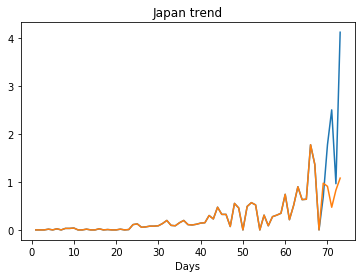

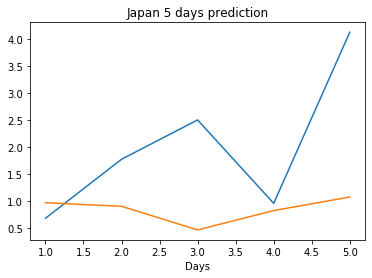

Creating directory ./offline5/Cambodia/training/
Cambodia
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0088


/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


train error: 0.1274935568393575
0.008786751888692379
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0080
train error: 0.12893078064503657
0.008025518618524075
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0078
train error: 0.09778370162839013
0.007803136017173529
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0143
train error: 0.08746337896974926
0.01434209942817688
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0466
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0246
train error: 0.07651919635915846
0.024

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0062
train error: 0.18247078726011695
0.006207081954926252
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0153
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0072
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0065
train error: 0.16465970975255143
0.00648358603939414
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0167
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0137
train error: 0.13980221499999365
0.013696051202714443
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0092
train error: 0.18229213831099597
0.009193741716444492
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0142
Saving the best model weights at 

train error: 0.23051837566449787
0.007125065661966801
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0100
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0077
train error: 0.18257190397178585
0.007708289660513401
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0089
train error: 0.1849535723696604
0.008905261754989624
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0059
train error: 0.18486534538819935
0.005873264279216528
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0081
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0048
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0043
Saving the best model weights a

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0071
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0059
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0041
train error: 0.19230173940234113
0.004126594867557287
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0404
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0294
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0167
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0164
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0035
train error: 0.21849922785027462
0.0035473040770739317
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0076
train error: 0.1837631178963365
0.007572100963443518
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0153
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0112
Saving the best mo

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0227
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0220
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0218
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0214
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0203
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0203
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0200
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0132
train error: 0.16192065297879957
0.013169340789318085
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0120
train error: 0.13312666937991074
0.011989613063633442
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0166
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0114
train er

train error: 0.17686623540904486
0.010879565961658955
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0336
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0254
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0153
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0134
train error: 0.17698462389296654
0.013440403155982494
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0293
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0217
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0149
Saving t

Saving the best model weights at Epoch [5], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0099
train error: 0.1769494250078093
0.009851505048573017
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0067
train error: 0.17709486327613844
0.006681895349174738
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0272
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0129
Saving th

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0271
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0174
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0153
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0127
train error: 0.17716769493100318
0.012693198397755623
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0429
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0269
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [5], Best Valid Loss: 

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0111
train error: 0.17831274816258388
0.011134159751236439
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0092
train error: 0.1796914121474732
0.009188001044094563
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0248
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0194
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0112
Saving

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0173
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0128
train error: 0.1769702470099384
0.012776042334735394
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0243
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0194
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [5], Best Valid Loss: 0

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0516
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0483
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0467
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0452
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0438
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0424
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0411
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0398
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0386
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0363
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0352
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0341
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0109
train error: 0.17596156514165076
0.010870133526623249
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0035
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0031
train error: 0.17471170016197543
0.0031040043104439974
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0389
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0379
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0369
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0360
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0343
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0334
Sav

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0129
train error: 0.17651207962383827
0.01294498797506094
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0620
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0582
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0544
Saving the best model weights at Epoch [4], Best Vali

Saving the best model weights at Epoch [42], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0184
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0178
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0174
train error: 0.18513930571321963
0.017447635531425476
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0295
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0285
Saving the best model weights at Epoch [5], Best Vali

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0181
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0081
train error: 0.1725537326243339
0.008080724626779556
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0234
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0227
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0221
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0216
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0210
Saving the best model weights at Epoch [6], Best Valid Loss: 0

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0272
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0264
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0249
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0241
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0229
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0223
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0218
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0213
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0208
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0203
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0195
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.0299
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0293
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0280
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0274
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0269
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0264
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0258
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0253
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0249
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0244
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0235
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0231
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0086
train error: 0.17658591651442376
0.00864134170114994
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0631
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0522
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0435
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0372
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0333
Saving the best model weights at Epoch [6], Best Valid Loss: 0

Saving the best model weights at Epoch [37], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0117
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0111
train error: 0.18360619479084783
0

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0183
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0166
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0162
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0159
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0144
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0178
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0174
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0170
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0167
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0164
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0153
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0149
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0383
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0370
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0357
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0345
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0323
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0312
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0302
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0292
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0274
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0266
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0258
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [24], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0117
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0117
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0117
train error: 0.1767032430648352
0.011680742725729942
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0255
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0217
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0170
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [9], Best Valid Los

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0609
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0585
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0565
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0544
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0523
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0505
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0487
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0471
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0455
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0440
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0426
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0412
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0399
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0386
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [44], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0127
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0124
train error: 0.1833079112270339
0.012384644709527493
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0292
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0280
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0269
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0259
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0249
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [7], Best Valid L

Saving the best model weights at Epoch [24], Best Valid Loss: 0.0173
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0166
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0157
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0153
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0145
Saving the best model weights at E

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0353
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0344
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0336
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0328
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0320
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0313
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0306
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0299
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0292
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0281
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0275
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0269
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0264
Saving the best model weights at E

Saving the best model weights at Epoch [7], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0115
train error: 0.17663053519120722
0.011522744782269001
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0308
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0301
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0293
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0279
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0273
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0266
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0254
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0249
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0243
Saving the best model weights at Epoch [12], Best Valid Loss

Saving the best model weights at Epoch [17], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0109
Saving the best model weights at E

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0117
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0103
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0100
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0095
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0093
Saving the best model weights at E

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0261
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0254
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0247
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0234
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0228
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0222
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0216
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0187
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.0198
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0184
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0162
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0159
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0157
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0151
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0418
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0406
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0394
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0383
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0373
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0362
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0352
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0343
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0325
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0317
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0309
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0302
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0295
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [24], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0121
train error: 0.17667071100775944
0.012071089819073677
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0382
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0238
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0183
Saving the best model weights at Epoch [5], Best Vali

Saving the best model weights at Epoch [50], Best Valid Loss: 0.0100
train error: 0.18215802345058005
0.009975533001124859
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0353
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0299
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0269
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0255
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0221
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0210
Saving the best model weights at Epoch [13], Best Valid Lo

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0272
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0265
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0258
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0244
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0225
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0214
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0194
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0341
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0313
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0291
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0269
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0247
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0166
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0159
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0214
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0194
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0180
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 0.0198
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0190
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0178
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0173
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0170
train error: 0.18450361642647872
0.016960954293608665
Saving the best model weights at Epoch [1], Best 

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0157
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0153
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0137
Saving the best model weights at Epoch

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0174
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0170
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0166
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0164
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0162
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0159
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0155
Saving the best model weights at E

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0594
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0555
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0521
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0493
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0467
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0445
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0424
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0407
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0392
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0378
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0367
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0357
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0348
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0339
Saving the best model weights at Epoch

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0184
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0181
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0181
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0181
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0179
train error: 0.17407242746346377
0.017888976261019707
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0574
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0478
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0407
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [5], Best Vali

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0217
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0194
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0175
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0105
Saving the best model weights at Epoch

Saving the best model weights at Epoch [9], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0131
train error: 0.17766692839337117
0.013125568628311157
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0296
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0111
train error: 0.17724755014095342
0.011090163141489029
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0187
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0143
Savi

Saving the best model weights at Epoch [9], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0103
train error: 0.17626563820875052
0.010334493592381477
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0203
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0157
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [6], Best Valid 

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0241
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0116
train error: 0.17685351650597472
0.01162373460829258
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0674
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0461
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0330
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0248
Saving the best model weights at Epoch [5], Best Valid Loss: 0

Saving the best model weights at Epoch [17], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0131
train error: 0.17660131373188712
0.013082141056656837
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [7], Best Valid 

Saving the best model weights at Epoch [31], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0134
train error: 0.1766021688835639
0.0133885582908988
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0913
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0780
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0671
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0581
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0508
Saving the best model weights at Epoch [6], Best Valid Lo

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0077
train error: 0.1772792726247148
0.007716071791946888
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0105
train error: 0.17908687771043993
0.010493854992091656
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0288
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0255
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0227
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0159
Saving th

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0159
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0126
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0126
train error: 0.1768188008079023
0.012553554959595203
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0222
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0161
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0115
train error: 0.17721256540354455
0.011539873667061329
Saving th

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0135
train error: 0.1766904480755329
0.013474973849952221
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0173
Saving the best model weights at Epoch [2], Best Va

train error: 0.17723645597244753
0.013057589530944824
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0239
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0106
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0106
train error: 0.17933255882764404
0.010575217194855213
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0249
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0194
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0173
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0157
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0125
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0118
Saving 

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0494
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0492
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0490
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0488
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0486
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0484
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0482
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0480
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0478
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0476
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0474
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0472
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0470
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0468
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0095
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0090
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0081
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0333
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0332
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0331
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0330
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0330
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0328
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0328
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0327
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0326
train error: 0.1991335259605848
0.03261571750044823
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0505
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0503
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0501
Saving the best model weights at Epoch [4], Best Valid

Saving the best model weights at Epoch [8], Best Valid Loss: 0.0406
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0404
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0401
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0398
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0396
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0393
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0391
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0386
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0383
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0381
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0378
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0376
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0374
Saving the best model weights at Epo

Saving the best model weights at Epoch [45], Best Valid Loss: 0.0464
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0463
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0462
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0461
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0460
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0459
train error: 0.21644930635353155
0.045908428728580475
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0293
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0292
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0291
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0290
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0289
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0288
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0287
Saving the best model weights at Epoch [8], Best Valid L

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0249
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0247
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0243
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0238
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0235
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0233
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0230
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0228
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.0469
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0468
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0466
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0465
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0464
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0463
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0462
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0461
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0459
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0458
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0457
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0456
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0455
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0454
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0256
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0255
train error: 0.19744569022970443
0.025518763810396194
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0223
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0221
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0217
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0214
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0212
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0210
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0209
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [11], Best Valid Lo

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0937
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0935
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0932
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0930
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0927
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0925
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0922
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0920
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0917
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0915
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0912
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0909
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0907
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0904
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0637
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0633
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0629
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0625
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0622
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0618
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0614
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0611
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0607
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0603
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0600
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0596
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0593
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0589
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0358
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0357
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0356
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0354
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0353
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0352
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0350
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0349
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0348
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0347
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0346
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [23], Best Valid Loss: 0.0397
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0395
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0394
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0392
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0390
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0389
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0387
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0386
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0384
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0382
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0381
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0379
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0378
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0376
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0112
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0107
train error: 0.1845129197533948
0.010694677010178566
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0679
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0676
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0674
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0672
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0670
Saving the best model weights at Epoch [6], Best Valid 

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0422
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0420
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0419
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0417
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0415
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0414
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0412
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0409
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0407
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0405
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0404
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0402
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0400
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.0156
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0127
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 0.0236
train error: 0.19857679193867653
0.023624926805496216
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0309
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0304
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0302
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0301
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0299
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0298
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0296
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0295
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0293
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0292
Saving the best model weights at Epoch [13], Best Valid Lo

Saving the best model weights at Epoch [17], Best Valid Loss: 0.0208
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0190
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0185
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0174
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0165
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.0674
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0672
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0669
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0667
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0665
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0662
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0660
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0657
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0655
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0653
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0650
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0648
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0646
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0643
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0530
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0517
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0504
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0492
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0481
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0469
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0458
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0446
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0437
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0427
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0417
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0407
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0398
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0389
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0282
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0282
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0281
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0280
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0279
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0277
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0276
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0275
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0274
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0273
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0272
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0271
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 0.0268
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0266
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0264
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0262
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0261
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0259
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0255
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0253
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0251
train error: 0.20247104193902377
0.025121135637164116
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0249
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0243
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [4], Best Val

Saving the best model weights at Epoch [9], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0285
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0282
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0281
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0281
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0280
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0279
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0277
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0277
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0276
Saving the best model weights at Ep

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0275
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0274
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0272
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0270
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0268
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0265
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0264
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0262
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0261
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0259
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0256
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0255
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0256
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0256
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0255
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0254
train error: 0.20448751319164524
0.02543892338871956
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0235
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0234
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0233
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0230
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0229
Saving the best model weights at Epoch [9], Best Valid Los

Saving the best model weights at Epoch [13], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0203
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0201
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0198
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0198
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0194
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0193
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.0764
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0761
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0759
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0757
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0755
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0753
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0750
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0748
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0746
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0744
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0742
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0740
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0737
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0735
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.0588
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0586
train error: 0.22723689765641183
0.058557894080877304
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0259
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0255
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0254
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0253
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0250
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0248
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0247
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [12], Best Valid Lo

Saving the best model weights at Epoch [17], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0082
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0082
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0145
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0304
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0303
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0302
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0301
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0300
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0299
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0298
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0298
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0297
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0296
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0295
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0294
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0293
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0292
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0143
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0138
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.0159
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0157
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0146
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0145
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0142
train error: 0.18409561541524122
0.014228323474526405
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0532
Saving the best model weights at Epoch [2], Best V

Saving the best model weights at Epoch [7], Best Valid Loss: 0.0379
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0377
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0375
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0373
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0372
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0370
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0366
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0364
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0362
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0361
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0357
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0355
Saving the best model weights at Epoc

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0184
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0179
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0177
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0174
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0170
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0167
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0711
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0709
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0706
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0704
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0701
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0699
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0696
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0694
train error: 0.24287295951084656
0.06936591118574142
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0791
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0787
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0783
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0779
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0775
Saving the best model weights at Epoch [6], Best Valid 

Saving the best model weights at Epoch [11], Best Valid Loss: 0.0813
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0791
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0770
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0749
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0729
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0710
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0691
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0672
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0655
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0638
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0620
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0604
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0590
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0573
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0507
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0505
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0504
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0502
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0501
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0498
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0495
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0493
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0492
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0490
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0489
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0487
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0315
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0313
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0310
train error: 0.21170409479545374
0.03101198375225067
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0525
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0513
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0485
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0475
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0463
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0451
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0441
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0429
Saving the best model weights at Epoch [10], Best Valid Los

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0345
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0344
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0344
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0343
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0342
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0341
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0340
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0339
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0338
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0337
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0336
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0335
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0333
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0131
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0346
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0345
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0344
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0343
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0342
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0341
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0340
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0339
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0338
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0336
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0335
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0333
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0332
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [19], Best Valid Loss: 0.0273
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0271
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0269
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0265
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0263
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0261
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0258
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0256
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0254
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0252
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0249
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.0538
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0529
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0521
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0512
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0504
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0496
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0488
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0480
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0473
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0465
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0458
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0451
train error: 0.23500122279493194
0.04507070779800415
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0590
Saving the best model weights at Epoch [2], Best Va

Saving the best model weights at Epoch [8], Best Valid Loss: 0.0431
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0420
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0399
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0389
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0379
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0369
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0361
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0352
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0343
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0335
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0328
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0320
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0312
Saving the best model weights at Epo

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0452
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0445
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0438
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0431
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0424
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0417
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0404
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0398
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0391
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0385
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0380
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0374
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0368
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0280
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0277
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0274
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0270
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0268
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0265
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0262
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0260
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0258
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0255
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0253
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0249
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0246
Saving the best model weights at E

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0224
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0221
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0218
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0215
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0208
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0203
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0187
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.0312
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0308
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0303
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0300
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0296
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0292
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0289
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0286
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0281
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0274
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0272
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0270
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.0089
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0088
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0087
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0086
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0084
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0083
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0083
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0132
train error: 0.17902665661478584
0.013202385976910591
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0456
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0371
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0334
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0304
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0276
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0235
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0220
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0204
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0194
Saving the best model weights at Epoch [12], Best Valid Lo

Saving the best model weights at Epoch [37], Best Valid Loss: 0.0408
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0401
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0395
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0389
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0383
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0377
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0372
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0366
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0361
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0350
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0345
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0340
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0335
train error: 0.20480472420934925
0

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0725
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0645
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0580
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0523
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0471
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0426
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0385
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0357
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0301
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0276
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0258
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0243
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0230
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [33], Best Valid Loss: 0.0490
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0482
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0475
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0468
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0461
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0454
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0447
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0441
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0434
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0428
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0422
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0416
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0404
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0263
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0247
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0207
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0183
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0157
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0117
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0116
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0115
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0112
train error: 0.1859018730394768
0.011183986440300941
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0556
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0543
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0529
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0517
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0504
Saving the best model weights at Epoch [6], Best Valid 

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0360
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0355
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0350
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0345
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0340
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0336
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0331
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0327
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0323
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0318
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0314
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0306
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0302
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.0168
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0166
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0164
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0162
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0159
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0157
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0154
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0153
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0147
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.0395
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0389
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0383
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0376
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0371
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0365
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0353
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0348
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0342
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0337
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0332
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0326
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0321
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.0390
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0384
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0378
train error: 0.19525198786604134
0.037774551659822464
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1272
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1208
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1147
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1089
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1035
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0982
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0931
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0884
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0839
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0795
Saving the best model weights at Epoch [11], Best Valid Lo

Saving the best model weights at Epoch [48], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0210
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0208
train error: 0.19019461880353364
0.020789695903658867
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0740
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0728
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0716
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0704
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0692
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0681
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0670
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0659
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0648
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0638
Saving the best model weights at Epoch [11], Best Valid Lo

Saving the best model weights at Epoch [17], Best Valid Loss: 0.0279
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0268
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0247
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0236
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0227
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0219
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0211
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0202
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0188
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0171
Saving the best model weights at E

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0199
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0194
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0191
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0186
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0184
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0182
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0180
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0178
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0176
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0174
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0170
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0159
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0157
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0155
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0153
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0152
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0150
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0148
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0146
train error: 0.17983831387634078
0.014601004309952259
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0252
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0227
Saving the best model weights at Epoch [3], Best Va

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0114
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0113
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0111
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0109
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0108
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0106
train error: 0.18875128528364285
0.010615902952849865
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0300
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0295
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0289
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0283
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [6], Best Valid

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0159
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0153
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0149
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0142
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0130
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0129
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0128
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0128
train error: 0.17644049119994495
0

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0073
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0069
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0065
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0062
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0058
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0055
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0052
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0049
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0047
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0044
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0042
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0039
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0037
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0035
Saving the best model weights at Epoch

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0265
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0262
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0259
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0254
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0252
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0249
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0247
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0242
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0238
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0236
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.0124
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0123
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0122
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0121
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0120
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0119
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0118
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0117
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0117
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0117
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0116
Saving the best model weights at E

Saving the best model weights at Epoch [9], Best Valid Loss: 0.0336
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0332
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0327
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0323
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0319
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0315
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0311
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0304
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0300
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0296
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0293
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0289
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0286
Saving the best model weights at Ep

Saving the best model weights at Epoch [27], Best Valid Loss: 0.0141
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0140
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0138
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0130
Saving the best model weights at E

Saving the best model weights at Epoch [24], Best Valid Loss: 0.0107
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0105
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0104
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0098
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0097
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0096
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0094
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0093
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0092
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0091
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0090
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0136
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0134
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0133
train error: 0.17774461063020158
0.01333853043615818
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0273
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0246
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0217
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0183
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0169
Saving the best model weights at Epoch [7], Best Valid L

Saving the best model weights at Epoch [46], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0203
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0200
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0194
train error: 0.19774865751352275
0.019426530227065086
Saving the best model weights at Epoch [1], Best Valid Loss: 0.1199
Saving the best model weights at Epoch [2], Best Valid Loss: 0.1173
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1148
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1124
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1100
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1077
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1055
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1033
Saving the best model weights at Epoch [9], Best Valid Lo

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0183
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0173
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0166
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0158
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0151
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0147
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0139
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0137
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0135
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0133
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0132
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0131
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0131
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0429
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0418
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0409
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0398
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0389
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0379
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0370
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0361
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0353
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0345
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0336
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0329
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0321
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0314
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0110
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0109
train error: 0.17637867443827968
0.010938003659248352
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0274
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0270
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0266
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0262
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0258
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0255
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0251
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0247
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0244
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [12], Best Valid Lo

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0301
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0295
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0289
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0273
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0268
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0263
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0258
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0254
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0249
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0241
Saving the best model weights at E

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0272
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0269
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0265
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0262
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0259
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0255
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0252
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0249
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0246
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0243
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0237
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0234
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0231
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 0.0102
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0101
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0100
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0100
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0100
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0099
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0098
train error: 0.18088487751612609
0.00984665472060442
Saving the best model weights at Epoch [1], Best V

Saving the best model weights at Epoch [39], Best Valid Loss: 0.1004
Saving the best model weights at Epoch [40], Best Valid Loss: 0.1004
Saving the best model weights at Epoch [41], Best Valid Loss: 0.1003
Saving the best model weights at Epoch [42], Best Valid Loss: 0.1003
Saving the best model weights at Epoch [43], Best Valid Loss: 0.1003
Saving the best model weights at Epoch [44], Best Valid Loss: 0.1003
Saving the best model weights at Epoch [45], Best Valid Loss: 0.1002
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1002
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1002
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1002
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1001
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1001
train error: 0.23932812080690355
0.10011126101016998
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0457
Saving the best model weights at Epoch [2], Best Va

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0440
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0440
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0440
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0439
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0439
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0438
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0438
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0438
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0437
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0437
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0436
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0436
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0436
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0435
Saving the best model weights at Epoch

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0228
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0228
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0228
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0228
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0228
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0228
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0228
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0228
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0228
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0228
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0228
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0228
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0227
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0227
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.0295
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0295
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0295
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0295
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0294
train error: 0.19057572913835896
0.02944740653038025
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0399
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0399
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0398
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0398
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0397
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0397
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0397
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0396
Saving the best model weights at Epoch [9], Best Valid Los

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0206
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0205
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0205
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.0500
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0500
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0499
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0498
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0498
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0498
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0497
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0496
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0171
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0353
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0352
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0352
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0352
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0352
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0352
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0351
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0350
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0350
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0350
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.0164
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0163
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0162
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0162
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0162
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0161
train error: 0.19801029514972912
0.016118895262479782
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0550
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0550
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0550
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0550
Saving the best model weights at Epoch [5], Best Vali

Saving the best model weights at Epoch [9], Best Valid Loss: 0.0748
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0747
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0747
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0747
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0746
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0746
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0745
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0745
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0744
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0744
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0744
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0743
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0743
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0742
Saving the best model weights at Ep

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0937
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0934
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0931
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0929
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0926
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0923
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0921
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0918
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0915
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0913
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0910
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0907
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0905
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0902
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 0.0590
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0589
train error: 0.2316521191687295
0.05894671753048897
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0519
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0519
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0519
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0518
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0518
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0518
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0517
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0517
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0517
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0516
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0516
Saving the best model weights at Epoch [12], Best Valid Loss

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0421
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0420
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0419
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0418
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0417
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0417
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0416
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0415
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0414
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0413
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0412
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0411
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0411
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0410
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0314
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0314
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0314
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0314
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0314
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0314
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0314
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0314
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0314
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0314
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0314
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0313
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0313
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0313
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 0.0402
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0401
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0399
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0398
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0397
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0396
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0395
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0394
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0393
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0392
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0390
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0389
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0387
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [23], Best Valid Loss: 0.0408
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0408
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0408
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0408
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0408
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0408
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0407
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0407
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0407
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0407
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0407
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0407
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0407
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0407
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.0246
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0246
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0246
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0246
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0245
train error: 0.21082433623219418
0.024479646235704422
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0349
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0348
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0347
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0346
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0346
Saving the best model weights at Epoch [6], Best Valid

Saving the best model weights at Epoch [10], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0085
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0085
Saving the best model weights at E

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0438
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0438
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0438
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0437
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0437
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0437
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0436
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0436
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0436
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0435
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0435
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0435
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0434
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0434
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.0735
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0735
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0735
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0734
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0734
train error: 0.2409469768630736
0.07341167330741882
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0399
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0399
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0398
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0398
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0398
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0398
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0398
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0398
Saving the best model weights at Epoch [9], Best Valid Loss

Saving the best model weights at Epoch [13], Best Valid Loss: 0.0508
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0507
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0507
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0506
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0506
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0506
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0505
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0505
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0505
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0504
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0504
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0504
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0503
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0503
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.0520
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0520
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0520
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0520
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0520
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0520
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0520
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0519
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0519
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0519
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0519
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0519
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0519
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0519
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 0.0313
train error: 0.19901900789982668
0.03132143244147301
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0422
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0422
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0422
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0421
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0421
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0420
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0420
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0420
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0419
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0419
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0419
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0419
Saving the best model weights at Epoch [13], Best Valid Los

Saving the best model weights at Epoch [18], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0231
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0231
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0409
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0409
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0409
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0409
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0409
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0408
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0408
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0408
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0408
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0408
train error: 0.21278307373127478
0.040766824036836624
Saving the best model weights at Epoch [1], Best 

Saving the best model weights at Epoch [5], Best Valid Loss: 0.1267
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1266
Saving the best model weights at Epoch [7], Best Valid Loss: 0.1266
Saving the best model weights at Epoch [8], Best Valid Loss: 0.1265
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1265
Saving the best model weights at Epoch [10], Best Valid Loss: 0.1265
Saving the best model weights at Epoch [11], Best Valid Loss: 0.1264
Saving the best model weights at Epoch [12], Best Valid Loss: 0.1264
Saving the best model weights at Epoch [13], Best Valid Loss: 0.1263
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1263
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1263
Saving the best model weights at Epoch [16], Best Valid Loss: 0.1262
Saving the best model weights at Epoch [17], Best Valid Loss: 0.1262
Saving the best model weights at Epoch [18], Best Valid Loss: 0.1261
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [24], Best Valid Loss: 0.0601
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0600
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0600
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0600
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0600
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0599
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0599
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0599
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0598
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0598
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0598
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0598
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0597
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0597
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.0414
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0413
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0412
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0409
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0408
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0406
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0405
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0404
train error: 0.241926382662672
0.040364693850278854
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0284
Saving the best model weights at Epoch [5], Best Valid 

Saving the best model weights at Epoch [9], Best Valid Loss: 0.0292
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0292
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0292
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0292
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0292
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0292
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0291
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0291
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0291
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0291
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0291
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0291
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0291
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0291
Saving the best model weights at Ep

Saving the best model weights at Epoch [27], Best Valid Loss: 0.0645
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0644
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0642
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0640
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0639
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0637
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0635
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0633
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0632
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0630
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0628
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0627
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0625
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0623
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 0.0324
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0324
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0324
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0324
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0324
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0323
train error: 0.20812890630314182
0.032342132180929184
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0144
Saving the best model weights at Epoch [8], Best Valid L

Saving the best model weights at Epoch [13], Best Valid Loss: 0.0390
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0390
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0389
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0387
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0386
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0385
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0384
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0383
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0382
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0381
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0380
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0379
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0378
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.0246
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0246
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0246
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0246
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0246
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0246
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0246
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0245
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 0.0327
train error: 0.2053428145238396
0.03268633410334587
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0198
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0198
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0197
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0195
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0194
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0194
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0193
Saving the best model weights at Epoch [13], Best Valid Loss

Saving the best model weights at Epoch [18], Best Valid Loss: 0.0727
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0727
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0727
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0727
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0726
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0726
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0726
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0726
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0725
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0725
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0725
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0725
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0724
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0724
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 0.0383
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0383
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0383
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0383
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0382
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0382
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0382
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0382
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0382
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0381
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0381
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0381
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0381
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0381
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 0.0345
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0345
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0345
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0345
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0344
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0344
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0344
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0344
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0344
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0344
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0344
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0344
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0344
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0343
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0315
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0315
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0315
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0315
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0314
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0314
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0314
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0314
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0313
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0313
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0313
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0532
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0532
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0532
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0532
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0532
train error: 0.22148724186064844
0.0531943216919899
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0382
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0381
Saving the best model weights at Epoch [3], Best Vali

Saving the best model weights at Epoch [8], Best Valid Loss: 0.0536
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0536
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0535
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0535
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0535
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0534
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0534
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0534
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0532
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0532
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0532
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0531
Saving the best model weights at Epo

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0362
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0362
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0362
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0362
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0362
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0362
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0362
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0362
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0362
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0362
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0361
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0361
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0361
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0361
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.0306
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0306
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0306
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0306
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0306
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0306
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0305
train error: 0.2123622391655138
0.030546819791197777
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0178
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0178
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0178
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0178
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0178
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0178
Saving the best model weights at Epoch [7], Best Valid L

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0490
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0490
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0490
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0490
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0490
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0490
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0490
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0490
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0490
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0490
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0490
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0490
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0490
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0490
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.0900
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0900
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0900
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0900
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0900
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0900
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0900
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0900
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0900
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0900
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0900
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0900
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0900
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0900
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.0750
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0750
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0750
train error: 0.2641539925878698
0.07498794794082642
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0302
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0302
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0302
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0302
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0302
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0302
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0302
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0302
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0302
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0302
Saving the best model weights at Epoch [11], Best Valid Loss

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0503
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0503
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0503
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0503
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0502
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0502
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0502
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0502
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0502
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0502
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0502
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0502
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0502
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0502
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.0582
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0582
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0582
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0582
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0582
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0582
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0582
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0581
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0581
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0581
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0581
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0581
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0581
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0580
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [19], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0244
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0244
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0244
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0244
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0244
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0244
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0244
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0278
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0278
train error: 0.20059450364241263
0.027784070000052452
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0196
Saving the best model weights at Epoch [2], Best V

Saving the best model weights at Epoch [7], Best Valid Loss: 0.0282
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0282
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0282
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0282
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0282
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0282
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0282
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0282
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0282
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0282
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0282
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0281
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0281
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0281
Saving the best model weights at Epoc

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0993
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0993
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0993
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0993
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0993
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0993
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0993
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0993
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0993
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0993
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0993
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0993
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0993
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0993
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 0.1248
Saving the best model weights at Epoch [46], Best Valid Loss: 0.1248
Saving the best model weights at Epoch [47], Best Valid Loss: 0.1248
Saving the best model weights at Epoch [48], Best Valid Loss: 0.1248
Saving the best model weights at Epoch [49], Best Valid Loss: 0.1248
Saving the best model weights at Epoch [50], Best Valid Loss: 0.1247
train error: 0.3150827277338866
0.12474989145994186
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0735
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0735
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0735
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0735
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0734
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0734
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0734
Saving the best model weights at Epoch [8], Best Valid Los

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0232
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0232
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 0.0297
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0297
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0297
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0297
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0297
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0297
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0297
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0297
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0297
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0297
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0297
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0297
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0297
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0297
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0310
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [22], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0410
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0410
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0307
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0307
train error: 0.20985417294485326
0.030692577362060547
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0454
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0454
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0454
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0454
Saving the best model weights at Epoch [5], Best Vali

Saving the best model weights at Epoch [9], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0189
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0189
Saving the best model weights at Ep

Saving the best model weights at Epoch [28], Best Valid Loss: 0.0890
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0890
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0890
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0890
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0890
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0890
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0890
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0890
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0890
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0890
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0890
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0890
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0890
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0890
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 0.0722
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0722
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0722
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0722
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0722
train error: 0.23155388794839382
0.07222502678632736
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0328
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0328
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0328
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0328
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0328
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0328
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0328
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0328
Saving the best model weights at Epoch [9], Best Valid Los

Saving the best model weights at Epoch [14], Best Valid Loss: 0.0331
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0331
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0331
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0331
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0331
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0331
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0331
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0330
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0330
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0330
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0330
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0330
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0330
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0330
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 0.0327
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0327
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0327
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0327
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0327
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0327
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0327
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0327
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0327
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0327
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0327
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0327
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0327
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0327
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0305
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [20], Best Valid Loss: 0.0166
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0166
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0166
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0166
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0166
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0166
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0166
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0166
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0166
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0166
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0165
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0165
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 0.0350
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0350
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0350
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0350
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0350
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0350
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0350
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0350
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0350
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0349
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0349
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0349
train error: 0.21664018109864133
0.03492613881826401
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0434
Saving the best model weights at Epoch [2], Best Va

Saving the best model weights at Epoch [6], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0316
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0316
Saving the best model weights at Epoch

Saving the best model weights at Epoch [25], Best Valid Loss: 0.0457
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0457
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0457
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0457
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0457
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0457
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0457
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0457
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0456
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0456
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0456
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0456
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0456
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0456
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.0277
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0277
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0277
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0277
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0277
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0277
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0277
train error: 0.22315199297824592
0.027675611898303032
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [7], Best Valid 

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0387
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0387
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0387
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0387
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0387
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0387
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0387
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.0394
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0394
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0394
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0394
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0394
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0394
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0394
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0394
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0394
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0394
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0394
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0394
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0394
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0394
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.0269
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0269
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0269
train error: 0.20740467618981545
0.026862625032663345
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0240
Saving the best model weights at Epoch [11], Best Valid Lo

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0600
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0600
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0600
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0600
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0599
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0599
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0599
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0599
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0599
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0599
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0599
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0599
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0599
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0599
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0192
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0192
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0245
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [21], Best Valid Loss: 0.0312
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0311
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0311
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0311
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0311
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0311
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0311
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0311
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0311
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0311
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0311
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0311
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0311
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0311
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0359
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0359
train error: 0.2550779117666411
0.035854827612638474
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0840
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0840
Saving the best model weights at Epoch [3], Best Val

Saving the best model weights at Epoch [8], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0515
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0514
Saving the best model weights at Epo

Saving the best model weights at Epoch [26], Best Valid Loss: 0.0467
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0467
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0467
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0467
Saving the best model weights at Epoch [30], Best Valid Loss: 0.0467
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0467
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0467
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0467
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0467
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0467
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0467
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0467
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0467
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0467
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [48], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0267
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0267
train error: 0.21435857324324775
0.0266895592212677
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0603
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0603
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0603
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0603
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0603
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0603
Saving the best model weights at Epoch [7], Best Valid Lo

Saving the best model weights at Epoch [12], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [13], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0172
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0172
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 0.0255
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0255
Saving the best model weights at Epoch [32], Best Valid Loss: 0.0255
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0255
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0254
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0254
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0254
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0254
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0254
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0254
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0254
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0254
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0254
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0254
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [49], Best Valid Loss: 0.0160
Saving the best model weights at Epoch [50], Best Valid Loss: 0.0160
train error: 0.20177151711488311
0.016021007671952248
Saving the best model weights at Epoch [1], Best Valid Loss: 0.0401
Saving the best model weights at Epoch [2], Best Valid Loss: 0.0401
Saving the best model weights at Epoch [3], Best Valid Loss: 0.0401
Saving the best model weights at Epoch [4], Best Valid Loss: 0.0401
Saving the best model weights at Epoch [5], Best Valid Loss: 0.0401
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0401
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0401
Saving the best model weights at Epoch [8], Best Valid Loss: 0.0401
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0401
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0401
Saving the best model weights at Epoch [11], Best Valid Lo

Saving the best model weights at Epoch [16], Best Valid Loss: 0.0438
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0438
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0438
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0438
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0438
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0438
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0438
Saving the best model weights at Epoch [23], Best Valid Loss: 0.0438
Saving the best model weights at Epoch [24], Best Valid Loss: 0.0438
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0438
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0438
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0438
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0438
Saving the best model weights at Epoch [29], Best Valid Loss: 0.0438
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 0.0258
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0258
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0258
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0258
Saving the best model weights at Epoch [38], Best Valid Loss: 0.0258
Saving the best model weights at Epoch [39], Best Valid Loss: 0.0258
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0258
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0258
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [43], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [44], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [45], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [46], Best Valid Loss: 0.0257
Saving the best model weights at Epoch [47], Best Valid Loss: 0.0257
Saving the best model weights at E

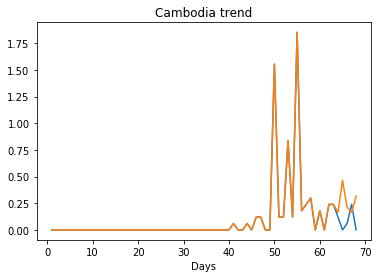

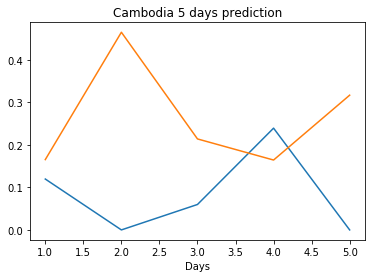

Creating directory ./offline5/Malaysia/training/
Malaysia
Saving the best model weights at Epoch [1], Best Valid Loss: 3.3764
Saving the best model weights at Epoch [2], Best Valid Loss: 2.4134


/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Saving the best model weights at Epoch [3], Best Valid Loss: 2.1996
Saving the best model weights at Epoch [4], Best Valid Loss: 1.7616
Saving the best model weights at Epoch [6], Best Valid Loss: 1.6051
Saving the best model weights at Epoch [8], Best Valid Loss: 1.5820
Saving the best model weights at Epoch [21], Best Valid Loss: 1.4283
train error: 0.24649827254137824
1.428338885307312
Saving the best model weights at Epoch [1], Best Valid Loss: 2.7253
Saving the best model weights at Epoch [2], Best Valid Loss: 2.4606
Saving the best model weights at Epoch [5], Best Valid Loss: 1.8064
Saving the best model weights at Epoch [6], Best Valid Loss: 1.6096
train error: 0.14770770698253596
1.6095679998397827
Saving the best model weights at Epoch [1], Best Valid Loss: 3.1351
Saving the best model weights at Epoch [2], Best Valid Loss: 2.2347
Saving the best model weights at Epoch [3], Best Valid Loss: 2.0902
Saving the best model weights at Epoch [6], Best Valid Loss: 1.4833
Saving the b

Saving the best model weights at Epoch [5], Best Valid Loss: 2.0063
Saving the best model weights at Epoch [6], Best Valid Loss: 1.4605
Saving the best model weights at Epoch [21], Best Valid Loss: 1.2633
train error: 0.5822311020655824
1.2632688283920288
Saving the best model weights at Epoch [1], Best Valid Loss: 6.4933
Saving the best model weights at Epoch [2], Best Valid Loss: 2.1274
Saving the best model weights at Epoch [4], Best Valid Loss: 1.9176
Saving the best model weights at Epoch [8], Best Valid Loss: 1.3774
Saving the best model weights at Epoch [12], Best Valid Loss: 1.3192
Saving the best model weights at Epoch [13], Best Valid Loss: 1.2778
Saving the best model weights at Epoch [20], Best Valid Loss: 0.9069
train error: 0.7950992817857436
0.9068719744682312
Saving the best model weights at Epoch [1], Best Valid Loss: 4.5693
Saving the best model weights at Epoch [3], Best Valid Loss: 2.5915
Saving the best model weights at Epoch [5], Best Valid Loss: 1.9996
Saving the

Saving the best model weights at Epoch [2], Best Valid Loss: 11.6196
Saving the best model weights at Epoch [4], Best Valid Loss: 11.0517
Saving the best model weights at Epoch [5], Best Valid Loss: 9.6148
Saving the best model weights at Epoch [6], Best Valid Loss: 4.2953
Saving the best model weights at Epoch [7], Best Valid Loss: 1.9526
Saving the best model weights at Epoch [8], Best Valid Loss: 1.6675
Saving the best model weights at Epoch [18], Best Valid Loss: 1.6377
Saving the best model weights at Epoch [21], Best Valid Loss: 1.5803
Saving the best model weights at Epoch [23], Best Valid Loss: 1.4025
Saving the best model weights at Epoch [34], Best Valid Loss: 1.2742
Saving the best model weights at Epoch [37], Best Valid Loss: 1.2609
train error: 0.7158064180985093
1.260912537574768
Saving the best model weights at Epoch [1], Best Valid Loss: 11.3210
Saving the best model weights at Epoch [2], Best Valid Loss: 9.5850
Saving the best model weights at Epoch [3], Best Valid Los

Saving the best model weights at Epoch [2], Best Valid Loss: 13.5542
Saving the best model weights at Epoch [3], Best Valid Loss: 10.8878
Saving the best model weights at Epoch [5], Best Valid Loss: 5.3417
Saving the best model weights at Epoch [6], Best Valid Loss: 1.5153
Saving the best model weights at Epoch [19], Best Valid Loss: 1.2988
Saving the best model weights at Epoch [38], Best Valid Loss: 1.2849
train error: 0.713637095742992
1.2849313020706177
Saving the best model weights at Epoch [1], Best Valid Loss: 13.0781
Saving the best model weights at Epoch [3], Best Valid Loss: 11.0915
Saving the best model weights at Epoch [4], Best Valid Loss: 1.1276
Saving the best model weights at Epoch [5], Best Valid Loss: 1.0820
train error: 0.7622412034842585
1.0820343494415283
Saving the best model weights at Epoch [1], Best Valid Loss: 13.5392
Saving the best model weights at Epoch [2], Best Valid Loss: 11.3807
Saving the best model weights at Epoch [4], Best Valid Loss: 5.6403
Saving 

Saving the best model weights at Epoch [39], Best Valid Loss: 2.5121
Saving the best model weights at Epoch [41], Best Valid Loss: 2.4958
Saving the best model weights at Epoch [45], Best Valid Loss: 1.9907
Saving the best model weights at Epoch [49], Best Valid Loss: 1.8427
train error: 1.2466541536684548
1.8427413702011108
Saving the best model weights at Epoch [1], Best Valid Loss: 13.8478
Saving the best model weights at Epoch [6], Best Valid Loss: 8.7759
Saving the best model weights at Epoch [10], Best Valid Loss: 8.5165
Saving the best model weights at Epoch [14], Best Valid Loss: 8.4449
Saving the best model weights at Epoch [23], Best Valid Loss: 7.0427
Saving the best model weights at Epoch [26], Best Valid Loss: 5.6423
Saving the best model weights at Epoch [33], Best Valid Loss: 5.0244
Saving the best model weights at Epoch [44], Best Valid Loss: 2.8688
train error: 7.871317331067154
2.868779420852661
Saving the best model weights at Epoch [1], Best Valid Loss: 14.7202
Savi

Saving the best model weights at Epoch [1], Best Valid Loss: 9.8621
Saving the best model weights at Epoch [9], Best Valid Loss: 8.2683
Saving the best model weights at Epoch [16], Best Valid Loss: 7.0363
train error: 5.577201216561454
7.036345958709717
Saving the best model weights at Epoch [1], Best Valid Loss: 19.8205
Saving the best model weights at Epoch [2], Best Valid Loss: 17.6278
Saving the best model weights at Epoch [3], Best Valid Loss: 13.8782
Saving the best model weights at Epoch [5], Best Valid Loss: 11.1105
Saving the best model weights at Epoch [6], Best Valid Loss: 9.0595
Saving the best model weights at Epoch [16], Best Valid Loss: 4.9238
Saving the best model weights at Epoch [30], Best Valid Loss: 3.8328
Saving the best model weights at Epoch [40], Best Valid Loss: 2.4644
train error: 6.395525659833636
2.4643638134002686
Saving the best model weights at Epoch [1], Best Valid Loss: 14.1352
Saving the best model weights at Epoch [3], Best Valid Loss: 12.8650
Saving 

Saving the best model weights at Epoch [30], Best Valid Loss: 1.7705
Saving the best model weights at Epoch [31], Best Valid Loss: 1.7626
Saving the best model weights at Epoch [37], Best Valid Loss: 1.7607
Saving the best model weights at Epoch [40], Best Valid Loss: 1.7559
Saving the best model weights at Epoch [42], Best Valid Loss: 1.7542
train error: 0.8376921735970038
1.7541826963424683
Saving the best model weights at Epoch [1], Best Valid Loss: 22.3023
Saving the best model weights at Epoch [2], Best Valid Loss: 15.7874
Saving the best model weights at Epoch [3], Best Valid Loss: 10.6677
Saving the best model weights at Epoch [4], Best Valid Loss: 7.1616
Saving the best model weights at Epoch [5], Best Valid Loss: 5.2651
Saving the best model weights at Epoch [6], Best Valid Loss: 4.0125
Saving the best model weights at Epoch [7], Best Valid Loss: 3.3120
Saving the best model weights at Epoch [8], Best Valid Loss: 2.7585
Saving the best model weights at Epoch [9], Best Valid Lo

Saving the best model weights at Epoch [11], Best Valid Loss: 1.8174
train error: 0.903341412118503
1.8173792362213135
Saving the best model weights at Epoch [1], Best Valid Loss: 14.1807
Saving the best model weights at Epoch [2], Best Valid Loss: 3.7523
Saving the best model weights at Epoch [3], Best Valid Loss: 1.8700
Saving the best model weights at Epoch [4], Best Valid Loss: 1.8085
Saving the best model weights at Epoch [5], Best Valid Loss: 1.7867
Saving the best model weights at Epoch [6], Best Valid Loss: 1.7446
Saving the best model weights at Epoch [26], Best Valid Loss: 1.7046
train error: 0.7351609095132776
1.7046037912368774
Saving the best model weights at Epoch [1], Best Valid Loss: 8.2145
Saving the best model weights at Epoch [2], Best Valid Loss: 1.8882
Saving the best model weights at Epoch [3], Best Valid Loss: 1.8151
Saving the best model weights at Epoch [4], Best Valid Loss: 1.7904
Saving the best model weights at Epoch [5], Best Valid Loss: 1.6235
train error:

Saving the best model weights at Epoch [24], Best Valid Loss: 2.7265
Saving the best model weights at Epoch [25], Best Valid Loss: 2.4084
Saving the best model weights at Epoch [26], Best Valid Loss: 2.2146
Saving the best model weights at Epoch [27], Best Valid Loss: 2.0973
Saving the best model weights at Epoch [28], Best Valid Loss: 2.0421
Saving the best model weights at Epoch [29], Best Valid Loss: 1.9692
Saving the best model weights at Epoch [30], Best Valid Loss: 1.9669
Saving the best model weights at Epoch [31], Best Valid Loss: 1.9354
train error: 0.8678968408544149
1.9353739023208618
Saving the best model weights at Epoch [1], Best Valid Loss: 22.5757
Saving the best model weights at Epoch [2], Best Valid Loss: 19.0412
Saving the best model weights at Epoch [3], Best Valid Loss: 16.7241
Saving the best model weights at Epoch [4], Best Valid Loss: 15.0810
Saving the best model weights at Epoch [5], Best Valid Loss: 13.4681
Saving the best model weights at Epoch [6], Best Val

Saving the best model weights at Epoch [15], Best Valid Loss: 2.8127
Saving the best model weights at Epoch [16], Best Valid Loss: 2.3260
Saving the best model weights at Epoch [17], Best Valid Loss: 2.0322
Saving the best model weights at Epoch [18], Best Valid Loss: 1.8945
Saving the best model weights at Epoch [19], Best Valid Loss: 1.8285
Saving the best model weights at Epoch [20], Best Valid Loss: 1.8222
Saving the best model weights at Epoch [21], Best Valid Loss: 1.8164
Saving the best model weights at Epoch [22], Best Valid Loss: 1.7983
train error: 0.8584735890850425
1.7982615232467651
Saving the best model weights at Epoch [1], Best Valid Loss: 23.0487
Saving the best model weights at Epoch [2], Best Valid Loss: 19.5921
Saving the best model weights at Epoch [3], Best Valid Loss: 17.0604
Saving the best model weights at Epoch [4], Best Valid Loss: 14.7331
Saving the best model weights at Epoch [5], Best Valid Loss: 12.9228
Saving the best model weights at Epoch [6], Best Val

Saving the best model weights at Epoch [41], Best Valid Loss: 1.2720
train error: 0.596433501797063
1.2719815969467163
Saving the best model weights at Epoch [1], Best Valid Loss: 24.4652
Saving the best model weights at Epoch [2], Best Valid Loss: 21.9724
Saving the best model weights at Epoch [3], Best Valid Loss: 19.7917
Saving the best model weights at Epoch [4], Best Valid Loss: 17.8207
Saving the best model weights at Epoch [5], Best Valid Loss: 15.9510
Saving the best model weights at Epoch [6], Best Valid Loss: 14.1152
Saving the best model weights at Epoch [7], Best Valid Loss: 12.1639
Saving the best model weights at Epoch [8], Best Valid Loss: 10.2073
Saving the best model weights at Epoch [9], Best Valid Loss: 8.2532
Saving the best model weights at Epoch [10], Best Valid Loss: 6.3834
Saving the best model weights at Epoch [11], Best Valid Loss: 4.7600
Saving the best model weights at Epoch [12], Best Valid Loss: 3.4910
Saving the best model weights at Epoch [13], Best Vali

Saving the best model weights at Epoch [16], Best Valid Loss: 12.3495
Saving the best model weights at Epoch [17], Best Valid Loss: 12.2941
Saving the best model weights at Epoch [18], Best Valid Loss: 12.2222
Saving the best model weights at Epoch [19], Best Valid Loss: 12.1381
Saving the best model weights at Epoch [20], Best Valid Loss: 12.0871
Saving the best model weights at Epoch [24], Best Valid Loss: 12.0813
Saving the best model weights at Epoch [25], Best Valid Loss: 12.0271
Saving the best model weights at Epoch [40], Best Valid Loss: 11.9775
Saving the best model weights at Epoch [41], Best Valid Loss: 11.8878
Saving the best model weights at Epoch [42], Best Valid Loss: 11.8268
Saving the best model weights at Epoch [43], Best Valid Loss: 11.8140
Saving the best model weights at Epoch [47], Best Valid Loss: 11.7930
Saving the best model weights at Epoch [49], Best Valid Loss: 11.6460
Saving the best model weights at Epoch [50], Best Valid Loss: 11.5887
train error: 4.73788

Saving the best model weights at Epoch [39], Best Valid Loss: 11.3316
Saving the best model weights at Epoch [40], Best Valid Loss: 11.3136
Saving the best model weights at Epoch [41], Best Valid Loss: 11.1864
Saving the best model weights at Epoch [42], Best Valid Loss: 11.0343
Saving the best model weights at Epoch [43], Best Valid Loss: 10.8629
Saving the best model weights at Epoch [44], Best Valid Loss: 10.6413
Saving the best model weights at Epoch [45], Best Valid Loss: 10.4064
Saving the best model weights at Epoch [46], Best Valid Loss: 10.0158
Saving the best model weights at Epoch [47], Best Valid Loss: 9.5938
Saving the best model weights at Epoch [48], Best Valid Loss: 9.0489
Saving the best model weights at Epoch [49], Best Valid Loss: 8.3452
Saving the best model weights at Epoch [50], Best Valid Loss: 7.5583
train error: 3.440127216066633
7.558268070220947
Saving the best model weights at Epoch [1], Best Valid Loss: 23.8917
Saving the best model weights at Epoch [2], Be

Saving the best model weights at Epoch [32], Best Valid Loss: 1.4494
Saving the best model weights at Epoch [50], Best Valid Loss: 1.4325
train error: 0.6746656073257327
1.432504653930664
Saving the best model weights at Epoch [1], Best Valid Loss: 24.3600
Saving the best model weights at Epoch [2], Best Valid Loss: 22.0322
Saving the best model weights at Epoch [3], Best Valid Loss: 20.1664
Saving the best model weights at Epoch [4], Best Valid Loss: 18.5842
Saving the best model weights at Epoch [5], Best Valid Loss: 17.3210
Saving the best model weights at Epoch [6], Best Valid Loss: 16.2559
Saving the best model weights at Epoch [7], Best Valid Loss: 15.4125
Saving the best model weights at Epoch [8], Best Valid Loss: 14.7111
Saving the best model weights at Epoch [9], Best Valid Loss: 14.1495
Saving the best model weights at Epoch [10], Best Valid Loss: 13.6951
Saving the best model weights at Epoch [11], Best Valid Loss: 13.3304
Saving the best model weights at Epoch [12], Best V

Saving the best model weights at Epoch [22], Best Valid Loss: 8.0137
Saving the best model weights at Epoch [23], Best Valid Loss: 6.1655
Saving the best model weights at Epoch [24], Best Valid Loss: 4.4628
Saving the best model weights at Epoch [25], Best Valid Loss: 3.2007
Saving the best model weights at Epoch [26], Best Valid Loss: 2.3971
Saving the best model weights at Epoch [27], Best Valid Loss: 2.1222
Saving the best model weights at Epoch [28], Best Valid Loss: 1.9696
Saving the best model weights at Epoch [29], Best Valid Loss: 1.9207
Saving the best model weights at Epoch [30], Best Valid Loss: 1.8631
train error: 0.8906082008300084
1.863133430480957
Saving the best model weights at Epoch [1], Best Valid Loss: 20.5737
Saving the best model weights at Epoch [2], Best Valid Loss: 16.9182
Saving the best model weights at Epoch [3], Best Valid Loss: 14.8287
Saving the best model weights at Epoch [4], Best Valid Loss: 12.9315
Saving the best model weights at Epoch [5], Best Vali

Saving the best model weights at Epoch [29], Best Valid Loss: 8.0421
Saving the best model weights at Epoch [30], Best Valid Loss: 7.0412
Saving the best model weights at Epoch [31], Best Valid Loss: 5.8832
Saving the best model weights at Epoch [32], Best Valid Loss: 4.5519
Saving the best model weights at Epoch [33], Best Valid Loss: 3.4054
Saving the best model weights at Epoch [34], Best Valid Loss: 2.5775
Saving the best model weights at Epoch [35], Best Valid Loss: 2.0866
Saving the best model weights at Epoch [36], Best Valid Loss: 1.9137
Saving the best model weights at Epoch [37], Best Valid Loss: 1.8367
Saving the best model weights at Epoch [38], Best Valid Loss: 1.7837
Saving the best model weights at Epoch [39], Best Valid Loss: 1.7514
train error: 1.0084767621010542
1.7514069080352783
Saving the best model weights at Epoch [1], Best Valid Loss: 22.8923
Saving the best model weights at Epoch [2], Best Valid Loss: 19.4021
Saving the best model weights at Epoch [3], Best Val

Saving the best model weights at Epoch [16], Best Valid Loss: 12.3354
Saving the best model weights at Epoch [17], Best Valid Loss: 12.2787
Saving the best model weights at Epoch [18], Best Valid Loss: 12.2217
Saving the best model weights at Epoch [19], Best Valid Loss: 12.2159
Saving the best model weights at Epoch [20], Best Valid Loss: 12.1318
Saving the best model weights at Epoch [21], Best Valid Loss: 12.1271
Saving the best model weights at Epoch [22], Best Valid Loss: 12.1052
Saving the best model weights at Epoch [24], Best Valid Loss: 12.0964
Saving the best model weights at Epoch [26], Best Valid Loss: 12.0757
Saving the best model weights at Epoch [27], Best Valid Loss: 12.0515
Saving the best model weights at Epoch [32], Best Valid Loss: 12.0040
Saving the best model weights at Epoch [38], Best Valid Loss: 11.9885
train error: 4.865390815053668
11.988517761230469
Saving the best model weights at Epoch [1], Best Valid Loss: 23.4663
Saving the best model weights at Epoch [2

Saving the best model weights at Epoch [9], Best Valid Loss: 12.0213
Saving the best model weights at Epoch [15], Best Valid Loss: 11.8045
Saving the best model weights at Epoch [16], Best Valid Loss: 11.7382
Saving the best model weights at Epoch [50], Best Valid Loss: 11.7115
train error: 4.8476673603057865
11.711470603942871
Saving the best model weights at Epoch [1], Best Valid Loss: 15.0383
Saving the best model weights at Epoch [2], Best Valid Loss: 12.0612
Saving the best model weights at Epoch [3], Best Valid Loss: 11.7718
Saving the best model weights at Epoch [7], Best Valid Loss: 11.2528
Saving the best model weights at Epoch [8], Best Valid Loss: 11.1253
Saving the best model weights at Epoch [32], Best Valid Loss: 8.0218
Saving the best model weights at Epoch [33], Best Valid Loss: 2.3369
Saving the best model weights at Epoch [34], Best Valid Loss: 1.9767
Saving the best model weights at Epoch [35], Best Valid Loss: 1.8807
Saving the best model weights at Epoch [47], Best

Saving the best model weights at Epoch [16], Best Valid Loss: 12.5496
Saving the best model weights at Epoch [17], Best Valid Loss: 12.4989
Saving the best model weights at Epoch [18], Best Valid Loss: 12.4061
Saving the best model weights at Epoch [19], Best Valid Loss: 12.3353
Saving the best model weights at Epoch [20], Best Valid Loss: 12.3089
Saving the best model weights at Epoch [22], Best Valid Loss: 12.2321
Saving the best model weights at Epoch [23], Best Valid Loss: 12.1980
Saving the best model weights at Epoch [25], Best Valid Loss: 12.1852
Saving the best model weights at Epoch [26], Best Valid Loss: 12.1181
Saving the best model weights at Epoch [27], Best Valid Loss: 12.0770
Saving the best model weights at Epoch [37], Best Valid Loss: 12.0737
Saving the best model weights at Epoch [38], Best Valid Loss: 12.0479
Saving the best model weights at Epoch [39], Best Valid Loss: 12.0469
Saving the best model weights at Epoch [40], Best Valid Loss: 12.0198
Saving the best mode

Saving the best model weights at Epoch [8], Best Valid Loss: 13.9208
Saving the best model weights at Epoch [9], Best Valid Loss: 13.5444
Saving the best model weights at Epoch [10], Best Valid Loss: 13.2462
Saving the best model weights at Epoch [11], Best Valid Loss: 12.9479
Saving the best model weights at Epoch [12], Best Valid Loss: 12.7737
Saving the best model weights at Epoch [13], Best Valid Loss: 12.5946
Saving the best model weights at Epoch [14], Best Valid Loss: 12.4585
Saving the best model weights at Epoch [15], Best Valid Loss: 12.4198
Saving the best model weights at Epoch [16], Best Valid Loss: 12.2705
Saving the best model weights at Epoch [18], Best Valid Loss: 12.2154
Saving the best model weights at Epoch [19], Best Valid Loss: 12.1461
Saving the best model weights at Epoch [21], Best Valid Loss: 12.0888
Saving the best model weights at Epoch [22], Best Valid Loss: 12.0708
Saving the best model weights at Epoch [23], Best Valid Loss: 12.0266
Saving the best model 

Saving the best model weights at Epoch [14], Best Valid Loss: 12.1753
Saving the best model weights at Epoch [15], Best Valid Loss: 12.0919
Saving the best model weights at Epoch [16], Best Valid Loss: 12.0654
Saving the best model weights at Epoch [19], Best Valid Loss: 11.8867
train error: 4.888099476269313
11.886719703674316
Saving the best model weights at Epoch [1], Best Valid Loss: 21.2761
Saving the best model weights at Epoch [2], Best Valid Loss: 16.6945
Saving the best model weights at Epoch [3], Best Valid Loss: 14.6463
Saving the best model weights at Epoch [4], Best Valid Loss: 13.4570
Saving the best model weights at Epoch [5], Best Valid Loss: 12.8841
Saving the best model weights at Epoch [6], Best Valid Loss: 12.7071
Saving the best model weights at Epoch [7], Best Valid Loss: 12.2302
Saving the best model weights at Epoch [8], Best Valid Loss: 12.2248
Saving the best model weights at Epoch [9], Best Valid Loss: 12.0115
Saving the best model weights at Epoch [12], Best

Saving the best model weights at Epoch [14], Best Valid Loss: 12.9974
Saving the best model weights at Epoch [15], Best Valid Loss: 12.8514
Saving the best model weights at Epoch [16], Best Valid Loss: 12.7462
Saving the best model weights at Epoch [17], Best Valid Loss: 12.6343
Saving the best model weights at Epoch [18], Best Valid Loss: 12.5825
Saving the best model weights at Epoch [19], Best Valid Loss: 12.5203
Saving the best model weights at Epoch [20], Best Valid Loss: 12.4327
Saving the best model weights at Epoch [21], Best Valid Loss: 12.3907
Saving the best model weights at Epoch [22], Best Valid Loss: 12.2879
Saving the best model weights at Epoch [23], Best Valid Loss: 12.2326
Saving the best model weights at Epoch [24], Best Valid Loss: 12.2260
Saving the best model weights at Epoch [26], Best Valid Loss: 12.2228
Saving the best model weights at Epoch [27], Best Valid Loss: 12.1672
Saving the best model weights at Epoch [28], Best Valid Loss: 12.1368
Saving the best mode

Saving the best model weights at Epoch [42], Best Valid Loss: 10.8373
Saving the best model weights at Epoch [43], Best Valid Loss: 10.5702
Saving the best model weights at Epoch [44], Best Valid Loss: 10.3108
Saving the best model weights at Epoch [45], Best Valid Loss: 10.0541
Saving the best model weights at Epoch [46], Best Valid Loss: 9.8069
Saving the best model weights at Epoch [47], Best Valid Loss: 9.5630
Saving the best model weights at Epoch [48], Best Valid Loss: 9.3272
Saving the best model weights at Epoch [49], Best Valid Loss: 9.1001
Saving the best model weights at Epoch [50], Best Valid Loss: 8.8776
train error: 3.1557997039386203
8.877605438232422
Saving the best model weights at Epoch [1], Best Valid Loss: 28.4574
Saving the best model weights at Epoch [2], Best Valid Loss: 27.5902
Saving the best model weights at Epoch [3], Best Valid Loss: 26.7639
Saving the best model weights at Epoch [4], Best Valid Loss: 25.9621
Saving the best model weights at Epoch [5], Best 

Saving the best model weights at Epoch [8], Best Valid Loss: 15.3893
Saving the best model weights at Epoch [9], Best Valid Loss: 14.2704
Saving the best model weights at Epoch [10], Best Valid Loss: 13.1480
Saving the best model weights at Epoch [11], Best Valid Loss: 12.0187
Saving the best model weights at Epoch [12], Best Valid Loss: 10.9152
Saving the best model weights at Epoch [13], Best Valid Loss: 9.9280
Saving the best model weights at Epoch [14], Best Valid Loss: 9.1162
Saving the best model weights at Epoch [15], Best Valid Loss: 8.4630
Saving the best model weights at Epoch [16], Best Valid Loss: 7.8209
Saving the best model weights at Epoch [17], Best Valid Loss: 7.2136
Saving the best model weights at Epoch [18], Best Valid Loss: 6.7266
Saving the best model weights at Epoch [19], Best Valid Loss: 6.3235
Saving the best model weights at Epoch [20], Best Valid Loss: 5.9080
Saving the best model weights at Epoch [21], Best Valid Loss: 5.5636
Saving the best model weights a

Saving the best model weights at Epoch [1], Best Valid Loss: 26.0261
Saving the best model weights at Epoch [2], Best Valid Loss: 25.2320
Saving the best model weights at Epoch [3], Best Valid Loss: 24.4428
Saving the best model weights at Epoch [4], Best Valid Loss: 23.6395
Saving the best model weights at Epoch [5], Best Valid Loss: 22.8094
Saving the best model weights at Epoch [6], Best Valid Loss: 21.9313
Saving the best model weights at Epoch [7], Best Valid Loss: 21.0099
Saving the best model weights at Epoch [8], Best Valid Loss: 20.0408
Saving the best model weights at Epoch [9], Best Valid Loss: 19.0163
Saving the best model weights at Epoch [10], Best Valid Loss: 17.9764
Saving the best model weights at Epoch [11], Best Valid Loss: 16.8870
Saving the best model weights at Epoch [12], Best Valid Loss: 15.8135
Saving the best model weights at Epoch [13], Best Valid Loss: 14.7744
Saving the best model weights at Epoch [14], Best Valid Loss: 13.6970
Saving the best model weights

Saving the best model weights at Epoch [19], Best Valid Loss: 2.4150
Saving the best model weights at Epoch [20], Best Valid Loss: 2.2621
Saving the best model weights at Epoch [21], Best Valid Loss: 2.1599
Saving the best model weights at Epoch [22], Best Valid Loss: 2.1025
Saving the best model weights at Epoch [23], Best Valid Loss: 2.0238
Saving the best model weights at Epoch [24], Best Valid Loss: 1.9891
Saving the best model weights at Epoch [25], Best Valid Loss: 1.9520
Saving the best model weights at Epoch [26], Best Valid Loss: 1.9197
Saving the best model weights at Epoch [27], Best Valid Loss: 1.8969
Saving the best model weights at Epoch [28], Best Valid Loss: 1.8763
Saving the best model weights at Epoch [29], Best Valid Loss: 1.8614
Saving the best model weights at Epoch [30], Best Valid Loss: 1.8577
Saving the best model weights at Epoch [31], Best Valid Loss: 1.8383
Saving the best model weights at Epoch [34], Best Valid Loss: 1.8322
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 1.8211
Saving the best model weights at Epoch [41], Best Valid Loss: 1.8131
Saving the best model weights at Epoch [42], Best Valid Loss: 1.8040
Saving the best model weights at Epoch [43], Best Valid Loss: 1.7986
Saving the best model weights at Epoch [44], Best Valid Loss: 1.7943
Saving the best model weights at Epoch [45], Best Valid Loss: 1.7919
train error: 1.3671229383775165
1.79192316532135
Saving the best model weights at Epoch [1], Best Valid Loss: 26.3832
Saving the best model weights at Epoch [2], Best Valid Loss: 24.8192
Saving the best model weights at Epoch [3], Best Valid Loss: 23.2268
Saving the best model weights at Epoch [4], Best Valid Loss: 21.7465
Saving the best model weights at Epoch [5], Best Valid Loss: 20.0544
Saving the best model weights at Epoch [6], Best Valid Loss: 18.4250
Saving the best model weights at Epoch [7], Best Valid Loss: 16.7952
Saving the best model weights at Epoch [8], Best Valid

Saving the best model weights at Epoch [36], Best Valid Loss: 2.0520
Saving the best model weights at Epoch [37], Best Valid Loss: 2.0174
Saving the best model weights at Epoch [38], Best Valid Loss: 1.9938
Saving the best model weights at Epoch [39], Best Valid Loss: 1.9747
Saving the best model weights at Epoch [40], Best Valid Loss: 1.9656
Saving the best model weights at Epoch [41], Best Valid Loss: 1.9588
Saving the best model weights at Epoch [42], Best Valid Loss: 1.9552
Saving the best model weights at Epoch [43], Best Valid Loss: 1.9549
train error: 1.4326870667082923
1.9548898935317993
Saving the best model weights at Epoch [1], Best Valid Loss: 26.0910
Saving the best model weights at Epoch [2], Best Valid Loss: 24.8770
Saving the best model weights at Epoch [3], Best Valid Loss: 23.6523
Saving the best model weights at Epoch [4], Best Valid Loss: 22.4327
Saving the best model weights at Epoch [5], Best Valid Loss: 21.1189
Saving the best model weights at Epoch [6], Best Val

Saving the best model weights at Epoch [33], Best Valid Loss: 20.3315
Saving the best model weights at Epoch [34], Best Valid Loss: 20.1717
Saving the best model weights at Epoch [35], Best Valid Loss: 20.0156
Saving the best model weights at Epoch [36], Best Valid Loss: 19.8597
Saving the best model weights at Epoch [37], Best Valid Loss: 19.7082
Saving the best model weights at Epoch [38], Best Valid Loss: 19.5606
Saving the best model weights at Epoch [39], Best Valid Loss: 19.4148
Saving the best model weights at Epoch [40], Best Valid Loss: 19.2741
Saving the best model weights at Epoch [41], Best Valid Loss: 19.1314
Saving the best model weights at Epoch [42], Best Valid Loss: 18.9962
Saving the best model weights at Epoch [43], Best Valid Loss: 18.8608
Saving the best model weights at Epoch [44], Best Valid Loss: 18.7288
Saving the best model weights at Epoch [45], Best Valid Loss: 18.5971
Saving the best model weights at Epoch [46], Best Valid Loss: 18.4713
Saving the best mode

Saving the best model weights at Epoch [50], Best Valid Loss: 13.3686
train error: 4.743308210372925
13.3685941696167
Saving the best model weights at Epoch [1], Best Valid Loss: 27.5846
Saving the best model weights at Epoch [2], Best Valid Loss: 26.6039
Saving the best model weights at Epoch [3], Best Valid Loss: 25.7783
Saving the best model weights at Epoch [4], Best Valid Loss: 24.9728
Saving the best model weights at Epoch [5], Best Valid Loss: 24.1441
Saving the best model weights at Epoch [6], Best Valid Loss: 23.4109
Saving the best model weights at Epoch [7], Best Valid Loss: 22.7318
Saving the best model weights at Epoch [8], Best Valid Loss: 22.0952
Saving the best model weights at Epoch [9], Best Valid Loss: 21.4400
Saving the best model weights at Epoch [10], Best Valid Loss: 20.8381
Saving the best model weights at Epoch [11], Best Valid Loss: 20.3011
Saving the best model weights at Epoch [12], Best Valid Loss: 19.8225
Saving the best model weights at Epoch [13], Best V

Saving the best model weights at Epoch [24], Best Valid Loss: 20.9256
Saving the best model weights at Epoch [25], Best Valid Loss: 20.7275
Saving the best model weights at Epoch [26], Best Valid Loss: 20.5349
Saving the best model weights at Epoch [27], Best Valid Loss: 20.3466
Saving the best model weights at Epoch [28], Best Valid Loss: 20.1601
Saving the best model weights at Epoch [29], Best Valid Loss: 19.9754
Saving the best model weights at Epoch [30], Best Valid Loss: 19.7932
Saving the best model weights at Epoch [31], Best Valid Loss: 19.6179
Saving the best model weights at Epoch [32], Best Valid Loss: 19.4433
Saving the best model weights at Epoch [33], Best Valid Loss: 19.2689
Saving the best model weights at Epoch [34], Best Valid Loss: 19.0997
Saving the best model weights at Epoch [35], Best Valid Loss: 18.9328
Saving the best model weights at Epoch [36], Best Valid Loss: 18.7696
Saving the best model weights at Epoch [37], Best Valid Loss: 18.6067
Saving the best mode

Saving the best model weights at Epoch [41], Best Valid Loss: 13.1401
Saving the best model weights at Epoch [42], Best Valid Loss: 12.9069
Saving the best model weights at Epoch [43], Best Valid Loss: 12.6640
Saving the best model weights at Epoch [44], Best Valid Loss: 12.4305
Saving the best model weights at Epoch [45], Best Valid Loss: 12.1965
Saving the best model weights at Epoch [46], Best Valid Loss: 11.9797
Saving the best model weights at Epoch [47], Best Valid Loss: 11.7558
Saving the best model weights at Epoch [48], Best Valid Loss: 11.5179
Saving the best model weights at Epoch [49], Best Valid Loss: 11.2801
Saving the best model weights at Epoch [50], Best Valid Loss: 11.0417
train error: 4.192203688621521
11.041651725769043
Saving the best model weights at Epoch [1], Best Valid Loss: 26.5874
Saving the best model weights at Epoch [2], Best Valid Loss: 25.6584
Saving the best model weights at Epoch [3], Best Valid Loss: 24.8180
Saving the best model weights at Epoch [4],

Saving the best model weights at Epoch [27], Best Valid Loss: 20.3570
Saving the best model weights at Epoch [28], Best Valid Loss: 20.1503
Saving the best model weights at Epoch [29], Best Valid Loss: 19.9436
Saving the best model weights at Epoch [30], Best Valid Loss: 19.7401
Saving the best model weights at Epoch [31], Best Valid Loss: 19.5400
Saving the best model weights at Epoch [32], Best Valid Loss: 19.3427
Saving the best model weights at Epoch [33], Best Valid Loss: 19.1495
Saving the best model weights at Epoch [34], Best Valid Loss: 18.9542
Saving the best model weights at Epoch [35], Best Valid Loss: 18.7638
Saving the best model weights at Epoch [36], Best Valid Loss: 18.5749
Saving the best model weights at Epoch [37], Best Valid Loss: 18.3887
Saving the best model weights at Epoch [38], Best Valid Loss: 18.2042
Saving the best model weights at Epoch [39], Best Valid Loss: 18.0220
Saving the best model weights at Epoch [40], Best Valid Loss: 17.8435
Saving the best mode

Saving the best model weights at Epoch [44], Best Valid Loss: 11.4808
Saving the best model weights at Epoch [45], Best Valid Loss: 11.1898
Saving the best model weights at Epoch [46], Best Valid Loss: 10.8834
Saving the best model weights at Epoch [47], Best Valid Loss: 10.5931
Saving the best model weights at Epoch [48], Best Valid Loss: 10.2968
Saving the best model weights at Epoch [49], Best Valid Loss: 9.9741
Saving the best model weights at Epoch [50], Best Valid Loss: 9.6979
train error: 3.867234264101301
9.697851181030273
Saving the best model weights at Epoch [1], Best Valid Loss: 26.6252
Saving the best model weights at Epoch [2], Best Valid Loss: 25.7024
Saving the best model weights at Epoch [3], Best Valid Loss: 24.8306
Saving the best model weights at Epoch [4], Best Valid Loss: 24.0270
Saving the best model weights at Epoch [5], Best Valid Loss: 23.2384
Saving the best model weights at Epoch [6], Best Valid Loss: 22.5615
Saving the best model weights at Epoch [7], Best 

Saving the best model weights at Epoch [32], Best Valid Loss: 18.7355
Saving the best model weights at Epoch [33], Best Valid Loss: 18.5152
Saving the best model weights at Epoch [34], Best Valid Loss: 18.2906
Saving the best model weights at Epoch [35], Best Valid Loss: 18.0697
Saving the best model weights at Epoch [36], Best Valid Loss: 17.8498
Saving the best model weights at Epoch [37], Best Valid Loss: 17.6300
Saving the best model weights at Epoch [38], Best Valid Loss: 17.4128
Saving the best model weights at Epoch [39], Best Valid Loss: 17.1929
Saving the best model weights at Epoch [40], Best Valid Loss: 16.9773
Saving the best model weights at Epoch [41], Best Valid Loss: 16.7565
Saving the best model weights at Epoch [42], Best Valid Loss: 16.5396
Saving the best model weights at Epoch [43], Best Valid Loss: 16.3230
Saving the best model weights at Epoch [44], Best Valid Loss: 16.1058
Saving the best model weights at Epoch [45], Best Valid Loss: 15.8865
Saving the best mode

Saving the best model weights at Epoch [49], Best Valid Loss: 6.6616
Saving the best model weights at Epoch [50], Best Valid Loss: 6.3027
train error: 3.172945576054709
6.302711486816406
Saving the best model weights at Epoch [1], Best Valid Loss: 26.9535
Saving the best model weights at Epoch [2], Best Valid Loss: 25.9264
Saving the best model weights at Epoch [3], Best Valid Loss: 25.1077
Saving the best model weights at Epoch [4], Best Valid Loss: 24.1889
Saving the best model weights at Epoch [5], Best Valid Loss: 23.4212
Saving the best model weights at Epoch [6], Best Valid Loss: 22.6388
Saving the best model weights at Epoch [7], Best Valid Loss: 21.9889
Saving the best model weights at Epoch [8], Best Valid Loss: 21.2510
Saving the best model weights at Epoch [9], Best Valid Loss: 20.5595
Saving the best model weights at Epoch [10], Best Valid Loss: 19.9235
Saving the best model weights at Epoch [11], Best Valid Loss: 19.2780
Saving the best model weights at Epoch [12], Best Va

Saving the best model weights at Epoch [40], Best Valid Loss: 19.0991
Saving the best model weights at Epoch [41], Best Valid Loss: 18.9631
Saving the best model weights at Epoch [42], Best Valid Loss: 18.8278
Saving the best model weights at Epoch [43], Best Valid Loss: 18.6940
Saving the best model weights at Epoch [44], Best Valid Loss: 18.5658
Saving the best model weights at Epoch [45], Best Valid Loss: 18.4386
Saving the best model weights at Epoch [46], Best Valid Loss: 18.3149
Saving the best model weights at Epoch [47], Best Valid Loss: 18.1909
Saving the best model weights at Epoch [48], Best Valid Loss: 18.0713
Saving the best model weights at Epoch [49], Best Valid Loss: 17.9561
Saving the best model weights at Epoch [50], Best Valid Loss: 17.8394
train error: 5.549523514509201
17.83938980102539
Saving the best model weights at Epoch [1], Best Valid Loss: 27.2283
Saving the best model weights at Epoch [2], Best Valid Loss: 26.8345
Saving the best model weights at Epoch [3],

Saving the best model weights at Epoch [8], Best Valid Loss: 22.0735
Saving the best model weights at Epoch [9], Best Valid Loss: 21.5089
Saving the best model weights at Epoch [10], Best Valid Loss: 20.9400
Saving the best model weights at Epoch [11], Best Valid Loss: 20.4751
Saving the best model weights at Epoch [12], Best Valid Loss: 19.9777
Saving the best model weights at Epoch [13], Best Valid Loss: 19.5205
Saving the best model weights at Epoch [14], Best Valid Loss: 19.1109
Saving the best model weights at Epoch [15], Best Valid Loss: 18.7329
Saving the best model weights at Epoch [16], Best Valid Loss: 18.3646
Saving the best model weights at Epoch [17], Best Valid Loss: 18.0201
Saving the best model weights at Epoch [18], Best Valid Loss: 17.7035
Saving the best model weights at Epoch [19], Best Valid Loss: 17.3805
Saving the best model weights at Epoch [20], Best Valid Loss: 17.0838
Saving the best model weights at Epoch [21], Best Valid Loss: 16.7983
Saving the best model 

Saving the best model weights at Epoch [48], Best Valid Loss: 17.5300
Saving the best model weights at Epoch [49], Best Valid Loss: 17.4180
Saving the best model weights at Epoch [50], Best Valid Loss: 17.3105
train error: 5.409253214086805
17.310537338256836
Saving the best model weights at Epoch [1], Best Valid Loss: 27.1356
Saving the best model weights at Epoch [2], Best Valid Loss: 26.7364
Saving the best model weights at Epoch [3], Best Valid Loss: 26.3477
Saving the best model weights at Epoch [4], Best Valid Loss: 25.9754
Saving the best model weights at Epoch [5], Best Valid Loss: 25.6083
Saving the best model weights at Epoch [6], Best Valid Loss: 25.2447
Saving the best model weights at Epoch [7], Best Valid Loss: 24.9025
Saving the best model weights at Epoch [8], Best Valid Loss: 24.5645
Saving the best model weights at Epoch [9], Best Valid Loss: 24.2304
Saving the best model weights at Epoch [10], Best Valid Loss: 23.9131
Saving the best model weights at Epoch [11], Best

Saving the best model weights at Epoch [15], Best Valid Loss: 17.8751
Saving the best model weights at Epoch [16], Best Valid Loss: 17.5266
Saving the best model weights at Epoch [17], Best Valid Loss: 17.1684
Saving the best model weights at Epoch [18], Best Valid Loss: 16.8993
Saving the best model weights at Epoch [19], Best Valid Loss: 16.5572
Saving the best model weights at Epoch [20], Best Valid Loss: 16.2433
Saving the best model weights at Epoch [21], Best Valid Loss: 15.9818
Saving the best model weights at Epoch [22], Best Valid Loss: 15.7881
Saving the best model weights at Epoch [23], Best Valid Loss: 15.5559
Saving the best model weights at Epoch [24], Best Valid Loss: 15.2753
Saving the best model weights at Epoch [25], Best Valid Loss: 15.1282
Saving the best model weights at Epoch [26], Best Valid Loss: 14.8551
Saving the best model weights at Epoch [27], Best Valid Loss: 14.7175
Saving the best model weights at Epoch [28], Best Valid Loss: 14.5175
Saving the best mode

Saving the best model weights at Epoch [50], Best Valid Loss: 17.5012
train error: 5.458069381543568
17.501192092895508
Saving the best model weights at Epoch [1], Best Valid Loss: 26.8821
Saving the best model weights at Epoch [2], Best Valid Loss: 26.4992
Saving the best model weights at Epoch [3], Best Valid Loss: 26.1175
Saving the best model weights at Epoch [4], Best Valid Loss: 25.7490
Saving the best model weights at Epoch [5], Best Valid Loss: 25.3967
Saving the best model weights at Epoch [6], Best Valid Loss: 25.0434
Saving the best model weights at Epoch [7], Best Valid Loss: 24.7103
Saving the best model weights at Epoch [8], Best Valid Loss: 24.3859
Saving the best model weights at Epoch [9], Best Valid Loss: 24.0572
Saving the best model weights at Epoch [10], Best Valid Loss: 23.7439
Saving the best model weights at Epoch [11], Best Valid Loss: 23.4435
Saving the best model weights at Epoch [12], Best Valid Loss: 23.1470
Saving the best model weights at Epoch [13], Best

Saving the best model weights at Epoch [17], Best Valid Loss: 17.5885
Saving the best model weights at Epoch [18], Best Valid Loss: 17.1758
Saving the best model weights at Epoch [19], Best Valid Loss: 16.9187
Saving the best model weights at Epoch [20], Best Valid Loss: 16.5365
Saving the best model weights at Epoch [21], Best Valid Loss: 16.2687
Saving the best model weights at Epoch [22], Best Valid Loss: 16.0102
Saving the best model weights at Epoch [23], Best Valid Loss: 15.7637
Saving the best model weights at Epoch [24], Best Valid Loss: 15.5048
Saving the best model weights at Epoch [25], Best Valid Loss: 15.3341
Saving the best model weights at Epoch [26], Best Valid Loss: 15.0863
Saving the best model weights at Epoch [27], Best Valid Loss: 14.8882
Saving the best model weights at Epoch [28], Best Valid Loss: 14.7233
Saving the best model weights at Epoch [29], Best Valid Loss: 14.5672
Saving the best model weights at Epoch [30], Best Valid Loss: 14.3743
Saving the best mode

Saving the best model weights at Epoch [2], Best Valid Loss: 26.8185
Saving the best model weights at Epoch [3], Best Valid Loss: 26.4348
Saving the best model weights at Epoch [4], Best Valid Loss: 26.0584
Saving the best model weights at Epoch [5], Best Valid Loss: 25.6915
Saving the best model weights at Epoch [6], Best Valid Loss: 25.3322
Saving the best model weights at Epoch [7], Best Valid Loss: 24.9831
Saving the best model weights at Epoch [8], Best Valid Loss: 24.6563
Saving the best model weights at Epoch [9], Best Valid Loss: 24.3223
Saving the best model weights at Epoch [10], Best Valid Loss: 24.0065
Saving the best model weights at Epoch [11], Best Valid Loss: 23.6965
Saving the best model weights at Epoch [12], Best Valid Loss: 23.4021
Saving the best model weights at Epoch [13], Best Valid Loss: 23.1063
Saving the best model weights at Epoch [14], Best Valid Loss: 22.8281
Saving the best model weights at Epoch [15], Best Valid Loss: 22.5408
Saving the best model weight

Saving the best model weights at Epoch [19], Best Valid Loss: 16.6411
Saving the best model weights at Epoch [20], Best Valid Loss: 16.4053
Saving the best model weights at Epoch [21], Best Valid Loss: 16.0689
Saving the best model weights at Epoch [22], Best Valid Loss: 15.9067
Saving the best model weights at Epoch [23], Best Valid Loss: 15.5988
Saving the best model weights at Epoch [24], Best Valid Loss: 15.3516
Saving the best model weights at Epoch [25], Best Valid Loss: 15.1852
Saving the best model weights at Epoch [26], Best Valid Loss: 14.9555
Saving the best model weights at Epoch [27], Best Valid Loss: 14.7525
Saving the best model weights at Epoch [28], Best Valid Loss: 14.5963
Saving the best model weights at Epoch [29], Best Valid Loss: 14.3801
Saving the best model weights at Epoch [30], Best Valid Loss: 14.2856
Saving the best model weights at Epoch [31], Best Valid Loss: 14.1033
Saving the best model weights at Epoch [32], Best Valid Loss: 13.9647
Saving the best mode

Saving the best model weights at Epoch [42], Best Valid Loss: 18.3890
Saving the best model weights at Epoch [43], Best Valid Loss: 18.2627
Saving the best model weights at Epoch [44], Best Valid Loss: 18.1424
Saving the best model weights at Epoch [45], Best Valid Loss: 18.0212
Saving the best model weights at Epoch [46], Best Valid Loss: 17.9038
Saving the best model weights at Epoch [47], Best Valid Loss: 17.7890
Saving the best model weights at Epoch [48], Best Valid Loss: 17.6773
Saving the best model weights at Epoch [49], Best Valid Loss: 17.5651
Saving the best model weights at Epoch [50], Best Valid Loss: 17.4563
train error: 5.436714162145342
17.456262588500977
Saving the best model weights at Epoch [1], Best Valid Loss: 27.4592
Saving the best model weights at Epoch [2], Best Valid Loss: 27.0678
Saving the best model weights at Epoch [3], Best Valid Loss: 26.6768
Saving the best model weights at Epoch [4], Best Valid Loss: 26.2996
Saving the best model weights at Epoch [5], 

Saving the best model weights at Epoch [8], Best Valid Loss: 20.9610
Saving the best model weights at Epoch [9], Best Valid Loss: 20.4458
Saving the best model weights at Epoch [10], Best Valid Loss: 19.8844
Saving the best model weights at Epoch [11], Best Valid Loss: 19.4599
Saving the best model weights at Epoch [12], Best Valid Loss: 18.9877
Saving the best model weights at Epoch [13], Best Valid Loss: 18.5871
Saving the best model weights at Epoch [14], Best Valid Loss: 18.2150
Saving the best model weights at Epoch [15], Best Valid Loss: 17.8365
Saving the best model weights at Epoch [16], Best Valid Loss: 17.4995
Saving the best model weights at Epoch [17], Best Valid Loss: 17.1985
Saving the best model weights at Epoch [18], Best Valid Loss: 16.9165
Saving the best model weights at Epoch [19], Best Valid Loss: 16.5601
Saving the best model weights at Epoch [20], Best Valid Loss: 16.3169
Saving the best model weights at Epoch [21], Best Valid Loss: 16.0876
Saving the best model 

Saving the best model weights at Epoch [48], Best Valid Loss: 18.2784
Saving the best model weights at Epoch [49], Best Valid Loss: 18.1574
Saving the best model weights at Epoch [50], Best Valid Loss: 18.0349
train error: 5.5480710557528905
18.034914016723633
Saving the best model weights at Epoch [1], Best Valid Loss: 25.7006
Saving the best model weights at Epoch [2], Best Valid Loss: 25.3568
Saving the best model weights at Epoch [3], Best Valid Loss: 25.0186
Saving the best model weights at Epoch [4], Best Valid Loss: 24.6858
Saving the best model weights at Epoch [5], Best Valid Loss: 24.3629
Saving the best model weights at Epoch [6], Best Valid Loss: 24.0417
Saving the best model weights at Epoch [7], Best Valid Loss: 23.7395
Saving the best model weights at Epoch [8], Best Valid Loss: 23.4437
Saving the best model weights at Epoch [9], Best Valid Loss: 23.1523
Saving the best model weights at Epoch [10], Best Valid Loss: 22.8717
Saving the best model weights at Epoch [11], Bes

Saving the best model weights at Epoch [14], Best Valid Loss: 18.6039
Saving the best model weights at Epoch [15], Best Valid Loss: 18.2338
Saving the best model weights at Epoch [16], Best Valid Loss: 17.8657
Saving the best model weights at Epoch [17], Best Valid Loss: 17.5146
Saving the best model weights at Epoch [18], Best Valid Loss: 17.1832
Saving the best model weights at Epoch [19], Best Valid Loss: 16.8866
Saving the best model weights at Epoch [20], Best Valid Loss: 16.5924
Saving the best model weights at Epoch [21], Best Valid Loss: 16.3013
Saving the best model weights at Epoch [22], Best Valid Loss: 16.0330
Saving the best model weights at Epoch [23], Best Valid Loss: 15.8399
Saving the best model weights at Epoch [24], Best Valid Loss: 15.5480
Saving the best model weights at Epoch [25], Best Valid Loss: 15.3841
Saving the best model weights at Epoch [26], Best Valid Loss: 15.1554
Saving the best model weights at Epoch [27], Best Valid Loss: 14.9766
Saving the best mode

Saving the best model weights at Epoch [8], Best Valid Loss: 24.8680
Saving the best model weights at Epoch [9], Best Valid Loss: 24.5319
Saving the best model weights at Epoch [10], Best Valid Loss: 24.2036
Saving the best model weights at Epoch [11], Best Valid Loss: 23.8969
Saving the best model weights at Epoch [12], Best Valid Loss: 23.5833
Saving the best model weights at Epoch [13], Best Valid Loss: 23.2851
Saving the best model weights at Epoch [14], Best Valid Loss: 22.9997
Saving the best model weights at Epoch [15], Best Valid Loss: 22.7096
Saving the best model weights at Epoch [16], Best Valid Loss: 22.4334
Saving the best model weights at Epoch [17], Best Valid Loss: 22.1680
Saving the best model weights at Epoch [18], Best Valid Loss: 21.9092
Saving the best model weights at Epoch [19], Best Valid Loss: 21.6497
Saving the best model weights at Epoch [20], Best Valid Loss: 21.4014
Saving the best model weights at Epoch [21], Best Valid Loss: 21.1664
Saving the best model 

Saving the best model weights at Epoch [24], Best Valid Loss: 15.6424
Saving the best model weights at Epoch [25], Best Valid Loss: 15.4016
Saving the best model weights at Epoch [26], Best Valid Loss: 15.1997
Saving the best model weights at Epoch [27], Best Valid Loss: 15.0394
Saving the best model weights at Epoch [28], Best Valid Loss: 14.7998
Saving the best model weights at Epoch [29], Best Valid Loss: 14.6932
Saving the best model weights at Epoch [30], Best Valid Loss: 14.4793
Saving the best model weights at Epoch [31], Best Valid Loss: 14.3611
Saving the best model weights at Epoch [32], Best Valid Loss: 14.2159
Saving the best model weights at Epoch [33], Best Valid Loss: 14.0769
Saving the best model weights at Epoch [34], Best Valid Loss: 14.0081
Saving the best model weights at Epoch [35], Best Valid Loss: 13.8260
Saving the best model weights at Epoch [36], Best Valid Loss: 13.7358
Saving the best model weights at Epoch [37], Best Valid Loss: 13.6354
Saving the best mode

Saving the best model weights at Epoch [16], Best Valid Loss: 22.2846
Saving the best model weights at Epoch [17], Best Valid Loss: 22.0253
Saving the best model weights at Epoch [18], Best Valid Loss: 21.7699
Saving the best model weights at Epoch [19], Best Valid Loss: 21.5246
Saving the best model weights at Epoch [20], Best Valid Loss: 21.2833
Saving the best model weights at Epoch [21], Best Valid Loss: 21.0475
Saving the best model weights at Epoch [22], Best Valid Loss: 20.8190
Saving the best model weights at Epoch [23], Best Valid Loss: 20.5972
Saving the best model weights at Epoch [24], Best Valid Loss: 20.3849
Saving the best model weights at Epoch [25], Best Valid Loss: 20.1681
Saving the best model weights at Epoch [26], Best Valid Loss: 19.9631
Saving the best model weights at Epoch [27], Best Valid Loss: 19.7548
Saving the best model weights at Epoch [28], Best Valid Loss: 19.5586
Saving the best model weights at Epoch [29], Best Valid Loss: 19.3731
Saving the best mode

Saving the best model weights at Epoch [32], Best Valid Loss: 14.1259
Saving the best model weights at Epoch [33], Best Valid Loss: 13.9533
Saving the best model weights at Epoch [34], Best Valid Loss: 13.8437
Saving the best model weights at Epoch [35], Best Valid Loss: 13.7228
Saving the best model weights at Epoch [36], Best Valid Loss: 13.5787
Saving the best model weights at Epoch [37], Best Valid Loss: 13.5068
Saving the best model weights at Epoch [38], Best Valid Loss: 13.3891
Saving the best model weights at Epoch [39], Best Valid Loss: 13.3449
Saving the best model weights at Epoch [40], Best Valid Loss: 13.2665
Saving the best model weights at Epoch [41], Best Valid Loss: 13.1940
Saving the best model weights at Epoch [42], Best Valid Loss: 13.1480
Saving the best model weights at Epoch [43], Best Valid Loss: 12.9929
Saving the best model weights at Epoch [44], Best Valid Loss: 12.9686
Saving the best model weights at Epoch [45], Best Valid Loss: 12.9118
Saving the best mode

Saving the best model weights at Epoch [26], Best Valid Loss: 19.9774
Saving the best model weights at Epoch [27], Best Valid Loss: 19.7882
Saving the best model weights at Epoch [28], Best Valid Loss: 19.6120
Saving the best model weights at Epoch [29], Best Valid Loss: 19.4262
Saving the best model weights at Epoch [30], Best Valid Loss: 19.2449
Saving the best model weights at Epoch [31], Best Valid Loss: 19.0726
Saving the best model weights at Epoch [32], Best Valid Loss: 18.9075
Saving the best model weights at Epoch [33], Best Valid Loss: 18.7488
Saving the best model weights at Epoch [34], Best Valid Loss: 18.5819
Saving the best model weights at Epoch [35], Best Valid Loss: 18.4289
Saving the best model weights at Epoch [36], Best Valid Loss: 18.2816
Saving the best model weights at Epoch [37], Best Valid Loss: 18.1269
Saving the best model weights at Epoch [38], Best Valid Loss: 17.9849
Saving the best model weights at Epoch [39], Best Valid Loss: 17.8416
Saving the best mode

Saving the best model weights at Epoch [42], Best Valid Loss: 13.5850
Saving the best model weights at Epoch [43], Best Valid Loss: 13.5319
Saving the best model weights at Epoch [44], Best Valid Loss: 13.4562
Saving the best model weights at Epoch [45], Best Valid Loss: 13.3506
Saving the best model weights at Epoch [46], Best Valid Loss: 13.2906
Saving the best model weights at Epoch [47], Best Valid Loss: 13.2237
Saving the best model weights at Epoch [48], Best Valid Loss: 13.1312
Saving the best model weights at Epoch [50], Best Valid Loss: 13.0307
train error: 4.861544823646545
13.030743598937988
Saving the best model weights at Epoch [1], Best Valid Loss: 25.1332
Saving the best model weights at Epoch [2], Best Valid Loss: 22.9800
Saving the best model weights at Epoch [3], Best Valid Loss: 21.1824
Saving the best model weights at Epoch [4], Best Valid Loss: 19.6877
Saving the best model weights at Epoch [5], Best Valid Loss: 18.3745
Saving the best model weights at Epoch [6], B

Saving the best model weights at Epoch [34], Best Valid Loss: 18.2766
Saving the best model weights at Epoch [35], Best Valid Loss: 18.1063
Saving the best model weights at Epoch [36], Best Valid Loss: 17.9503
Saving the best model weights at Epoch [37], Best Valid Loss: 17.7969
Saving the best model weights at Epoch [38], Best Valid Loss: 17.6560
Saving the best model weights at Epoch [39], Best Valid Loss: 17.5065
Saving the best model weights at Epoch [40], Best Valid Loss: 17.3595
Saving the best model weights at Epoch [41], Best Valid Loss: 17.2240
Saving the best model weights at Epoch [42], Best Valid Loss: 17.0943
Saving the best model weights at Epoch [43], Best Valid Loss: 16.9597
Saving the best model weights at Epoch [44], Best Valid Loss: 16.8276
Saving the best model weights at Epoch [45], Best Valid Loss: 16.7066
Saving the best model weights at Epoch [46], Best Valid Loss: 16.5791
Saving the best model weights at Epoch [47], Best Valid Loss: 16.4611
Saving the best mode

Saving the best model weights at Epoch [50], Best Valid Loss: 12.7285
train error: 4.853677722385951
12.728541374206543
Saving the best model weights at Epoch [1], Best Valid Loss: 25.7254
Saving the best model weights at Epoch [2], Best Valid Loss: 23.2098
Saving the best model weights at Epoch [3], Best Valid Loss: 21.3929
Saving the best model weights at Epoch [4], Best Valid Loss: 19.8029
Saving the best model weights at Epoch [5], Best Valid Loss: 18.3695
Saving the best model weights at Epoch [6], Best Valid Loss: 17.3516
Saving the best model weights at Epoch [7], Best Valid Loss: 16.2868
Saving the best model weights at Epoch [8], Best Valid Loss: 15.5111
Saving the best model weights at Epoch [9], Best Valid Loss: 14.9430
Saving the best model weights at Epoch [10], Best Valid Loss: 14.6300
Saving the best model weights at Epoch [11], Best Valid Loss: 14.1500
Saving the best model weights at Epoch [12], Best Valid Loss: 13.8442
Saving the best model weights at Epoch [13], Best

Saving the best model weights at Epoch [42], Best Valid Loss: 16.9297
Saving the best model weights at Epoch [43], Best Valid Loss: 16.7983
Saving the best model weights at Epoch [44], Best Valid Loss: 16.6703
Saving the best model weights at Epoch [45], Best Valid Loss: 16.5511
Saving the best model weights at Epoch [46], Best Valid Loss: 16.4356
Saving the best model weights at Epoch [47], Best Valid Loss: 16.3144
Saving the best model weights at Epoch [48], Best Valid Loss: 16.2039
Saving the best model weights at Epoch [49], Best Valid Loss: 16.0958
Saving the best model weights at Epoch [50], Best Valid Loss: 15.9921
train error: 5.1812860931668965
15.992117881774902
Saving the best model weights at Epoch [1], Best Valid Loss: 27.5024
Saving the best model weights at Epoch [2], Best Valid Loss: 26.9291
Saving the best model weights at Epoch [3], Best Valid Loss: 26.4121
Saving the best model weights at Epoch [4], Best Valid Loss: 25.8644
Saving the best model weights at Epoch [5],

Saving the best model weights at Epoch [8], Best Valid Loss: 15.4523
Saving the best model weights at Epoch [9], Best Valid Loss: 14.8190
Saving the best model weights at Epoch [10], Best Valid Loss: 14.6650
Saving the best model weights at Epoch [11], Best Valid Loss: 14.2013
Saving the best model weights at Epoch [12], Best Valid Loss: 13.5479
Saving the best model weights at Epoch [13], Best Valid Loss: 13.1542
Saving the best model weights at Epoch [15], Best Valid Loss: 13.0434
Saving the best model weights at Epoch [16], Best Valid Loss: 12.6618
Saving the best model weights at Epoch [18], Best Valid Loss: 12.4313
Saving the best model weights at Epoch [22], Best Valid Loss: 12.1743
Saving the best model weights at Epoch [26], Best Valid Loss: 12.1165
Saving the best model weights at Epoch [28], Best Valid Loss: 12.0325
Saving the best model weights at Epoch [31], Best Valid Loss: 12.0134
Saving the best model weights at Epoch [38], Best Valid Loss: 11.8571
train error: 4.8474808

Saving the best model weights at Epoch [4], Best Valid Loss: 25.6635
Saving the best model weights at Epoch [5], Best Valid Loss: 25.1767
Saving the best model weights at Epoch [6], Best Valid Loss: 24.6916
Saving the best model weights at Epoch [7], Best Valid Loss: 24.2406
Saving the best model weights at Epoch [8], Best Valid Loss: 23.8014
Saving the best model weights at Epoch [9], Best Valid Loss: 23.3735
Saving the best model weights at Epoch [10], Best Valid Loss: 22.9816
Saving the best model weights at Epoch [11], Best Valid Loss: 22.5832
Saving the best model weights at Epoch [12], Best Valid Loss: 22.2204
Saving the best model weights at Epoch [13], Best Valid Loss: 21.8462
Saving the best model weights at Epoch [14], Best Valid Loss: 21.4851
Saving the best model weights at Epoch [15], Best Valid Loss: 21.1439
Saving the best model weights at Epoch [16], Best Valid Loss: 20.8352
Saving the best model weights at Epoch [17], Best Valid Loss: 20.5240
Saving the best model weig

Saving the best model weights at Epoch [23], Best Valid Loss: 12.0951
Saving the best model weights at Epoch [31], Best Valid Loss: 12.0392
Saving the best model weights at Epoch [33], Best Valid Loss: 11.9969
Saving the best model weights at Epoch [37], Best Valid Loss: 11.9601
Saving the best model weights at Epoch [49], Best Valid Loss: 11.9344
train error: 4.843120326314653
11.934398651123047
Saving the best model weights at Epoch [1], Best Valid Loss: 24.2405
Saving the best model weights at Epoch [2], Best Valid Loss: 22.1011
Saving the best model weights at Epoch [3], Best Valid Loss: 19.7624
Saving the best model weights at Epoch [4], Best Valid Loss: 17.4101
Saving the best model weights at Epoch [5], Best Valid Loss: 15.3044
Saving the best model weights at Epoch [6], Best Valid Loss: 13.5224
Saving the best model weights at Epoch [7], Best Valid Loss: 11.9892
Saving the best model weights at Epoch [8], Best Valid Loss: 10.6796
Saving the best model weights at Epoch [9], Best

Saving the best model weights at Epoch [24], Best Valid Loss: 1.8820
Saving the best model weights at Epoch [25], Best Valid Loss: 1.8577
Saving the best model weights at Epoch [29], Best Valid Loss: 1.8419
Saving the best model weights at Epoch [30], Best Valid Loss: 1.8396
Saving the best model weights at Epoch [31], Best Valid Loss: 1.8214
Saving the best model weights at Epoch [33], Best Valid Loss: 1.8095
Saving the best model weights at Epoch [34], Best Valid Loss: 1.8080
Saving the best model weights at Epoch [37], Best Valid Loss: 1.7957
Saving the best model weights at Epoch [40], Best Valid Loss: 1.7952
Saving the best model weights at Epoch [43], Best Valid Loss: 1.7891
Saving the best model weights at Epoch [45], Best Valid Loss: 1.7885
Saving the best model weights at Epoch [48], Best Valid Loss: 1.7804
train error: 0.8471800940909556
1.7803786993026733
Saving the best model weights at Epoch [1], Best Valid Loss: 20.6629
Saving the best model weights at Epoch [2], Best Val

Saving the best model weights at Epoch [2], Best Valid Loss: 8.4167
Saving the best model weights at Epoch [3], Best Valid Loss: 3.2032
Saving the best model weights at Epoch [4], Best Valid Loss: 2.0473
Saving the best model weights at Epoch [5], Best Valid Loss: 1.8061
Saving the best model weights at Epoch [7], Best Valid Loss: 1.7927
Saving the best model weights at Epoch [15], Best Valid Loss: 1.7741
Saving the best model weights at Epoch [31], Best Valid Loss: 1.7670
Saving the best model weights at Epoch [32], Best Valid Loss: 1.7484
Saving the best model weights at Epoch [34], Best Valid Loss: 1.7327
Saving the best model weights at Epoch [39], Best Valid Loss: 1.7290
Saving the best model weights at Epoch [43], Best Valid Loss: 1.7011
train error: 0.7794281712866256
1.701141595840454
Saving the best model weights at Epoch [1], Best Valid Loss: 9.0385
Saving the best model weights at Epoch [2], Best Valid Loss: 1.6967
Saving the best model weights at Epoch [6], Best Valid Loss:

Saving the best model weights at Epoch [14], Best Valid Loss: 1.6589
Saving the best model weights at Epoch [28], Best Valid Loss: 1.6444
Saving the best model weights at Epoch [32], Best Valid Loss: 1.6358
train error: 0.7513980545369642
1.6357529163360596
Saving the best model weights at Epoch [1], Best Valid Loss: 1.9481
Saving the best model weights at Epoch [3], Best Valid Loss: 1.8376
Saving the best model weights at Epoch [5], Best Valid Loss: 1.6823
Saving the best model weights at Epoch [8], Best Valid Loss: 1.5583
train error: 0.43203599446985336
1.5582762956619263
Saving the best model weights at Epoch [1], Best Valid Loss: 24.7722
Saving the best model weights at Epoch [2], Best Valid Loss: 23.5427
Saving the best model weights at Epoch [3], Best Valid Loss: 22.4464
Saving the best model weights at Epoch [4], Best Valid Loss: 21.4654
Saving the best model weights at Epoch [5], Best Valid Loss: 20.5864
Saving the best model weights at Epoch [6], Best Valid Loss: 19.7641
Savi

Saving the best model weights at Epoch [11], Best Valid Loss: 13.9438
Saving the best model weights at Epoch [12], Best Valid Loss: 13.4512
Saving the best model weights at Epoch [13], Best Valid Loss: 13.0180
Saving the best model weights at Epoch [14], Best Valid Loss: 12.7883
Saving the best model weights at Epoch [15], Best Valid Loss: 12.4624
Saving the best model weights at Epoch [16], Best Valid Loss: 12.1787
Saving the best model weights at Epoch [17], Best Valid Loss: 11.9459
Saving the best model weights at Epoch [18], Best Valid Loss: 11.5981
Saving the best model weights at Epoch [19], Best Valid Loss: 11.4138
Saving the best model weights at Epoch [20], Best Valid Loss: 11.2577
Saving the best model weights at Epoch [21], Best Valid Loss: 10.9175
Saving the best model weights at Epoch [22], Best Valid Loss: 10.6133
Saving the best model weights at Epoch [23], Best Valid Loss: 10.2956
Saving the best model weights at Epoch [24], Best Valid Loss: 9.9276
Saving the best model

Saving the best model weights at Epoch [30], Best Valid Loss: 5.4157
Saving the best model weights at Epoch [31], Best Valid Loss: 4.9630
Saving the best model weights at Epoch [32], Best Valid Loss: 4.5285
Saving the best model weights at Epoch [33], Best Valid Loss: 4.1164
Saving the best model weights at Epoch [34], Best Valid Loss: 3.7424
Saving the best model weights at Epoch [35], Best Valid Loss: 3.4227
Saving the best model weights at Epoch [36], Best Valid Loss: 3.1499
Saving the best model weights at Epoch [37], Best Valid Loss: 2.9182
Saving the best model weights at Epoch [38], Best Valid Loss: 2.7127
Saving the best model weights at Epoch [39], Best Valid Loss: 2.5459
Saving the best model weights at Epoch [40], Best Valid Loss: 2.4037
Saving the best model weights at Epoch [41], Best Valid Loss: 2.2924
Saving the best model weights at Epoch [42], Best Valid Loss: 2.2020
Saving the best model weights at Epoch [43], Best Valid Loss: 2.1324
Saving the best model weights at E

Saving the best model weights at Epoch [11], Best Valid Loss: 1.7092
Saving the best model weights at Epoch [33], Best Valid Loss: 1.6961
Saving the best model weights at Epoch [37], Best Valid Loss: 1.6724
Saving the best model weights at Epoch [38], Best Valid Loss: 1.6552
Saving the best model weights at Epoch [43], Best Valid Loss: 1.6540
Saving the best model weights at Epoch [47], Best Valid Loss: 1.6489
Saving the best model weights at Epoch [48], Best Valid Loss: 1.5574
train error: 0.7325919377085354
1.5574365854263306
Saving the best model weights at Epoch [1], Best Valid Loss: 26.2511
Saving the best model weights at Epoch [2], Best Valid Loss: 24.8206
Saving the best model weights at Epoch [3], Best Valid Loss: 23.4893
Saving the best model weights at Epoch [4], Best Valid Loss: 22.2854
Saving the best model weights at Epoch [5], Best Valid Loss: 21.1742
Saving the best model weights at Epoch [6], Best Valid Loss: 20.1235
Saving the best model weights at Epoch [7], Best Val

Saving the best model weights at Epoch [27], Best Valid Loss: 1.8380
Saving the best model weights at Epoch [28], Best Valid Loss: 1.8251
Saving the best model weights at Epoch [29], Best Valid Loss: 1.7964
Saving the best model weights at Epoch [30], Best Valid Loss: 1.7880
train error: 0.9662245742710573
1.7880200147628784
Saving the best model weights at Epoch [1], Best Valid Loss: 22.6687
Saving the best model weights at Epoch [2], Best Valid Loss: 19.1391
Saving the best model weights at Epoch [3], Best Valid Loss: 16.1078
Saving the best model weights at Epoch [4], Best Valid Loss: 13.6011
Saving the best model weights at Epoch [5], Best Valid Loss: 10.8790
Saving the best model weights at Epoch [6], Best Valid Loss: 8.4012
Saving the best model weights at Epoch [7], Best Valid Loss: 6.2734
Saving the best model weights at Epoch [8], Best Valid Loss: 4.4933
Saving the best model weights at Epoch [9], Best Valid Loss: 3.0343
Saving the best model weights at Epoch [10], Best Valid 

Saving the best model weights at Epoch [21], Best Valid Loss: 1.7139
train error: 1.0194269589281508
1.7139291763305664
Saving the best model weights at Epoch [1], Best Valid Loss: 23.0942
Saving the best model weights at Epoch [2], Best Valid Loss: 19.7547
Saving the best model weights at Epoch [3], Best Valid Loss: 16.9690
Saving the best model weights at Epoch [4], Best Valid Loss: 14.3884
Saving the best model weights at Epoch [5], Best Valid Loss: 11.0099
Saving the best model weights at Epoch [6], Best Valid Loss: 8.7266
Saving the best model weights at Epoch [7], Best Valid Loss: 5.7284
Saving the best model weights at Epoch [8], Best Valid Loss: 3.5915
Saving the best model weights at Epoch [9], Best Valid Loss: 2.5103
Saving the best model weights at Epoch [10], Best Valid Loss: 2.0063
Saving the best model weights at Epoch [11], Best Valid Loss: 1.8049
Saving the best model weights at Epoch [12], Best Valid Loss: 1.8027
Saving the best model weights at Epoch [13], Best Valid 

Saving the best model weights at Epoch [2], Best Valid Loss: 21.7977
Saving the best model weights at Epoch [3], Best Valid Loss: 20.1417
Saving the best model weights at Epoch [4], Best Valid Loss: 18.7657
Saving the best model weights at Epoch [5], Best Valid Loss: 17.6430
Saving the best model weights at Epoch [6], Best Valid Loss: 16.6202
Saving the best model weights at Epoch [7], Best Valid Loss: 15.8879
Saving the best model weights at Epoch [8], Best Valid Loss: 15.2647
Saving the best model weights at Epoch [9], Best Valid Loss: 14.7800
Saving the best model weights at Epoch [10], Best Valid Loss: 14.2454
Saving the best model weights at Epoch [11], Best Valid Loss: 13.8636
Saving the best model weights at Epoch [12], Best Valid Loss: 13.6000
Saving the best model weights at Epoch [13], Best Valid Loss: 13.3350
Saving the best model weights at Epoch [14], Best Valid Loss: 13.1619
Saving the best model weights at Epoch [15], Best Valid Loss: 12.9411
Saving the best model weight

Saving the best model weights at Epoch [42], Best Valid Loss: 12.1756
Saving the best model weights at Epoch [43], Best Valid Loss: 12.1501
Saving the best model weights at Epoch [44], Best Valid Loss: 12.1269
Saving the best model weights at Epoch [45], Best Valid Loss: 12.1111
Saving the best model weights at Epoch [46], Best Valid Loss: 12.1025
Saving the best model weights at Epoch [47], Best Valid Loss: 12.0631
Saving the best model weights at Epoch [48], Best Valid Loss: 12.0416
Saving the best model weights at Epoch [49], Best Valid Loss: 12.0092
Saving the best model weights at Epoch [50], Best Valid Loss: 11.9852
train error: 4.801310542651585
11.985210418701172
Saving the best model weights at Epoch [1], Best Valid Loss: 25.8303
Saving the best model weights at Epoch [2], Best Valid Loss: 24.1623
Saving the best model weights at Epoch [3], Best Valid Loss: 22.7105
Saving the best model weights at Epoch [4], Best Valid Loss: 21.4120
Saving the best model weights at Epoch [5], 

Saving the best model weights at Epoch [27], Best Valid Loss: 11.1052
Saving the best model weights at Epoch [28], Best Valid Loss: 10.9290
Saving the best model weights at Epoch [29], Best Valid Loss: 10.8536
Saving the best model weights at Epoch [30], Best Valid Loss: 10.5229
Saving the best model weights at Epoch [31], Best Valid Loss: 9.6881
Saving the best model weights at Epoch [32], Best Valid Loss: 8.9194
Saving the best model weights at Epoch [33], Best Valid Loss: 8.0874
Saving the best model weights at Epoch [34], Best Valid Loss: 6.5858
Saving the best model weights at Epoch [35], Best Valid Loss: 5.1747
Saving the best model weights at Epoch [36], Best Valid Loss: 4.0665
Saving the best model weights at Epoch [37], Best Valid Loss: 3.0631
Saving the best model weights at Epoch [38], Best Valid Loss: 2.5098
Saving the best model weights at Epoch [39], Best Valid Loss: 2.2296
Saving the best model weights at Epoch [40], Best Valid Loss: 2.0631
Saving the best model weights 

Saving the best model weights at Epoch [35], Best Valid Loss: 11.9988
Saving the best model weights at Epoch [36], Best Valid Loss: 11.9644
Saving the best model weights at Epoch [37], Best Valid Loss: 11.9506
Saving the best model weights at Epoch [38], Best Valid Loss: 11.8953
Saving the best model weights at Epoch [39], Best Valid Loss: 11.8440
Saving the best model weights at Epoch [40], Best Valid Loss: 11.8028
Saving the best model weights at Epoch [41], Best Valid Loss: 11.7599
Saving the best model weights at Epoch [42], Best Valid Loss: 11.7445
Saving the best model weights at Epoch [43], Best Valid Loss: 11.6851
Saving the best model weights at Epoch [44], Best Valid Loss: 11.6807
Saving the best model weights at Epoch [45], Best Valid Loss: 11.6335
Saving the best model weights at Epoch [46], Best Valid Loss: 11.5766
Saving the best model weights at Epoch [47], Best Valid Loss: 11.5180
Saving the best model weights at Epoch [48], Best Valid Loss: 11.4451
Saving the best mode

Saving the best model weights at Epoch [6], Best Valid Loss: 20.5762
Saving the best model weights at Epoch [7], Best Valid Loss: 19.7436
Saving the best model weights at Epoch [8], Best Valid Loss: 19.0067
Saving the best model weights at Epoch [9], Best Valid Loss: 18.3335
Saving the best model weights at Epoch [10], Best Valid Loss: 17.7204
Saving the best model weights at Epoch [11], Best Valid Loss: 17.1545
Saving the best model weights at Epoch [12], Best Valid Loss: 16.6468
Saving the best model weights at Epoch [13], Best Valid Loss: 16.1959
Saving the best model weights at Epoch [14], Best Valid Loss: 15.7757
Saving the best model weights at Epoch [15], Best Valid Loss: 15.3982
Saving the best model weights at Epoch [16], Best Valid Loss: 15.0484
Saving the best model weights at Epoch [17], Best Valid Loss: 14.7303
Saving the best model weights at Epoch [18], Best Valid Loss: 14.4586
Saving the best model weights at Epoch [19], Best Valid Loss: 14.2063
Saving the best model we

Saving the best model weights at Epoch [22], Best Valid Loss: 11.9858
Saving the best model weights at Epoch [23], Best Valid Loss: 11.8469
Saving the best model weights at Epoch [24], Best Valid Loss: 11.7959
Saving the best model weights at Epoch [25], Best Valid Loss: 11.6390
Saving the best model weights at Epoch [26], Best Valid Loss: 11.6216
Saving the best model weights at Epoch [27], Best Valid Loss: 11.5526
Saving the best model weights at Epoch [28], Best Valid Loss: 11.4720
Saving the best model weights at Epoch [29], Best Valid Loss: 11.4179
Saving the best model weights at Epoch [30], Best Valid Loss: 11.2656
Saving the best model weights at Epoch [31], Best Valid Loss: 11.1424
Saving the best model weights at Epoch [32], Best Valid Loss: 10.9654
Saving the best model weights at Epoch [33], Best Valid Loss: 10.7551
Saving the best model weights at Epoch [34], Best Valid Loss: 10.5828
Saving the best model weights at Epoch [35], Best Valid Loss: 10.1921
Saving the best mode

Saving the best model weights at Epoch [49], Best Valid Loss: 12.2474
Saving the best model weights at Epoch [50], Best Valid Loss: 12.2386
train error: 4.848693258421761
12.238621711730957
Saving the best model weights at Epoch [1], Best Valid Loss: 26.4532
Saving the best model weights at Epoch [2], Best Valid Loss: 24.5751
Saving the best model weights at Epoch [3], Best Valid Loss: 23.0266
Saving the best model weights at Epoch [4], Best Valid Loss: 21.6931
Saving the best model weights at Epoch [5], Best Valid Loss: 20.4669
Saving the best model weights at Epoch [6], Best Valid Loss: 19.4286
Saving the best model weights at Epoch [7], Best Valid Loss: 18.5135
Saving the best model weights at Epoch [8], Best Valid Loss: 17.7063
Saving the best model weights at Epoch [9], Best Valid Loss: 17.0407
Saving the best model weights at Epoch [10], Best Valid Loss: 16.3911
Saving the best model weights at Epoch [11], Best Valid Loss: 15.8546
Saving the best model weights at Epoch [12], Best

Saving the best model weights at Epoch [16], Best Valid Loss: 15.0806
Saving the best model weights at Epoch [17], Best Valid Loss: 14.7717
Saving the best model weights at Epoch [18], Best Valid Loss: 14.4992
Saving the best model weights at Epoch [19], Best Valid Loss: 14.2542
Saving the best model weights at Epoch [20], Best Valid Loss: 14.0166
Saving the best model weights at Epoch [21], Best Valid Loss: 13.8226
Saving the best model weights at Epoch [22], Best Valid Loss: 13.6350
Saving the best model weights at Epoch [23], Best Valid Loss: 13.4711
Saving the best model weights at Epoch [24], Best Valid Loss: 13.3325
Saving the best model weights at Epoch [25], Best Valid Loss: 13.2193
Saving the best model weights at Epoch [26], Best Valid Loss: 13.0968
Saving the best model weights at Epoch [27], Best Valid Loss: 12.9978
Saving the best model weights at Epoch [28], Best Valid Loss: 12.8991
Saving the best model weights at Epoch [29], Best Valid Loss: 12.8005
Saving the best mode

Saving the best model weights at Epoch [22], Best Valid Loss: 11.8702
Saving the best model weights at Epoch [45], Best Valid Loss: 11.8574
Saving the best model weights at Epoch [46], Best Valid Loss: 11.7539
train error: 4.868303329604013
11.75390911102295
Saving the best model weights at Epoch [1], Best Valid Loss: 18.5673
Saving the best model weights at Epoch [2], Best Valid Loss: 13.9473
Saving the best model weights at Epoch [3], Best Valid Loss: 12.6515
Saving the best model weights at Epoch [4], Best Valid Loss: 11.4051
Saving the best model weights at Epoch [8], Best Valid Loss: 11.3191
train error: 4.848483347892762
11.319119453430176
Saving the best model weights at Epoch [1], Best Valid Loss: 25.7442
Saving the best model weights at Epoch [2], Best Valid Loss: 24.4170
Saving the best model weights at Epoch [3], Best Valid Loss: 23.2344
Saving the best model weights at Epoch [4], Best Valid Loss: 22.1749
Saving the best model weights at Epoch [5], Best Valid Loss: 21.2040
S

Saving the best model weights at Epoch [16], Best Valid Loss: 12.9393
Saving the best model weights at Epoch [17], Best Valid Loss: 12.8312
Saving the best model weights at Epoch [18], Best Valid Loss: 12.6795
Saving the best model weights at Epoch [19], Best Valid Loss: 12.6162
Saving the best model weights at Epoch [20], Best Valid Loss: 12.5100
Saving the best model weights at Epoch [22], Best Valid Loss: 12.4091
Saving the best model weights at Epoch [23], Best Valid Loss: 12.3299
Saving the best model weights at Epoch [26], Best Valid Loss: 12.2785
Saving the best model weights at Epoch [27], Best Valid Loss: 12.2187
Saving the best model weights at Epoch [28], Best Valid Loss: 12.1996
Saving the best model weights at Epoch [30], Best Valid Loss: 12.1376
Saving the best model weights at Epoch [32], Best Valid Loss: 12.0669
Saving the best model weights at Epoch [35], Best Valid Loss: 12.0563
Saving the best model weights at Epoch [41], Best Valid Loss: 12.0450
Saving the best mode

Saving the best model weights at Epoch [16], Best Valid Loss: 13.8523
Saving the best model weights at Epoch [17], Best Valid Loss: 13.5937
Saving the best model weights at Epoch [18], Best Valid Loss: 13.3904
Saving the best model weights at Epoch [19], Best Valid Loss: 13.2158
Saving the best model weights at Epoch [20], Best Valid Loss: 13.0975
Saving the best model weights at Epoch [21], Best Valid Loss: 12.9314
Saving the best model weights at Epoch [22], Best Valid Loss: 12.8195
Saving the best model weights at Epoch [23], Best Valid Loss: 12.6931
Saving the best model weights at Epoch [24], Best Valid Loss: 12.6145
Saving the best model weights at Epoch [25], Best Valid Loss: 12.5178
Saving the best model weights at Epoch [26], Best Valid Loss: 12.4526
Saving the best model weights at Epoch [27], Best Valid Loss: 12.4205
Saving the best model weights at Epoch [28], Best Valid Loss: 12.3707
Saving the best model weights at Epoch [29], Best Valid Loss: 12.3020
Saving the best mode

Saving the best model weights at Epoch [35], Best Valid Loss: 12.6327
Saving the best model weights at Epoch [36], Best Valid Loss: 12.5816
Saving the best model weights at Epoch [37], Best Valid Loss: 12.5412
Saving the best model weights at Epoch [38], Best Valid Loss: 12.5054
Saving the best model weights at Epoch [39], Best Valid Loss: 12.4596
Saving the best model weights at Epoch [40], Best Valid Loss: 12.4257
Saving the best model weights at Epoch [41], Best Valid Loss: 12.3911
Saving the best model weights at Epoch [42], Best Valid Loss: 12.3711
Saving the best model weights at Epoch [43], Best Valid Loss: 12.3348
Saving the best model weights at Epoch [44], Best Valid Loss: 12.3182
Saving the best model weights at Epoch [45], Best Valid Loss: 12.2914
Saving the best model weights at Epoch [46], Best Valid Loss: 12.2695
Saving the best model weights at Epoch [47], Best Valid Loss: 12.2534
Saving the best model weights at Epoch [48], Best Valid Loss: 12.2395
Saving the best mode

Saving the best model weights at Epoch [10], Best Valid Loss: 17.5907
Saving the best model weights at Epoch [11], Best Valid Loss: 17.0501
Saving the best model weights at Epoch [12], Best Valid Loss: 16.5530
Saving the best model weights at Epoch [13], Best Valid Loss: 16.0943
Saving the best model weights at Epoch [14], Best Valid Loss: 15.7013
Saving the best model weights at Epoch [15], Best Valid Loss: 15.3398
Saving the best model weights at Epoch [16], Best Valid Loss: 15.0168
Saving the best model weights at Epoch [17], Best Valid Loss: 14.7103
Saving the best model weights at Epoch [18], Best Valid Loss: 14.4425
Saving the best model weights at Epoch [19], Best Valid Loss: 14.2009
Saving the best model weights at Epoch [20], Best Valid Loss: 13.9748
Saving the best model weights at Epoch [21], Best Valid Loss: 13.7677
Saving the best model weights at Epoch [22], Best Valid Loss: 13.6007
Saving the best model weights at Epoch [23], Best Valid Loss: 13.4449
Saving the best mode

train error: 4.859735448019845
12.011558532714844
Saving the best model weights at Epoch [1], Best Valid Loss: 24.0155
Saving the best model weights at Epoch [2], Best Valid Loss: 20.9971
Saving the best model weights at Epoch [3], Best Valid Loss: 18.4914
Saving the best model weights at Epoch [4], Best Valid Loss: 16.6979
Saving the best model weights at Epoch [5], Best Valid Loss: 15.6209
Saving the best model weights at Epoch [6], Best Valid Loss: 14.8124
Saving the best model weights at Epoch [7], Best Valid Loss: 13.8711
Saving the best model weights at Epoch [8], Best Valid Loss: 13.4110
Saving the best model weights at Epoch [9], Best Valid Loss: 12.9240
Saving the best model weights at Epoch [10], Best Valid Loss: 12.7113
Saving the best model weights at Epoch [11], Best Valid Loss: 12.4535
Saving the best model weights at Epoch [12], Best Valid Loss: 12.4493
Saving the best model weights at Epoch [13], Best Valid Loss: 12.3231
Saving the best model weights at Epoch [15], Best

Saving the best model weights at Epoch [2], Best Valid Loss: 22.3978
Saving the best model weights at Epoch [3], Best Valid Loss: 20.6313
Saving the best model weights at Epoch [4], Best Valid Loss: 19.1854
Saving the best model weights at Epoch [5], Best Valid Loss: 17.9978
Saving the best model weights at Epoch [6], Best Valid Loss: 16.9565
Saving the best model weights at Epoch [7], Best Valid Loss: 16.2233
Saving the best model weights at Epoch [8], Best Valid Loss: 15.4548
Saving the best model weights at Epoch [9], Best Valid Loss: 14.9726
Saving the best model weights at Epoch [10], Best Valid Loss: 14.3840
Saving the best model weights at Epoch [11], Best Valid Loss: 14.0027
Saving the best model weights at Epoch [12], Best Valid Loss: 13.6710
Saving the best model weights at Epoch [13], Best Valid Loss: 13.2971
Saving the best model weights at Epoch [14], Best Valid Loss: 13.1204
Saving the best model weights at Epoch [15], Best Valid Loss: 12.9434
Saving the best model weight

Saving the best model weights at Epoch [12], Best Valid Loss: 15.1080
Saving the best model weights at Epoch [13], Best Valid Loss: 14.7542
Saving the best model weights at Epoch [14], Best Valid Loss: 14.3746
Saving the best model weights at Epoch [15], Best Valid Loss: 14.0649
Saving the best model weights at Epoch [16], Best Valid Loss: 13.8085
Saving the best model weights at Epoch [17], Best Valid Loss: 13.6063
Saving the best model weights at Epoch [18], Best Valid Loss: 13.4115
Saving the best model weights at Epoch [19], Best Valid Loss: 13.2258
Saving the best model weights at Epoch [20], Best Valid Loss: 13.0841
Saving the best model weights at Epoch [21], Best Valid Loss: 12.9307
Saving the best model weights at Epoch [22], Best Valid Loss: 12.8405
Saving the best model weights at Epoch [23], Best Valid Loss: 12.7747
Saving the best model weights at Epoch [24], Best Valid Loss: 12.6731
Saving the best model weights at Epoch [25], Best Valid Loss: 12.5867
Saving the best mode

Saving the best model weights at Epoch [27], Best Valid Loss: 26.8416
Saving the best model weights at Epoch [28], Best Valid Loss: 26.7982
Saving the best model weights at Epoch [29], Best Valid Loss: 26.7548
Saving the best model weights at Epoch [30], Best Valid Loss: 26.7109
Saving the best model weights at Epoch [31], Best Valid Loss: 26.6672
Saving the best model weights at Epoch [32], Best Valid Loss: 26.6238
Saving the best model weights at Epoch [33], Best Valid Loss: 26.5800
Saving the best model weights at Epoch [34], Best Valid Loss: 26.5361
Saving the best model weights at Epoch [35], Best Valid Loss: 26.4922
Saving the best model weights at Epoch [36], Best Valid Loss: 26.4485
Saving the best model weights at Epoch [37], Best Valid Loss: 26.4048
Saving the best model weights at Epoch [38], Best Valid Loss: 26.3609
Saving the best model weights at Epoch [39], Best Valid Loss: 26.3171
Saving the best model weights at Epoch [40], Best Valid Loss: 26.2738
Saving the best mode

Saving the best model weights at Epoch [44], Best Valid Loss: 26.2082
Saving the best model weights at Epoch [45], Best Valid Loss: 26.1328
Saving the best model weights at Epoch [46], Best Valid Loss: 26.0591
Saving the best model weights at Epoch [47], Best Valid Loss: 25.9891
Saving the best model weights at Epoch [48], Best Valid Loss: 25.9141
Saving the best model weights at Epoch [49], Best Valid Loss: 25.8390
Saving the best model weights at Epoch [50], Best Valid Loss: 25.7644
train error: 8.026510008118514
25.764408111572266
Saving the best model weights at Epoch [1], Best Valid Loss: 26.7433
Saving the best model weights at Epoch [2], Best Valid Loss: 26.6284
Saving the best model weights at Epoch [3], Best Valid Loss: 26.4964
Saving the best model weights at Epoch [4], Best Valid Loss: 26.3954
Saving the best model weights at Epoch [5], Best Valid Loss: 26.2767
Saving the best model weights at Epoch [6], Best Valid Loss: 26.1520
Saving the best model weights at Epoch [7], Be

Saving the best model weights at Epoch [10], Best Valid Loss: 26.9871
Saving the best model weights at Epoch [11], Best Valid Loss: 26.9119
Saving the best model weights at Epoch [12], Best Valid Loss: 26.8380
Saving the best model weights at Epoch [13], Best Valid Loss: 26.7624
Saving the best model weights at Epoch [14], Best Valid Loss: 26.6880
Saving the best model weights at Epoch [15], Best Valid Loss: 26.6140
Saving the best model weights at Epoch [16], Best Valid Loss: 26.5406
Saving the best model weights at Epoch [17], Best Valid Loss: 26.4667
Saving the best model weights at Epoch [18], Best Valid Loss: 26.3919
Saving the best model weights at Epoch [19], Best Valid Loss: 26.3184
Saving the best model weights at Epoch [20], Best Valid Loss: 26.2447
Saving the best model weights at Epoch [21], Best Valid Loss: 26.1711
Saving the best model weights at Epoch [22], Best Valid Loss: 26.0978
Saving the best model weights at Epoch [23], Best Valid Loss: 26.0243
Saving the best mode

Saving the best model weights at Epoch [27], Best Valid Loss: 24.6504
Saving the best model weights at Epoch [28], Best Valid Loss: 24.5128
Saving the best model weights at Epoch [29], Best Valid Loss: 24.3769
Saving the best model weights at Epoch [30], Best Valid Loss: 24.2428
Saving the best model weights at Epoch [31], Best Valid Loss: 24.1067
Saving the best model weights at Epoch [32], Best Valid Loss: 23.9721
Saving the best model weights at Epoch [33], Best Valid Loss: 23.8418
Saving the best model weights at Epoch [34], Best Valid Loss: 23.7105
Saving the best model weights at Epoch [35], Best Valid Loss: 23.5703
Saving the best model weights at Epoch [36], Best Valid Loss: 23.4364
Saving the best model weights at Epoch [37], Best Valid Loss: 23.3071
Saving the best model weights at Epoch [38], Best Valid Loss: 23.1670
Saving the best model weights at Epoch [39], Best Valid Loss: 23.0303
Saving the best model weights at Epoch [40], Best Valid Loss: 22.9032
Saving the best mode

Saving the best model weights at Epoch [47], Best Valid Loss: 3.1522
Saving the best model weights at Epoch [48], Best Valid Loss: 3.0401
Saving the best model weights at Epoch [49], Best Valid Loss: 2.9426
Saving the best model weights at Epoch [50], Best Valid Loss: 2.8147
train error: 1.7113112206969943
2.8146615028381348
Saving the best model weights at Epoch [1], Best Valid Loss: 26.9144
Saving the best model weights at Epoch [2], Best Valid Loss: 26.8506
Saving the best model weights at Epoch [3], Best Valid Loss: 26.7873
Saving the best model weights at Epoch [4], Best Valid Loss: 26.7232
Saving the best model weights at Epoch [5], Best Valid Loss: 26.6602
Saving the best model weights at Epoch [6], Best Valid Loss: 26.5977
Saving the best model weights at Epoch [7], Best Valid Loss: 26.5354
Saving the best model weights at Epoch [8], Best Valid Loss: 26.4736
Saving the best model weights at Epoch [9], Best Valid Loss: 26.4120
Saving the best model weights at Epoch [10], Best Va

Saving the best model weights at Epoch [15], Best Valid Loss: 24.8512
Saving the best model weights at Epoch [16], Best Valid Loss: 24.6993
Saving the best model weights at Epoch [17], Best Valid Loss: 24.5395
Saving the best model weights at Epoch [18], Best Valid Loss: 24.3857
Saving the best model weights at Epoch [19], Best Valid Loss: 24.2384
Saving the best model weights at Epoch [20], Best Valid Loss: 24.0802
Saving the best model weights at Epoch [21], Best Valid Loss: 23.9246
Saving the best model weights at Epoch [22], Best Valid Loss: 23.7734
Saving the best model weights at Epoch [23], Best Valid Loss: 23.6257
Saving the best model weights at Epoch [24], Best Valid Loss: 23.4592
Saving the best model weights at Epoch [25], Best Valid Loss: 23.3047
Saving the best model weights at Epoch [26], Best Valid Loss: 23.1484
Saving the best model weights at Epoch [27], Best Valid Loss: 22.9938
Saving the best model weights at Epoch [28], Best Valid Loss: 22.8400
Saving the best mode

Saving the best model weights at Epoch [32], Best Valid Loss: 5.4038
Saving the best model weights at Epoch [33], Best Valid Loss: 5.0163
Saving the best model weights at Epoch [34], Best Valid Loss: 4.7165
Saving the best model weights at Epoch [35], Best Valid Loss: 4.3855
Saving the best model weights at Epoch [36], Best Valid Loss: 4.0928
Saving the best model weights at Epoch [37], Best Valid Loss: 3.8660
Saving the best model weights at Epoch [38], Best Valid Loss: 3.6612
Saving the best model weights at Epoch [39], Best Valid Loss: 3.4179
Saving the best model weights at Epoch [40], Best Valid Loss: 3.2123
Saving the best model weights at Epoch [41], Best Valid Loss: 3.0405
Saving the best model weights at Epoch [42], Best Valid Loss: 2.8934
Saving the best model weights at Epoch [43], Best Valid Loss: 2.7776
Saving the best model weights at Epoch [44], Best Valid Loss: 2.6754
Saving the best model weights at Epoch [45], Best Valid Loss: 2.5313
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 21.4182
Saving the best model weights at Epoch [50], Best Valid Loss: 21.2931
train error: 6.69992700942925
21.29312515258789
Saving the best model weights at Epoch [1], Best Valid Loss: 27.8656
Saving the best model weights at Epoch [2], Best Valid Loss: 27.6798
Saving the best model weights at Epoch [3], Best Valid Loss: 27.4882
Saving the best model weights at Epoch [4], Best Valid Loss: 27.3030
Saving the best model weights at Epoch [5], Best Valid Loss: 27.1102
Saving the best model weights at Epoch [6], Best Valid Loss: 26.9234
Saving the best model weights at Epoch [7], Best Valid Loss: 26.7376
Saving the best model weights at Epoch [8], Best Valid Loss: 26.5618
Saving the best model weights at Epoch [9], Best Valid Loss: 26.3724
Saving the best model weights at Epoch [10], Best Valid Loss: 26.1836
Saving the best model weights at Epoch [11], Best Valid Loss: 26.0092
Saving the best model weights at Epoch [12], Best V

Saving the best model weights at Epoch [15], Best Valid Loss: 13.7564
Saving the best model weights at Epoch [16], Best Valid Loss: 12.7780
Saving the best model weights at Epoch [17], Best Valid Loss: 11.6780
Saving the best model weights at Epoch [18], Best Valid Loss: 10.7087
Saving the best model weights at Epoch [19], Best Valid Loss: 9.8633
Saving the best model weights at Epoch [20], Best Valid Loss: 9.0139
Saving the best model weights at Epoch [21], Best Valid Loss: 8.1814
Saving the best model weights at Epoch [22], Best Valid Loss: 7.3827
Saving the best model weights at Epoch [23], Best Valid Loss: 6.6626
Saving the best model weights at Epoch [24], Best Valid Loss: 5.9873
Saving the best model weights at Epoch [25], Best Valid Loss: 5.4094
Saving the best model weights at Epoch [26], Best Valid Loss: 4.7848
Saving the best model weights at Epoch [27], Best Valid Loss: 4.2944
Saving the best model weights at Epoch [28], Best Valid Loss: 3.8900
Saving the best model weights 

Saving the best model weights at Epoch [40], Best Valid Loss: 27.0410
Saving the best model weights at Epoch [41], Best Valid Loss: 26.9985
Saving the best model weights at Epoch [42], Best Valid Loss: 26.9575
Saving the best model weights at Epoch [43], Best Valid Loss: 26.9148
Saving the best model weights at Epoch [44], Best Valid Loss: 26.8734
Saving the best model weights at Epoch [45], Best Valid Loss: 26.8327
Saving the best model weights at Epoch [46], Best Valid Loss: 26.7902
Saving the best model weights at Epoch [47], Best Valid Loss: 26.7490
Saving the best model weights at Epoch [48], Best Valid Loss: 26.7078
Saving the best model weights at Epoch [49], Best Valid Loss: 26.6668
Saving the best model weights at Epoch [50], Best Valid Loss: 26.6259
train error: 8.05259458163221
26.625904083251953
Saving the best model weights at Epoch [1], Best Valid Loss: 25.6310
Saving the best model weights at Epoch [2], Best Valid Loss: 25.5801
Saving the best model weights at Epoch [3],

Saving the best model weights at Epoch [7], Best Valid Loss: 26.0989
Saving the best model weights at Epoch [8], Best Valid Loss: 25.8522
Saving the best model weights at Epoch [9], Best Valid Loss: 25.6181
Saving the best model weights at Epoch [10], Best Valid Loss: 25.3622
Saving the best model weights at Epoch [11], Best Valid Loss: 25.0927
Saving the best model weights at Epoch [12], Best Valid Loss: 24.8624
Saving the best model weights at Epoch [13], Best Valid Loss: 24.6517
Saving the best model weights at Epoch [14], Best Valid Loss: 24.4285
Saving the best model weights at Epoch [15], Best Valid Loss: 24.1695
Saving the best model weights at Epoch [16], Best Valid Loss: 23.9590
Saving the best model weights at Epoch [17], Best Valid Loss: 23.7521
Saving the best model weights at Epoch [18], Best Valid Loss: 23.5265
Saving the best model weights at Epoch [19], Best Valid Loss: 23.3192
Saving the best model weights at Epoch [20], Best Valid Loss: 23.1184
Saving the best model w

Saving the best model weights at Epoch [24], Best Valid Loss: 26.3454
Saving the best model weights at Epoch [25], Best Valid Loss: 26.3067
Saving the best model weights at Epoch [26], Best Valid Loss: 26.2686
Saving the best model weights at Epoch [27], Best Valid Loss: 26.2305
Saving the best model weights at Epoch [28], Best Valid Loss: 26.1916
Saving the best model weights at Epoch [29], Best Valid Loss: 26.1537
Saving the best model weights at Epoch [30], Best Valid Loss: 26.1156
Saving the best model weights at Epoch [31], Best Valid Loss: 26.0768
Saving the best model weights at Epoch [32], Best Valid Loss: 26.0393
Saving the best model weights at Epoch [33], Best Valid Loss: 26.0011
Saving the best model weights at Epoch [34], Best Valid Loss: 25.9637
Saving the best model weights at Epoch [35], Best Valid Loss: 25.9262
Saving the best model weights at Epoch [36], Best Valid Loss: 25.8887
Saving the best model weights at Epoch [37], Best Valid Loss: 25.8522
Saving the best mode

Saving the best model weights at Epoch [41], Best Valid Loss: 24.1917
Saving the best model weights at Epoch [42], Best Valid Loss: 24.1157
Saving the best model weights at Epoch [43], Best Valid Loss: 24.0455
Saving the best model weights at Epoch [44], Best Valid Loss: 23.9686
Saving the best model weights at Epoch [45], Best Valid Loss: 23.8981
Saving the best model weights at Epoch [46], Best Valid Loss: 23.8224
Saving the best model weights at Epoch [47], Best Valid Loss: 23.7550
Saving the best model weights at Epoch [48], Best Valid Loss: 23.6784
Saving the best model weights at Epoch [49], Best Valid Loss: 23.6104
Saving the best model weights at Epoch [50], Best Valid Loss: 23.5450
train error: 7.062303269548075
23.545007705688477
Saving the best model weights at Epoch [1], Best Valid Loss: 28.1185
Saving the best model weights at Epoch [2], Best Valid Loss: 27.8047
Saving the best model weights at Epoch [3], Best Valid Loss: 27.4998
Saving the best model weights at Epoch [4],

Saving the best model weights at Epoch [8], Best Valid Loss: 27.6088
Saving the best model weights at Epoch [9], Best Valid Loss: 27.5648
Saving the best model weights at Epoch [10], Best Valid Loss: 27.5214
Saving the best model weights at Epoch [11], Best Valid Loss: 27.4776
Saving the best model weights at Epoch [12], Best Valid Loss: 27.4341
Saving the best model weights at Epoch [13], Best Valid Loss: 27.3906
Saving the best model weights at Epoch [14], Best Valid Loss: 27.3473
Saving the best model weights at Epoch [15], Best Valid Loss: 27.3046
Saving the best model weights at Epoch [16], Best Valid Loss: 27.2614
Saving the best model weights at Epoch [17], Best Valid Loss: 27.2189
Saving the best model weights at Epoch [18], Best Valid Loss: 27.1767
Saving the best model weights at Epoch [19], Best Valid Loss: 27.1346
Saving the best model weights at Epoch [20], Best Valid Loss: 27.0909
Saving the best model weights at Epoch [21], Best Valid Loss: 27.0487
Saving the best model 

Saving the best model weights at Epoch [25], Best Valid Loss: 25.4665
Saving the best model weights at Epoch [26], Best Valid Loss: 25.3811
Saving the best model weights at Epoch [27], Best Valid Loss: 25.2939
Saving the best model weights at Epoch [28], Best Valid Loss: 25.2130
Saving the best model weights at Epoch [29], Best Valid Loss: 25.1255
Saving the best model weights at Epoch [30], Best Valid Loss: 25.0439
Saving the best model weights at Epoch [31], Best Valid Loss: 24.9598
Saving the best model weights at Epoch [32], Best Valid Loss: 24.8801
Saving the best model weights at Epoch [33], Best Valid Loss: 24.7952
Saving the best model weights at Epoch [34], Best Valid Loss: 24.7121
Saving the best model weights at Epoch [35], Best Valid Loss: 24.6368
Saving the best model weights at Epoch [36], Best Valid Loss: 24.5559
Saving the best model weights at Epoch [37], Best Valid Loss: 24.4715
Saving the best model weights at Epoch [38], Best Valid Loss: 24.3945
Saving the best mode

Saving the best model weights at Epoch [42], Best Valid Loss: 26.3373
Saving the best model weights at Epoch [43], Best Valid Loss: 26.3056
Saving the best model weights at Epoch [44], Best Valid Loss: 26.2739
Saving the best model weights at Epoch [45], Best Valid Loss: 26.2423
Saving the best model weights at Epoch [46], Best Valid Loss: 26.2111
Saving the best model weights at Epoch [47], Best Valid Loss: 26.1795
Saving the best model weights at Epoch [48], Best Valid Loss: 26.1481
Saving the best model weights at Epoch [49], Best Valid Loss: 26.1171
Saving the best model weights at Epoch [50], Best Valid Loss: 26.0858
train error: 7.953065922909549
26.0858211517334
Saving the best model weights at Epoch [1], Best Valid Loss: 27.7616
Saving the best model weights at Epoch [2], Best Valid Loss: 27.7181
Saving the best model weights at Epoch [3], Best Valid Loss: 27.6734
Saving the best model weights at Epoch [4], Best Valid Loss: 27.6298
Saving the best model weights at Epoch [5], Be

Saving the best model weights at Epoch [9], Best Valid Loss: 26.4001
Saving the best model weights at Epoch [10], Best Valid Loss: 26.3107
Saving the best model weights at Epoch [11], Best Valid Loss: 26.2152
Saving the best model weights at Epoch [12], Best Valid Loss: 26.1181
Saving the best model weights at Epoch [13], Best Valid Loss: 26.0227
Saving the best model weights at Epoch [14], Best Valid Loss: 25.9349
Saving the best model weights at Epoch [15], Best Valid Loss: 25.8394
Saving the best model weights at Epoch [16], Best Valid Loss: 25.7518
Saving the best model weights at Epoch [17], Best Valid Loss: 25.6584
Saving the best model weights at Epoch [18], Best Valid Loss: 25.5653
Saving the best model weights at Epoch [19], Best Valid Loss: 25.4747
Saving the best model weights at Epoch [20], Best Valid Loss: 25.3814
Saving the best model weights at Epoch [21], Best Valid Loss: 25.2944
Saving the best model weights at Epoch [22], Best Valid Loss: 25.2033
Saving the best model

Saving the best model weights at Epoch [26], Best Valid Loss: 27.6026
Saving the best model weights at Epoch [27], Best Valid Loss: 27.5703
Saving the best model weights at Epoch [28], Best Valid Loss: 27.5382
Saving the best model weights at Epoch [29], Best Valid Loss: 27.5060
Saving the best model weights at Epoch [30], Best Valid Loss: 27.4737
Saving the best model weights at Epoch [31], Best Valid Loss: 27.4415
Saving the best model weights at Epoch [32], Best Valid Loss: 27.4095
Saving the best model weights at Epoch [33], Best Valid Loss: 27.3778
Saving the best model weights at Epoch [34], Best Valid Loss: 27.3458
Saving the best model weights at Epoch [35], Best Valid Loss: 27.3142
Saving the best model weights at Epoch [36], Best Valid Loss: 27.2824
Saving the best model weights at Epoch [37], Best Valid Loss: 27.2508
Saving the best model weights at Epoch [38], Best Valid Loss: 27.2194
Saving the best model weights at Epoch [39], Best Valid Loss: 27.1879
Saving the best mode

Saving the best model weights at Epoch [43], Best Valid Loss: 24.8068
Saving the best model weights at Epoch [44], Best Valid Loss: 24.7639
Saving the best model weights at Epoch [45], Best Valid Loss: 24.7173
Saving the best model weights at Epoch [46], Best Valid Loss: 24.6750
Saving the best model weights at Epoch [47], Best Valid Loss: 24.6291
Saving the best model weights at Epoch [48], Best Valid Loss: 24.5840
Saving the best model weights at Epoch [49], Best Valid Loss: 24.5405
Saving the best model weights at Epoch [50], Best Valid Loss: 24.4989
train error: 7.285581873623388
24.498899459838867
Saving the best model weights at Epoch [1], Best Valid Loss: 27.8809
Saving the best model weights at Epoch [2], Best Valid Loss: 27.7811
Saving the best model weights at Epoch [3], Best Valid Loss: 27.6941
Saving the best model weights at Epoch [4], Best Valid Loss: 27.5998
Saving the best model weights at Epoch [5], Best Valid Loss: 27.5032
Saving the best model weights at Epoch [6], B

Saving the best model weights at Epoch [9], Best Valid Loss: 27.6580
Saving the best model weights at Epoch [10], Best Valid Loss: 27.6257
Saving the best model weights at Epoch [11], Best Valid Loss: 27.5934
Saving the best model weights at Epoch [12], Best Valid Loss: 27.5610
Saving the best model weights at Epoch [13], Best Valid Loss: 27.5285
Saving the best model weights at Epoch [14], Best Valid Loss: 27.4964
Saving the best model weights at Epoch [15], Best Valid Loss: 27.4645
Saving the best model weights at Epoch [16], Best Valid Loss: 27.4322
Saving the best model weights at Epoch [17], Best Valid Loss: 27.4005
Saving the best model weights at Epoch [18], Best Valid Loss: 27.3684
Saving the best model weights at Epoch [19], Best Valid Loss: 27.3367
Saving the best model weights at Epoch [20], Best Valid Loss: 27.3049
Saving the best model weights at Epoch [21], Best Valid Loss: 27.2732
Saving the best model weights at Epoch [22], Best Valid Loss: 27.2416
Saving the best model

Saving the best model weights at Epoch [26], Best Valid Loss: 26.0605
Saving the best model weights at Epoch [27], Best Valid Loss: 26.0075
Saving the best model weights at Epoch [28], Best Valid Loss: 25.9552
Saving the best model weights at Epoch [29], Best Valid Loss: 25.9050
Saving the best model weights at Epoch [30], Best Valid Loss: 25.8543
Saving the best model weights at Epoch [31], Best Valid Loss: 25.8056
Saving the best model weights at Epoch [32], Best Valid Loss: 25.7539
Saving the best model weights at Epoch [33], Best Valid Loss: 25.7026
Saving the best model weights at Epoch [34], Best Valid Loss: 25.6515
Saving the best model weights at Epoch [35], Best Valid Loss: 25.6037
Saving the best model weights at Epoch [36], Best Valid Loss: 25.5522
Saving the best model weights at Epoch [37], Best Valid Loss: 25.5044
Saving the best model weights at Epoch [38], Best Valid Loss: 25.4543
Saving the best model weights at Epoch [39], Best Valid Loss: 25.4046
Saving the best mode

Saving the best model weights at Epoch [42], Best Valid Loss: 19.7597
Saving the best model weights at Epoch [43], Best Valid Loss: 19.6398
Saving the best model weights at Epoch [44], Best Valid Loss: 19.4766
Saving the best model weights at Epoch [45], Best Valid Loss: 19.3421
Saving the best model weights at Epoch [46], Best Valid Loss: 19.2085
Saving the best model weights at Epoch [47], Best Valid Loss: 19.0490
Saving the best model weights at Epoch [48], Best Valid Loss: 18.9331
Saving the best model weights at Epoch [49], Best Valid Loss: 18.8065
Saving the best model weights at Epoch [50], Best Valid Loss: 18.6847
train error: 5.689821148770196
18.68465232849121
Saving the best model weights at Epoch [1], Best Valid Loss: 27.2305
Saving the best model weights at Epoch [2], Best Valid Loss: 27.1992
Saving the best model weights at Epoch [3], Best Valid Loss: 27.1681
Saving the best model weights at Epoch [4], Best Valid Loss: 27.1367
Saving the best model weights at Epoch [5], B

Saving the best model weights at Epoch [9], Best Valid Loss: 26.6536
Saving the best model weights at Epoch [10], Best Valid Loss: 26.6000
Saving the best model weights at Epoch [11], Best Valid Loss: 26.5454
Saving the best model weights at Epoch [12], Best Valid Loss: 26.4921
Saving the best model weights at Epoch [13], Best Valid Loss: 26.4391
Saving the best model weights at Epoch [14], Best Valid Loss: 26.3889
Saving the best model weights at Epoch [15], Best Valid Loss: 26.3334
Saving the best model weights at Epoch [16], Best Valid Loss: 26.2825
Saving the best model weights at Epoch [17], Best Valid Loss: 26.2292
Saving the best model weights at Epoch [18], Best Valid Loss: 26.1768
Saving the best model weights at Epoch [19], Best Valid Loss: 26.1278
Saving the best model weights at Epoch [20], Best Valid Loss: 26.0754
Saving the best model weights at Epoch [21], Best Valid Loss: 26.0247
Saving the best model weights at Epoch [22], Best Valid Loss: 25.9707
Saving the best model

Saving the best model weights at Epoch [26], Best Valid Loss: 21.4025
Saving the best model weights at Epoch [27], Best Valid Loss: 21.2272
Saving the best model weights at Epoch [28], Best Valid Loss: 21.0619
Saving the best model weights at Epoch [29], Best Valid Loss: 20.9102
Saving the best model weights at Epoch [30], Best Valid Loss: 20.7480
Saving the best model weights at Epoch [31], Best Valid Loss: 20.5785
Saving the best model weights at Epoch [32], Best Valid Loss: 20.4226
Saving the best model weights at Epoch [33], Best Valid Loss: 20.2714
Saving the best model weights at Epoch [34], Best Valid Loss: 20.1058
Saving the best model weights at Epoch [35], Best Valid Loss: 19.9934
Saving the best model weights at Epoch [36], Best Valid Loss: 19.8079
Saving the best model weights at Epoch [37], Best Valid Loss: 19.6542
Saving the best model weights at Epoch [38], Best Valid Loss: 19.5635
Saving the best model weights at Epoch [39], Best Valid Loss: 19.3822
Saving the best mode

Saving the best model weights at Epoch [42], Best Valid Loss: 25.6436
Saving the best model weights at Epoch [43], Best Valid Loss: 25.6078
Saving the best model weights at Epoch [44], Best Valid Loss: 25.5710
Saving the best model weights at Epoch [45], Best Valid Loss: 25.5358
Saving the best model weights at Epoch [46], Best Valid Loss: 25.4998
Saving the best model weights at Epoch [47], Best Valid Loss: 25.4640
Saving the best model weights at Epoch [48], Best Valid Loss: 25.4271
Saving the best model weights at Epoch [49], Best Valid Loss: 25.3913
Saving the best model weights at Epoch [50], Best Valid Loss: 25.3557
train error: 7.643175351726157
25.355693817138672
Saving the best model weights at Epoch [1], Best Valid Loss: 27.2990
Saving the best model weights at Epoch [2], Best Valid Loss: 27.2405
Saving the best model weights at Epoch [3], Best Valid Loss: 27.1830
Saving the best model weights at Epoch [4], Best Valid Loss: 27.1270
Saving the best model weights at Epoch [5], 

Saving the best model weights at Epoch [8], Best Valid Loss: 25.7027
Saving the best model weights at Epoch [9], Best Valid Loss: 25.4415
Saving the best model weights at Epoch [10], Best Valid Loss: 25.1957
Saving the best model weights at Epoch [11], Best Valid Loss: 24.9811
Saving the best model weights at Epoch [12], Best Valid Loss: 24.7199
Saving the best model weights at Epoch [13], Best Valid Loss: 24.4924
Saving the best model weights at Epoch [14], Best Valid Loss: 24.2618
Saving the best model weights at Epoch [15], Best Valid Loss: 24.0500
Saving the best model weights at Epoch [16], Best Valid Loss: 23.8027
Saving the best model weights at Epoch [17], Best Valid Loss: 23.5878
Saving the best model weights at Epoch [18], Best Valid Loss: 23.3859
Saving the best model weights at Epoch [19], Best Valid Loss: 23.1741
Saving the best model weights at Epoch [20], Best Valid Loss: 22.9781
Saving the best model weights at Epoch [21], Best Valid Loss: 22.7881
Saving the best model 

Saving the best model weights at Epoch [24], Best Valid Loss: 25.8442
Saving the best model weights at Epoch [25], Best Valid Loss: 25.8090
Saving the best model weights at Epoch [26], Best Valid Loss: 25.7730
Saving the best model weights at Epoch [27], Best Valid Loss: 25.7371
Saving the best model weights at Epoch [28], Best Valid Loss: 25.7007
Saving the best model weights at Epoch [29], Best Valid Loss: 25.6658
Saving the best model weights at Epoch [30], Best Valid Loss: 25.6294
Saving the best model weights at Epoch [31], Best Valid Loss: 25.5947
Saving the best model weights at Epoch [32], Best Valid Loss: 25.5586
Saving the best model weights at Epoch [33], Best Valid Loss: 25.5239
Saving the best model weights at Epoch [34], Best Valid Loss: 25.4889
Saving the best model weights at Epoch [35], Best Valid Loss: 25.4534
Saving the best model weights at Epoch [36], Best Valid Loss: 25.4191
Saving the best model weights at Epoch [37], Best Valid Loss: 25.3837
Saving the best mode

Saving the best model weights at Epoch [40], Best Valid Loss: 23.5933
Saving the best model weights at Epoch [41], Best Valid Loss: 23.5328
Saving the best model weights at Epoch [42], Best Valid Loss: 23.4685
Saving the best model weights at Epoch [43], Best Valid Loss: 23.3954
Saving the best model weights at Epoch [44], Best Valid Loss: 23.3339
Saving the best model weights at Epoch [45], Best Valid Loss: 23.2693
Saving the best model weights at Epoch [46], Best Valid Loss: 23.2055
Saving the best model weights at Epoch [47], Best Valid Loss: 23.1437
Saving the best model weights at Epoch [48], Best Valid Loss: 23.0760
Saving the best model weights at Epoch [49], Best Valid Loss: 23.0132
Saving the best model weights at Epoch [50], Best Valid Loss: 22.9457
train error: 6.921097566347037
22.945655822753906
Saving the best model weights at Epoch [1], Best Valid Loss: 27.3750
Saving the best model weights at Epoch [2], Best Valid Loss: 27.1033
Saving the best model weights at Epoch [3]

Saving the best model weights at Epoch [6], Best Valid Loss: 27.0882
Saving the best model weights at Epoch [7], Best Valid Loss: 27.0472
Saving the best model weights at Epoch [8], Best Valid Loss: 27.0072
Saving the best model weights at Epoch [9], Best Valid Loss: 26.9670
Saving the best model weights at Epoch [10], Best Valid Loss: 26.9278
Saving the best model weights at Epoch [11], Best Valid Loss: 26.8883
Saving the best model weights at Epoch [12], Best Valid Loss: 26.8486
Saving the best model weights at Epoch [13], Best Valid Loss: 26.8095
Saving the best model weights at Epoch [14], Best Valid Loss: 26.7701
Saving the best model weights at Epoch [15], Best Valid Loss: 26.7311
Saving the best model weights at Epoch [16], Best Valid Loss: 26.6917
Saving the best model weights at Epoch [17], Best Valid Loss: 26.6520
Saving the best model weights at Epoch [18], Best Valid Loss: 26.6132
Saving the best model weights at Epoch [19], Best Valid Loss: 26.5745
Saving the best model we

Saving the best model weights at Epoch [22], Best Valid Loss: 25.3246
Saving the best model weights at Epoch [23], Best Valid Loss: 25.2481
Saving the best model weights at Epoch [24], Best Valid Loss: 25.1646
Saving the best model weights at Epoch [25], Best Valid Loss: 25.0802
Saving the best model weights at Epoch [26], Best Valid Loss: 25.0062
Saving the best model weights at Epoch [27], Best Valid Loss: 24.9301
Saving the best model weights at Epoch [28], Best Valid Loss: 24.8479
Saving the best model weights at Epoch [29], Best Valid Loss: 24.7745
Saving the best model weights at Epoch [30], Best Valid Loss: 24.6950
Saving the best model weights at Epoch [31], Best Valid Loss: 24.6202
Saving the best model weights at Epoch [32], Best Valid Loss: 24.5429
Saving the best model weights at Epoch [33], Best Valid Loss: 24.4716
Saving the best model weights at Epoch [34], Best Valid Loss: 24.3922
Saving the best model weights at Epoch [35], Best Valid Loss: 24.3217
Saving the best mode

Saving the best model weights at Epoch [38], Best Valid Loss: 26.6021
Saving the best model weights at Epoch [39], Best Valid Loss: 26.5721
Saving the best model weights at Epoch [40], Best Valid Loss: 26.5424
Saving the best model weights at Epoch [41], Best Valid Loss: 26.5129
Saving the best model weights at Epoch [42], Best Valid Loss: 26.4832
Saving the best model weights at Epoch [43], Best Valid Loss: 26.4537
Saving the best model weights at Epoch [44], Best Valid Loss: 26.4243
Saving the best model weights at Epoch [45], Best Valid Loss: 26.3951
Saving the best model weights at Epoch [46], Best Valid Loss: 26.3656
Saving the best model weights at Epoch [47], Best Valid Loss: 26.3364
Saving the best model weights at Epoch [48], Best Valid Loss: 26.3072
Saving the best model weights at Epoch [49], Best Valid Loss: 26.2782
Saving the best model weights at Epoch [50], Best Valid Loss: 26.2491
train error: 7.960812735238245
26.249059677124023
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [4], Best Valid Loss: 27.0984
Saving the best model weights at Epoch [5], Best Valid Loss: 27.0060
Saving the best model weights at Epoch [6], Best Valid Loss: 26.9179
Saving the best model weights at Epoch [7], Best Valid Loss: 26.8298
Saving the best model weights at Epoch [8], Best Valid Loss: 26.7375
Saving the best model weights at Epoch [9], Best Valid Loss: 26.6480
Saving the best model weights at Epoch [10], Best Valid Loss: 26.5524
Saving the best model weights at Epoch [11], Best Valid Loss: 26.4716
Saving the best model weights at Epoch [12], Best Valid Loss: 26.3819
Saving the best model weights at Epoch [13], Best Valid Loss: 26.2925
Saving the best model weights at Epoch [14], Best Valid Loss: 26.2117
Saving the best model weights at Epoch [15], Best Valid Loss: 26.1185
Saving the best model weights at Epoch [16], Best Valid Loss: 26.0337
Saving the best model weights at Epoch [17], Best Valid Loss: 25.9469
Saving the best model weig

Saving the best model weights at Epoch [20], Best Valid Loss: 26.6927
Saving the best model weights at Epoch [21], Best Valid Loss: 26.6623
Saving the best model weights at Epoch [22], Best Valid Loss: 26.6322
Saving the best model weights at Epoch [23], Best Valid Loss: 26.6019
Saving the best model weights at Epoch [24], Best Valid Loss: 26.5715
Saving the best model weights at Epoch [25], Best Valid Loss: 26.5416
Saving the best model weights at Epoch [26], Best Valid Loss: 26.5114
Saving the best model weights at Epoch [27], Best Valid Loss: 26.4816
Saving the best model weights at Epoch [28], Best Valid Loss: 26.4515
Saving the best model weights at Epoch [29], Best Valid Loss: 26.4218
Saving the best model weights at Epoch [30], Best Valid Loss: 26.3919
Saving the best model weights at Epoch [31], Best Valid Loss: 26.3622
Saving the best model weights at Epoch [32], Best Valid Loss: 26.3326
Saving the best model weights at Epoch [33], Best Valid Loss: 26.3031
Saving the best mode

Saving the best model weights at Epoch [36], Best Valid Loss: 25.4597
Saving the best model weights at Epoch [37], Best Valid Loss: 25.4092
Saving the best model weights at Epoch [38], Best Valid Loss: 25.3604
Saving the best model weights at Epoch [39], Best Valid Loss: 25.3145
Saving the best model weights at Epoch [40], Best Valid Loss: 25.2625
Saving the best model weights at Epoch [41], Best Valid Loss: 25.2160
Saving the best model weights at Epoch [42], Best Valid Loss: 25.1654
Saving the best model weights at Epoch [43], Best Valid Loss: 25.1164
Saving the best model weights at Epoch [44], Best Valid Loss: 25.0700
Saving the best model weights at Epoch [45], Best Valid Loss: 25.0215
Saving the best model weights at Epoch [46], Best Valid Loss: 24.9722
Saving the best model weights at Epoch [47], Best Valid Loss: 24.9263
Saving the best model weights at Epoch [48], Best Valid Loss: 24.8789
Saving the best model weights at Epoch [49], Best Valid Loss: 24.8315
Saving the best mode

Saving the best model weights at Epoch [3], Best Valid Loss: 27.6878
Saving the best model weights at Epoch [4], Best Valid Loss: 27.6562
Saving the best model weights at Epoch [5], Best Valid Loss: 27.6245
Saving the best model weights at Epoch [6], Best Valid Loss: 27.5926
Saving the best model weights at Epoch [7], Best Valid Loss: 27.5612
Saving the best model weights at Epoch [8], Best Valid Loss: 27.5295
Saving the best model weights at Epoch [9], Best Valid Loss: 27.4982
Saving the best model weights at Epoch [10], Best Valid Loss: 27.4667
Saving the best model weights at Epoch [11], Best Valid Loss: 27.4355
Saving the best model weights at Epoch [12], Best Valid Loss: 27.4042
Saving the best model weights at Epoch [13], Best Valid Loss: 27.3729
Saving the best model weights at Epoch [14], Best Valid Loss: 27.3417
Saving the best model weights at Epoch [15], Best Valid Loss: 27.3108
Saving the best model weights at Epoch [16], Best Valid Loss: 27.2799
Saving the best model weigh

Saving the best model weights at Epoch [19], Best Valid Loss: 27.1969
Saving the best model weights at Epoch [20], Best Valid Loss: 27.1388
Saving the best model weights at Epoch [21], Best Valid Loss: 27.0828
Saving the best model weights at Epoch [22], Best Valid Loss: 27.0277
Saving the best model weights at Epoch [23], Best Valid Loss: 26.9712
Saving the best model weights at Epoch [24], Best Valid Loss: 26.9160
Saving the best model weights at Epoch [25], Best Valid Loss: 26.8621
Saving the best model weights at Epoch [26], Best Valid Loss: 26.8092
Saving the best model weights at Epoch [27], Best Valid Loss: 26.7520
Saving the best model weights at Epoch [28], Best Valid Loss: 26.6994
Saving the best model weights at Epoch [29], Best Valid Loss: 26.6449
Saving the best model weights at Epoch [30], Best Valid Loss: 26.5902
Saving the best model weights at Epoch [31], Best Valid Loss: 26.5371
Saving the best model weights at Epoch [32], Best Valid Loss: 26.4845
Saving the best mode

Saving the best model weights at Epoch [35], Best Valid Loss: 20.8605
Saving the best model weights at Epoch [36], Best Valid Loss: 20.7280
Saving the best model weights at Epoch [37], Best Valid Loss: 20.5650
Saving the best model weights at Epoch [38], Best Valid Loss: 20.4081
Saving the best model weights at Epoch [39], Best Valid Loss: 20.2601
Saving the best model weights at Epoch [40], Best Valid Loss: 20.1260
Saving the best model weights at Epoch [41], Best Valid Loss: 19.9651
Saving the best model weights at Epoch [42], Best Valid Loss: 19.8541
Saving the best model weights at Epoch [43], Best Valid Loss: 19.7028
Saving the best model weights at Epoch [44], Best Valid Loss: 19.5723
Saving the best model weights at Epoch [45], Best Valid Loss: 19.4286
Saving the best model weights at Epoch [46], Best Valid Loss: 19.2790
Saving the best model weights at Epoch [47], Best Valid Loss: 19.1711
Saving the best model weights at Epoch [48], Best Valid Loss: 19.0393
Saving the best mode

Saving the best model weights at Epoch [1], Best Valid Loss: 27.3976
Saving the best model weights at Epoch [2], Best Valid Loss: 27.3431
Saving the best model weights at Epoch [3], Best Valid Loss: 27.2886
Saving the best model weights at Epoch [4], Best Valid Loss: 27.2333
Saving the best model weights at Epoch [5], Best Valid Loss: 27.1784
Saving the best model weights at Epoch [6], Best Valid Loss: 27.1250
Saving the best model weights at Epoch [7], Best Valid Loss: 27.0672
Saving the best model weights at Epoch [8], Best Valid Loss: 27.0132
Saving the best model weights at Epoch [9], Best Valid Loss: 26.9596
Saving the best model weights at Epoch [10], Best Valid Loss: 26.9051
Saving the best model weights at Epoch [11], Best Valid Loss: 26.8547
Saving the best model weights at Epoch [12], Best Valid Loss: 26.7988
Saving the best model weights at Epoch [13], Best Valid Loss: 26.7450
Saving the best model weights at Epoch [14], Best Valid Loss: 26.6921
Saving the best model weights

Saving the best model weights at Epoch [17], Best Valid Loss: 23.4751
Saving the best model weights at Epoch [18], Best Valid Loss: 23.2551
Saving the best model weights at Epoch [19], Best Valid Loss: 23.0664
Saving the best model weights at Epoch [20], Best Valid Loss: 22.8721
Saving the best model weights at Epoch [21], Best Valid Loss: 22.6420
Saving the best model weights at Epoch [22], Best Valid Loss: 22.4752
Saving the best model weights at Epoch [23], Best Valid Loss: 22.2574
Saving the best model weights at Epoch [24], Best Valid Loss: 22.0826
Saving the best model weights at Epoch [25], Best Valid Loss: 21.8897
Saving the best model weights at Epoch [26], Best Valid Loss: 21.7177
Saving the best model weights at Epoch [27], Best Valid Loss: 21.5599
Saving the best model weights at Epoch [28], Best Valid Loss: 21.3789
Saving the best model weights at Epoch [29], Best Valid Loss: 21.1898
Saving the best model weights at Epoch [30], Best Valid Loss: 21.0534
Saving the best mode

Saving the best model weights at Epoch [33], Best Valid Loss: 27.0906
Saving the best model weights at Epoch [34], Best Valid Loss: 27.0502
Saving the best model weights at Epoch [35], Best Valid Loss: 27.0105
Saving the best model weights at Epoch [36], Best Valid Loss: 26.9716
Saving the best model weights at Epoch [37], Best Valid Loss: 26.9313
Saving the best model weights at Epoch [38], Best Valid Loss: 26.8916
Saving the best model weights at Epoch [39], Best Valid Loss: 26.8520
Saving the best model weights at Epoch [40], Best Valid Loss: 26.8127
Saving the best model weights at Epoch [41], Best Valid Loss: 26.7737
Saving the best model weights at Epoch [42], Best Valid Loss: 26.7344
Saving the best model weights at Epoch [43], Best Valid Loss: 26.6954
Saving the best model weights at Epoch [44], Best Valid Loss: 26.6574
Saving the best model weights at Epoch [45], Best Valid Loss: 26.6186
Saving the best model weights at Epoch [46], Best Valid Loss: 26.5802
Saving the best mode

Saving the best model weights at Epoch [49], Best Valid Loss: 23.6390
Saving the best model weights at Epoch [50], Best Valid Loss: 23.5691
train error: 7.009406912699342
23.569114685058594
Saving the best model weights at Epoch [1], Best Valid Loss: 27.7545
Saving the best model weights at Epoch [2], Best Valid Loss: 27.4504
Saving the best model weights at Epoch [3], Best Valid Loss: 27.1541
Saving the best model weights at Epoch [4], Best Valid Loss: 26.8778
Saving the best model weights at Epoch [5], Best Valid Loss: 26.5884
Saving the best model weights at Epoch [6], Best Valid Loss: 26.3045
Saving the best model weights at Epoch [7], Best Valid Loss: 26.0465
Saving the best model weights at Epoch [8], Best Valid Loss: 25.7870
Saving the best model weights at Epoch [9], Best Valid Loss: 25.5449
Saving the best model weights at Epoch [10], Best Valid Loss: 25.2626
Saving the best model weights at Epoch [11], Best Valid Loss: 25.0305
Saving the best model weights at Epoch [12], Best

Saving the best model weights at Epoch [15], Best Valid Loss: 26.4904
Saving the best model weights at Epoch [16], Best Valid Loss: 26.4530
Saving the best model weights at Epoch [17], Best Valid Loss: 26.4141
Saving the best model weights at Epoch [18], Best Valid Loss: 26.3751
Saving the best model weights at Epoch [19], Best Valid Loss: 26.3369
Saving the best model weights at Epoch [20], Best Valid Loss: 26.2995
Saving the best model weights at Epoch [21], Best Valid Loss: 26.2617
Saving the best model weights at Epoch [22], Best Valid Loss: 26.2233
Saving the best model weights at Epoch [23], Best Valid Loss: 26.1856
Saving the best model weights at Epoch [24], Best Valid Loss: 26.1477
Saving the best model weights at Epoch [25], Best Valid Loss: 26.1108
Saving the best model weights at Epoch [26], Best Valid Loss: 26.0728
Saving the best model weights at Epoch [27], Best Valid Loss: 26.0357
Saving the best model weights at Epoch [28], Best Valid Loss: 25.9982
Saving the best mode

Saving the best model weights at Epoch [31], Best Valid Loss: 25.1386
Saving the best model weights at Epoch [32], Best Valid Loss: 25.0576
Saving the best model weights at Epoch [33], Best Valid Loss: 24.9747
Saving the best model weights at Epoch [34], Best Valid Loss: 24.9004
Saving the best model weights at Epoch [35], Best Valid Loss: 24.8175
Saving the best model weights at Epoch [36], Best Valid Loss: 24.7402
Saving the best model weights at Epoch [37], Best Valid Loss: 24.6610
Saving the best model weights at Epoch [38], Best Valid Loss: 24.5869
Saving the best model weights at Epoch [39], Best Valid Loss: 24.5014
Saving the best model weights at Epoch [40], Best Valid Loss: 24.4278
Saving the best model weights at Epoch [41], Best Valid Loss: 24.3537
Saving the best model weights at Epoch [42], Best Valid Loss: 24.2760
Saving the best model weights at Epoch [43], Best Valid Loss: 24.2016
Saving the best model weights at Epoch [44], Best Valid Loss: 24.1284
Saving the best mode

Saving the best model weights at Epoch [47], Best Valid Loss: 16.8875
Saving the best model weights at Epoch [48], Best Valid Loss: 16.6485
Saving the best model weights at Epoch [49], Best Valid Loss: 16.4136
Saving the best model weights at Epoch [50], Best Valid Loss: 16.1814
train error: 5.017852183963571
16.181447982788086
Saving the best model weights at Epoch [1], Best Valid Loss: 26.8881
Saving the best model weights at Epoch [2], Best Valid Loss: 26.5802
Saving the best model weights at Epoch [3], Best Valid Loss: 26.2789
Saving the best model weights at Epoch [4], Best Valid Loss: 25.9927
Saving the best model weights at Epoch [5], Best Valid Loss: 25.7051
Saving the best model weights at Epoch [6], Best Valid Loss: 25.4464
Saving the best model weights at Epoch [7], Best Valid Loss: 25.1891
Saving the best model weights at Epoch [8], Best Valid Loss: 24.9408
Saving the best model weights at Epoch [9], Best Valid Loss: 24.6905
Saving the best model weights at Epoch [10], Best

Saving the best model weights at Epoch [14], Best Valid Loss: 19.2868
Saving the best model weights at Epoch [15], Best Valid Loss: 18.5835
Saving the best model weights at Epoch [16], Best Valid Loss: 17.8856
Saving the best model weights at Epoch [17], Best Valid Loss: 17.1996
Saving the best model weights at Epoch [18], Best Valid Loss: 16.5343
Saving the best model weights at Epoch [19], Best Valid Loss: 15.8710
Saving the best model weights at Epoch [20], Best Valid Loss: 15.2096
Saving the best model weights at Epoch [21], Best Valid Loss: 14.6124
Saving the best model weights at Epoch [22], Best Valid Loss: 14.0541
Saving the best model weights at Epoch [23], Best Valid Loss: 13.5919
Saving the best model weights at Epoch [24], Best Valid Loss: 13.0534
Saving the best model weights at Epoch [25], Best Valid Loss: 12.5357
Saving the best model weights at Epoch [26], Best Valid Loss: 12.1117
Saving the best model weights at Epoch [27], Best Valid Loss: 11.6475
Saving the best mode

Saving the best model weights at Epoch [44], Best Valid Loss: 11.1181
Saving the best model weights at Epoch [45], Best Valid Loss: 10.8231
Saving the best model weights at Epoch [46], Best Valid Loss: 10.5351
Saving the best model weights at Epoch [47], Best Valid Loss: 10.2545
Saving the best model weights at Epoch [48], Best Valid Loss: 9.9805
Saving the best model weights at Epoch [49], Best Valid Loss: 9.7167
Saving the best model weights at Epoch [50], Best Valid Loss: 9.4562
train error: 3.7214023055774823
9.45616626739502
Saving the best model weights at Epoch [1], Best Valid Loss: 26.1164
Saving the best model weights at Epoch [2], Best Valid Loss: 25.5469
Saving the best model weights at Epoch [3], Best Valid Loss: 24.9995
Saving the best model weights at Epoch [4], Best Valid Loss: 24.4718
Saving the best model weights at Epoch [5], Best Valid Loss: 23.9292
Saving the best model weights at Epoch [6], Best Valid Loss: 23.3774
Saving the best model weights at Epoch [7], Best V

Saving the best model weights at Epoch [12], Best Valid Loss: 14.3188
Saving the best model weights at Epoch [13], Best Valid Loss: 13.1362
Saving the best model weights at Epoch [14], Best Valid Loss: 12.0031
Saving the best model weights at Epoch [15], Best Valid Loss: 11.0353
Saving the best model weights at Epoch [16], Best Valid Loss: 10.0058
Saving the best model weights at Epoch [17], Best Valid Loss: 9.2550
Saving the best model weights at Epoch [18], Best Valid Loss: 8.3457
Saving the best model weights at Epoch [19], Best Valid Loss: 7.6707
Saving the best model weights at Epoch [20], Best Valid Loss: 6.9785
Saving the best model weights at Epoch [21], Best Valid Loss: 6.4260
Saving the best model weights at Epoch [22], Best Valid Loss: 5.8820
Saving the best model weights at Epoch [23], Best Valid Loss: 5.4760
Saving the best model weights at Epoch [24], Best Valid Loss: 5.0362
Saving the best model weights at Epoch [25], Best Valid Loss: 4.6427
Saving the best model weights

Saving the best model weights at Epoch [10], Best Valid Loss: 22.0839
Saving the best model weights at Epoch [11], Best Valid Loss: 21.4533
Saving the best model weights at Epoch [12], Best Valid Loss: 20.8318
Saving the best model weights at Epoch [13], Best Valid Loss: 20.2016
Saving the best model weights at Epoch [14], Best Valid Loss: 19.5648
Saving the best model weights at Epoch [15], Best Valid Loss: 18.9208
Saving the best model weights at Epoch [16], Best Valid Loss: 18.2969
Saving the best model weights at Epoch [17], Best Valid Loss: 17.6328
Saving the best model weights at Epoch [18], Best Valid Loss: 16.9586
Saving the best model weights at Epoch [19], Best Valid Loss: 16.3281
Saving the best model weights at Epoch [20], Best Valid Loss: 15.6615
Saving the best model weights at Epoch [21], Best Valid Loss: 14.9989
Saving the best model weights at Epoch [22], Best Valid Loss: 14.3679
Saving the best model weights at Epoch [23], Best Valid Loss: 13.7514
Saving the best mode

Saving the best model weights at Epoch [28], Best Valid Loss: 2.7562
Saving the best model weights at Epoch [29], Best Valid Loss: 2.5886
Saving the best model weights at Epoch [30], Best Valid Loss: 2.4547
Saving the best model weights at Epoch [31], Best Valid Loss: 2.3436
Saving the best model weights at Epoch [32], Best Valid Loss: 2.2275
Saving the best model weights at Epoch [33], Best Valid Loss: 2.1481
Saving the best model weights at Epoch [34], Best Valid Loss: 2.0809
Saving the best model weights at Epoch [35], Best Valid Loss: 2.0246
Saving the best model weights at Epoch [36], Best Valid Loss: 1.9807
Saving the best model weights at Epoch [37], Best Valid Loss: 1.9418
Saving the best model weights at Epoch [38], Best Valid Loss: 1.9082
Saving the best model weights at Epoch [39], Best Valid Loss: 1.8893
Saving the best model weights at Epoch [40], Best Valid Loss: 1.8709
Saving the best model weights at Epoch [41], Best Valid Loss: 1.8485
Saving the best model weights at E

Saving the best model weights at Epoch [28], Best Valid Loss: 8.6418
Saving the best model weights at Epoch [29], Best Valid Loss: 8.0583
Saving the best model weights at Epoch [30], Best Valid Loss: 7.5205
Saving the best model weights at Epoch [31], Best Valid Loss: 6.9747
Saving the best model weights at Epoch [32], Best Valid Loss: 6.4908
Saving the best model weights at Epoch [33], Best Valid Loss: 6.0132
Saving the best model weights at Epoch [34], Best Valid Loss: 5.5963
Saving the best model weights at Epoch [35], Best Valid Loss: 5.1794
Saving the best model weights at Epoch [36], Best Valid Loss: 4.8082
Saving the best model weights at Epoch [37], Best Valid Loss: 4.4599
Saving the best model weights at Epoch [38], Best Valid Loss: 4.1473
Saving the best model weights at Epoch [39], Best Valid Loss: 3.8660
Saving the best model weights at Epoch [40], Best Valid Loss: 3.6016
Saving the best model weights at Epoch [41], Best Valid Loss: 3.3639
Saving the best model weights at E

Saving the best model weights at Epoch [12], Best Valid Loss: 24.7059
Saving the best model weights at Epoch [13], Best Valid Loss: 24.5817
Saving the best model weights at Epoch [14], Best Valid Loss: 24.4582
Saving the best model weights at Epoch [15], Best Valid Loss: 24.3367
Saving the best model weights at Epoch [16], Best Valid Loss: 24.2176
Saving the best model weights at Epoch [17], Best Valid Loss: 24.0976
Saving the best model weights at Epoch [18], Best Valid Loss: 23.9799
Saving the best model weights at Epoch [19], Best Valid Loss: 23.8640
Saving the best model weights at Epoch [20], Best Valid Loss: 23.7491
Saving the best model weights at Epoch [21], Best Valid Loss: 23.6349
Saving the best model weights at Epoch [22], Best Valid Loss: 23.5213
Saving the best model weights at Epoch [23], Best Valid Loss: 23.4096
Saving the best model weights at Epoch [24], Best Valid Loss: 23.2992
Saving the best model weights at Epoch [25], Best Valid Loss: 23.1896
Saving the best mode

Saving the best model weights at Epoch [29], Best Valid Loss: 21.8274
Saving the best model weights at Epoch [30], Best Valid Loss: 21.6675
Saving the best model weights at Epoch [31], Best Valid Loss: 21.4918
Saving the best model weights at Epoch [32], Best Valid Loss: 21.3238
Saving the best model weights at Epoch [33], Best Valid Loss: 21.1557
Saving the best model weights at Epoch [34], Best Valid Loss: 20.9897
Saving the best model weights at Epoch [35], Best Valid Loss: 20.8307
Saving the best model weights at Epoch [36], Best Valid Loss: 20.6783
Saving the best model weights at Epoch [37], Best Valid Loss: 20.5123
Saving the best model weights at Epoch [38], Best Valid Loss: 20.3698
Saving the best model weights at Epoch [39], Best Valid Loss: 20.2078
Saving the best model weights at Epoch [40], Best Valid Loss: 20.0590
Saving the best model weights at Epoch [41], Best Valid Loss: 19.9181
Saving the best model weights at Epoch [42], Best Valid Loss: 19.7724
Saving the best mode

Saving the best model weights at Epoch [47], Best Valid Loss: 10.2872
Saving the best model weights at Epoch [48], Best Valid Loss: 9.9887
Saving the best model weights at Epoch [49], Best Valid Loss: 9.8870
Saving the best model weights at Epoch [50], Best Valid Loss: 9.6783
train error: 4.0521355152130125
9.678335189819336
Saving the best model weights at Epoch [1], Best Valid Loss: 26.8762
Saving the best model weights at Epoch [2], Best Valid Loss: 26.7147
Saving the best model weights at Epoch [3], Best Valid Loss: 26.5559
Saving the best model weights at Epoch [4], Best Valid Loss: 26.4000
Saving the best model weights at Epoch [5], Best Valid Loss: 26.2450
Saving the best model weights at Epoch [6], Best Valid Loss: 26.0910
Saving the best model weights at Epoch [7], Best Valid Loss: 25.9402
Saving the best model weights at Epoch [8], Best Valid Loss: 25.7900
Saving the best model weights at Epoch [9], Best Valid Loss: 25.6415
Saving the best model weights at Epoch [10], Best Va

Saving the best model weights at Epoch [14], Best Valid Loss: 23.6808
Saving the best model weights at Epoch [15], Best Valid Loss: 23.4676
Saving the best model weights at Epoch [16], Best Valid Loss: 23.2673
Saving the best model weights at Epoch [17], Best Valid Loss: 23.0615
Saving the best model weights at Epoch [18], Best Valid Loss: 22.8469
Saving the best model weights at Epoch [19], Best Valid Loss: 22.6575
Saving the best model weights at Epoch [20], Best Valid Loss: 22.4557
Saving the best model weights at Epoch [21], Best Valid Loss: 22.2646
Saving the best model weights at Epoch [22], Best Valid Loss: 22.0713
Saving the best model weights at Epoch [23], Best Valid Loss: 21.8841
Saving the best model weights at Epoch [24], Best Valid Loss: 21.7093
Saving the best model weights at Epoch [25], Best Valid Loss: 21.5235
Saving the best model weights at Epoch [26], Best Valid Loss: 21.3553
Saving the best model weights at Epoch [27], Best Valid Loss: 21.1672
Saving the best mode

Saving the best model weights at Epoch [31], Best Valid Loss: 5.8108
Saving the best model weights at Epoch [32], Best Valid Loss: 5.4999
Saving the best model weights at Epoch [33], Best Valid Loss: 4.9999
Saving the best model weights at Epoch [34], Best Valid Loss: 4.4849
Saving the best model weights at Epoch [35], Best Valid Loss: 4.0612
Saving the best model weights at Epoch [36], Best Valid Loss: 3.7167
Saving the best model weights at Epoch [37], Best Valid Loss: 3.4513
Saving the best model weights at Epoch [38], Best Valid Loss: 3.1160
Saving the best model weights at Epoch [39], Best Valid Loss: 2.8808
Saving the best model weights at Epoch [40], Best Valid Loss: 2.6525
Saving the best model weights at Epoch [41], Best Valid Loss: 2.4822
Saving the best model weights at Epoch [42], Best Valid Loss: 2.3544
Saving the best model weights at Epoch [43], Best Valid Loss: 2.2297
Saving the best model weights at Epoch [44], Best Valid Loss: 2.1364
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 19.7280
Saving the best model weights at Epoch [49], Best Valid Loss: 19.6056
Saving the best model weights at Epoch [50], Best Valid Loss: 19.4846
train error: 5.934554040857724
19.4846248626709
Saving the best model weights at Epoch [1], Best Valid Loss: 27.1863
Saving the best model weights at Epoch [2], Best Valid Loss: 26.8843
Saving the best model weights at Epoch [3], Best Valid Loss: 26.6142
Saving the best model weights at Epoch [4], Best Valid Loss: 26.3234
Saving the best model weights at Epoch [5], Best Valid Loss: 26.0416
Saving the best model weights at Epoch [6], Best Valid Loss: 25.7739
Saving the best model weights at Epoch [7], Best Valid Loss: 25.4917
Saving the best model weights at Epoch [8], Best Valid Loss: 25.2308
Saving the best model weights at Epoch [9], Best Valid Loss: 24.9741
Saving the best model weights at Epoch [10], Best Valid Loss: 24.7235
Saving the best model weights at Epoch [11], Best V

Saving the best model weights at Epoch [15], Best Valid Loss: 12.8216
Saving the best model weights at Epoch [16], Best Valid Loss: 11.8776
Saving the best model weights at Epoch [17], Best Valid Loss: 11.2454
Saving the best model weights at Epoch [18], Best Valid Loss: 10.3323
Saving the best model weights at Epoch [19], Best Valid Loss: 9.6217
Saving the best model weights at Epoch [20], Best Valid Loss: 9.0583
Saving the best model weights at Epoch [21], Best Valid Loss: 8.2794
Saving the best model weights at Epoch [22], Best Valid Loss: 7.5729
Saving the best model weights at Epoch [23], Best Valid Loss: 6.8907
Saving the best model weights at Epoch [24], Best Valid Loss: 6.2142
Saving the best model weights at Epoch [25], Best Valid Loss: 5.6583
Saving the best model weights at Epoch [26], Best Valid Loss: 5.0379
Saving the best model weights at Epoch [27], Best Valid Loss: 4.4994
Saving the best model weights at Epoch [28], Best Valid Loss: 4.1271
Saving the best model weights 

Saving the best model weights at Epoch [36], Best Valid Loss: 21.5172
Saving the best model weights at Epoch [37], Best Valid Loss: 21.3745
Saving the best model weights at Epoch [38], Best Valid Loss: 21.2287
Saving the best model weights at Epoch [39], Best Valid Loss: 21.0862
Saving the best model weights at Epoch [40], Best Valid Loss: 20.9439
Saving the best model weights at Epoch [41], Best Valid Loss: 20.8044
Saving the best model weights at Epoch [42], Best Valid Loss: 20.6676
Saving the best model weights at Epoch [43], Best Valid Loss: 20.5237
Saving the best model weights at Epoch [44], Best Valid Loss: 20.3889
Saving the best model weights at Epoch [45], Best Valid Loss: 20.2519
Saving the best model weights at Epoch [46], Best Valid Loss: 20.1109
Saving the best model weights at Epoch [47], Best Valid Loss: 19.9794
Saving the best model weights at Epoch [48], Best Valid Loss: 19.8424
Saving the best model weights at Epoch [49], Best Valid Loss: 19.7122
Saving the best mode

Saving the best model weights at Epoch [3], Best Valid Loss: 23.7015
Saving the best model weights at Epoch [4], Best Valid Loss: 22.4430
Saving the best model weights at Epoch [5], Best Valid Loss: 21.5284
Saving the best model weights at Epoch [6], Best Valid Loss: 20.5968
Saving the best model weights at Epoch [7], Best Valid Loss: 19.6785
Saving the best model weights at Epoch [8], Best Valid Loss: 18.6937
Saving the best model weights at Epoch [9], Best Valid Loss: 17.8954
Saving the best model weights at Epoch [10], Best Valid Loss: 17.2532
Saving the best model weights at Epoch [11], Best Valid Loss: 16.2488
Saving the best model weights at Epoch [12], Best Valid Loss: 15.4922
Saving the best model weights at Epoch [13], Best Valid Loss: 14.7446
Saving the best model weights at Epoch [14], Best Valid Loss: 13.9151
Saving the best model weights at Epoch [15], Best Valid Loss: 13.2185
Saving the best model weights at Epoch [16], Best Valid Loss: 12.4184
Saving the best model weigh

Saving the best model weights at Epoch [30], Best Valid Loss: 22.9469
Saving the best model weights at Epoch [31], Best Valid Loss: 22.7951
Saving the best model weights at Epoch [32], Best Valid Loss: 22.6544
Saving the best model weights at Epoch [33], Best Valid Loss: 22.5077
Saving the best model weights at Epoch [34], Best Valid Loss: 22.3662
Saving the best model weights at Epoch [35], Best Valid Loss: 22.2279
Saving the best model weights at Epoch [36], Best Valid Loss: 22.0899
Saving the best model weights at Epoch [37], Best Valid Loss: 21.9553
Saving the best model weights at Epoch [38], Best Valid Loss: 21.8218
Saving the best model weights at Epoch [39], Best Valid Loss: 21.6879
Saving the best model weights at Epoch [40], Best Valid Loss: 21.5617
Saving the best model weights at Epoch [41], Best Valid Loss: 21.4296
Saving the best model weights at Epoch [42], Best Valid Loss: 21.3005
Saving the best model weights at Epoch [43], Best Valid Loss: 21.1762
Saving the best mode

Saving the best model weights at Epoch [46], Best Valid Loss: 16.2703
Saving the best model weights at Epoch [47], Best Valid Loss: 16.1546
Saving the best model weights at Epoch [48], Best Valid Loss: 16.0441
Saving the best model weights at Epoch [49], Best Valid Loss: 15.9363
Saving the best model weights at Epoch [50], Best Valid Loss: 15.8298
train error: 5.135829319272722
15.829818725585938
Saving the best model weights at Epoch [1], Best Valid Loss: 26.5007
Saving the best model weights at Epoch [2], Best Valid Loss: 25.2458
Saving the best model weights at Epoch [3], Best Valid Loss: 24.2129
Saving the best model weights at Epoch [4], Best Valid Loss: 23.0370
Saving the best model weights at Epoch [5], Best Valid Loss: 22.1929
Saving the best model weights at Epoch [6], Best Valid Loss: 21.2528
Saving the best model weights at Epoch [7], Best Valid Loss: 20.4888
Saving the best model weights at Epoch [8], Best Valid Loss: 19.7699
Saving the best model weights at Epoch [9], Best

Saving the best model weights at Epoch [20], Best Valid Loss: 23.5109
Saving the best model weights at Epoch [21], Best Valid Loss: 23.3571
Saving the best model weights at Epoch [22], Best Valid Loss: 23.2086
Saving the best model weights at Epoch [23], Best Valid Loss: 23.0631
Saving the best model weights at Epoch [24], Best Valid Loss: 22.9182
Saving the best model weights at Epoch [25], Best Valid Loss: 22.7783
Saving the best model weights at Epoch [26], Best Valid Loss: 22.6351
Saving the best model weights at Epoch [27], Best Valid Loss: 22.4989
Saving the best model weights at Epoch [28], Best Valid Loss: 22.3625
Saving the best model weights at Epoch [29], Best Valid Loss: 22.2268
Saving the best model weights at Epoch [30], Best Valid Loss: 22.0905
Saving the best model weights at Epoch [31], Best Valid Loss: 21.9589
Saving the best model weights at Epoch [32], Best Valid Loss: 21.8335
Saving the best model weights at Epoch [33], Best Valid Loss: 21.7004
Saving the best mode

Saving the best model weights at Epoch [36], Best Valid Loss: 17.0617
Saving the best model weights at Epoch [37], Best Valid Loss: 16.9312
Saving the best model weights at Epoch [38], Best Valid Loss: 16.7713
Saving the best model weights at Epoch [39], Best Valid Loss: 16.6436
Saving the best model weights at Epoch [40], Best Valid Loss: 16.4903
Saving the best model weights at Epoch [41], Best Valid Loss: 16.3258
Saving the best model weights at Epoch [42], Best Valid Loss: 16.2214
Saving the best model weights at Epoch [43], Best Valid Loss: 16.0718
Saving the best model weights at Epoch [44], Best Valid Loss: 15.9644
Saving the best model weights at Epoch [45], Best Valid Loss: 15.8190
Saving the best model weights at Epoch [46], Best Valid Loss: 15.7252
Saving the best model weights at Epoch [47], Best Valid Loss: 15.5896
Saving the best model weights at Epoch [48], Best Valid Loss: 15.4996
Saving the best model weights at Epoch [49], Best Valid Loss: 15.4015
Saving the best mode

Saving the best model weights at Epoch [9], Best Valid Loss: 25.5713
Saving the best model weights at Epoch [10], Best Valid Loss: 25.3921
Saving the best model weights at Epoch [11], Best Valid Loss: 25.2138
Saving the best model weights at Epoch [12], Best Valid Loss: 25.0403
Saving the best model weights at Epoch [13], Best Valid Loss: 24.8690
Saving the best model weights at Epoch [14], Best Valid Loss: 24.7057
Saving the best model weights at Epoch [15], Best Valid Loss: 24.5350
Saving the best model weights at Epoch [16], Best Valid Loss: 24.3709
Saving the best model weights at Epoch [17], Best Valid Loss: 24.2100
Saving the best model weights at Epoch [18], Best Valid Loss: 24.0513
Saving the best model weights at Epoch [19], Best Valid Loss: 23.8910
Saving the best model weights at Epoch [20], Best Valid Loss: 23.7359
Saving the best model weights at Epoch [21], Best Valid Loss: 23.5836
Saving the best model weights at Epoch [22], Best Valid Loss: 23.4308
Saving the best model

Saving the best model weights at Epoch [25], Best Valid Loss: 19.4463
Saving the best model weights at Epoch [26], Best Valid Loss: 19.2320
Saving the best model weights at Epoch [27], Best Valid Loss: 19.0099
Saving the best model weights at Epoch [28], Best Valid Loss: 18.8310
Saving the best model weights at Epoch [29], Best Valid Loss: 18.6273
Saving the best model weights at Epoch [30], Best Valid Loss: 18.4394
Saving the best model weights at Epoch [31], Best Valid Loss: 18.2521
Saving the best model weights at Epoch [32], Best Valid Loss: 18.0894
Saving the best model weights at Epoch [33], Best Valid Loss: 17.9294
Saving the best model weights at Epoch [34], Best Valid Loss: 17.7315
Saving the best model weights at Epoch [35], Best Valid Loss: 17.5683
Saving the best model weights at Epoch [36], Best Valid Loss: 17.4001
Saving the best model weights at Epoch [37], Best Valid Loss: 17.2468
Saving the best model weights at Epoch [38], Best Valid Loss: 17.1031
Saving the best mode

Saving the best model weights at Epoch [2], Best Valid Loss: 27.0822
Saving the best model weights at Epoch [3], Best Valid Loss: 26.8889
Saving the best model weights at Epoch [4], Best Valid Loss: 26.6880
Saving the best model weights at Epoch [5], Best Valid Loss: 26.4976
Saving the best model weights at Epoch [6], Best Valid Loss: 26.3076
Saving the best model weights at Epoch [7], Best Valid Loss: 26.1190
Saving the best model weights at Epoch [8], Best Valid Loss: 25.9331
Saving the best model weights at Epoch [9], Best Valid Loss: 25.7510
Saving the best model weights at Epoch [10], Best Valid Loss: 25.5672
Saving the best model weights at Epoch [11], Best Valid Loss: 25.3884
Saving the best model weights at Epoch [12], Best Valid Loss: 25.2134
Saving the best model weights at Epoch [13], Best Valid Loss: 25.0402
Saving the best model weights at Epoch [14], Best Valid Loss: 24.8713
Saving the best model weights at Epoch [15], Best Valid Loss: 24.7021
Saving the best model weight

Saving the best model weights at Epoch [19], Best Valid Loss: 20.7329
Saving the best model weights at Epoch [20], Best Valid Loss: 20.4629
Saving the best model weights at Epoch [21], Best Valid Loss: 20.2240
Saving the best model weights at Epoch [22], Best Valid Loss: 19.9579
Saving the best model weights at Epoch [23], Best Valid Loss: 19.7166
Saving the best model weights at Epoch [24], Best Valid Loss: 19.4931
Saving the best model weights at Epoch [25], Best Valid Loss: 19.2534
Saving the best model weights at Epoch [26], Best Valid Loss: 19.0511
Saving the best model weights at Epoch [27], Best Valid Loss: 18.8089
Saving the best model weights at Epoch [28], Best Valid Loss: 18.6159
Saving the best model weights at Epoch [29], Best Valid Loss: 18.4190
Saving the best model weights at Epoch [30], Best Valid Loss: 18.2202
Saving the best model weights at Epoch [31], Best Valid Loss: 18.0165
Saving the best model weights at Epoch [32], Best Valid Loss: 17.8439
Saving the best mode

Saving the best model weights at Epoch [41], Best Valid Loss: 22.9844
Saving the best model weights at Epoch [42], Best Valid Loss: 22.8746
Saving the best model weights at Epoch [43], Best Valid Loss: 22.7658
Saving the best model weights at Epoch [44], Best Valid Loss: 22.6570
Saving the best model weights at Epoch [45], Best Valid Loss: 22.5510
Saving the best model weights at Epoch [46], Best Valid Loss: 22.4446
Saving the best model weights at Epoch [47], Best Valid Loss: 22.3403
Saving the best model weights at Epoch [48], Best Valid Loss: 22.2360
Saving the best model weights at Epoch [49], Best Valid Loss: 22.1327
Saving the best model weights at Epoch [50], Best Valid Loss: 22.0320
train error: 6.646366540768317
22.03204917907715
Saving the best model weights at Epoch [1], Best Valid Loss: 26.0666
Saving the best model weights at Epoch [2], Best Valid Loss: 25.8798
Saving the best model weights at Epoch [3], Best Valid Loss: 25.6997
Saving the best model weights at Epoch [4], 

Saving the best model weights at Epoch [7], Best Valid Loss: 24.6067
Saving the best model weights at Epoch [8], Best Valid Loss: 24.2333
Saving the best model weights at Epoch [9], Best Valid Loss: 23.8580
Saving the best model weights at Epoch [10], Best Valid Loss: 23.5113
Saving the best model weights at Epoch [11], Best Valid Loss: 23.1702
Saving the best model weights at Epoch [12], Best Valid Loss: 22.8316
Saving the best model weights at Epoch [13], Best Valid Loss: 22.5024
Saving the best model weights at Epoch [14], Best Valid Loss: 22.2175
Saving the best model weights at Epoch [15], Best Valid Loss: 21.9175
Saving the best model weights at Epoch [16], Best Valid Loss: 21.6109
Saving the best model weights at Epoch [17], Best Valid Loss: 21.3235
Saving the best model weights at Epoch [18], Best Valid Loss: 21.0554
Saving the best model weights at Epoch [19], Best Valid Loss: 20.7843
Saving the best model weights at Epoch [20], Best Valid Loss: 20.5268
Saving the best model w

Saving the best model weights at Epoch [32], Best Valid Loss: 23.3311
Saving the best model weights at Epoch [33], Best Valid Loss: 23.2203
Saving the best model weights at Epoch [34], Best Valid Loss: 23.1087
Saving the best model weights at Epoch [35], Best Valid Loss: 22.9990
Saving the best model weights at Epoch [36], Best Valid Loss: 22.8902
Saving the best model weights at Epoch [37], Best Valid Loss: 22.7826
Saving the best model weights at Epoch [38], Best Valid Loss: 22.6754
Saving the best model weights at Epoch [39], Best Valid Loss: 22.5701
Saving the best model weights at Epoch [40], Best Valid Loss: 22.4658
Saving the best model weights at Epoch [41], Best Valid Loss: 22.3634
Saving the best model weights at Epoch [42], Best Valid Loss: 22.2605
Saving the best model weights at Epoch [43], Best Valid Loss: 22.1601
Saving the best model weights at Epoch [44], Best Valid Loss: 22.0598
Saving the best model weights at Epoch [45], Best Valid Loss: 21.9607
Saving the best mode

Saving the best model weights at Epoch [49], Best Valid Loss: 18.6767
Saving the best model weights at Epoch [50], Best Valid Loss: 18.5551
train error: 5.668441503388541
18.55507469177246
Saving the best model weights at Epoch [1], Best Valid Loss: 26.7871
Saving the best model weights at Epoch [2], Best Valid Loss: 26.3600
Saving the best model weights at Epoch [3], Best Valid Loss: 25.9191
Saving the best model weights at Epoch [4], Best Valid Loss: 25.5056
Saving the best model weights at Epoch [5], Best Valid Loss: 25.0904
Saving the best model weights at Epoch [6], Best Valid Loss: 24.7184
Saving the best model weights at Epoch [7], Best Valid Loss: 24.3375
Saving the best model weights at Epoch [8], Best Valid Loss: 23.9741
Saving the best model weights at Epoch [9], Best Valid Loss: 23.6366
Saving the best model weights at Epoch [10], Best Valid Loss: 23.2883
Saving the best model weights at Epoch [11], Best Valid Loss: 22.9538
Saving the best model weights at Epoch [12], Best 

Saving the best model weights at Epoch [24], Best Valid Loss: 24.1214
Saving the best model weights at Epoch [25], Best Valid Loss: 23.9980
Saving the best model weights at Epoch [26], Best Valid Loss: 23.8759
Saving the best model weights at Epoch [27], Best Valid Loss: 23.7554
Saving the best model weights at Epoch [28], Best Valid Loss: 23.6359
Saving the best model weights at Epoch [29], Best Valid Loss: 23.5185
Saving the best model weights at Epoch [30], Best Valid Loss: 23.4020
Saving the best model weights at Epoch [31], Best Valid Loss: 23.2861
Saving the best model weights at Epoch [32], Best Valid Loss: 23.1703
Saving the best model weights at Epoch [33], Best Valid Loss: 23.0574
Saving the best model weights at Epoch [34], Best Valid Loss: 22.9458
Saving the best model weights at Epoch [35], Best Valid Loss: 22.8340
Saving the best model weights at Epoch [36], Best Valid Loss: 22.7240
Saving the best model weights at Epoch [37], Best Valid Loss: 22.6164
Saving the best mode

Saving the best model weights at Epoch [40], Best Valid Loss: 19.4516
Saving the best model weights at Epoch [41], Best Valid Loss: 19.3237
Saving the best model weights at Epoch [42], Best Valid Loss: 19.1901
Saving the best model weights at Epoch [43], Best Valid Loss: 19.0649
Saving the best model weights at Epoch [44], Best Valid Loss: 18.9398
Saving the best model weights at Epoch [45], Best Valid Loss: 18.8103
Saving the best model weights at Epoch [46], Best Valid Loss: 18.6870
Saving the best model weights at Epoch [47], Best Valid Loss: 18.5726
Saving the best model weights at Epoch [48], Best Valid Loss: 18.4576
Saving the best model weights at Epoch [49], Best Valid Loss: 18.3445
Saving the best model weights at Epoch [50], Best Valid Loss: 18.2276
train error: 5.583516659055437
18.22760009765625
Saving the best model weights at Epoch [1], Best Valid Loss: 26.7378
Saving the best model weights at Epoch [2], Best Valid Loss: 26.2999
Saving the best model weights at Epoch [3],

Saving the best model weights at Epoch [18], Best Valid Loss: 25.1607
Saving the best model weights at Epoch [19], Best Valid Loss: 25.0280
Saving the best model weights at Epoch [20], Best Valid Loss: 24.8965
Saving the best model weights at Epoch [21], Best Valid Loss: 24.7672
Saving the best model weights at Epoch [22], Best Valid Loss: 24.6378
Saving the best model weights at Epoch [23], Best Valid Loss: 24.5107
Saving the best model weights at Epoch [24], Best Valid Loss: 24.3849
Saving the best model weights at Epoch [25], Best Valid Loss: 24.2605
Saving the best model weights at Epoch [26], Best Valid Loss: 24.1373
Saving the best model weights at Epoch [27], Best Valid Loss: 24.0156
Saving the best model weights at Epoch [28], Best Valid Loss: 23.8949
Saving the best model weights at Epoch [29], Best Valid Loss: 23.7768
Saving the best model weights at Epoch [30], Best Valid Loss: 23.6575
Saving the best model weights at Epoch [31], Best Valid Loss: 23.5406
Saving the best mode

Saving the best model weights at Epoch [34], Best Valid Loss: 20.2157
Saving the best model weights at Epoch [35], Best Valid Loss: 20.0648
Saving the best model weights at Epoch [36], Best Valid Loss: 19.9171
Saving the best model weights at Epoch [37], Best Valid Loss: 19.7715
Saving the best model weights at Epoch [38], Best Valid Loss: 19.6298
Saving the best model weights at Epoch [39], Best Valid Loss: 19.4933
Saving the best model weights at Epoch [40], Best Valid Loss: 19.3643
Saving the best model weights at Epoch [41], Best Valid Loss: 19.2228
Saving the best model weights at Epoch [42], Best Valid Loss: 19.0913
Saving the best model weights at Epoch [43], Best Valid Loss: 18.9723
Saving the best model weights at Epoch [44], Best Valid Loss: 18.8401
Saving the best model weights at Epoch [45], Best Valid Loss: 18.7173
Saving the best model weights at Epoch [46], Best Valid Loss: 18.5913
Saving the best model weights at Epoch [47], Best Valid Loss: 18.4654
Saving the best mode

Saving the best model weights at Epoch [10], Best Valid Loss: 26.4266
Saving the best model weights at Epoch [11], Best Valid Loss: 26.2688
Saving the best model weights at Epoch [12], Best Valid Loss: 26.1137
Saving the best model weights at Epoch [13], Best Valid Loss: 25.9613
Saving the best model weights at Epoch [14], Best Valid Loss: 25.8099
Saving the best model weights at Epoch [15], Best Valid Loss: 25.6593
Saving the best model weights at Epoch [16], Best Valid Loss: 25.5113
Saving the best model weights at Epoch [17], Best Valid Loss: 25.3650
Saving the best model weights at Epoch [18], Best Valid Loss: 25.2206
Saving the best model weights at Epoch [19], Best Valid Loss: 25.0775
Saving the best model weights at Epoch [20], Best Valid Loss: 24.9370
Saving the best model weights at Epoch [21], Best Valid Loss: 24.7962
Saving the best model weights at Epoch [22], Best Valid Loss: 24.6579
Saving the best model weights at Epoch [23], Best Valid Loss: 24.5211
Saving the best mode

Saving the best model weights at Epoch [26], Best Valid Loss: 21.8253
Saving the best model weights at Epoch [27], Best Valid Loss: 21.6382
Saving the best model weights at Epoch [28], Best Valid Loss: 21.4693
Saving the best model weights at Epoch [29], Best Valid Loss: 21.2828
Saving the best model weights at Epoch [30], Best Valid Loss: 21.1174
Saving the best model weights at Epoch [31], Best Valid Loss: 20.9468
Saving the best model weights at Epoch [32], Best Valid Loss: 20.7753
Saving the best model weights at Epoch [33], Best Valid Loss: 20.6132
Saving the best model weights at Epoch [34], Best Valid Loss: 20.4647
Saving the best model weights at Epoch [35], Best Valid Loss: 20.2977
Saving the best model weights at Epoch [36], Best Valid Loss: 20.1396
Saving the best model weights at Epoch [37], Best Valid Loss: 19.9884
Saving the best model weights at Epoch [38], Best Valid Loss: 19.8497
Saving the best model weights at Epoch [39], Best Valid Loss: 19.6936
Saving the best mode

Saving the best model weights at Epoch [47], Best Valid Loss: 12.2204
Saving the best model weights at Epoch [49], Best Valid Loss: 12.1552
Saving the best model weights at Epoch [50], Best Valid Loss: 12.1412
train error: 4.8422919954572405
12.14124584197998
Saving the best model weights at Epoch [1], Best Valid Loss: 27.1653
Saving the best model weights at Epoch [2], Best Valid Loss: 27.0095
Saving the best model weights at Epoch [3], Best Valid Loss: 26.8563
Saving the best model weights at Epoch [4], Best Valid Loss: 26.7041
Saving the best model weights at Epoch [5], Best Valid Loss: 26.5539
Saving the best model weights at Epoch [6], Best Valid Loss: 26.4039
Saving the best model weights at Epoch [7], Best Valid Loss: 26.2578
Saving the best model weights at Epoch [8], Best Valid Loss: 26.1124
Saving the best model weights at Epoch [9], Best Valid Loss: 25.9688
Saving the best model weights at Epoch [10], Best Valid Loss: 25.8254
Saving the best model weights at Epoch [11], Best

Saving the best model weights at Epoch [15], Best Valid Loss: 23.5513
Saving the best model weights at Epoch [16], Best Valid Loss: 23.3469
Saving the best model weights at Epoch [17], Best Valid Loss: 23.1431
Saving the best model weights at Epoch [18], Best Valid Loss: 22.9516
Saving the best model weights at Epoch [19], Best Valid Loss: 22.7540
Saving the best model weights at Epoch [20], Best Valid Loss: 22.5611
Saving the best model weights at Epoch [21], Best Valid Loss: 22.3716
Saving the best model weights at Epoch [22], Best Valid Loss: 22.1879
Saving the best model weights at Epoch [23], Best Valid Loss: 21.9916
Saving the best model weights at Epoch [24], Best Valid Loss: 21.8139
Saving the best model weights at Epoch [25], Best Valid Loss: 21.6539
Saving the best model weights at Epoch [26], Best Valid Loss: 21.4702
Saving the best model weights at Epoch [27], Best Valid Loss: 21.3074
Saving the best model weights at Epoch [28], Best Valid Loss: 21.1351
Saving the best mode

Saving the best model weights at Epoch [33], Best Valid Loss: 12.9499
Saving the best model weights at Epoch [34], Best Valid Loss: 12.7068
Saving the best model weights at Epoch [36], Best Valid Loss: 12.6358
Saving the best model weights at Epoch [37], Best Valid Loss: 12.5711
Saving the best model weights at Epoch [39], Best Valid Loss: 12.5376
Saving the best model weights at Epoch [41], Best Valid Loss: 12.4974
Saving the best model weights at Epoch [42], Best Valid Loss: 12.4040
Saving the best model weights at Epoch [45], Best Valid Loss: 12.3748
Saving the best model weights at Epoch [46], Best Valid Loss: 12.3125
Saving the best model weights at Epoch [48], Best Valid Loss: 12.3075
Saving the best model weights at Epoch [50], Best Valid Loss: 12.2315
train error: 4.838319795472281
12.231521606445312
Saving the best model weights at Epoch [1], Best Valid Loss: 26.8702
Saving the best model weights at Epoch [2], Best Valid Loss: 26.7184
Saving the best model weights at Epoch [3]

Saving the best model weights at Epoch [6], Best Valid Loss: 25.9956
Saving the best model weights at Epoch [7], Best Valid Loss: 25.7516
Saving the best model weights at Epoch [8], Best Valid Loss: 25.4941
Saving the best model weights at Epoch [9], Best Valid Loss: 25.2621
Saving the best model weights at Epoch [10], Best Valid Loss: 25.0135
Saving the best model weights at Epoch [11], Best Valid Loss: 24.7782
Saving the best model weights at Epoch [12], Best Valid Loss: 24.5541
Saving the best model weights at Epoch [13], Best Valid Loss: 24.3372
Saving the best model weights at Epoch [14], Best Valid Loss: 24.1181
Saving the best model weights at Epoch [15], Best Valid Loss: 23.8902
Saving the best model weights at Epoch [16], Best Valid Loss: 23.6764
Saving the best model weights at Epoch [17], Best Valid Loss: 23.4796
Saving the best model weights at Epoch [18], Best Valid Loss: 23.2677
Saving the best model weights at Epoch [19], Best Valid Loss: 23.0662
Saving the best model we

Saving the best model weights at Epoch [22], Best Valid Loss: 14.0269
Saving the best model weights at Epoch [23], Best Valid Loss: 13.8604
Saving the best model weights at Epoch [24], Best Valid Loss: 13.6855
Saving the best model weights at Epoch [25], Best Valid Loss: 13.5819
Saving the best model weights at Epoch [26], Best Valid Loss: 13.4747
Saving the best model weights at Epoch [27], Best Valid Loss: 13.2531
Saving the best model weights at Epoch [28], Best Valid Loss: 13.1541
Saving the best model weights at Epoch [29], Best Valid Loss: 13.1521
Saving the best model weights at Epoch [30], Best Valid Loss: 12.9604
Saving the best model weights at Epoch [31], Best Valid Loss: 12.9148
Saving the best model weights at Epoch [32], Best Valid Loss: 12.7644
Saving the best model weights at Epoch [34], Best Valid Loss: 12.6610
Saving the best model weights at Epoch [36], Best Valid Loss: 12.4855
Saving the best model weights at Epoch [37], Best Valid Loss: 12.4176
Saving the best mode

Saving the best model weights at Epoch [46], Best Valid Loss: 20.2725
Saving the best model weights at Epoch [47], Best Valid Loss: 20.1654
Saving the best model weights at Epoch [48], Best Valid Loss: 20.0597
Saving the best model weights at Epoch [49], Best Valid Loss: 19.9558
Saving the best model weights at Epoch [50], Best Valid Loss: 19.8527
train error: 5.987197607329914
19.852739334106445
Saving the best model weights at Epoch [1], Best Valid Loss: 27.7577
Saving the best model weights at Epoch [2], Best Valid Loss: 27.4557
Saving the best model weights at Epoch [3], Best Valid Loss: 27.1798
Saving the best model weights at Epoch [4], Best Valid Loss: 26.9082
Saving the best model weights at Epoch [5], Best Valid Loss: 26.6292
Saving the best model weights at Epoch [6], Best Valid Loss: 26.3574
Saving the best model weights at Epoch [7], Best Valid Loss: 26.1091
Saving the best model weights at Epoch [8], Best Valid Loss: 25.8402
Saving the best model weights at Epoch [9], Best

Saving the best model weights at Epoch [12], Best Valid Loss: 16.9150
Saving the best model weights at Epoch [13], Best Valid Loss: 16.4758
Saving the best model weights at Epoch [14], Best Valid Loss: 16.0818
Saving the best model weights at Epoch [15], Best Valid Loss: 15.6847
Saving the best model weights at Epoch [16], Best Valid Loss: 15.3600
Saving the best model weights at Epoch [17], Best Valid Loss: 15.0491
Saving the best model weights at Epoch [18], Best Valid Loss: 14.7753
Saving the best model weights at Epoch [19], Best Valid Loss: 14.3698
Saving the best model weights at Epoch [20], Best Valid Loss: 14.1992
Saving the best model weights at Epoch [21], Best Valid Loss: 13.9431
Saving the best model weights at Epoch [22], Best Valid Loss: 13.8576
Saving the best model weights at Epoch [23], Best Valid Loss: 13.7110
Saving the best model weights at Epoch [24], Best Valid Loss: 13.4659
Saving the best model weights at Epoch [25], Best Valid Loss: 13.3783
Saving the best mode

Saving the best model weights at Epoch [38], Best Valid Loss: 28.2656
Saving the best model weights at Epoch [39], Best Valid Loss: 28.2527
Saving the best model weights at Epoch [40], Best Valid Loss: 28.2402
Saving the best model weights at Epoch [41], Best Valid Loss: 28.2275
Saving the best model weights at Epoch [42], Best Valid Loss: 28.2150
Saving the best model weights at Epoch [43], Best Valid Loss: 28.2021
Saving the best model weights at Epoch [44], Best Valid Loss: 28.1891
Saving the best model weights at Epoch [45], Best Valid Loss: 28.1762
Saving the best model weights at Epoch [46], Best Valid Loss: 28.1635
Saving the best model weights at Epoch [47], Best Valid Loss: 28.1505
Saving the best model weights at Epoch [48], Best Valid Loss: 28.1375
Saving the best model weights at Epoch [49], Best Valid Loss: 28.1248
Saving the best model weights at Epoch [50], Best Valid Loss: 28.1117
train error: 8.344123586240624
28.1116943359375
Saving the best model weights at Epoch [1]

Saving the best model weights at Epoch [5], Best Valid Loss: 26.9752
Saving the best model weights at Epoch [6], Best Valid Loss: 26.9376
Saving the best model weights at Epoch [7], Best Valid Loss: 26.8972
Saving the best model weights at Epoch [8], Best Valid Loss: 26.8606
Saving the best model weights at Epoch [9], Best Valid Loss: 26.8194
Saving the best model weights at Epoch [10], Best Valid Loss: 26.7820
Saving the best model weights at Epoch [11], Best Valid Loss: 26.7455
Saving the best model weights at Epoch [12], Best Valid Loss: 26.7104
Saving the best model weights at Epoch [13], Best Valid Loss: 26.6731
Saving the best model weights at Epoch [14], Best Valid Loss: 26.6314
Saving the best model weights at Epoch [15], Best Valid Loss: 26.5966
Saving the best model weights at Epoch [16], Best Valid Loss: 26.5579
Saving the best model weights at Epoch [17], Best Valid Loss: 26.5208
Saving the best model weights at Epoch [18], Best Valid Loss: 26.4791
Saving the best model wei

Saving the best model weights at Epoch [22], Best Valid Loss: 27.7058
Saving the best model weights at Epoch [23], Best Valid Loss: 27.6982
Saving the best model weights at Epoch [24], Best Valid Loss: 27.6901
Saving the best model weights at Epoch [25], Best Valid Loss: 27.6825
Saving the best model weights at Epoch [26], Best Valid Loss: 27.6746
Saving the best model weights at Epoch [27], Best Valid Loss: 27.6667
Saving the best model weights at Epoch [28], Best Valid Loss: 27.6589
Saving the best model weights at Epoch [29], Best Valid Loss: 27.6511
Saving the best model weights at Epoch [30], Best Valid Loss: 27.6432
Saving the best model weights at Epoch [31], Best Valid Loss: 27.6354
Saving the best model weights at Epoch [32], Best Valid Loss: 27.6276
Saving the best model weights at Epoch [33], Best Valid Loss: 27.6199
Saving the best model weights at Epoch [34], Best Valid Loss: 27.6120
Saving the best model weights at Epoch [35], Best Valid Loss: 27.6042
Saving the best mode

Saving the best model weights at Epoch [39], Best Valid Loss: 27.4327
Saving the best model weights at Epoch [40], Best Valid Loss: 27.4121
Saving the best model weights at Epoch [41], Best Valid Loss: 27.3917
Saving the best model weights at Epoch [42], Best Valid Loss: 27.3711
Saving the best model weights at Epoch [43], Best Valid Loss: 27.3516
Saving the best model weights at Epoch [44], Best Valid Loss: 27.3328
Saving the best model weights at Epoch [45], Best Valid Loss: 27.3116
Saving the best model weights at Epoch [46], Best Valid Loss: 27.2932
Saving the best model weights at Epoch [47], Best Valid Loss: 27.2743
Saving the best model weights at Epoch [48], Best Valid Loss: 27.2544
Saving the best model weights at Epoch [49], Best Valid Loss: 27.2335
Saving the best model weights at Epoch [50], Best Valid Loss: 27.2139
train error: 8.281530641604746
27.213911056518555
Saving the best model weights at Epoch [1], Best Valid Loss: 27.9799
Saving the best model weights at Epoch [2

Saving the best model weights at Epoch [6], Best Valid Loss: 27.1955
Saving the best model weights at Epoch [7], Best Valid Loss: 27.1843
Saving the best model weights at Epoch [8], Best Valid Loss: 27.1731
Saving the best model weights at Epoch [9], Best Valid Loss: 27.1617
Saving the best model weights at Epoch [10], Best Valid Loss: 27.1506
Saving the best model weights at Epoch [11], Best Valid Loss: 27.1393
Saving the best model weights at Epoch [12], Best Valid Loss: 27.1284
Saving the best model weights at Epoch [13], Best Valid Loss: 27.1167
Saving the best model weights at Epoch [14], Best Valid Loss: 27.1055
Saving the best model weights at Epoch [15], Best Valid Loss: 27.0945
Saving the best model weights at Epoch [16], Best Valid Loss: 27.0831
Saving the best model weights at Epoch [17], Best Valid Loss: 27.0719
Saving the best model weights at Epoch [18], Best Valid Loss: 27.0605
Saving the best model weights at Epoch [19], Best Valid Loss: 27.0497
Saving the best model we

Saving the best model weights at Epoch [24], Best Valid Loss: 27.7589
Saving the best model weights at Epoch [25], Best Valid Loss: 27.7290
Saving the best model weights at Epoch [26], Best Valid Loss: 27.7020
Saving the best model weights at Epoch [27], Best Valid Loss: 27.6703
Saving the best model weights at Epoch [28], Best Valid Loss: 27.6424
Saving the best model weights at Epoch [29], Best Valid Loss: 27.6141
Saving the best model weights at Epoch [30], Best Valid Loss: 27.5884
Saving the best model weights at Epoch [31], Best Valid Loss: 27.5579
Saving the best model weights at Epoch [32], Best Valid Loss: 27.5299
Saving the best model weights at Epoch [33], Best Valid Loss: 27.5011
Saving the best model weights at Epoch [34], Best Valid Loss: 27.4744
Saving the best model weights at Epoch [35], Best Valid Loss: 27.4459
Saving the best model weights at Epoch [36], Best Valid Loss: 27.4189
Saving the best model weights at Epoch [37], Best Valid Loss: 27.3935
Saving the best mode

Saving the best model weights at Epoch [41], Best Valid Loss: 27.4444
Saving the best model weights at Epoch [42], Best Valid Loss: 27.4353
Saving the best model weights at Epoch [43], Best Valid Loss: 27.4263
Saving the best model weights at Epoch [44], Best Valid Loss: 27.4173
Saving the best model weights at Epoch [45], Best Valid Loss: 27.4083
Saving the best model weights at Epoch [46], Best Valid Loss: 27.3993
Saving the best model weights at Epoch [47], Best Valid Loss: 27.3903
Saving the best model weights at Epoch [48], Best Valid Loss: 27.3813
Saving the best model weights at Epoch [49], Best Valid Loss: 27.3724
Saving the best model weights at Epoch [50], Best Valid Loss: 27.3634
train error: 8.386796087465648
27.363422393798828
Saving the best model weights at Epoch [1], Best Valid Loss: 27.2875
Saving the best model weights at Epoch [2], Best Valid Loss: 27.2755
Saving the best model weights at Epoch [3], Best Valid Loss: 27.2633
Saving the best model weights at Epoch [4],

Saving the best model weights at Epoch [8], Best Valid Loss: 26.8721
Saving the best model weights at Epoch [9], Best Valid Loss: 26.8381
Saving the best model weights at Epoch [10], Best Valid Loss: 26.8084
Saving the best model weights at Epoch [11], Best Valid Loss: 26.7807
Saving the best model weights at Epoch [12], Best Valid Loss: 26.7503
Saving the best model weights at Epoch [13], Best Valid Loss: 26.7181
Saving the best model weights at Epoch [14], Best Valid Loss: 26.6877
Saving the best model weights at Epoch [15], Best Valid Loss: 26.6585
Saving the best model weights at Epoch [16], Best Valid Loss: 26.6285
Saving the best model weights at Epoch [17], Best Valid Loss: 26.6007
Saving the best model weights at Epoch [18], Best Valid Loss: 26.5688
Saving the best model weights at Epoch [19], Best Valid Loss: 26.5398
Saving the best model weights at Epoch [20], Best Valid Loss: 26.5094
Saving the best model weights at Epoch [21], Best Valid Loss: 26.4794
Saving the best model 

Saving the best model weights at Epoch [25], Best Valid Loss: 26.2889
Saving the best model weights at Epoch [26], Best Valid Loss: 26.2859
Saving the best model weights at Epoch [27], Best Valid Loss: 26.2830
Saving the best model weights at Epoch [28], Best Valid Loss: 26.2800
Saving the best model weights at Epoch [29], Best Valid Loss: 26.2771
Saving the best model weights at Epoch [30], Best Valid Loss: 26.2741
Saving the best model weights at Epoch [31], Best Valid Loss: 26.2711
Saving the best model weights at Epoch [32], Best Valid Loss: 26.2681
Saving the best model weights at Epoch [33], Best Valid Loss: 26.2652
Saving the best model weights at Epoch [34], Best Valid Loss: 26.2622
Saving the best model weights at Epoch [35], Best Valid Loss: 26.2593
Saving the best model weights at Epoch [36], Best Valid Loss: 26.2563
Saving the best model weights at Epoch [37], Best Valid Loss: 26.2533
Saving the best model weights at Epoch [38], Best Valid Loss: 26.2504
Saving the best mode

Saving the best model weights at Epoch [42], Best Valid Loss: 28.0334
Saving the best model weights at Epoch [43], Best Valid Loss: 28.0273
Saving the best model weights at Epoch [44], Best Valid Loss: 28.0211
Saving the best model weights at Epoch [45], Best Valid Loss: 28.0153
Saving the best model weights at Epoch [46], Best Valid Loss: 28.0090
Saving the best model weights at Epoch [47], Best Valid Loss: 28.0029
Saving the best model weights at Epoch [48], Best Valid Loss: 27.9969
Saving the best model weights at Epoch [49], Best Valid Loss: 27.9908
Saving the best model weights at Epoch [50], Best Valid Loss: 27.9849
train error: 8.4342416123354
27.984943389892578
Saving the best model weights at Epoch [1], Best Valid Loss: 26.3222
Saving the best model weights at Epoch [2], Best Valid Loss: 26.3131
Saving the best model weights at Epoch [3], Best Valid Loss: 26.3039
Saving the best model weights at Epoch [4], Best Valid Loss: 26.2951
Saving the best model weights at Epoch [5], Be

Saving the best model weights at Epoch [9], Best Valid Loss: 26.9009
Saving the best model weights at Epoch [10], Best Valid Loss: 26.8978
Saving the best model weights at Epoch [11], Best Valid Loss: 26.8947
Saving the best model weights at Epoch [12], Best Valid Loss: 26.8916
Saving the best model weights at Epoch [13], Best Valid Loss: 26.8885
Saving the best model weights at Epoch [14], Best Valid Loss: 26.8853
Saving the best model weights at Epoch [15], Best Valid Loss: 26.8822
Saving the best model weights at Epoch [16], Best Valid Loss: 26.8791
Saving the best model weights at Epoch [17], Best Valid Loss: 26.8760
Saving the best model weights at Epoch [18], Best Valid Loss: 26.8729
Saving the best model weights at Epoch [19], Best Valid Loss: 26.8698
Saving the best model weights at Epoch [20], Best Valid Loss: 26.8667
Saving the best model weights at Epoch [21], Best Valid Loss: 26.8636
Saving the best model weights at Epoch [22], Best Valid Loss: 26.8605
Saving the best model

Saving the best model weights at Epoch [26], Best Valid Loss: 28.1270
Saving the best model weights at Epoch [27], Best Valid Loss: 28.1208
Saving the best model weights at Epoch [28], Best Valid Loss: 28.1152
Saving the best model weights at Epoch [29], Best Valid Loss: 28.1090
Saving the best model weights at Epoch [30], Best Valid Loss: 28.1033
Saving the best model weights at Epoch [31], Best Valid Loss: 28.0973
Saving the best model weights at Epoch [32], Best Valid Loss: 28.0912
Saving the best model weights at Epoch [33], Best Valid Loss: 28.0853
Saving the best model weights at Epoch [34], Best Valid Loss: 28.0792
Saving the best model weights at Epoch [35], Best Valid Loss: 28.0735
Saving the best model weights at Epoch [36], Best Valid Loss: 28.0675
Saving the best model weights at Epoch [37], Best Valid Loss: 28.0617
Saving the best model weights at Epoch [38], Best Valid Loss: 28.0559
Saving the best model weights at Epoch [39], Best Valid Loss: 28.0497
Saving the best mode

Saving the best model weights at Epoch [43], Best Valid Loss: 26.2120
Saving the best model weights at Epoch [44], Best Valid Loss: 26.1891
Saving the best model weights at Epoch [45], Best Valid Loss: 26.1614
Saving the best model weights at Epoch [46], Best Valid Loss: 26.1354
Saving the best model weights at Epoch [47], Best Valid Loss: 26.1081
Saving the best model weights at Epoch [48], Best Valid Loss: 26.0819
Saving the best model weights at Epoch [49], Best Valid Loss: 26.0572
Saving the best model weights at Epoch [50], Best Valid Loss: 26.0318
train error: 7.930431516255651
26.031782150268555
Saving the best model weights at Epoch [1], Best Valid Loss: 27.4595
Saving the best model weights at Epoch [2], Best Valid Loss: 27.4563
Saving the best model weights at Epoch [3], Best Valid Loss: 27.4531
Saving the best model weights at Epoch [4], Best Valid Loss: 27.4498
Saving the best model weights at Epoch [5], Best Valid Loss: 27.4465
Saving the best model weights at Epoch [6], B

Saving the best model weights at Epoch [10], Best Valid Loss: 26.8938
Saving the best model weights at Epoch [11], Best Valid Loss: 26.8881
Saving the best model weights at Epoch [12], Best Valid Loss: 26.8821
Saving the best model weights at Epoch [13], Best Valid Loss: 26.8765
Saving the best model weights at Epoch [14], Best Valid Loss: 26.8705
Saving the best model weights at Epoch [15], Best Valid Loss: 26.8646
Saving the best model weights at Epoch [16], Best Valid Loss: 26.8590
Saving the best model weights at Epoch [17], Best Valid Loss: 26.8533
Saving the best model weights at Epoch [18], Best Valid Loss: 26.8474
Saving the best model weights at Epoch [19], Best Valid Loss: 26.8416
Saving the best model weights at Epoch [20], Best Valid Loss: 26.8356
Saving the best model weights at Epoch [21], Best Valid Loss: 26.8297
Saving the best model weights at Epoch [22], Best Valid Loss: 26.8240
Saving the best model weights at Epoch [23], Best Valid Loss: 26.8184
Saving the best mode

Saving the best model weights at Epoch [27], Best Valid Loss: 26.2197
Saving the best model weights at Epoch [28], Best Valid Loss: 26.1927
Saving the best model weights at Epoch [29], Best Valid Loss: 26.1632
Saving the best model weights at Epoch [30], Best Valid Loss: 26.1329
Saving the best model weights at Epoch [31], Best Valid Loss: 26.1052
Saving the best model weights at Epoch [32], Best Valid Loss: 26.0753
Saving the best model weights at Epoch [33], Best Valid Loss: 26.0455
Saving the best model weights at Epoch [34], Best Valid Loss: 26.0161
Saving the best model weights at Epoch [35], Best Valid Loss: 25.9887
Saving the best model weights at Epoch [36], Best Valid Loss: 25.9590
Saving the best model weights at Epoch [37], Best Valid Loss: 25.9306
Saving the best model weights at Epoch [38], Best Valid Loss: 25.8983
Saving the best model weights at Epoch [39], Best Valid Loss: 25.8748
Saving the best model weights at Epoch [40], Best Valid Loss: 25.8438
Saving the best mode

Saving the best model weights at Epoch [44], Best Valid Loss: 27.2579
Saving the best model weights at Epoch [45], Best Valid Loss: 27.2536
Saving the best model weights at Epoch [46], Best Valid Loss: 27.2492
Saving the best model weights at Epoch [47], Best Valid Loss: 27.2448
Saving the best model weights at Epoch [48], Best Valid Loss: 27.2404
Saving the best model weights at Epoch [49], Best Valid Loss: 27.2361
Saving the best model weights at Epoch [50], Best Valid Loss: 27.2318
train error: 8.282698863066202
27.23178482055664
Saving the best model weights at Epoch [1], Best Valid Loss: 27.3720
Saving the best model weights at Epoch [2], Best Valid Loss: 27.3660
Saving the best model weights at Epoch [3], Best Valid Loss: 27.3598
Saving the best model weights at Epoch [4], Best Valid Loss: 27.3537
Saving the best model weights at Epoch [5], Best Valid Loss: 27.3478
Saving the best model weights at Epoch [6], Best Valid Loss: 27.3415
Saving the best model weights at Epoch [7], Bes

Saving the best model weights at Epoch [11], Best Valid Loss: 26.9967
Saving the best model weights at Epoch [12], Best Valid Loss: 26.9625
Saving the best model weights at Epoch [13], Best Valid Loss: 26.9328
Saving the best model weights at Epoch [14], Best Valid Loss: 26.9032
Saving the best model weights at Epoch [15], Best Valid Loss: 26.8739
Saving the best model weights at Epoch [16], Best Valid Loss: 26.8456
Saving the best model weights at Epoch [17], Best Valid Loss: 26.8152
Saving the best model weights at Epoch [18], Best Valid Loss: 26.7832
Saving the best model weights at Epoch [19], Best Valid Loss: 26.7538
Saving the best model weights at Epoch [20], Best Valid Loss: 26.7242
Saving the best model weights at Epoch [21], Best Valid Loss: 26.6968
Saving the best model weights at Epoch [22], Best Valid Loss: 26.6679
Saving the best model weights at Epoch [23], Best Valid Loss: 26.6356
Saving the best model weights at Epoch [24], Best Valid Loss: 26.6047
Saving the best mode

Saving the best model weights at Epoch [28], Best Valid Loss: 29.4985
Saving the best model weights at Epoch [29], Best Valid Loss: 29.4938
Saving the best model weights at Epoch [30], Best Valid Loss: 29.4892
Saving the best model weights at Epoch [31], Best Valid Loss: 29.4845
Saving the best model weights at Epoch [32], Best Valid Loss: 29.4799
Saving the best model weights at Epoch [33], Best Valid Loss: 29.4752
Saving the best model weights at Epoch [34], Best Valid Loss: 29.4707
Saving the best model weights at Epoch [35], Best Valid Loss: 29.4659
Saving the best model weights at Epoch [36], Best Valid Loss: 29.4613
Saving the best model weights at Epoch [37], Best Valid Loss: 29.4567
Saving the best model weights at Epoch [38], Best Valid Loss: 29.4520
Saving the best model weights at Epoch [39], Best Valid Loss: 29.4474
Saving the best model weights at Epoch [40], Best Valid Loss: 29.4427
Saving the best model weights at Epoch [41], Best Valid Loss: 29.4381
Saving the best mode

Saving the best model weights at Epoch [44], Best Valid Loss: 28.0817
Saving the best model weights at Epoch [45], Best Valid Loss: 28.0725
Saving the best model weights at Epoch [46], Best Valid Loss: 28.0624
Saving the best model weights at Epoch [47], Best Valid Loss: 28.0523
Saving the best model weights at Epoch [48], Best Valid Loss: 28.0429
Saving the best model weights at Epoch [49], Best Valid Loss: 28.0321
Saving the best model weights at Epoch [50], Best Valid Loss: 28.0228
train error: 8.482755654411656
28.022750854492188
Saving the best model weights at Epoch [1], Best Valid Loss: 28.2358
Saving the best model weights at Epoch [2], Best Valid Loss: 28.2026
Saving the best model weights at Epoch [3], Best Valid Loss: 28.1749
Saving the best model weights at Epoch [4], Best Valid Loss: 28.1410
Saving the best model weights at Epoch [5], Best Valid Loss: 28.1114
Saving the best model weights at Epoch [6], Best Valid Loss: 28.0852
Saving the best model weights at Epoch [7], Be

Saving the best model weights at Epoch [10], Best Valid Loss: 27.0917
Saving the best model weights at Epoch [11], Best Valid Loss: 27.0878
Saving the best model weights at Epoch [12], Best Valid Loss: 27.0839
Saving the best model weights at Epoch [13], Best Valid Loss: 27.0800
Saving the best model weights at Epoch [14], Best Valid Loss: 27.0760
Saving the best model weights at Epoch [15], Best Valid Loss: 27.0720
Saving the best model weights at Epoch [16], Best Valid Loss: 27.0681
Saving the best model weights at Epoch [17], Best Valid Loss: 27.0643
Saving the best model weights at Epoch [18], Best Valid Loss: 27.0603
Saving the best model weights at Epoch [19], Best Valid Loss: 27.0563
Saving the best model weights at Epoch [20], Best Valid Loss: 27.0524
Saving the best model weights at Epoch [21], Best Valid Loss: 27.0486
Saving the best model weights at Epoch [22], Best Valid Loss: 27.0446
Saving the best model weights at Epoch [23], Best Valid Loss: 27.0408
Saving the best mode

Saving the best model weights at Epoch [27], Best Valid Loss: 26.9729
Saving the best model weights at Epoch [28], Best Valid Loss: 26.9640
Saving the best model weights at Epoch [29], Best Valid Loss: 26.9544
Saving the best model weights at Epoch [30], Best Valid Loss: 26.9450
Saving the best model weights at Epoch [31], Best Valid Loss: 26.9356
Saving the best model weights at Epoch [32], Best Valid Loss: 26.9260
Saving the best model weights at Epoch [33], Best Valid Loss: 26.9170
Saving the best model weights at Epoch [34], Best Valid Loss: 26.9079
Saving the best model weights at Epoch [35], Best Valid Loss: 26.8986
Saving the best model weights at Epoch [36], Best Valid Loss: 26.8896
Saving the best model weights at Epoch [37], Best Valid Loss: 26.8796
Saving the best model weights at Epoch [38], Best Valid Loss: 26.8707
Saving the best model weights at Epoch [39], Best Valid Loss: 26.8612
Saving the best model weights at Epoch [40], Best Valid Loss: 26.8520
Saving the best mode

Saving the best model weights at Epoch [43], Best Valid Loss: 27.7079
Saving the best model weights at Epoch [44], Best Valid Loss: 27.7047
Saving the best model weights at Epoch [45], Best Valid Loss: 27.7014
Saving the best model weights at Epoch [46], Best Valid Loss: 27.6981
Saving the best model weights at Epoch [47], Best Valid Loss: 27.6949
Saving the best model weights at Epoch [48], Best Valid Loss: 27.6916
Saving the best model weights at Epoch [49], Best Valid Loss: 27.6883
Saving the best model weights at Epoch [50], Best Valid Loss: 27.6851
train error: 8.476581784045058
27.685077667236328
Saving the best model weights at Epoch [1], Best Valid Loss: 28.0518
Saving the best model weights at Epoch [2], Best Valid Loss: 28.0476
Saving the best model weights at Epoch [3], Best Valid Loss: 28.0434
Saving the best model weights at Epoch [4], Best Valid Loss: 28.0391
Saving the best model weights at Epoch [5], Best Valid Loss: 28.0349
Saving the best model weights at Epoch [6], B

Saving the best model weights at Epoch [9], Best Valid Loss: 27.2950
Saving the best model weights at Epoch [10], Best Valid Loss: 27.2848
Saving the best model weights at Epoch [11], Best Valid Loss: 27.2760
Saving the best model weights at Epoch [12], Best Valid Loss: 27.2655
Saving the best model weights at Epoch [13], Best Valid Loss: 27.2563
Saving the best model weights at Epoch [14], Best Valid Loss: 27.2466
Saving the best model weights at Epoch [15], Best Valid Loss: 27.2372
Saving the best model weights at Epoch [16], Best Valid Loss: 27.2272
Saving the best model weights at Epoch [17], Best Valid Loss: 27.2186
Saving the best model weights at Epoch [18], Best Valid Loss: 27.2082
Saving the best model weights at Epoch [19], Best Valid Loss: 27.1992
Saving the best model weights at Epoch [20], Best Valid Loss: 27.1895
Saving the best model weights at Epoch [21], Best Valid Loss: 27.1800
Saving the best model weights at Epoch [22], Best Valid Loss: 27.1705
Saving the best model

Saving the best model weights at Epoch [25], Best Valid Loss: 27.7622
Saving the best model weights at Epoch [26], Best Valid Loss: 27.7589
Saving the best model weights at Epoch [27], Best Valid Loss: 27.7556
Saving the best model weights at Epoch [28], Best Valid Loss: 27.7523
Saving the best model weights at Epoch [29], Best Valid Loss: 27.7490
Saving the best model weights at Epoch [30], Best Valid Loss: 27.7457
Saving the best model weights at Epoch [31], Best Valid Loss: 27.7425
Saving the best model weights at Epoch [32], Best Valid Loss: 27.7391
Saving the best model weights at Epoch [33], Best Valid Loss: 27.7359
Saving the best model weights at Epoch [34], Best Valid Loss: 27.7326
Saving the best model weights at Epoch [35], Best Valid Loss: 27.7293
Saving the best model weights at Epoch [36], Best Valid Loss: 27.7260
Saving the best model weights at Epoch [37], Best Valid Loss: 27.7227
Saving the best model weights at Epoch [38], Best Valid Loss: 27.7194
Saving the best mode

Saving the best model weights at Epoch [42], Best Valid Loss: 27.5717
Saving the best model weights at Epoch [43], Best Valid Loss: 27.5660
Saving the best model weights at Epoch [44], Best Valid Loss: 27.5601
Saving the best model weights at Epoch [45], Best Valid Loss: 27.5546
Saving the best model weights at Epoch [46], Best Valid Loss: 27.5487
Saving the best model weights at Epoch [47], Best Valid Loss: 27.5430
Saving the best model weights at Epoch [48], Best Valid Loss: 27.5372
Saving the best model weights at Epoch [49], Best Valid Loss: 27.5314
Saving the best model weights at Epoch [50], Best Valid Loss: 27.5256
train error: 8.401057468920149
27.525619506835938
Saving the best model weights at Epoch [1], Best Valid Loss: 27.8156
Saving the best model weights at Epoch [2], Best Valid Loss: 27.8055
Saving the best model weights at Epoch [3], Best Valid Loss: 27.7951
Saving the best model weights at Epoch [4], Best Valid Loss: 27.7856
Saving the best model weights at Epoch [5], 

Saving the best model weights at Epoch [9], Best Valid Loss: 27.5191
Saving the best model weights at Epoch [10], Best Valid Loss: 27.5160
Saving the best model weights at Epoch [11], Best Valid Loss: 27.5128
Saving the best model weights at Epoch [12], Best Valid Loss: 27.5096
Saving the best model weights at Epoch [13], Best Valid Loss: 27.5065
Saving the best model weights at Epoch [14], Best Valid Loss: 27.5033
Saving the best model weights at Epoch [15], Best Valid Loss: 27.5001
Saving the best model weights at Epoch [16], Best Valid Loss: 27.4970
Saving the best model weights at Epoch [17], Best Valid Loss: 27.4938
Saving the best model weights at Epoch [18], Best Valid Loss: 27.4907
Saving the best model weights at Epoch [19], Best Valid Loss: 27.4875
Saving the best model weights at Epoch [20], Best Valid Loss: 27.4844
Saving the best model weights at Epoch [21], Best Valid Loss: 27.4812
Saving the best model weights at Epoch [22], Best Valid Loss: 27.4780
Saving the best model

Saving the best model weights at Epoch [25], Best Valid Loss: 28.4119
Saving the best model weights at Epoch [26], Best Valid Loss: 28.4058
Saving the best model weights at Epoch [27], Best Valid Loss: 28.3997
Saving the best model weights at Epoch [28], Best Valid Loss: 28.3935
Saving the best model weights at Epoch [29], Best Valid Loss: 28.3877
Saving the best model weights at Epoch [30], Best Valid Loss: 28.3814
Saving the best model weights at Epoch [31], Best Valid Loss: 28.3752
Saving the best model weights at Epoch [32], Best Valid Loss: 28.3691
Saving the best model weights at Epoch [33], Best Valid Loss: 28.3631
Saving the best model weights at Epoch [34], Best Valid Loss: 28.3569
Saving the best model weights at Epoch [35], Best Valid Loss: 28.3510
Saving the best model weights at Epoch [36], Best Valid Loss: 28.3448
Saving the best model weights at Epoch [37], Best Valid Loss: 28.3388
Saving the best model weights at Epoch [38], Best Valid Loss: 28.3327
Saving the best mode

Saving the best model weights at Epoch [41], Best Valid Loss: 27.5339
Saving the best model weights at Epoch [42], Best Valid Loss: 27.5039
Saving the best model weights at Epoch [43], Best Valid Loss: 27.4765
Saving the best model weights at Epoch [44], Best Valid Loss: 27.4485
Saving the best model weights at Epoch [45], Best Valid Loss: 27.4229
Saving the best model weights at Epoch [46], Best Valid Loss: 27.3962
Saving the best model weights at Epoch [47], Best Valid Loss: 27.3658
Saving the best model weights at Epoch [48], Best Valid Loss: 27.3398
Saving the best model weights at Epoch [49], Best Valid Loss: 27.3105
Saving the best model weights at Epoch [50], Best Valid Loss: 27.2855
train error: 8.320320157334208
27.285491943359375
Saving the best model weights at Epoch [1], Best Valid Loss: 27.5328
Saving the best model weights at Epoch [2], Best Valid Loss: 27.5296
Saving the best model weights at Epoch [3], Best Valid Loss: 27.5264
Saving the best model weights at Epoch [4],

Saving the best model weights at Epoch [8], Best Valid Loss: 28.1830
Saving the best model weights at Epoch [9], Best Valid Loss: 28.1770
Saving the best model weights at Epoch [10], Best Valid Loss: 28.1710
Saving the best model weights at Epoch [11], Best Valid Loss: 28.1653
Saving the best model weights at Epoch [12], Best Valid Loss: 28.1592
Saving the best model weights at Epoch [13], Best Valid Loss: 28.1533
Saving the best model weights at Epoch [14], Best Valid Loss: 28.1472
Saving the best model weights at Epoch [15], Best Valid Loss: 28.1411
Saving the best model weights at Epoch [16], Best Valid Loss: 28.1353
Saving the best model weights at Epoch [17], Best Valid Loss: 28.1292
Saving the best model weights at Epoch [18], Best Valid Loss: 28.1233
Saving the best model weights at Epoch [19], Best Valid Loss: 28.1173
Saving the best model weights at Epoch [20], Best Valid Loss: 28.1114
Saving the best model weights at Epoch [21], Best Valid Loss: 28.1054
Saving the best model 

Saving the best model weights at Epoch [24], Best Valid Loss: 26.7511
Saving the best model weights at Epoch [25], Best Valid Loss: 26.7257
Saving the best model weights at Epoch [26], Best Valid Loss: 26.6977
Saving the best model weights at Epoch [27], Best Valid Loss: 26.6701
Saving the best model weights at Epoch [28], Best Valid Loss: 26.6451
Saving the best model weights at Epoch [29], Best Valid Loss: 26.6189
Saving the best model weights at Epoch [30], Best Valid Loss: 26.5940
Saving the best model weights at Epoch [31], Best Valid Loss: 26.5639
Saving the best model weights at Epoch [32], Best Valid Loss: 26.5392
Saving the best model weights at Epoch [33], Best Valid Loss: 26.5125
Saving the best model weights at Epoch [34], Best Valid Loss: 26.4840
Saving the best model weights at Epoch [35], Best Valid Loss: 26.4593
Saving the best model weights at Epoch [36], Best Valid Loss: 26.4304
Saving the best model weights at Epoch [37], Best Valid Loss: 26.4068
Saving the best mode

Saving the best model weights at Epoch [41], Best Valid Loss: 27.7850
Saving the best model weights at Epoch [42], Best Valid Loss: 27.7808
Saving the best model weights at Epoch [43], Best Valid Loss: 27.7766
Saving the best model weights at Epoch [44], Best Valid Loss: 27.7722
Saving the best model weights at Epoch [45], Best Valid Loss: 27.7679
Saving the best model weights at Epoch [46], Best Valid Loss: 27.7638
Saving the best model weights at Epoch [47], Best Valid Loss: 27.7595
Saving the best model weights at Epoch [48], Best Valid Loss: 27.7552
Saving the best model weights at Epoch [49], Best Valid Loss: 27.7509
Saving the best model weights at Epoch [50], Best Valid Loss: 27.7466
train error: 8.504207992846412
27.74664878845215
Saving the best model weights at Epoch [1], Best Valid Loss: 26.8772
Saving the best model weights at Epoch [2], Best Valid Loss: 26.8717
Saving the best model weights at Epoch [3], Best Valid Loss: 26.8661
Saving the best model weights at Epoch [4], 

Saving the best model weights at Epoch [8], Best Valid Loss: 27.3933
Saving the best model weights at Epoch [9], Best Valid Loss: 27.3633
Saving the best model weights at Epoch [10], Best Valid Loss: 27.3328
Saving the best model weights at Epoch [11], Best Valid Loss: 27.3056
Saving the best model weights at Epoch [12], Best Valid Loss: 27.2754
Saving the best model weights at Epoch [13], Best Valid Loss: 27.2462
Saving the best model weights at Epoch [14], Best Valid Loss: 27.2200
Saving the best model weights at Epoch [15], Best Valid Loss: 27.1923
Saving the best model weights at Epoch [16], Best Valid Loss: 27.1610
Saving the best model weights at Epoch [17], Best Valid Loss: 27.1352
Saving the best model weights at Epoch [18], Best Valid Loss: 27.1067
Saving the best model weights at Epoch [19], Best Valid Loss: 27.0789
Saving the best model weights at Epoch [20], Best Valid Loss: 27.0514
Saving the best model weights at Epoch [21], Best Valid Loss: 27.0248
Saving the best model 

Saving the best model weights at Epoch [24], Best Valid Loss: 27.3595
Saving the best model weights at Epoch [25], Best Valid Loss: 27.3554
Saving the best model weights at Epoch [26], Best Valid Loss: 27.3512
Saving the best model weights at Epoch [27], Best Valid Loss: 27.3471
Saving the best model weights at Epoch [28], Best Valid Loss: 27.3429
Saving the best model weights at Epoch [29], Best Valid Loss: 27.3389
Saving the best model weights at Epoch [30], Best Valid Loss: 27.3347
Saving the best model weights at Epoch [31], Best Valid Loss: 27.3306
Saving the best model weights at Epoch [32], Best Valid Loss: 27.3266
Saving the best model weights at Epoch [33], Best Valid Loss: 27.3225
Saving the best model weights at Epoch [34], Best Valid Loss: 27.3184
Saving the best model weights at Epoch [35], Best Valid Loss: 27.3143
Saving the best model weights at Epoch [36], Best Valid Loss: 27.3102
Saving the best model weights at Epoch [37], Best Valid Loss: 27.3061
Saving the best mode

Saving the best model weights at Epoch [40], Best Valid Loss: 27.0638
Saving the best model weights at Epoch [41], Best Valid Loss: 27.0541
Saving the best model weights at Epoch [42], Best Valid Loss: 27.0447
Saving the best model weights at Epoch [43], Best Valid Loss: 27.0355
Saving the best model weights at Epoch [44], Best Valid Loss: 27.0259
Saving the best model weights at Epoch [45], Best Valid Loss: 27.0165
Saving the best model weights at Epoch [46], Best Valid Loss: 27.0074
Saving the best model weights at Epoch [47], Best Valid Loss: 26.9985
Saving the best model weights at Epoch [48], Best Valid Loss: 26.9890
Saving the best model weights at Epoch [49], Best Valid Loss: 26.9797
Saving the best model weights at Epoch [50], Best Valid Loss: 26.9706
train error: 8.238017491690282
26.9705810546875
Saving the best model weights at Epoch [1], Best Valid Loss: 27.6353
Saving the best model weights at Epoch [2], Best Valid Loss: 27.6052
Saving the best model weights at Epoch [3], 

Saving the best model weights at Epoch [7], Best Valid Loss: 28.3121
Saving the best model weights at Epoch [8], Best Valid Loss: 28.3078
Saving the best model weights at Epoch [9], Best Valid Loss: 28.3036
Saving the best model weights at Epoch [10], Best Valid Loss: 28.2993
Saving the best model weights at Epoch [11], Best Valid Loss: 28.2949
Saving the best model weights at Epoch [12], Best Valid Loss: 28.2907
Saving the best model weights at Epoch [13], Best Valid Loss: 28.2864
Saving the best model weights at Epoch [14], Best Valid Loss: 28.2821
Saving the best model weights at Epoch [15], Best Valid Loss: 28.2779
Saving the best model weights at Epoch [16], Best Valid Loss: 28.2735
Saving the best model weights at Epoch [17], Best Valid Loss: 28.2693
Saving the best model weights at Epoch [18], Best Valid Loss: 28.2650
Saving the best model weights at Epoch [19], Best Valid Loss: 28.2607
Saving the best model weights at Epoch [20], Best Valid Loss: 28.2564
Saving the best model w

Saving the best model weights at Epoch [23], Best Valid Loss: 29.4216
Saving the best model weights at Epoch [24], Best Valid Loss: 29.4102
Saving the best model weights at Epoch [25], Best Valid Loss: 29.4003
Saving the best model weights at Epoch [26], Best Valid Loss: 29.3894
Saving the best model weights at Epoch [27], Best Valid Loss: 29.3790
Saving the best model weights at Epoch [28], Best Valid Loss: 29.3680
Saving the best model weights at Epoch [29], Best Valid Loss: 29.3580
Saving the best model weights at Epoch [30], Best Valid Loss: 29.3479
Saving the best model weights at Epoch [31], Best Valid Loss: 29.3370
Saving the best model weights at Epoch [32], Best Valid Loss: 29.3265
Saving the best model weights at Epoch [33], Best Valid Loss: 29.3160
Saving the best model weights at Epoch [34], Best Valid Loss: 29.3059
Saving the best model weights at Epoch [35], Best Valid Loss: 29.2951
Saving the best model weights at Epoch [36], Best Valid Loss: 29.2846
Saving the best mode

Saving the best model weights at Epoch [39], Best Valid Loss: 27.3373
Saving the best model weights at Epoch [40], Best Valid Loss: 27.3341
Saving the best model weights at Epoch [41], Best Valid Loss: 27.3310
Saving the best model weights at Epoch [42], Best Valid Loss: 27.3278
Saving the best model weights at Epoch [43], Best Valid Loss: 27.3246
Saving the best model weights at Epoch [44], Best Valid Loss: 27.3214
Saving the best model weights at Epoch [45], Best Valid Loss: 27.3182
Saving the best model weights at Epoch [46], Best Valid Loss: 27.3151
Saving the best model weights at Epoch [47], Best Valid Loss: 27.3119
Saving the best model weights at Epoch [48], Best Valid Loss: 27.3087
Saving the best model weights at Epoch [49], Best Valid Loss: 27.3056
Saving the best model weights at Epoch [50], Best Valid Loss: 27.3024
train error: 8.37302269759322
27.302398681640625
Saving the best model weights at Epoch [1], Best Valid Loss: 28.1894
Saving the best model weights at Epoch [2]

Saving the best model weights at Epoch [5], Best Valid Loss: 27.7463
Saving the best model weights at Epoch [6], Best Valid Loss: 27.7359
Saving the best model weights at Epoch [7], Best Valid Loss: 27.7268
Saving the best model weights at Epoch [8], Best Valid Loss: 27.7174
Saving the best model weights at Epoch [9], Best Valid Loss: 27.7075
Saving the best model weights at Epoch [10], Best Valid Loss: 27.6985
Saving the best model weights at Epoch [11], Best Valid Loss: 27.6883
Saving the best model weights at Epoch [12], Best Valid Loss: 27.6791
Saving the best model weights at Epoch [13], Best Valid Loss: 27.6696
Saving the best model weights at Epoch [14], Best Valid Loss: 27.6599
Saving the best model weights at Epoch [15], Best Valid Loss: 27.6507
Saving the best model weights at Epoch [16], Best Valid Loss: 27.6406
Saving the best model weights at Epoch [17], Best Valid Loss: 27.6309
Saving the best model weights at Epoch [18], Best Valid Loss: 27.6214
Saving the best model wei

Saving the best model weights at Epoch [21], Best Valid Loss: 27.7517
Saving the best model weights at Epoch [22], Best Valid Loss: 27.7484
Saving the best model weights at Epoch [23], Best Valid Loss: 27.7450
Saving the best model weights at Epoch [24], Best Valid Loss: 27.7417
Saving the best model weights at Epoch [25], Best Valid Loss: 27.7384
Saving the best model weights at Epoch [26], Best Valid Loss: 27.7350
Saving the best model weights at Epoch [27], Best Valid Loss: 27.7317
Saving the best model weights at Epoch [28], Best Valid Loss: 27.7284
Saving the best model weights at Epoch [29], Best Valid Loss: 27.7250
Saving the best model weights at Epoch [30], Best Valid Loss: 27.7217
Saving the best model weights at Epoch [31], Best Valid Loss: 27.7184
Saving the best model weights at Epoch [32], Best Valid Loss: 27.7150
Saving the best model weights at Epoch [33], Best Valid Loss: 27.7117
Saving the best model weights at Epoch [34], Best Valid Loss: 27.7084
Saving the best mode

Saving the best model weights at Epoch [37], Best Valid Loss: 27.2431
Saving the best model weights at Epoch [38], Best Valid Loss: 27.2376
Saving the best model weights at Epoch [39], Best Valid Loss: 27.2320
Saving the best model weights at Epoch [40], Best Valid Loss: 27.2262
Saving the best model weights at Epoch [41], Best Valid Loss: 27.2207
Saving the best model weights at Epoch [42], Best Valid Loss: 27.2153
Saving the best model weights at Epoch [43], Best Valid Loss: 27.2097
Saving the best model weights at Epoch [44], Best Valid Loss: 27.2042
Saving the best model weights at Epoch [45], Best Valid Loss: 27.1985
Saving the best model weights at Epoch [46], Best Valid Loss: 27.1927
Saving the best model weights at Epoch [47], Best Valid Loss: 27.1874
Saving the best model weights at Epoch [48], Best Valid Loss: 27.1816
Saving the best model weights at Epoch [49], Best Valid Loss: 27.1762
Saving the best model weights at Epoch [50], Best Valid Loss: 27.1706
train error: 8.20031

Saving the best model weights at Epoch [3], Best Valid Loss: 27.6194
Saving the best model weights at Epoch [4], Best Valid Loss: 27.6162
Saving the best model weights at Epoch [5], Best Valid Loss: 27.6130
Saving the best model weights at Epoch [6], Best Valid Loss: 27.6098
Saving the best model weights at Epoch [7], Best Valid Loss: 27.6066
Saving the best model weights at Epoch [8], Best Valid Loss: 27.6034
Saving the best model weights at Epoch [9], Best Valid Loss: 27.6002
Saving the best model weights at Epoch [10], Best Valid Loss: 27.5970
Saving the best model weights at Epoch [11], Best Valid Loss: 27.5938
Saving the best model weights at Epoch [12], Best Valid Loss: 27.5906
Saving the best model weights at Epoch [13], Best Valid Loss: 27.5874
Saving the best model weights at Epoch [14], Best Valid Loss: 27.5842
Saving the best model weights at Epoch [15], Best Valid Loss: 27.5810
Saving the best model weights at Epoch [16], Best Valid Loss: 27.5778
Saving the best model weigh

Saving the best model weights at Epoch [21], Best Valid Loss: 27.5055
Saving the best model weights at Epoch [22], Best Valid Loss: 27.4999
Saving the best model weights at Epoch [23], Best Valid Loss: 27.4940
Saving the best model weights at Epoch [24], Best Valid Loss: 27.4882
Saving the best model weights at Epoch [25], Best Valid Loss: 27.4825
Saving the best model weights at Epoch [26], Best Valid Loss: 27.4766
Saving the best model weights at Epoch [27], Best Valid Loss: 27.4710
Saving the best model weights at Epoch [28], Best Valid Loss: 27.4650
Saving the best model weights at Epoch [29], Best Valid Loss: 27.4592
Saving the best model weights at Epoch [30], Best Valid Loss: 27.4536
Saving the best model weights at Epoch [31], Best Valid Loss: 27.4478
Saving the best model weights at Epoch [32], Best Valid Loss: 27.4418
Saving the best model weights at Epoch [33], Best Valid Loss: 27.4360
Saving the best model weights at Epoch [34], Best Valid Loss: 27.4305
Saving the best mode

Saving the best model weights at Epoch [37], Best Valid Loss: 26.9568
Saving the best model weights at Epoch [38], Best Valid Loss: 26.9289
Saving the best model weights at Epoch [39], Best Valid Loss: 26.9014
Saving the best model weights at Epoch [40], Best Valid Loss: 26.8735
Saving the best model weights at Epoch [41], Best Valid Loss: 26.8463
Saving the best model weights at Epoch [42], Best Valid Loss: 26.8197
Saving the best model weights at Epoch [43], Best Valid Loss: 26.7906
Saving the best model weights at Epoch [44], Best Valid Loss: 26.7650
Saving the best model weights at Epoch [45], Best Valid Loss: 26.7398
Saving the best model weights at Epoch [46], Best Valid Loss: 26.7100
Saving the best model weights at Epoch [47], Best Valid Loss: 26.6836
Saving the best model weights at Epoch [48], Best Valid Loss: 26.6588
Saving the best model weights at Epoch [49], Best Valid Loss: 26.6310
Saving the best model weights at Epoch [50], Best Valid Loss: 26.6062
train error: 8.04533

Saving the best model weights at Epoch [3], Best Valid Loss: 26.3133
Saving the best model weights at Epoch [4], Best Valid Loss: 26.3127
Saving the best model weights at Epoch [5], Best Valid Loss: 26.3122
Saving the best model weights at Epoch [6], Best Valid Loss: 26.3116
Saving the best model weights at Epoch [7], Best Valid Loss: 26.3111
Saving the best model weights at Epoch [8], Best Valid Loss: 26.3105
Saving the best model weights at Epoch [9], Best Valid Loss: 26.3100
Saving the best model weights at Epoch [10], Best Valid Loss: 26.3094
Saving the best model weights at Epoch [11], Best Valid Loss: 26.3089
Saving the best model weights at Epoch [12], Best Valid Loss: 26.3083
Saving the best model weights at Epoch [13], Best Valid Loss: 26.3078
Saving the best model weights at Epoch [14], Best Valid Loss: 26.3072
Saving the best model weights at Epoch [15], Best Valid Loss: 26.3067
Saving the best model weights at Epoch [16], Best Valid Loss: 26.3061
Saving the best model weigh

Saving the best model weights at Epoch [21], Best Valid Loss: 27.8883
Saving the best model weights at Epoch [22], Best Valid Loss: 27.8834
Saving the best model weights at Epoch [23], Best Valid Loss: 27.8795
Saving the best model weights at Epoch [24], Best Valid Loss: 27.8756
Saving the best model weights at Epoch [25], Best Valid Loss: 27.8712
Saving the best model weights at Epoch [26], Best Valid Loss: 27.8673
Saving the best model weights at Epoch [27], Best Valid Loss: 27.8633
Saving the best model weights at Epoch [28], Best Valid Loss: 27.8593
Saving the best model weights at Epoch [29], Best Valid Loss: 27.8549
Saving the best model weights at Epoch [30], Best Valid Loss: 27.8512
Saving the best model weights at Epoch [31], Best Valid Loss: 27.8469
Saving the best model weights at Epoch [32], Best Valid Loss: 27.8424
Saving the best model weights at Epoch [33], Best Valid Loss: 27.8385
Saving the best model weights at Epoch [34], Best Valid Loss: 27.8342
Saving the best mode

Saving the best model weights at Epoch [38], Best Valid Loss: 27.7693
Saving the best model weights at Epoch [39], Best Valid Loss: 27.7684
Saving the best model weights at Epoch [40], Best Valid Loss: 27.7675
Saving the best model weights at Epoch [41], Best Valid Loss: 27.7666
Saving the best model weights at Epoch [42], Best Valid Loss: 27.7656
Saving the best model weights at Epoch [43], Best Valid Loss: 27.7647
Saving the best model weights at Epoch [44], Best Valid Loss: 27.7638
Saving the best model weights at Epoch [45], Best Valid Loss: 27.7629
Saving the best model weights at Epoch [46], Best Valid Loss: 27.7620
Saving the best model weights at Epoch [47], Best Valid Loss: 27.7610
Saving the best model weights at Epoch [48], Best Valid Loss: 27.7601
Saving the best model weights at Epoch [49], Best Valid Loss: 27.7592
Saving the best model weights at Epoch [50], Best Valid Loss: 27.7583
train error: 8.371683750541083
27.758270263671875
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [5], Best Valid Loss: 28.3101
Saving the best model weights at Epoch [6], Best Valid Loss: 28.3014
Saving the best model weights at Epoch [7], Best Valid Loss: 28.2946
Saving the best model weights at Epoch [8], Best Valid Loss: 28.2872
Saving the best model weights at Epoch [9], Best Valid Loss: 28.2792
Saving the best model weights at Epoch [10], Best Valid Loss: 28.2707
Saving the best model weights at Epoch [11], Best Valid Loss: 28.2637
Saving the best model weights at Epoch [12], Best Valid Loss: 28.2558
Saving the best model weights at Epoch [13], Best Valid Loss: 28.2480
Saving the best model weights at Epoch [14], Best Valid Loss: 28.2394
Saving the best model weights at Epoch [15], Best Valid Loss: 28.2331
Saving the best model weights at Epoch [16], Best Valid Loss: 28.2243
Saving the best model weights at Epoch [17], Best Valid Loss: 28.2174
Saving the best model weights at Epoch [18], Best Valid Loss: 28.2094
Saving the best model wei

Saving the best model weights at Epoch [23], Best Valid Loss: 27.4570
Saving the best model weights at Epoch [24], Best Valid Loss: 27.4561
Saving the best model weights at Epoch [25], Best Valid Loss: 27.4551
Saving the best model weights at Epoch [26], Best Valid Loss: 27.4542
Saving the best model weights at Epoch [27], Best Valid Loss: 27.4532
Saving the best model weights at Epoch [28], Best Valid Loss: 27.4523
Saving the best model weights at Epoch [29], Best Valid Loss: 27.4514
Saving the best model weights at Epoch [30], Best Valid Loss: 27.4504
Saving the best model weights at Epoch [31], Best Valid Loss: 27.4495
Saving the best model weights at Epoch [32], Best Valid Loss: 27.4485
Saving the best model weights at Epoch [33], Best Valid Loss: 27.4476
Saving the best model weights at Epoch [34], Best Valid Loss: 27.4466
Saving the best model weights at Epoch [35], Best Valid Loss: 27.4457
Saving the best model weights at Epoch [36], Best Valid Loss: 27.4447
Saving the best mode

Saving the best model weights at Epoch [40], Best Valid Loss: 27.4907
Saving the best model weights at Epoch [41], Best Valid Loss: 27.4886
Saving the best model weights at Epoch [42], Best Valid Loss: 27.4865
Saving the best model weights at Epoch [43], Best Valid Loss: 27.4842
Saving the best model weights at Epoch [44], Best Valid Loss: 27.4820
Saving the best model weights at Epoch [45], Best Valid Loss: 27.4798
Saving the best model weights at Epoch [46], Best Valid Loss: 27.4776
Saving the best model weights at Epoch [47], Best Valid Loss: 27.4756
Saving the best model weights at Epoch [48], Best Valid Loss: 27.4733
Saving the best model weights at Epoch [49], Best Valid Loss: 27.4711
Saving the best model weights at Epoch [50], Best Valid Loss: 27.4689
train error: 8.424687902389893
27.468931198120117
Saving the best model weights at Epoch [1], Best Valid Loss: 27.5759
Saving the best model weights at Epoch [2], Best Valid Loss: 27.5686
Saving the best model weights at Epoch [3]

Saving the best model weights at Epoch [7], Best Valid Loss: 26.1628
Saving the best model weights at Epoch [8], Best Valid Loss: 26.1617
Saving the best model weights at Epoch [9], Best Valid Loss: 26.1605
Saving the best model weights at Epoch [10], Best Valid Loss: 26.1594
Saving the best model weights at Epoch [11], Best Valid Loss: 26.1583
Saving the best model weights at Epoch [12], Best Valid Loss: 26.1571
Saving the best model weights at Epoch [13], Best Valid Loss: 26.1560
Saving the best model weights at Epoch [14], Best Valid Loss: 26.1548
Saving the best model weights at Epoch [15], Best Valid Loss: 26.1537
Saving the best model weights at Epoch [16], Best Valid Loss: 26.1525
Saving the best model weights at Epoch [17], Best Valid Loss: 26.1514
Saving the best model weights at Epoch [18], Best Valid Loss: 26.1503
Saving the best model weights at Epoch [19], Best Valid Loss: 26.1491
Saving the best model weights at Epoch [20], Best Valid Loss: 26.1480
Saving the best model w

Saving the best model weights at Epoch [24], Best Valid Loss: 27.3657
Saving the best model weights at Epoch [25], Best Valid Loss: 27.3628
Saving the best model weights at Epoch [26], Best Valid Loss: 27.3600
Saving the best model weights at Epoch [27], Best Valid Loss: 27.3575
Saving the best model weights at Epoch [28], Best Valid Loss: 27.3546
Saving the best model weights at Epoch [29], Best Valid Loss: 27.3519
Saving the best model weights at Epoch [30], Best Valid Loss: 27.3493
Saving the best model weights at Epoch [31], Best Valid Loss: 27.3466
Saving the best model weights at Epoch [32], Best Valid Loss: 27.3440
Saving the best model weights at Epoch [33], Best Valid Loss: 27.3412
Saving the best model weights at Epoch [34], Best Valid Loss: 27.3384
Saving the best model weights at Epoch [35], Best Valid Loss: 27.3359
Saving the best model weights at Epoch [36], Best Valid Loss: 27.3330
Saving the best model weights at Epoch [37], Best Valid Loss: 27.3304
Saving the best mode

Saving the best model weights at Epoch [41], Best Valid Loss: 27.7986
Saving the best model weights at Epoch [42], Best Valid Loss: 27.7983
Saving the best model weights at Epoch [43], Best Valid Loss: 27.7979
Saving the best model weights at Epoch [44], Best Valid Loss: 27.7976
Saving the best model weights at Epoch [45], Best Valid Loss: 27.7973
Saving the best model weights at Epoch [46], Best Valid Loss: 27.7969
Saving the best model weights at Epoch [47], Best Valid Loss: 27.7966
Saving the best model weights at Epoch [48], Best Valid Loss: 27.7962
Saving the best model weights at Epoch [49], Best Valid Loss: 27.7959
Saving the best model weights at Epoch [50], Best Valid Loss: 27.7956
train error: 8.680842388847045
27.79555320739746
Saving the best model weights at Epoch [1], Best Valid Loss: 26.7281
Saving the best model weights at Epoch [2], Best Valid Loss: 26.7277
Saving the best model weights at Epoch [3], Best Valid Loss: 26.7273
Saving the best model weights at Epoch [4], 

Saving the best model weights at Epoch [8], Best Valid Loss: 26.6929
Saving the best model weights at Epoch [9], Best Valid Loss: 26.6919
Saving the best model weights at Epoch [10], Best Valid Loss: 26.6909
Saving the best model weights at Epoch [11], Best Valid Loss: 26.6901
Saving the best model weights at Epoch [12], Best Valid Loss: 26.6891
Saving the best model weights at Epoch [13], Best Valid Loss: 26.6882
Saving the best model weights at Epoch [14], Best Valid Loss: 26.6873
Saving the best model weights at Epoch [15], Best Valid Loss: 26.6863
Saving the best model weights at Epoch [16], Best Valid Loss: 26.6854
Saving the best model weights at Epoch [17], Best Valid Loss: 26.6845
Saving the best model weights at Epoch [18], Best Valid Loss: 26.6836
Saving the best model weights at Epoch [19], Best Valid Loss: 26.6827
Saving the best model weights at Epoch [20], Best Valid Loss: 26.6817
Saving the best model weights at Epoch [21], Best Valid Loss: 26.6808
Saving the best model 

Saving the best model weights at Epoch [25], Best Valid Loss: 27.5133
Saving the best model weights at Epoch [26], Best Valid Loss: 27.5130
Saving the best model weights at Epoch [27], Best Valid Loss: 27.5127
Saving the best model weights at Epoch [28], Best Valid Loss: 27.5124
Saving the best model weights at Epoch [29], Best Valid Loss: 27.5120
Saving the best model weights at Epoch [30], Best Valid Loss: 27.5117
Saving the best model weights at Epoch [31], Best Valid Loss: 27.5114
Saving the best model weights at Epoch [32], Best Valid Loss: 27.5111
Saving the best model weights at Epoch [33], Best Valid Loss: 27.5107
Saving the best model weights at Epoch [34], Best Valid Loss: 27.5104
Saving the best model weights at Epoch [35], Best Valid Loss: 27.5101
Saving the best model weights at Epoch [36], Best Valid Loss: 27.5098
Saving the best model weights at Epoch [37], Best Valid Loss: 27.5094
Saving the best model weights at Epoch [38], Best Valid Loss: 27.5091
Saving the best mode

Saving the best model weights at Epoch [42], Best Valid Loss: 26.8694
Saving the best model weights at Epoch [43], Best Valid Loss: 26.8688
Saving the best model weights at Epoch [44], Best Valid Loss: 26.8683
Saving the best model weights at Epoch [45], Best Valid Loss: 26.8677
Saving the best model weights at Epoch [46], Best Valid Loss: 26.8671
Saving the best model weights at Epoch [47], Best Valid Loss: 26.8666
Saving the best model weights at Epoch [48], Best Valid Loss: 26.8660
Saving the best model weights at Epoch [49], Best Valid Loss: 26.8654
Saving the best model weights at Epoch [50], Best Valid Loss: 26.8648
train error: 8.208868996253504
26.86484718322754
Saving the best model weights at Epoch [1], Best Valid Loss: 28.1720
Saving the best model weights at Epoch [2], Best Valid Loss: 28.1710
Saving the best model weights at Epoch [3], Best Valid Loss: 28.1699
Saving the best model weights at Epoch [4], Best Valid Loss: 28.1689
Saving the best model weights at Epoch [5], B

Saving the best model weights at Epoch [9], Best Valid Loss: 27.4069
Saving the best model weights at Epoch [10], Best Valid Loss: 27.4066
Saving the best model weights at Epoch [11], Best Valid Loss: 27.4063
Saving the best model weights at Epoch [12], Best Valid Loss: 27.4059
Saving the best model weights at Epoch [13], Best Valid Loss: 27.4056
Saving the best model weights at Epoch [14], Best Valid Loss: 27.4053
Saving the best model weights at Epoch [15], Best Valid Loss: 27.4050
Saving the best model weights at Epoch [16], Best Valid Loss: 27.4046
Saving the best model weights at Epoch [17], Best Valid Loss: 27.4043
Saving the best model weights at Epoch [18], Best Valid Loss: 27.4040
Saving the best model weights at Epoch [19], Best Valid Loss: 27.4036
Saving the best model weights at Epoch [20], Best Valid Loss: 27.4033
Saving the best model weights at Epoch [21], Best Valid Loss: 27.4030
Saving the best model weights at Epoch [22], Best Valid Loss: 27.4027
Saving the best model

Saving the best model weights at Epoch [26], Best Valid Loss: 27.0981
Saving the best model weights at Epoch [27], Best Valid Loss: 27.0976
Saving the best model weights at Epoch [28], Best Valid Loss: 27.0970
Saving the best model weights at Epoch [29], Best Valid Loss: 27.0965
Saving the best model weights at Epoch [30], Best Valid Loss: 27.0959
Saving the best model weights at Epoch [31], Best Valid Loss: 27.0954
Saving the best model weights at Epoch [32], Best Valid Loss: 27.0948
Saving the best model weights at Epoch [33], Best Valid Loss: 27.0942
Saving the best model weights at Epoch [34], Best Valid Loss: 27.0937
Saving the best model weights at Epoch [35], Best Valid Loss: 27.0931
Saving the best model weights at Epoch [36], Best Valid Loss: 27.0926
Saving the best model weights at Epoch [37], Best Valid Loss: 27.0920
Saving the best model weights at Epoch [38], Best Valid Loss: 27.0915
Saving the best model weights at Epoch [39], Best Valid Loss: 27.0909
Saving the best mode

Saving the best model weights at Epoch [43], Best Valid Loss: 27.2694
Saving the best model weights at Epoch [44], Best Valid Loss: 27.2666
Saving the best model weights at Epoch [45], Best Valid Loss: 27.2633
Saving the best model weights at Epoch [46], Best Valid Loss: 27.2604
Saving the best model weights at Epoch [47], Best Valid Loss: 27.2575
Saving the best model weights at Epoch [48], Best Valid Loss: 27.2544
Saving the best model weights at Epoch [49], Best Valid Loss: 27.2515
Saving the best model weights at Epoch [50], Best Valid Loss: 27.2482
train error: 8.291540430845426
27.248239517211914
Saving the best model weights at Epoch [1], Best Valid Loss: 27.9109
Saving the best model weights at Epoch [2], Best Valid Loss: 27.9106
Saving the best model weights at Epoch [3], Best Valid Loss: 27.9103
Saving the best model weights at Epoch [4], Best Valid Loss: 27.9099
Saving the best model weights at Epoch [5], Best Valid Loss: 27.9096
Saving the best model weights at Epoch [6], B

Saving the best model weights at Epoch [10], Best Valid Loss: 27.2908
Saving the best model weights at Epoch [11], Best Valid Loss: 27.2902
Saving the best model weights at Epoch [12], Best Valid Loss: 27.2896
Saving the best model weights at Epoch [13], Best Valid Loss: 27.2890
Saving the best model weights at Epoch [14], Best Valid Loss: 27.2884
Saving the best model weights at Epoch [15], Best Valid Loss: 27.2878
Saving the best model weights at Epoch [16], Best Valid Loss: 27.2872
Saving the best model weights at Epoch [17], Best Valid Loss: 27.2866
Saving the best model weights at Epoch [18], Best Valid Loss: 27.2860
Saving the best model weights at Epoch [19], Best Valid Loss: 27.2854
Saving the best model weights at Epoch [20], Best Valid Loss: 27.2848
Saving the best model weights at Epoch [21], Best Valid Loss: 27.2842
Saving the best model weights at Epoch [22], Best Valid Loss: 27.2836
Saving the best model weights at Epoch [23], Best Valid Loss: 27.2830
Saving the best mode

Saving the best model weights at Epoch [27], Best Valid Loss: 27.2942
Saving the best model weights at Epoch [28], Best Valid Loss: 27.2913
Saving the best model weights at Epoch [29], Best Valid Loss: 27.2884
Saving the best model weights at Epoch [30], Best Valid Loss: 27.2853
Saving the best model weights at Epoch [31], Best Valid Loss: 27.2820
Saving the best model weights at Epoch [32], Best Valid Loss: 27.2793
Saving the best model weights at Epoch [33], Best Valid Loss: 27.2762
Saving the best model weights at Epoch [34], Best Valid Loss: 27.2733
Saving the best model weights at Epoch [35], Best Valid Loss: 27.2700
Saving the best model weights at Epoch [36], Best Valid Loss: 27.2670
Saving the best model weights at Epoch [37], Best Valid Loss: 27.2644
Saving the best model weights at Epoch [38], Best Valid Loss: 27.2611
Saving the best model weights at Epoch [39], Best Valid Loss: 27.2582
Saving the best model weights at Epoch [40], Best Valid Loss: 27.2553
Saving the best mode

Saving the best model weights at Epoch [43], Best Valid Loss: 28.4778
Saving the best model weights at Epoch [44], Best Valid Loss: 28.4774
Saving the best model weights at Epoch [45], Best Valid Loss: 28.4770
Saving the best model weights at Epoch [46], Best Valid Loss: 28.4765
Saving the best model weights at Epoch [47], Best Valid Loss: 28.4761
Saving the best model weights at Epoch [48], Best Valid Loss: 28.4757
Saving the best model weights at Epoch [49], Best Valid Loss: 28.4753
Saving the best model weights at Epoch [50], Best Valid Loss: 28.4748
train error: 8.684358277810471
28.47481346130371
Saving the best model weights at Epoch [1], Best Valid Loss: 27.5388
Saving the best model weights at Epoch [2], Best Valid Loss: 27.5383
Saving the best model weights at Epoch [3], Best Valid Loss: 27.5377
Saving the best model weights at Epoch [4], Best Valid Loss: 27.5371
Saving the best model weights at Epoch [5], Best Valid Loss: 27.5365
Saving the best model weights at Epoch [6], Be

Saving the best model weights at Epoch [9], Best Valid Loss: 27.5861
Saving the best model weights at Epoch [10], Best Valid Loss: 27.5828
Saving the best model weights at Epoch [11], Best Valid Loss: 27.5799
Saving the best model weights at Epoch [12], Best Valid Loss: 27.5770
Saving the best model weights at Epoch [13], Best Valid Loss: 27.5741
Saving the best model weights at Epoch [14], Best Valid Loss: 27.5712
Saving the best model weights at Epoch [15], Best Valid Loss: 27.5684
Saving the best model weights at Epoch [16], Best Valid Loss: 27.5654
Saving the best model weights at Epoch [17], Best Valid Loss: 27.5624
Saving the best model weights at Epoch [18], Best Valid Loss: 27.5594
Saving the best model weights at Epoch [19], Best Valid Loss: 27.5566
Saving the best model weights at Epoch [20], Best Valid Loss: 27.5539
Saving the best model weights at Epoch [21], Best Valid Loss: 27.5509
Saving the best model weights at Epoch [22], Best Valid Loss: 27.5479
Saving the best model

Saving the best model weights at Epoch [25], Best Valid Loss: 27.0131
Saving the best model weights at Epoch [26], Best Valid Loss: 27.0127
Saving the best model weights at Epoch [27], Best Valid Loss: 27.0124
Saving the best model weights at Epoch [28], Best Valid Loss: 27.0120
Saving the best model weights at Epoch [29], Best Valid Loss: 27.0116
Saving the best model weights at Epoch [30], Best Valid Loss: 27.0112
Saving the best model weights at Epoch [31], Best Valid Loss: 27.0108
Saving the best model weights at Epoch [32], Best Valid Loss: 27.0104
Saving the best model weights at Epoch [33], Best Valid Loss: 27.0100
Saving the best model weights at Epoch [34], Best Valid Loss: 27.0096
Saving the best model weights at Epoch [35], Best Valid Loss: 27.0093
Saving the best model weights at Epoch [36], Best Valid Loss: 27.0089
Saving the best model weights at Epoch [37], Best Valid Loss: 27.0085
Saving the best model weights at Epoch [38], Best Valid Loss: 27.0081
Saving the best mode

Saving the best model weights at Epoch [41], Best Valid Loss: 27.3431
Saving the best model weights at Epoch [42], Best Valid Loss: 27.3422
Saving the best model weights at Epoch [43], Best Valid Loss: 27.3412
Saving the best model weights at Epoch [44], Best Valid Loss: 27.3402
Saving the best model weights at Epoch [45], Best Valid Loss: 27.3393
Saving the best model weights at Epoch [46], Best Valid Loss: 27.3383
Saving the best model weights at Epoch [47], Best Valid Loss: 27.3373
Saving the best model weights at Epoch [48], Best Valid Loss: 27.3364
Saving the best model weights at Epoch [49], Best Valid Loss: 27.3354
Saving the best model weights at Epoch [50], Best Valid Loss: 27.3345
train error: 8.462171499484352
27.33447265625
Saving the best model weights at Epoch [1], Best Valid Loss: 28.0111
Saving the best model weights at Epoch [2], Best Valid Loss: 28.0080
Saving the best model weights at Epoch [3], Best Valid Loss: 28.0050
Saving the best model weights at Epoch [4], Bes

Saving the best model weights at Epoch [7], Best Valid Loss: 27.1173
Saving the best model weights at Epoch [8], Best Valid Loss: 27.1169
Saving the best model weights at Epoch [9], Best Valid Loss: 27.1165
Saving the best model weights at Epoch [10], Best Valid Loss: 27.1161
Saving the best model weights at Epoch [11], Best Valid Loss: 27.1157
Saving the best model weights at Epoch [12], Best Valid Loss: 27.1153
Saving the best model weights at Epoch [13], Best Valid Loss: 27.1149
Saving the best model weights at Epoch [14], Best Valid Loss: 27.1145
Saving the best model weights at Epoch [15], Best Valid Loss: 27.1141
Saving the best model weights at Epoch [16], Best Valid Loss: 27.1137
Saving the best model weights at Epoch [17], Best Valid Loss: 27.1133
Saving the best model weights at Epoch [18], Best Valid Loss: 27.1129
Saving the best model weights at Epoch [19], Best Valid Loss: 27.1125
Saving the best model weights at Epoch [20], Best Valid Loss: 27.1121
Saving the best model w

Saving the best model weights at Epoch [25], Best Valid Loss: 27.8233
Saving the best model weights at Epoch [26], Best Valid Loss: 27.8223
Saving the best model weights at Epoch [27], Best Valid Loss: 27.8213
Saving the best model weights at Epoch [28], Best Valid Loss: 27.8203
Saving the best model weights at Epoch [29], Best Valid Loss: 27.8194
Saving the best model weights at Epoch [30], Best Valid Loss: 27.8184
Saving the best model weights at Epoch [31], Best Valid Loss: 27.8174
Saving the best model weights at Epoch [32], Best Valid Loss: 27.8164
Saving the best model weights at Epoch [33], Best Valid Loss: 27.8155
Saving the best model weights at Epoch [34], Best Valid Loss: 27.8145
Saving the best model weights at Epoch [35], Best Valid Loss: 27.8135
Saving the best model weights at Epoch [36], Best Valid Loss: 27.8125
Saving the best model weights at Epoch [37], Best Valid Loss: 27.8115
Saving the best model weights at Epoch [38], Best Valid Loss: 27.8106
Saving the best mode

Saving the best model weights at Epoch [41], Best Valid Loss: 27.2565
Saving the best model weights at Epoch [42], Best Valid Loss: 27.2562
Saving the best model weights at Epoch [43], Best Valid Loss: 27.2559
Saving the best model weights at Epoch [44], Best Valid Loss: 27.2555
Saving the best model weights at Epoch [45], Best Valid Loss: 27.2552
Saving the best model weights at Epoch [46], Best Valid Loss: 27.2549
Saving the best model weights at Epoch [47], Best Valid Loss: 27.2546
Saving the best model weights at Epoch [48], Best Valid Loss: 27.2543
Saving the best model weights at Epoch [49], Best Valid Loss: 27.2540
Saving the best model weights at Epoch [50], Best Valid Loss: 27.2537
train error: 8.33429200093794
27.2536678314209
Saving the best model weights at Epoch [1], Best Valid Loss: 27.9847
Saving the best model weights at Epoch [2], Best Valid Loss: 27.9842
Saving the best model weights at Epoch [3], Best Valid Loss: 27.9838
Saving the best model weights at Epoch [4], Be

Saving the best model weights at Epoch [7], Best Valid Loss: 27.3879
Saving the best model weights at Epoch [8], Best Valid Loss: 27.3870
Saving the best model weights at Epoch [9], Best Valid Loss: 27.3860
Saving the best model weights at Epoch [10], Best Valid Loss: 27.3852
Saving the best model weights at Epoch [11], Best Valid Loss: 27.3841
Saving the best model weights at Epoch [12], Best Valid Loss: 27.3832
Saving the best model weights at Epoch [13], Best Valid Loss: 27.3823
Saving the best model weights at Epoch [14], Best Valid Loss: 27.3813
Saving the best model weights at Epoch [15], Best Valid Loss: 27.3804
Saving the best model weights at Epoch [16], Best Valid Loss: 27.3794
Saving the best model weights at Epoch [17], Best Valid Loss: 27.3785
Saving the best model weights at Epoch [18], Best Valid Loss: 27.3776
Saving the best model weights at Epoch [19], Best Valid Loss: 27.3766
Saving the best model weights at Epoch [20], Best Valid Loss: 27.3756
Saving the best model w

Saving the best model weights at Epoch [23], Best Valid Loss: 27.8831
Saving the best model weights at Epoch [24], Best Valid Loss: 27.8828
Saving the best model weights at Epoch [25], Best Valid Loss: 27.8824
Saving the best model weights at Epoch [26], Best Valid Loss: 27.8821
Saving the best model weights at Epoch [27], Best Valid Loss: 27.8818
Saving the best model weights at Epoch [28], Best Valid Loss: 27.8814
Saving the best model weights at Epoch [29], Best Valid Loss: 27.8811
Saving the best model weights at Epoch [30], Best Valid Loss: 27.8807
Saving the best model weights at Epoch [31], Best Valid Loss: 27.8804
Saving the best model weights at Epoch [32], Best Valid Loss: 27.8801
Saving the best model weights at Epoch [33], Best Valid Loss: 27.8797
Saving the best model weights at Epoch [34], Best Valid Loss: 27.8794
Saving the best model weights at Epoch [35], Best Valid Loss: 27.8791
Saving the best model weights at Epoch [36], Best Valid Loss: 27.8787
Saving the best mode

Saving the best model weights at Epoch [39], Best Valid Loss: 29.0609
Saving the best model weights at Epoch [40], Best Valid Loss: 29.0603
Saving the best model weights at Epoch [41], Best Valid Loss: 29.0596
Saving the best model weights at Epoch [42], Best Valid Loss: 29.0590
Saving the best model weights at Epoch [43], Best Valid Loss: 29.0584
Saving the best model weights at Epoch [44], Best Valid Loss: 29.0577
Saving the best model weights at Epoch [45], Best Valid Loss: 29.0571
Saving the best model weights at Epoch [46], Best Valid Loss: 29.0565
Saving the best model weights at Epoch [47], Best Valid Loss: 29.0559
Saving the best model weights at Epoch [48], Best Valid Loss: 29.0552
Saving the best model weights at Epoch [49], Best Valid Loss: 29.0546
Saving the best model weights at Epoch [50], Best Valid Loss: 29.0540
train error: 9.051548905883516
29.053964614868164
Saving the best model weights at Epoch [1], Best Valid Loss: 28.1189
Saving the best model weights at Epoch [2

Saving the best model weights at Epoch [5], Best Valid Loss: 27.0802
Saving the best model weights at Epoch [6], Best Valid Loss: 27.0799
Saving the best model weights at Epoch [7], Best Valid Loss: 27.0796
Saving the best model weights at Epoch [8], Best Valid Loss: 27.0793
Saving the best model weights at Epoch [9], Best Valid Loss: 27.0790
Saving the best model weights at Epoch [10], Best Valid Loss: 27.0787
Saving the best model weights at Epoch [11], Best Valid Loss: 27.0784
Saving the best model weights at Epoch [12], Best Valid Loss: 27.0780
Saving the best model weights at Epoch [13], Best Valid Loss: 27.0777
Saving the best model weights at Epoch [14], Best Valid Loss: 27.0774
Saving the best model weights at Epoch [15], Best Valid Loss: 27.0771
Saving the best model weights at Epoch [16], Best Valid Loss: 27.0768
Saving the best model weights at Epoch [17], Best Valid Loss: 27.0765
Saving the best model weights at Epoch [18], Best Valid Loss: 27.0762
Saving the best model wei

Saving the best model weights at Epoch [21], Best Valid Loss: 27.5020
Saving the best model weights at Epoch [22], Best Valid Loss: 27.5014
Saving the best model weights at Epoch [23], Best Valid Loss: 27.5009
Saving the best model weights at Epoch [24], Best Valid Loss: 27.5003
Saving the best model weights at Epoch [25], Best Valid Loss: 27.4997
Saving the best model weights at Epoch [26], Best Valid Loss: 27.4992
Saving the best model weights at Epoch [27], Best Valid Loss: 27.4986
Saving the best model weights at Epoch [28], Best Valid Loss: 27.4980
Saving the best model weights at Epoch [29], Best Valid Loss: 27.4974
Saving the best model weights at Epoch [30], Best Valid Loss: 27.4969
Saving the best model weights at Epoch [31], Best Valid Loss: 27.4963
Saving the best model weights at Epoch [32], Best Valid Loss: 27.4957
Saving the best model weights at Epoch [33], Best Valid Loss: 27.4951
Saving the best model weights at Epoch [34], Best Valid Loss: 27.4946
Saving the best mode

Saving the best model weights at Epoch [38], Best Valid Loss: 26.8091
Saving the best model weights at Epoch [39], Best Valid Loss: 26.8063
Saving the best model weights at Epoch [40], Best Valid Loss: 26.8037
Saving the best model weights at Epoch [41], Best Valid Loss: 26.8008
Saving the best model weights at Epoch [42], Best Valid Loss: 26.7981
Saving the best model weights at Epoch [43], Best Valid Loss: 26.7953
Saving the best model weights at Epoch [44], Best Valid Loss: 26.7927
Saving the best model weights at Epoch [45], Best Valid Loss: 26.7898
Saving the best model weights at Epoch [46], Best Valid Loss: 26.7869
Saving the best model weights at Epoch [47], Best Valid Loss: 26.7841
Saving the best model weights at Epoch [48], Best Valid Loss: 26.7812
Saving the best model weights at Epoch [49], Best Valid Loss: 26.7786
Saving the best model weights at Epoch [50], Best Valid Loss: 26.7762
train error: 8.177174049163503
26.77621841430664
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [4], Best Valid Loss: 27.8808
Saving the best model weights at Epoch [5], Best Valid Loss: 27.8802
Saving the best model weights at Epoch [6], Best Valid Loss: 27.8796
Saving the best model weights at Epoch [7], Best Valid Loss: 27.8790
Saving the best model weights at Epoch [8], Best Valid Loss: 27.8785
Saving the best model weights at Epoch [9], Best Valid Loss: 27.8779
Saving the best model weights at Epoch [10], Best Valid Loss: 27.8773
Saving the best model weights at Epoch [11], Best Valid Loss: 27.8767
Saving the best model weights at Epoch [12], Best Valid Loss: 27.8761
Saving the best model weights at Epoch [13], Best Valid Loss: 27.8755
Saving the best model weights at Epoch [14], Best Valid Loss: 27.8750
Saving the best model weights at Epoch [15], Best Valid Loss: 27.8744
Saving the best model weights at Epoch [16], Best Valid Loss: 27.8738
Saving the best model weights at Epoch [17], Best Valid Loss: 27.8732
Saving the best model weig

Saving the best model weights at Epoch [20], Best Valid Loss: 27.3961
Saving the best model weights at Epoch [21], Best Valid Loss: 27.3934
Saving the best model weights at Epoch [22], Best Valid Loss: 27.3900
Saving the best model weights at Epoch [23], Best Valid Loss: 27.3874
Saving the best model weights at Epoch [24], Best Valid Loss: 27.3846
Saving the best model weights at Epoch [25], Best Valid Loss: 27.3816
Saving the best model weights at Epoch [26], Best Valid Loss: 27.3784
Saving the best model weights at Epoch [27], Best Valid Loss: 27.3756
Saving the best model weights at Epoch [28], Best Valid Loss: 27.3729
Saving the best model weights at Epoch [29], Best Valid Loss: 27.3698
Saving the best model weights at Epoch [30], Best Valid Loss: 27.3668
Saving the best model weights at Epoch [31], Best Valid Loss: 27.3641
Saving the best model weights at Epoch [32], Best Valid Loss: 27.3609
Saving the best model weights at Epoch [33], Best Valid Loss: 27.3582
Saving the best mode

Saving the best model weights at Epoch [36], Best Valid Loss: 27.3969
Saving the best model weights at Epoch [37], Best Valid Loss: 27.3965
Saving the best model weights at Epoch [38], Best Valid Loss: 27.3961
Saving the best model weights at Epoch [39], Best Valid Loss: 27.3957
Saving the best model weights at Epoch [40], Best Valid Loss: 27.3953
Saving the best model weights at Epoch [41], Best Valid Loss: 27.3948
Saving the best model weights at Epoch [42], Best Valid Loss: 27.3944
Saving the best model weights at Epoch [43], Best Valid Loss: 27.3940
Saving the best model weights at Epoch [44], Best Valid Loss: 27.3936
Saving the best model weights at Epoch [45], Best Valid Loss: 27.3932
Saving the best model weights at Epoch [46], Best Valid Loss: 27.3928
Saving the best model weights at Epoch [47], Best Valid Loss: 27.3924
Saving the best model weights at Epoch [48], Best Valid Loss: 27.3920
Saving the best model weights at Epoch [49], Best Valid Loss: 27.3916
Saving the best mode

Saving the best model weights at Epoch [3], Best Valid Loss: 27.6466
Saving the best model weights at Epoch [4], Best Valid Loss: 27.6438
Saving the best model weights at Epoch [5], Best Valid Loss: 27.6407
Saving the best model weights at Epoch [6], Best Valid Loss: 27.6378
Saving the best model weights at Epoch [7], Best Valid Loss: 27.6347
Saving the best model weights at Epoch [8], Best Valid Loss: 27.6318
Saving the best model weights at Epoch [9], Best Valid Loss: 27.6292
Saving the best model weights at Epoch [10], Best Valid Loss: 27.6263
Saving the best model weights at Epoch [11], Best Valid Loss: 27.6234
Saving the best model weights at Epoch [12], Best Valid Loss: 27.6201
Saving the best model weights at Epoch [13], Best Valid Loss: 27.6172
Saving the best model weights at Epoch [14], Best Valid Loss: 27.6144
Saving the best model weights at Epoch [15], Best Valid Loss: 27.6114
Saving the best model weights at Epoch [16], Best Valid Loss: 27.6086
Saving the best model weigh

Saving the best model weights at Epoch [19], Best Valid Loss: 27.2669
Saving the best model weights at Epoch [20], Best Valid Loss: 27.2665
Saving the best model weights at Epoch [21], Best Valid Loss: 27.2661
Saving the best model weights at Epoch [22], Best Valid Loss: 27.2657
Saving the best model weights at Epoch [23], Best Valid Loss: 27.2653
Saving the best model weights at Epoch [24], Best Valid Loss: 27.2649
Saving the best model weights at Epoch [25], Best Valid Loss: 27.2645
Saving the best model weights at Epoch [26], Best Valid Loss: 27.2641
Saving the best model weights at Epoch [27], Best Valid Loss: 27.2637
Saving the best model weights at Epoch [28], Best Valid Loss: 27.2633
Saving the best model weights at Epoch [29], Best Valid Loss: 27.2629
Saving the best model weights at Epoch [30], Best Valid Loss: 27.2625
Saving the best model weights at Epoch [31], Best Valid Loss: 27.2621
Saving the best model weights at Epoch [32], Best Valid Loss: 27.2617
Saving the best mode

Saving the best model weights at Epoch [35], Best Valid Loss: 27.4239
Saving the best model weights at Epoch [36], Best Valid Loss: 27.4229
Saving the best model weights at Epoch [37], Best Valid Loss: 27.4220
Saving the best model weights at Epoch [38], Best Valid Loss: 27.4210
Saving the best model weights at Epoch [39], Best Valid Loss: 27.4200
Saving the best model weights at Epoch [40], Best Valid Loss: 27.4190
Saving the best model weights at Epoch [41], Best Valid Loss: 27.4181
Saving the best model weights at Epoch [42], Best Valid Loss: 27.4171
Saving the best model weights at Epoch [43], Best Valid Loss: 27.4162
Saving the best model weights at Epoch [44], Best Valid Loss: 27.4153
Saving the best model weights at Epoch [45], Best Valid Loss: 27.4143
Saving the best model weights at Epoch [46], Best Valid Loss: 27.4133
Saving the best model weights at Epoch [47], Best Valid Loss: 27.4123
Saving the best model weights at Epoch [48], Best Valid Loss: 27.4114
Saving the best mode

Saving the best model weights at Epoch [1], Best Valid Loss: 26.5167
Saving the best model weights at Epoch [2], Best Valid Loss: 26.5163
Saving the best model weights at Epoch [3], Best Valid Loss: 26.5159
Saving the best model weights at Epoch [4], Best Valid Loss: 26.5155
Saving the best model weights at Epoch [5], Best Valid Loss: 26.5151
Saving the best model weights at Epoch [6], Best Valid Loss: 26.5148
Saving the best model weights at Epoch [7], Best Valid Loss: 26.5144
Saving the best model weights at Epoch [8], Best Valid Loss: 26.5140
Saving the best model weights at Epoch [9], Best Valid Loss: 26.5136
Saving the best model weights at Epoch [10], Best Valid Loss: 26.5132
Saving the best model weights at Epoch [11], Best Valid Loss: 26.5129
Saving the best model weights at Epoch [12], Best Valid Loss: 26.5125
Saving the best model weights at Epoch [13], Best Valid Loss: 26.5121
Saving the best model weights at Epoch [14], Best Valid Loss: 26.5117
Saving the best model weights

Saving the best model weights at Epoch [19], Best Valid Loss: 27.8701
Saving the best model weights at Epoch [20], Best Valid Loss: 27.8691
Saving the best model weights at Epoch [21], Best Valid Loss: 27.8681
Saving the best model weights at Epoch [22], Best Valid Loss: 27.8672
Saving the best model weights at Epoch [23], Best Valid Loss: 27.8662
Saving the best model weights at Epoch [24], Best Valid Loss: 27.8651
Saving the best model weights at Epoch [25], Best Valid Loss: 27.8642
Saving the best model weights at Epoch [26], Best Valid Loss: 27.8632
Saving the best model weights at Epoch [27], Best Valid Loss: 27.8622
Saving the best model weights at Epoch [28], Best Valid Loss: 27.8613
Saving the best model weights at Epoch [29], Best Valid Loss: 27.8603
Saving the best model weights at Epoch [30], Best Valid Loss: 27.8593
Saving the best model weights at Epoch [31], Best Valid Loss: 27.8583
Saving the best model weights at Epoch [32], Best Valid Loss: 27.8573
Saving the best mode

Saving the best model weights at Epoch [35], Best Valid Loss: 26.8607
Saving the best model weights at Epoch [36], Best Valid Loss: 26.8604
Saving the best model weights at Epoch [37], Best Valid Loss: 26.8601
Saving the best model weights at Epoch [38], Best Valid Loss: 26.8598
Saving the best model weights at Epoch [39], Best Valid Loss: 26.8595
Saving the best model weights at Epoch [40], Best Valid Loss: 26.8593
Saving the best model weights at Epoch [41], Best Valid Loss: 26.8590
Saving the best model weights at Epoch [42], Best Valid Loss: 26.8587
Saving the best model weights at Epoch [43], Best Valid Loss: 26.8584
Saving the best model weights at Epoch [44], Best Valid Loss: 26.8581
Saving the best model weights at Epoch [45], Best Valid Loss: 26.8578
Saving the best model weights at Epoch [46], Best Valid Loss: 26.8575
Saving the best model weights at Epoch [47], Best Valid Loss: 26.8572
Saving the best model weights at Epoch [48], Best Valid Loss: 26.8569
Saving the best mode

Saving the best model weights at Epoch [1], Best Valid Loss: 27.6278
Saving the best model weights at Epoch [2], Best Valid Loss: 27.6269
Saving the best model weights at Epoch [3], Best Valid Loss: 27.6260
Saving the best model weights at Epoch [4], Best Valid Loss: 27.6250
Saving the best model weights at Epoch [5], Best Valid Loss: 27.6241
Saving the best model weights at Epoch [6], Best Valid Loss: 27.6231
Saving the best model weights at Epoch [7], Best Valid Loss: 27.6222
Saving the best model weights at Epoch [8], Best Valid Loss: 27.6212
Saving the best model weights at Epoch [9], Best Valid Loss: 27.6202
Saving the best model weights at Epoch [10], Best Valid Loss: 27.6194
Saving the best model weights at Epoch [11], Best Valid Loss: 27.6184
Saving the best model weights at Epoch [12], Best Valid Loss: 27.6174
Saving the best model weights at Epoch [13], Best Valid Loss: 27.6166
Saving the best model weights at Epoch [14], Best Valid Loss: 27.6155
Saving the best model weights

Saving the best model weights at Epoch [19], Best Valid Loss: 27.0759
Saving the best model weights at Epoch [20], Best Valid Loss: 27.0756
Saving the best model weights at Epoch [21], Best Valid Loss: 27.0753
Saving the best model weights at Epoch [22], Best Valid Loss: 27.0750
Saving the best model weights at Epoch [23], Best Valid Loss: 27.0747
Saving the best model weights at Epoch [24], Best Valid Loss: 27.0744
Saving the best model weights at Epoch [25], Best Valid Loss: 27.0740
Saving the best model weights at Epoch [26], Best Valid Loss: 27.0737
Saving the best model weights at Epoch [27], Best Valid Loss: 27.0734
Saving the best model weights at Epoch [28], Best Valid Loss: 27.0731
Saving the best model weights at Epoch [29], Best Valid Loss: 27.0728
Saving the best model weights at Epoch [30], Best Valid Loss: 27.0725
Saving the best model weights at Epoch [31], Best Valid Loss: 27.0722
Saving the best model weights at Epoch [32], Best Valid Loss: 27.0719
Saving the best mode

Saving the best model weights at Epoch [35], Best Valid Loss: 27.3708
Saving the best model weights at Epoch [36], Best Valid Loss: 27.3703
Saving the best model weights at Epoch [37], Best Valid Loss: 27.3697
Saving the best model weights at Epoch [38], Best Valid Loss: 27.3691
Saving the best model weights at Epoch [39], Best Valid Loss: 27.3686
Saving the best model weights at Epoch [40], Best Valid Loss: 27.3680
Saving the best model weights at Epoch [41], Best Valid Loss: 27.3674
Saving the best model weights at Epoch [42], Best Valid Loss: 27.3669
Saving the best model weights at Epoch [43], Best Valid Loss: 27.3663
Saving the best model weights at Epoch [44], Best Valid Loss: 27.3657
Saving the best model weights at Epoch [45], Best Valid Loss: 27.3652
Saving the best model weights at Epoch [46], Best Valid Loss: 27.3646
Saving the best model weights at Epoch [47], Best Valid Loss: 27.3640
Saving the best model weights at Epoch [48], Best Valid Loss: 27.3635
Saving the best mode

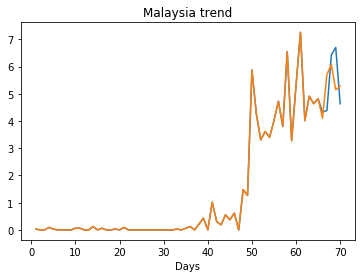

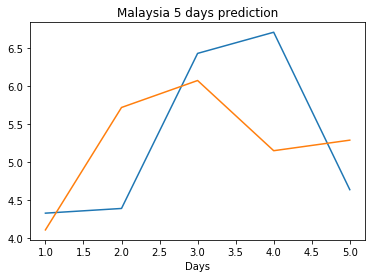

Creating directory ./offline5/Philippines/training/
Philippines
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8241
Saving the best model weights at Epoch [2], Best Valid Loss: 2.8055
Saving the best model weights at Epoch [3], Best Valid Loss: 2.7399


/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Saving the best model weights at Epoch [4], Best Valid Loss: 2.6894
Saving the best model weights at Epoch [6], Best Valid Loss: 2.6855
Saving the best model weights at Epoch [8], Best Valid Loss: 2.6601
Saving the best model weights at Epoch [10], Best Valid Loss: 2.5853
Saving the best model weights at Epoch [11], Best Valid Loss: 2.5636
Saving the best model weights at Epoch [12], Best Valid Loss: 2.4614
Saving the best model weights at Epoch [13], Best Valid Loss: 2.3557
Saving the best model weights at Epoch [14], Best Valid Loss: 2.3265
Saving the best model weights at Epoch [15], Best Valid Loss: 2.2017
Saving the best model weights at Epoch [16], Best Valid Loss: 2.1596
Saving the best model weights at Epoch [17], Best Valid Loss: 1.9928
Saving the best model weights at Epoch [18], Best Valid Loss: 1.9079
Saving the best model weights at Epoch [19], Best Valid Loss: 1.7612
Saving the best model weights at Epoch [20], Best Valid Loss: 1.6558
Saving the best model weights at Epoc

Saving the best model weights at Epoch [17], Best Valid Loss: 1.2089
Saving the best model weights at Epoch [18], Best Valid Loss: 1.1724
Saving the best model weights at Epoch [19], Best Valid Loss: 1.1572
Saving the best model weights at Epoch [20], Best Valid Loss: 1.1331
Saving the best model weights at Epoch [33], Best Valid Loss: 1.1319
train error: 0.030331273730068158
1.1319372653961182
Saving the best model weights at Epoch [1], Best Valid Loss: 2.5732
Saving the best model weights at Epoch [3], Best Valid Loss: 2.5307
Saving the best model weights at Epoch [4], Best Valid Loss: 2.4910
Saving the best model weights at Epoch [5], Best Valid Loss: 2.2542
Saving the best model weights at Epoch [7], Best Valid Loss: 1.9994
Saving the best model weights at Epoch [8], Best Valid Loss: 1.6902
Saving the best model weights at Epoch [9], Best Valid Loss: 1.6643
Saving the best model weights at Epoch [10], Best Valid Loss: 1.4764
Saving the best model weights at Epoch [11], Best Valid L

Saving the best model weights at Epoch [5], Best Valid Loss: 2.6251
Saving the best model weights at Epoch [6], Best Valid Loss: 2.6175
Saving the best model weights at Epoch [7], Best Valid Loss: 2.5379
Saving the best model weights at Epoch [8], Best Valid Loss: 2.3764
Saving the best model weights at Epoch [9], Best Valid Loss: 2.2186
Saving the best model weights at Epoch [11], Best Valid Loss: 2.1593
Saving the best model weights at Epoch [12], Best Valid Loss: 2.0344
Saving the best model weights at Epoch [13], Best Valid Loss: 1.9052
Saving the best model weights at Epoch [14], Best Valid Loss: 1.7944
Saving the best model weights at Epoch [15], Best Valid Loss: 1.7444
Saving the best model weights at Epoch [16], Best Valid Loss: 1.6142
Saving the best model weights at Epoch [17], Best Valid Loss: 1.4544
Saving the best model weights at Epoch [18], Best Valid Loss: 1.4289
Saving the best model weights at Epoch [19], Best Valid Loss: 1.3757
Saving the best model weights at Epoch 

train error: 0.038598517262532064
1.2139477729797363
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8103
Saving the best model weights at Epoch [2], Best Valid Loss: 2.5237
Saving the best model weights at Epoch [3], Best Valid Loss: 2.5059
Saving the best model weights at Epoch [7], Best Valid Loss: 2.4039
Saving the best model weights at Epoch [13], Best Valid Loss: 2.1758
Saving the best model weights at Epoch [14], Best Valid Loss: 1.9792
Saving the best model weights at Epoch [15], Best Valid Loss: 1.6676
Saving the best model weights at Epoch [16], Best Valid Loss: 1.3985
Saving the best model weights at Epoch [17], Best Valid Loss: 1.2405
Saving the best model weights at Epoch [18], Best Valid Loss: 1.2148
Saving the best model weights at Epoch [19], Best Valid Loss: 1.1515
Saving the best model weights at Epoch [20], Best Valid Loss: 1.1445
Saving the best model weights at Epoch [21], Best Valid Loss: 1.1333
train error: 0.027133734757080676
1.1333249807357788
S

Saving the best model weights at Epoch [25], Best Valid Loss: 2.5186
Saving the best model weights at Epoch [27], Best Valid Loss: 2.3661
Saving the best model weights at Epoch [28], Best Valid Loss: 2.2516
Saving the best model weights at Epoch [30], Best Valid Loss: 2.2090
Saving the best model weights at Epoch [31], Best Valid Loss: 1.8250
Saving the best model weights at Epoch [32], Best Valid Loss: 1.7908
Saving the best model weights at Epoch [33], Best Valid Loss: 1.6341
Saving the best model weights at Epoch [34], Best Valid Loss: 1.3820
Saving the best model weights at Epoch [35], Best Valid Loss: 1.3362
Saving the best model weights at Epoch [36], Best Valid Loss: 1.2277
Saving the best model weights at Epoch [37], Best Valid Loss: 1.2020
Saving the best model weights at Epoch [39], Best Valid Loss: 1.1913
Saving the best model weights at Epoch [41], Best Valid Loss: 1.1737
train error: 0.03925719234005858
1.1737210750579834
Saving the best model weights at Epoch [1], Best Va

Saving the best model weights at Epoch [9], Best Valid Loss: 2.6842
Saving the best model weights at Epoch [11], Best Valid Loss: 2.6370
Saving the best model weights at Epoch [12], Best Valid Loss: 2.6182
Saving the best model weights at Epoch [26], Best Valid Loss: 2.6075
train error: 0.20613694116473197
2.6074867248535156
Saving the best model weights at Epoch [1], Best Valid Loss: 2.7794
Saving the best model weights at Epoch [2], Best Valid Loss: 2.6208
Saving the best model weights at Epoch [4], Best Valid Loss: 2.3595
train error: 0.2156993401547273
2.3595011234283447
Saving the best model weights at Epoch [1], Best Valid Loss: 2.5540
Saving the best model weights at Epoch [4], Best Valid Loss: 2.1653
Saving the best model weights at Epoch [11], Best Valid Loss: 2.1459
Saving the best model weights at Epoch [32], Best Valid Loss: 1.9432
train error: 0.2308739468998586
1.9432405233383179
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8744
Saving the best model wei

Saving the best model weights at Epoch [3], Best Valid Loss: 2.4599
Saving the best model weights at Epoch [29], Best Valid Loss: 2.4346
Saving the best model weights at Epoch [30], Best Valid Loss: 2.2635
Saving the best model weights at Epoch [36], Best Valid Loss: 2.1684
train error: 0.2067720144211004
2.1684377193450928
Saving the best model weights at Epoch [1], Best Valid Loss: 3.1659
Saving the best model weights at Epoch [4], Best Valid Loss: 2.9764
Saving the best model weights at Epoch [5], Best Valid Loss: 2.9307
Saving the best model weights at Epoch [6], Best Valid Loss: 2.2306
Saving the best model weights at Epoch [23], Best Valid Loss: 2.1187
Saving the best model weights at Epoch [25], Best Valid Loss: 1.9495
Saving the best model weights at Epoch [34], Best Valid Loss: 1.9426
train error: 0.22456165595601002
1.9426029920578003
Saving the best model weights at Epoch [1], Best Valid Loss: 2.9395
Saving the best model weights at Epoch [2], Best Valid Loss: 2.9354
Saving 

Saving the best model weights at Epoch [2], Best Valid Loss: 2.7855
Saving the best model weights at Epoch [6], Best Valid Loss: 2.7279
Saving the best model weights at Epoch [7], Best Valid Loss: 2.7127
Saving the best model weights at Epoch [11], Best Valid Loss: 2.6981
Saving the best model weights at Epoch [13], Best Valid Loss: 2.6889
Saving the best model weights at Epoch [32], Best Valid Loss: 2.6801
train error: 0.20616207650552193
2.680133104324341
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8839
Saving the best model weights at Epoch [2], Best Valid Loss: 2.8352
Saving the best model weights at Epoch [3], Best Valid Loss: 2.7417
Saving the best model weights at Epoch [4], Best Valid Loss: 2.6476
Saving the best model weights at Epoch [16], Best Valid Loss: 2.6231
Saving the best model weights at Epoch [20], Best Valid Loss: 2.4672
train error: 0.20958478994046648
2.4672441482543945
Saving the best model weights at Epoch [1], Best Valid Loss: 2.9296
Saving t

Saving the best model weights at Epoch [20], Best Valid Loss: 2.8632
Saving the best model weights at Epoch [21], Best Valid Loss: 2.8509
Saving the best model weights at Epoch [22], Best Valid Loss: 2.8389
Saving the best model weights at Epoch [23], Best Valid Loss: 2.8270
Saving the best model weights at Epoch [24], Best Valid Loss: 2.8179
Saving the best model weights at Epoch [25], Best Valid Loss: 2.8111
Saving the best model weights at Epoch [26], Best Valid Loss: 2.8009
Saving the best model weights at Epoch [27], Best Valid Loss: 2.7947
Saving the best model weights at Epoch [28], Best Valid Loss: 2.7891
Saving the best model weights at Epoch [29], Best Valid Loss: 2.7826
Saving the best model weights at Epoch [30], Best Valid Loss: 2.7769
Saving the best model weights at Epoch [31], Best Valid Loss: 2.7701
Saving the best model weights at Epoch [32], Best Valid Loss: 2.7659
Saving the best model weights at Epoch [33], Best Valid Loss: 2.7614
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 2.2000
Saving the best model weights at Epoch [49], Best Valid Loss: 2.1852
Saving the best model weights at Epoch [50], Best Valid Loss: 2.1564
train error: 0.13508532317355276
2.156406879425049
Saving the best model weights at Epoch [1], Best Valid Loss: 3.1112
Saving the best model weights at Epoch [2], Best Valid Loss: 2.9488
Saving the best model weights at Epoch [3], Best Valid Loss: 2.8724
Saving the best model weights at Epoch [4], Best Valid Loss: 2.8067
Saving the best model weights at Epoch [5], Best Valid Loss: 2.7662
Saving the best model weights at Epoch [6], Best Valid Loss: 2.7256
Saving the best model weights at Epoch [7], Best Valid Loss: 2.7166
Saving the best model weights at Epoch [8], Best Valid Loss: 2.7067
Saving the best model weights at Epoch [9], Best Valid Loss: 2.6787
Saving the best model weights at Epoch [10], Best Valid Loss: 2.6689
Saving the best model weights at Epoch [11], Best Valid Loss:

Saving the best model weights at Epoch [40], Best Valid Loss: 2.7274
Saving the best model weights at Epoch [41], Best Valid Loss: 2.7237
Saving the best model weights at Epoch [42], Best Valid Loss: 2.7188
Saving the best model weights at Epoch [43], Best Valid Loss: 2.7134
Saving the best model weights at Epoch [44], Best Valid Loss: 2.7107
Saving the best model weights at Epoch [45], Best Valid Loss: 2.7089
Saving the best model weights at Epoch [46], Best Valid Loss: 2.7035
Saving the best model weights at Epoch [47], Best Valid Loss: 2.6999
Saving the best model weights at Epoch [48], Best Valid Loss: 2.6961
Saving the best model weights at Epoch [49], Best Valid Loss: 2.6932
Saving the best model weights at Epoch [50], Best Valid Loss: 2.6893
train error: 0.18629604907085498
2.689340829849243
Saving the best model weights at Epoch [1], Best Valid Loss: 3.7419
Saving the best model weights at Epoch [2], Best Valid Loss: 3.5644
Saving the best model weights at Epoch [3], Best Valid

Saving the best model weights at Epoch [13], Best Valid Loss: 2.7456
Saving the best model weights at Epoch [14], Best Valid Loss: 2.7305
Saving the best model weights at Epoch [15], Best Valid Loss: 2.7245
Saving the best model weights at Epoch [16], Best Valid Loss: 2.7182
Saving the best model weights at Epoch [17], Best Valid Loss: 2.7080
Saving the best model weights at Epoch [18], Best Valid Loss: 2.7061
Saving the best model weights at Epoch [19], Best Valid Loss: 2.6743
Saving the best model weights at Epoch [20], Best Valid Loss: 2.6741
Saving the best model weights at Epoch [21], Best Valid Loss: 2.6372
Saving the best model weights at Epoch [22], Best Valid Loss: 2.6242
Saving the best model weights at Epoch [23], Best Valid Loss: 2.6014
Saving the best model weights at Epoch [24], Best Valid Loss: 2.5900
Saving the best model weights at Epoch [25], Best Valid Loss: 2.5760
Saving the best model weights at Epoch [26], Best Valid Loss: 2.5583
Saving the best model weights at E

Saving the best model weights at Epoch [6], Best Valid Loss: 3.0496
Saving the best model weights at Epoch [7], Best Valid Loss: 3.0012
Saving the best model weights at Epoch [8], Best Valid Loss: 2.9632
Saving the best model weights at Epoch [9], Best Valid Loss: 2.9279
Saving the best model weights at Epoch [10], Best Valid Loss: 2.8985
Saving the best model weights at Epoch [11], Best Valid Loss: 2.8749
Saving the best model weights at Epoch [12], Best Valid Loss: 2.8515
Saving the best model weights at Epoch [13], Best Valid Loss: 2.8356
Saving the best model weights at Epoch [14], Best Valid Loss: 2.8189
Saving the best model weights at Epoch [15], Best Valid Loss: 2.8060
Saving the best model weights at Epoch [16], Best Valid Loss: 2.7952
Saving the best model weights at Epoch [17], Best Valid Loss: 2.7876
Saving the best model weights at Epoch [18], Best Valid Loss: 2.7730
Saving the best model weights at Epoch [19], Best Valid Loss: 2.7702
Saving the best model weights at Epoch

Saving the best model weights at Epoch [31], Best Valid Loss: 2.4216
Saving the best model weights at Epoch [32], Best Valid Loss: 2.3765
Saving the best model weights at Epoch [33], Best Valid Loss: 2.3556
Saving the best model weights at Epoch [35], Best Valid Loss: 2.2966
Saving the best model weights at Epoch [37], Best Valid Loss: 2.2496
Saving the best model weights at Epoch [38], Best Valid Loss: 2.2352
Saving the best model weights at Epoch [39], Best Valid Loss: 2.2211
Saving the best model weights at Epoch [40], Best Valid Loss: 2.1470
Saving the best model weights at Epoch [41], Best Valid Loss: 2.1262
Saving the best model weights at Epoch [42], Best Valid Loss: 2.0983
Saving the best model weights at Epoch [43], Best Valid Loss: 2.0667
Saving the best model weights at Epoch [44], Best Valid Loss: 2.0298
Saving the best model weights at Epoch [45], Best Valid Loss: 2.0107
Saving the best model weights at Epoch [46], Best Valid Loss: 1.9899
Saving the best model weights at E

Saving the best model weights at Epoch [26], Best Valid Loss: 2.6557
Saving the best model weights at Epoch [27], Best Valid Loss: 2.6501
Saving the best model weights at Epoch [28], Best Valid Loss: 2.6446
Saving the best model weights at Epoch [29], Best Valid Loss: 2.6370
Saving the best model weights at Epoch [30], Best Valid Loss: 2.6310
Saving the best model weights at Epoch [31], Best Valid Loss: 2.6282
Saving the best model weights at Epoch [32], Best Valid Loss: 2.6248
Saving the best model weights at Epoch [33], Best Valid Loss: 2.6152
Saving the best model weights at Epoch [34], Best Valid Loss: 2.6083
Saving the best model weights at Epoch [35], Best Valid Loss: 2.6071
Saving the best model weights at Epoch [36], Best Valid Loss: 2.5969
Saving the best model weights at Epoch [37], Best Valid Loss: 2.5908
Saving the best model weights at Epoch [38], Best Valid Loss: 2.5814
Saving the best model weights at Epoch [39], Best Valid Loss: 2.5746
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 2.9324
Saving the best model weights at Epoch [2], Best Valid Loss: 2.7999
Saving the best model weights at Epoch [3], Best Valid Loss: 2.7255
Saving the best model weights at Epoch [4], Best Valid Loss: 2.5785
Saving the best model weights at Epoch [6], Best Valid Loss: 2.5289
Saving the best model weights at Epoch [7], Best Valid Loss: 2.4892
Saving the best model weights at Epoch [9], Best Valid Loss: 2.4037
Saving the best model weights at Epoch [10], Best Valid Loss: 2.2804
Saving the best model weights at Epoch [11], Best Valid Loss: 2.2618
Saving the best model weights at Epoch [12], Best Valid Loss: 2.1462
Saving the best model weights at Epoch [14], Best Valid Loss: 1.9637
Saving the best model weights at Epoch [15], Best Valid Loss: 1.8270
Saving the best model weights at Epoch [16], Best Valid Loss: 1.7798
Saving the best model weights at Epoch [17], Best Valid Loss: 1.6957
Saving the best model weights at Epoch [1

train error: 0.19786141763130824
2.8031046390533447
Saving the best model weights at Epoch [1], Best Valid Loss: 3.7106
Saving the best model weights at Epoch [2], Best Valid Loss: 3.3723
Saving the best model weights at Epoch [3], Best Valid Loss: 3.1633
Saving the best model weights at Epoch [4], Best Valid Loss: 3.0307
Saving the best model weights at Epoch [5], Best Valid Loss: 2.9699
Saving the best model weights at Epoch [6], Best Valid Loss: 2.9042
Saving the best model weights at Epoch [7], Best Valid Loss: 2.8654
Saving the best model weights at Epoch [8], Best Valid Loss: 2.8638
Saving the best model weights at Epoch [9], Best Valid Loss: 2.8466
Saving the best model weights at Epoch [10], Best Valid Loss: 2.8271
Saving the best model weights at Epoch [12], Best Valid Loss: 2.8235
Saving the best model weights at Epoch [13], Best Valid Loss: 2.8036
Saving the best model weights at Epoch [20], Best Valid Loss: 2.7899
Saving the best model weights at Epoch [30], Best Valid Loss

Saving the best model weights at Epoch [42], Best Valid Loss: 2.7898
Saving the best model weights at Epoch [43], Best Valid Loss: 2.7885
Saving the best model weights at Epoch [46], Best Valid Loss: 2.7858
train error: 0.1965612712626656
2.7858073711395264
Saving the best model weights at Epoch [1], Best Valid Loss: 3.2434
Saving the best model weights at Epoch [2], Best Valid Loss: 3.0863
Saving the best model weights at Epoch [3], Best Valid Loss: 2.9773
Saving the best model weights at Epoch [4], Best Valid Loss: 2.9135
Saving the best model weights at Epoch [5], Best Valid Loss: 2.8727
Saving the best model weights at Epoch [6], Best Valid Loss: 2.8515
Saving the best model weights at Epoch [7], Best Valid Loss: 2.8184
Saving the best model weights at Epoch [9], Best Valid Loss: 2.8120
Saving the best model weights at Epoch [10], Best Valid Loss: 2.7964
Saving the best model weights at Epoch [12], Best Valid Loss: 2.7918
Saving the best model weights at Epoch [25], Best Valid Loss

Saving the best model weights at Epoch [3], Best Valid Loss: 3.0531
Saving the best model weights at Epoch [4], Best Valid Loss: 2.9776
Saving the best model weights at Epoch [5], Best Valid Loss: 2.9104
Saving the best model weights at Epoch [6], Best Valid Loss: 2.8748
Saving the best model weights at Epoch [7], Best Valid Loss: 2.8712
Saving the best model weights at Epoch [8], Best Valid Loss: 2.8462
Saving the best model weights at Epoch [9], Best Valid Loss: 2.8143
Saving the best model weights at Epoch [16], Best Valid Loss: 2.8093
Saving the best model weights at Epoch [18], Best Valid Loss: 2.7877
train error: 0.19857883950074515
2.787686586380005
Saving the best model weights at Epoch [1], Best Valid Loss: 3.1748
Saving the best model weights at Epoch [2], Best Valid Loss: 2.7777
Saving the best model weights at Epoch [5], Best Valid Loss: 2.7686
Saving the best model weights at Epoch [7], Best Valid Loss: 2.7538
Saving the best model weights at Epoch [15], Best Valid Loss: 2

Saving the best model weights at Epoch [4], Best Valid Loss: 2.9565
Saving the best model weights at Epoch [5], Best Valid Loss: 2.8866
Saving the best model weights at Epoch [6], Best Valid Loss: 2.8760
Saving the best model weights at Epoch [7], Best Valid Loss: 2.8476
Saving the best model weights at Epoch [8], Best Valid Loss: 2.8258
Saving the best model weights at Epoch [11], Best Valid Loss: 2.8023
Saving the best model weights at Epoch [13], Best Valid Loss: 2.8001
Saving the best model weights at Epoch [22], Best Valid Loss: 2.7935
Saving the best model weights at Epoch [24], Best Valid Loss: 2.7800
Saving the best model weights at Epoch [48], Best Valid Loss: 2.7790
train error: 0.1971454648921887
2.7790050506591797
Saving the best model weights at Epoch [1], Best Valid Loss: 3.0671
Saving the best model weights at Epoch [2], Best Valid Loss: 2.8138
Saving the best model weights at Epoch [3], Best Valid Loss: 2.7959
Saving the best model weights at Epoch [4], Best Valid Loss:

Saving the best model weights at Epoch [6], Best Valid Loss: 2.8666
Saving the best model weights at Epoch [7], Best Valid Loss: 2.8431
Saving the best model weights at Epoch [8], Best Valid Loss: 2.8308
Saving the best model weights at Epoch [9], Best Valid Loss: 2.8305
Saving the best model weights at Epoch [10], Best Valid Loss: 2.8302
Saving the best model weights at Epoch [11], Best Valid Loss: 2.8120
Saving the best model weights at Epoch [14], Best Valid Loss: 2.8083
Saving the best model weights at Epoch [16], Best Valid Loss: 2.7985
Saving the best model weights at Epoch [25], Best Valid Loss: 2.7940
Saving the best model weights at Epoch [41], Best Valid Loss: 2.7914
Saving the best model weights at Epoch [42], Best Valid Loss: 2.7873
train error: 0.19920545847465596
2.7873103618621826
Saving the best model weights at Epoch [1], Best Valid Loss: 3.0914
Saving the best model weights at Epoch [2], Best Valid Loss: 2.8218
Saving the best model weights at Epoch [4], Best Valid Lo

Saving the best model weights at Epoch [3], Best Valid Loss: 3.2882
Saving the best model weights at Epoch [4], Best Valid Loss: 3.2194
Saving the best model weights at Epoch [5], Best Valid Loss: 3.1610
Saving the best model weights at Epoch [6], Best Valid Loss: 3.1131
Saving the best model weights at Epoch [7], Best Valid Loss: 3.0676
Saving the best model weights at Epoch [8], Best Valid Loss: 3.0328
Saving the best model weights at Epoch [9], Best Valid Loss: 3.0037
Saving the best model weights at Epoch [10], Best Valid Loss: 2.9771
Saving the best model weights at Epoch [11], Best Valid Loss: 2.9564
Saving the best model weights at Epoch [12], Best Valid Loss: 2.9365
Saving the best model weights at Epoch [13], Best Valid Loss: 2.9183
Saving the best model weights at Epoch [14], Best Valid Loss: 2.9033
Saving the best model weights at Epoch [15], Best Valid Loss: 2.8906
Saving the best model weights at Epoch [16], Best Valid Loss: 2.8831
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [9], Best Valid Loss: 3.0192
Saving the best model weights at Epoch [10], Best Valid Loss: 2.9867
Saving the best model weights at Epoch [11], Best Valid Loss: 2.9612
Saving the best model weights at Epoch [12], Best Valid Loss: 2.9407
Saving the best model weights at Epoch [13], Best Valid Loss: 2.9210
Saving the best model weights at Epoch [14], Best Valid Loss: 2.9066
Saving the best model weights at Epoch [15], Best Valid Loss: 2.8954
Saving the best model weights at Epoch [16], Best Valid Loss: 2.8853
Saving the best model weights at Epoch [17], Best Valid Loss: 2.8755
Saving the best model weights at Epoch [18], Best Valid Loss: 2.8665
Saving the best model weights at Epoch [19], Best Valid Loss: 2.8590
Saving the best model weights at Epoch [20], Best Valid Loss: 2.8527
Saving the best model weights at Epoch [21], Best Valid Loss: 2.8461
Saving the best model weights at Epoch [22], Best Valid Loss: 2.8414
Saving the best model weights at Ep

Saving the best model weights at Epoch [12], Best Valid Loss: 2.9539
Saving the best model weights at Epoch [13], Best Valid Loss: 2.9337
Saving the best model weights at Epoch [14], Best Valid Loss: 2.9160
Saving the best model weights at Epoch [15], Best Valid Loss: 2.9020
Saving the best model weights at Epoch [16], Best Valid Loss: 2.8893
Saving the best model weights at Epoch [17], Best Valid Loss: 2.8782
Saving the best model weights at Epoch [18], Best Valid Loss: 2.8683
Saving the best model weights at Epoch [19], Best Valid Loss: 2.8624
Saving the best model weights at Epoch [20], Best Valid Loss: 2.8566
Saving the best model weights at Epoch [21], Best Valid Loss: 2.8494
Saving the best model weights at Epoch [22], Best Valid Loss: 2.8444
Saving the best model weights at Epoch [23], Best Valid Loss: 2.8407
Saving the best model weights at Epoch [24], Best Valid Loss: 2.8374
Saving the best model weights at Epoch [25], Best Valid Loss: 2.8351
Saving the best model weights at E

Saving the best model weights at Epoch [20], Best Valid Loss: 2.8587
Saving the best model weights at Epoch [21], Best Valid Loss: 2.8509
Saving the best model weights at Epoch [22], Best Valid Loss: 2.8423
Saving the best model weights at Epoch [23], Best Valid Loss: 2.8396
Saving the best model weights at Epoch [24], Best Valid Loss: 2.8361
Saving the best model weights at Epoch [25], Best Valid Loss: 2.8323
Saving the best model weights at Epoch [26], Best Valid Loss: 2.8289
Saving the best model weights at Epoch [27], Best Valid Loss: 2.8254
Saving the best model weights at Epoch [28], Best Valid Loss: 2.8227
Saving the best model weights at Epoch [29], Best Valid Loss: 2.8220
Saving the best model weights at Epoch [31], Best Valid Loss: 2.8205
Saving the best model weights at Epoch [34], Best Valid Loss: 2.8196
Saving the best model weights at Epoch [35], Best Valid Loss: 2.8193
Saving the best model weights at Epoch [37], Best Valid Loss: 2.8186
Saving the best model weights at E

Saving the best model weights at Epoch [14], Best Valid Loss: 2.9288
Saving the best model weights at Epoch [15], Best Valid Loss: 2.9135
Saving the best model weights at Epoch [16], Best Valid Loss: 2.9009
Saving the best model weights at Epoch [17], Best Valid Loss: 2.8887
Saving the best model weights at Epoch [18], Best Valid Loss: 2.8777
Saving the best model weights at Epoch [19], Best Valid Loss: 2.8695
Saving the best model weights at Epoch [20], Best Valid Loss: 2.8612
Saving the best model weights at Epoch [21], Best Valid Loss: 2.8537
Saving the best model weights at Epoch [22], Best Valid Loss: 2.8470
Saving the best model weights at Epoch [23], Best Valid Loss: 2.8430
Saving the best model weights at Epoch [24], Best Valid Loss: 2.8388
Saving the best model weights at Epoch [25], Best Valid Loss: 2.8340
Saving the best model weights at Epoch [26], Best Valid Loss: 2.8326
Saving the best model weights at Epoch [27], Best Valid Loss: 2.8278
Saving the best model weights at E

Saving the best model weights at Epoch [22], Best Valid Loss: 2.8457
Saving the best model weights at Epoch [23], Best Valid Loss: 2.8405
Saving the best model weights at Epoch [24], Best Valid Loss: 2.8350
Saving the best model weights at Epoch [25], Best Valid Loss: 2.8342
Saving the best model weights at Epoch [26], Best Valid Loss: 2.8301
Saving the best model weights at Epoch [27], Best Valid Loss: 2.8271
Saving the best model weights at Epoch [28], Best Valid Loss: 2.8250
Saving the best model weights at Epoch [29], Best Valid Loss: 2.8224
Saving the best model weights at Epoch [30], Best Valid Loss: 2.8217
Saving the best model weights at Epoch [31], Best Valid Loss: 2.8216
Saving the best model weights at Epoch [32], Best Valid Loss: 2.8207
Saving the best model weights at Epoch [33], Best Valid Loss: 2.8198
Saving the best model weights at Epoch [34], Best Valid Loss: 2.8197
Saving the best model weights at Epoch [35], Best Valid Loss: 2.8195
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 2.8275
Saving the best model weights at Epoch [32], Best Valid Loss: 2.8246
Saving the best model weights at Epoch [33], Best Valid Loss: 2.8237
Saving the best model weights at Epoch [34], Best Valid Loss: 2.8204
Saving the best model weights at Epoch [36], Best Valid Loss: 2.8201
Saving the best model weights at Epoch [37], Best Valid Loss: 2.8179
Saving the best model weights at Epoch [39], Best Valid Loss: 2.8173
Saving the best model weights at Epoch [42], Best Valid Loss: 2.8159
Saving the best model weights at Epoch [45], Best Valid Loss: 2.8152
train error: 0.19789512051890293
2.8152387142181396
Saving the best model weights at Epoch [1], Best Valid Loss: 3.4846
Saving the best model weights at Epoch [2], Best Valid Loss: 3.3600
Saving the best model weights at Epoch [3], Best Valid Loss: 3.2601
Saving the best model weights at Epoch [4], Best Valid Loss: 3.1745
Saving the best model weights at Epoch [5], Best Valid 

train error: 0.1978993217771252
2.8118767738342285
Saving the best model weights at Epoch [1], Best Valid Loss: 3.5700
Saving the best model weights at Epoch [2], Best Valid Loss: 3.4254
Saving the best model weights at Epoch [3], Best Valid Loss: 3.3127
Saving the best model weights at Epoch [4], Best Valid Loss: 3.2256
Saving the best model weights at Epoch [5], Best Valid Loss: 3.1464
Saving the best model weights at Epoch [6], Best Valid Loss: 3.0895
Saving the best model weights at Epoch [7], Best Valid Loss: 3.0355
Saving the best model weights at Epoch [8], Best Valid Loss: 2.9947
Saving the best model weights at Epoch [9], Best Valid Loss: 2.9627
Saving the best model weights at Epoch [10], Best Valid Loss: 2.9381
Saving the best model weights at Epoch [11], Best Valid Loss: 2.9228
Saving the best model weights at Epoch [12], Best Valid Loss: 2.8999
Saving the best model weights at Epoch [13], Best Valid Loss: 2.8858
Saving the best model weights at Epoch [14], Best Valid Loss:

Saving the best model weights at Epoch [9], Best Valid Loss: 2.9823
Saving the best model weights at Epoch [10], Best Valid Loss: 2.9630
Saving the best model weights at Epoch [11], Best Valid Loss: 2.9282
Saving the best model weights at Epoch [12], Best Valid Loss: 2.9073
Saving the best model weights at Epoch [13], Best Valid Loss: 2.8954
Saving the best model weights at Epoch [14], Best Valid Loss: 2.8833
Saving the best model weights at Epoch [15], Best Valid Loss: 2.8673
Saving the best model weights at Epoch [16], Best Valid Loss: 2.8573
Saving the best model weights at Epoch [17], Best Valid Loss: 2.8465
Saving the best model weights at Epoch [18], Best Valid Loss: 2.8396
Saving the best model weights at Epoch [20], Best Valid Loss: 2.8311
Saving the best model weights at Epoch [21], Best Valid Loss: 2.8214
Saving the best model weights at Epoch [23], Best Valid Loss: 2.8189
Saving the best model weights at Epoch [24], Best Valid Loss: 2.8178
Saving the best model weights at Ep

Saving the best model weights at Epoch [16], Best Valid Loss: 2.8467
Saving the best model weights at Epoch [17], Best Valid Loss: 2.8440
Saving the best model weights at Epoch [18], Best Valid Loss: 2.8356
Saving the best model weights at Epoch [19], Best Valid Loss: 2.8340
Saving the best model weights at Epoch [20], Best Valid Loss: 2.8268
Saving the best model weights at Epoch [21], Best Valid Loss: 2.8237
Saving the best model weights at Epoch [22], Best Valid Loss: 2.8233
Saving the best model weights at Epoch [24], Best Valid Loss: 2.8216
Saving the best model weights at Epoch [25], Best Valid Loss: 2.8173
Saving the best model weights at Epoch [27], Best Valid Loss: 2.8127
Saving the best model weights at Epoch [30], Best Valid Loss: 2.8122
Saving the best model weights at Epoch [32], Best Valid Loss: 2.8113
Saving the best model weights at Epoch [34], Best Valid Loss: 2.8103
Saving the best model weights at Epoch [36], Best Valid Loss: 2.8080
Saving the best model weights at E

Saving the best model weights at Epoch [10], Best Valid Loss: 4.1508
Saving the best model weights at Epoch [11], Best Valid Loss: 4.1231
Saving the best model weights at Epoch [12], Best Valid Loss: 4.0962
Saving the best model weights at Epoch [13], Best Valid Loss: 4.0691
Saving the best model weights at Epoch [14], Best Valid Loss: 4.0420
Saving the best model weights at Epoch [15], Best Valid Loss: 4.0163
Saving the best model weights at Epoch [16], Best Valid Loss: 3.9911
Saving the best model weights at Epoch [17], Best Valid Loss: 3.9665
Saving the best model weights at Epoch [18], Best Valid Loss: 3.9426
Saving the best model weights at Epoch [19], Best Valid Loss: 3.9191
Saving the best model weights at Epoch [20], Best Valid Loss: 3.8959
Saving the best model weights at Epoch [21], Best Valid Loss: 3.8738
Saving the best model weights at Epoch [22], Best Valid Loss: 3.8511
Saving the best model weights at Epoch [23], Best Valid Loss: 3.8294
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 2.9334
Saving the best model weights at Epoch [31], Best Valid Loss: 2.9221
Saving the best model weights at Epoch [32], Best Valid Loss: 2.9094
Saving the best model weights at Epoch [33], Best Valid Loss: 2.8990
Saving the best model weights at Epoch [34], Best Valid Loss: 2.8887
Saving the best model weights at Epoch [35], Best Valid Loss: 2.8832
Saving the best model weights at Epoch [36], Best Valid Loss: 2.8706
Saving the best model weights at Epoch [37], Best Valid Loss: 2.8627
Saving the best model weights at Epoch [38], Best Valid Loss: 2.8549
Saving the best model weights at Epoch [39], Best Valid Loss: 2.8453
Saving the best model weights at Epoch [40], Best Valid Loss: 2.8415
Saving the best model weights at Epoch [41], Best Valid Loss: 2.8310
Saving the best model weights at Epoch [42], Best Valid Loss: 2.8255
Saving the best model weights at Epoch [43], Best Valid Loss: 2.8162
Saving the best model weights at E

Saving the best model weights at Epoch [7], Best Valid Loss: 3.8306
Saving the best model weights at Epoch [8], Best Valid Loss: 3.8098
Saving the best model weights at Epoch [9], Best Valid Loss: 3.7895
Saving the best model weights at Epoch [10], Best Valid Loss: 3.7695
Saving the best model weights at Epoch [11], Best Valid Loss: 3.7501
Saving the best model weights at Epoch [12], Best Valid Loss: 3.7309
Saving the best model weights at Epoch [13], Best Valid Loss: 3.7127
Saving the best model weights at Epoch [14], Best Valid Loss: 3.6943
Saving the best model weights at Epoch [15], Best Valid Loss: 3.6760
Saving the best model weights at Epoch [16], Best Valid Loss: 3.6585
Saving the best model weights at Epoch [17], Best Valid Loss: 3.6413
Saving the best model weights at Epoch [18], Best Valid Loss: 3.6249
Saving the best model weights at Epoch [19], Best Valid Loss: 3.6081
Saving the best model weights at Epoch [20], Best Valid Loss: 3.5919
Saving the best model weights at Epoc

Saving the best model weights at Epoch [27], Best Valid Loss: 3.1077
Saving the best model weights at Epoch [28], Best Valid Loss: 3.0920
Saving the best model weights at Epoch [29], Best Valid Loss: 3.0789
Saving the best model weights at Epoch [30], Best Valid Loss: 3.0692
Saving the best model weights at Epoch [31], Best Valid Loss: 3.0568
Saving the best model weights at Epoch [32], Best Valid Loss: 3.0456
Saving the best model weights at Epoch [33], Best Valid Loss: 3.0353
Saving the best model weights at Epoch [34], Best Valid Loss: 3.0235
Saving the best model weights at Epoch [35], Best Valid Loss: 3.0154
Saving the best model weights at Epoch [36], Best Valid Loss: 3.0055
Saving the best model weights at Epoch [37], Best Valid Loss: 2.9971
Saving the best model weights at Epoch [38], Best Valid Loss: 2.9868
Saving the best model weights at Epoch [39], Best Valid Loss: 2.9820
Saving the best model weights at Epoch [40], Best Valid Loss: 2.9724
Saving the best model weights at E

Saving the best model weights at Epoch [6], Best Valid Loss: 3.6661
Saving the best model weights at Epoch [7], Best Valid Loss: 3.6487
Saving the best model weights at Epoch [8], Best Valid Loss: 3.6314
Saving the best model weights at Epoch [9], Best Valid Loss: 3.6148
Saving the best model weights at Epoch [10], Best Valid Loss: 3.5985
Saving the best model weights at Epoch [11], Best Valid Loss: 3.5824
Saving the best model weights at Epoch [12], Best Valid Loss: 3.5676
Saving the best model weights at Epoch [13], Best Valid Loss: 3.5512
Saving the best model weights at Epoch [14], Best Valid Loss: 3.5362
Saving the best model weights at Epoch [15], Best Valid Loss: 3.5215
Saving the best model weights at Epoch [16], Best Valid Loss: 3.5070
Saving the best model weights at Epoch [17], Best Valid Loss: 3.4929
Saving the best model weights at Epoch [18], Best Valid Loss: 3.4792
Saving the best model weights at Epoch [19], Best Valid Loss: 3.4653
Saving the best model weights at Epoch

Saving the best model weights at Epoch [26], Best Valid Loss: 3.0796
Saving the best model weights at Epoch [27], Best Valid Loss: 3.0616
Saving the best model weights at Epoch [28], Best Valid Loss: 3.0509
Saving the best model weights at Epoch [29], Best Valid Loss: 3.0438
Saving the best model weights at Epoch [30], Best Valid Loss: 3.0299
Saving the best model weights at Epoch [31], Best Valid Loss: 3.0219
Saving the best model weights at Epoch [32], Best Valid Loss: 3.0121
Saving the best model weights at Epoch [33], Best Valid Loss: 3.0051
Saving the best model weights at Epoch [34], Best Valid Loss: 2.9971
Saving the best model weights at Epoch [35], Best Valid Loss: 2.9867
Saving the best model weights at Epoch [36], Best Valid Loss: 2.9793
Saving the best model weights at Epoch [37], Best Valid Loss: 2.9719
Saving the best model weights at Epoch [38], Best Valid Loss: 2.9627
Saving the best model weights at Epoch [39], Best Valid Loss: 2.9614
Saving the best model weights at E

Saving the best model weights at Epoch [5], Best Valid Loss: 3.7137
Saving the best model weights at Epoch [6], Best Valid Loss: 3.6947
Saving the best model weights at Epoch [7], Best Valid Loss: 3.6759
Saving the best model weights at Epoch [8], Best Valid Loss: 3.6579
Saving the best model weights at Epoch [9], Best Valid Loss: 3.6394
Saving the best model weights at Epoch [10], Best Valid Loss: 3.6221
Saving the best model weights at Epoch [11], Best Valid Loss: 3.6045
Saving the best model weights at Epoch [12], Best Valid Loss: 3.5875
Saving the best model weights at Epoch [13], Best Valid Loss: 3.5713
Saving the best model weights at Epoch [14], Best Valid Loss: 3.5547
Saving the best model weights at Epoch [15], Best Valid Loss: 3.5388
Saving the best model weights at Epoch [16], Best Valid Loss: 3.5232
Saving the best model weights at Epoch [17], Best Valid Loss: 3.5081
Saving the best model weights at Epoch [18], Best Valid Loss: 3.4934
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [25], Best Valid Loss: 2.9977
Saving the best model weights at Epoch [26], Best Valid Loss: 2.9841
Saving the best model weights at Epoch [27], Best Valid Loss: 2.9735
Saving the best model weights at Epoch [28], Best Valid Loss: 2.9634
Saving the best model weights at Epoch [29], Best Valid Loss: 2.9554
Saving the best model weights at Epoch [30], Best Valid Loss: 2.9465
Saving the best model weights at Epoch [31], Best Valid Loss: 2.9358
Saving the best model weights at Epoch [32], Best Valid Loss: 2.9290
Saving the best model weights at Epoch [33], Best Valid Loss: 2.9197
Saving the best model weights at Epoch [34], Best Valid Loss: 2.9148
Saving the best model weights at Epoch [35], Best Valid Loss: 2.9037
Saving the best model weights at Epoch [36], Best Valid Loss: 2.8959
Saving the best model weights at Epoch [37], Best Valid Loss: 2.8915
Saving the best model weights at Epoch [38], Best Valid Loss: 2.8827
Saving the best model weights at E

Saving the best model weights at Epoch [5], Best Valid Loss: 3.4508
Saving the best model weights at Epoch [6], Best Valid Loss: 3.4381
Saving the best model weights at Epoch [7], Best Valid Loss: 3.4258
Saving the best model weights at Epoch [8], Best Valid Loss: 3.4139
Saving the best model weights at Epoch [9], Best Valid Loss: 3.4021
Saving the best model weights at Epoch [10], Best Valid Loss: 3.3909
Saving the best model weights at Epoch [11], Best Valid Loss: 3.3798
Saving the best model weights at Epoch [12], Best Valid Loss: 3.3684
Saving the best model weights at Epoch [13], Best Valid Loss: 3.3576
Saving the best model weights at Epoch [14], Best Valid Loss: 3.3472
Saving the best model weights at Epoch [15], Best Valid Loss: 3.3368
Saving the best model weights at Epoch [16], Best Valid Loss: 3.3267
Saving the best model weights at Epoch [17], Best Valid Loss: 3.3169
Saving the best model weights at Epoch [18], Best Valid Loss: 3.3074
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [23], Best Valid Loss: 2.8974
Saving the best model weights at Epoch [24], Best Valid Loss: 2.8930
Saving the best model weights at Epoch [25], Best Valid Loss: 2.8878
Saving the best model weights at Epoch [26], Best Valid Loss: 2.8856
Saving the best model weights at Epoch [27], Best Valid Loss: 2.8773
Saving the best model weights at Epoch [28], Best Valid Loss: 2.8761
Saving the best model weights at Epoch [29], Best Valid Loss: 2.8707
Saving the best model weights at Epoch [30], Best Valid Loss: 2.8672
Saving the best model weights at Epoch [31], Best Valid Loss: 2.8656
Saving the best model weights at Epoch [32], Best Valid Loss: 2.8635
Saving the best model weights at Epoch [33], Best Valid Loss: 2.8606
Saving the best model weights at Epoch [34], Best Valid Loss: 2.8580
Saving the best model weights at Epoch [35], Best Valid Loss: 2.8538
Saving the best model weights at Epoch [36], Best Valid Loss: 2.8520
Saving the best model weights at E

Saving the best model weights at Epoch [19], Best Valid Loss: 3.6980
Saving the best model weights at Epoch [20], Best Valid Loss: 3.6791
Saving the best model weights at Epoch [21], Best Valid Loss: 3.6615
Saving the best model weights at Epoch [22], Best Valid Loss: 3.6443
Saving the best model weights at Epoch [23], Best Valid Loss: 3.6274
Saving the best model weights at Epoch [24], Best Valid Loss: 3.6103
Saving the best model weights at Epoch [25], Best Valid Loss: 3.5940
Saving the best model weights at Epoch [26], Best Valid Loss: 3.5782
Saving the best model weights at Epoch [27], Best Valid Loss: 3.5627
Saving the best model weights at Epoch [28], Best Valid Loss: 3.5473
Saving the best model weights at Epoch [29], Best Valid Loss: 3.5327
Saving the best model weights at Epoch [30], Best Valid Loss: 3.5177
Saving the best model weights at Epoch [31], Best Valid Loss: 3.5036
Saving the best model weights at Epoch [32], Best Valid Loss: 3.4897
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 2.9568
Saving the best model weights at Epoch [40], Best Valid Loss: 2.9494
Saving the best model weights at Epoch [41], Best Valid Loss: 2.9492
Saving the best model weights at Epoch [42], Best Valid Loss: 2.9376
Saving the best model weights at Epoch [43], Best Valid Loss: 2.9316
Saving the best model weights at Epoch [44], Best Valid Loss: 2.9264
Saving the best model weights at Epoch [45], Best Valid Loss: 2.9229
Saving the best model weights at Epoch [46], Best Valid Loss: 2.9195
Saving the best model weights at Epoch [47], Best Valid Loss: 2.9090
Saving the best model weights at Epoch [48], Best Valid Loss: 2.9057
Saving the best model weights at Epoch [49], Best Valid Loss: 2.9029
Saving the best model weights at Epoch [50], Best Valid Loss: 2.8965
train error: 0.19783099728326003
2.896455764770508
Saving the best model weights at Epoch [1], Best Valid Loss: 3.5730
Saving the best model weights at Epoch [2], Best Vali

Saving the best model weights at Epoch [25], Best Valid Loss: 3.3206
Saving the best model weights at Epoch [26], Best Valid Loss: 3.3108
Saving the best model weights at Epoch [27], Best Valid Loss: 3.3009
Saving the best model weights at Epoch [28], Best Valid Loss: 3.2910
Saving the best model weights at Epoch [29], Best Valid Loss: 3.2816
Saving the best model weights at Epoch [30], Best Valid Loss: 3.2723
Saving the best model weights at Epoch [31], Best Valid Loss: 3.2634
Saving the best model weights at Epoch [32], Best Valid Loss: 3.2543
Saving the best model weights at Epoch [33], Best Valid Loss: 3.2457
Saving the best model weights at Epoch [34], Best Valid Loss: 3.2372
Saving the best model weights at Epoch [35], Best Valid Loss: 3.2294
Saving the best model weights at Epoch [36], Best Valid Loss: 3.2209
Saving the best model weights at Epoch [37], Best Valid Loss: 3.2127
Saving the best model weights at Epoch [38], Best Valid Loss: 3.2052
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 2.9072
Saving the best model weights at Epoch [46], Best Valid Loss: 2.9007
Saving the best model weights at Epoch [47], Best Valid Loss: 2.8996
Saving the best model weights at Epoch [48], Best Valid Loss: 2.8958
Saving the best model weights at Epoch [49], Best Valid Loss: 2.8911
Saving the best model weights at Epoch [50], Best Valid Loss: 2.8882
train error: 0.1982467659128209
2.8882315158843994
Saving the best model weights at Epoch [1], Best Valid Loss: 3.6327
Saving the best model weights at Epoch [2], Best Valid Loss: 3.5300
Saving the best model weights at Epoch [3], Best Valid Loss: 3.4264
Saving the best model weights at Epoch [4], Best Valid Loss: 3.3452
Saving the best model weights at Epoch [5], Best Valid Loss: 3.2569
Saving the best model weights at Epoch [6], Best Valid Loss: 3.2065
Saving the best model weights at Epoch [7], Best Valid Loss: 3.1532
Saving the best model weights at Epoch [8], Best Valid Loss

Saving the best model weights at Epoch [30], Best Valid Loss: 3.3094
Saving the best model weights at Epoch [31], Best Valid Loss: 3.2998
Saving the best model weights at Epoch [32], Best Valid Loss: 3.2904
Saving the best model weights at Epoch [33], Best Valid Loss: 3.2810
Saving the best model weights at Epoch [34], Best Valid Loss: 3.2721
Saving the best model weights at Epoch [35], Best Valid Loss: 3.2642
Saving the best model weights at Epoch [36], Best Valid Loss: 3.2544
Saving the best model weights at Epoch [37], Best Valid Loss: 3.2463
Saving the best model weights at Epoch [38], Best Valid Loss: 3.2379
Saving the best model weights at Epoch [39], Best Valid Loss: 3.2292
Saving the best model weights at Epoch [40], Best Valid Loss: 3.2213
Saving the best model weights at Epoch [41], Best Valid Loss: 3.2134
Saving the best model weights at Epoch [42], Best Valid Loss: 3.2057
Saving the best model weights at Epoch [43], Best Valid Loss: 3.1980
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 2.8821
train error: 0.1982276019640267
2.8821310997009277
Saving the best model weights at Epoch [1], Best Valid Loss: 3.4925
Saving the best model weights at Epoch [2], Best Valid Loss: 3.4004
Saving the best model weights at Epoch [3], Best Valid Loss: 3.3232
Saving the best model weights at Epoch [4], Best Valid Loss: 3.2509
Saving the best model weights at Epoch [5], Best Valid Loss: 3.1964
Saving the best model weights at Epoch [6], Best Valid Loss: 3.1412
Saving the best model weights at Epoch [7], Best Valid Loss: 3.1076
Saving the best model weights at Epoch [8], Best Valid Loss: 3.0593
Saving the best model weights at Epoch [9], Best Valid Loss: 3.0258
Saving the best model weights at Epoch [10], Best Valid Loss: 3.0051
Saving the best model weights at Epoch [11], Best Valid Loss: 2.9813
Saving the best model weights at Epoch [12], Best Valid Loss: 2.9582
Saving the best model weights at Epoch [13], Best Valid Loss:

Saving the best model weights at Epoch [40], Best Valid Loss: 3.0327
Saving the best model weights at Epoch [41], Best Valid Loss: 3.0286
Saving the best model weights at Epoch [42], Best Valid Loss: 3.0245
Saving the best model weights at Epoch [43], Best Valid Loss: 3.0201
Saving the best model weights at Epoch [44], Best Valid Loss: 3.0163
Saving the best model weights at Epoch [45], Best Valid Loss: 3.0123
Saving the best model weights at Epoch [46], Best Valid Loss: 3.0087
Saving the best model weights at Epoch [47], Best Valid Loss: 3.0052
Saving the best model weights at Epoch [48], Best Valid Loss: 3.0016
Saving the best model weights at Epoch [49], Best Valid Loss: 2.9977
Saving the best model weights at Epoch [50], Best Valid Loss: 2.9941
train error: 0.20891219908371567
2.9941394329071045
Saving the best model weights at Epoch [1], Best Valid Loss: 4.2519
Saving the best model weights at Epoch [2], Best Valid Loss: 4.2125
Saving the best model weights at Epoch [3], Best Vali

Saving the best model weights at Epoch [7], Best Valid Loss: 3.1984
Saving the best model weights at Epoch [8], Best Valid Loss: 3.1327
Saving the best model weights at Epoch [9], Best Valid Loss: 3.0914
Saving the best model weights at Epoch [10], Best Valid Loss: 3.0572
Saving the best model weights at Epoch [11], Best Valid Loss: 3.0228
Saving the best model weights at Epoch [12], Best Valid Loss: 2.9996
Saving the best model weights at Epoch [13], Best Valid Loss: 2.9798
Saving the best model weights at Epoch [14], Best Valid Loss: 2.9493
Saving the best model weights at Epoch [15], Best Valid Loss: 2.9372
Saving the best model weights at Epoch [16], Best Valid Loss: 2.9269
Saving the best model weights at Epoch [17], Best Valid Loss: 2.9144
Saving the best model weights at Epoch [18], Best Valid Loss: 2.8840
Saving the best model weights at Epoch [19], Best Valid Loss: 2.8805
Saving the best model weights at Epoch [20], Best Valid Loss: 2.8653
Saving the best model weights at Epoc

Saving the best model weights at Epoch [46], Best Valid Loss: 3.1356
Saving the best model weights at Epoch [47], Best Valid Loss: 3.1300
Saving the best model weights at Epoch [48], Best Valid Loss: 3.1232
Saving the best model weights at Epoch [49], Best Valid Loss: 3.1175
Saving the best model weights at Epoch [50], Best Valid Loss: 3.1120
train error: 0.20920607475563885
3.1119706630706787
Saving the best model weights at Epoch [1], Best Valid Loss: 3.5833
Saving the best model weights at Epoch [2], Best Valid Loss: 3.5617
Saving the best model weights at Epoch [3], Best Valid Loss: 3.5417
Saving the best model weights at Epoch [4], Best Valid Loss: 3.5223
Saving the best model weights at Epoch [5], Best Valid Loss: 3.5026
Saving the best model weights at Epoch [6], Best Valid Loss: 3.4838
Saving the best model weights at Epoch [7], Best Valid Loss: 3.4658
Saving the best model weights at Epoch [8], Best Valid Loss: 3.4487
Saving the best model weights at Epoch [9], Best Valid Loss

Saving the best model weights at Epoch [13], Best Valid Loss: 2.9741
Saving the best model weights at Epoch [14], Best Valid Loss: 2.9475
Saving the best model weights at Epoch [15], Best Valid Loss: 2.9197
Saving the best model weights at Epoch [16], Best Valid Loss: 2.9123
Saving the best model weights at Epoch [17], Best Valid Loss: 2.8914
Saving the best model weights at Epoch [18], Best Valid Loss: 2.8833
Saving the best model weights at Epoch [19], Best Valid Loss: 2.8724
Saving the best model weights at Epoch [21], Best Valid Loss: 2.8591
Saving the best model weights at Epoch [23], Best Valid Loss: 2.8437
Saving the best model weights at Epoch [25], Best Valid Loss: 2.8431
Saving the best model weights at Epoch [26], Best Valid Loss: 2.8355
Saving the best model weights at Epoch [27], Best Valid Loss: 2.8236
Saving the best model weights at Epoch [30], Best Valid Loss: 2.8201
Saving the best model weights at Epoch [36], Best Valid Loss: 2.8143
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 3.4528
Saving the best model weights at Epoch [3], Best Valid Loss: 3.4352
Saving the best model weights at Epoch [4], Best Valid Loss: 3.4169
Saving the best model weights at Epoch [5], Best Valid Loss: 3.4004
Saving the best model weights at Epoch [6], Best Valid Loss: 3.3841
Saving the best model weights at Epoch [7], Best Valid Loss: 3.3682
Saving the best model weights at Epoch [8], Best Valid Loss: 3.3537
Saving the best model weights at Epoch [9], Best Valid Loss: 3.3381
Saving the best model weights at Epoch [10], Best Valid Loss: 3.3237
Saving the best model weights at Epoch [11], Best Valid Loss: 3.3103
Saving the best model weights at Epoch [12], Best Valid Loss: 3.2968
Saving the best model weights at Epoch [13], Best Valid Loss: 3.2833
Saving the best model weights at Epoch [14], Best Valid Loss: 3.2712
Saving the best model weights at Epoch [15], Best Valid Loss: 3.2582
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [23], Best Valid Loss: 2.8335
Saving the best model weights at Epoch [26], Best Valid Loss: 2.8274
Saving the best model weights at Epoch [28], Best Valid Loss: 2.8186
Saving the best model weights at Epoch [29], Best Valid Loss: 2.8179
Saving the best model weights at Epoch [32], Best Valid Loss: 2.8171
Saving the best model weights at Epoch [37], Best Valid Loss: 2.8155
Saving the best model weights at Epoch [38], Best Valid Loss: 2.8154
Saving the best model weights at Epoch [40], Best Valid Loss: 2.8118
Saving the best model weights at Epoch [43], Best Valid Loss: 2.8066
Saving the best model weights at Epoch [45], Best Valid Loss: 2.8060
train error: 0.1972582667445143
2.806013822555542
Saving the best model weights at Epoch [1], Best Valid Loss: 3.7291
Saving the best model weights at Epoch [2], Best Valid Loss: 3.7147
Saving the best model weights at Epoch [3], Best Valid Loss: 3.7004
Saving the best model weights at Epoch [4], Best Valid L

Saving the best model weights at Epoch [8], Best Valid Loss: 3.5002
Saving the best model weights at Epoch [9], Best Valid Loss: 3.4808
Saving the best model weights at Epoch [10], Best Valid Loss: 3.4621
Saving the best model weights at Epoch [11], Best Valid Loss: 3.4443
Saving the best model weights at Epoch [12], Best Valid Loss: 3.4264
Saving the best model weights at Epoch [13], Best Valid Loss: 3.4096
Saving the best model weights at Epoch [14], Best Valid Loss: 3.3931
Saving the best model weights at Epoch [15], Best Valid Loss: 3.3772
Saving the best model weights at Epoch [16], Best Valid Loss: 3.3617
Saving the best model weights at Epoch [17], Best Valid Loss: 3.3476
Saving the best model weights at Epoch [18], Best Valid Loss: 3.3326
Saving the best model weights at Epoch [19], Best Valid Loss: 3.3179
Saving the best model weights at Epoch [20], Best Valid Loss: 3.3043
Saving the best model weights at Epoch [21], Best Valid Loss: 3.2912
Saving the best model weights at Epo

Saving the best model weights at Epoch [31], Best Valid Loss: 2.8203
Saving the best model weights at Epoch [33], Best Valid Loss: 2.8112
Saving the best model weights at Epoch [42], Best Valid Loss: 2.8020
train error: 0.1976208967467149
2.802027463912964
Saving the best model weights at Epoch [1], Best Valid Loss: 3.7166
Saving the best model weights at Epoch [2], Best Valid Loss: 3.7011
Saving the best model weights at Epoch [3], Best Valid Loss: 3.6858
Saving the best model weights at Epoch [4], Best Valid Loss: 3.6708
Saving the best model weights at Epoch [5], Best Valid Loss: 3.6560
Saving the best model weights at Epoch [6], Best Valid Loss: 3.6417
Saving the best model weights at Epoch [7], Best Valid Loss: 3.6275
Saving the best model weights at Epoch [8], Best Valid Loss: 3.6136
Saving the best model weights at Epoch [9], Best Valid Loss: 3.6000
Saving the best model weights at Epoch [10], Best Valid Loss: 3.5866
Saving the best model weights at Epoch [11], Best Valid Loss: 

Saving the best model weights at Epoch [15], Best Valid Loss: 3.3648
Saving the best model weights at Epoch [16], Best Valid Loss: 3.3496
Saving the best model weights at Epoch [17], Best Valid Loss: 3.3347
Saving the best model weights at Epoch [18], Best Valid Loss: 3.3206
Saving the best model weights at Epoch [19], Best Valid Loss: 3.3070
Saving the best model weights at Epoch [20], Best Valid Loss: 3.2938
Saving the best model weights at Epoch [21], Best Valid Loss: 3.2800
Saving the best model weights at Epoch [22], Best Valid Loss: 3.2677
Saving the best model weights at Epoch [23], Best Valid Loss: 3.2554
Saving the best model weights at Epoch [24], Best Valid Loss: 3.2440
Saving the best model weights at Epoch [25], Best Valid Loss: 3.2325
Saving the best model weights at Epoch [26], Best Valid Loss: 3.2200
Saving the best model weights at Epoch [27], Best Valid Loss: 3.2093
Saving the best model weights at Epoch [28], Best Valid Loss: 3.1983
Saving the best model weights at E

Saving the best model weights at Epoch [9], Best Valid Loss: 3.5540
Saving the best model weights at Epoch [10], Best Valid Loss: 3.5428
Saving the best model weights at Epoch [11], Best Valid Loss: 3.5319
Saving the best model weights at Epoch [12], Best Valid Loss: 3.5211
Saving the best model weights at Epoch [13], Best Valid Loss: 3.5106
Saving the best model weights at Epoch [14], Best Valid Loss: 3.4998
Saving the best model weights at Epoch [15], Best Valid Loss: 3.4895
Saving the best model weights at Epoch [16], Best Valid Loss: 3.4793
Saving the best model weights at Epoch [17], Best Valid Loss: 3.4694
Saving the best model weights at Epoch [18], Best Valid Loss: 3.4596
Saving the best model weights at Epoch [19], Best Valid Loss: 3.4498
Saving the best model weights at Epoch [20], Best Valid Loss: 3.4404
Saving the best model weights at Epoch [21], Best Valid Loss: 3.4309
Saving the best model weights at Epoch [22], Best Valid Loss: 3.4218
Saving the best model weights at Ep

Saving the best model weights at Epoch [28], Best Valid Loss: 3.1449
Saving the best model weights at Epoch [29], Best Valid Loss: 3.1367
Saving the best model weights at Epoch [30], Best Valid Loss: 3.1275
Saving the best model weights at Epoch [31], Best Valid Loss: 3.1188
Saving the best model weights at Epoch [32], Best Valid Loss: 3.1110
Saving the best model weights at Epoch [33], Best Valid Loss: 3.1034
Saving the best model weights at Epoch [34], Best Valid Loss: 3.0952
Saving the best model weights at Epoch [35], Best Valid Loss: 3.0881
Saving the best model weights at Epoch [36], Best Valid Loss: 3.0803
Saving the best model weights at Epoch [37], Best Valid Loss: 3.0732
Saving the best model weights at Epoch [38], Best Valid Loss: 3.0664
Saving the best model weights at Epoch [39], Best Valid Loss: 3.0603
Saving the best model weights at Epoch [40], Best Valid Loss: 3.0531
Saving the best model weights at Epoch [41], Best Valid Loss: 3.0471
Saving the best model weights at E

Saving the best model weights at Epoch [10], Best Valid Loss: 3.4788
Saving the best model weights at Epoch [11], Best Valid Loss: 3.4684
Saving the best model weights at Epoch [12], Best Valid Loss: 3.4582
Saving the best model weights at Epoch [13], Best Valid Loss: 3.4482
Saving the best model weights at Epoch [14], Best Valid Loss: 3.4382
Saving the best model weights at Epoch [15], Best Valid Loss: 3.4285
Saving the best model weights at Epoch [16], Best Valid Loss: 3.4190
Saving the best model weights at Epoch [17], Best Valid Loss: 3.4097
Saving the best model weights at Epoch [18], Best Valid Loss: 3.4004
Saving the best model weights at Epoch [19], Best Valid Loss: 3.3913
Saving the best model weights at Epoch [20], Best Valid Loss: 3.3823
Saving the best model weights at Epoch [21], Best Valid Loss: 3.3735
Saving the best model weights at Epoch [22], Best Valid Loss: 3.3648
Saving the best model weights at Epoch [23], Best Valid Loss: 3.3565
Saving the best model weights at E

Saving the best model weights at Epoch [28], Best Valid Loss: 3.1830
Saving the best model weights at Epoch [29], Best Valid Loss: 3.1725
Saving the best model weights at Epoch [30], Best Valid Loss: 3.1626
Saving the best model weights at Epoch [31], Best Valid Loss: 3.1524
Saving the best model weights at Epoch [32], Best Valid Loss: 3.1432
Saving the best model weights at Epoch [33], Best Valid Loss: 3.1338
Saving the best model weights at Epoch [34], Best Valid Loss: 3.1249
Saving the best model weights at Epoch [35], Best Valid Loss: 3.1158
Saving the best model weights at Epoch [36], Best Valid Loss: 3.1077
Saving the best model weights at Epoch [37], Best Valid Loss: 3.0995
Saving the best model weights at Epoch [38], Best Valid Loss: 3.0924
Saving the best model weights at Epoch [39], Best Valid Loss: 3.0837
Saving the best model weights at Epoch [40], Best Valid Loss: 3.0782
Saving the best model weights at Epoch [41], Best Valid Loss: 3.0687
Saving the best model weights at E

Saving the best model weights at Epoch [18], Best Valid Loss: 3.3447
Saving the best model weights at Epoch [19], Best Valid Loss: 3.3363
Saving the best model weights at Epoch [20], Best Valid Loss: 3.3284
Saving the best model weights at Epoch [21], Best Valid Loss: 3.3205
Saving the best model weights at Epoch [22], Best Valid Loss: 3.3127
Saving the best model weights at Epoch [23], Best Valid Loss: 3.3051
Saving the best model weights at Epoch [24], Best Valid Loss: 3.2975
Saving the best model weights at Epoch [25], Best Valid Loss: 3.2902
Saving the best model weights at Epoch [26], Best Valid Loss: 3.2829
Saving the best model weights at Epoch [27], Best Valid Loss: 3.2757
Saving the best model weights at Epoch [28], Best Valid Loss: 3.2686
Saving the best model weights at Epoch [29], Best Valid Loss: 3.2617
Saving the best model weights at Epoch [30], Best Valid Loss: 3.2550
Saving the best model weights at Epoch [31], Best Valid Loss: 3.2482
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 3.1235
Saving the best model weights at Epoch [39], Best Valid Loss: 3.1147
Saving the best model weights at Epoch [40], Best Valid Loss: 3.1067
Saving the best model weights at Epoch [41], Best Valid Loss: 3.0987
Saving the best model weights at Epoch [42], Best Valid Loss: 3.0912
Saving the best model weights at Epoch [43], Best Valid Loss: 3.0836
Saving the best model weights at Epoch [44], Best Valid Loss: 3.0768
Saving the best model weights at Epoch [45], Best Valid Loss: 3.0699
Saving the best model weights at Epoch [46], Best Valid Loss: 3.0627
Saving the best model weights at Epoch [47], Best Valid Loss: 3.0558
Saving the best model weights at Epoch [48], Best Valid Loss: 3.0496
Saving the best model weights at Epoch [49], Best Valid Loss: 3.0434
Saving the best model weights at Epoch [50], Best Valid Loss: 3.0379
train error: 0.20362985596681635
3.0378596782684326
Saving the best model weights at Epoch [1], Best Va

Saving the best model weights at Epoch [24], Best Valid Loss: 3.6602
Saving the best model weights at Epoch [25], Best Valid Loss: 3.6469
Saving the best model weights at Epoch [26], Best Valid Loss: 3.6340
Saving the best model weights at Epoch [27], Best Valid Loss: 3.6210
Saving the best model weights at Epoch [28], Best Valid Loss: 3.6084
Saving the best model weights at Epoch [29], Best Valid Loss: 3.5959
Saving the best model weights at Epoch [30], Best Valid Loss: 3.5836
Saving the best model weights at Epoch [31], Best Valid Loss: 3.5717
Saving the best model weights at Epoch [32], Best Valid Loss: 3.5598
Saving the best model weights at Epoch [33], Best Valid Loss: 3.5483
Saving the best model weights at Epoch [34], Best Valid Loss: 3.5367
Saving the best model weights at Epoch [35], Best Valid Loss: 3.5255
Saving the best model weights at Epoch [36], Best Valid Loss: 3.5144
Saving the best model weights at Epoch [37], Best Valid Loss: 3.5036
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 3.1633
Saving the best model weights at Epoch [43], Best Valid Loss: 3.1533
Saving the best model weights at Epoch [44], Best Valid Loss: 3.1439
Saving the best model weights at Epoch [45], Best Valid Loss: 3.1346
Saving the best model weights at Epoch [46], Best Valid Loss: 3.1256
Saving the best model weights at Epoch [47], Best Valid Loss: 3.1177
Saving the best model weights at Epoch [48], Best Valid Loss: 3.1083
Saving the best model weights at Epoch [49], Best Valid Loss: 3.1004
Saving the best model weights at Epoch [50], Best Valid Loss: 3.0927
train error: 0.20986566978196303
3.0926513671875
Saving the best model weights at Epoch [1], Best Valid Loss: 3.1368
Saving the best model weights at Epoch [2], Best Valid Loss: 3.1215
Saving the best model weights at Epoch [3], Best Valid Loss: 3.1070
Saving the best model weights at Epoch [4], Best Valid Loss: 3.0969
Saving the best model weights at Epoch [5], Best Valid Los

Saving the best model weights at Epoch [26], Best Valid Loss: 3.4232
Saving the best model weights at Epoch [27], Best Valid Loss: 3.4135
Saving the best model weights at Epoch [28], Best Valid Loss: 3.4039
Saving the best model weights at Epoch [29], Best Valid Loss: 3.3945
Saving the best model weights at Epoch [30], Best Valid Loss: 3.3853
Saving the best model weights at Epoch [31], Best Valid Loss: 3.3762
Saving the best model weights at Epoch [32], Best Valid Loss: 3.3672
Saving the best model weights at Epoch [33], Best Valid Loss: 3.3584
Saving the best model weights at Epoch [34], Best Valid Loss: 3.3498
Saving the best model weights at Epoch [35], Best Valid Loss: 3.3414
Saving the best model weights at Epoch [36], Best Valid Loss: 3.3331
Saving the best model weights at Epoch [37], Best Valid Loss: 3.3246
Saving the best model weights at Epoch [38], Best Valid Loss: 3.3166
Saving the best model weights at Epoch [39], Best Valid Loss: 3.3086
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 3.0454
Saving the best model weights at Epoch [46], Best Valid Loss: 3.0386
Saving the best model weights at Epoch [47], Best Valid Loss: 3.0327
Saving the best model weights at Epoch [48], Best Valid Loss: 3.0269
Saving the best model weights at Epoch [49], Best Valid Loss: 3.0209
Saving the best model weights at Epoch [50], Best Valid Loss: 3.0159
train error: 0.20568390917032958
3.015911102294922
Saving the best model weights at Epoch [1], Best Valid Loss: 3.7032
Saving the best model weights at Epoch [2], Best Valid Loss: 3.6656
Saving the best model weights at Epoch [3], Best Valid Loss: 3.6285
Saving the best model weights at Epoch [4], Best Valid Loss: 3.5880
Saving the best model weights at Epoch [5], Best Valid Loss: 3.5575
Saving the best model weights at Epoch [6], Best Valid Loss: 3.5192
Saving the best model weights at Epoch [7], Best Valid Loss: 3.4860
Saving the best model weights at Epoch [8], Best Valid Loss

Saving the best model weights at Epoch [33], Best Valid Loss: 3.3615
Saving the best model weights at Epoch [34], Best Valid Loss: 3.3533
Saving the best model weights at Epoch [35], Best Valid Loss: 3.3453
Saving the best model weights at Epoch [36], Best Valid Loss: 3.3373
Saving the best model weights at Epoch [37], Best Valid Loss: 3.3295
Saving the best model weights at Epoch [38], Best Valid Loss: 3.3218
Saving the best model weights at Epoch [39], Best Valid Loss: 3.3142
Saving the best model weights at Epoch [40], Best Valid Loss: 3.3068
Saving the best model weights at Epoch [41], Best Valid Loss: 3.2994
Saving the best model weights at Epoch [42], Best Valid Loss: 3.2923
Saving the best model weights at Epoch [43], Best Valid Loss: 3.2851
Saving the best model weights at Epoch [44], Best Valid Loss: 3.2780
Saving the best model weights at Epoch [45], Best Valid Loss: 3.2712
Saving the best model weights at Epoch [46], Best Valid Loss: 3.2644
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 3.6465
Saving the best model weights at Epoch [3], Best Valid Loss: 3.6048
Saving the best model weights at Epoch [4], Best Valid Loss: 3.5684
Saving the best model weights at Epoch [5], Best Valid Loss: 3.5360
Saving the best model weights at Epoch [6], Best Valid Loss: 3.5016
Saving the best model weights at Epoch [7], Best Valid Loss: 3.4685
Saving the best model weights at Epoch [8], Best Valid Loss: 3.4377
Saving the best model weights at Epoch [9], Best Valid Loss: 3.4120
Saving the best model weights at Epoch [10], Best Valid Loss: 3.3834
Saving the best model weights at Epoch [11], Best Valid Loss: 3.3568
Saving the best model weights at Epoch [12], Best Valid Loss: 3.3331
Saving the best model weights at Epoch [13], Best Valid Loss: 3.3139
Saving the best model weights at Epoch [14], Best Valid Loss: 3.2859
Saving the best model weights at Epoch [15], Best Valid Loss: 3.2638
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [42], Best Valid Loss: 3.2641
Saving the best model weights at Epoch [43], Best Valid Loss: 3.2570
Saving the best model weights at Epoch [44], Best Valid Loss: 3.2503
Saving the best model weights at Epoch [45], Best Valid Loss: 3.2436
Saving the best model weights at Epoch [46], Best Valid Loss: 3.2370
Saving the best model weights at Epoch [47], Best Valid Loss: 3.2306
Saving the best model weights at Epoch [48], Best Valid Loss: 3.2242
Saving the best model weights at Epoch [49], Best Valid Loss: 3.2180
Saving the best model weights at Epoch [50], Best Valid Loss: 3.2118
train error: 0.21722793540296456
3.2118325233459473
Saving the best model weights at Epoch [1], Best Valid Loss: 3.6809
Saving the best model weights at Epoch [2], Best Valid Loss: 3.6629
Saving the best model weights at Epoch [3], Best Valid Loss: 3.6454
Saving the best model weights at Epoch [4], Best Valid Loss: 3.6285
Saving the best model weights at Epoch [5], Best Valid 

Saving the best model weights at Epoch [10], Best Valid Loss: 3.3796
Saving the best model weights at Epoch [11], Best Valid Loss: 3.3517
Saving the best model weights at Epoch [12], Best Valid Loss: 3.3287
Saving the best model weights at Epoch [13], Best Valid Loss: 3.3052
Saving the best model weights at Epoch [14], Best Valid Loss: 3.2822
Saving the best model weights at Epoch [15], Best Valid Loss: 3.2622
Saving the best model weights at Epoch [16], Best Valid Loss: 3.2418
Saving the best model weights at Epoch [17], Best Valid Loss: 3.2223
Saving the best model weights at Epoch [18], Best Valid Loss: 3.2040
Saving the best model weights at Epoch [19], Best Valid Loss: 3.1889
Saving the best model weights at Epoch [20], Best Valid Loss: 3.1701
Saving the best model weights at Epoch [21], Best Valid Loss: 3.1552
Saving the best model weights at Epoch [22], Best Valid Loss: 3.1406
Saving the best model weights at Epoch [23], Best Valid Loss: 3.1247
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 2.7596
Saving the best model weights at Epoch [49], Best Valid Loss: 2.7559
Saving the best model weights at Epoch [50], Best Valid Loss: 2.7522
train error: 0.19334385034938653
2.752232313156128
Saving the best model weights at Epoch [1], Best Valid Loss: 3.8681
Saving the best model weights at Epoch [2], Best Valid Loss: 3.7556
Saving the best model weights at Epoch [3], Best Valid Loss: 3.6580
Saving the best model weights at Epoch [4], Best Valid Loss: 3.5680
Saving the best model weights at Epoch [5], Best Valid Loss: 3.4864
Saving the best model weights at Epoch [6], Best Valid Loss: 3.4147
Saving the best model weights at Epoch [7], Best Valid Loss: 3.3523
Saving the best model weights at Epoch [8], Best Valid Loss: 3.2976
Saving the best model weights at Epoch [9], Best Valid Loss: 3.2445
Saving the best model weights at Epoch [10], Best Valid Loss: 3.1988
Saving the best model weights at Epoch [11], Best Valid Loss:

Saving the best model weights at Epoch [22], Best Valid Loss: 2.7503
Saving the best model weights at Epoch [24], Best Valid Loss: 2.7443
Saving the best model weights at Epoch [25], Best Valid Loss: 2.7393
Saving the best model weights at Epoch [26], Best Valid Loss: 2.7385
Saving the best model weights at Epoch [29], Best Valid Loss: 2.7163
Saving the best model weights at Epoch [31], Best Valid Loss: 2.7019
Saving the best model weights at Epoch [32], Best Valid Loss: 2.7007
Saving the best model weights at Epoch [33], Best Valid Loss: 2.6989
Saving the best model weights at Epoch [35], Best Valid Loss: 2.6928
Saving the best model weights at Epoch [36], Best Valid Loss: 2.6768
Saving the best model weights at Epoch [38], Best Valid Loss: 2.6713
Saving the best model weights at Epoch [40], Best Valid Loss: 2.6614
Saving the best model weights at Epoch [42], Best Valid Loss: 2.6553
Saving the best model weights at Epoch [43], Best Valid Loss: 2.6454
Saving the best model weights at E

Saving the best model weights at Epoch [7], Best Valid Loss: 3.1881
Saving the best model weights at Epoch [8], Best Valid Loss: 3.1442
Saving the best model weights at Epoch [9], Best Valid Loss: 3.1055
Saving the best model weights at Epoch [10], Best Valid Loss: 3.0698
Saving the best model weights at Epoch [11], Best Valid Loss: 3.0371
Saving the best model weights at Epoch [12], Best Valid Loss: 3.0085
Saving the best model weights at Epoch [13], Best Valid Loss: 2.9797
Saving the best model weights at Epoch [14], Best Valid Loss: 2.9555
Saving the best model weights at Epoch [15], Best Valid Loss: 2.9352
Saving the best model weights at Epoch [16], Best Valid Loss: 2.9129
Saving the best model weights at Epoch [17], Best Valid Loss: 2.8936
Saving the best model weights at Epoch [18], Best Valid Loss: 2.8756
Saving the best model weights at Epoch [19], Best Valid Loss: 2.8595
Saving the best model weights at Epoch [20], Best Valid Loss: 2.8449
Saving the best model weights at Epoc

Saving the best model weights at Epoch [27], Best Valid Loss: 2.6370
Saving the best model weights at Epoch [28], Best Valid Loss: 2.6271
Saving the best model weights at Epoch [29], Best Valid Loss: 2.6172
Saving the best model weights at Epoch [30], Best Valid Loss: 2.6075
Saving the best model weights at Epoch [31], Best Valid Loss: 2.6045
Saving the best model weights at Epoch [32], Best Valid Loss: 2.5891
Saving the best model weights at Epoch [33], Best Valid Loss: 2.5835
Saving the best model weights at Epoch [34], Best Valid Loss: 2.5755
Saving the best model weights at Epoch [35], Best Valid Loss: 2.5589
Saving the best model weights at Epoch [36], Best Valid Loss: 2.5500
Saving the best model weights at Epoch [38], Best Valid Loss: 2.5295
Saving the best model weights at Epoch [39], Best Valid Loss: 2.5220
Saving the best model weights at Epoch [40], Best Valid Loss: 2.5186
Saving the best model weights at Epoch [41], Best Valid Loss: 2.5104
Saving the best model weights at E

Saving the best model weights at Epoch [7], Best Valid Loss: 3.3093
Saving the best model weights at Epoch [8], Best Valid Loss: 3.2538
Saving the best model weights at Epoch [9], Best Valid Loss: 3.2048
Saving the best model weights at Epoch [10], Best Valid Loss: 3.1593
Saving the best model weights at Epoch [11], Best Valid Loss: 3.1181
Saving the best model weights at Epoch [12], Best Valid Loss: 3.0817
Saving the best model weights at Epoch [13], Best Valid Loss: 3.0505
Saving the best model weights at Epoch [14], Best Valid Loss: 3.0195
Saving the best model weights at Epoch [15], Best Valid Loss: 2.9922
Saving the best model weights at Epoch [16], Best Valid Loss: 2.9652
Saving the best model weights at Epoch [17], Best Valid Loss: 2.9426
Saving the best model weights at Epoch [18], Best Valid Loss: 2.9213
Saving the best model weights at Epoch [19], Best Valid Loss: 2.9023
Saving the best model weights at Epoch [20], Best Valid Loss: 2.8852
Saving the best model weights at Epoc

Saving the best model weights at Epoch [36], Best Valid Loss: 2.6543
Saving the best model weights at Epoch [37], Best Valid Loss: 2.6521
Saving the best model weights at Epoch [38], Best Valid Loss: 2.6388
Saving the best model weights at Epoch [39], Best Valid Loss: 2.6245
Saving the best model weights at Epoch [41], Best Valid Loss: 2.6203
Saving the best model weights at Epoch [42], Best Valid Loss: 2.6080
Saving the best model weights at Epoch [43], Best Valid Loss: 2.6059
Saving the best model weights at Epoch [44], Best Valid Loss: 2.5787
Saving the best model weights at Epoch [46], Best Valid Loss: 2.5786
Saving the best model weights at Epoch [47], Best Valid Loss: 2.5629
Saving the best model weights at Epoch [48], Best Valid Loss: 2.5584
Saving the best model weights at Epoch [49], Best Valid Loss: 2.5456
train error: 0.17319391773392756
2.545560598373413
Saving the best model weights at Epoch [1], Best Valid Loss: 3.2042
Saving the best model weights at Epoch [2], Best Vali

Saving the best model weights at Epoch [13], Best Valid Loss: 2.9871
Saving the best model weights at Epoch [14], Best Valid Loss: 2.9663
Saving the best model weights at Epoch [15], Best Valid Loss: 2.9504
Saving the best model weights at Epoch [16], Best Valid Loss: 2.9285
Saving the best model weights at Epoch [17], Best Valid Loss: 2.9127
Saving the best model weights at Epoch [18], Best Valid Loss: 2.8986
Saving the best model weights at Epoch [19], Best Valid Loss: 2.8830
Saving the best model weights at Epoch [20], Best Valid Loss: 2.8706
Saving the best model weights at Epoch [21], Best Valid Loss: 2.8596
Saving the best model weights at Epoch [22], Best Valid Loss: 2.8495
Saving the best model weights at Epoch [23], Best Valid Loss: 2.8418
Saving the best model weights at Epoch [24], Best Valid Loss: 2.8328
Saving the best model weights at Epoch [25], Best Valid Loss: 2.8226
Saving the best model weights at Epoch [26], Best Valid Loss: 2.8191
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 2.5789
Saving the best model weights at Epoch [36], Best Valid Loss: 2.5778
Saving the best model weights at Epoch [37], Best Valid Loss: 2.5694
Saving the best model weights at Epoch [39], Best Valid Loss: 2.5529
Saving the best model weights at Epoch [40], Best Valid Loss: 2.5505
Saving the best model weights at Epoch [41], Best Valid Loss: 2.5339
Saving the best model weights at Epoch [42], Best Valid Loss: 2.5305
Saving the best model weights at Epoch [43], Best Valid Loss: 2.5200
Saving the best model weights at Epoch [44], Best Valid Loss: 2.5026
Saving the best model weights at Epoch [45], Best Valid Loss: 2.4938
Saving the best model weights at Epoch [46], Best Valid Loss: 2.4911
Saving the best model weights at Epoch [47], Best Valid Loss: 2.4829
Saving the best model weights at Epoch [48], Best Valid Loss: 2.4674
Saving the best model weights at Epoch [49], Best Valid Loss: 2.4600
Saving the best model weights at E

Saving the best model weights at Epoch [14], Best Valid Loss: 3.1066
Saving the best model weights at Epoch [15], Best Valid Loss: 3.0798
Saving the best model weights at Epoch [16], Best Valid Loss: 3.0549
Saving the best model weights at Epoch [17], Best Valid Loss: 3.0360
Saving the best model weights at Epoch [18], Best Valid Loss: 3.0133
Saving the best model weights at Epoch [19], Best Valid Loss: 2.9937
Saving the best model weights at Epoch [20], Best Valid Loss: 2.9768
Saving the best model weights at Epoch [21], Best Valid Loss: 2.9621
Saving the best model weights at Epoch [22], Best Valid Loss: 2.9481
Saving the best model weights at Epoch [23], Best Valid Loss: 2.9372
Saving the best model weights at Epoch [24], Best Valid Loss: 2.9250
Saving the best model weights at Epoch [25], Best Valid Loss: 2.9150
Saving the best model weights at Epoch [26], Best Valid Loss: 2.9059
Saving the best model weights at Epoch [27], Best Valid Loss: 2.8974
Saving the best model weights at E

Saving the best model weights at Epoch [12], Best Valid Loss: 3.1449
Saving the best model weights at Epoch [13], Best Valid Loss: 3.1194
Saving the best model weights at Epoch [14], Best Valid Loss: 3.0957
Saving the best model weights at Epoch [15], Best Valid Loss: 3.0743
Saving the best model weights at Epoch [16], Best Valid Loss: 3.0542
Saving the best model weights at Epoch [17], Best Valid Loss: 3.0361
Saving the best model weights at Epoch [18], Best Valid Loss: 3.0189
Saving the best model weights at Epoch [19], Best Valid Loss: 3.0027
Saving the best model weights at Epoch [20], Best Valid Loss: 2.9879
Saving the best model weights at Epoch [21], Best Valid Loss: 2.9742
Saving the best model weights at Epoch [22], Best Valid Loss: 2.9615
Saving the best model weights at Epoch [23], Best Valid Loss: 2.9495
Saving the best model weights at Epoch [24], Best Valid Loss: 2.9397
Saving the best model weights at Epoch [25], Best Valid Loss: 2.9286
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 2.8220
Saving the best model weights at Epoch [33], Best Valid Loss: 2.8185
Saving the best model weights at Epoch [34], Best Valid Loss: 2.8181
Saving the best model weights at Epoch [36], Best Valid Loss: 2.8155
Saving the best model weights at Epoch [37], Best Valid Loss: 2.8147
Saving the best model weights at Epoch [40], Best Valid Loss: 2.8117
Saving the best model weights at Epoch [41], Best Valid Loss: 2.8102
Saving the best model weights at Epoch [44], Best Valid Loss: 2.8101
Saving the best model weights at Epoch [45], Best Valid Loss: 2.8093
Saving the best model weights at Epoch [46], Best Valid Loss: 2.8084
Saving the best model weights at Epoch [47], Best Valid Loss: 2.8073
train error: 0.19785014210889737
2.807346820831299
Saving the best model weights at Epoch [1], Best Valid Loss: 3.4970
Saving the best model weights at Epoch [2], Best Valid Loss: 3.3511
Saving the best model weights at Epoch [3], Best Valid

Saving the best model weights at Epoch [28], Best Valid Loss: 2.8654
Saving the best model weights at Epoch [29], Best Valid Loss: 2.8604
Saving the best model weights at Epoch [30], Best Valid Loss: 2.8561
Saving the best model weights at Epoch [31], Best Valid Loss: 2.8510
Saving the best model weights at Epoch [32], Best Valid Loss: 2.8473
Saving the best model weights at Epoch [33], Best Valid Loss: 2.8439
Saving the best model weights at Epoch [34], Best Valid Loss: 2.8431
Saving the best model weights at Epoch [35], Best Valid Loss: 2.8391
Saving the best model weights at Epoch [36], Best Valid Loss: 2.8356
Saving the best model weights at Epoch [37], Best Valid Loss: 2.8352
Saving the best model weights at Epoch [38], Best Valid Loss: 2.8327
Saving the best model weights at Epoch [39], Best Valid Loss: 2.8313
Saving the best model weights at Epoch [40], Best Valid Loss: 2.8306
Saving the best model weights at Epoch [41], Best Valid Loss: 2.8278
Saving the best model weights at E

Saving the best model weights at Epoch [24], Best Valid Loss: 2.9574
Saving the best model weights at Epoch [25], Best Valid Loss: 2.9469
Saving the best model weights at Epoch [26], Best Valid Loss: 2.9369
Saving the best model weights at Epoch [27], Best Valid Loss: 2.9281
Saving the best model weights at Epoch [28], Best Valid Loss: 2.9195
Saving the best model weights at Epoch [29], Best Valid Loss: 2.9110
Saving the best model weights at Epoch [30], Best Valid Loss: 2.9040
Saving the best model weights at Epoch [31], Best Valid Loss: 2.8961
Saving the best model weights at Epoch [32], Best Valid Loss: 2.8902
Saving the best model weights at Epoch [33], Best Valid Loss: 2.8835
Saving the best model weights at Epoch [34], Best Valid Loss: 2.8781
Saving the best model weights at Epoch [35], Best Valid Loss: 2.8730
Saving the best model weights at Epoch [36], Best Valid Loss: 2.8680
Saving the best model weights at Epoch [37], Best Valid Loss: 2.8636
Saving the best model weights at E

Saving the best model weights at Epoch [6], Best Valid Loss: 2.9716
Saving the best model weights at Epoch [7], Best Valid Loss: 2.9337
Saving the best model weights at Epoch [8], Best Valid Loss: 2.9221
Saving the best model weights at Epoch [9], Best Valid Loss: 2.8868
Saving the best model weights at Epoch [10], Best Valid Loss: 2.8721
Saving the best model weights at Epoch [11], Best Valid Loss: 2.8621
Saving the best model weights at Epoch [12], Best Valid Loss: 2.8557
Saving the best model weights at Epoch [13], Best Valid Loss: 2.8496
Saving the best model weights at Epoch [14], Best Valid Loss: 2.8360
Saving the best model weights at Epoch [15], Best Valid Loss: 2.8268
Saving the best model weights at Epoch [16], Best Valid Loss: 2.8218
Saving the best model weights at Epoch [18], Best Valid Loss: 2.8174
Saving the best model weights at Epoch [20], Best Valid Loss: 2.8126
Saving the best model weights at Epoch [23], Best Valid Loss: 2.8017
Saving the best model weights at Epoch

Saving the best model weights at Epoch [40], Best Valid Loss: 2.8273
Saving the best model weights at Epoch [42], Best Valid Loss: 2.8253
Saving the best model weights at Epoch [44], Best Valid Loss: 2.8242
Saving the best model weights at Epoch [46], Best Valid Loss: 2.8207
Saving the best model weights at Epoch [48], Best Valid Loss: 2.8200
Saving the best model weights at Epoch [49], Best Valid Loss: 2.8188
Saving the best model weights at Epoch [50], Best Valid Loss: 2.8180
train error: 0.19758309032768012
2.818002462387085
Saving the best model weights at Epoch [1], Best Valid Loss: 3.4598
Saving the best model weights at Epoch [2], Best Valid Loss: 3.3717
Saving the best model weights at Epoch [3], Best Valid Loss: 3.2940
Saving the best model weights at Epoch [4], Best Valid Loss: 3.2293
Saving the best model weights at Epoch [5], Best Valid Loss: 3.1730
Saving the best model weights at Epoch [6], Best Valid Loss: 3.1289
Saving the best model weights at Epoch [7], Best Valid Los

Saving the best model weights at Epoch [1], Best Valid Loss: 3.7575
Saving the best model weights at Epoch [2], Best Valid Loss: 3.6641
Saving the best model weights at Epoch [3], Best Valid Loss: 3.5832
Saving the best model weights at Epoch [4], Best Valid Loss: 3.5093
Saving the best model weights at Epoch [5], Best Valid Loss: 3.4437
Saving the best model weights at Epoch [6], Best Valid Loss: 3.3851
Saving the best model weights at Epoch [7], Best Valid Loss: 3.3290
Saving the best model weights at Epoch [8], Best Valid Loss: 3.2824
Saving the best model weights at Epoch [9], Best Valid Loss: 3.2371
Saving the best model weights at Epoch [10], Best Valid Loss: 3.1983
Saving the best model weights at Epoch [11], Best Valid Loss: 3.1610
Saving the best model weights at Epoch [12], Best Valid Loss: 3.1292
Saving the best model weights at Epoch [13], Best Valid Loss: 3.1018
Saving the best model weights at Epoch [14], Best Valid Loss: 3.0753
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [11], Best Valid Loss: 2.7915
Saving the best model weights at Epoch [16], Best Valid Loss: 2.7790
Saving the best model weights at Epoch [18], Best Valid Loss: 2.7688
Saving the best model weights at Epoch [24], Best Valid Loss: 2.7546
train error: 0.19803281587858995
2.754615068435669
Saving the best model weights at Epoch [1], Best Valid Loss: 3.5164
Saving the best model weights at Epoch [2], Best Valid Loss: 3.4608
Saving the best model weights at Epoch [3], Best Valid Loss: 3.4109
Saving the best model weights at Epoch [4], Best Valid Loss: 3.3656
Saving the best model weights at Epoch [5], Best Valid Loss: 3.3236
Saving the best model weights at Epoch [6], Best Valid Loss: 3.2848
Saving the best model weights at Epoch [7], Best Valid Loss: 3.2497
Saving the best model weights at Epoch [8], Best Valid Loss: 3.2170
Saving the best model weights at Epoch [9], Best Valid Loss: 3.1868
Saving the best model weights at Epoch [10], Best Valid Loss:

Saving the best model weights at Epoch [17], Best Valid Loss: 2.9157
Saving the best model weights at Epoch [18], Best Valid Loss: 2.9084
Saving the best model weights at Epoch [19], Best Valid Loss: 2.8923
Saving the best model weights at Epoch [20], Best Valid Loss: 2.8871
Saving the best model weights at Epoch [21], Best Valid Loss: 2.8727
Saving the best model weights at Epoch [22], Best Valid Loss: 2.8664
Saving the best model weights at Epoch [23], Best Valid Loss: 2.8630
Saving the best model weights at Epoch [24], Best Valid Loss: 2.8578
Saving the best model weights at Epoch [25], Best Valid Loss: 2.8490
Saving the best model weights at Epoch [26], Best Valid Loss: 2.8439
Saving the best model weights at Epoch [27], Best Valid Loss: 2.8415
Saving the best model weights at Epoch [28], Best Valid Loss: 2.8372
Saving the best model weights at Epoch [30], Best Valid Loss: 2.8325
Saving the best model weights at Epoch [31], Best Valid Loss: 2.8303
Saving the best model weights at E

Saving the best model weights at Epoch [16], Best Valid Loss: 2.9809
Saving the best model weights at Epoch [17], Best Valid Loss: 2.9655
Saving the best model weights at Epoch [18], Best Valid Loss: 2.9509
Saving the best model weights at Epoch [19], Best Valid Loss: 2.9382
Saving the best model weights at Epoch [20], Best Valid Loss: 2.9283
Saving the best model weights at Epoch [21], Best Valid Loss: 2.9168
Saving the best model weights at Epoch [22], Best Valid Loss: 2.9098
Saving the best model weights at Epoch [23], Best Valid Loss: 2.9002
Saving the best model weights at Epoch [24], Best Valid Loss: 2.8908
Saving the best model weights at Epoch [25], Best Valid Loss: 2.8831
Saving the best model weights at Epoch [26], Best Valid Loss: 2.8768
Saving the best model weights at Epoch [27], Best Valid Loss: 2.8712
Saving the best model weights at Epoch [28], Best Valid Loss: 2.8666
Saving the best model weights at Epoch [29], Best Valid Loss: 2.8605
Saving the best model weights at E

Saving the best model weights at Epoch [27], Best Valid Loss: 2.9249
Saving the best model weights at Epoch [28], Best Valid Loss: 2.9168
Saving the best model weights at Epoch [29], Best Valid Loss: 2.9096
Saving the best model weights at Epoch [30], Best Valid Loss: 2.9028
Saving the best model weights at Epoch [31], Best Valid Loss: 2.8969
Saving the best model weights at Epoch [32], Best Valid Loss: 2.8912
Saving the best model weights at Epoch [33], Best Valid Loss: 2.8850
Saving the best model weights at Epoch [34], Best Valid Loss: 2.8804
Saving the best model weights at Epoch [35], Best Valid Loss: 2.8767
Saving the best model weights at Epoch [36], Best Valid Loss: 2.8720
Saving the best model weights at Epoch [37], Best Valid Loss: 2.8680
Saving the best model weights at Epoch [38], Best Valid Loss: 2.8651
Saving the best model weights at Epoch [39], Best Valid Loss: 2.8608
Saving the best model weights at Epoch [40], Best Valid Loss: 2.8572
Saving the best model weights at E

Saving the best model weights at Epoch [12], Best Valid Loss: 2.8668
Saving the best model weights at Epoch [13], Best Valid Loss: 2.8593
Saving the best model weights at Epoch [14], Best Valid Loss: 2.8452
Saving the best model weights at Epoch [17], Best Valid Loss: 2.8258
Saving the best model weights at Epoch [18], Best Valid Loss: 2.8244
Saving the best model weights at Epoch [19], Best Valid Loss: 2.8220
Saving the best model weights at Epoch [21], Best Valid Loss: 2.8185
Saving the best model weights at Epoch [24], Best Valid Loss: 2.8145
Saving the best model weights at Epoch [28], Best Valid Loss: 2.8070
Saving the best model weights at Epoch [30], Best Valid Loss: 2.8061
Saving the best model weights at Epoch [33], Best Valid Loss: 2.8046
Saving the best model weights at Epoch [38], Best Valid Loss: 2.8037
Saving the best model weights at Epoch [46], Best Valid Loss: 2.8002
train error: 0.19826435533662637
2.8001811504364014
Saving the best model weights at Epoch [1], Best Va

Saving the best model weights at Epoch [48], Best Valid Loss: 2.8257
Saving the best model weights at Epoch [49], Best Valid Loss: 2.8252
Saving the best model weights at Epoch [50], Best Valid Loss: 2.8239
train error: 0.19759322758764028
2.823927879333496
Saving the best model weights at Epoch [1], Best Valid Loss: 3.6978
Saving the best model weights at Epoch [2], Best Valid Loss: 3.5790
Saving the best model weights at Epoch [3], Best Valid Loss: 3.4830
Saving the best model weights at Epoch [4], Best Valid Loss: 3.3912
Saving the best model weights at Epoch [5], Best Valid Loss: 3.3192
Saving the best model weights at Epoch [6], Best Valid Loss: 3.2554
Saving the best model weights at Epoch [7], Best Valid Loss: 3.1998
Saving the best model weights at Epoch [8], Best Valid Loss: 3.1517
Saving the best model weights at Epoch [9], Best Valid Loss: 3.1130
Saving the best model weights at Epoch [10], Best Valid Loss: 3.0671
Saving the best model weights at Epoch [11], Best Valid Loss:

Saving the best model weights at Epoch [44], Best Valid Loss: 2.8531
Saving the best model weights at Epoch [45], Best Valid Loss: 2.8502
Saving the best model weights at Epoch [46], Best Valid Loss: 2.8481
Saving the best model weights at Epoch [47], Best Valid Loss: 2.8458
Saving the best model weights at Epoch [48], Best Valid Loss: 2.8437
Saving the best model weights at Epoch [49], Best Valid Loss: 2.8417
Saving the best model weights at Epoch [50], Best Valid Loss: 2.8397
train error: 0.19758062176406382
2.8396706581115723
Saving the best model weights at Epoch [1], Best Valid Loss: 3.6530
Saving the best model weights at Epoch [2], Best Valid Loss: 3.5715
Saving the best model weights at Epoch [3], Best Valid Loss: 3.4996
Saving the best model weights at Epoch [4], Best Valid Loss: 3.4339
Saving the best model weights at Epoch [5], Best Valid Loss: 3.3755
Saving the best model weights at Epoch [6], Best Valid Loss: 3.3221
Saving the best model weights at Epoch [7], Best Valid Lo

Saving the best model weights at Epoch [24], Best Valid Loss: 2.8057
Saving the best model weights at Epoch [27], Best Valid Loss: 2.8052
Saving the best model weights at Epoch [37], Best Valid Loss: 2.8050
train error: 0.19802233011772236
2.805048704147339
Saving the best model weights at Epoch [1], Best Valid Loss: 3.4522
Saving the best model weights at Epoch [2], Best Valid Loss: 2.9985
Saving the best model weights at Epoch [3], Best Valid Loss: 2.8649
Saving the best model weights at Epoch [4], Best Valid Loss: 2.8623
Saving the best model weights at Epoch [5], Best Valid Loss: 2.8243
Saving the best model weights at Epoch [6], Best Valid Loss: 2.7827
Saving the best model weights at Epoch [19], Best Valid Loss: 2.7670
Saving the best model weights at Epoch [38], Best Valid Loss: 2.7607
Saving the best model weights at Epoch [49], Best Valid Loss: 2.7383
train error: 0.19795677947501342
2.7383315563201904
Saving the best model weights at Epoch [1], Best Valid Loss: 3.7246
Saving 

Saving the best model weights at Epoch [9], Best Valid Loss: 3.0547
Saving the best model weights at Epoch [10], Best Valid Loss: 3.0238
Saving the best model weights at Epoch [11], Best Valid Loss: 2.9982
Saving the best model weights at Epoch [12], Best Valid Loss: 2.9732
Saving the best model weights at Epoch [13], Best Valid Loss: 2.9534
Saving the best model weights at Epoch [14], Best Valid Loss: 2.9358
Saving the best model weights at Epoch [15], Best Valid Loss: 2.9182
Saving the best model weights at Epoch [16], Best Valid Loss: 2.9041
Saving the best model weights at Epoch [17], Best Valid Loss: 2.8964
Saving the best model weights at Epoch [18], Best Valid Loss: 2.8837
Saving the best model weights at Epoch [19], Best Valid Loss: 2.8737
Saving the best model weights at Epoch [20], Best Valid Loss: 2.8677
Saving the best model weights at Epoch [21], Best Valid Loss: 2.8611
Saving the best model weights at Epoch [22], Best Valid Loss: 2.8553
Saving the best model weights at Ep

Saving the best model weights at Epoch [5], Best Valid Loss: 3.4939
Saving the best model weights at Epoch [6], Best Valid Loss: 3.4307
Saving the best model weights at Epoch [7], Best Valid Loss: 3.3726
Saving the best model weights at Epoch [8], Best Valid Loss: 3.3213
Saving the best model weights at Epoch [9], Best Valid Loss: 3.2772
Saving the best model weights at Epoch [10], Best Valid Loss: 3.2343
Saving the best model weights at Epoch [11], Best Valid Loss: 3.1968
Saving the best model weights at Epoch [12], Best Valid Loss: 3.1622
Saving the best model weights at Epoch [13], Best Valid Loss: 3.1347
Saving the best model weights at Epoch [14], Best Valid Loss: 3.1015
Saving the best model weights at Epoch [15], Best Valid Loss: 3.0751
Saving the best model weights at Epoch [16], Best Valid Loss: 3.0542
Saving the best model weights at Epoch [17], Best Valid Loss: 3.0310
Saving the best model weights at Epoch [18], Best Valid Loss: 3.0114
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [8], Best Valid Loss: 3.1036
Saving the best model weights at Epoch [9], Best Valid Loss: 3.0811
Saving the best model weights at Epoch [10], Best Valid Loss: 3.0609
Saving the best model weights at Epoch [11], Best Valid Loss: 3.0423
Saving the best model weights at Epoch [12], Best Valid Loss: 3.0247
Saving the best model weights at Epoch [13], Best Valid Loss: 3.0088
Saving the best model weights at Epoch [14], Best Valid Loss: 2.9945
Saving the best model weights at Epoch [15], Best Valid Loss: 2.9816
Saving the best model weights at Epoch [16], Best Valid Loss: 2.9692
Saving the best model weights at Epoch [17], Best Valid Loss: 2.9573
Saving the best model weights at Epoch [18], Best Valid Loss: 2.9466
Saving the best model weights at Epoch [19], Best Valid Loss: 2.9366
Saving the best model weights at Epoch [20], Best Valid Loss: 2.9268
Saving the best model weights at Epoch [21], Best Valid Loss: 2.9182
Saving the best model weights at Epo

Saving the best model weights at Epoch [31], Best Valid Loss: 2.8271
Saving the best model weights at Epoch [32], Best Valid Loss: 2.8219
Saving the best model weights at Epoch [33], Best Valid Loss: 2.8212
Saving the best model weights at Epoch [34], Best Valid Loss: 2.8210
Saving the best model weights at Epoch [35], Best Valid Loss: 2.8189
Saving the best model weights at Epoch [36], Best Valid Loss: 2.8161
Saving the best model weights at Epoch [38], Best Valid Loss: 2.8126
Saving the best model weights at Epoch [46], Best Valid Loss: 2.8125
train error: 0.19787931193908057
2.812504291534424
Saving the best model weights at Epoch [1], Best Valid Loss: 3.5816
Saving the best model weights at Epoch [2], Best Valid Loss: 3.4141
Saving the best model weights at Epoch [3], Best Valid Loss: 3.2852
Saving the best model weights at Epoch [4], Best Valid Loss: 3.1767
Saving the best model weights at Epoch [5], Best Valid Loss: 3.1064
Saving the best model weights at Epoch [6], Best Valid Lo

Saving the best model weights at Epoch [28], Best Valid Loss: 2.8534
Saving the best model weights at Epoch [29], Best Valid Loss: 2.8490
Saving the best model weights at Epoch [30], Best Valid Loss: 2.8473
Saving the best model weights at Epoch [31], Best Valid Loss: 2.8433
Saving the best model weights at Epoch [32], Best Valid Loss: 2.8395
Saving the best model weights at Epoch [34], Best Valid Loss: 2.8340
Saving the best model weights at Epoch [35], Best Valid Loss: 2.8317
Saving the best model weights at Epoch [37], Best Valid Loss: 2.8285
Saving the best model weights at Epoch [38], Best Valid Loss: 2.8284
Saving the best model weights at Epoch [39], Best Valid Loss: 2.8257
Saving the best model weights at Epoch [41], Best Valid Loss: 2.8234
Saving the best model weights at Epoch [42], Best Valid Loss: 2.8224
Saving the best model weights at Epoch [43], Best Valid Loss: 2.8223
Saving the best model weights at Epoch [45], Best Valid Loss: 2.8196
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 2.9120
Saving the best model weights at Epoch [31], Best Valid Loss: 2.9045
Saving the best model weights at Epoch [32], Best Valid Loss: 2.8982
Saving the best model weights at Epoch [33], Best Valid Loss: 2.8918
Saving the best model weights at Epoch [34], Best Valid Loss: 2.8861
Saving the best model weights at Epoch [35], Best Valid Loss: 2.8814
Saving the best model weights at Epoch [36], Best Valid Loss: 2.8758
Saving the best model weights at Epoch [37], Best Valid Loss: 2.8709
Saving the best model weights at Epoch [38], Best Valid Loss: 2.8666
Saving the best model weights at Epoch [39], Best Valid Loss: 2.8625
Saving the best model weights at Epoch [40], Best Valid Loss: 2.8583
Saving the best model weights at Epoch [41], Best Valid Loss: 2.8553
Saving the best model weights at Epoch [42], Best Valid Loss: 2.8513
Saving the best model weights at Epoch [43], Best Valid Loss: 2.8490
Saving the best model weights at E

Saving the best model weights at Epoch [12], Best Valid Loss: 2.8659
Saving the best model weights at Epoch [13], Best Valid Loss: 2.8604
Saving the best model weights at Epoch [14], Best Valid Loss: 2.8471
Saving the best model weights at Epoch [15], Best Valid Loss: 2.8374
Saving the best model weights at Epoch [16], Best Valid Loss: 2.8305
Saving the best model weights at Epoch [18], Best Valid Loss: 2.8234
Saving the best model weights at Epoch [21], Best Valid Loss: 2.8144
Saving the best model weights at Epoch [23], Best Valid Loss: 2.8115
Saving the best model weights at Epoch [26], Best Valid Loss: 2.8101
Saving the best model weights at Epoch [27], Best Valid Loss: 2.8100
Saving the best model weights at Epoch [29], Best Valid Loss: 2.8073
Saving the best model weights at Epoch [30], Best Valid Loss: 2.8030
train error: 0.19805723937849204
2.80299973487854
Saving the best model weights at Epoch [1], Best Valid Loss: 3.3455
Saving the best model weights at Epoch [2], Best Valid

Saving the best model weights at Epoch [50], Best Valid Loss: 3.3642
train error: 0.24551090179011226
3.364248037338257
Saving the best model weights at Epoch [1], Best Valid Loss: 3.3291
Saving the best model weights at Epoch [2], Best Valid Loss: 3.3279
Saving the best model weights at Epoch [3], Best Valid Loss: 3.3267
Saving the best model weights at Epoch [4], Best Valid Loss: 3.3254
Saving the best model weights at Epoch [5], Best Valid Loss: 3.3242
Saving the best model weights at Epoch [6], Best Valid Loss: 3.3230
Saving the best model weights at Epoch [7], Best Valid Loss: 3.3217
Saving the best model weights at Epoch [8], Best Valid Loss: 3.3207
Saving the best model weights at Epoch [9], Best Valid Loss: 3.3193
Saving the best model weights at Epoch [10], Best Valid Loss: 3.3180
Saving the best model weights at Epoch [11], Best Valid Loss: 3.3168
Saving the best model weights at Epoch [12], Best Valid Loss: 3.3156
Saving the best model weights at Epoch [13], Best Valid Loss:

Saving the best model weights at Epoch [20], Best Valid Loss: 4.1077
Saving the best model weights at Epoch [21], Best Valid Loss: 4.0890
Saving the best model weights at Epoch [22], Best Valid Loss: 4.0697
Saving the best model weights at Epoch [23], Best Valid Loss: 4.0502
Saving the best model weights at Epoch [24], Best Valid Loss: 4.0324
Saving the best model weights at Epoch [25], Best Valid Loss: 4.0147
Saving the best model weights at Epoch [26], Best Valid Loss: 3.9946
Saving the best model weights at Epoch [27], Best Valid Loss: 3.9769
Saving the best model weights at Epoch [28], Best Valid Loss: 3.9594
Saving the best model weights at Epoch [29], Best Valid Loss: 3.9443
Saving the best model weights at Epoch [30], Best Valid Loss: 3.9267
Saving the best model weights at Epoch [31], Best Valid Loss: 3.9094
Saving the best model weights at Epoch [32], Best Valid Loss: 3.8938
Saving the best model weights at Epoch [33], Best Valid Loss: 3.8768
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 3.4199
Saving the best model weights at Epoch [41], Best Valid Loss: 3.4187
Saving the best model weights at Epoch [42], Best Valid Loss: 3.4175
Saving the best model weights at Epoch [43], Best Valid Loss: 3.4162
Saving the best model weights at Epoch [44], Best Valid Loss: 3.4149
Saving the best model weights at Epoch [45], Best Valid Loss: 3.4137
Saving the best model weights at Epoch [46], Best Valid Loss: 3.4124
Saving the best model weights at Epoch [47], Best Valid Loss: 3.4111
Saving the best model weights at Epoch [48], Best Valid Loss: 3.4099
Saving the best model weights at Epoch [49], Best Valid Loss: 3.4086
Saving the best model weights at Epoch [50], Best Valid Loss: 3.4074
train error: 0.2548882180514435
3.4073731899261475
Saving the best model weights at Epoch [1], Best Valid Loss: 4.0876
Saving the best model weights at Epoch [2], Best Valid Loss: 4.0839
Saving the best model weights at Epoch [3], Best Valid

Saving the best model weights at Epoch [10], Best Valid Loss: 3.3785
Saving the best model weights at Epoch [11], Best Valid Loss: 3.3699
Saving the best model weights at Epoch [12], Best Valid Loss: 3.3632
Saving the best model weights at Epoch [13], Best Valid Loss: 3.3524
Saving the best model weights at Epoch [14], Best Valid Loss: 3.3442
Saving the best model weights at Epoch [15], Best Valid Loss: 3.3377
Saving the best model weights at Epoch [16], Best Valid Loss: 3.3296
Saving the best model weights at Epoch [17], Best Valid Loss: 3.3226
Saving the best model weights at Epoch [18], Best Valid Loss: 3.3136
Saving the best model weights at Epoch [19], Best Valid Loss: 3.3063
Saving the best model weights at Epoch [20], Best Valid Loss: 3.2991
Saving the best model weights at Epoch [21], Best Valid Loss: 3.2916
Saving the best model weights at Epoch [22], Best Valid Loss: 3.2832
Saving the best model weights at Epoch [23], Best Valid Loss: 3.2776
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 3.5855
Saving the best model weights at Epoch [31], Best Valid Loss: 3.5837
Saving the best model weights at Epoch [32], Best Valid Loss: 3.5819
Saving the best model weights at Epoch [33], Best Valid Loss: 3.5801
Saving the best model weights at Epoch [34], Best Valid Loss: 3.5782
Saving the best model weights at Epoch [35], Best Valid Loss: 3.5764
Saving the best model weights at Epoch [36], Best Valid Loss: 3.5746
Saving the best model weights at Epoch [37], Best Valid Loss: 3.5728
Saving the best model weights at Epoch [38], Best Valid Loss: 3.5710
Saving the best model weights at Epoch [39], Best Valid Loss: 3.5693
Saving the best model weights at Epoch [40], Best Valid Loss: 3.5674
Saving the best model weights at Epoch [41], Best Valid Loss: 3.5657
Saving the best model weights at Epoch [42], Best Valid Loss: 3.5639
Saving the best model weights at Epoch [43], Best Valid Loss: 3.5621
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 3.5097
train error: 0.2546855328216528
3.5096840858459473
Saving the best model weights at Epoch [1], Best Valid Loss: 3.7052
Saving the best model weights at Epoch [2], Best Valid Loss: 3.6925
Saving the best model weights at Epoch [3], Best Valid Loss: 3.6815
Saving the best model weights at Epoch [4], Best Valid Loss: 3.6688
Saving the best model weights at Epoch [5], Best Valid Loss: 3.6560
Saving the best model weights at Epoch [6], Best Valid Loss: 3.6429
Saving the best model weights at Epoch [7], Best Valid Loss: 3.6306
Saving the best model weights at Epoch [8], Best Valid Loss: 3.6185
Saving the best model weights at Epoch [9], Best Valid Loss: 3.6077
Saving the best model weights at Epoch [10], Best Valid Loss: 3.5946
Saving the best model weights at Epoch [11], Best Valid Loss: 3.5843
Saving the best model weights at Epoch [12], Best Valid Loss: 3.5729
Saving the best model weights at Epoch [13], Best Valid Loss:

Saving the best model weights at Epoch [20], Best Valid Loss: 3.8014
Saving the best model weights at Epoch [21], Best Valid Loss: 3.7993
Saving the best model weights at Epoch [22], Best Valid Loss: 3.7972
Saving the best model weights at Epoch [23], Best Valid Loss: 3.7951
Saving the best model weights at Epoch [24], Best Valid Loss: 3.7930
Saving the best model weights at Epoch [25], Best Valid Loss: 3.7910
Saving the best model weights at Epoch [26], Best Valid Loss: 3.7888
Saving the best model weights at Epoch [27], Best Valid Loss: 3.7867
Saving the best model weights at Epoch [28], Best Valid Loss: 3.7846
Saving the best model weights at Epoch [29], Best Valid Loss: 3.7826
Saving the best model weights at Epoch [30], Best Valid Loss: 3.7805
Saving the best model weights at Epoch [31], Best Valid Loss: 3.7785
Saving the best model weights at Epoch [32], Best Valid Loss: 3.7765
Saving the best model weights at Epoch [33], Best Valid Loss: 3.7743
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 3.4671
Saving the best model weights at Epoch [41], Best Valid Loss: 3.4637
Saving the best model weights at Epoch [42], Best Valid Loss: 3.4604
Saving the best model weights at Epoch [43], Best Valid Loss: 3.4572
Saving the best model weights at Epoch [44], Best Valid Loss: 3.4539
Saving the best model weights at Epoch [45], Best Valid Loss: 3.4509
Saving the best model weights at Epoch [46], Best Valid Loss: 3.4478
Saving the best model weights at Epoch [47], Best Valid Loss: 3.4444
Saving the best model weights at Epoch [48], Best Valid Loss: 3.4414
Saving the best model weights at Epoch [49], Best Valid Loss: 3.4382
Saving the best model weights at Epoch [50], Best Valid Loss: 3.4349
train error: 0.24230035957492266
3.4349365234375
Saving the best model weights at Epoch [1], Best Valid Loss: 3.6582
Saving the best model weights at Epoch [2], Best Valid Loss: 3.6452
Saving the best model weights at Epoch [3], Best Valid L

Saving the best model weights at Epoch [7], Best Valid Loss: 3.6126
Saving the best model weights at Epoch [8], Best Valid Loss: 3.6109
Saving the best model weights at Epoch [9], Best Valid Loss: 3.6093
Saving the best model weights at Epoch [10], Best Valid Loss: 3.6077
Saving the best model weights at Epoch [11], Best Valid Loss: 3.6061
Saving the best model weights at Epoch [12], Best Valid Loss: 3.6043
Saving the best model weights at Epoch [13], Best Valid Loss: 3.6027
Saving the best model weights at Epoch [14], Best Valid Loss: 3.6010
Saving the best model weights at Epoch [15], Best Valid Loss: 3.5994
Saving the best model weights at Epoch [16], Best Valid Loss: 3.5977
Saving the best model weights at Epoch [17], Best Valid Loss: 3.5961
Saving the best model weights at Epoch [18], Best Valid Loss: 3.5945
Saving the best model weights at Epoch [19], Best Valid Loss: 3.5929
Saving the best model weights at Epoch [20], Best Valid Loss: 3.5912
Saving the best model weights at Epoc

Saving the best model weights at Epoch [27], Best Valid Loss: 3.6665
Saving the best model weights at Epoch [28], Best Valid Loss: 3.6624
Saving the best model weights at Epoch [29], Best Valid Loss: 3.6584
Saving the best model weights at Epoch [30], Best Valid Loss: 3.6546
Saving the best model weights at Epoch [31], Best Valid Loss: 3.6506
Saving the best model weights at Epoch [32], Best Valid Loss: 3.6469
Saving the best model weights at Epoch [33], Best Valid Loss: 3.6430
Saving the best model weights at Epoch [34], Best Valid Loss: 3.6391
Saving the best model weights at Epoch [35], Best Valid Loss: 3.6350
Saving the best model weights at Epoch [36], Best Valid Loss: 3.6315
Saving the best model weights at Epoch [37], Best Valid Loss: 3.6275
Saving the best model weights at Epoch [38], Best Valid Loss: 3.6237
Saving the best model weights at Epoch [39], Best Valid Loss: 3.6201
Saving the best model weights at Epoch [40], Best Valid Loss: 3.6163
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 3.5182
Saving the best model weights at Epoch [48], Best Valid Loss: 3.5171
Saving the best model weights at Epoch [49], Best Valid Loss: 3.5159
Saving the best model weights at Epoch [50], Best Valid Loss: 3.5148
train error: 0.2647041557356715
3.514759063720703
Saving the best model weights at Epoch [1], Best Valid Loss: 3.8381
Saving the best model weights at Epoch [2], Best Valid Loss: 3.8360
Saving the best model weights at Epoch [3], Best Valid Loss: 3.8339
Saving the best model weights at Epoch [4], Best Valid Loss: 3.8318
Saving the best model weights at Epoch [5], Best Valid Loss: 3.8298
Saving the best model weights at Epoch [6], Best Valid Loss: 3.8276
Saving the best model weights at Epoch [7], Best Valid Loss: 3.8255
Saving the best model weights at Epoch [8], Best Valid Loss: 3.8235
Saving the best model weights at Epoch [9], Best Valid Loss: 3.8214
Saving the best model weights at Epoch [10], Best Valid Loss: 

Saving the best model weights at Epoch [14], Best Valid Loss: 3.7053
Saving the best model weights at Epoch [15], Best Valid Loss: 3.7011
Saving the best model weights at Epoch [16], Best Valid Loss: 3.6971
Saving the best model weights at Epoch [17], Best Valid Loss: 3.6924
Saving the best model weights at Epoch [18], Best Valid Loss: 3.6882
Saving the best model weights at Epoch [19], Best Valid Loss: 3.6839
Saving the best model weights at Epoch [20], Best Valid Loss: 3.6799
Saving the best model weights at Epoch [21], Best Valid Loss: 3.6762
Saving the best model weights at Epoch [22], Best Valid Loss: 3.6717
Saving the best model weights at Epoch [23], Best Valid Loss: 3.6674
Saving the best model weights at Epoch [24], Best Valid Loss: 3.6633
Saving the best model weights at Epoch [25], Best Valid Loss: 3.6590
Saving the best model weights at Epoch [26], Best Valid Loss: 3.6550
Saving the best model weights at Epoch [27], Best Valid Loss: 3.6510
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 3.5617
Saving the best model weights at Epoch [35], Best Valid Loss: 3.5606
Saving the best model weights at Epoch [36], Best Valid Loss: 3.5594
Saving the best model weights at Epoch [37], Best Valid Loss: 3.5582
Saving the best model weights at Epoch [38], Best Valid Loss: 3.5570
Saving the best model weights at Epoch [39], Best Valid Loss: 3.5558
Saving the best model weights at Epoch [40], Best Valid Loss: 3.5547
Saving the best model weights at Epoch [41], Best Valid Loss: 3.5535
Saving the best model weights at Epoch [42], Best Valid Loss: 3.5523
Saving the best model weights at Epoch [43], Best Valid Loss: 3.5512
Saving the best model weights at Epoch [44], Best Valid Loss: 3.5500
Saving the best model weights at Epoch [45], Best Valid Loss: 3.5488
Saving the best model weights at Epoch [46], Best Valid Loss: 3.5477
Saving the best model weights at Epoch [47], Best Valid Loss: 3.5465
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 3.7611
Saving the best model weights at Epoch [4], Best Valid Loss: 3.7562
Saving the best model weights at Epoch [5], Best Valid Loss: 3.7519
Saving the best model weights at Epoch [6], Best Valid Loss: 3.7470
Saving the best model weights at Epoch [7], Best Valid Loss: 3.7426
Saving the best model weights at Epoch [8], Best Valid Loss: 3.7383
Saving the best model weights at Epoch [9], Best Valid Loss: 3.7340
Saving the best model weights at Epoch [10], Best Valid Loss: 3.7292
Saving the best model weights at Epoch [11], Best Valid Loss: 3.7243
Saving the best model weights at Epoch [12], Best Valid Loss: 3.7204
Saving the best model weights at Epoch [13], Best Valid Loss: 3.7156
Saving the best model weights at Epoch [14], Best Valid Loss: 3.7113
Saving the best model weights at Epoch [15], Best Valid Loss: 3.7066
Saving the best model weights at Epoch [16], Best Valid Loss: 3.7029
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [23], Best Valid Loss: 3.5883
Saving the best model weights at Epoch [24], Best Valid Loss: 3.5871
Saving the best model weights at Epoch [25], Best Valid Loss: 3.5859
Saving the best model weights at Epoch [26], Best Valid Loss: 3.5847
Saving the best model weights at Epoch [27], Best Valid Loss: 3.5835
Saving the best model weights at Epoch [28], Best Valid Loss: 3.5822
Saving the best model weights at Epoch [29], Best Valid Loss: 3.5810
Saving the best model weights at Epoch [30], Best Valid Loss: 3.5798
Saving the best model weights at Epoch [31], Best Valid Loss: 3.5786
Saving the best model weights at Epoch [32], Best Valid Loss: 3.5774
Saving the best model weights at Epoch [33], Best Valid Loss: 3.5762
Saving the best model weights at Epoch [34], Best Valid Loss: 3.5750
Saving the best model weights at Epoch [35], Best Valid Loss: 3.5738
Saving the best model weights at Epoch [36], Best Valid Loss: 3.5726
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 3.7553
Saving the best model weights at Epoch [44], Best Valid Loss: 3.7526
Saving the best model weights at Epoch [45], Best Valid Loss: 3.7500
Saving the best model weights at Epoch [46], Best Valid Loss: 3.7473
Saving the best model weights at Epoch [47], Best Valid Loss: 3.7447
Saving the best model weights at Epoch [48], Best Valid Loss: 3.7420
Saving the best model weights at Epoch [49], Best Valid Loss: 3.7395
Saving the best model weights at Epoch [50], Best Valid Loss: 3.7368
train error: 0.28743491411441935
3.7367520332336426
Saving the best model weights at Epoch [1], Best Valid Loss: 3.7443
Saving the best model weights at Epoch [2], Best Valid Loss: 3.7396
Saving the best model weights at Epoch [3], Best Valid Loss: 3.7353
Saving the best model weights at Epoch [4], Best Valid Loss: 3.7308
Saving the best model weights at Epoch [5], Best Valid Loss: 3.7264
Saving the best model weights at Epoch [6], Best Valid L

Saving the best model weights at Epoch [10], Best Valid Loss: 3.4925
Saving the best model weights at Epoch [11], Best Valid Loss: 3.4915
Saving the best model weights at Epoch [12], Best Valid Loss: 3.4904
Saving the best model weights at Epoch [13], Best Valid Loss: 3.4893
Saving the best model weights at Epoch [14], Best Valid Loss: 3.4883
Saving the best model weights at Epoch [15], Best Valid Loss: 3.4872
Saving the best model weights at Epoch [16], Best Valid Loss: 3.4862
Saving the best model weights at Epoch [17], Best Valid Loss: 3.4851
Saving the best model weights at Epoch [18], Best Valid Loss: 3.4841
Saving the best model weights at Epoch [19], Best Valid Loss: 3.4830
Saving the best model weights at Epoch [20], Best Valid Loss: 3.4820
Saving the best model weights at Epoch [21], Best Valid Loss: 3.4810
Saving the best model weights at Epoch [22], Best Valid Loss: 3.4799
Saving the best model weights at Epoch [23], Best Valid Loss: 3.4789
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 3.7215
Saving the best model weights at Epoch [31], Best Valid Loss: 3.7188
Saving the best model weights at Epoch [32], Best Valid Loss: 3.7160
Saving the best model weights at Epoch [33], Best Valid Loss: 3.7135
Saving the best model weights at Epoch [34], Best Valid Loss: 3.7108
Saving the best model weights at Epoch [35], Best Valid Loss: 3.7081
Saving the best model weights at Epoch [36], Best Valid Loss: 3.7056
Saving the best model weights at Epoch [37], Best Valid Loss: 3.7028
Saving the best model weights at Epoch [38], Best Valid Loss: 3.7003
Saving the best model weights at Epoch [39], Best Valid Loss: 3.6977
Saving the best model weights at Epoch [40], Best Valid Loss: 3.6950
Saving the best model weights at Epoch [41], Best Valid Loss: 3.6924
Saving the best model weights at Epoch [42], Best Valid Loss: 3.6898
Saving the best model weights at Epoch [43], Best Valid Loss: 3.6873
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 3.0117
train error: 0.20321921417489647
3.011676073074341
Saving the best model weights at Epoch [1], Best Valid Loss: 3.7537
Saving the best model weights at Epoch [2], Best Valid Loss: 3.7521
Saving the best model weights at Epoch [3], Best Valid Loss: 3.7505
Saving the best model weights at Epoch [4], Best Valid Loss: 3.7490
Saving the best model weights at Epoch [5], Best Valid Loss: 3.7474
Saving the best model weights at Epoch [6], Best Valid Loss: 3.7459
Saving the best model weights at Epoch [7], Best Valid Loss: 3.7443
Saving the best model weights at Epoch [8], Best Valid Loss: 3.7428
Saving the best model weights at Epoch [9], Best Valid Loss: 3.7412
Saving the best model weights at Epoch [10], Best Valid Loss: 3.7397
Saving the best model weights at Epoch [11], Best Valid Loss: 3.7381
Saving the best model weights at Epoch [12], Best Valid Loss: 3.7366
Saving the best model weights at Epoch [13], Best Valid Loss:

Saving the best model weights at Epoch [17], Best Valid Loss: 3.5692
Saving the best model weights at Epoch [18], Best Valid Loss: 3.5672
Saving the best model weights at Epoch [19], Best Valid Loss: 3.5650
Saving the best model weights at Epoch [20], Best Valid Loss: 3.5630
Saving the best model weights at Epoch [21], Best Valid Loss: 3.5609
Saving the best model weights at Epoch [22], Best Valid Loss: 3.5588
Saving the best model weights at Epoch [23], Best Valid Loss: 3.5567
Saving the best model weights at Epoch [24], Best Valid Loss: 3.5547
Saving the best model weights at Epoch [25], Best Valid Loss: 3.5526
Saving the best model weights at Epoch [26], Best Valid Loss: 3.5505
Saving the best model weights at Epoch [27], Best Valid Loss: 3.5485
Saving the best model weights at Epoch [28], Best Valid Loss: 3.5465
Saving the best model weights at Epoch [29], Best Valid Loss: 3.5444
Saving the best model weights at Epoch [30], Best Valid Loss: 3.5423
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 3.5159
Saving the best model weights at Epoch [38], Best Valid Loss: 3.5060
Saving the best model weights at Epoch [39], Best Valid Loss: 3.4970
Saving the best model weights at Epoch [40], Best Valid Loss: 3.4869
Saving the best model weights at Epoch [41], Best Valid Loss: 3.4775
Saving the best model weights at Epoch [42], Best Valid Loss: 3.4684
Saving the best model weights at Epoch [43], Best Valid Loss: 3.4585
Saving the best model weights at Epoch [44], Best Valid Loss: 3.4508
Saving the best model weights at Epoch [45], Best Valid Loss: 3.4420
Saving the best model weights at Epoch [46], Best Valid Loss: 3.4345
Saving the best model weights at Epoch [47], Best Valid Loss: 3.4249
Saving the best model weights at Epoch [48], Best Valid Loss: 3.4155
Saving the best model weights at Epoch [49], Best Valid Loss: 3.4072
Saving the best model weights at Epoch [50], Best Valid Loss: 3.3997
train error: 0.23942048813332803
3

Saving the best model weights at Epoch [4], Best Valid Loss: 3.7052
Saving the best model weights at Epoch [5], Best Valid Loss: 3.7025
Saving the best model weights at Epoch [6], Best Valid Loss: 3.7000
Saving the best model weights at Epoch [7], Best Valid Loss: 3.6974
Saving the best model weights at Epoch [8], Best Valid Loss: 3.6948
Saving the best model weights at Epoch [9], Best Valid Loss: 3.6923
Saving the best model weights at Epoch [10], Best Valid Loss: 3.6898
Saving the best model weights at Epoch [11], Best Valid Loss: 3.6873
Saving the best model weights at Epoch [12], Best Valid Loss: 3.6848
Saving the best model weights at Epoch [13], Best Valid Loss: 3.6822
Saving the best model weights at Epoch [14], Best Valid Loss: 3.6798
Saving the best model weights at Epoch [15], Best Valid Loss: 3.6774
Saving the best model weights at Epoch [16], Best Valid Loss: 3.6748
Saving the best model weights at Epoch [17], Best Valid Loss: 3.6723
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [24], Best Valid Loss: 3.4397
Saving the best model weights at Epoch [25], Best Valid Loss: 3.4302
Saving the best model weights at Epoch [26], Best Valid Loss: 3.4213
Saving the best model weights at Epoch [27], Best Valid Loss: 3.4121
Saving the best model weights at Epoch [28], Best Valid Loss: 3.4034
Saving the best model weights at Epoch [29], Best Valid Loss: 3.3953
Saving the best model weights at Epoch [30], Best Valid Loss: 3.3871
Saving the best model weights at Epoch [31], Best Valid Loss: 3.3790
Saving the best model weights at Epoch [32], Best Valid Loss: 3.3713
Saving the best model weights at Epoch [33], Best Valid Loss: 3.3646
Saving the best model weights at Epoch [34], Best Valid Loss: 3.3551
Saving the best model weights at Epoch [35], Best Valid Loss: 3.3487
Saving the best model weights at Epoch [36], Best Valid Loss: 3.3417
Saving the best model weights at Epoch [37], Best Valid Loss: 3.3330
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 3.6459
Saving the best model weights at Epoch [45], Best Valid Loss: 3.6442
Saving the best model weights at Epoch [46], Best Valid Loss: 3.6426
Saving the best model weights at Epoch [47], Best Valid Loss: 3.6408
Saving the best model weights at Epoch [48], Best Valid Loss: 3.6392
Saving the best model weights at Epoch [49], Best Valid Loss: 3.6375
Saving the best model weights at Epoch [50], Best Valid Loss: 3.6358
train error: 0.26757361460865164
3.6358139514923096
Saving the best model weights at Epoch [1], Best Valid Loss: 3.7894
Saving the best model weights at Epoch [2], Best Valid Loss: 3.7866
Saving the best model weights at Epoch [3], Best Valid Loss: 3.7837
Saving the best model weights at Epoch [4], Best Valid Loss: 3.7809
Saving the best model weights at Epoch [5], Best Valid Loss: 3.7782
Saving the best model weights at Epoch [6], Best Valid Loss: 3.7754
Saving the best model weights at Epoch [7], Best Valid Lo

Saving the best model weights at Epoch [11], Best Valid Loss: 3.5257
Saving the best model weights at Epoch [12], Best Valid Loss: 3.5160
Saving the best model weights at Epoch [13], Best Valid Loss: 3.5057
Saving the best model weights at Epoch [14], Best Valid Loss: 3.4950
Saving the best model weights at Epoch [15], Best Valid Loss: 3.4858
Saving the best model weights at Epoch [16], Best Valid Loss: 3.4780
Saving the best model weights at Epoch [17], Best Valid Loss: 3.4683
Saving the best model weights at Epoch [18], Best Valid Loss: 3.4587
Saving the best model weights at Epoch [19], Best Valid Loss: 3.4496
Saving the best model weights at Epoch [20], Best Valid Loss: 3.4416
Saving the best model weights at Epoch [21], Best Valid Loss: 3.4312
Saving the best model weights at Epoch [22], Best Valid Loss: 3.4237
Saving the best model weights at Epoch [23], Best Valid Loss: 3.4161
Saving the best model weights at Epoch [24], Best Valid Loss: 3.4078
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 3.8030
Saving the best model weights at Epoch [31], Best Valid Loss: 3.8008
Saving the best model weights at Epoch [32], Best Valid Loss: 3.7987
Saving the best model weights at Epoch [33], Best Valid Loss: 3.7966
Saving the best model weights at Epoch [34], Best Valid Loss: 3.7945
Saving the best model weights at Epoch [35], Best Valid Loss: 3.7924
Saving the best model weights at Epoch [36], Best Valid Loss: 3.7903
Saving the best model weights at Epoch [37], Best Valid Loss: 3.7882
Saving the best model weights at Epoch [38], Best Valid Loss: 3.7862
Saving the best model weights at Epoch [39], Best Valid Loss: 3.7841
Saving the best model weights at Epoch [40], Best Valid Loss: 3.7820
Saving the best model weights at Epoch [41], Best Valid Loss: 3.7799
Saving the best model weights at Epoch [42], Best Valid Loss: 3.7779
Saving the best model weights at Epoch [43], Best Valid Loss: 3.7758
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 2.9781
Saving the best model weights at Epoch [49], Best Valid Loss: 2.9770
Saving the best model weights at Epoch [50], Best Valid Loss: 2.9762
train error: 0.22192735684414705
2.976177930831909
Saving the best model weights at Epoch [1], Best Valid Loss: 3.3930
Saving the best model weights at Epoch [2], Best Valid Loss: 3.3854
Saving the best model weights at Epoch [3], Best Valid Loss: 3.3746
Saving the best model weights at Epoch [4], Best Valid Loss: 3.3666
Saving the best model weights at Epoch [5], Best Valid Loss: 3.3582
Saving the best model weights at Epoch [6], Best Valid Loss: 3.3479
Saving the best model weights at Epoch [7], Best Valid Loss: 3.3391
Saving the best model weights at Epoch [8], Best Valid Loss: 3.3306
Saving the best model weights at Epoch [9], Best Valid Loss: 3.3239
Saving the best model weights at Epoch [10], Best Valid Loss: 3.3149
Saving the best model weights at Epoch [11], Best Valid Loss:

Saving the best model weights at Epoch [16], Best Valid Loss: 3.6292
Saving the best model weights at Epoch [17], Best Valid Loss: 3.6276
Saving the best model weights at Epoch [18], Best Valid Loss: 3.6260
Saving the best model weights at Epoch [19], Best Valid Loss: 3.6243
Saving the best model weights at Epoch [20], Best Valid Loss: 3.6227
Saving the best model weights at Epoch [21], Best Valid Loss: 3.6212
Saving the best model weights at Epoch [22], Best Valid Loss: 3.6195
Saving the best model weights at Epoch [23], Best Valid Loss: 3.6178
Saving the best model weights at Epoch [24], Best Valid Loss: 3.6162
Saving the best model weights at Epoch [25], Best Valid Loss: 3.6146
Saving the best model weights at Epoch [26], Best Valid Loss: 3.6130
Saving the best model weights at Epoch [27], Best Valid Loss: 3.6114
Saving the best model weights at Epoch [28], Best Valid Loss: 3.6098
Saving the best model weights at Epoch [29], Best Valid Loss: 3.6082
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 3.3995
Saving the best model weights at Epoch [35], Best Valid Loss: 3.3964
Saving the best model weights at Epoch [36], Best Valid Loss: 3.3939
Saving the best model weights at Epoch [37], Best Valid Loss: 3.3915
Saving the best model weights at Epoch [38], Best Valid Loss: 3.3883
Saving the best model weights at Epoch [39], Best Valid Loss: 3.3857
Saving the best model weights at Epoch [40], Best Valid Loss: 3.3833
Saving the best model weights at Epoch [41], Best Valid Loss: 3.3806
Saving the best model weights at Epoch [42], Best Valid Loss: 3.3781
Saving the best model weights at Epoch [43], Best Valid Loss: 3.3755
Saving the best model weights at Epoch [44], Best Valid Loss: 3.3728
Saving the best model weights at Epoch [45], Best Valid Loss: 3.3702
Saving the best model weights at Epoch [46], Best Valid Loss: 3.3677
Saving the best model weights at Epoch [47], Best Valid Loss: 3.3654
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 3.5697
Saving the best model weights at Epoch [3], Best Valid Loss: 3.5682
Saving the best model weights at Epoch [4], Best Valid Loss: 3.5667
Saving the best model weights at Epoch [5], Best Valid Loss: 3.5651
Saving the best model weights at Epoch [6], Best Valid Loss: 3.5636
Saving the best model weights at Epoch [7], Best Valid Loss: 3.5621
Saving the best model weights at Epoch [8], Best Valid Loss: 3.5606
Saving the best model weights at Epoch [9], Best Valid Loss: 3.5591
Saving the best model weights at Epoch [10], Best Valid Loss: 3.5576
Saving the best model weights at Epoch [11], Best Valid Loss: 3.5561
Saving the best model weights at Epoch [12], Best Valid Loss: 3.5546
Saving the best model weights at Epoch [13], Best Valid Loss: 3.5531
Saving the best model weights at Epoch [14], Best Valid Loss: 3.5516
Saving the best model weights at Epoch [15], Best Valid Loss: 3.5501
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [20], Best Valid Loss: 3.7219
Saving the best model weights at Epoch [21], Best Valid Loss: 3.7176
Saving the best model weights at Epoch [22], Best Valid Loss: 3.7134
Saving the best model weights at Epoch [23], Best Valid Loss: 3.7094
Saving the best model weights at Epoch [24], Best Valid Loss: 3.7044
Saving the best model weights at Epoch [25], Best Valid Loss: 3.7003
Saving the best model weights at Epoch [26], Best Valid Loss: 3.6959
Saving the best model weights at Epoch [27], Best Valid Loss: 3.6916
Saving the best model weights at Epoch [28], Best Valid Loss: 3.6873
Saving the best model weights at Epoch [29], Best Valid Loss: 3.6838
Saving the best model weights at Epoch [30], Best Valid Loss: 3.6792
Saving the best model weights at Epoch [31], Best Valid Loss: 3.6749
Saving the best model weights at Epoch [32], Best Valid Loss: 3.6708
Saving the best model weights at Epoch [33], Best Valid Loss: 3.6667
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 3.7120
Saving the best model weights at Epoch [40], Best Valid Loss: 3.7106
Saving the best model weights at Epoch [41], Best Valid Loss: 3.7092
Saving the best model weights at Epoch [42], Best Valid Loss: 3.7077
Saving the best model weights at Epoch [43], Best Valid Loss: 3.7063
Saving the best model weights at Epoch [44], Best Valid Loss: 3.7048
Saving the best model weights at Epoch [45], Best Valid Loss: 3.7034
Saving the best model weights at Epoch [46], Best Valid Loss: 3.7020
Saving the best model weights at Epoch [47], Best Valid Loss: 3.7006
Saving the best model weights at Epoch [48], Best Valid Loss: 3.6991
Saving the best model weights at Epoch [49], Best Valid Loss: 3.6977
Saving the best model weights at Epoch [50], Best Valid Loss: 3.6963
train error: 0.28532737051912893
3.6963040828704834
Saving the best model weights at Epoch [1], Best Valid Loss: 3.6990
Saving the best model weights at Epoch [2], Best Val

Saving the best model weights at Epoch [7], Best Valid Loss: 3.9232
Saving the best model weights at Epoch [8], Best Valid Loss: 3.9181
Saving the best model weights at Epoch [9], Best Valid Loss: 3.9130
Saving the best model weights at Epoch [10], Best Valid Loss: 3.9077
Saving the best model weights at Epoch [11], Best Valid Loss: 3.9023
Saving the best model weights at Epoch [12], Best Valid Loss: 3.8970
Saving the best model weights at Epoch [13], Best Valid Loss: 3.8918
Saving the best model weights at Epoch [14], Best Valid Loss: 3.8865
Saving the best model weights at Epoch [15], Best Valid Loss: 3.8815
Saving the best model weights at Epoch [16], Best Valid Loss: 3.8765
Saving the best model weights at Epoch [17], Best Valid Loss: 3.8713
Saving the best model weights at Epoch [18], Best Valid Loss: 3.8665
Saving the best model weights at Epoch [19], Best Valid Loss: 3.8612
Saving the best model weights at Epoch [20], Best Valid Loss: 3.8563
Saving the best model weights at Epoc

Saving the best model weights at Epoch [25], Best Valid Loss: 3.6108
Saving the best model weights at Epoch [26], Best Valid Loss: 3.6095
Saving the best model weights at Epoch [27], Best Valid Loss: 3.6081
Saving the best model weights at Epoch [28], Best Valid Loss: 3.6068
Saving the best model weights at Epoch [29], Best Valid Loss: 3.6054
Saving the best model weights at Epoch [30], Best Valid Loss: 3.6041
Saving the best model weights at Epoch [31], Best Valid Loss: 3.6028
Saving the best model weights at Epoch [32], Best Valid Loss: 3.6015
Saving the best model weights at Epoch [33], Best Valid Loss: 3.6001
Saving the best model weights at Epoch [34], Best Valid Loss: 3.5988
Saving the best model weights at Epoch [35], Best Valid Loss: 3.5975
Saving the best model weights at Epoch [36], Best Valid Loss: 3.5962
Saving the best model weights at Epoch [37], Best Valid Loss: 3.5949
Saving the best model weights at Epoch [38], Best Valid Loss: 3.5936
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 3.9041
Saving the best model weights at Epoch [44], Best Valid Loss: 3.9010
Saving the best model weights at Epoch [45], Best Valid Loss: 3.8978
Saving the best model weights at Epoch [46], Best Valid Loss: 3.8946
Saving the best model weights at Epoch [47], Best Valid Loss: 3.8915
Saving the best model weights at Epoch [48], Best Valid Loss: 3.8885
Saving the best model weights at Epoch [49], Best Valid Loss: 3.8853
Saving the best model weights at Epoch [50], Best Valid Loss: 3.8823
train error: 0.32998928191761173
3.8822848796844482
Saving the best model weights at Epoch [1], Best Valid Loss: 3.2868
Saving the best model weights at Epoch [2], Best Valid Loss: 3.2843
Saving the best model weights at Epoch [3], Best Valid Loss: 3.2820
Saving the best model weights at Epoch [4], Best Valid Loss: 3.2799
Saving the best model weights at Epoch [5], Best Valid Loss: 3.2780
Saving the best model weights at Epoch [6], Best Valid L

Saving the best model weights at Epoch [11], Best Valid Loss: 3.8252
Saving the best model weights at Epoch [12], Best Valid Loss: 3.8236
Saving the best model weights at Epoch [13], Best Valid Loss: 3.8220
Saving the best model weights at Epoch [14], Best Valid Loss: 3.8204
Saving the best model weights at Epoch [15], Best Valid Loss: 3.8188
Saving the best model weights at Epoch [16], Best Valid Loss: 3.8172
Saving the best model weights at Epoch [17], Best Valid Loss: 3.8156
Saving the best model weights at Epoch [18], Best Valid Loss: 3.8140
Saving the best model weights at Epoch [19], Best Valid Loss: 3.8124
Saving the best model weights at Epoch [20], Best Valid Loss: 3.8108
Saving the best model weights at Epoch [21], Best Valid Loss: 3.8092
Saving the best model weights at Epoch [22], Best Valid Loss: 3.8077
Saving the best model weights at Epoch [23], Best Valid Loss: 3.8061
Saving the best model weights at Epoch [24], Best Valid Loss: 3.8045
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 3.6032
Saving the best model weights at Epoch [30], Best Valid Loss: 3.6010
Saving the best model weights at Epoch [31], Best Valid Loss: 3.5988
Saving the best model weights at Epoch [32], Best Valid Loss: 3.5968
Saving the best model weights at Epoch [33], Best Valid Loss: 3.5945
Saving the best model weights at Epoch [34], Best Valid Loss: 3.5922
Saving the best model weights at Epoch [35], Best Valid Loss: 3.5900
Saving the best model weights at Epoch [36], Best Valid Loss: 3.5878
Saving the best model weights at Epoch [37], Best Valid Loss: 3.5856
Saving the best model weights at Epoch [38], Best Valid Loss: 3.5835
Saving the best model weights at Epoch [39], Best Valid Loss: 3.5813
Saving the best model weights at Epoch [40], Best Valid Loss: 3.5791
Saving the best model weights at Epoch [41], Best Valid Loss: 3.5770
Saving the best model weights at Epoch [42], Best Valid Loss: 3.5748
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 3.1508
Saving the best model weights at Epoch [48], Best Valid Loss: 3.1465
Saving the best model weights at Epoch [49], Best Valid Loss: 3.1412
Saving the best model weights at Epoch [50], Best Valid Loss: 3.1378
train error: 0.21182128963992
3.1377758979797363
Saving the best model weights at Epoch [1], Best Valid Loss: 3.5377
Saving the best model weights at Epoch [2], Best Valid Loss: 3.5365
Saving the best model weights at Epoch [3], Best Valid Loss: 3.5354
Saving the best model weights at Epoch [4], Best Valid Loss: 3.5342
Saving the best model weights at Epoch [5], Best Valid Loss: 3.5330
Saving the best model weights at Epoch [6], Best Valid Loss: 3.5319
Saving the best model weights at Epoch [7], Best Valid Loss: 3.5307
Saving the best model weights at Epoch [8], Best Valid Loss: 3.5296
Saving the best model weights at Epoch [9], Best Valid Loss: 3.5284
Saving the best model weights at Epoch [10], Best Valid Loss: 3

Saving the best model weights at Epoch [15], Best Valid Loss: 3.7109
Saving the best model weights at Epoch [16], Best Valid Loss: 3.7084
Saving the best model weights at Epoch [17], Best Valid Loss: 3.7059
Saving the best model weights at Epoch [18], Best Valid Loss: 3.7033
Saving the best model weights at Epoch [19], Best Valid Loss: 3.7008
Saving the best model weights at Epoch [20], Best Valid Loss: 3.6982
Saving the best model weights at Epoch [21], Best Valid Loss: 3.6956
Saving the best model weights at Epoch [22], Best Valid Loss: 3.6931
Saving the best model weights at Epoch [23], Best Valid Loss: 3.6907
Saving the best model weights at Epoch [24], Best Valid Loss: 3.6881
Saving the best model weights at Epoch [25], Best Valid Loss: 3.6856
Saving the best model weights at Epoch [26], Best Valid Loss: 3.6831
Saving the best model weights at Epoch [27], Best Valid Loss: 3.6806
Saving the best model weights at Epoch [28], Best Valid Loss: 3.6782
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 3.4617
Saving the best model weights at Epoch [34], Best Valid Loss: 3.4525
Saving the best model weights at Epoch [35], Best Valid Loss: 3.4429
Saving the best model weights at Epoch [36], Best Valid Loss: 3.4340
Saving the best model weights at Epoch [37], Best Valid Loss: 3.4274
Saving the best model weights at Epoch [38], Best Valid Loss: 3.4200
Saving the best model weights at Epoch [39], Best Valid Loss: 3.4092
Saving the best model weights at Epoch [40], Best Valid Loss: 3.4006
Saving the best model weights at Epoch [41], Best Valid Loss: 3.3929
Saving the best model weights at Epoch [42], Best Valid Loss: 3.3856
Saving the best model weights at Epoch [43], Best Valid Loss: 3.3778
Saving the best model weights at Epoch [44], Best Valid Loss: 3.3705
Saving the best model weights at Epoch [45], Best Valid Loss: 3.3640
Saving the best model weights at Epoch [46], Best Valid Loss: 3.3545
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 3.7204
Saving the best model weights at Epoch [2], Best Valid Loss: 3.7178
Saving the best model weights at Epoch [3], Best Valid Loss: 3.7153
Saving the best model weights at Epoch [4], Best Valid Loss: 3.7127
Saving the best model weights at Epoch [5], Best Valid Loss: 3.7101
Saving the best model weights at Epoch [6], Best Valid Loss: 3.7077
Saving the best model weights at Epoch [7], Best Valid Loss: 3.7050
Saving the best model weights at Epoch [8], Best Valid Loss: 3.7023
Saving the best model weights at Epoch [9], Best Valid Loss: 3.6998
Saving the best model weights at Epoch [10], Best Valid Loss: 3.6972
Saving the best model weights at Epoch [11], Best Valid Loss: 3.6947
Saving the best model weights at Epoch [12], Best Valid Loss: 3.6922
Saving the best model weights at Epoch [13], Best Valid Loss: 3.6899
Saving the best model weights at Epoch [14], Best Valid Loss: 3.6872
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [19], Best Valid Loss: 3.5161
Saving the best model weights at Epoch [20], Best Valid Loss: 3.5048
Saving the best model weights at Epoch [21], Best Valid Loss: 3.4949
Saving the best model weights at Epoch [22], Best Valid Loss: 3.4871
Saving the best model weights at Epoch [23], Best Valid Loss: 3.4775
Saving the best model weights at Epoch [24], Best Valid Loss: 3.4668
Saving the best model weights at Epoch [25], Best Valid Loss: 3.4577
Saving the best model weights at Epoch [26], Best Valid Loss: 3.4489
Saving the best model weights at Epoch [27], Best Valid Loss: 3.4398
Saving the best model weights at Epoch [28], Best Valid Loss: 3.4306
Saving the best model weights at Epoch [29], Best Valid Loss: 3.4211
Saving the best model weights at Epoch [30], Best Valid Loss: 3.4149
Saving the best model weights at Epoch [31], Best Valid Loss: 3.4051
Saving the best model weights at Epoch [32], Best Valid Loss: 3.3973
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 3.0496
Saving the best model weights at Epoch [41], Best Valid Loss: 3.0463
Saving the best model weights at Epoch [42], Best Valid Loss: 3.0432
Saving the best model weights at Epoch [43], Best Valid Loss: 3.0403
Saving the best model weights at Epoch [44], Best Valid Loss: 3.0371
Saving the best model weights at Epoch [45], Best Valid Loss: 3.0344
Saving the best model weights at Epoch [46], Best Valid Loss: 3.0312
Saving the best model weights at Epoch [47], Best Valid Loss: 3.0283
Saving the best model weights at Epoch [48], Best Valid Loss: 3.0255
Saving the best model weights at Epoch [49], Best Valid Loss: 3.0226
Saving the best model weights at Epoch [50], Best Valid Loss: 3.0199
train error: 0.1973632405201594
3.0199098587036133
Saving the best model weights at Epoch [1], Best Valid Loss: 3.8956
Saving the best model weights at Epoch [2], Best Valid Loss: 3.8784
Saving the best model weights at Epoch [3], Best Valid

Saving the best model weights at Epoch [10], Best Valid Loss: 3.4367
Saving the best model weights at Epoch [11], Best Valid Loss: 3.3893
Saving the best model weights at Epoch [12], Best Valid Loss: 3.3476
Saving the best model weights at Epoch [13], Best Valid Loss: 3.3124
Saving the best model weights at Epoch [14], Best Valid Loss: 3.2685
Saving the best model weights at Epoch [15], Best Valid Loss: 3.2350
Saving the best model weights at Epoch [16], Best Valid Loss: 3.2021
Saving the best model weights at Epoch [17], Best Valid Loss: 3.1749
Saving the best model weights at Epoch [18], Best Valid Loss: 3.1409
Saving the best model weights at Epoch [19], Best Valid Loss: 3.1202
Saving the best model weights at Epoch [20], Best Valid Loss: 3.0915
Saving the best model weights at Epoch [21], Best Valid Loss: 3.0690
Saving the best model weights at Epoch [22], Best Valid Loss: 3.0472
Saving the best model weights at Epoch [23], Best Valid Loss: 3.0250
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 3.5545
Saving the best model weights at Epoch [31], Best Valid Loss: 3.5466
Saving the best model weights at Epoch [32], Best Valid Loss: 3.5389
Saving the best model weights at Epoch [33], Best Valid Loss: 3.5309
Saving the best model weights at Epoch [34], Best Valid Loss: 3.5232
Saving the best model weights at Epoch [35], Best Valid Loss: 3.5157
Saving the best model weights at Epoch [36], Best Valid Loss: 3.5084
Saving the best model weights at Epoch [37], Best Valid Loss: 3.5009
Saving the best model weights at Epoch [38], Best Valid Loss: 3.4937
Saving the best model weights at Epoch [39], Best Valid Loss: 3.4864
Saving the best model weights at Epoch [40], Best Valid Loss: 3.4794
Saving the best model weights at Epoch [41], Best Valid Loss: 3.4723
Saving the best model weights at Epoch [42], Best Valid Loss: 3.4652
Saving the best model weights at Epoch [43], Best Valid Loss: 3.4582
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 3.1248
train error: 0.2121419466721515
3.124753713607788
Saving the best model weights at Epoch [1], Best Valid Loss: 3.7129
Saving the best model weights at Epoch [2], Best Valid Loss: 3.6519
Saving the best model weights at Epoch [3], Best Valid Loss: 3.5816
Saving the best model weights at Epoch [4], Best Valid Loss: 3.5267
Saving the best model weights at Epoch [5], Best Valid Loss: 3.4711
Saving the best model weights at Epoch [6], Best Valid Loss: 3.4236
Saving the best model weights at Epoch [7], Best Valid Loss: 3.3723
Saving the best model weights at Epoch [8], Best Valid Loss: 3.3359
Saving the best model weights at Epoch [9], Best Valid Loss: 3.3049
Saving the best model weights at Epoch [10], Best Valid Loss: 3.2672
Saving the best model weights at Epoch [11], Best Valid Loss: 3.2302
Saving the best model weights at Epoch [12], Best Valid Loss: 3.2060
Saving the best model weights at Epoch [13], Best Valid Loss: 

Saving the best model weights at Epoch [19], Best Valid Loss: 3.2930
Saving the best model weights at Epoch [20], Best Valid Loss: 3.2876
Saving the best model weights at Epoch [21], Best Valid Loss: 3.2822
Saving the best model weights at Epoch [22], Best Valid Loss: 3.2770
Saving the best model weights at Epoch [23], Best Valid Loss: 3.2717
Saving the best model weights at Epoch [24], Best Valid Loss: 3.2665
Saving the best model weights at Epoch [25], Best Valid Loss: 3.2614
Saving the best model weights at Epoch [26], Best Valid Loss: 3.2562
Saving the best model weights at Epoch [27], Best Valid Loss: 3.2512
Saving the best model weights at Epoch [28], Best Valid Loss: 3.2465
Saving the best model weights at Epoch [29], Best Valid Loss: 3.2414
Saving the best model weights at Epoch [30], Best Valid Loss: 3.2363
Saving the best model weights at Epoch [31], Best Valid Loss: 3.2317
Saving the best model weights at Epoch [32], Best Valid Loss: 3.2269
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 2.9952
Saving the best model weights at Epoch [40], Best Valid Loss: 2.9901
Saving the best model weights at Epoch [41], Best Valid Loss: 2.9809
Saving the best model weights at Epoch [42], Best Valid Loss: 2.9765
Saving the best model weights at Epoch [43], Best Valid Loss: 2.9687
Saving the best model weights at Epoch [44], Best Valid Loss: 2.9630
Saving the best model weights at Epoch [45], Best Valid Loss: 2.9592
Saving the best model weights at Epoch [46], Best Valid Loss: 2.9529
Saving the best model weights at Epoch [47], Best Valid Loss: 2.9485
Saving the best model weights at Epoch [48], Best Valid Loss: 2.9406
Saving the best model weights at Epoch [49], Best Valid Loss: 2.9376
Saving the best model weights at Epoch [50], Best Valid Loss: 2.9307
train error: 0.1957343830106159
2.930680990219116
Saving the best model weights at Epoch [1], Best Valid Loss: 3.8797
Saving the best model weights at Epoch [2], Best Valid

Saving the best model weights at Epoch [10], Best Valid Loss: 3.6171
Saving the best model weights at Epoch [11], Best Valid Loss: 3.6081
Saving the best model weights at Epoch [12], Best Valid Loss: 3.5993
Saving the best model weights at Epoch [13], Best Valid Loss: 3.5902
Saving the best model weights at Epoch [14], Best Valid Loss: 3.5816
Saving the best model weights at Epoch [15], Best Valid Loss: 3.5735
Saving the best model weights at Epoch [16], Best Valid Loss: 3.5644
Saving the best model weights at Epoch [17], Best Valid Loss: 3.5560
Saving the best model weights at Epoch [18], Best Valid Loss: 3.5476
Saving the best model weights at Epoch [19], Best Valid Loss: 3.5394
Saving the best model weights at Epoch [20], Best Valid Loss: 3.5316
Saving the best model weights at Epoch [21], Best Valid Loss: 3.5237
Saving the best model weights at Epoch [22], Best Valid Loss: 3.5154
Saving the best model weights at Epoch [23], Best Valid Loss: 3.5073
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 3.2361
Saving the best model weights at Epoch [31], Best Valid Loss: 3.2236
Saving the best model weights at Epoch [32], Best Valid Loss: 3.2123
Saving the best model weights at Epoch [33], Best Valid Loss: 3.2025
Saving the best model weights at Epoch [34], Best Valid Loss: 3.1900
Saving the best model weights at Epoch [35], Best Valid Loss: 3.1803
Saving the best model weights at Epoch [36], Best Valid Loss: 3.1703
Saving the best model weights at Epoch [37], Best Valid Loss: 3.1589
Saving the best model weights at Epoch [38], Best Valid Loss: 3.1495
Saving the best model weights at Epoch [39], Best Valid Loss: 3.1401
Saving the best model weights at Epoch [40], Best Valid Loss: 3.1317
Saving the best model weights at Epoch [41], Best Valid Loss: 3.1209
Saving the best model weights at Epoch [42], Best Valid Loss: 3.1132
Saving the best model weights at Epoch [43], Best Valid Loss: 3.1029
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 3.5169
Saving the best model weights at Epoch [50], Best Valid Loss: 3.5116
train error: 0.2664838272767762
3.511564254760742
Saving the best model weights at Epoch [1], Best Valid Loss: 3.9853
Saving the best model weights at Epoch [2], Best Valid Loss: 3.9730
Saving the best model weights at Epoch [3], Best Valid Loss: 3.9608
Saving the best model weights at Epoch [4], Best Valid Loss: 3.9490
Saving the best model weights at Epoch [5], Best Valid Loss: 3.9372
Saving the best model weights at Epoch [6], Best Valid Loss: 3.9253
Saving the best model weights at Epoch [7], Best Valid Loss: 3.9136
Saving the best model weights at Epoch [8], Best Valid Loss: 3.9023
Saving the best model weights at Epoch [9], Best Valid Loss: 3.8911
Saving the best model weights at Epoch [10], Best Valid Loss: 3.8797
Saving the best model weights at Epoch [11], Best Valid Loss: 3.8685
Saving the best model weights at Epoch [12], Best Valid Loss: 

Saving the best model weights at Epoch [18], Best Valid Loss: 3.7471
Saving the best model weights at Epoch [19], Best Valid Loss: 3.7257
Saving the best model weights at Epoch [20], Best Valid Loss: 3.7054
Saving the best model weights at Epoch [21], Best Valid Loss: 3.6845
Saving the best model weights at Epoch [22], Best Valid Loss: 3.6647
Saving the best model weights at Epoch [23], Best Valid Loss: 3.6447
Saving the best model weights at Epoch [24], Best Valid Loss: 3.6288
Saving the best model weights at Epoch [25], Best Valid Loss: 3.6069
Saving the best model weights at Epoch [26], Best Valid Loss: 3.5902
Saving the best model weights at Epoch [27], Best Valid Loss: 3.5717
Saving the best model weights at Epoch [28], Best Valid Loss: 3.5552
Saving the best model weights at Epoch [29], Best Valid Loss: 3.5393
Saving the best model weights at Epoch [30], Best Valid Loss: 3.5248
Saving the best model weights at Epoch [31], Best Valid Loss: 3.5057
Saving the best model weights at E

Saving the best model weights at Epoch [7], Best Valid Loss: 3.6616
Saving the best model weights at Epoch [8], Best Valid Loss: 3.6528
Saving the best model weights at Epoch [9], Best Valid Loss: 3.6443
Saving the best model weights at Epoch [10], Best Valid Loss: 3.6361
Saving the best model weights at Epoch [11], Best Valid Loss: 3.6273
Saving the best model weights at Epoch [12], Best Valid Loss: 3.6191
Saving the best model weights at Epoch [13], Best Valid Loss: 3.6109
Saving the best model weights at Epoch [14], Best Valid Loss: 3.6031
Saving the best model weights at Epoch [15], Best Valid Loss: 3.5947
Saving the best model weights at Epoch [16], Best Valid Loss: 3.5867
Saving the best model weights at Epoch [17], Best Valid Loss: 3.5789
Saving the best model weights at Epoch [18], Best Valid Loss: 3.5716
Saving the best model weights at Epoch [19], Best Valid Loss: 3.5634
Saving the best model weights at Epoch [20], Best Valid Loss: 3.5559
Saving the best model weights at Epoc

Saving the best model weights at Epoch [27], Best Valid Loss: 3.3046
Saving the best model weights at Epoch [28], Best Valid Loss: 3.2925
Saving the best model weights at Epoch [29], Best Valid Loss: 3.2810
Saving the best model weights at Epoch [30], Best Valid Loss: 3.2698
Saving the best model weights at Epoch [31], Best Valid Loss: 3.2602
Saving the best model weights at Epoch [32], Best Valid Loss: 3.2485
Saving the best model weights at Epoch [33], Best Valid Loss: 3.2384
Saving the best model weights at Epoch [34], Best Valid Loss: 3.2282
Saving the best model weights at Epoch [35], Best Valid Loss: 3.2205
Saving the best model weights at Epoch [36], Best Valid Loss: 3.2092
Saving the best model weights at Epoch [37], Best Valid Loss: 3.2003
Saving the best model weights at Epoch [38], Best Valid Loss: 3.1903
Saving the best model weights at Epoch [39], Best Valid Loss: 3.1813
Saving the best model weights at Epoch [40], Best Valid Loss: 3.1750
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 3.6859
Saving the best model weights at Epoch [2], Best Valid Loss: 3.6768
Saving the best model weights at Epoch [3], Best Valid Loss: 3.6681
Saving the best model weights at Epoch [4], Best Valid Loss: 3.6593
Saving the best model weights at Epoch [5], Best Valid Loss: 3.6507
Saving the best model weights at Epoch [6], Best Valid Loss: 3.6419
Saving the best model weights at Epoch [7], Best Valid Loss: 3.6337
Saving the best model weights at Epoch [8], Best Valid Loss: 3.6256
Saving the best model weights at Epoch [9], Best Valid Loss: 3.6168
Saving the best model weights at Epoch [10], Best Valid Loss: 3.6087
Saving the best model weights at Epoch [11], Best Valid Loss: 3.6007
Saving the best model weights at Epoch [12], Best Valid Loss: 3.5925
Saving the best model weights at Epoch [13], Best Valid Loss: 3.5845
Saving the best model weights at Epoch [14], Best Valid Loss: 3.5770
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [21], Best Valid Loss: 3.2443
Saving the best model weights at Epoch [22], Best Valid Loss: 3.2369
Saving the best model weights at Epoch [23], Best Valid Loss: 3.2243
Saving the best model weights at Epoch [24], Best Valid Loss: 3.2163
Saving the best model weights at Epoch [25], Best Valid Loss: 3.2043
Saving the best model weights at Epoch [26], Best Valid Loss: 3.1955
Saving the best model weights at Epoch [27], Best Valid Loss: 3.1862
Saving the best model weights at Epoch [28], Best Valid Loss: 3.1799
Saving the best model weights at Epoch [29], Best Valid Loss: 3.1697
Saving the best model weights at Epoch [30], Best Valid Loss: 3.1603
Saving the best model weights at Epoch [31], Best Valid Loss: 3.1517
Saving the best model weights at Epoch [32], Best Valid Loss: 3.1441
Saving the best model weights at Epoch [33], Best Valid Loss: 3.1365
Saving the best model weights at Epoch [34], Best Valid Loss: 3.1278
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 3.3854
Saving the best model weights at Epoch [45], Best Valid Loss: 3.3811
Saving the best model weights at Epoch [46], Best Valid Loss: 3.3766
Saving the best model weights at Epoch [47], Best Valid Loss: 3.3722
Saving the best model weights at Epoch [48], Best Valid Loss: 3.3679
Saving the best model weights at Epoch [49], Best Valid Loss: 3.3636
Saving the best model weights at Epoch [50], Best Valid Loss: 3.3593
train error: 0.23102640421905865
3.359330415725708
Saving the best model weights at Epoch [1], Best Valid Loss: 3.7490
Saving the best model weights at Epoch [2], Best Valid Loss: 3.7395
Saving the best model weights at Epoch [3], Best Valid Loss: 3.7304
Saving the best model weights at Epoch [4], Best Valid Loss: 3.7209
Saving the best model weights at Epoch [5], Best Valid Loss: 3.7119
Saving the best model weights at Epoch [6], Best Valid Loss: 3.7027
Saving the best model weights at Epoch [7], Best Valid Los

Saving the best model weights at Epoch [11], Best Valid Loss: 3.4403
Saving the best model weights at Epoch [12], Best Valid Loss: 3.4258
Saving the best model weights at Epoch [13], Best Valid Loss: 3.4115
Saving the best model weights at Epoch [14], Best Valid Loss: 3.3985
Saving the best model weights at Epoch [15], Best Valid Loss: 3.3857
Saving the best model weights at Epoch [16], Best Valid Loss: 3.3740
Saving the best model weights at Epoch [17], Best Valid Loss: 3.3588
Saving the best model weights at Epoch [18], Best Valid Loss: 3.3484
Saving the best model weights at Epoch [19], Best Valid Loss: 3.3332
Saving the best model weights at Epoch [20], Best Valid Loss: 3.3221
Saving the best model weights at Epoch [21], Best Valid Loss: 3.3102
Saving the best model weights at Epoch [22], Best Valid Loss: 3.2987
Saving the best model weights at Epoch [23], Best Valid Loss: 3.2878
Saving the best model weights at Epoch [24], Best Valid Loss: 3.2756
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 3.6903
Saving the best model weights at Epoch [37], Best Valid Loss: 3.6831
Saving the best model weights at Epoch [38], Best Valid Loss: 3.6760
Saving the best model weights at Epoch [39], Best Valid Loss: 3.6689
Saving the best model weights at Epoch [40], Best Valid Loss: 3.6620
Saving the best model weights at Epoch [41], Best Valid Loss: 3.6550
Saving the best model weights at Epoch [42], Best Valid Loss: 3.6482
Saving the best model weights at Epoch [43], Best Valid Loss: 3.6414
Saving the best model weights at Epoch [44], Best Valid Loss: 3.6347
Saving the best model weights at Epoch [45], Best Valid Loss: 3.6279
Saving the best model weights at Epoch [46], Best Valid Loss: 3.6213
Saving the best model weights at Epoch [47], Best Valid Loss: 3.6148
Saving the best model weights at Epoch [48], Best Valid Loss: 3.6083
Saving the best model weights at Epoch [49], Best Valid Loss: 3.6018
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 3.7924
Saving the best model weights at Epoch [4], Best Valid Loss: 3.7696
Saving the best model weights at Epoch [5], Best Valid Loss: 3.7480
Saving the best model weights at Epoch [6], Best Valid Loss: 3.7269
Saving the best model weights at Epoch [7], Best Valid Loss: 3.7050
Saving the best model weights at Epoch [8], Best Valid Loss: 3.6846
Saving the best model weights at Epoch [9], Best Valid Loss: 3.6665
Saving the best model weights at Epoch [10], Best Valid Loss: 3.6454
Saving the best model weights at Epoch [11], Best Valid Loss: 3.6274
Saving the best model weights at Epoch [12], Best Valid Loss: 3.6091
Saving the best model weights at Epoch [13], Best Valid Loss: 3.5903
Saving the best model weights at Epoch [14], Best Valid Loss: 3.5737
Saving the best model weights at Epoch [15], Best Valid Loss: 3.5553
Saving the best model weights at Epoch [16], Best Valid Loss: 3.5390
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [27], Best Valid Loss: 3.3980
Saving the best model weights at Epoch [28], Best Valid Loss: 3.3934
Saving the best model weights at Epoch [29], Best Valid Loss: 3.3890
Saving the best model weights at Epoch [30], Best Valid Loss: 3.3846
Saving the best model weights at Epoch [31], Best Valid Loss: 3.3801
Saving the best model weights at Epoch [32], Best Valid Loss: 3.3758
Saving the best model weights at Epoch [33], Best Valid Loss: 3.3715
Saving the best model weights at Epoch [34], Best Valid Loss: 3.3672
Saving the best model weights at Epoch [35], Best Valid Loss: 3.3629
Saving the best model weights at Epoch [36], Best Valid Loss: 3.3587
Saving the best model weights at Epoch [37], Best Valid Loss: 3.3546
Saving the best model weights at Epoch [38], Best Valid Loss: 3.3504
Saving the best model weights at Epoch [39], Best Valid Loss: 3.3463
Saving the best model weights at Epoch [40], Best Valid Loss: 3.3423
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 3.2985
Saving the best model weights at Epoch [48], Best Valid Loss: 3.2913
Saving the best model weights at Epoch [49], Best Valid Loss: 3.2844
Saving the best model weights at Epoch [50], Best Valid Loss: 3.2786
train error: 0.22379382580208282
3.2786309719085693
Saving the best model weights at Epoch [1], Best Valid Loss: 3.7364
Saving the best model weights at Epoch [2], Best Valid Loss: 3.7142
Saving the best model weights at Epoch [3], Best Valid Loss: 3.6946
Saving the best model weights at Epoch [4], Best Valid Loss: 3.6741
Saving the best model weights at Epoch [5], Best Valid Loss: 3.6546
Saving the best model weights at Epoch [6], Best Valid Loss: 3.6371
Saving the best model weights at Epoch [7], Best Valid Loss: 3.6176
Saving the best model weights at Epoch [8], Best Valid Loss: 3.5997
Saving the best model weights at Epoch [9], Best Valid Loss: 3.5836
Saving the best model weights at Epoch [10], Best Valid Loss

Saving the best model weights at Epoch [14], Best Valid Loss: 3.7451
Saving the best model weights at Epoch [15], Best Valid Loss: 3.7380
Saving the best model weights at Epoch [16], Best Valid Loss: 3.7308
Saving the best model weights at Epoch [17], Best Valid Loss: 3.7237
Saving the best model weights at Epoch [18], Best Valid Loss: 3.7167
Saving the best model weights at Epoch [19], Best Valid Loss: 3.7098
Saving the best model weights at Epoch [20], Best Valid Loss: 3.7028
Saving the best model weights at Epoch [21], Best Valid Loss: 3.6960
Saving the best model weights at Epoch [22], Best Valid Loss: 3.6892
Saving the best model weights at Epoch [23], Best Valid Loss: 3.6825
Saving the best model weights at Epoch [24], Best Valid Loss: 3.6759
Saving the best model weights at Epoch [25], Best Valid Loss: 3.6691
Saving the best model weights at Epoch [26], Best Valid Loss: 3.6626
Saving the best model weights at Epoch [27], Best Valid Loss: 3.6560
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 3.2760
Saving the best model weights at Epoch [35], Best Valid Loss: 3.2698
Saving the best model weights at Epoch [36], Best Valid Loss: 3.2638
Saving the best model weights at Epoch [37], Best Valid Loss: 3.2578
Saving the best model weights at Epoch [38], Best Valid Loss: 3.2511
Saving the best model weights at Epoch [39], Best Valid Loss: 3.2453
Saving the best model weights at Epoch [40], Best Valid Loss: 3.2392
Saving the best model weights at Epoch [41], Best Valid Loss: 3.2339
Saving the best model weights at Epoch [42], Best Valid Loss: 3.2282
Saving the best model weights at Epoch [43], Best Valid Loss: 3.2222
Saving the best model weights at Epoch [44], Best Valid Loss: 3.2168
Saving the best model weights at Epoch [45], Best Valid Loss: 3.2115
Saving the best model weights at Epoch [46], Best Valid Loss: 3.2057
Saving the best model weights at Epoch [47], Best Valid Loss: 3.2005
Saving the best model weights at E

Saving the best model weights at Epoch [13], Best Valid Loss: 3.5914
Saving the best model weights at Epoch [14], Best Valid Loss: 3.5853
Saving the best model weights at Epoch [15], Best Valid Loss: 3.5792
Saving the best model weights at Epoch [16], Best Valid Loss: 3.5732
Saving the best model weights at Epoch [17], Best Valid Loss: 3.5673
Saving the best model weights at Epoch [18], Best Valid Loss: 3.5615
Saving the best model weights at Epoch [19], Best Valid Loss: 3.5555
Saving the best model weights at Epoch [20], Best Valid Loss: 3.5498
Saving the best model weights at Epoch [21], Best Valid Loss: 3.5440
Saving the best model weights at Epoch [22], Best Valid Loss: 3.5383
Saving the best model weights at Epoch [23], Best Valid Loss: 3.5327
Saving the best model weights at Epoch [24], Best Valid Loss: 3.5271
Saving the best model weights at Epoch [25], Best Valid Loss: 3.5215
Saving the best model weights at Epoch [26], Best Valid Loss: 3.5160
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 3.3825
Saving the best model weights at Epoch [34], Best Valid Loss: 3.3746
Saving the best model weights at Epoch [35], Best Valid Loss: 3.3667
Saving the best model weights at Epoch [36], Best Valid Loss: 3.3593
Saving the best model weights at Epoch [37], Best Valid Loss: 3.3514
Saving the best model weights at Epoch [38], Best Valid Loss: 3.3439
Saving the best model weights at Epoch [39], Best Valid Loss: 3.3370
Saving the best model weights at Epoch [40], Best Valid Loss: 3.3292
Saving the best model weights at Epoch [41], Best Valid Loss: 3.3221
Saving the best model weights at Epoch [42], Best Valid Loss: 3.3153
Saving the best model weights at Epoch [43], Best Valid Loss: 3.3080
Saving the best model weights at Epoch [44], Best Valid Loss: 3.3013
Saving the best model weights at Epoch [45], Best Valid Loss: 3.2944
Saving the best model weights at Epoch [46], Best Valid Loss: 3.2878
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 3.3206
Saving the best model weights at Epoch [5], Best Valid Loss: 3.3162
Saving the best model weights at Epoch [6], Best Valid Loss: 3.3120
Saving the best model weights at Epoch [7], Best Valid Loss: 3.3079
Saving the best model weights at Epoch [8], Best Valid Loss: 3.3038
Saving the best model weights at Epoch [9], Best Valid Loss: 3.2996
Saving the best model weights at Epoch [10], Best Valid Loss: 3.2955
Saving the best model weights at Epoch [11], Best Valid Loss: 3.2915
Saving the best model weights at Epoch [12], Best Valid Loss: 3.2875
Saving the best model weights at Epoch [13], Best Valid Loss: 3.2836
Saving the best model weights at Epoch [14], Best Valid Loss: 3.2797
Saving the best model weights at Epoch [15], Best Valid Loss: 3.2759
Saving the best model weights at Epoch [16], Best Valid Loss: 3.2720
Saving the best model weights at Epoch [17], Best Valid Loss: 3.2682
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [22], Best Valid Loss: 3.1053
Saving the best model weights at Epoch [23], Best Valid Loss: 3.1004
Saving the best model weights at Epoch [24], Best Valid Loss: 3.0964
Saving the best model weights at Epoch [25], Best Valid Loss: 3.0919
Saving the best model weights at Epoch [26], Best Valid Loss: 3.0886
Saving the best model weights at Epoch [27], Best Valid Loss: 3.0849
Saving the best model weights at Epoch [28], Best Valid Loss: 3.0798
Saving the best model weights at Epoch [29], Best Valid Loss: 3.0761
Saving the best model weights at Epoch [30], Best Valid Loss: 3.0723
Saving the best model weights at Epoch [31], Best Valid Loss: 3.0685
Saving the best model weights at Epoch [32], Best Valid Loss: 3.0647
Saving the best model weights at Epoch [33], Best Valid Loss: 3.0611
Saving the best model weights at Epoch [34], Best Valid Loss: 3.0575
Saving the best model weights at Epoch [35], Best Valid Loss: 3.0544
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 2.8364
Saving the best model weights at Epoch [43], Best Valid Loss: 2.8343
Saving the best model weights at Epoch [45], Best Valid Loss: 2.8319
Saving the best model weights at Epoch [46], Best Valid Loss: 2.8307
Saving the best model weights at Epoch [48], Best Valid Loss: 2.8261
train error: 0.1973101471240322
2.826115131378174
Saving the best model weights at Epoch [1], Best Valid Loss: 3.5552
Saving the best model weights at Epoch [2], Best Valid Loss: 3.5494
Saving the best model weights at Epoch [3], Best Valid Loss: 3.5437
Saving the best model weights at Epoch [4], Best Valid Loss: 3.5380
Saving the best model weights at Epoch [5], Best Valid Loss: 3.5324
Saving the best model weights at Epoch [6], Best Valid Loss: 3.5269
Saving the best model weights at Epoch [7], Best Valid Loss: 3.5214
Saving the best model weights at Epoch [8], Best Valid Loss: 3.5159
Saving the best model weights at Epoch [9], Best Valid Loss: 

Saving the best model weights at Epoch [14], Best Valid Loss: 3.5696
Saving the best model weights at Epoch [15], Best Valid Loss: 3.5591
Saving the best model weights at Epoch [16], Best Valid Loss: 3.5490
Saving the best model weights at Epoch [17], Best Valid Loss: 3.5385
Saving the best model weights at Epoch [18], Best Valid Loss: 3.5289
Saving the best model weights at Epoch [19], Best Valid Loss: 3.5182
Saving the best model weights at Epoch [20], Best Valid Loss: 3.5086
Saving the best model weights at Epoch [21], Best Valid Loss: 3.4988
Saving the best model weights at Epoch [22], Best Valid Loss: 3.4893
Saving the best model weights at Epoch [23], Best Valid Loss: 3.4799
Saving the best model weights at Epoch [24], Best Valid Loss: 3.4718
Saving the best model weights at Epoch [25], Best Valid Loss: 3.4620
Saving the best model weights at Epoch [26], Best Valid Loss: 3.4526
Saving the best model weights at Epoch [27], Best Valid Loss: 3.4437
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 2.9164
Saving the best model weights at Epoch [33], Best Valid Loss: 2.9110
Saving the best model weights at Epoch [34], Best Valid Loss: 2.9061
Saving the best model weights at Epoch [35], Best Valid Loss: 2.8994
Saving the best model weights at Epoch [36], Best Valid Loss: 2.8992
Saving the best model weights at Epoch [37], Best Valid Loss: 2.8918
Saving the best model weights at Epoch [38], Best Valid Loss: 2.8816
Saving the best model weights at Epoch [40], Best Valid Loss: 2.8801
Saving the best model weights at Epoch [41], Best Valid Loss: 2.8723
Saving the best model weights at Epoch [42], Best Valid Loss: 2.8615
Saving the best model weights at Epoch [45], Best Valid Loss: 2.8561
Saving the best model weights at Epoch [46], Best Valid Loss: 2.8537
Saving the best model weights at Epoch [47], Best Valid Loss: 2.8497
Saving the best model weights at Epoch [49], Best Valid Loss: 2.8484
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 3.6962
Saving the best model weights at Epoch [4], Best Valid Loss: 3.6837
Saving the best model weights at Epoch [5], Best Valid Loss: 3.6713
Saving the best model weights at Epoch [6], Best Valid Loss: 3.6595
Saving the best model weights at Epoch [7], Best Valid Loss: 3.6483
Saving the best model weights at Epoch [8], Best Valid Loss: 3.6351
Saving the best model weights at Epoch [9], Best Valid Loss: 3.6240
Saving the best model weights at Epoch [10], Best Valid Loss: 3.6123
Saving the best model weights at Epoch [11], Best Valid Loss: 3.6007
Saving the best model weights at Epoch [12], Best Valid Loss: 3.5905
Saving the best model weights at Epoch [13], Best Valid Loss: 3.5788
Saving the best model weights at Epoch [14], Best Valid Loss: 3.5683
Saving the best model weights at Epoch [15], Best Valid Loss: 3.5571
Saving the best model weights at Epoch [16], Best Valid Loss: 3.5467
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [21], Best Valid Loss: 2.9537
Saving the best model weights at Epoch [22], Best Valid Loss: 2.9495
Saving the best model weights at Epoch [23], Best Valid Loss: 2.9417
Saving the best model weights at Epoch [24], Best Valid Loss: 2.9336
Saving the best model weights at Epoch [25], Best Valid Loss: 2.9286
Saving the best model weights at Epoch [26], Best Valid Loss: 2.9155
Saving the best model weights at Epoch [27], Best Valid Loss: 2.9118
Saving the best model weights at Epoch [28], Best Valid Loss: 2.9048
Saving the best model weights at Epoch [29], Best Valid Loss: 2.9029
Saving the best model weights at Epoch [30], Best Valid Loss: 2.8922
Saving the best model weights at Epoch [31], Best Valid Loss: 2.8857
Saving the best model weights at Epoch [32], Best Valid Loss: 2.8811
Saving the best model weights at Epoch [33], Best Valid Loss: 2.8760
Saving the best model weights at Epoch [34], Best Valid Loss: 2.8740
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 3.3036
Saving the best model weights at Epoch [47], Best Valid Loss: 3.2987
Saving the best model weights at Epoch [48], Best Valid Loss: 3.2940
Saving the best model weights at Epoch [49], Best Valid Loss: 3.2893
Saving the best model weights at Epoch [50], Best Valid Loss: 3.2845
train error: 0.22238676774625976
3.2845025062561035
Saving the best model weights at Epoch [1], Best Valid Loss: 3.7548
Saving the best model weights at Epoch [2], Best Valid Loss: 3.7412
Saving the best model weights at Epoch [3], Best Valid Loss: 3.7282
Saving the best model weights at Epoch [4], Best Valid Loss: 3.7154
Saving the best model weights at Epoch [5], Best Valid Loss: 3.7022
Saving the best model weights at Epoch [6], Best Valid Loss: 3.6905
Saving the best model weights at Epoch [7], Best Valid Loss: 3.6781
Saving the best model weights at Epoch [8], Best Valid Loss: 3.6645
Saving the best model weights at Epoch [9], Best Valid Loss

Saving the best model weights at Epoch [14], Best Valid Loss: 3.1789
Saving the best model weights at Epoch [15], Best Valid Loss: 3.1482
Saving the best model weights at Epoch [16], Best Valid Loss: 3.1232
Saving the best model weights at Epoch [17], Best Valid Loss: 3.1043
Saving the best model weights at Epoch [18], Best Valid Loss: 3.0864
Saving the best model weights at Epoch [19], Best Valid Loss: 3.0723
Saving the best model weights at Epoch [20], Best Valid Loss: 3.0514
Saving the best model weights at Epoch [21], Best Valid Loss: 3.0316
Saving the best model weights at Epoch [22], Best Valid Loss: 3.0238
Saving the best model weights at Epoch [23], Best Valid Loss: 3.0119
Saving the best model weights at Epoch [24], Best Valid Loss: 3.0008
Saving the best model weights at Epoch [25], Best Valid Loss: 2.9848
Saving the best model weights at Epoch [26], Best Valid Loss: 2.9673
Saving the best model weights at Epoch [27], Best Valid Loss: 2.9617
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 3.7248
Saving the best model weights at Epoch [38], Best Valid Loss: 3.7161
Saving the best model weights at Epoch [39], Best Valid Loss: 3.7074
Saving the best model weights at Epoch [40], Best Valid Loss: 3.6984
Saving the best model weights at Epoch [41], Best Valid Loss: 3.6897
Saving the best model weights at Epoch [42], Best Valid Loss: 3.6817
Saving the best model weights at Epoch [43], Best Valid Loss: 3.6730
Saving the best model weights at Epoch [44], Best Valid Loss: 3.6644
Saving the best model weights at Epoch [45], Best Valid Loss: 3.6562
Saving the best model weights at Epoch [46], Best Valid Loss: 3.6480
Saving the best model weights at Epoch [47], Best Valid Loss: 3.6399
Saving the best model weights at Epoch [48], Best Valid Loss: 3.6319
Saving the best model weights at Epoch [49], Best Valid Loss: 3.6239
Saving the best model weights at Epoch [50], Best Valid Loss: 3.6163
train error: 0.2597206249522666
3.

Saving the best model weights at Epoch [5], Best Valid Loss: 3.1693
Saving the best model weights at Epoch [6], Best Valid Loss: 3.1433
Saving the best model weights at Epoch [7], Best Valid Loss: 3.1198
Saving the best model weights at Epoch [8], Best Valid Loss: 3.1027
Saving the best model weights at Epoch [9], Best Valid Loss: 3.0864
Saving the best model weights at Epoch [10], Best Valid Loss: 3.0648
Saving the best model weights at Epoch [11], Best Valid Loss: 3.0417
Saving the best model weights at Epoch [12], Best Valid Loss: 3.0265
Saving the best model weights at Epoch [13], Best Valid Loss: 3.0197
Saving the best model weights at Epoch [14], Best Valid Loss: 3.0098
Saving the best model weights at Epoch [15], Best Valid Loss: 2.9887
Saving the best model weights at Epoch [16], Best Valid Loss: 2.9745
Saving the best model weights at Epoch [17], Best Valid Loss: 2.9656
Saving the best model weights at Epoch [18], Best Valid Loss: 2.9603
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [35], Best Valid Loss: 3.5795
Saving the best model weights at Epoch [36], Best Valid Loss: 3.5720
Saving the best model weights at Epoch [37], Best Valid Loss: 3.5646
Saving the best model weights at Epoch [38], Best Valid Loss: 3.5571
Saving the best model weights at Epoch [39], Best Valid Loss: 3.5496
Saving the best model weights at Epoch [40], Best Valid Loss: 3.5424
Saving the best model weights at Epoch [41], Best Valid Loss: 3.5354
Saving the best model weights at Epoch [42], Best Valid Loss: 3.5282
Saving the best model weights at Epoch [43], Best Valid Loss: 3.5209
Saving the best model weights at Epoch [44], Best Valid Loss: 3.5139
Saving the best model weights at Epoch [45], Best Valid Loss: 3.5071
Saving the best model weights at Epoch [46], Best Valid Loss: 3.5003
Saving the best model weights at Epoch [47], Best Valid Loss: 3.4934
Saving the best model weights at Epoch [48], Best Valid Loss: 3.4866
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 3.6411
Saving the best model weights at Epoch [5], Best Valid Loss: 3.5867
Saving the best model weights at Epoch [6], Best Valid Loss: 3.5321
Saving the best model weights at Epoch [7], Best Valid Loss: 3.4833
Saving the best model weights at Epoch [8], Best Valid Loss: 3.4357
Saving the best model weights at Epoch [9], Best Valid Loss: 3.3969
Saving the best model weights at Epoch [10], Best Valid Loss: 3.3646
Saving the best model weights at Epoch [11], Best Valid Loss: 3.3217
Saving the best model weights at Epoch [12], Best Valid Loss: 3.2947
Saving the best model weights at Epoch [13], Best Valid Loss: 3.2622
Saving the best model weights at Epoch [14], Best Valid Loss: 3.2192
Saving the best model weights at Epoch [15], Best Valid Loss: 3.2011
Saving the best model weights at Epoch [16], Best Valid Loss: 3.1715
Saving the best model weights at Epoch [17], Best Valid Loss: 3.1439
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [27], Best Valid Loss: 3.6149
Saving the best model weights at Epoch [28], Best Valid Loss: 3.6068
Saving the best model weights at Epoch [29], Best Valid Loss: 3.5987
Saving the best model weights at Epoch [30], Best Valid Loss: 3.5907
Saving the best model weights at Epoch [31], Best Valid Loss: 3.5828
Saving the best model weights at Epoch [32], Best Valid Loss: 3.5747
Saving the best model weights at Epoch [33], Best Valid Loss: 3.5672
Saving the best model weights at Epoch [34], Best Valid Loss: 3.5592
Saving the best model weights at Epoch [35], Best Valid Loss: 3.5516
Saving the best model weights at Epoch [36], Best Valid Loss: 3.5443
Saving the best model weights at Epoch [37], Best Valid Loss: 3.5366
Saving the best model weights at Epoch [38], Best Valid Loss: 3.5294
Saving the best model weights at Epoch [39], Best Valid Loss: 3.5222
Saving the best model weights at Epoch [40], Best Valid Loss: 3.5147
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 3.0579
Saving the best model weights at Epoch [46], Best Valid Loss: 3.0531
Saving the best model weights at Epoch [47], Best Valid Loss: 3.0476
Saving the best model weights at Epoch [48], Best Valid Loss: 3.0418
Saving the best model weights at Epoch [49], Best Valid Loss: 3.0372
Saving the best model weights at Epoch [50], Best Valid Loss: 3.0317
train error: 0.20505829708029827
3.0316896438598633
Saving the best model weights at Epoch [1], Best Valid Loss: 3.6597
Saving the best model weights at Epoch [2], Best Valid Loss: 3.6017
Saving the best model weights at Epoch [3], Best Valid Loss: 3.5503
Saving the best model weights at Epoch [4], Best Valid Loss: 3.4978
Saving the best model weights at Epoch [5], Best Valid Loss: 3.4558
Saving the best model weights at Epoch [6], Best Valid Loss: 3.4088
Saving the best model weights at Epoch [7], Best Valid Loss: 3.3707
Saving the best model weights at Epoch [8], Best Valid Los

Saving the best model weights at Epoch [16], Best Valid Loss: 3.6068
Saving the best model weights at Epoch [17], Best Valid Loss: 3.5988
Saving the best model weights at Epoch [18], Best Valid Loss: 3.5910
Saving the best model weights at Epoch [19], Best Valid Loss: 3.5830
Saving the best model weights at Epoch [20], Best Valid Loss: 3.5753
Saving the best model weights at Epoch [21], Best Valid Loss: 3.5675
Saving the best model weights at Epoch [22], Best Valid Loss: 3.5599
Saving the best model weights at Epoch [23], Best Valid Loss: 3.5524
Saving the best model weights at Epoch [24], Best Valid Loss: 3.5452
Saving the best model weights at Epoch [25], Best Valid Loss: 3.5376
Saving the best model weights at Epoch [26], Best Valid Loss: 3.5304
Saving the best model weights at Epoch [27], Best Valid Loss: 3.5232
Saving the best model weights at Epoch [28], Best Valid Loss: 3.5160
Saving the best model weights at Epoch [29], Best Valid Loss: 3.5089
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 3.2436
Saving the best model weights at Epoch [35], Best Valid Loss: 3.2362
Saving the best model weights at Epoch [36], Best Valid Loss: 3.2253
Saving the best model weights at Epoch [37], Best Valid Loss: 3.2161
Saving the best model weights at Epoch [38], Best Valid Loss: 3.2074
Saving the best model weights at Epoch [39], Best Valid Loss: 3.1978
Saving the best model weights at Epoch [40], Best Valid Loss: 3.1881
Saving the best model weights at Epoch [41], Best Valid Loss: 3.1824
Saving the best model weights at Epoch [42], Best Valid Loss: 3.1721
Saving the best model weights at Epoch [43], Best Valid Loss: 3.1634
Saving the best model weights at Epoch [44], Best Valid Loss: 3.1564
Saving the best model weights at Epoch [45], Best Valid Loss: 3.1481
Saving the best model weights at Epoch [46], Best Valid Loss: 3.1415
Saving the best model weights at Epoch [47], Best Valid Loss: 3.1335
Saving the best model weights at E

Saving the best model weights at Epoch [8], Best Valid Loss: 4.4569
Saving the best model weights at Epoch [9], Best Valid Loss: 4.4566
Saving the best model weights at Epoch [10], Best Valid Loss: 4.4563
Saving the best model weights at Epoch [11], Best Valid Loss: 4.4559
Saving the best model weights at Epoch [12], Best Valid Loss: 4.4556
Saving the best model weights at Epoch [13], Best Valid Loss: 4.4553
Saving the best model weights at Epoch [14], Best Valid Loss: 4.4550
Saving the best model weights at Epoch [15], Best Valid Loss: 4.4546
Saving the best model weights at Epoch [16], Best Valid Loss: 4.4543
Saving the best model weights at Epoch [17], Best Valid Loss: 4.4540
Saving the best model weights at Epoch [18], Best Valid Loss: 4.4537
Saving the best model weights at Epoch [19], Best Valid Loss: 4.4533
Saving the best model weights at Epoch [20], Best Valid Loss: 4.4530
Saving the best model weights at Epoch [21], Best Valid Loss: 4.4527
Saving the best model weights at Epo

Saving the best model weights at Epoch [28], Best Valid Loss: 3.2846
Saving the best model weights at Epoch [29], Best Valid Loss: 3.2844
Saving the best model weights at Epoch [30], Best Valid Loss: 3.2841
Saving the best model weights at Epoch [31], Best Valid Loss: 3.2839
Saving the best model weights at Epoch [32], Best Valid Loss: 3.2837
Saving the best model weights at Epoch [33], Best Valid Loss: 3.2834
Saving the best model weights at Epoch [34], Best Valid Loss: 3.2832
Saving the best model weights at Epoch [35], Best Valid Loss: 3.2829
Saving the best model weights at Epoch [36], Best Valid Loss: 3.2827
Saving the best model weights at Epoch [37], Best Valid Loss: 3.2824
Saving the best model weights at Epoch [38], Best Valid Loss: 3.2822
Saving the best model weights at Epoch [39], Best Valid Loss: 3.2819
Saving the best model weights at Epoch [40], Best Valid Loss: 3.2817
Saving the best model weights at Epoch [41], Best Valid Loss: 3.2814
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 3.5090
Saving the best model weights at Epoch [49], Best Valid Loss: 3.5089
Saving the best model weights at Epoch [50], Best Valid Loss: 3.5088
train error: 0.2499065219424665
3.5088119506835938
Saving the best model weights at Epoch [1], Best Valid Loss: 3.7848
Saving the best model weights at Epoch [2], Best Valid Loss: 3.7846
Saving the best model weights at Epoch [3], Best Valid Loss: 3.7844
Saving the best model weights at Epoch [4], Best Valid Loss: 3.7842
Saving the best model weights at Epoch [5], Best Valid Loss: 3.7840
Saving the best model weights at Epoch [6], Best Valid Loss: 3.7839
Saving the best model weights at Epoch [7], Best Valid Loss: 3.7837
Saving the best model weights at Epoch [8], Best Valid Loss: 3.7835
Saving the best model weights at Epoch [9], Best Valid Loss: 3.7833
Saving the best model weights at Epoch [10], Best Valid Loss: 3.7831
Saving the best model weights at Epoch [11], Best Valid Loss:

Saving the best model weights at Epoch [18], Best Valid Loss: 3.8905
Saving the best model weights at Epoch [19], Best Valid Loss: 3.8899
Saving the best model weights at Epoch [20], Best Valid Loss: 3.8894
Saving the best model weights at Epoch [21], Best Valid Loss: 3.8889
Saving the best model weights at Epoch [22], Best Valid Loss: 3.8884
Saving the best model weights at Epoch [23], Best Valid Loss: 3.8879
Saving the best model weights at Epoch [24], Best Valid Loss: 3.8873
Saving the best model weights at Epoch [25], Best Valid Loss: 3.8868
Saving the best model weights at Epoch [26], Best Valid Loss: 3.8863
Saving the best model weights at Epoch [27], Best Valid Loss: 3.8857
Saving the best model weights at Epoch [28], Best Valid Loss: 3.8852
Saving the best model weights at Epoch [29], Best Valid Loss: 3.8846
Saving the best model weights at Epoch [30], Best Valid Loss: 3.8841
Saving the best model weights at Epoch [31], Best Valid Loss: 3.8837
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 3.6439
Saving the best model weights at Epoch [39], Best Valid Loss: 3.6438
Saving the best model weights at Epoch [40], Best Valid Loss: 3.6437
Saving the best model weights at Epoch [41], Best Valid Loss: 3.6435
Saving the best model weights at Epoch [42], Best Valid Loss: 3.6434
Saving the best model weights at Epoch [43], Best Valid Loss: 3.6432
Saving the best model weights at Epoch [44], Best Valid Loss: 3.6431
Saving the best model weights at Epoch [45], Best Valid Loss: 3.6430
Saving the best model weights at Epoch [46], Best Valid Loss: 3.6428
Saving the best model weights at Epoch [47], Best Valid Loss: 3.6427
Saving the best model weights at Epoch [48], Best Valid Loss: 3.6425
Saving the best model weights at Epoch [49], Best Valid Loss: 3.6424
Saving the best model weights at Epoch [50], Best Valid Loss: 3.6423
train error: 0.28979334884012736
3.642263889312744
Saving the best model weights at Epoch [1], Best Val

Saving the best model weights at Epoch [8], Best Valid Loss: 3.9475
Saving the best model weights at Epoch [9], Best Valid Loss: 3.9470
Saving the best model weights at Epoch [10], Best Valid Loss: 3.9465
Saving the best model weights at Epoch [11], Best Valid Loss: 3.9459
Saving the best model weights at Epoch [12], Best Valid Loss: 3.9453
Saving the best model weights at Epoch [13], Best Valid Loss: 3.9448
Saving the best model weights at Epoch [14], Best Valid Loss: 3.9442
Saving the best model weights at Epoch [15], Best Valid Loss: 3.9436
Saving the best model weights at Epoch [16], Best Valid Loss: 3.9431
Saving the best model weights at Epoch [17], Best Valid Loss: 3.9426
Saving the best model weights at Epoch [18], Best Valid Loss: 3.9420
Saving the best model weights at Epoch [19], Best Valid Loss: 3.9415
Saving the best model weights at Epoch [20], Best Valid Loss: 3.9409
Saving the best model weights at Epoch [21], Best Valid Loss: 3.9404
Saving the best model weights at Epo

Saving the best model weights at Epoch [28], Best Valid Loss: 3.7053
Saving the best model weights at Epoch [29], Best Valid Loss: 3.7051
Saving the best model weights at Epoch [30], Best Valid Loss: 3.7050
Saving the best model weights at Epoch [31], Best Valid Loss: 3.7048
Saving the best model weights at Epoch [32], Best Valid Loss: 3.7047
Saving the best model weights at Epoch [33], Best Valid Loss: 3.7045
Saving the best model weights at Epoch [34], Best Valid Loss: 3.7044
Saving the best model weights at Epoch [35], Best Valid Loss: 3.7042
Saving the best model weights at Epoch [36], Best Valid Loss: 3.7041
Saving the best model weights at Epoch [37], Best Valid Loss: 3.7039
Saving the best model weights at Epoch [38], Best Valid Loss: 3.7038
Saving the best model weights at Epoch [39], Best Valid Loss: 3.7036
Saving the best model weights at Epoch [40], Best Valid Loss: 3.7035
Saving the best model weights at Epoch [41], Best Valid Loss: 3.7033
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 3.8633
Saving the best model weights at Epoch [49], Best Valid Loss: 3.8630
Saving the best model weights at Epoch [50], Best Valid Loss: 3.8626
train error: 0.31129723916140695
3.8626434803009033
Saving the best model weights at Epoch [1], Best Valid Loss: 3.7178
Saving the best model weights at Epoch [2], Best Valid Loss: 3.7174
Saving the best model weights at Epoch [3], Best Valid Loss: 3.7169
Saving the best model weights at Epoch [4], Best Valid Loss: 3.7164
Saving the best model weights at Epoch [5], Best Valid Loss: 3.7159
Saving the best model weights at Epoch [6], Best Valid Loss: 3.7154
Saving the best model weights at Epoch [7], Best Valid Loss: 3.7150
Saving the best model weights at Epoch [8], Best Valid Loss: 3.7145
Saving the best model weights at Epoch [9], Best Valid Loss: 3.7140
Saving the best model weights at Epoch [10], Best Valid Loss: 3.7135
Saving the best model weights at Epoch [11], Best Valid Loss

Saving the best model weights at Epoch [16], Best Valid Loss: 3.5910
Saving the best model weights at Epoch [17], Best Valid Loss: 3.5909
Saving the best model weights at Epoch [18], Best Valid Loss: 3.5908
Saving the best model weights at Epoch [19], Best Valid Loss: 3.5906
Saving the best model weights at Epoch [20], Best Valid Loss: 3.5905
Saving the best model weights at Epoch [21], Best Valid Loss: 3.5904
Saving the best model weights at Epoch [22], Best Valid Loss: 3.5903
Saving the best model weights at Epoch [23], Best Valid Loss: 3.5901
Saving the best model weights at Epoch [24], Best Valid Loss: 3.5900
Saving the best model weights at Epoch [25], Best Valid Loss: 3.5899
Saving the best model weights at Epoch [26], Best Valid Loss: 3.5898
Saving the best model weights at Epoch [27], Best Valid Loss: 3.5897
Saving the best model weights at Epoch [28], Best Valid Loss: 3.5895
Saving the best model weights at Epoch [29], Best Valid Loss: 3.5894
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 3.6646
Saving the best model weights at Epoch [37], Best Valid Loss: 3.6643
Saving the best model weights at Epoch [38], Best Valid Loss: 3.6641
Saving the best model weights at Epoch [39], Best Valid Loss: 3.6638
Saving the best model weights at Epoch [40], Best Valid Loss: 3.6636
Saving the best model weights at Epoch [41], Best Valid Loss: 3.6633
Saving the best model weights at Epoch [42], Best Valid Loss: 3.6630
Saving the best model weights at Epoch [43], Best Valid Loss: 3.6628
Saving the best model weights at Epoch [44], Best Valid Loss: 3.6625
Saving the best model weights at Epoch [45], Best Valid Loss: 3.6623
Saving the best model weights at Epoch [46], Best Valid Loss: 3.6620
Saving the best model weights at Epoch [47], Best Valid Loss: 3.6617
Saving the best model weights at Epoch [48], Best Valid Loss: 3.6615
Saving the best model weights at Epoch [49], Best Valid Loss: 3.6612
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 3.6153
Saving the best model weights at Epoch [4], Best Valid Loss: 3.6152
Saving the best model weights at Epoch [5], Best Valid Loss: 3.6150
Saving the best model weights at Epoch [6], Best Valid Loss: 3.6149
Saving the best model weights at Epoch [7], Best Valid Loss: 3.6148
Saving the best model weights at Epoch [8], Best Valid Loss: 3.6147
Saving the best model weights at Epoch [9], Best Valid Loss: 3.6145
Saving the best model weights at Epoch [10], Best Valid Loss: 3.6144
Saving the best model weights at Epoch [11], Best Valid Loss: 3.6143
Saving the best model weights at Epoch [12], Best Valid Loss: 3.6141
Saving the best model weights at Epoch [13], Best Valid Loss: 3.6140
Saving the best model weights at Epoch [14], Best Valid Loss: 3.6139
Saving the best model weights at Epoch [15], Best Valid Loss: 3.6138
Saving the best model weights at Epoch [16], Best Valid Loss: 3.6136
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [23], Best Valid Loss: 3.4945
Saving the best model weights at Epoch [24], Best Valid Loss: 3.4943
Saving the best model weights at Epoch [25], Best Valid Loss: 3.4941
Saving the best model weights at Epoch [26], Best Valid Loss: 3.4939
Saving the best model weights at Epoch [27], Best Valid Loss: 3.4937
Saving the best model weights at Epoch [28], Best Valid Loss: 3.4935
Saving the best model weights at Epoch [29], Best Valid Loss: 3.4933
Saving the best model weights at Epoch [30], Best Valid Loss: 3.4931
Saving the best model weights at Epoch [31], Best Valid Loss: 3.4929
Saving the best model weights at Epoch [32], Best Valid Loss: 3.4927
Saving the best model weights at Epoch [33], Best Valid Loss: 3.4926
Saving the best model weights at Epoch [34], Best Valid Loss: 3.4924
Saving the best model weights at Epoch [35], Best Valid Loss: 3.4922
Saving the best model weights at Epoch [36], Best Valid Loss: 3.4920
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 3.6299
Saving the best model weights at Epoch [44], Best Valid Loss: 3.6287
Saving the best model weights at Epoch [45], Best Valid Loss: 3.6276
Saving the best model weights at Epoch [46], Best Valid Loss: 3.6265
Saving the best model weights at Epoch [47], Best Valid Loss: 3.6252
Saving the best model weights at Epoch [48], Best Valid Loss: 3.6241
Saving the best model weights at Epoch [49], Best Valid Loss: 3.6228
Saving the best model weights at Epoch [50], Best Valid Loss: 3.6218
train error: 0.29482388148705163
3.62180495262146
Saving the best model weights at Epoch [1], Best Valid Loss: 3.6634
Saving the best model weights at Epoch [2], Best Valid Loss: 3.6633
Saving the best model weights at Epoch [3], Best Valid Loss: 3.6631
Saving the best model weights at Epoch [4], Best Valid Loss: 3.6630
Saving the best model weights at Epoch [5], Best Valid Loss: 3.6629
Saving the best model weights at Epoch [6], Best Valid Los

Saving the best model weights at Epoch [12], Best Valid Loss: 3.6657
Saving the best model weights at Epoch [13], Best Valid Loss: 3.6654
Saving the best model weights at Epoch [14], Best Valid Loss: 3.6652
Saving the best model weights at Epoch [15], Best Valid Loss: 3.6649
Saving the best model weights at Epoch [16], Best Valid Loss: 3.6647
Saving the best model weights at Epoch [17], Best Valid Loss: 3.6645
Saving the best model weights at Epoch [18], Best Valid Loss: 3.6642
Saving the best model weights at Epoch [19], Best Valid Loss: 3.6640
Saving the best model weights at Epoch [20], Best Valid Loss: 3.6637
Saving the best model weights at Epoch [21], Best Valid Loss: 3.6635
Saving the best model weights at Epoch [22], Best Valid Loss: 3.6632
Saving the best model weights at Epoch [23], Best Valid Loss: 3.6630
Saving the best model weights at Epoch [24], Best Valid Loss: 3.6628
Saving the best model weights at Epoch [25], Best Valid Loss: 3.6625
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 3.4772
Saving the best model weights at Epoch [33], Best Valid Loss: 3.4764
Saving the best model weights at Epoch [34], Best Valid Loss: 3.4753
Saving the best model weights at Epoch [35], Best Valid Loss: 3.4744
Saving the best model weights at Epoch [36], Best Valid Loss: 3.4733
Saving the best model weights at Epoch [37], Best Valid Loss: 3.4725
Saving the best model weights at Epoch [38], Best Valid Loss: 3.4713
Saving the best model weights at Epoch [39], Best Valid Loss: 3.4706
Saving the best model weights at Epoch [40], Best Valid Loss: 3.4694
Saving the best model weights at Epoch [41], Best Valid Loss: 3.4686
Saving the best model weights at Epoch [42], Best Valid Loss: 3.4676
Saving the best model weights at Epoch [43], Best Valid Loss: 3.4666
Saving the best model weights at Epoch [44], Best Valid Loss: 3.4655
Saving the best model weights at Epoch [45], Best Valid Loss: 3.4647
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 3.8949
Saving the best model weights at Epoch [2], Best Valid Loss: 3.8946
Saving the best model weights at Epoch [3], Best Valid Loss: 3.8943
Saving the best model weights at Epoch [4], Best Valid Loss: 3.8940
Saving the best model weights at Epoch [5], Best Valid Loss: 3.8937
Saving the best model weights at Epoch [6], Best Valid Loss: 3.8934
Saving the best model weights at Epoch [7], Best Valid Loss: 3.8931
Saving the best model weights at Epoch [8], Best Valid Loss: 3.8928
Saving the best model weights at Epoch [9], Best Valid Loss: 3.8925
Saving the best model weights at Epoch [10], Best Valid Loss: 3.8921
Saving the best model weights at Epoch [11], Best Valid Loss: 3.8918
Saving the best model weights at Epoch [12], Best Valid Loss: 3.8915
Saving the best model weights at Epoch [13], Best Valid Loss: 3.8912
Saving the best model weights at Epoch [14], Best Valid Loss: 3.8909
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [21], Best Valid Loss: 3.7002
Saving the best model weights at Epoch [22], Best Valid Loss: 3.6992
Saving the best model weights at Epoch [23], Best Valid Loss: 3.6977
Saving the best model weights at Epoch [24], Best Valid Loss: 3.6965
Saving the best model weights at Epoch [25], Best Valid Loss: 3.6952
Saving the best model weights at Epoch [26], Best Valid Loss: 3.6941
Saving the best model weights at Epoch [27], Best Valid Loss: 3.6928
Saving the best model weights at Epoch [28], Best Valid Loss: 3.6915
Saving the best model weights at Epoch [29], Best Valid Loss: 3.6901
Saving the best model weights at Epoch [30], Best Valid Loss: 3.6888
Saving the best model weights at Epoch [31], Best Valid Loss: 3.6876
Saving the best model weights at Epoch [32], Best Valid Loss: 3.6865
Saving the best model weights at Epoch [33], Best Valid Loss: 3.6852
Saving the best model weights at Epoch [34], Best Valid Loss: 3.6839
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 3.5375
Saving the best model weights at Epoch [40], Best Valid Loss: 3.5373
Saving the best model weights at Epoch [41], Best Valid Loss: 3.5372
Saving the best model weights at Epoch [42], Best Valid Loss: 3.5370
Saving the best model weights at Epoch [43], Best Valid Loss: 3.5369
Saving the best model weights at Epoch [44], Best Valid Loss: 3.5367
Saving the best model weights at Epoch [45], Best Valid Loss: 3.5366
Saving the best model weights at Epoch [46], Best Valid Loss: 3.5364
Saving the best model weights at Epoch [47], Best Valid Loss: 3.5363
Saving the best model weights at Epoch [48], Best Valid Loss: 3.5361
Saving the best model weights at Epoch [49], Best Valid Loss: 3.5359
Saving the best model weights at Epoch [50], Best Valid Loss: 3.5358
train error: 0.294565243832767
3.5357959270477295
Saving the best model weights at Epoch [1], Best Valid Loss: 3.6480
Saving the best model weights at Epoch [2], Best Valid

Saving the best model weights at Epoch [6], Best Valid Loss: 3.1235
Saving the best model weights at Epoch [7], Best Valid Loss: 3.1231
Saving the best model weights at Epoch [8], Best Valid Loss: 3.1227
Saving the best model weights at Epoch [9], Best Valid Loss: 3.1221
Saving the best model weights at Epoch [10], Best Valid Loss: 3.1217
Saving the best model weights at Epoch [11], Best Valid Loss: 3.1213
Saving the best model weights at Epoch [12], Best Valid Loss: 3.1206
Saving the best model weights at Epoch [13], Best Valid Loss: 3.1204
Saving the best model weights at Epoch [14], Best Valid Loss: 3.1199
Saving the best model weights at Epoch [15], Best Valid Loss: 3.1193
Saving the best model weights at Epoch [16], Best Valid Loss: 3.1188
Saving the best model weights at Epoch [17], Best Valid Loss: 3.1184
Saving the best model weights at Epoch [18], Best Valid Loss: 3.1180
Saving the best model weights at Epoch [19], Best Valid Loss: 3.1176
Saving the best model weights at Epoch

Saving the best model weights at Epoch [26], Best Valid Loss: 3.9444
Saving the best model weights at Epoch [27], Best Valid Loss: 3.9442
Saving the best model weights at Epoch [28], Best Valid Loss: 3.9439
Saving the best model weights at Epoch [29], Best Valid Loss: 3.9437
Saving the best model weights at Epoch [30], Best Valid Loss: 3.9435
Saving the best model weights at Epoch [31], Best Valid Loss: 3.9433
Saving the best model weights at Epoch [32], Best Valid Loss: 3.9430
Saving the best model weights at Epoch [33], Best Valid Loss: 3.9428
Saving the best model weights at Epoch [34], Best Valid Loss: 3.9426
Saving the best model weights at Epoch [35], Best Valid Loss: 3.9423
Saving the best model weights at Epoch [36], Best Valid Loss: 3.9421
Saving the best model weights at Epoch [37], Best Valid Loss: 3.9419
Saving the best model weights at Epoch [38], Best Valid Loss: 3.9416
Saving the best model weights at Epoch [39], Best Valid Loss: 3.9414
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 3.8723
Saving the best model weights at Epoch [47], Best Valid Loss: 3.8718
Saving the best model weights at Epoch [48], Best Valid Loss: 3.8713
Saving the best model weights at Epoch [49], Best Valid Loss: 3.8708
Saving the best model weights at Epoch [50], Best Valid Loss: 3.8703
train error: 0.2922718788186709
3.8703064918518066
Saving the best model weights at Epoch [1], Best Valid Loss: 3.5182
Saving the best model weights at Epoch [2], Best Valid Loss: 3.5172
Saving the best model weights at Epoch [3], Best Valid Loss: 3.5162
Saving the best model weights at Epoch [4], Best Valid Loss: 3.5152
Saving the best model weights at Epoch [5], Best Valid Loss: 3.5142
Saving the best model weights at Epoch [6], Best Valid Loss: 3.5133
Saving the best model weights at Epoch [7], Best Valid Loss: 3.5122
Saving the best model weights at Epoch [8], Best Valid Loss: 3.5113
Saving the best model weights at Epoch [9], Best Valid Loss:

Saving the best model weights at Epoch [15], Best Valid Loss: 3.7416
Saving the best model weights at Epoch [16], Best Valid Loss: 3.7414
Saving the best model weights at Epoch [17], Best Valid Loss: 3.7412
Saving the best model weights at Epoch [18], Best Valid Loss: 3.7410
Saving the best model weights at Epoch [19], Best Valid Loss: 3.7409
Saving the best model weights at Epoch [20], Best Valid Loss: 3.7407
Saving the best model weights at Epoch [21], Best Valid Loss: 3.7405
Saving the best model weights at Epoch [22], Best Valid Loss: 3.7403
Saving the best model weights at Epoch [23], Best Valid Loss: 3.7401
Saving the best model weights at Epoch [24], Best Valid Loss: 3.7399
Saving the best model weights at Epoch [25], Best Valid Loss: 3.7397
Saving the best model weights at Epoch [26], Best Valid Loss: 3.7395
Saving the best model weights at Epoch [27], Best Valid Loss: 3.7393
Saving the best model weights at Epoch [28], Best Valid Loss: 3.7391
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 3.4717
Saving the best model weights at Epoch [36], Best Valid Loss: 3.4714
Saving the best model weights at Epoch [37], Best Valid Loss: 3.4711
Saving the best model weights at Epoch [38], Best Valid Loss: 3.4708
Saving the best model weights at Epoch [39], Best Valid Loss: 3.4705
Saving the best model weights at Epoch [40], Best Valid Loss: 3.4702
Saving the best model weights at Epoch [41], Best Valid Loss: 3.4699
Saving the best model weights at Epoch [42], Best Valid Loss: 3.4695
Saving the best model weights at Epoch [43], Best Valid Loss: 3.4693
Saving the best model weights at Epoch [44], Best Valid Loss: 3.4689
Saving the best model weights at Epoch [45], Best Valid Loss: 3.4686
Saving the best model weights at Epoch [46], Best Valid Loss: 3.4683
Saving the best model weights at Epoch [47], Best Valid Loss: 3.4680
Saving the best model weights at Epoch [48], Best Valid Loss: 3.4677
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 3.7729
Saving the best model weights at Epoch [3], Best Valid Loss: 3.7727
Saving the best model weights at Epoch [4], Best Valid Loss: 3.7725
Saving the best model weights at Epoch [5], Best Valid Loss: 3.7723
Saving the best model weights at Epoch [6], Best Valid Loss: 3.7721
Saving the best model weights at Epoch [7], Best Valid Loss: 3.7719
Saving the best model weights at Epoch [8], Best Valid Loss: 3.7717
Saving the best model weights at Epoch [9], Best Valid Loss: 3.7715
Saving the best model weights at Epoch [10], Best Valid Loss: 3.7713
Saving the best model weights at Epoch [11], Best Valid Loss: 3.7711
Saving the best model weights at Epoch [12], Best Valid Loss: 3.7710
Saving the best model weights at Epoch [13], Best Valid Loss: 3.7708
Saving the best model weights at Epoch [14], Best Valid Loss: 3.7706
Saving the best model weights at Epoch [15], Best Valid Loss: 3.7704
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [22], Best Valid Loss: 3.7375
Saving the best model weights at Epoch [23], Best Valid Loss: 3.7370
Saving the best model weights at Epoch [24], Best Valid Loss: 3.7366
Saving the best model weights at Epoch [25], Best Valid Loss: 3.7361
Saving the best model weights at Epoch [26], Best Valid Loss: 3.7357
Saving the best model weights at Epoch [27], Best Valid Loss: 3.7352
Saving the best model weights at Epoch [28], Best Valid Loss: 3.7348
Saving the best model weights at Epoch [29], Best Valid Loss: 3.7343
Saving the best model weights at Epoch [30], Best Valid Loss: 3.7338
Saving the best model weights at Epoch [31], Best Valid Loss: 3.7334
Saving the best model weights at Epoch [32], Best Valid Loss: 3.7329
Saving the best model weights at Epoch [33], Best Valid Loss: 3.7325
Saving the best model weights at Epoch [34], Best Valid Loss: 3.7320
Saving the best model weights at Epoch [35], Best Valid Loss: 3.7316
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 3.6706
Saving the best model weights at Epoch [41], Best Valid Loss: 3.6704
Saving the best model weights at Epoch [42], Best Valid Loss: 3.6703
Saving the best model weights at Epoch [43], Best Valid Loss: 3.6701
Saving the best model weights at Epoch [44], Best Valid Loss: 3.6700
Saving the best model weights at Epoch [45], Best Valid Loss: 3.6698
Saving the best model weights at Epoch [46], Best Valid Loss: 3.6697
Saving the best model weights at Epoch [47], Best Valid Loss: 3.6696
Saving the best model weights at Epoch [48], Best Valid Loss: 3.6694
Saving the best model weights at Epoch [49], Best Valid Loss: 3.6693
Saving the best model weights at Epoch [50], Best Valid Loss: 3.6691
train error: 0.34219589494168756
3.669145345687866
Saving the best model weights at Epoch [1], Best Valid Loss: 3.6739
Saving the best model weights at Epoch [2], Best Valid Loss: 3.6737
Saving the best model weights at Epoch [3], Best Valid

Saving the best model weights at Epoch [7], Best Valid Loss: 3.5275
Saving the best model weights at Epoch [8], Best Valid Loss: 3.5272
Saving the best model weights at Epoch [9], Best Valid Loss: 3.5268
Saving the best model weights at Epoch [10], Best Valid Loss: 3.5265
Saving the best model weights at Epoch [11], Best Valid Loss: 3.5261
Saving the best model weights at Epoch [12], Best Valid Loss: 3.5257
Saving the best model weights at Epoch [13], Best Valid Loss: 3.5254
Saving the best model weights at Epoch [14], Best Valid Loss: 3.5250
Saving the best model weights at Epoch [15], Best Valid Loss: 3.5247
Saving the best model weights at Epoch [16], Best Valid Loss: 3.5243
Saving the best model weights at Epoch [17], Best Valid Loss: 3.5240
Saving the best model weights at Epoch [18], Best Valid Loss: 3.5236
Saving the best model weights at Epoch [19], Best Valid Loss: 3.5232
Saving the best model weights at Epoch [20], Best Valid Loss: 3.5228
Saving the best model weights at Epoc

Saving the best model weights at Epoch [26], Best Valid Loss: 3.7289
Saving the best model weights at Epoch [27], Best Valid Loss: 3.7287
Saving the best model weights at Epoch [28], Best Valid Loss: 3.7286
Saving the best model weights at Epoch [29], Best Valid Loss: 3.7284
Saving the best model weights at Epoch [30], Best Valid Loss: 3.7283
Saving the best model weights at Epoch [31], Best Valid Loss: 3.7281
Saving the best model weights at Epoch [32], Best Valid Loss: 3.7280
Saving the best model weights at Epoch [33], Best Valid Loss: 3.7278
Saving the best model weights at Epoch [34], Best Valid Loss: 3.7277
Saving the best model weights at Epoch [35], Best Valid Loss: 3.7275
Saving the best model weights at Epoch [36], Best Valid Loss: 3.7274
Saving the best model weights at Epoch [37], Best Valid Loss: 3.7272
Saving the best model weights at Epoch [38], Best Valid Loss: 3.7271
Saving the best model weights at Epoch [39], Best Valid Loss: 3.7269
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 3.5159
Saving the best model weights at Epoch [45], Best Valid Loss: 3.5157
Saving the best model weights at Epoch [46], Best Valid Loss: 3.5155
Saving the best model weights at Epoch [47], Best Valid Loss: 3.5153
Saving the best model weights at Epoch [48], Best Valid Loss: 3.5150
Saving the best model weights at Epoch [49], Best Valid Loss: 3.5148
Saving the best model weights at Epoch [50], Best Valid Loss: 3.5146
train error: 0.25883982025552543
3.514641284942627
Saving the best model weights at Epoch [1], Best Valid Loss: 3.7540
Saving the best model weights at Epoch [2], Best Valid Loss: 3.7536
Saving the best model weights at Epoch [3], Best Valid Loss: 3.7531
Saving the best model weights at Epoch [4], Best Valid Loss: 3.7527
Saving the best model weights at Epoch [5], Best Valid Loss: 3.7522
Saving the best model weights at Epoch [6], Best Valid Loss: 3.7518
Saving the best model weights at Epoch [7], Best Valid Los

Saving the best model weights at Epoch [11], Best Valid Loss: 3.4803
Saving the best model weights at Epoch [12], Best Valid Loss: 3.4802
Saving the best model weights at Epoch [13], Best Valid Loss: 3.4801
Saving the best model weights at Epoch [14], Best Valid Loss: 3.4800
Saving the best model weights at Epoch [15], Best Valid Loss: 3.4799
Saving the best model weights at Epoch [16], Best Valid Loss: 3.4798
Saving the best model weights at Epoch [17], Best Valid Loss: 3.4797
Saving the best model weights at Epoch [18], Best Valid Loss: 3.4796
Saving the best model weights at Epoch [19], Best Valid Loss: 3.4795
Saving the best model weights at Epoch [20], Best Valid Loss: 3.4794
Saving the best model weights at Epoch [21], Best Valid Loss: 3.4793
Saving the best model weights at Epoch [22], Best Valid Loss: 3.4792
Saving the best model weights at Epoch [23], Best Valid Loss: 3.4791
Saving the best model weights at Epoch [24], Best Valid Loss: 3.4790
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 3.7539
Saving the best model weights at Epoch [30], Best Valid Loss: 3.7536
Saving the best model weights at Epoch [31], Best Valid Loss: 3.7534
Saving the best model weights at Epoch [32], Best Valid Loss: 3.7531
Saving the best model weights at Epoch [33], Best Valid Loss: 3.7528
Saving the best model weights at Epoch [34], Best Valid Loss: 3.7526
Saving the best model weights at Epoch [35], Best Valid Loss: 3.7523
Saving the best model weights at Epoch [36], Best Valid Loss: 3.7520
Saving the best model weights at Epoch [37], Best Valid Loss: 3.7518
Saving the best model weights at Epoch [38], Best Valid Loss: 3.7515
Saving the best model weights at Epoch [39], Best Valid Loss: 3.7513
Saving the best model weights at Epoch [40], Best Valid Loss: 3.7510
Saving the best model weights at Epoch [41], Best Valid Loss: 3.7507
Saving the best model weights at Epoch [42], Best Valid Loss: 3.7504
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 3.5168
Saving the best model weights at Epoch [48], Best Valid Loss: 3.5159
Saving the best model weights at Epoch [49], Best Valid Loss: 3.5147
Saving the best model weights at Epoch [50], Best Valid Loss: 3.5137
train error: 0.25522810127586126
3.5137412548065186
Saving the best model weights at Epoch [1], Best Valid Loss: 3.6568
Saving the best model weights at Epoch [2], Best Valid Loss: 3.6567
Saving the best model weights at Epoch [3], Best Valid Loss: 3.6566
Saving the best model weights at Epoch [4], Best Valid Loss: 3.6564
Saving the best model weights at Epoch [5], Best Valid Loss: 3.6563
Saving the best model weights at Epoch [6], Best Valid Loss: 3.6561
Saving the best model weights at Epoch [7], Best Valid Loss: 3.6560
Saving the best model weights at Epoch [8], Best Valid Loss: 3.6559
Saving the best model weights at Epoch [9], Best Valid Loss: 3.6557
Saving the best model weights at Epoch [10], Best Valid Loss

Saving the best model weights at Epoch [15], Best Valid Loss: 3.7573
Saving the best model weights at Epoch [16], Best Valid Loss: 3.7571
Saving the best model weights at Epoch [17], Best Valid Loss: 3.7568
Saving the best model weights at Epoch [18], Best Valid Loss: 3.7565
Saving the best model weights at Epoch [19], Best Valid Loss: 3.7562
Saving the best model weights at Epoch [20], Best Valid Loss: 3.7560
Saving the best model weights at Epoch [21], Best Valid Loss: 3.7557
Saving the best model weights at Epoch [22], Best Valid Loss: 3.7554
Saving the best model weights at Epoch [23], Best Valid Loss: 3.7551
Saving the best model weights at Epoch [24], Best Valid Loss: 3.7549
Saving the best model weights at Epoch [25], Best Valid Loss: 3.7546
Saving the best model weights at Epoch [26], Best Valid Loss: 3.7543
Saving the best model weights at Epoch [27], Best Valid Loss: 3.7541
Saving the best model weights at Epoch [28], Best Valid Loss: 3.7538
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 3.7193
Saving the best model weights at Epoch [35], Best Valid Loss: 3.7179
Saving the best model weights at Epoch [36], Best Valid Loss: 3.7166
Saving the best model weights at Epoch [37], Best Valid Loss: 3.7153
Saving the best model weights at Epoch [38], Best Valid Loss: 3.7142
Saving the best model weights at Epoch [39], Best Valid Loss: 3.7130
Saving the best model weights at Epoch [40], Best Valid Loss: 3.7116
Saving the best model weights at Epoch [41], Best Valid Loss: 3.7102
Saving the best model weights at Epoch [42], Best Valid Loss: 3.7090
Saving the best model weights at Epoch [43], Best Valid Loss: 3.7077
Saving the best model weights at Epoch [44], Best Valid Loss: 3.7065
Saving the best model weights at Epoch [45], Best Valid Loss: 3.7053
Saving the best model weights at Epoch [46], Best Valid Loss: 3.7040
Saving the best model weights at Epoch [47], Best Valid Loss: 3.7028
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 3.7953
Saving the best model weights at Epoch [3], Best Valid Loss: 3.7950
Saving the best model weights at Epoch [4], Best Valid Loss: 3.7947
Saving the best model weights at Epoch [5], Best Valid Loss: 3.7944
Saving the best model weights at Epoch [6], Best Valid Loss: 3.7941
Saving the best model weights at Epoch [7], Best Valid Loss: 3.7938
Saving the best model weights at Epoch [8], Best Valid Loss: 3.7935
Saving the best model weights at Epoch [9], Best Valid Loss: 3.7932
Saving the best model weights at Epoch [10], Best Valid Loss: 3.7929
Saving the best model weights at Epoch [11], Best Valid Loss: 3.7926
Saving the best model weights at Epoch [12], Best Valid Loss: 3.7924
Saving the best model weights at Epoch [13], Best Valid Loss: 3.7921
Saving the best model weights at Epoch [14], Best Valid Loss: 3.7918
Saving the best model weights at Epoch [15], Best Valid Loss: 3.7915
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [22], Best Valid Loss: 3.6317
Saving the best model weights at Epoch [23], Best Valid Loss: 3.6305
Saving the best model weights at Epoch [24], Best Valid Loss: 3.6294
Saving the best model weights at Epoch [25], Best Valid Loss: 3.6281
Saving the best model weights at Epoch [26], Best Valid Loss: 3.6268
Saving the best model weights at Epoch [27], Best Valid Loss: 3.6257
Saving the best model weights at Epoch [28], Best Valid Loss: 3.6246
Saving the best model weights at Epoch [29], Best Valid Loss: 3.6235
Saving the best model weights at Epoch [30], Best Valid Loss: 3.6223
Saving the best model weights at Epoch [31], Best Valid Loss: 3.6212
Saving the best model weights at Epoch [32], Best Valid Loss: 3.6201
Saving the best model weights at Epoch [33], Best Valid Loss: 3.6189
Saving the best model weights at Epoch [34], Best Valid Loss: 3.6175
Saving the best model weights at Epoch [35], Best Valid Loss: 3.6165
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 3.5576
Saving the best model weights at Epoch [41], Best Valid Loss: 3.5574
Saving the best model weights at Epoch [42], Best Valid Loss: 3.5573
Saving the best model weights at Epoch [43], Best Valid Loss: 3.5571
Saving the best model weights at Epoch [44], Best Valid Loss: 3.5570
Saving the best model weights at Epoch [45], Best Valid Loss: 3.5568
Saving the best model weights at Epoch [46], Best Valid Loss: 3.5567
Saving the best model weights at Epoch [47], Best Valid Loss: 3.5565
Saving the best model weights at Epoch [48], Best Valid Loss: 3.5563
Saving the best model weights at Epoch [49], Best Valid Loss: 3.5562
Saving the best model weights at Epoch [50], Best Valid Loss: 3.5560
train error: 0.2902190332921843
3.5560383796691895
Saving the best model weights at Epoch [1], Best Valid Loss: 3.9136
Saving the best model weights at Epoch [2], Best Valid Loss: 3.9133
Saving the best model weights at Epoch [3], Best Valid

Saving the best model weights at Epoch [8], Best Valid Loss: 3.7245
Saving the best model weights at Epoch [9], Best Valid Loss: 3.7233
Saving the best model weights at Epoch [10], Best Valid Loss: 3.7219
Saving the best model weights at Epoch [11], Best Valid Loss: 3.7208
Saving the best model weights at Epoch [12], Best Valid Loss: 3.7194
Saving the best model weights at Epoch [13], Best Valid Loss: 3.7181
Saving the best model weights at Epoch [14], Best Valid Loss: 3.7167
Saving the best model weights at Epoch [15], Best Valid Loss: 3.7156
Saving the best model weights at Epoch [16], Best Valid Loss: 3.7142
Saving the best model weights at Epoch [17], Best Valid Loss: 3.7130
Saving the best model weights at Epoch [18], Best Valid Loss: 3.7117
Saving the best model weights at Epoch [19], Best Valid Loss: 3.7105
Saving the best model weights at Epoch [20], Best Valid Loss: 3.7093
Saving the best model weights at Epoch [21], Best Valid Loss: 3.7079
Saving the best model weights at Epo

Saving the best model weights at Epoch [27], Best Valid Loss: 3.4927
Saving the best model weights at Epoch [28], Best Valid Loss: 3.4925
Saving the best model weights at Epoch [29], Best Valid Loss: 3.4924
Saving the best model weights at Epoch [30], Best Valid Loss: 3.4923
Saving the best model weights at Epoch [31], Best Valid Loss: 3.4921
Saving the best model weights at Epoch [32], Best Valid Loss: 3.4920
Saving the best model weights at Epoch [33], Best Valid Loss: 3.4919
Saving the best model weights at Epoch [34], Best Valid Loss: 3.4917
Saving the best model weights at Epoch [35], Best Valid Loss: 3.4916
Saving the best model weights at Epoch [36], Best Valid Loss: 3.4914
Saving the best model weights at Epoch [37], Best Valid Loss: 3.4913
Saving the best model weights at Epoch [38], Best Valid Loss: 3.4912
Saving the best model weights at Epoch [39], Best Valid Loss: 3.4910
Saving the best model weights at Epoch [40], Best Valid Loss: 3.4909
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 3.5586
Saving the best model weights at Epoch [46], Best Valid Loss: 3.5583
Saving the best model weights at Epoch [47], Best Valid Loss: 3.5579
Saving the best model weights at Epoch [48], Best Valid Loss: 3.5576
Saving the best model weights at Epoch [49], Best Valid Loss: 3.5572
Saving the best model weights at Epoch [50], Best Valid Loss: 3.5568
train error: 0.26061475861934014
3.556837797164917
Saving the best model weights at Epoch [1], Best Valid Loss: 3.7695
Saving the best model weights at Epoch [2], Best Valid Loss: 3.7683
Saving the best model weights at Epoch [3], Best Valid Loss: 3.7668
Saving the best model weights at Epoch [4], Best Valid Loss: 3.7656
Saving the best model weights at Epoch [5], Best Valid Loss: 3.7641
Saving the best model weights at Epoch [6], Best Valid Loss: 3.7628
Saving the best model weights at Epoch [7], Best Valid Loss: 3.7614
Saving the best model weights at Epoch [8], Best Valid Loss

Saving the best model weights at Epoch [13], Best Valid Loss: 3.6239
Saving the best model weights at Epoch [14], Best Valid Loss: 3.6238
Saving the best model weights at Epoch [15], Best Valid Loss: 3.6236
Saving the best model weights at Epoch [16], Best Valid Loss: 3.6234
Saving the best model weights at Epoch [17], Best Valid Loss: 3.6233
Saving the best model weights at Epoch [18], Best Valid Loss: 3.6231
Saving the best model weights at Epoch [19], Best Valid Loss: 3.6229
Saving the best model weights at Epoch [20], Best Valid Loss: 3.6228
Saving the best model weights at Epoch [21], Best Valid Loss: 3.6226
Saving the best model weights at Epoch [22], Best Valid Loss: 3.6224
Saving the best model weights at Epoch [23], Best Valid Loss: 3.6223
Saving the best model weights at Epoch [24], Best Valid Loss: 3.6221
Saving the best model weights at Epoch [25], Best Valid Loss: 3.6219
Saving the best model weights at Epoch [26], Best Valid Loss: 3.6218
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 3.7372
Saving the best model weights at Epoch [32], Best Valid Loss: 3.7368
Saving the best model weights at Epoch [33], Best Valid Loss: 3.7363
Saving the best model weights at Epoch [34], Best Valid Loss: 3.7359
Saving the best model weights at Epoch [35], Best Valid Loss: 3.7355
Saving the best model weights at Epoch [36], Best Valid Loss: 3.7350
Saving the best model weights at Epoch [37], Best Valid Loss: 3.7346
Saving the best model weights at Epoch [38], Best Valid Loss: 3.7341
Saving the best model weights at Epoch [39], Best Valid Loss: 3.7337
Saving the best model weights at Epoch [40], Best Valid Loss: 3.7332
Saving the best model weights at Epoch [41], Best Valid Loss: 3.7328
Saving the best model weights at Epoch [42], Best Valid Loss: 3.7324
Saving the best model weights at Epoch [43], Best Valid Loss: 3.7319
Saving the best model weights at Epoch [44], Best Valid Loss: 3.7315
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 3.6366
train error: 0.34138623910645643
3.6365818977355957
Saving the best model weights at Epoch [1], Best Valid Loss: 3.7433
Saving the best model weights at Epoch [2], Best Valid Loss: 3.7433
Saving the best model weights at Epoch [3], Best Valid Loss: 3.7432
Saving the best model weights at Epoch [4], Best Valid Loss: 3.7432
Saving the best model weights at Epoch [5], Best Valid Loss: 3.7432
Saving the best model weights at Epoch [6], Best Valid Loss: 3.7432
Saving the best model weights at Epoch [7], Best Valid Loss: 3.7432
Saving the best model weights at Epoch [8], Best Valid Loss: 3.7431
Saving the best model weights at Epoch [9], Best Valid Loss: 3.7431
Saving the best model weights at Epoch [10], Best Valid Loss: 3.7431
Saving the best model weights at Epoch [11], Best Valid Loss: 3.7431
Saving the best model weights at Epoch [12], Best Valid Loss: 3.7431
Saving the best model weights at Epoch [13], Best Valid Loss

Saving the best model weights at Epoch [20], Best Valid Loss: 3.6812
Saving the best model weights at Epoch [21], Best Valid Loss: 3.6811
Saving the best model weights at Epoch [22], Best Valid Loss: 3.6811
Saving the best model weights at Epoch [23], Best Valid Loss: 3.6811
Saving the best model weights at Epoch [24], Best Valid Loss: 3.6810
Saving the best model weights at Epoch [25], Best Valid Loss: 3.6810
Saving the best model weights at Epoch [26], Best Valid Loss: 3.6810
Saving the best model weights at Epoch [27], Best Valid Loss: 3.6809
Saving the best model weights at Epoch [28], Best Valid Loss: 3.6809
Saving the best model weights at Epoch [29], Best Valid Loss: 3.6808
Saving the best model weights at Epoch [30], Best Valid Loss: 3.6808
Saving the best model weights at Epoch [31], Best Valid Loss: 3.6807
Saving the best model weights at Epoch [32], Best Valid Loss: 3.6807
Saving the best model weights at Epoch [33], Best Valid Loss: 3.6807
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 3.3965
Saving the best model weights at Epoch [41], Best Valid Loss: 3.3964
Saving the best model weights at Epoch [42], Best Valid Loss: 3.3964
Saving the best model weights at Epoch [43], Best Valid Loss: 3.3964
Saving the best model weights at Epoch [44], Best Valid Loss: 3.3964
Saving the best model weights at Epoch [45], Best Valid Loss: 3.3964
Saving the best model weights at Epoch [46], Best Valid Loss: 3.3964
Saving the best model weights at Epoch [47], Best Valid Loss: 3.3964
Saving the best model weights at Epoch [48], Best Valid Loss: 3.3964
Saving the best model weights at Epoch [49], Best Valid Loss: 3.3964
Saving the best model weights at Epoch [50], Best Valid Loss: 3.3964
train error: 0.2507619541293631
3.396352529525757
Saving the best model weights at Epoch [1], Best Valid Loss: 3.7024
Saving the best model weights at Epoch [2], Best Valid Loss: 3.7024
Saving the best model weights at Epoch [3], Best Valid 

Saving the best model weights at Epoch [10], Best Valid Loss: 3.5993
Saving the best model weights at Epoch [11], Best Valid Loss: 3.5993
Saving the best model weights at Epoch [12], Best Valid Loss: 3.5992
Saving the best model weights at Epoch [13], Best Valid Loss: 3.5992
Saving the best model weights at Epoch [14], Best Valid Loss: 3.5991
Saving the best model weights at Epoch [15], Best Valid Loss: 3.5991
Saving the best model weights at Epoch [16], Best Valid Loss: 3.5991
Saving the best model weights at Epoch [17], Best Valid Loss: 3.5990
Saving the best model weights at Epoch [18], Best Valid Loss: 3.5990
Saving the best model weights at Epoch [19], Best Valid Loss: 3.5989
Saving the best model weights at Epoch [20], Best Valid Loss: 3.5989
Saving the best model weights at Epoch [21], Best Valid Loss: 3.5989
Saving the best model weights at Epoch [22], Best Valid Loss: 3.5988
Saving the best model weights at Epoch [23], Best Valid Loss: 3.5988
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 3.5697
Saving the best model weights at Epoch [31], Best Valid Loss: 3.5697
Saving the best model weights at Epoch [32], Best Valid Loss: 3.5697
Saving the best model weights at Epoch [33], Best Valid Loss: 3.5697
Saving the best model weights at Epoch [34], Best Valid Loss: 3.5697
Saving the best model weights at Epoch [35], Best Valid Loss: 3.5697
Saving the best model weights at Epoch [36], Best Valid Loss: 3.5697
Saving the best model weights at Epoch [37], Best Valid Loss: 3.5697
Saving the best model weights at Epoch [38], Best Valid Loss: 3.5696
Saving the best model weights at Epoch [39], Best Valid Loss: 3.5696
Saving the best model weights at Epoch [40], Best Valid Loss: 3.5696
Saving the best model weights at Epoch [41], Best Valid Loss: 3.5696
Saving the best model weights at Epoch [42], Best Valid Loss: 3.5696
Saving the best model weights at Epoch [43], Best Valid Loss: 3.5696
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 3.6693
train error: 0.28966757832095025
3.669339895248413
Saving the best model weights at Epoch [1], Best Valid Loss: 4.0141
Saving the best model weights at Epoch [2], Best Valid Loss: 4.0141
Saving the best model weights at Epoch [3], Best Valid Loss: 4.0140
Saving the best model weights at Epoch [4], Best Valid Loss: 4.0139
Saving the best model weights at Epoch [5], Best Valid Loss: 4.0139
Saving the best model weights at Epoch [6], Best Valid Loss: 4.0138
Saving the best model weights at Epoch [7], Best Valid Loss: 4.0138
Saving the best model weights at Epoch [8], Best Valid Loss: 4.0137
Saving the best model weights at Epoch [9], Best Valid Loss: 4.0136
Saving the best model weights at Epoch [10], Best Valid Loss: 4.0136
Saving the best model weights at Epoch [11], Best Valid Loss: 4.0135
Saving the best model weights at Epoch [12], Best Valid Loss: 4.0135
Saving the best model weights at Epoch [13], Best Valid Loss:

Saving the best model weights at Epoch [20], Best Valid Loss: 3.8065
Saving the best model weights at Epoch [21], Best Valid Loss: 3.8065
Saving the best model weights at Epoch [22], Best Valid Loss: 3.8065
Saving the best model weights at Epoch [23], Best Valid Loss: 3.8065
Saving the best model weights at Epoch [24], Best Valid Loss: 3.8064
Saving the best model weights at Epoch [25], Best Valid Loss: 3.8064
Saving the best model weights at Epoch [26], Best Valid Loss: 3.8064
Saving the best model weights at Epoch [27], Best Valid Loss: 3.8064
Saving the best model weights at Epoch [28], Best Valid Loss: 3.8064
Saving the best model weights at Epoch [29], Best Valid Loss: 3.8064
Saving the best model weights at Epoch [30], Best Valid Loss: 3.8063
Saving the best model weights at Epoch [31], Best Valid Loss: 3.8063
Saving the best model weights at Epoch [32], Best Valid Loss: 3.8063
Saving the best model weights at Epoch [33], Best Valid Loss: 3.8063
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 3.6630
Saving the best model weights at Epoch [40], Best Valid Loss: 3.6630
Saving the best model weights at Epoch [41], Best Valid Loss: 3.6630
Saving the best model weights at Epoch [42], Best Valid Loss: 3.6630
Saving the best model weights at Epoch [43], Best Valid Loss: 3.6629
Saving the best model weights at Epoch [44], Best Valid Loss: 3.6629
Saving the best model weights at Epoch [45], Best Valid Loss: 3.6629
Saving the best model weights at Epoch [46], Best Valid Loss: 3.6629
Saving the best model weights at Epoch [47], Best Valid Loss: 3.6628
Saving the best model weights at Epoch [48], Best Valid Loss: 3.6628
Saving the best model weights at Epoch [49], Best Valid Loss: 3.6628
Saving the best model weights at Epoch [50], Best Valid Loss: 3.6628
train error: 0.26815116257251553
3.6627614498138428
Saving the best model weights at Epoch [1], Best Valid Loss: 3.7548
Saving the best model weights at Epoch [2], Best Val

Saving the best model weights at Epoch [6], Best Valid Loss: 3.5865
Saving the best model weights at Epoch [7], Best Valid Loss: 3.5865
Saving the best model weights at Epoch [8], Best Valid Loss: 3.5864
Saving the best model weights at Epoch [9], Best Valid Loss: 3.5864
Saving the best model weights at Epoch [10], Best Valid Loss: 3.5864
Saving the best model weights at Epoch [11], Best Valid Loss: 3.5864
Saving the best model weights at Epoch [12], Best Valid Loss: 3.5864
Saving the best model weights at Epoch [13], Best Valid Loss: 3.5864
Saving the best model weights at Epoch [14], Best Valid Loss: 3.5864
Saving the best model weights at Epoch [15], Best Valid Loss: 3.5864
Saving the best model weights at Epoch [16], Best Valid Loss: 3.5863
Saving the best model weights at Epoch [17], Best Valid Loss: 3.5863
Saving the best model weights at Epoch [18], Best Valid Loss: 3.5863
Saving the best model weights at Epoch [19], Best Valid Loss: 3.5863
Saving the best model weights at Epoch

Saving the best model weights at Epoch [25], Best Valid Loss: 3.8645
Saving the best model weights at Epoch [26], Best Valid Loss: 3.8645
Saving the best model weights at Epoch [27], Best Valid Loss: 3.8644
Saving the best model weights at Epoch [28], Best Valid Loss: 3.8644
Saving the best model weights at Epoch [29], Best Valid Loss: 3.8644
Saving the best model weights at Epoch [30], Best Valid Loss: 3.8643
Saving the best model weights at Epoch [31], Best Valid Loss: 3.8643
Saving the best model weights at Epoch [32], Best Valid Loss: 3.8643
Saving the best model weights at Epoch [33], Best Valid Loss: 3.8642
Saving the best model weights at Epoch [34], Best Valid Loss: 3.8642
Saving the best model weights at Epoch [35], Best Valid Loss: 3.8642
Saving the best model weights at Epoch [36], Best Valid Loss: 3.8641
Saving the best model weights at Epoch [37], Best Valid Loss: 3.8641
Saving the best model weights at Epoch [38], Best Valid Loss: 3.8641
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 4.2206
Saving the best model weights at Epoch [46], Best Valid Loss: 4.2203
Saving the best model weights at Epoch [47], Best Valid Loss: 4.2201
Saving the best model weights at Epoch [48], Best Valid Loss: 4.2199
Saving the best model weights at Epoch [49], Best Valid Loss: 4.2197
Saving the best model weights at Epoch [50], Best Valid Loss: 4.2195
train error: 0.35795137162009877
4.219501972198486
Saving the best model weights at Epoch [1], Best Valid Loss: 3.6546
Saving the best model weights at Epoch [2], Best Valid Loss: 3.6545
Saving the best model weights at Epoch [3], Best Valid Loss: 3.6545
Saving the best model weights at Epoch [4], Best Valid Loss: 3.6545
Saving the best model weights at Epoch [5], Best Valid Loss: 3.6545
Saving the best model weights at Epoch [6], Best Valid Loss: 3.6545
Saving the best model weights at Epoch [7], Best Valid Loss: 3.6545
Saving the best model weights at Epoch [8], Best Valid Loss

Saving the best model weights at Epoch [14], Best Valid Loss: 3.6240
Saving the best model weights at Epoch [15], Best Valid Loss: 3.6240
Saving the best model weights at Epoch [16], Best Valid Loss: 3.6240
Saving the best model weights at Epoch [17], Best Valid Loss: 3.6240
Saving the best model weights at Epoch [18], Best Valid Loss: 3.6239
Saving the best model weights at Epoch [19], Best Valid Loss: 3.6239
Saving the best model weights at Epoch [20], Best Valid Loss: 3.6239
Saving the best model weights at Epoch [21], Best Valid Loss: 3.6239
Saving the best model weights at Epoch [22], Best Valid Loss: 3.6238
Saving the best model weights at Epoch [23], Best Valid Loss: 3.6238
Saving the best model weights at Epoch [24], Best Valid Loss: 3.6238
Saving the best model weights at Epoch [25], Best Valid Loss: 3.6238
Saving the best model weights at Epoch [26], Best Valid Loss: 3.6238
Saving the best model weights at Epoch [27], Best Valid Loss: 3.6237
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 4.0019
Saving the best model weights at Epoch [35], Best Valid Loss: 4.0017
Saving the best model weights at Epoch [36], Best Valid Loss: 4.0016
Saving the best model weights at Epoch [37], Best Valid Loss: 4.0014
Saving the best model weights at Epoch [38], Best Valid Loss: 4.0012
Saving the best model weights at Epoch [39], Best Valid Loss: 4.0010
Saving the best model weights at Epoch [40], Best Valid Loss: 4.0008
Saving the best model weights at Epoch [41], Best Valid Loss: 4.0007
Saving the best model weights at Epoch [42], Best Valid Loss: 4.0005
Saving the best model weights at Epoch [43], Best Valid Loss: 4.0003
Saving the best model weights at Epoch [44], Best Valid Loss: 4.0001
Saving the best model weights at Epoch [45], Best Valid Loss: 4.0000
Saving the best model weights at Epoch [46], Best Valid Loss: 3.9998
Saving the best model weights at Epoch [47], Best Valid Loss: 3.9996
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 3.5157
Saving the best model weights at Epoch [4], Best Valid Loss: 3.5157
Saving the best model weights at Epoch [5], Best Valid Loss: 3.5157
Saving the best model weights at Epoch [6], Best Valid Loss: 3.5156
Saving the best model weights at Epoch [7], Best Valid Loss: 3.5156
Saving the best model weights at Epoch [8], Best Valid Loss: 3.5156
Saving the best model weights at Epoch [9], Best Valid Loss: 3.5156
Saving the best model weights at Epoch [10], Best Valid Loss: 3.5156
Saving the best model weights at Epoch [11], Best Valid Loss: 3.5155
Saving the best model weights at Epoch [12], Best Valid Loss: 3.5155
Saving the best model weights at Epoch [13], Best Valid Loss: 3.5155
Saving the best model weights at Epoch [14], Best Valid Loss: 3.5155
Saving the best model weights at Epoch [15], Best Valid Loss: 3.5155
Saving the best model weights at Epoch [16], Best Valid Loss: 3.5154
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [21], Best Valid Loss: 3.8149
Saving the best model weights at Epoch [22], Best Valid Loss: 3.8147
Saving the best model weights at Epoch [23], Best Valid Loss: 3.8146
Saving the best model weights at Epoch [24], Best Valid Loss: 3.8144
Saving the best model weights at Epoch [25], Best Valid Loss: 3.8143
Saving the best model weights at Epoch [26], Best Valid Loss: 3.8141
Saving the best model weights at Epoch [27], Best Valid Loss: 3.8140
Saving the best model weights at Epoch [28], Best Valid Loss: 3.8139
Saving the best model weights at Epoch [29], Best Valid Loss: 3.8137
Saving the best model weights at Epoch [30], Best Valid Loss: 3.8136
Saving the best model weights at Epoch [31], Best Valid Loss: 3.8134
Saving the best model weights at Epoch [32], Best Valid Loss: 3.8133
Saving the best model weights at Epoch [33], Best Valid Loss: 3.8132
Saving the best model weights at Epoch [34], Best Valid Loss: 3.8130
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 3.5797
Saving the best model weights at Epoch [42], Best Valid Loss: 3.5796
Saving the best model weights at Epoch [43], Best Valid Loss: 3.5796
Saving the best model weights at Epoch [44], Best Valid Loss: 3.5796
Saving the best model weights at Epoch [45], Best Valid Loss: 3.5796
Saving the best model weights at Epoch [46], Best Valid Loss: 3.5796
Saving the best model weights at Epoch [47], Best Valid Loss: 3.5796
Saving the best model weights at Epoch [48], Best Valid Loss: 3.5795
Saving the best model weights at Epoch [49], Best Valid Loss: 3.5795
Saving the best model weights at Epoch [50], Best Valid Loss: 3.5795
train error: 0.2740221738854113
3.579514265060425
Saving the best model weights at Epoch [1], Best Valid Loss: 3.8622
Saving the best model weights at Epoch [2], Best Valid Loss: 3.8622
Saving the best model weights at Epoch [3], Best Valid Loss: 3.8622
Saving the best model weights at Epoch [4], Best Valid L

Saving the best model weights at Epoch [11], Best Valid Loss: 3.5875
Saving the best model weights at Epoch [12], Best Valid Loss: 3.5873
Saving the best model weights at Epoch [13], Best Valid Loss: 3.5872
Saving the best model weights at Epoch [14], Best Valid Loss: 3.5871
Saving the best model weights at Epoch [15], Best Valid Loss: 3.5870
Saving the best model weights at Epoch [16], Best Valid Loss: 3.5869
Saving the best model weights at Epoch [17], Best Valid Loss: 3.5868
Saving the best model weights at Epoch [18], Best Valid Loss: 3.5867
Saving the best model weights at Epoch [19], Best Valid Loss: 3.5866
Saving the best model weights at Epoch [20], Best Valid Loss: 3.5865
Saving the best model weights at Epoch [21], Best Valid Loss: 3.5864
Saving the best model weights at Epoch [22], Best Valid Loss: 3.5862
Saving the best model weights at Epoch [23], Best Valid Loss: 3.5861
Saving the best model weights at Epoch [24], Best Valid Loss: 3.5860
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 4.2109
Saving the best model weights at Epoch [31], Best Valid Loss: 4.2109
Saving the best model weights at Epoch [32], Best Valid Loss: 4.2108
Saving the best model weights at Epoch [33], Best Valid Loss: 4.2108
Saving the best model weights at Epoch [34], Best Valid Loss: 4.2108
Saving the best model weights at Epoch [35], Best Valid Loss: 4.2108
Saving the best model weights at Epoch [36], Best Valid Loss: 4.2107
Saving the best model weights at Epoch [37], Best Valid Loss: 4.2107
Saving the best model weights at Epoch [38], Best Valid Loss: 4.2107
Saving the best model weights at Epoch [39], Best Valid Loss: 4.2106
Saving the best model weights at Epoch [40], Best Valid Loss: 4.2106
Saving the best model weights at Epoch [41], Best Valid Loss: 4.2106
Saving the best model weights at Epoch [42], Best Valid Loss: 4.2106
Saving the best model weights at Epoch [43], Best Valid Loss: 4.2105
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 4.3626
train error: 0.42025334338347115
4.362570285797119
Saving the best model weights at Epoch [1], Best Valid Loss: 2.9600
Saving the best model weights at Epoch [2], Best Valid Loss: 2.9599
Saving the best model weights at Epoch [3], Best Valid Loss: 2.9599
Saving the best model weights at Epoch [4], Best Valid Loss: 2.9599
Saving the best model weights at Epoch [5], Best Valid Loss: 2.9599
Saving the best model weights at Epoch [6], Best Valid Loss: 2.9598
Saving the best model weights at Epoch [7], Best Valid Loss: 2.9598
Saving the best model weights at Epoch [8], Best Valid Loss: 2.9598
Saving the best model weights at Epoch [9], Best Valid Loss: 2.9597
Saving the best model weights at Epoch [10], Best Valid Loss: 2.9597
Saving the best model weights at Epoch [11], Best Valid Loss: 2.9597
Saving the best model weights at Epoch [12], Best Valid Loss: 2.9597
Saving the best model weights at Epoch [13], Best Valid Loss:

Saving the best model weights at Epoch [17], Best Valid Loss: 3.4839
Saving the best model weights at Epoch [18], Best Valid Loss: 3.4838
Saving the best model weights at Epoch [19], Best Valid Loss: 3.4838
Saving the best model weights at Epoch [20], Best Valid Loss: 3.4838
Saving the best model weights at Epoch [21], Best Valid Loss: 3.4838
Saving the best model weights at Epoch [22], Best Valid Loss: 3.4838
Saving the best model weights at Epoch [23], Best Valid Loss: 3.4838
Saving the best model weights at Epoch [24], Best Valid Loss: 3.4838
Saving the best model weights at Epoch [25], Best Valid Loss: 3.4838
Saving the best model weights at Epoch [26], Best Valid Loss: 3.4837
Saving the best model weights at Epoch [27], Best Valid Loss: 3.4837
Saving the best model weights at Epoch [28], Best Valid Loss: 3.4837
Saving the best model weights at Epoch [29], Best Valid Loss: 3.4837
Saving the best model weights at Epoch [30], Best Valid Loss: 3.4837
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 3.8345
Saving the best model weights at Epoch [38], Best Valid Loss: 3.8345
Saving the best model weights at Epoch [39], Best Valid Loss: 3.8344
Saving the best model weights at Epoch [40], Best Valid Loss: 3.8344
Saving the best model weights at Epoch [41], Best Valid Loss: 3.8343
Saving the best model weights at Epoch [42], Best Valid Loss: 3.8343
Saving the best model weights at Epoch [43], Best Valid Loss: 3.8342
Saving the best model weights at Epoch [44], Best Valid Loss: 3.8342
Saving the best model weights at Epoch [45], Best Valid Loss: 3.8341
Saving the best model weights at Epoch [46], Best Valid Loss: 3.8341
Saving the best model weights at Epoch [47], Best Valid Loss: 3.8340
Saving the best model weights at Epoch [48], Best Valid Loss: 3.8340
Saving the best model weights at Epoch [49], Best Valid Loss: 3.8339
Saving the best model weights at Epoch [50], Best Valid Loss: 3.8339
train error: 0.31579887138990065
3

Saving the best model weights at Epoch [4], Best Valid Loss: 3.8535
Saving the best model weights at Epoch [5], Best Valid Loss: 3.8534
Saving the best model weights at Epoch [6], Best Valid Loss: 3.8534
Saving the best model weights at Epoch [7], Best Valid Loss: 3.8534
Saving the best model weights at Epoch [8], Best Valid Loss: 3.8534
Saving the best model weights at Epoch [9], Best Valid Loss: 3.8534
Saving the best model weights at Epoch [10], Best Valid Loss: 3.8533
Saving the best model weights at Epoch [11], Best Valid Loss: 3.8533
Saving the best model weights at Epoch [12], Best Valid Loss: 3.8533
Saving the best model weights at Epoch [13], Best Valid Loss: 3.8533
Saving the best model weights at Epoch [14], Best Valid Loss: 3.8533
Saving the best model weights at Epoch [15], Best Valid Loss: 3.8532
Saving the best model weights at Epoch [16], Best Valid Loss: 3.8532
Saving the best model weights at Epoch [17], Best Valid Loss: 3.8532
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [24], Best Valid Loss: 3.6944
Saving the best model weights at Epoch [25], Best Valid Loss: 3.6944
Saving the best model weights at Epoch [26], Best Valid Loss: 3.6944
Saving the best model weights at Epoch [27], Best Valid Loss: 3.6943
Saving the best model weights at Epoch [28], Best Valid Loss: 3.6943
Saving the best model weights at Epoch [29], Best Valid Loss: 3.6942
Saving the best model weights at Epoch [30], Best Valid Loss: 3.6942
Saving the best model weights at Epoch [31], Best Valid Loss: 3.6942
Saving the best model weights at Epoch [32], Best Valid Loss: 3.6941
Saving the best model weights at Epoch [33], Best Valid Loss: 3.6941
Saving the best model weights at Epoch [34], Best Valid Loss: 3.6940
Saving the best model weights at Epoch [35], Best Valid Loss: 3.6940
Saving the best model weights at Epoch [36], Best Valid Loss: 3.6939
Saving the best model weights at Epoch [37], Best Valid Loss: 3.6939
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 3.4850
Saving the best model weights at Epoch [45], Best Valid Loss: 3.4849
Saving the best model weights at Epoch [46], Best Valid Loss: 3.4849
Saving the best model weights at Epoch [47], Best Valid Loss: 3.4849
Saving the best model weights at Epoch [48], Best Valid Loss: 3.4849
Saving the best model weights at Epoch [49], Best Valid Loss: 3.4849
Saving the best model weights at Epoch [50], Best Valid Loss: 3.4849
train error: 0.25398425904180233
3.484891176223755
Saving the best model weights at Epoch [1], Best Valid Loss: 3.8312
Saving the best model weights at Epoch [2], Best Valid Loss: 3.8312
Saving the best model weights at Epoch [3], Best Valid Loss: 3.8311
Saving the best model weights at Epoch [4], Best Valid Loss: 3.8311
Saving the best model weights at Epoch [5], Best Valid Loss: 3.8311
Saving the best model weights at Epoch [6], Best Valid Loss: 3.8311
Saving the best model weights at Epoch [7], Best Valid Los

Saving the best model weights at Epoch [11], Best Valid Loss: 3.7081
Saving the best model weights at Epoch [12], Best Valid Loss: 3.7081
Saving the best model weights at Epoch [13], Best Valid Loss: 3.7080
Saving the best model weights at Epoch [14], Best Valid Loss: 3.7080
Saving the best model weights at Epoch [15], Best Valid Loss: 3.7079
Saving the best model weights at Epoch [16], Best Valid Loss: 3.7079
Saving the best model weights at Epoch [17], Best Valid Loss: 3.7079
Saving the best model weights at Epoch [18], Best Valid Loss: 3.7078
Saving the best model weights at Epoch [19], Best Valid Loss: 3.7078
Saving the best model weights at Epoch [20], Best Valid Loss: 3.7077
Saving the best model weights at Epoch [21], Best Valid Loss: 3.7077
Saving the best model weights at Epoch [22], Best Valid Loss: 3.7076
Saving the best model weights at Epoch [23], Best Valid Loss: 3.7076
Saving the best model weights at Epoch [24], Best Valid Loss: 3.7076
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 3.4003
Saving the best model weights at Epoch [31], Best Valid Loss: 3.4003
Saving the best model weights at Epoch [32], Best Valid Loss: 3.4002
Saving the best model weights at Epoch [33], Best Valid Loss: 3.4002
Saving the best model weights at Epoch [34], Best Valid Loss: 3.4002
Saving the best model weights at Epoch [35], Best Valid Loss: 3.4002
Saving the best model weights at Epoch [36], Best Valid Loss: 3.4002
Saving the best model weights at Epoch [37], Best Valid Loss: 3.4002
Saving the best model weights at Epoch [38], Best Valid Loss: 3.4002
Saving the best model weights at Epoch [39], Best Valid Loss: 3.4002
Saving the best model weights at Epoch [40], Best Valid Loss: 3.4002
Saving the best model weights at Epoch [41], Best Valid Loss: 3.4002
Saving the best model weights at Epoch [42], Best Valid Loss: 3.4001
Saving the best model weights at Epoch [43], Best Valid Loss: 3.4001
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 3.3408
Saving the best model weights at Epoch [49], Best Valid Loss: 3.3408
Saving the best model weights at Epoch [50], Best Valid Loss: 3.3408
train error: 0.2980894127239784
3.3408100605010986
Saving the best model weights at Epoch [1], Best Valid Loss: 3.2120
Saving the best model weights at Epoch [2], Best Valid Loss: 3.2120
Saving the best model weights at Epoch [3], Best Valid Loss: 3.2120
Saving the best model weights at Epoch [4], Best Valid Loss: 3.2120
Saving the best model weights at Epoch [5], Best Valid Loss: 3.2119
Saving the best model weights at Epoch [6], Best Valid Loss: 3.2119
Saving the best model weights at Epoch [7], Best Valid Loss: 3.2119
Saving the best model weights at Epoch [8], Best Valid Loss: 3.2119
Saving the best model weights at Epoch [9], Best Valid Loss: 3.2119
Saving the best model weights at Epoch [10], Best Valid Loss: 3.2118
Saving the best model weights at Epoch [11], Best Valid Loss:

Saving the best model weights at Epoch [16], Best Valid Loss: 3.6686
Saving the best model weights at Epoch [17], Best Valid Loss: 3.6686
Saving the best model weights at Epoch [18], Best Valid Loss: 3.6686
Saving the best model weights at Epoch [19], Best Valid Loss: 3.6686
Saving the best model weights at Epoch [20], Best Valid Loss: 3.6686
Saving the best model weights at Epoch [21], Best Valid Loss: 3.6686
Saving the best model weights at Epoch [22], Best Valid Loss: 3.6686
Saving the best model weights at Epoch [23], Best Valid Loss: 3.6685
Saving the best model weights at Epoch [24], Best Valid Loss: 3.6685
Saving the best model weights at Epoch [25], Best Valid Loss: 3.6685
Saving the best model weights at Epoch [26], Best Valid Loss: 3.6685
Saving the best model weights at Epoch [27], Best Valid Loss: 3.6685
Saving the best model weights at Epoch [28], Best Valid Loss: 3.6685
Saving the best model weights at Epoch [29], Best Valid Loss: 3.6685
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 3.5246
Saving the best model weights at Epoch [35], Best Valid Loss: 3.5245
Saving the best model weights at Epoch [36], Best Valid Loss: 3.5245
Saving the best model weights at Epoch [37], Best Valid Loss: 3.5245
Saving the best model weights at Epoch [38], Best Valid Loss: 3.5245
Saving the best model weights at Epoch [39], Best Valid Loss: 3.5245
Saving the best model weights at Epoch [40], Best Valid Loss: 3.5244
Saving the best model weights at Epoch [41], Best Valid Loss: 3.5244
Saving the best model weights at Epoch [42], Best Valid Loss: 3.5244
Saving the best model weights at Epoch [43], Best Valid Loss: 3.5244
Saving the best model weights at Epoch [44], Best Valid Loss: 3.5244
Saving the best model weights at Epoch [45], Best Valid Loss: 3.5243
Saving the best model weights at Epoch [46], Best Valid Loss: 3.5243
Saving the best model weights at Epoch [47], Best Valid Loss: 3.5243
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 3.6794
Saving the best model weights at Epoch [2], Best Valid Loss: 3.6794
Saving the best model weights at Epoch [3], Best Valid Loss: 3.6794
Saving the best model weights at Epoch [4], Best Valid Loss: 3.6793
Saving the best model weights at Epoch [5], Best Valid Loss: 3.6793
Saving the best model weights at Epoch [6], Best Valid Loss: 3.6793
Saving the best model weights at Epoch [7], Best Valid Loss: 3.6793
Saving the best model weights at Epoch [8], Best Valid Loss: 3.6793
Saving the best model weights at Epoch [9], Best Valid Loss: 3.6793
Saving the best model weights at Epoch [10], Best Valid Loss: 3.6793
Saving the best model weights at Epoch [11], Best Valid Loss: 3.6793
Saving the best model weights at Epoch [12], Best Valid Loss: 3.6792
Saving the best model weights at Epoch [13], Best Valid Loss: 3.6792
Saving the best model weights at Epoch [14], Best Valid Loss: 3.6792
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [19], Best Valid Loss: 3.7827
Saving the best model weights at Epoch [20], Best Valid Loss: 3.7826
Saving the best model weights at Epoch [21], Best Valid Loss: 3.7826
Saving the best model weights at Epoch [22], Best Valid Loss: 3.7826
Saving the best model weights at Epoch [23], Best Valid Loss: 3.7826
Saving the best model weights at Epoch [24], Best Valid Loss: 3.7825
Saving the best model weights at Epoch [25], Best Valid Loss: 3.7825
Saving the best model weights at Epoch [26], Best Valid Loss: 3.7825
Saving the best model weights at Epoch [27], Best Valid Loss: 3.7824
Saving the best model weights at Epoch [28], Best Valid Loss: 3.7824
Saving the best model weights at Epoch [29], Best Valid Loss: 3.7824
Saving the best model weights at Epoch [30], Best Valid Loss: 3.7824
Saving the best model weights at Epoch [31], Best Valid Loss: 3.7823
Saving the best model weights at Epoch [32], Best Valid Loss: 3.7823
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 3.7360
Saving the best model weights at Epoch [38], Best Valid Loss: 3.7359
Saving the best model weights at Epoch [39], Best Valid Loss: 3.7357
Saving the best model weights at Epoch [40], Best Valid Loss: 3.7356
Saving the best model weights at Epoch [41], Best Valid Loss: 3.7355
Saving the best model weights at Epoch [42], Best Valid Loss: 3.7354
Saving the best model weights at Epoch [43], Best Valid Loss: 3.7352
Saving the best model weights at Epoch [44], Best Valid Loss: 3.7351
Saving the best model weights at Epoch [45], Best Valid Loss: 3.7349
Saving the best model weights at Epoch [46], Best Valid Loss: 3.7348
Saving the best model weights at Epoch [47], Best Valid Loss: 3.7347
Saving the best model weights at Epoch [48], Best Valid Loss: 3.7345
Saving the best model weights at Epoch [49], Best Valid Loss: 3.7344
Saving the best model weights at Epoch [50], Best Valid Loss: 3.7343
train error: 0.295178924780339
3.7

Saving the best model weights at Epoch [5], Best Valid Loss: 3.7574
Saving the best model weights at Epoch [6], Best Valid Loss: 3.7574
Saving the best model weights at Epoch [7], Best Valid Loss: 3.7574
Saving the best model weights at Epoch [8], Best Valid Loss: 3.7573
Saving the best model weights at Epoch [9], Best Valid Loss: 3.7573
Saving the best model weights at Epoch [10], Best Valid Loss: 3.7573
Saving the best model weights at Epoch [11], Best Valid Loss: 3.7573
Saving the best model weights at Epoch [12], Best Valid Loss: 3.7572
Saving the best model weights at Epoch [13], Best Valid Loss: 3.7572
Saving the best model weights at Epoch [14], Best Valid Loss: 3.7572
Saving the best model weights at Epoch [15], Best Valid Loss: 3.7571
Saving the best model weights at Epoch [16], Best Valid Loss: 3.7571
Saving the best model weights at Epoch [17], Best Valid Loss: 3.7571
Saving the best model weights at Epoch [18], Best Valid Loss: 3.7571
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [23], Best Valid Loss: 3.6467
Saving the best model weights at Epoch [24], Best Valid Loss: 3.6466
Saving the best model weights at Epoch [25], Best Valid Loss: 3.6465
Saving the best model weights at Epoch [26], Best Valid Loss: 3.6464
Saving the best model weights at Epoch [27], Best Valid Loss: 3.6463
Saving the best model weights at Epoch [28], Best Valid Loss: 3.6462
Saving the best model weights at Epoch [29], Best Valid Loss: 3.6460
Saving the best model weights at Epoch [30], Best Valid Loss: 3.6459
Saving the best model weights at Epoch [31], Best Valid Loss: 3.6458
Saving the best model weights at Epoch [32], Best Valid Loss: 3.6457
Saving the best model weights at Epoch [33], Best Valid Loss: 3.6456
Saving the best model weights at Epoch [34], Best Valid Loss: 3.6455
Saving the best model weights at Epoch [35], Best Valid Loss: 3.6453
Saving the best model weights at Epoch [36], Best Valid Loss: 3.6452
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 3.8752
Saving the best model weights at Epoch [42], Best Valid Loss: 3.8752
Saving the best model weights at Epoch [43], Best Valid Loss: 3.8752
Saving the best model weights at Epoch [44], Best Valid Loss: 3.8752
Saving the best model weights at Epoch [45], Best Valid Loss: 3.8751
Saving the best model weights at Epoch [46], Best Valid Loss: 3.8751
Saving the best model weights at Epoch [47], Best Valid Loss: 3.8751
Saving the best model weights at Epoch [48], Best Valid Loss: 3.8751
Saving the best model weights at Epoch [49], Best Valid Loss: 3.8750
Saving the best model weights at Epoch [50], Best Valid Loss: 3.8750
train error: 0.3402239808191856
3.875023365020752
Saving the best model weights at Epoch [1], Best Valid Loss: 3.8590
Saving the best model weights at Epoch [2], Best Valid Loss: 3.8590
Saving the best model weights at Epoch [3], Best Valid Loss: 3.8589
Saving the best model weights at Epoch [4], Best Valid L

Saving the best model weights at Epoch [8], Best Valid Loss: 3.2302
Saving the best model weights at Epoch [9], Best Valid Loss: 3.2301
Saving the best model weights at Epoch [10], Best Valid Loss: 3.2301
Saving the best model weights at Epoch [11], Best Valid Loss: 3.2300
Saving the best model weights at Epoch [12], Best Valid Loss: 3.2300
Saving the best model weights at Epoch [13], Best Valid Loss: 3.2299
Saving the best model weights at Epoch [14], Best Valid Loss: 3.2299
Saving the best model weights at Epoch [15], Best Valid Loss: 3.2298
Saving the best model weights at Epoch [16], Best Valid Loss: 3.2297
Saving the best model weights at Epoch [17], Best Valid Loss: 3.2297
Saving the best model weights at Epoch [18], Best Valid Loss: 3.2296
Saving the best model weights at Epoch [19], Best Valid Loss: 3.2296
Saving the best model weights at Epoch [20], Best Valid Loss: 3.2295
Saving the best model weights at Epoch [21], Best Valid Loss: 3.2294
Saving the best model weights at Epo

Saving the best model weights at Epoch [26], Best Valid Loss: 4.0637
Saving the best model weights at Epoch [27], Best Valid Loss: 4.0637
Saving the best model weights at Epoch [28], Best Valid Loss: 4.0636
Saving the best model weights at Epoch [29], Best Valid Loss: 4.0636
Saving the best model weights at Epoch [30], Best Valid Loss: 4.0636
Saving the best model weights at Epoch [31], Best Valid Loss: 4.0636
Saving the best model weights at Epoch [32], Best Valid Loss: 4.0635
Saving the best model weights at Epoch [33], Best Valid Loss: 4.0635
Saving the best model weights at Epoch [34], Best Valid Loss: 4.0635
Saving the best model weights at Epoch [35], Best Valid Loss: 4.0634
Saving the best model weights at Epoch [36], Best Valid Loss: 4.0634
Saving the best model weights at Epoch [37], Best Valid Loss: 4.0634
Saving the best model weights at Epoch [38], Best Valid Loss: 4.0634
Saving the best model weights at Epoch [39], Best Valid Loss: 4.0633
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 3.6949
Saving the best model weights at Epoch [45], Best Valid Loss: 3.6948
Saving the best model weights at Epoch [46], Best Valid Loss: 3.6948
Saving the best model weights at Epoch [47], Best Valid Loss: 3.6947
Saving the best model weights at Epoch [48], Best Valid Loss: 3.6947
Saving the best model weights at Epoch [49], Best Valid Loss: 3.6946
Saving the best model weights at Epoch [50], Best Valid Loss: 3.6946
train error: 0.282116679684259
3.6946027278900146
Saving the best model weights at Epoch [1], Best Valid Loss: 3.8493
Saving the best model weights at Epoch [2], Best Valid Loss: 3.8491
Saving the best model weights at Epoch [3], Best Valid Loss: 3.8489
Saving the best model weights at Epoch [4], Best Valid Loss: 3.8488
Saving the best model weights at Epoch [5], Best Valid Loss: 3.8486
Saving the best model weights at Epoch [6], Best Valid Loss: 3.8485
Saving the best model weights at Epoch [7], Best Valid Loss

Saving the best model weights at Epoch [12], Best Valid Loss: 3.6774
Saving the best model weights at Epoch [13], Best Valid Loss: 3.6774
Saving the best model weights at Epoch [14], Best Valid Loss: 3.6773
Saving the best model weights at Epoch [15], Best Valid Loss: 3.6773
Saving the best model weights at Epoch [16], Best Valid Loss: 3.6773
Saving the best model weights at Epoch [17], Best Valid Loss: 3.6773
Saving the best model weights at Epoch [18], Best Valid Loss: 3.6773
Saving the best model weights at Epoch [19], Best Valid Loss: 3.6773
Saving the best model weights at Epoch [20], Best Valid Loss: 3.6772
Saving the best model weights at Epoch [21], Best Valid Loss: 3.6772
Saving the best model weights at Epoch [22], Best Valid Loss: 3.6772
Saving the best model weights at Epoch [23], Best Valid Loss: 3.6772
Saving the best model weights at Epoch [24], Best Valid Loss: 3.6772
Saving the best model weights at Epoch [25], Best Valid Loss: 3.6771
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 3.4496
Saving the best model weights at Epoch [31], Best Valid Loss: 3.4495
Saving the best model weights at Epoch [32], Best Valid Loss: 3.4495
Saving the best model weights at Epoch [33], Best Valid Loss: 3.4495
Saving the best model weights at Epoch [34], Best Valid Loss: 3.4494
Saving the best model weights at Epoch [35], Best Valid Loss: 3.4494
Saving the best model weights at Epoch [36], Best Valid Loss: 3.4494
Saving the best model weights at Epoch [37], Best Valid Loss: 3.4494
Saving the best model weights at Epoch [38], Best Valid Loss: 3.4493
Saving the best model weights at Epoch [39], Best Valid Loss: 3.4493
Saving the best model weights at Epoch [40], Best Valid Loss: 3.4493
Saving the best model weights at Epoch [41], Best Valid Loss: 3.4492
Saving the best model weights at Epoch [42], Best Valid Loss: 3.4492
Saving the best model weights at Epoch [43], Best Valid Loss: 3.4492
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 3.6786
Saving the best model weights at Epoch [49], Best Valid Loss: 3.6786
Saving the best model weights at Epoch [50], Best Valid Loss: 3.6785
train error: 0.28729168229037894
3.678546905517578
Saving the best model weights at Epoch [1], Best Valid Loss: 3.4771
Saving the best model weights at Epoch [2], Best Valid Loss: 3.4770
Saving the best model weights at Epoch [3], Best Valid Loss: 3.4770
Saving the best model weights at Epoch [4], Best Valid Loss: 3.4770
Saving the best model weights at Epoch [5], Best Valid Loss: 3.4770
Saving the best model weights at Epoch [6], Best Valid Loss: 3.4770
Saving the best model weights at Epoch [7], Best Valid Loss: 3.4770
Saving the best model weights at Epoch [8], Best Valid Loss: 3.4770
Saving the best model weights at Epoch [9], Best Valid Loss: 3.4769
Saving the best model weights at Epoch [10], Best Valid Loss: 3.4769
Saving the best model weights at Epoch [11], Best Valid Loss:

Saving the best model weights at Epoch [16], Best Valid Loss: 3.6800
Saving the best model weights at Epoch [17], Best Valid Loss: 3.6800
Saving the best model weights at Epoch [18], Best Valid Loss: 3.6800
Saving the best model weights at Epoch [19], Best Valid Loss: 3.6799
Saving the best model weights at Epoch [20], Best Valid Loss: 3.6799
Saving the best model weights at Epoch [21], Best Valid Loss: 3.6798
Saving the best model weights at Epoch [22], Best Valid Loss: 3.6798
Saving the best model weights at Epoch [23], Best Valid Loss: 3.6798
Saving the best model weights at Epoch [24], Best Valid Loss: 3.6797
Saving the best model weights at Epoch [25], Best Valid Loss: 3.6797
Saving the best model weights at Epoch [26], Best Valid Loss: 3.6796
Saving the best model weights at Epoch [27], Best Valid Loss: 3.6796
Saving the best model weights at Epoch [28], Best Valid Loss: 3.6796
Saving the best model weights at Epoch [29], Best Valid Loss: 3.6795
Saving the best model weights at E

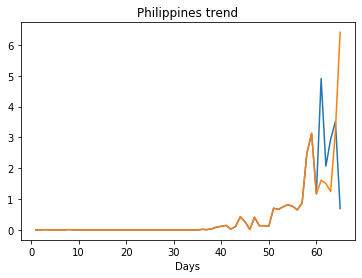

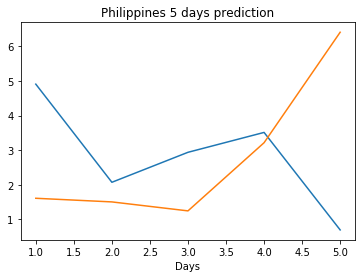

Creating directory ./offline5/Singapore/training/
Singapore
Saving the best model weights at Epoch [1], Best Valid Loss: 30.1469
Saving the best model weights at Epoch [2], Best Valid Loss: 20.2320


/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Saving the best model weights at Epoch [3], Best Valid Loss: 14.8953
Saving the best model weights at Epoch [4], Best Valid Loss: 8.4329
Saving the best model weights at Epoch [10], Best Valid Loss: 7.8997
Saving the best model weights at Epoch [24], Best Valid Loss: 7.8919
Saving the best model weights at Epoch [25], Best Valid Loss: 6.8523
Saving the best model weights at Epoch [44], Best Valid Loss: 6.7761
Saving the best model weights at Epoch [47], Best Valid Loss: 6.1448
train error: 4.203660873142448
6.144772529602051
Saving the best model weights at Epoch [1], Best Valid Loss: 46.1021
Saving the best model weights at Epoch [2], Best Valid Loss: 17.1849
Saving the best model weights at Epoch [4], Best Valid Loss: 10.0712
Saving the best model weights at Epoch [6], Best Valid Loss: 6.1965
Saving the best model weights at Epoch [15], Best Valid Loss: 5.4348
train error: 12.939909955939731
5.4347991943359375
Saving the best model weights at Epoch [1], Best Valid Loss: 49.3913
Savin

Saving the best model weights at Epoch [9], Best Valid Loss: 7.3036
Saving the best model weights at Epoch [10], Best Valid Loss: 4.7509
train error: 4.682446904681824
4.750885009765625
Saving the best model weights at Epoch [1], Best Valid Loss: 38.1650
Saving the best model weights at Epoch [3], Best Valid Loss: 13.1783
Saving the best model weights at Epoch [4], Best Valid Loss: 8.3474
train error: 12.836089391966123
8.34736442565918
Saving the best model weights at Epoch [1], Best Valid Loss: 38.4268
Saving the best model weights at Epoch [2], Best Valid Loss: 28.0343
Saving the best model weights at Epoch [3], Best Valid Loss: 23.0347
Saving the best model weights at Epoch [33], Best Valid Loss: 17.6296
train error: 12.713878837791649
17.62955665588379
Saving the best model weights at Epoch [1], Best Valid Loss: 38.6475
Saving the best model weights at Epoch [4], Best Valid Loss: 27.2581
Saving the best model weights at Epoch [9], Best Valid Loss: 24.0524
Saving the best model wei

Saving the best model weights at Epoch [2], Best Valid Loss: 34.9425
Saving the best model weights at Epoch [6], Best Valid Loss: 19.1180
Saving the best model weights at Epoch [16], Best Valid Loss: 16.3105
Saving the best model weights at Epoch [21], Best Valid Loss: 11.9050
Saving the best model weights at Epoch [22], Best Valid Loss: 9.6979
train error: 12.831427764248204
9.697896003723145
Saving the best model weights at Epoch [1], Best Valid Loss: 39.4592
Saving the best model weights at Epoch [3], Best Valid Loss: 31.1163
Saving the best model weights at Epoch [5], Best Valid Loss: 25.8026
Saving the best model weights at Epoch [7], Best Valid Loss: 20.6359
Saving the best model weights at Epoch [12], Best Valid Loss: 19.6724
Saving the best model weights at Epoch [15], Best Valid Loss: 9.5015
Saving the best model weights at Epoch [40], Best Valid Loss: 6.1775
train error: 12.275056988806337
6.177487850189209
Saving the best model weights at Epoch [1], Best Valid Loss: 30.1415


Saving the best model weights at Epoch [2], Best Valid Loss: 24.0564
Saving the best model weights at Epoch [4], Best Valid Loss: 4.4860
train error: 6.7131121154572515
4.486001491546631
Saving the best model weights at Epoch [1], Best Valid Loss: 19.9585
Saving the best model weights at Epoch [2], Best Valid Loss: 5.5975
Saving the best model weights at Epoch [27], Best Valid Loss: 4.9254
Saving the best model weights at Epoch [39], Best Valid Loss: 3.8091
train error: 20.273524886852986
3.809051513671875
Saving the best model weights at Epoch [1], Best Valid Loss: 37.8567
Saving the best model weights at Epoch [2], Best Valid Loss: 36.7339
Saving the best model weights at Epoch [4], Best Valid Loss: 36.2709
Saving the best model weights at Epoch [5], Best Valid Loss: 36.1029
Saving the best model weights at Epoch [6], Best Valid Loss: 29.5787
Saving the best model weights at Epoch [48], Best Valid Loss: 21.9931
train error: 12.639359646552318
21.993106842041016
Saving the best model 

Saving the best model weights at Epoch [2], Best Valid Loss: 39.0648
Saving the best model weights at Epoch [5], Best Valid Loss: 33.7698
Saving the best model weights at Epoch [6], Best Valid Loss: 32.4702
Saving the best model weights at Epoch [7], Best Valid Loss: 30.5199
Saving the best model weights at Epoch [8], Best Valid Loss: 7.3087
Saving the best model weights at Epoch [34], Best Valid Loss: 6.4578
Saving the best model weights at Epoch [35], Best Valid Loss: 5.1024
Saving the best model weights at Epoch [50], Best Valid Loss: 5.0875
train error: 2.992354589942339
5.087549686431885
Saving the best model weights at Epoch [1], Best Valid Loss: 37.1715
Saving the best model weights at Epoch [2], Best Valid Loss: 36.3466
Saving the best model weights at Epoch [3], Best Valid Loss: 33.0684
Saving the best model weights at Epoch [4], Best Valid Loss: 29.5212
Saving the best model weights at Epoch [5], Best Valid Loss: 28.6824
Saving the best model weights at Epoch [9], Best Valid 

Saving the best model weights at Epoch [35], Best Valid Loss: 6.0092
train error: 16.470874821817553
6.009185314178467
Saving the best model weights at Epoch [1], Best Valid Loss: 31.3929
Saving the best model weights at Epoch [9], Best Valid Loss: 30.9311
Saving the best model weights at Epoch [14], Best Valid Loss: 30.6193
Saving the best model weights at Epoch [41], Best Valid Loss: 28.8521
train error: 12.055875984398094
28.85210609436035
Saving the best model weights at Epoch [1], Best Valid Loss: 36.5333
Saving the best model weights at Epoch [2], Best Valid Loss: 34.7096
Saving the best model weights at Epoch [4], Best Valid Loss: 34.4631
Saving the best model weights at Epoch [6], Best Valid Loss: 29.3451
Saving the best model weights at Epoch [18], Best Valid Loss: 29.1337
train error: 12.405546330116891
29.133665084838867
Saving the best model weights at Epoch [1], Best Valid Loss: 46.8611
Saving the best model weights at Epoch [3], Best Valid Loss: 36.8168
Saving the best mo

Saving the best model weights at Epoch [40], Best Valid Loss: 5.8123
Saving the best model weights at Epoch [42], Best Valid Loss: 5.7829
train error: 3.926020753141996
5.782909393310547
Saving the best model weights at Epoch [1], Best Valid Loss: 53.5902
Saving the best model weights at Epoch [2], Best Valid Loss: 26.7022
Saving the best model weights at Epoch [3], Best Valid Loss: 14.7969
Saving the best model weights at Epoch [4], Best Valid Loss: 9.8688
Saving the best model weights at Epoch [5], Best Valid Loss: 7.6155
Saving the best model weights at Epoch [6], Best Valid Loss: 6.7795
Saving the best model weights at Epoch [7], Best Valid Loss: 6.4197
Saving the best model weights at Epoch [8], Best Valid Loss: 6.3055
Saving the best model weights at Epoch [9], Best Valid Loss: 6.2650
Saving the best model weights at Epoch [14], Best Valid Loss: 6.2245
Saving the best model weights at Epoch [16], Best Valid Loss: 5.8710
Saving the best model weights at Epoch [18], Best Valid Loss

Saving the best model weights at Epoch [15], Best Valid Loss: 9.9219
Saving the best model weights at Epoch [16], Best Valid Loss: 9.1342
Saving the best model weights at Epoch [17], Best Valid Loss: 8.2688
Saving the best model weights at Epoch [18], Best Valid Loss: 7.6868
Saving the best model weights at Epoch [19], Best Valid Loss: 7.3945
Saving the best model weights at Epoch [20], Best Valid Loss: 7.1286
Saving the best model weights at Epoch [21], Best Valid Loss: 7.0144
Saving the best model weights at Epoch [22], Best Valid Loss: 6.7347
Saving the best model weights at Epoch [25], Best Valid Loss: 6.6723
Saving the best model weights at Epoch [31], Best Valid Loss: 6.5750
Saving the best model weights at Epoch [32], Best Valid Loss: 6.3758
Saving the best model weights at Epoch [33], Best Valid Loss: 6.2997
Saving the best model weights at Epoch [34], Best Valid Loss: 6.2509
Saving the best model weights at Epoch [35], Best Valid Loss: 6.2072
Saving the best model weights at E

Saving the best model weights at Epoch [9], Best Valid Loss: 8.3256
Saving the best model weights at Epoch [10], Best Valid Loss: 7.1613
Saving the best model weights at Epoch [11], Best Valid Loss: 6.4877
Saving the best model weights at Epoch [12], Best Valid Loss: 6.1481
Saving the best model weights at Epoch [15], Best Valid Loss: 6.0772
train error: 1.5745508986953143
6.077239513397217
Saving the best model weights at Epoch [1], Best Valid Loss: 61.9810
Saving the best model weights at Epoch [2], Best Valid Loss: 48.3179
Saving the best model weights at Epoch [3], Best Valid Loss: 34.8022
Saving the best model weights at Epoch [4], Best Valid Loss: 19.8852
Saving the best model weights at Epoch [5], Best Valid Loss: 11.6017
Saving the best model weights at Epoch [6], Best Valid Loss: 7.2640
Saving the best model weights at Epoch [8], Best Valid Loss: 6.4012
Saving the best model weights at Epoch [9], Best Valid Loss: 6.3788
Saving the best model weights at Epoch [10], Best Valid L

Saving the best model weights at Epoch [14], Best Valid Loss: 36.7962
Saving the best model weights at Epoch [15], Best Valid Loss: 36.4568
Saving the best model weights at Epoch [16], Best Valid Loss: 35.9884
Saving the best model weights at Epoch [17], Best Valid Loss: 35.6640
Saving the best model weights at Epoch [18], Best Valid Loss: 35.4261
Saving the best model weights at Epoch [19], Best Valid Loss: 35.2742
Saving the best model weights at Epoch [20], Best Valid Loss: 35.0615
Saving the best model weights at Epoch [21], Best Valid Loss: 34.8711
Saving the best model weights at Epoch [22], Best Valid Loss: 34.8166
Saving the best model weights at Epoch [25], Best Valid Loss: 34.7583
Saving the best model weights at Epoch [26], Best Valid Loss: 34.6914
Saving the best model weights at Epoch [28], Best Valid Loss: 34.5628
Saving the best model weights at Epoch [29], Best Valid Loss: 34.4953
Saving the best model weights at Epoch [30], Best Valid Loss: 34.4567
Saving the best mode

Saving the best model weights at Epoch [40], Best Valid Loss: 7.0668
train error: 13.080936472158175
7.0667572021484375
Saving the best model weights at Epoch [1], Best Valid Loss: 67.1688
Saving the best model weights at Epoch [2], Best Valid Loss: 60.7058
Saving the best model weights at Epoch [3], Best Valid Loss: 55.3795
Saving the best model weights at Epoch [4], Best Valid Loss: 50.9219
Saving the best model weights at Epoch [5], Best Valid Loss: 47.2200
Saving the best model weights at Epoch [6], Best Valid Loss: 44.2491
Saving the best model weights at Epoch [7], Best Valid Loss: 41.7829
Saving the best model weights at Epoch [8], Best Valid Loss: 39.9008
Saving the best model weights at Epoch [9], Best Valid Loss: 38.4818
Saving the best model weights at Epoch [10], Best Valid Loss: 37.1798
Saving the best model weights at Epoch [11], Best Valid Loss: 36.2360
Saving the best model weights at Epoch [12], Best Valid Loss: 35.3555
Saving the best model weights at Epoch [13], Best

Saving the best model weights at Epoch [12], Best Valid Loss: 35.1350
Saving the best model weights at Epoch [13], Best Valid Loss: 34.2543
Saving the best model weights at Epoch [14], Best Valid Loss: 33.3335
Saving the best model weights at Epoch [15], Best Valid Loss: 32.7616
Saving the best model weights at Epoch [16], Best Valid Loss: 31.8376
Saving the best model weights at Epoch [17], Best Valid Loss: 30.2134
Saving the best model weights at Epoch [18], Best Valid Loss: 27.6230
Saving the best model weights at Epoch [19], Best Valid Loss: 24.1828
Saving the best model weights at Epoch [20], Best Valid Loss: 19.6587
Saving the best model weights at Epoch [21], Best Valid Loss: 14.5896
Saving the best model weights at Epoch [22], Best Valid Loss: 10.4969
Saving the best model weights at Epoch [23], Best Valid Loss: 8.2823
Saving the best model weights at Epoch [24], Best Valid Loss: 7.1872
Saving the best model weights at Epoch [25], Best Valid Loss: 6.5285
Saving the best model w

Saving the best model weights at Epoch [4], Best Valid Loss: 40.9346
Saving the best model weights at Epoch [5], Best Valid Loss: 37.2259
Saving the best model weights at Epoch [6], Best Valid Loss: 34.4091
Saving the best model weights at Epoch [7], Best Valid Loss: 32.4725
Saving the best model weights at Epoch [8], Best Valid Loss: 27.8746
Saving the best model weights at Epoch [9], Best Valid Loss: 17.8055
Saving the best model weights at Epoch [10], Best Valid Loss: 8.5942
Saving the best model weights at Epoch [11], Best Valid Loss: 6.2915
Saving the best model weights at Epoch [14], Best Valid Loss: 6.2818
Saving the best model weights at Epoch [15], Best Valid Loss: 6.2592
Saving the best model weights at Epoch [17], Best Valid Loss: 6.0712
Saving the best model weights at Epoch [18], Best Valid Loss: 5.7204
train error: 1.6919363880076923
5.720354080200195
Saving the best model weights at Epoch [1], Best Valid Loss: 56.5747
Saving the best model weights at Epoch [2], Best Vali

Saving the best model weights at Epoch [6], Best Valid Loss: 31.9860
Saving the best model weights at Epoch [8], Best Valid Loss: 31.7961
train error: 11.969723598377124
31.796051025390625
Saving the best model weights at Epoch [1], Best Valid Loss: 65.8035
Saving the best model weights at Epoch [2], Best Valid Loss: 58.9909
Saving the best model weights at Epoch [3], Best Valid Loss: 53.2239
Saving the best model weights at Epoch [4], Best Valid Loss: 48.7442
Saving the best model weights at Epoch [5], Best Valid Loss: 45.0121
Saving the best model weights at Epoch [6], Best Valid Loss: 42.2411
Saving the best model weights at Epoch [7], Best Valid Loss: 40.1950
Saving the best model weights at Epoch [8], Best Valid Loss: 38.3688
Saving the best model weights at Epoch [9], Best Valid Loss: 37.0910
Saving the best model weights at Epoch [10], Best Valid Loss: 36.1867
Saving the best model weights at Epoch [11], Best Valid Loss: 35.7384
Saving the best model weights at Epoch [12], Best 

Saving the best model weights at Epoch [19], Best Valid Loss: 34.9038
Saving the best model weights at Epoch [21], Best Valid Loss: 34.8109
Saving the best model weights at Epoch [22], Best Valid Loss: 34.6616
Saving the best model weights at Epoch [24], Best Valid Loss: 34.6121
Saving the best model weights at Epoch [25], Best Valid Loss: 34.3478
Saving the best model weights at Epoch [29], Best Valid Loss: 34.2764
Saving the best model weights at Epoch [30], Best Valid Loss: 34.2536
Saving the best model weights at Epoch [31], Best Valid Loss: 34.2530
Saving the best model weights at Epoch [44], Best Valid Loss: 34.2070
train error: 11.890561450172115
34.20698547363281
Saving the best model weights at Epoch [1], Best Valid Loss: 66.1926
Saving the best model weights at Epoch [2], Best Valid Loss: 58.3945
Saving the best model weights at Epoch [3], Best Valid Loss: 51.9007
Saving the best model weights at Epoch [4], Best Valid Loss: 47.1094
Saving the best model weights at Epoch [5], 

Saving the best model weights at Epoch [36], Best Valid Loss: 34.3011
Saving the best model weights at Epoch [37], Best Valid Loss: 34.2019
Saving the best model weights at Epoch [38], Best Valid Loss: 34.1144
Saving the best model weights at Epoch [39], Best Valid Loss: 34.0480
Saving the best model weights at Epoch [40], Best Valid Loss: 33.7829
Saving the best model weights at Epoch [42], Best Valid Loss: 33.4906
Saving the best model weights at Epoch [44], Best Valid Loss: 33.3878
Saving the best model weights at Epoch [45], Best Valid Loss: 32.7943
Saving the best model weights at Epoch [46], Best Valid Loss: 32.7672
Saving the best model weights at Epoch [49], Best Valid Loss: 32.5620
Saving the best model weights at Epoch [50], Best Valid Loss: 32.5024
train error: 11.532188529903824
32.50240707397461
Saving the best model weights at Epoch [1], Best Valid Loss: 65.6967
Saving the best model weights at Epoch [2], Best Valid Loss: 57.9199
Saving the best model weights at Epoch [3]

Saving the best model weights at Epoch [4], Best Valid Loss: 47.7975
Saving the best model weights at Epoch [5], Best Valid Loss: 44.3169
Saving the best model weights at Epoch [6], Best Valid Loss: 41.8313
Saving the best model weights at Epoch [7], Best Valid Loss: 39.3859
Saving the best model weights at Epoch [8], Best Valid Loss: 37.7459
Saving the best model weights at Epoch [9], Best Valid Loss: 36.9980
Saving the best model weights at Epoch [10], Best Valid Loss: 36.2411
Saving the best model weights at Epoch [11], Best Valid Loss: 35.9599
Saving the best model weights at Epoch [12], Best Valid Loss: 35.3728
Saving the best model weights at Epoch [14], Best Valid Loss: 35.2597
Saving the best model weights at Epoch [15], Best Valid Loss: 35.0206
Saving the best model weights at Epoch [17], Best Valid Loss: 34.9033
Saving the best model weights at Epoch [18], Best Valid Loss: 34.6908
Saving the best model weights at Epoch [20], Best Valid Loss: 34.4969
Saving the best model weig

Saving the best model weights at Epoch [6], Best Valid Loss: 45.4284
Saving the best model weights at Epoch [7], Best Valid Loss: 42.9547
Saving the best model weights at Epoch [8], Best Valid Loss: 41.1493
Saving the best model weights at Epoch [9], Best Valid Loss: 39.4091
Saving the best model weights at Epoch [10], Best Valid Loss: 38.2118
Saving the best model weights at Epoch [11], Best Valid Loss: 37.3656
Saving the best model weights at Epoch [12], Best Valid Loss: 36.7257
Saving the best model weights at Epoch [13], Best Valid Loss: 36.0709
Saving the best model weights at Epoch [14], Best Valid Loss: 35.6710
Saving the best model weights at Epoch [15], Best Valid Loss: 35.5324
Saving the best model weights at Epoch [16], Best Valid Loss: 35.3657
Saving the best model weights at Epoch [17], Best Valid Loss: 35.1154
Saving the best model weights at Epoch [18], Best Valid Loss: 34.8941
Saving the best model weights at Epoch [19], Best Valid Loss: 34.8311
Saving the best model we

Saving the best model weights at Epoch [2], Best Valid Loss: 45.5031
Saving the best model weights at Epoch [3], Best Valid Loss: 38.6660
Saving the best model weights at Epoch [4], Best Valid Loss: 36.3182
Saving the best model weights at Epoch [5], Best Valid Loss: 33.9603
Saving the best model weights at Epoch [6], Best Valid Loss: 33.8907
Saving the best model weights at Epoch [9], Best Valid Loss: 33.7186
Saving the best model weights at Epoch [26], Best Valid Loss: 33.2516
train error: 11.984667921388471
33.251617431640625
Saving the best model weights at Epoch [1], Best Valid Loss: 42.9109
Saving the best model weights at Epoch [2], Best Valid Loss: 35.9759
Saving the best model weights at Epoch [4], Best Valid Loss: 35.0314
Saving the best model weights at Epoch [5], Best Valid Loss: 34.3937
Saving the best model weights at Epoch [7], Best Valid Loss: 33.1625
Saving the best model weights at Epoch [22], Best Valid Loss: 33.0426
Saving the best model weights at Epoch [26], Best 

Saving the best model weights at Epoch [1], Best Valid Loss: 72.5315
Saving the best model weights at Epoch [2], Best Valid Loss: 69.1293
Saving the best model weights at Epoch [3], Best Valid Loss: 65.5165
Saving the best model weights at Epoch [4], Best Valid Loss: 61.8802
Saving the best model weights at Epoch [5], Best Valid Loss: 57.5315
Saving the best model weights at Epoch [6], Best Valid Loss: 53.4893
Saving the best model weights at Epoch [7], Best Valid Loss: 49.9893
Saving the best model weights at Epoch [8], Best Valid Loss: 46.8665
Saving the best model weights at Epoch [9], Best Valid Loss: 43.7675
Saving the best model weights at Epoch [10], Best Valid Loss: 40.9949
Saving the best model weights at Epoch [11], Best Valid Loss: 38.4962
Saving the best model weights at Epoch [12], Best Valid Loss: 35.8806
Saving the best model weights at Epoch [13], Best Valid Loss: 33.6584
Saving the best model weights at Epoch [14], Best Valid Loss: 31.5950
Saving the best model weights

Saving the best model weights at Epoch [20], Best Valid Loss: 6.4702
Saving the best model weights at Epoch [21], Best Valid Loss: 6.3299
Saving the best model weights at Epoch [23], Best Valid Loss: 6.3139
Saving the best model weights at Epoch [24], Best Valid Loss: 6.2246
Saving the best model weights at Epoch [30], Best Valid Loss: 6.1962
Saving the best model weights at Epoch [49], Best Valid Loss: 6.1073
train error: 1.4361858652854287
6.107293128967285
Saving the best model weights at Epoch [1], Best Valid Loss: 75.9564
Saving the best model weights at Epoch [2], Best Valid Loss: 72.8116
Saving the best model weights at Epoch [3], Best Valid Loss: 69.5081
Saving the best model weights at Epoch [4], Best Valid Loss: 66.6927
Saving the best model weights at Epoch [5], Best Valid Loss: 63.6647
Saving the best model weights at Epoch [6], Best Valid Loss: 60.3314
Saving the best model weights at Epoch [7], Best Valid Loss: 56.8233
Saving the best model weights at Epoch [8], Best Vali

Saving the best model weights at Epoch [11], Best Valid Loss: 23.3653
Saving the best model weights at Epoch [12], Best Valid Loss: 20.4699
Saving the best model weights at Epoch [13], Best Valid Loss: 18.4153
Saving the best model weights at Epoch [14], Best Valid Loss: 16.5293
Saving the best model weights at Epoch [15], Best Valid Loss: 14.9587
Saving the best model weights at Epoch [16], Best Valid Loss: 13.6204
Saving the best model weights at Epoch [17], Best Valid Loss: 12.4910
Saving the best model weights at Epoch [18], Best Valid Loss: 11.5268
Saving the best model weights at Epoch [19], Best Valid Loss: 10.8238
Saving the best model weights at Epoch [20], Best Valid Loss: 10.0426
Saving the best model weights at Epoch [21], Best Valid Loss: 9.4043
Saving the best model weights at Epoch [22], Best Valid Loss: 8.8714
Saving the best model weights at Epoch [23], Best Valid Loss: 8.5028
Saving the best model weights at Epoch [24], Best Valid Loss: 8.1170
Saving the best model we

Saving the best model weights at Epoch [12], Best Valid Loss: 21.9484
Saving the best model weights at Epoch [13], Best Valid Loss: 19.3391
Saving the best model weights at Epoch [14], Best Valid Loss: 17.1372
Saving the best model weights at Epoch [15], Best Valid Loss: 15.1985
Saving the best model weights at Epoch [16], Best Valid Loss: 13.6417
Saving the best model weights at Epoch [17], Best Valid Loss: 12.3520
Saving the best model weights at Epoch [18], Best Valid Loss: 11.2331
Saving the best model weights at Epoch [19], Best Valid Loss: 10.3198
Saving the best model weights at Epoch [20], Best Valid Loss: 9.5345
Saving the best model weights at Epoch [21], Best Valid Loss: 8.8818
Saving the best model weights at Epoch [22], Best Valid Loss: 8.3324
Saving the best model weights at Epoch [23], Best Valid Loss: 7.8487
Saving the best model weights at Epoch [24], Best Valid Loss: 7.4819
Saving the best model weights at Epoch [25], Best Valid Loss: 7.1743
Saving the best model weig

Saving the best model weights at Epoch [6], Best Valid Loss: 18.2439
Saving the best model weights at Epoch [7], Best Valid Loss: 13.0861
Saving the best model weights at Epoch [8], Best Valid Loss: 9.7999
Saving the best model weights at Epoch [9], Best Valid Loss: 7.9892
Saving the best model weights at Epoch [10], Best Valid Loss: 6.9667
Saving the best model weights at Epoch [11], Best Valid Loss: 6.3626
Saving the best model weights at Epoch [12], Best Valid Loss: 6.0589
Saving the best model weights at Epoch [13], Best Valid Loss: 5.9970
train error: 1.7057199288864393
5.996963024139404
Saving the best model weights at Epoch [1], Best Valid Loss: 63.2867
Saving the best model weights at Epoch [2], Best Valid Loss: 44.2142
Saving the best model weights at Epoch [3], Best Valid Loss: 26.5448
Saving the best model weights at Epoch [4], Best Valid Loss: 13.7562
Saving the best model weights at Epoch [5], Best Valid Loss: 8.7724
Saving the best model weights at Epoch [6], Best Valid L

Saving the best model weights at Epoch [43], Best Valid Loss: 44.1277
Saving the best model weights at Epoch [44], Best Valid Loss: 43.6133
Saving the best model weights at Epoch [45], Best Valid Loss: 43.1421
Saving the best model weights at Epoch [46], Best Valid Loss: 42.6528
Saving the best model weights at Epoch [47], Best Valid Loss: 42.1773
Saving the best model weights at Epoch [48], Best Valid Loss: 41.7189
Saving the best model weights at Epoch [49], Best Valid Loss: 41.2571
Saving the best model weights at Epoch [50], Best Valid Loss: 40.7595
train error: 11.853740328067058
40.75946807861328
Saving the best model weights at Epoch [1], Best Valid Loss: 73.1115
Saving the best model weights at Epoch [2], Best Valid Loss: 71.5387
Saving the best model weights at Epoch [3], Best Valid Loss: 69.8522
Saving the best model weights at Epoch [4], Best Valid Loss: 68.3455
Saving the best model weights at Epoch [5], Best Valid Loss: 66.8951
Saving the best model weights at Epoch [6], B

Saving the best model weights at Epoch [10], Best Valid Loss: 31.6837
Saving the best model weights at Epoch [11], Best Valid Loss: 28.5714
Saving the best model weights at Epoch [12], Best Valid Loss: 24.9410
Saving the best model weights at Epoch [13], Best Valid Loss: 21.5472
Saving the best model weights at Epoch [14], Best Valid Loss: 18.0062
Saving the best model weights at Epoch [15], Best Valid Loss: 15.6138
Saving the best model weights at Epoch [16], Best Valid Loss: 13.5043
Saving the best model weights at Epoch [17], Best Valid Loss: 11.9531
Saving the best model weights at Epoch [18], Best Valid Loss: 10.5031
Saving the best model weights at Epoch [19], Best Valid Loss: 9.7589
Saving the best model weights at Epoch [20], Best Valid Loss: 8.8939
Saving the best model weights at Epoch [22], Best Valid Loss: 7.9318
Saving the best model weights at Epoch [23], Best Valid Loss: 7.6475
Saving the best model weights at Epoch [24], Best Valid Loss: 7.5220
Saving the best model wei

Saving the best model weights at Epoch [47], Best Valid Loss: 27.9666
Saving the best model weights at Epoch [48], Best Valid Loss: 27.1079
Saving the best model weights at Epoch [49], Best Valid Loss: 26.1680
Saving the best model weights at Epoch [50], Best Valid Loss: 25.2585
train error: 8.249675270673391
25.258468627929688
Saving the best model weights at Epoch [1], Best Valid Loss: 73.6786
Saving the best model weights at Epoch [2], Best Valid Loss: 72.1728
Saving the best model weights at Epoch [3], Best Valid Loss: 70.6078
Saving the best model weights at Epoch [4], Best Valid Loss: 69.1818
Saving the best model weights at Epoch [5], Best Valid Loss: 67.7332
Saving the best model weights at Epoch [6], Best Valid Loss: 66.3405
Saving the best model weights at Epoch [7], Best Valid Loss: 65.0452
Saving the best model weights at Epoch [8], Best Valid Loss: 63.6261
Saving the best model weights at Epoch [9], Best Valid Loss: 62.3337
Saving the best model weights at Epoch [10], Best

Saving the best model weights at Epoch [15], Best Valid Loss: 6.6267
Saving the best model weights at Epoch [16], Best Valid Loss: 6.3580
Saving the best model weights at Epoch [18], Best Valid Loss: 6.1693
Saving the best model weights at Epoch [22], Best Valid Loss: 6.0429
Saving the best model weights at Epoch [26], Best Valid Loss: 5.9902
Saving the best model weights at Epoch [35], Best Valid Loss: 5.8984
Saving the best model weights at Epoch [48], Best Valid Loss: 5.8806
train error: 1.6376185795745335
5.880609035491943
Saving the best model weights at Epoch [1], Best Valid Loss: 74.5011
Saving the best model weights at Epoch [2], Best Valid Loss: 73.5333
Saving the best model weights at Epoch [3], Best Valid Loss: 72.5960
Saving the best model weights at Epoch [4], Best Valid Loss: 71.6592
Saving the best model weights at Epoch [5], Best Valid Loss: 70.7500
Saving the best model weights at Epoch [6], Best Valid Loss: 69.8414
Saving the best model weights at Epoch [7], Best Vali

Saving the best model weights at Epoch [12], Best Valid Loss: 58.0942
Saving the best model weights at Epoch [13], Best Valid Loss: 56.5662
Saving the best model weights at Epoch [14], Best Valid Loss: 54.9627
Saving the best model weights at Epoch [15], Best Valid Loss: 53.3103
Saving the best model weights at Epoch [16], Best Valid Loss: 51.5475
Saving the best model weights at Epoch [17], Best Valid Loss: 49.8290
Saving the best model weights at Epoch [18], Best Valid Loss: 48.1464
Saving the best model weights at Epoch [19], Best Valid Loss: 46.1130
Saving the best model weights at Epoch [20], Best Valid Loss: 44.1981
Saving the best model weights at Epoch [21], Best Valid Loss: 42.3700
Saving the best model weights at Epoch [22], Best Valid Loss: 40.2193
Saving the best model weights at Epoch [23], Best Valid Loss: 38.2293
Saving the best model weights at Epoch [24], Best Valid Loss: 36.2327
Saving the best model weights at Epoch [25], Best Valid Loss: 34.2671
Saving the best mode

Saving the best model weights at Epoch [27], Best Valid Loss: 48.4334
Saving the best model weights at Epoch [28], Best Valid Loss: 47.0160
Saving the best model weights at Epoch [29], Best Valid Loss: 45.5594
Saving the best model weights at Epoch [30], Best Valid Loss: 44.0669
Saving the best model weights at Epoch [31], Best Valid Loss: 42.5504
Saving the best model weights at Epoch [32], Best Valid Loss: 40.9756
Saving the best model weights at Epoch [33], Best Valid Loss: 39.3871
Saving the best model weights at Epoch [34], Best Valid Loss: 37.7701
Saving the best model weights at Epoch [35], Best Valid Loss: 36.1470
Saving the best model weights at Epoch [36], Best Valid Loss: 34.5180
Saving the best model weights at Epoch [37], Best Valid Loss: 32.8885
Saving the best model weights at Epoch [38], Best Valid Loss: 31.2763
Saving the best model weights at Epoch [39], Best Valid Loss: 29.6869
Saving the best model weights at Epoch [40], Best Valid Loss: 28.1147
Saving the best mode

Saving the best model weights at Epoch [6], Best Valid Loss: 57.7625
Saving the best model weights at Epoch [7], Best Valid Loss: 54.2357
Saving the best model weights at Epoch [8], Best Valid Loss: 50.2535
Saving the best model weights at Epoch [9], Best Valid Loss: 45.7271
Saving the best model weights at Epoch [10], Best Valid Loss: 40.7327
Saving the best model weights at Epoch [11], Best Valid Loss: 35.6736
Saving the best model weights at Epoch [12], Best Valid Loss: 30.7015
Saving the best model weights at Epoch [13], Best Valid Loss: 26.3390
Saving the best model weights at Epoch [14], Best Valid Loss: 21.3053
Saving the best model weights at Epoch [15], Best Valid Loss: 17.5110
Saving the best model weights at Epoch [16], Best Valid Loss: 14.6100
Saving the best model weights at Epoch [17], Best Valid Loss: 11.8991
Saving the best model weights at Epoch [18], Best Valid Loss: 9.8305
Saving the best model weights at Epoch [19], Best Valid Loss: 8.3212
Saving the best model weig

Saving the best model weights at Epoch [40], Best Valid Loss: 47.3316
Saving the best model weights at Epoch [41], Best Valid Loss: 46.9584
Saving the best model weights at Epoch [42], Best Valid Loss: 46.5811
Saving the best model weights at Epoch [43], Best Valid Loss: 46.2319
Saving the best model weights at Epoch [44], Best Valid Loss: 45.8712
Saving the best model weights at Epoch [45], Best Valid Loss: 45.5450
Saving the best model weights at Epoch [46], Best Valid Loss: 45.2007
Saving the best model weights at Epoch [47], Best Valid Loss: 44.8591
Saving the best model weights at Epoch [48], Best Valid Loss: 44.5568
Saving the best model weights at Epoch [49], Best Valid Loss: 44.2345
Saving the best model weights at Epoch [50], Best Valid Loss: 43.9263
train error: 12.541636199564547
43.926273345947266
Saving the best model weights at Epoch [1], Best Valid Loss: 72.2368
Saving the best model weights at Epoch [2], Best Valid Loss: 70.7757
Saving the best model weights at Epoch [3

Saving the best model weights at Epoch [6], Best Valid Loss: 48.4433
Saving the best model weights at Epoch [7], Best Valid Loss: 45.4906
Saving the best model weights at Epoch [8], Best Valid Loss: 43.4564
Saving the best model weights at Epoch [9], Best Valid Loss: 41.8265
Saving the best model weights at Epoch [10], Best Valid Loss: 40.6612
Saving the best model weights at Epoch [11], Best Valid Loss: 38.9165
Saving the best model weights at Epoch [12], Best Valid Loss: 38.3533
Saving the best model weights at Epoch [13], Best Valid Loss: 37.3016
Saving the best model weights at Epoch [15], Best Valid Loss: 36.4268
Saving the best model weights at Epoch [16], Best Valid Loss: 35.6895
Saving the best model weights at Epoch [18], Best Valid Loss: 35.2250
Saving the best model weights at Epoch [19], Best Valid Loss: 34.7830
Saving the best model weights at Epoch [20], Best Valid Loss: 34.6795
Saving the best model weights at Epoch [21], Best Valid Loss: 34.3282
Saving the best model we

Saving the best model weights at Epoch [34], Best Valid Loss: 49.9983
Saving the best model weights at Epoch [35], Best Valid Loss: 49.5490
Saving the best model weights at Epoch [36], Best Valid Loss: 49.0858
Saving the best model weights at Epoch [37], Best Valid Loss: 48.6417
Saving the best model weights at Epoch [38], Best Valid Loss: 48.1872
Saving the best model weights at Epoch [39], Best Valid Loss: 47.7792
Saving the best model weights at Epoch [40], Best Valid Loss: 47.3557
Saving the best model weights at Epoch [41], Best Valid Loss: 46.9264
Saving the best model weights at Epoch [42], Best Valid Loss: 46.5361
Saving the best model weights at Epoch [43], Best Valid Loss: 46.1584
Saving the best model weights at Epoch [44], Best Valid Loss: 45.7949
Saving the best model weights at Epoch [45], Best Valid Loss: 45.4054
Saving the best model weights at Epoch [46], Best Valid Loss: 45.0696
Saving the best model weights at Epoch [47], Best Valid Loss: 44.7060
Saving the best mode

Saving the best model weights at Epoch [1], Best Valid Loss: 69.9623
Saving the best model weights at Epoch [2], Best Valid Loss: 63.5304
Saving the best model weights at Epoch [3], Best Valid Loss: 58.2591
Saving the best model weights at Epoch [4], Best Valid Loss: 54.0231
Saving the best model weights at Epoch [5], Best Valid Loss: 49.7733
Saving the best model weights at Epoch [6], Best Valid Loss: 46.2898
Saving the best model weights at Epoch [7], Best Valid Loss: 44.4499
Saving the best model weights at Epoch [8], Best Valid Loss: 42.0930
Saving the best model weights at Epoch [9], Best Valid Loss: 40.3195
Saving the best model weights at Epoch [10], Best Valid Loss: 38.7975
Saving the best model weights at Epoch [11], Best Valid Loss: 37.3398
Saving the best model weights at Epoch [12], Best Valid Loss: 36.7683
Saving the best model weights at Epoch [13], Best Valid Loss: 36.1324
Saving the best model weights at Epoch [14], Best Valid Loss: 35.1259
Saving the best model weights

Saving the best model weights at Epoch [28], Best Valid Loss: 53.3544
Saving the best model weights at Epoch [29], Best Valid Loss: 52.7905
Saving the best model weights at Epoch [30], Best Valid Loss: 52.2421
Saving the best model weights at Epoch [31], Best Valid Loss: 51.7408
Saving the best model weights at Epoch [32], Best Valid Loss: 51.2178
Saving the best model weights at Epoch [33], Best Valid Loss: 50.7172
Saving the best model weights at Epoch [34], Best Valid Loss: 50.2175
Saving the best model weights at Epoch [35], Best Valid Loss: 49.7212
Saving the best model weights at Epoch [36], Best Valid Loss: 49.2684
Saving the best model weights at Epoch [37], Best Valid Loss: 48.7962
Saving the best model weights at Epoch [38], Best Valid Loss: 48.3478
Saving the best model weights at Epoch [39], Best Valid Loss: 47.9062
Saving the best model weights at Epoch [40], Best Valid Loss: 47.4847
Saving the best model weights at Epoch [41], Best Valid Loss: 47.0703
Saving the best mode

Saving the best model weights at Epoch [45], Best Valid Loss: 32.0166
Saving the best model weights at Epoch [46], Best Valid Loss: 31.5625
Saving the best model weights at Epoch [47], Best Valid Loss: 31.0843
Saving the best model weights at Epoch [48], Best Valid Loss: 30.7022
Saving the best model weights at Epoch [49], Best Valid Loss: 30.3707
Saving the best model weights at Epoch [50], Best Valid Loss: 29.4782
train error: 10.6205871234069
29.478214263916016
Saving the best model weights at Epoch [1], Best Valid Loss: 70.5151
Saving the best model weights at Epoch [2], Best Valid Loss: 63.2555
Saving the best model weights at Epoch [3], Best Valid Loss: 58.0674
Saving the best model weights at Epoch [4], Best Valid Loss: 53.6882
Saving the best model weights at Epoch [5], Best Valid Loss: 49.1495
Saving the best model weights at Epoch [6], Best Valid Loss: 45.8447
Saving the best model weights at Epoch [7], Best Valid Loss: 42.7817
Saving the best model weights at Epoch [8], Best

Saving the best model weights at Epoch [33], Best Valid Loss: 49.5394
Saving the best model weights at Epoch [34], Best Valid Loss: 48.9504
Saving the best model weights at Epoch [35], Best Valid Loss: 48.4373
Saving the best model weights at Epoch [36], Best Valid Loss: 47.8951
Saving the best model weights at Epoch [37], Best Valid Loss: 47.3563
Saving the best model weights at Epoch [38], Best Valid Loss: 46.8213
Saving the best model weights at Epoch [39], Best Valid Loss: 46.3205
Saving the best model weights at Epoch [40], Best Valid Loss: 45.8533
Saving the best model weights at Epoch [41], Best Valid Loss: 45.3579
Saving the best model weights at Epoch [42], Best Valid Loss: 44.8670
Saving the best model weights at Epoch [43], Best Valid Loss: 44.4231
Saving the best model weights at Epoch [44], Best Valid Loss: 43.9845
Saving the best model weights at Epoch [45], Best Valid Loss: 43.5190
Saving the best model weights at Epoch [46], Best Valid Loss: 43.0842
Saving the best mode

Saving the best model weights at Epoch [50], Best Valid Loss: 26.5290
train error: 10.00299785910426
26.52900505065918
Saving the best model weights at Epoch [1], Best Valid Loss: 70.9630
Saving the best model weights at Epoch [2], Best Valid Loss: 63.6778
Saving the best model weights at Epoch [3], Best Valid Loss: 58.4750
Saving the best model weights at Epoch [4], Best Valid Loss: 53.4922
Saving the best model weights at Epoch [5], Best Valid Loss: 50.0883
Saving the best model weights at Epoch [6], Best Valid Loss: 45.3528
Saving the best model weights at Epoch [7], Best Valid Loss: 42.5581
Saving the best model weights at Epoch [8], Best Valid Loss: 40.5640
Saving the best model weights at Epoch [9], Best Valid Loss: 38.3870
Saving the best model weights at Epoch [10], Best Valid Loss: 35.8098
Saving the best model weights at Epoch [11], Best Valid Loss: 34.1296
Saving the best model weights at Epoch [12], Best Valid Loss: 33.0374
Saving the best model weights at Epoch [13], Best 

Saving the best model weights at Epoch [44], Best Valid Loss: 45.1797
Saving the best model weights at Epoch [45], Best Valid Loss: 44.8149
Saving the best model weights at Epoch [46], Best Valid Loss: 44.4214
Saving the best model weights at Epoch [47], Best Valid Loss: 44.0588
Saving the best model weights at Epoch [48], Best Valid Loss: 43.7207
Saving the best model weights at Epoch [49], Best Valid Loss: 43.3720
Saving the best model weights at Epoch [50], Best Valid Loss: 43.0416
train error: 12.420076218811241
43.0416145324707
Saving the best model weights at Epoch [1], Best Valid Loss: 75.1178
Saving the best model weights at Epoch [2], Best Valid Loss: 73.4943
Saving the best model weights at Epoch [3], Best Valid Loss: 72.0021
Saving the best model weights at Epoch [4], Best Valid Loss: 70.4680
Saving the best model weights at Epoch [5], Best Valid Loss: 69.1490
Saving the best model weights at Epoch [6], Best Valid Loss: 67.7872
Saving the best model weights at Epoch [7], Bes

Saving the best model weights at Epoch [12], Best Valid Loss: 37.0212
Saving the best model weights at Epoch [13], Best Valid Loss: 36.0896
Saving the best model weights at Epoch [14], Best Valid Loss: 35.6907
Saving the best model weights at Epoch [15], Best Valid Loss: 35.2790
Saving the best model weights at Epoch [16], Best Valid Loss: 35.0046
Saving the best model weights at Epoch [17], Best Valid Loss: 34.9948
Saving the best model weights at Epoch [19], Best Valid Loss: 34.9041
Saving the best model weights at Epoch [20], Best Valid Loss: 34.8957
Saving the best model weights at Epoch [22], Best Valid Loss: 34.4061
Saving the best model weights at Epoch [26], Best Valid Loss: 33.7484
train error: 11.855401902585417
33.74843215942383
Saving the best model weights at Epoch [1], Best Valid Loss: 73.4325
Saving the best model weights at Epoch [2], Best Valid Loss: 72.5998
Saving the best model weights at Epoch [3], Best Valid Loss: 71.7895
Saving the best model weights at Epoch [4],

Saving the best model weights at Epoch [8], Best Valid Loss: 64.6907
Saving the best model weights at Epoch [9], Best Valid Loss: 63.5668
Saving the best model weights at Epoch [10], Best Valid Loss: 62.3958
Saving the best model weights at Epoch [11], Best Valid Loss: 61.3316
Saving the best model weights at Epoch [12], Best Valid Loss: 60.2517
Saving the best model weights at Epoch [13], Best Valid Loss: 59.2088
Saving the best model weights at Epoch [14], Best Valid Loss: 58.2386
Saving the best model weights at Epoch [15], Best Valid Loss: 57.2423
Saving the best model weights at Epoch [16], Best Valid Loss: 56.3315
Saving the best model weights at Epoch [17], Best Valid Loss: 55.4987
Saving the best model weights at Epoch [18], Best Valid Loss: 54.5580
Saving the best model weights at Epoch [19], Best Valid Loss: 53.6821
Saving the best model weights at Epoch [20], Best Valid Loss: 52.9126
Saving the best model weights at Epoch [21], Best Valid Loss: 52.1273
Saving the best model 

Saving the best model weights at Epoch [6], Best Valid Loss: 70.6782
Saving the best model weights at Epoch [7], Best Valid Loss: 69.9077
Saving the best model weights at Epoch [8], Best Valid Loss: 69.1539
Saving the best model weights at Epoch [9], Best Valid Loss: 68.4173
Saving the best model weights at Epoch [10], Best Valid Loss: 67.6947
Saving the best model weights at Epoch [11], Best Valid Loss: 66.9851
Saving the best model weights at Epoch [12], Best Valid Loss: 66.2903
Saving the best model weights at Epoch [13], Best Valid Loss: 65.6128
Saving the best model weights at Epoch [14], Best Valid Loss: 64.9400
Saving the best model weights at Epoch [15], Best Valid Loss: 64.2848
Saving the best model weights at Epoch [16], Best Valid Loss: 63.6400
Saving the best model weights at Epoch [17], Best Valid Loss: 63.0090
Saving the best model weights at Epoch [18], Best Valid Loss: 62.3957
Saving the best model weights at Epoch [19], Best Valid Loss: 61.7820
Saving the best model we

Saving the best model weights at Epoch [22], Best Valid Loss: 51.1998
Saving the best model weights at Epoch [23], Best Valid Loss: 50.4221
Saving the best model weights at Epoch [24], Best Valid Loss: 49.7260
Saving the best model weights at Epoch [25], Best Valid Loss: 49.0716
Saving the best model weights at Epoch [26], Best Valid Loss: 48.3372
Saving the best model weights at Epoch [27], Best Valid Loss: 47.6775
Saving the best model weights at Epoch [28], Best Valid Loss: 47.0618
Saving the best model weights at Epoch [29], Best Valid Loss: 46.5011
Saving the best model weights at Epoch [30], Best Valid Loss: 45.9368
Saving the best model weights at Epoch [31], Best Valid Loss: 45.3352
Saving the best model weights at Epoch [32], Best Valid Loss: 44.8237
Saving the best model weights at Epoch [33], Best Valid Loss: 44.3198
Saving the best model weights at Epoch [34], Best Valid Loss: 43.7863
Saving the best model weights at Epoch [35], Best Valid Loss: 43.3372
Saving the best mode

Saving the best model weights at Epoch [22], Best Valid Loss: 60.5567
Saving the best model weights at Epoch [23], Best Valid Loss: 59.9889
Saving the best model weights at Epoch [24], Best Valid Loss: 59.4293
Saving the best model weights at Epoch [25], Best Valid Loss: 58.8751
Saving the best model weights at Epoch [26], Best Valid Loss: 58.3318
Saving the best model weights at Epoch [27], Best Valid Loss: 57.8074
Saving the best model weights at Epoch [28], Best Valid Loss: 57.2822
Saving the best model weights at Epoch [29], Best Valid Loss: 56.7630
Saving the best model weights at Epoch [30], Best Valid Loss: 56.2587
Saving the best model weights at Epoch [31], Best Valid Loss: 55.7645
Saving the best model weights at Epoch [32], Best Valid Loss: 55.2781
Saving the best model weights at Epoch [33], Best Valid Loss: 54.8006
Saving the best model weights at Epoch [34], Best Valid Loss: 54.3328
Saving the best model weights at Epoch [35], Best Valid Loss: 53.8711
Saving the best mode

Saving the best model weights at Epoch [38], Best Valid Loss: 42.7872
Saving the best model weights at Epoch [39], Best Valid Loss: 42.3424
Saving the best model weights at Epoch [40], Best Valid Loss: 41.9631
Saving the best model weights at Epoch [41], Best Valid Loss: 41.5514
Saving the best model weights at Epoch [42], Best Valid Loss: 41.1985
Saving the best model weights at Epoch [43], Best Valid Loss: 40.8864
Saving the best model weights at Epoch [44], Best Valid Loss: 40.5474
Saving the best model weights at Epoch [45], Best Valid Loss: 40.3246
Saving the best model weights at Epoch [46], Best Valid Loss: 39.9419
Saving the best model weights at Epoch [47], Best Valid Loss: 39.7043
Saving the best model weights at Epoch [48], Best Valid Loss: 39.3823
Saving the best model weights at Epoch [49], Best Valid Loss: 39.1126
Saving the best model weights at Epoch [50], Best Valid Loss: 38.8913
train error: 11.999899187603512
38.8913459777832
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [38], Best Valid Loss: 53.0349
Saving the best model weights at Epoch [39], Best Valid Loss: 52.6255
Saving the best model weights at Epoch [40], Best Valid Loss: 52.2376
Saving the best model weights at Epoch [41], Best Valid Loss: 51.8462
Saving the best model weights at Epoch [42], Best Valid Loss: 51.4670
Saving the best model weights at Epoch [43], Best Valid Loss: 51.0948
Saving the best model weights at Epoch [44], Best Valid Loss: 50.7346
Saving the best model weights at Epoch [45], Best Valid Loss: 50.3754
Saving the best model weights at Epoch [46], Best Valid Loss: 50.0198
Saving the best model weights at Epoch [47], Best Valid Loss: 49.6761
Saving the best model weights at Epoch [48], Best Valid Loss: 49.3392
Saving the best model weights at Epoch [49], Best Valid Loss: 49.0106
Saving the best model weights at Epoch [50], Best Valid Loss: 48.6856
train error: 13.333575997803662
48.68561935424805
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [4], Best Valid Loss: 66.1049
Saving the best model weights at Epoch [5], Best Valid Loss: 63.9789
Saving the best model weights at Epoch [6], Best Valid Loss: 62.1292
Saving the best model weights at Epoch [7], Best Valid Loss: 60.3043
Saving the best model weights at Epoch [8], Best Valid Loss: 58.6025
Saving the best model weights at Epoch [9], Best Valid Loss: 56.8572
Saving the best model weights at Epoch [10], Best Valid Loss: 55.4235
Saving the best model weights at Epoch [11], Best Valid Loss: 53.8946
Saving the best model weights at Epoch [12], Best Valid Loss: 52.5454
Saving the best model weights at Epoch [13], Best Valid Loss: 51.1929
Saving the best model weights at Epoch [14], Best Valid Loss: 50.1103
Saving the best model weights at Epoch [15], Best Valid Loss: 48.8011
Saving the best model weights at Epoch [16], Best Valid Loss: 47.8156
Saving the best model weights at Epoch [17], Best Valid Loss: 46.7852
Saving the best model weig

Saving the best model weights at Epoch [4], Best Valid Loss: 71.5634
Saving the best model weights at Epoch [5], Best Valid Loss: 70.5846
Saving the best model weights at Epoch [6], Best Valid Loss: 69.5953
Saving the best model weights at Epoch [7], Best Valid Loss: 68.6687
Saving the best model weights at Epoch [8], Best Valid Loss: 67.7556
Saving the best model weights at Epoch [9], Best Valid Loss: 66.8512
Saving the best model weights at Epoch [10], Best Valid Loss: 65.9828
Saving the best model weights at Epoch [11], Best Valid Loss: 65.1531
Saving the best model weights at Epoch [12], Best Valid Loss: 64.3175
Saving the best model weights at Epoch [13], Best Valid Loss: 63.5415
Saving the best model weights at Epoch [14], Best Valid Loss: 62.7318
Saving the best model weights at Epoch [15], Best Valid Loss: 61.9843
Saving the best model weights at Epoch [16], Best Valid Loss: 61.2253
Saving the best model weights at Epoch [17], Best Valid Loss: 60.5206
Saving the best model weig

Saving the best model weights at Epoch [20], Best Valid Loss: 45.0814
Saving the best model weights at Epoch [21], Best Valid Loss: 44.3086
Saving the best model weights at Epoch [22], Best Valid Loss: 43.6172
Saving the best model weights at Epoch [23], Best Valid Loss: 42.7275
Saving the best model weights at Epoch [24], Best Valid Loss: 42.1750
Saving the best model weights at Epoch [25], Best Valid Loss: 41.5768
Saving the best model weights at Epoch [26], Best Valid Loss: 41.1035
Saving the best model weights at Epoch [27], Best Valid Loss: 40.5593
Saving the best model weights at Epoch [28], Best Valid Loss: 40.1068
Saving the best model weights at Epoch [29], Best Valid Loss: 39.6436
Saving the best model weights at Epoch [30], Best Valid Loss: 39.2681
Saving the best model weights at Epoch [31], Best Valid Loss: 38.8105
Saving the best model weights at Epoch [32], Best Valid Loss: 38.5195
Saving the best model weights at Epoch [33], Best Valid Loss: 38.1661
Saving the best mode

Saving the best model weights at Epoch [17], Best Valid Loss: 60.9895
Saving the best model weights at Epoch [18], Best Valid Loss: 60.2435
Saving the best model weights at Epoch [19], Best Valid Loss: 59.5193
Saving the best model weights at Epoch [20], Best Valid Loss: 58.8180
Saving the best model weights at Epoch [21], Best Valid Loss: 58.1230
Saving the best model weights at Epoch [22], Best Valid Loss: 57.4567
Saving the best model weights at Epoch [23], Best Valid Loss: 56.7877
Saving the best model weights at Epoch [24], Best Valid Loss: 56.1435
Saving the best model weights at Epoch [25], Best Valid Loss: 55.5160
Saving the best model weights at Epoch [26], Best Valid Loss: 54.9062
Saving the best model weights at Epoch [27], Best Valid Loss: 54.3263
Saving the best model weights at Epoch [28], Best Valid Loss: 53.7175
Saving the best model weights at Epoch [29], Best Valid Loss: 53.1613
Saving the best model weights at Epoch [30], Best Valid Loss: 52.5859
Saving the best mode

Saving the best model weights at Epoch [33], Best Valid Loss: 37.0790
Saving the best model weights at Epoch [34], Best Valid Loss: 36.7786
Saving the best model weights at Epoch [35], Best Valid Loss: 36.5967
Saving the best model weights at Epoch [36], Best Valid Loss: 36.3902
Saving the best model weights at Epoch [38], Best Valid Loss: 36.1134
Saving the best model weights at Epoch [39], Best Valid Loss: 36.0557
Saving the best model weights at Epoch [40], Best Valid Loss: 35.7691
Saving the best model weights at Epoch [41], Best Valid Loss: 35.6129
Saving the best model weights at Epoch [42], Best Valid Loss: 35.4181
Saving the best model weights at Epoch [44], Best Valid Loss: 35.2947
Saving the best model weights at Epoch [46], Best Valid Loss: 35.0646
Saving the best model weights at Epoch [49], Best Valid Loss: 34.9443
Saving the best model weights at Epoch [50], Best Valid Loss: 34.8178
train error: 11.869655778279176
34.8177604675293
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [38], Best Valid Loss: 48.0670
Saving the best model weights at Epoch [39], Best Valid Loss: 47.6069
Saving the best model weights at Epoch [40], Best Valid Loss: 47.1653
Saving the best model weights at Epoch [41], Best Valid Loss: 46.7484
Saving the best model weights at Epoch [42], Best Valid Loss: 46.3245
Saving the best model weights at Epoch [43], Best Valid Loss: 45.8973
Saving the best model weights at Epoch [44], Best Valid Loss: 45.4903
Saving the best model weights at Epoch [45], Best Valid Loss: 45.0996
Saving the best model weights at Epoch [46], Best Valid Loss: 44.7279
Saving the best model weights at Epoch [47], Best Valid Loss: 44.3694
Saving the best model weights at Epoch [48], Best Valid Loss: 44.0003
Saving the best model weights at Epoch [49], Best Valid Loss: 43.6482
Saving the best model weights at Epoch [50], Best Valid Loss: 43.3151
train error: 12.460298934498349
43.31510543823242
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [5], Best Valid Loss: 49.2335
Saving the best model weights at Epoch [6], Best Valid Loss: 46.2363
Saving the best model weights at Epoch [7], Best Valid Loss: 43.6323
Saving the best model weights at Epoch [8], Best Valid Loss: 40.7937
Saving the best model weights at Epoch [9], Best Valid Loss: 39.4145
Saving the best model weights at Epoch [10], Best Valid Loss: 37.9518
Saving the best model weights at Epoch [11], Best Valid Loss: 37.1691
Saving the best model weights at Epoch [12], Best Valid Loss: 36.4146
Saving the best model weights at Epoch [13], Best Valid Loss: 36.2604
Saving the best model weights at Epoch [14], Best Valid Loss: 36.0608
Saving the best model weights at Epoch [15], Best Valid Loss: 35.1906
Saving the best model weights at Epoch [16], Best Valid Loss: 34.4482
Saving the best model weights at Epoch [25], Best Valid Loss: 33.9705
Saving the best model weights at Epoch [48], Best Valid Loss: 33.7859
train error: 11.911332905

Saving the best model weights at Epoch [42], Best Valid Loss: 5.6196
train error: 1.231589171330671
5.619602680206299
Saving the best model weights at Epoch [1], Best Valid Loss: 25.0806
Saving the best model weights at Epoch [2], Best Valid Loss: 20.5283
Saving the best model weights at Epoch [3], Best Valid Loss: 11.3465
Saving the best model weights at Epoch [4], Best Valid Loss: 9.8956
Saving the best model weights at Epoch [5], Best Valid Loss: 7.2731
Saving the best model weights at Epoch [6], Best Valid Loss: 6.4932
Saving the best model weights at Epoch [13], Best Valid Loss: 6.4276
Saving the best model weights at Epoch [16], Best Valid Loss: 5.8445
Saving the best model weights at Epoch [18], Best Valid Loss: 5.6873
Saving the best model weights at Epoch [19], Best Valid Loss: 5.5175
Saving the best model weights at Epoch [20], Best Valid Loss: 5.4168
Saving the best model weights at Epoch [21], Best Valid Loss: 5.0650
Saving the best model weights at Epoch [28], Best Valid L

Saving the best model weights at Epoch [45], Best Valid Loss: 6.1950
Saving the best model weights at Epoch [47], Best Valid Loss: 6.1582
Saving the best model weights at Epoch [48], Best Valid Loss: 6.0462
Saving the best model weights at Epoch [49], Best Valid Loss: 5.9892
Saving the best model weights at Epoch [50], Best Valid Loss: 5.7259
train error: 0.901153606136103
5.725943088531494
Saving the best model weights at Epoch [1], Best Valid Loss: 44.8730
Saving the best model weights at Epoch [2], Best Valid Loss: 13.9570
Saving the best model weights at Epoch [3], Best Valid Loss: 6.5542
train error: 0.6907261647284031
6.5542497634887695
Saving the best model weights at Epoch [1], Best Valid Loss: 35.0606
Saving the best model weights at Epoch [2], Best Valid Loss: 8.2465
Saving the best model weights at Epoch [3], Best Valid Loss: 6.5186
Saving the best model weights at Epoch [36], Best Valid Loss: 6.5035
Saving the best model weights at Epoch [39], Best Valid Loss: 5.9754
Saving

Saving the best model weights at Epoch [12], Best Valid Loss: 23.6924
Saving the best model weights at Epoch [13], Best Valid Loss: 20.3109
Saving the best model weights at Epoch [14], Best Valid Loss: 17.5766
Saving the best model weights at Epoch [15], Best Valid Loss: 15.0804
Saving the best model weights at Epoch [16], Best Valid Loss: 13.1363
Saving the best model weights at Epoch [17], Best Valid Loss: 11.6485
Saving the best model weights at Epoch [18], Best Valid Loss: 10.6393
Saving the best model weights at Epoch [19], Best Valid Loss: 9.6081
Saving the best model weights at Epoch [20], Best Valid Loss: 9.0629
Saving the best model weights at Epoch [22], Best Valid Loss: 8.0076
Saving the best model weights at Epoch [23], Best Valid Loss: 7.9015
Saving the best model weights at Epoch [24], Best Valid Loss: 7.5214
Saving the best model weights at Epoch [25], Best Valid Loss: 7.3114
Saving the best model weights at Epoch [26], Best Valid Loss: 7.2437
Saving the best model weigh

Saving the best model weights at Epoch [27], Best Valid Loss: 6.1858
Saving the best model weights at Epoch [28], Best Valid Loss: 6.0915
Saving the best model weights at Epoch [32], Best Valid Loss: 6.0724
Saving the best model weights at Epoch [42], Best Valid Loss: 6.0581
Saving the best model weights at Epoch [48], Best Valid Loss: 6.0277
train error: 1.6972480843196045
6.027677059173584
Saving the best model weights at Epoch [1], Best Valid Loss: 69.2737
Saving the best model weights at Epoch [2], Best Valid Loss: 62.4314
Saving the best model weights at Epoch [3], Best Valid Loss: 56.2387
Saving the best model weights at Epoch [4], Best Valid Loss: 50.4549
Saving the best model weights at Epoch [5], Best Valid Loss: 44.4762
Saving the best model weights at Epoch [6], Best Valid Loss: 38.7956
Saving the best model weights at Epoch [7], Best Valid Loss: 32.7247
Saving the best model weights at Epoch [8], Best Valid Loss: 26.9177
Saving the best model weights at Epoch [9], Best Vali

Saving the best model weights at Epoch [12], Best Valid Loss: 6.1246
train error: 1.621526557650115
6.124580383300781
Saving the best model weights at Epoch [1], Best Valid Loss: 61.9029
Saving the best model weights at Epoch [2], Best Valid Loss: 48.3668
Saving the best model weights at Epoch [3], Best Valid Loss: 33.3226
Saving the best model weights at Epoch [4], Best Valid Loss: 20.0053
Saving the best model weights at Epoch [5], Best Valid Loss: 9.9905
Saving the best model weights at Epoch [6], Best Valid Loss: 6.5885
Saving the best model weights at Epoch [7], Best Valid Loss: 6.4793
Saving the best model weights at Epoch [12], Best Valid Loss: 6.2850
Saving the best model weights at Epoch [27], Best Valid Loss: 6.2825
Saving the best model weights at Epoch [35], Best Valid Loss: 5.9215
train error: 1.3960025576320854
5.921498775482178
Saving the best model weights at Epoch [1], Best Valid Loss: 48.5019
Saving the best model weights at Epoch [2], Best Valid Loss: 17.4015
Saving 

Saving the best model weights at Epoch [46], Best Valid Loss: 33.2704
Saving the best model weights at Epoch [47], Best Valid Loss: 33.1274
Saving the best model weights at Epoch [48], Best Valid Loss: 32.8966
Saving the best model weights at Epoch [49], Best Valid Loss: 32.6305
Saving the best model weights at Epoch [50], Best Valid Loss: 32.4422
train error: 11.242568012830374
32.44215774536133
Saving the best model weights at Epoch [1], Best Valid Loss: 69.3990
Saving the best model weights at Epoch [2], Best Valid Loss: 64.8442
Saving the best model weights at Epoch [3], Best Valid Loss: 60.9303
Saving the best model weights at Epoch [4], Best Valid Loss: 57.4908
Saving the best model weights at Epoch [5], Best Valid Loss: 54.4852
Saving the best model weights at Epoch [6], Best Valid Loss: 51.8647
Saving the best model weights at Epoch [7], Best Valid Loss: 49.5488
Saving the best model weights at Epoch [8], Best Valid Loss: 47.4631
Saving the best model weights at Epoch [9], Best

Saving the best model weights at Epoch [29], Best Valid Loss: 7.6526
Saving the best model weights at Epoch [30], Best Valid Loss: 7.1275
Saving the best model weights at Epoch [35], Best Valid Loss: 6.9116
Saving the best model weights at Epoch [36], Best Valid Loss: 6.6284
Saving the best model weights at Epoch [37], Best Valid Loss: 6.5962
Saving the best model weights at Epoch [38], Best Valid Loss: 6.5396
Saving the best model weights at Epoch [39], Best Valid Loss: 6.3915
Saving the best model weights at Epoch [40], Best Valid Loss: 6.2730
Saving the best model weights at Epoch [41], Best Valid Loss: 6.2108
Saving the best model weights at Epoch [47], Best Valid Loss: 6.1781
train error: 2.927480431827339
6.178065776824951
Saving the best model weights at Epoch [1], Best Valid Loss: 54.4909
Saving the best model weights at Epoch [2], Best Valid Loss: 37.7443
Saving the best model weights at Epoch [3], Best Valid Loss: 33.5075
Saving the best model weights at Epoch [7], Best Valid

Saving the best model weights at Epoch [44], Best Valid Loss: 7.3522
Saving the best model weights at Epoch [45], Best Valid Loss: 6.9965
Saving the best model weights at Epoch [46], Best Valid Loss: 6.8378
Saving the best model weights at Epoch [47], Best Valid Loss: 6.5408
Saving the best model weights at Epoch [49], Best Valid Loss: 6.3148
Saving the best model weights at Epoch [50], Best Valid Loss: 6.2415
train error: 2.126089470209302
6.241528511047363
Saving the best model weights at Epoch [1], Best Valid Loss: 68.8157
Saving the best model weights at Epoch [2], Best Valid Loss: 62.6786
Saving the best model weights at Epoch [3], Best Valid Loss: 57.4180
Saving the best model weights at Epoch [4], Best Valid Loss: 53.1807
Saving the best model weights at Epoch [5], Best Valid Loss: 49.0137
Saving the best model weights at Epoch [6], Best Valid Loss: 45.7627
Saving the best model weights at Epoch [7], Best Valid Loss: 43.4381
Saving the best model weights at Epoch [8], Best Valid

Saving the best model weights at Epoch [33], Best Valid Loss: 21.6435
Saving the best model weights at Epoch [34], Best Valid Loss: 18.9638
Saving the best model weights at Epoch [35], Best Valid Loss: 16.3318
Saving the best model weights at Epoch [36], Best Valid Loss: 13.5628
Saving the best model weights at Epoch [37], Best Valid Loss: 11.2585
Saving the best model weights at Epoch [38], Best Valid Loss: 9.5318
Saving the best model weights at Epoch [39], Best Valid Loss: 8.1587
Saving the best model weights at Epoch [40], Best Valid Loss: 7.3666
Saving the best model weights at Epoch [41], Best Valid Loss: 6.7936
Saving the best model weights at Epoch [42], Best Valid Loss: 6.4900
Saving the best model weights at Epoch [43], Best Valid Loss: 6.2484
Saving the best model weights at Epoch [44], Best Valid Loss: 6.1606
Saving the best model weights at Epoch [45], Best Valid Loss: 6.1143
Saving the best model weights at Epoch [46], Best Valid Loss: 6.1002
Saving the best model weights

Saving the best model weights at Epoch [13], Best Valid Loss: 5.7467
Saving the best model weights at Epoch [25], Best Valid Loss: 5.6365
Saving the best model weights at Epoch [35], Best Valid Loss: 5.5837
Saving the best model weights at Epoch [38], Best Valid Loss: 5.4804
Saving the best model weights at Epoch [50], Best Valid Loss: 5.3487
train error: 1.650631322852663
5.348668575286865
Saving the best model weights at Epoch [1], Best Valid Loss: 71.0784
Saving the best model weights at Epoch [2], Best Valid Loss: 67.2909
Saving the best model weights at Epoch [3], Best Valid Loss: 63.8014
Saving the best model weights at Epoch [4], Best Valid Loss: 60.7049
Saving the best model weights at Epoch [5], Best Valid Loss: 57.7913
Saving the best model weights at Epoch [6], Best Valid Loss: 55.0896
Saving the best model weights at Epoch [7], Best Valid Loss: 52.6564
Saving the best model weights at Epoch [8], Best Valid Loss: 50.3130
Saving the best model weights at Epoch [9], Best Valid

train error: 1.6191538858252603
5.701549530029297
Saving the best model weights at Epoch [1], Best Valid Loss: 70.9711
Saving the best model weights at Epoch [2], Best Valid Loss: 67.3274
Saving the best model weights at Epoch [3], Best Valid Loss: 63.9967
Saving the best model weights at Epoch [4], Best Valid Loss: 61.0194
Saving the best model weights at Epoch [5], Best Valid Loss: 58.3269
Saving the best model weights at Epoch [6], Best Valid Loss: 55.8189
Saving the best model weights at Epoch [7], Best Valid Loss: 53.5588
Saving the best model weights at Epoch [8], Best Valid Loss: 51.5010
Saving the best model weights at Epoch [9], Best Valid Loss: 49.6118
Saving the best model weights at Epoch [10], Best Valid Loss: 47.9043
Saving the best model weights at Epoch [11], Best Valid Loss: 46.3620
Saving the best model weights at Epoch [12], Best Valid Loss: 44.9578
Saving the best model weights at Epoch [13], Best Valid Loss: 43.7184
Saving the best model weights at Epoch [14], Best

Saving the best model weights at Epoch [39], Best Valid Loss: 33.8537
train error: 11.92625715442606
33.853675842285156
Saving the best model weights at Epoch [1], Best Valid Loss: 51.9012
Saving the best model weights at Epoch [2], Best Valid Loss: 39.1482
Saving the best model weights at Epoch [3], Best Valid Loss: 35.0829
Saving the best model weights at Epoch [5], Best Valid Loss: 34.9077
Saving the best model weights at Epoch [6], Best Valid Loss: 34.5753
Saving the best model weights at Epoch [8], Best Valid Loss: 33.1120
Saving the best model weights at Epoch [26], Best Valid Loss: 32.9673
Saving the best model weights at Epoch [36], Best Valid Loss: 32.9542
Saving the best model weights at Epoch [38], Best Valid Loss: 32.8408
train error: 11.865448623090177
32.84076690673828
Saving the best model weights at Epoch [1], Best Valid Loss: 72.8423
Saving the best model weights at Epoch [2], Best Valid Loss: 68.9490
Saving the best model weights at Epoch [3], Best Valid Loss: 65.4453

train error: 11.889425669167492
34.461700439453125
Saving the best model weights at Epoch [1], Best Valid Loss: 66.0678
Saving the best model weights at Epoch [2], Best Valid Loss: 56.5878
Saving the best model weights at Epoch [3], Best Valid Loss: 50.3873
Saving the best model weights at Epoch [4], Best Valid Loss: 44.9627
Saving the best model weights at Epoch [5], Best Valid Loss: 41.6089
Saving the best model weights at Epoch [6], Best Valid Loss: 39.5516
Saving the best model weights at Epoch [7], Best Valid Loss: 37.9804
Saving the best model weights at Epoch [8], Best Valid Loss: 37.0270
Saving the best model weights at Epoch [9], Best Valid Loss: 36.1430
Saving the best model weights at Epoch [10], Best Valid Loss: 35.4140
Saving the best model weights at Epoch [12], Best Valid Loss: 34.8716
Saving the best model weights at Epoch [13], Best Valid Loss: 34.7264
Saving the best model weights at Epoch [14], Best Valid Loss: 34.0731
Saving the best model weights at Epoch [42], Bes

Saving the best model weights at Epoch [29], Best Valid Loss: 34.3214
Saving the best model weights at Epoch [45], Best Valid Loss: 34.2994
Saving the best model weights at Epoch [46], Best Valid Loss: 34.2746
train error: 11.878648904529777
34.27462387084961
Saving the best model weights at Epoch [1], Best Valid Loss: 65.4379
Saving the best model weights at Epoch [2], Best Valid Loss: 56.6432
Saving the best model weights at Epoch [3], Best Valid Loss: 49.7775
Saving the best model weights at Epoch [4], Best Valid Loss: 44.6981
Saving the best model weights at Epoch [5], Best Valid Loss: 41.6703
Saving the best model weights at Epoch [6], Best Valid Loss: 39.4979
Saving the best model weights at Epoch [7], Best Valid Loss: 37.7986
Saving the best model weights at Epoch [8], Best Valid Loss: 37.2260
Saving the best model weights at Epoch [9], Best Valid Loss: 37.1170
Saving the best model weights at Epoch [10], Best Valid Loss: 35.6676
Saving the best model weights at Epoch [11], Best

Saving the best model weights at Epoch [44], Best Valid Loss: 34.2078
Saving the best model weights at Epoch [47], Best Valid Loss: 34.1492
Saving the best model weights at Epoch [50], Best Valid Loss: 34.0591
train error: 11.826713534625801
34.05907440185547
Saving the best model weights at Epoch [1], Best Valid Loss: 68.5851
Saving the best model weights at Epoch [2], Best Valid Loss: 62.3110
Saving the best model weights at Epoch [3], Best Valid Loss: 56.8738
Saving the best model weights at Epoch [4], Best Valid Loss: 52.7453
Saving the best model weights at Epoch [5], Best Valid Loss: 48.9635
Saving the best model weights at Epoch [6], Best Valid Loss: 45.5495
Saving the best model weights at Epoch [7], Best Valid Loss: 43.1215
Saving the best model weights at Epoch [8], Best Valid Loss: 40.7032
Saving the best model weights at Epoch [9], Best Valid Loss: 38.9750
Saving the best model weights at Epoch [10], Best Valid Loss: 38.0123
Saving the best model weights at Epoch [11], Best

Saving the best model weights at Epoch [42], Best Valid Loss: 34.9193
Saving the best model weights at Epoch [43], Best Valid Loss: 34.8437
Saving the best model weights at Epoch [44], Best Valid Loss: 34.7741
Saving the best model weights at Epoch [45], Best Valid Loss: 34.7716
Saving the best model weights at Epoch [46], Best Valid Loss: 34.7546
Saving the best model weights at Epoch [48], Best Valid Loss: 34.7391
Saving the best model weights at Epoch [49], Best Valid Loss: 34.6895
train error: 11.862906552649832
34.68952941894531
Saving the best model weights at Epoch [1], Best Valid Loss: 70.6372
Saving the best model weights at Epoch [2], Best Valid Loss: 66.0156
Saving the best model weights at Epoch [3], Best Valid Loss: 62.0776
Saving the best model weights at Epoch [4], Best Valid Loss: 58.4498
Saving the best model weights at Epoch [5], Best Valid Loss: 55.3679
Saving the best model weights at Epoch [6], Best Valid Loss: 52.6632
Saving the best model weights at Epoch [7], Be

Saving the best model weights at Epoch [24], Best Valid Loss: 36.0259
Saving the best model weights at Epoch [25], Best Valid Loss: 35.7572
Saving the best model weights at Epoch [26], Best Valid Loss: 35.6102
Saving the best model weights at Epoch [27], Best Valid Loss: 35.4868
Saving the best model weights at Epoch [28], Best Valid Loss: 35.3780
Saving the best model weights at Epoch [29], Best Valid Loss: 35.2852
Saving the best model weights at Epoch [30], Best Valid Loss: 35.1130
Saving the best model weights at Epoch [31], Best Valid Loss: 35.0188
Saving the best model weights at Epoch [32], Best Valid Loss: 34.8860
Saving the best model weights at Epoch [33], Best Valid Loss: 34.8835
Saving the best model weights at Epoch [34], Best Valid Loss: 34.8388
Saving the best model weights at Epoch [35], Best Valid Loss: 34.7995
Saving the best model weights at Epoch [36], Best Valid Loss: 34.7481
Saving the best model weights at Epoch [38], Best Valid Loss: 34.7333
Saving the best mode

Saving the best model weights at Epoch [22], Best Valid Loss: 36.8999
Saving the best model weights at Epoch [23], Best Valid Loss: 36.5247
Saving the best model weights at Epoch [24], Best Valid Loss: 36.2754
Saving the best model weights at Epoch [25], Best Valid Loss: 35.9919
Saving the best model weights at Epoch [26], Best Valid Loss: 35.7721
Saving the best model weights at Epoch [27], Best Valid Loss: 35.5920
Saving the best model weights at Epoch [28], Best Valid Loss: 35.4963
Saving the best model weights at Epoch [29], Best Valid Loss: 35.3604
Saving the best model weights at Epoch [30], Best Valid Loss: 35.2766
Saving the best model weights at Epoch [31], Best Valid Loss: 35.1727
Saving the best model weights at Epoch [32], Best Valid Loss: 35.0352
Saving the best model weights at Epoch [33], Best Valid Loss: 35.0126
Saving the best model weights at Epoch [34], Best Valid Loss: 34.9075
Saving the best model weights at Epoch [36], Best Valid Loss: 34.8842
Saving the best mode

Saving the best model weights at Epoch [14], Best Valid Loss: 41.2889
Saving the best model weights at Epoch [15], Best Valid Loss: 40.3480
Saving the best model weights at Epoch [16], Best Valid Loss: 39.4630
Saving the best model weights at Epoch [17], Best Valid Loss: 38.6641
Saving the best model weights at Epoch [18], Best Valid Loss: 38.0639
Saving the best model weights at Epoch [19], Best Valid Loss: 37.5406
Saving the best model weights at Epoch [20], Best Valid Loss: 36.9694
Saving the best model weights at Epoch [21], Best Valid Loss: 36.6540
Saving the best model weights at Epoch [22], Best Valid Loss: 36.2747
Saving the best model weights at Epoch [23], Best Valid Loss: 36.0610
Saving the best model weights at Epoch [24], Best Valid Loss: 35.8675
Saving the best model weights at Epoch [25], Best Valid Loss: 35.6276
Saving the best model weights at Epoch [26], Best Valid Loss: 35.4433
Saving the best model weights at Epoch [27], Best Valid Loss: 35.4076
Saving the best mode

Saving the best model weights at Epoch [21], Best Valid Loss: 74.2985
Saving the best model weights at Epoch [22], Best Valid Loss: 74.1933
Saving the best model weights at Epoch [23], Best Valid Loss: 74.0860
Saving the best model weights at Epoch [24], Best Valid Loss: 73.9766
Saving the best model weights at Epoch [25], Best Valid Loss: 73.8647
Saving the best model weights at Epoch [26], Best Valid Loss: 73.7514
Saving the best model weights at Epoch [27], Best Valid Loss: 73.6359
Saving the best model weights at Epoch [28], Best Valid Loss: 73.5197
Saving the best model weights at Epoch [29], Best Valid Loss: 73.4022
Saving the best model weights at Epoch [30], Best Valid Loss: 73.2840
Saving the best model weights at Epoch [31], Best Valid Loss: 73.1674
Saving the best model weights at Epoch [32], Best Valid Loss: 73.0493
Saving the best model weights at Epoch [33], Best Valid Loss: 72.9326
Saving the best model weights at Epoch [34], Best Valid Loss: 72.8169
Saving the best mode

Saving the best model weights at Epoch [39], Best Valid Loss: 61.0382
Saving the best model weights at Epoch [40], Best Valid Loss: 60.6516
Saving the best model weights at Epoch [41], Best Valid Loss: 60.2459
Saving the best model weights at Epoch [42], Best Valid Loss: 59.8468
Saving the best model weights at Epoch [43], Best Valid Loss: 59.4654
Saving the best model weights at Epoch [44], Best Valid Loss: 59.0646
Saving the best model weights at Epoch [45], Best Valid Loss: 58.6817
Saving the best model weights at Epoch [46], Best Valid Loss: 58.2851
Saving the best model weights at Epoch [47], Best Valid Loss: 57.8981
Saving the best model weights at Epoch [48], Best Valid Loss: 57.5226
Saving the best model weights at Epoch [49], Best Valid Loss: 57.1304
Saving the best model weights at Epoch [50], Best Valid Loss: 56.7764
train error: 16.181060512525004
56.7763671875
Saving the best model weights at Epoch [1], Best Valid Loss: 73.4492
Saving the best model weights at Epoch [2], B

Saving the best model weights at Epoch [5], Best Valid Loss: 73.6045
Saving the best model weights at Epoch [6], Best Valid Loss: 73.2763
Saving the best model weights at Epoch [7], Best Valid Loss: 72.9553
Saving the best model weights at Epoch [8], Best Valid Loss: 72.6405
Saving the best model weights at Epoch [9], Best Valid Loss: 72.3335
Saving the best model weights at Epoch [10], Best Valid Loss: 72.0282
Saving the best model weights at Epoch [11], Best Valid Loss: 71.7177
Saving the best model weights at Epoch [12], Best Valid Loss: 71.4099
Saving the best model weights at Epoch [13], Best Valid Loss: 71.1002
Saving the best model weights at Epoch [14], Best Valid Loss: 70.7880
Saving the best model weights at Epoch [15], Best Valid Loss: 70.4731
Saving the best model weights at Epoch [16], Best Valid Loss: 70.1557
Saving the best model weights at Epoch [17], Best Valid Loss: 69.8346
Saving the best model weights at Epoch [18], Best Valid Loss: 69.5109
Saving the best model wei

Saving the best model weights at Epoch [22], Best Valid Loss: 62.9655
Saving the best model weights at Epoch [23], Best Valid Loss: 62.4060
Saving the best model weights at Epoch [24], Best Valid Loss: 61.8766
Saving the best model weights at Epoch [25], Best Valid Loss: 61.2815
Saving the best model weights at Epoch [26], Best Valid Loss: 60.7323
Saving the best model weights at Epoch [27], Best Valid Loss: 60.1520
Saving the best model weights at Epoch [28], Best Valid Loss: 59.6055
Saving the best model weights at Epoch [29], Best Valid Loss: 59.0204
Saving the best model weights at Epoch [30], Best Valid Loss: 58.4723
Saving the best model weights at Epoch [31], Best Valid Loss: 57.9116
Saving the best model weights at Epoch [32], Best Valid Loss: 57.2969
Saving the best model weights at Epoch [33], Best Valid Loss: 56.7172
Saving the best model weights at Epoch [34], Best Valid Loss: 56.1377
Saving the best model weights at Epoch [35], Best Valid Loss: 55.5750
Saving the best mode

Saving the best model weights at Epoch [41], Best Valid Loss: 9.8563
Saving the best model weights at Epoch [42], Best Valid Loss: 9.5483
Saving the best model weights at Epoch [43], Best Valid Loss: 9.2437
Saving the best model weights at Epoch [44], Best Valid Loss: 8.9657
Saving the best model weights at Epoch [45], Best Valid Loss: 8.6582
Saving the best model weights at Epoch [46], Best Valid Loss: 8.3876
Saving the best model weights at Epoch [47], Best Valid Loss: 8.1043
Saving the best model weights at Epoch [48], Best Valid Loss: 7.9472
Saving the best model weights at Epoch [49], Best Valid Loss: 7.7521
Saving the best model weights at Epoch [50], Best Valid Loss: 7.5727
train error: 2.735328626793784
7.572726726531982
Saving the best model weights at Epoch [1], Best Valid Loss: 73.0782
Saving the best model weights at Epoch [2], Best Valid Loss: 72.7809
Saving the best model weights at Epoch [3], Best Valid Loss: 72.4841
Saving the best model weights at Epoch [4], Best Valid

Saving the best model weights at Epoch [7], Best Valid Loss: 69.4320
Saving the best model weights at Epoch [8], Best Valid Loss: 68.6596
Saving the best model weights at Epoch [9], Best Valid Loss: 67.9617
Saving the best model weights at Epoch [10], Best Valid Loss: 67.2117
Saving the best model weights at Epoch [11], Best Valid Loss: 66.4415
Saving the best model weights at Epoch [12], Best Valid Loss: 65.7257
Saving the best model weights at Epoch [13], Best Valid Loss: 64.9437
Saving the best model weights at Epoch [14], Best Valid Loss: 64.1681
Saving the best model weights at Epoch [15], Best Valid Loss: 63.4538
Saving the best model weights at Epoch [16], Best Valid Loss: 62.6188
Saving the best model weights at Epoch [17], Best Valid Loss: 61.8257
Saving the best model weights at Epoch [18], Best Valid Loss: 61.0415
Saving the best model weights at Epoch [19], Best Valid Loss: 60.2544
Saving the best model weights at Epoch [20], Best Valid Loss: 59.4085
Saving the best model w

Saving the best model weights at Epoch [24], Best Valid Loss: 10.7820
Saving the best model weights at Epoch [25], Best Valid Loss: 10.1438
Saving the best model weights at Epoch [26], Best Valid Loss: 9.7411
Saving the best model weights at Epoch [27], Best Valid Loss: 9.3284
Saving the best model weights at Epoch [28], Best Valid Loss: 8.7897
Saving the best model weights at Epoch [29], Best Valid Loss: 8.4136
Saving the best model weights at Epoch [30], Best Valid Loss: 8.1948
Saving the best model weights at Epoch [31], Best Valid Loss: 7.8129
Saving the best model weights at Epoch [32], Best Valid Loss: 7.6174
Saving the best model weights at Epoch [33], Best Valid Loss: 7.3181
Saving the best model weights at Epoch [34], Best Valid Loss: 7.1192
Saving the best model weights at Epoch [35], Best Valid Loss: 6.9417
Saving the best model weights at Epoch [36], Best Valid Loss: 6.8346
Saving the best model weights at Epoch [37], Best Valid Loss: 6.7309
Saving the best model weights at

Saving the best model weights at Epoch [47], Best Valid Loss: 39.4181
Saving the best model weights at Epoch [48], Best Valid Loss: 38.5623
Saving the best model weights at Epoch [49], Best Valid Loss: 37.7028
Saving the best model weights at Epoch [50], Best Valid Loss: 36.8536
train error: 12.042447952805338
36.85361862182617
Saving the best model weights at Epoch [1], Best Valid Loss: 74.4275
Saving the best model weights at Epoch [2], Best Valid Loss: 73.7121
Saving the best model weights at Epoch [3], Best Valid Loss: 73.0555
Saving the best model weights at Epoch [4], Best Valid Loss: 72.4006
Saving the best model weights at Epoch [5], Best Valid Loss: 71.7185
Saving the best model weights at Epoch [6], Best Valid Loss: 71.0502
Saving the best model weights at Epoch [7], Best Valid Loss: 70.4044
Saving the best model weights at Epoch [8], Best Valid Loss: 69.7144
Saving the best model weights at Epoch [9], Best Valid Loss: 68.9996
Saving the best model weights at Epoch [10], Best

Saving the best model weights at Epoch [15], Best Valid Loss: 11.9757
Saving the best model weights at Epoch [16], Best Valid Loss: 10.4068
Saving the best model weights at Epoch [17], Best Valid Loss: 9.4909
Saving the best model weights at Epoch [18], Best Valid Loss: 8.4026
Saving the best model weights at Epoch [19], Best Valid Loss: 7.6065
Saving the best model weights at Epoch [20], Best Valid Loss: 7.3332
Saving the best model weights at Epoch [21], Best Valid Loss: 7.0174
Saving the best model weights at Epoch [22], Best Valid Loss: 6.7608
Saving the best model weights at Epoch [23], Best Valid Loss: 6.5899
Saving the best model weights at Epoch [24], Best Valid Loss: 6.4346
train error: 1.9375729053407102
6.434625148773193
Saving the best model weights at Epoch [1], Best Valid Loss: 77.7074
Saving the best model weights at Epoch [2], Best Valid Loss: 77.6149
Saving the best model weights at Epoch [3], Best Valid Loss: 77.5223
Saving the best model weights at Epoch [4], Best Va

Saving the best model weights at Epoch [8], Best Valid Loss: 72.3292
Saving the best model weights at Epoch [9], Best Valid Loss: 72.1694
Saving the best model weights at Epoch [10], Best Valid Loss: 72.0042
Saving the best model weights at Epoch [11], Best Valid Loss: 71.8415
Saving the best model weights at Epoch [12], Best Valid Loss: 71.6727
Saving the best model weights at Epoch [13], Best Valid Loss: 71.5202
Saving the best model weights at Epoch [14], Best Valid Loss: 71.3516
Saving the best model weights at Epoch [15], Best Valid Loss: 71.1945
Saving the best model weights at Epoch [16], Best Valid Loss: 71.0309
Saving the best model weights at Epoch [17], Best Valid Loss: 70.8754
Saving the best model weights at Epoch [18], Best Valid Loss: 70.7151
Saving the best model weights at Epoch [19], Best Valid Loss: 70.5534
Saving the best model weights at Epoch [20], Best Valid Loss: 70.3956
Saving the best model weights at Epoch [21], Best Valid Loss: 70.2481
Saving the best model 

Saving the best model weights at Epoch [25], Best Valid Loss: 59.5966
Saving the best model weights at Epoch [26], Best Valid Loss: 59.1595
Saving the best model weights at Epoch [27], Best Valid Loss: 58.7032
Saving the best model weights at Epoch [28], Best Valid Loss: 58.1527
Saving the best model weights at Epoch [29], Best Valid Loss: 57.7055
Saving the best model weights at Epoch [30], Best Valid Loss: 57.2792
Saving the best model weights at Epoch [31], Best Valid Loss: 56.7615
Saving the best model weights at Epoch [32], Best Valid Loss: 56.3437
Saving the best model weights at Epoch [33], Best Valid Loss: 55.8601
Saving the best model weights at Epoch [34], Best Valid Loss: 55.4620
Saving the best model weights at Epoch [35], Best Valid Loss: 55.0392
Saving the best model weights at Epoch [36], Best Valid Loss: 54.5772
Saving the best model weights at Epoch [37], Best Valid Loss: 54.1613
Saving the best model weights at Epoch [38], Best Valid Loss: 53.7611
Saving the best mode

Saving the best model weights at Epoch [42], Best Valid Loss: 71.1858
Saving the best model weights at Epoch [43], Best Valid Loss: 71.0661
Saving the best model weights at Epoch [44], Best Valid Loss: 70.9459
Saving the best model weights at Epoch [45], Best Valid Loss: 70.8226
Saving the best model weights at Epoch [46], Best Valid Loss: 70.7020
Saving the best model weights at Epoch [47], Best Valid Loss: 70.5847
Saving the best model weights at Epoch [48], Best Valid Loss: 70.4604
Saving the best model weights at Epoch [49], Best Valid Loss: 70.3412
Saving the best model weights at Epoch [50], Best Valid Loss: 70.2234
train error: 18.96240747518636
70.22340393066406
Saving the best model weights at Epoch [1], Best Valid Loss: 76.1801
Saving the best model weights at Epoch [2], Best Valid Loss: 75.9991
Saving the best model weights at Epoch [3], Best Valid Loss: 75.8279
Saving the best model weights at Epoch [4], Best Valid Loss: 75.6522
Saving the best model weights at Epoch [5], B

Saving the best model weights at Epoch [9], Best Valid Loss: 69.8262
Saving the best model weights at Epoch [10], Best Valid Loss: 69.0794
Saving the best model weights at Epoch [11], Best Valid Loss: 68.4137
Saving the best model weights at Epoch [12], Best Valid Loss: 67.7241
Saving the best model weights at Epoch [13], Best Valid Loss: 67.0904
Saving the best model weights at Epoch [14], Best Valid Loss: 66.4359
Saving the best model weights at Epoch [15], Best Valid Loss: 65.8433
Saving the best model weights at Epoch [16], Best Valid Loss: 65.1765
Saving the best model weights at Epoch [17], Best Valid Loss: 64.5679
Saving the best model weights at Epoch [18], Best Valid Loss: 63.8764
Saving the best model weights at Epoch [19], Best Valid Loss: 63.3681
Saving the best model weights at Epoch [20], Best Valid Loss: 62.7826
Saving the best model weights at Epoch [21], Best Valid Loss: 62.1184
Saving the best model weights at Epoch [22], Best Valid Loss: 61.5314
Saving the best model

Saving the best model weights at Epoch [26], Best Valid Loss: 73.5059
Saving the best model weights at Epoch [27], Best Valid Loss: 73.3820
Saving the best model weights at Epoch [28], Best Valid Loss: 73.2588
Saving the best model weights at Epoch [29], Best Valid Loss: 73.1389
Saving the best model weights at Epoch [30], Best Valid Loss: 73.0167
Saving the best model weights at Epoch [31], Best Valid Loss: 72.8935
Saving the best model weights at Epoch [32], Best Valid Loss: 72.7722
Saving the best model weights at Epoch [33], Best Valid Loss: 72.6510
Saving the best model weights at Epoch [34], Best Valid Loss: 72.5303
Saving the best model weights at Epoch [35], Best Valid Loss: 72.4097
Saving the best model weights at Epoch [36], Best Valid Loss: 72.2893
Saving the best model weights at Epoch [37], Best Valid Loss: 72.1685
Saving the best model weights at Epoch [38], Best Valid Loss: 72.0487
Saving the best model weights at Epoch [39], Best Valid Loss: 71.9309
Saving the best mode

Saving the best model weights at Epoch [43], Best Valid Loss: 64.9477
Saving the best model weights at Epoch [44], Best Valid Loss: 64.7298
Saving the best model weights at Epoch [45], Best Valid Loss: 64.4658
Saving the best model weights at Epoch [46], Best Valid Loss: 64.2234
Saving the best model weights at Epoch [47], Best Valid Loss: 63.9849
Saving the best model weights at Epoch [48], Best Valid Loss: 63.7644
Saving the best model weights at Epoch [49], Best Valid Loss: 63.5211
Saving the best model weights at Epoch [50], Best Valid Loss: 63.2716
train error: 17.01177024801035
63.27155685424805
Saving the best model weights at Epoch [1], Best Valid Loss: 74.4796
Saving the best model weights at Epoch [2], Best Valid Loss: 73.6025
Saving the best model weights at Epoch [3], Best Valid Loss: 72.7749
Saving the best model weights at Epoch [4], Best Valid Loss: 71.9639
Saving the best model weights at Epoch [5], Best Valid Loss: 71.1475
Saving the best model weights at Epoch [6], Be

Saving the best model weights at Epoch [9], Best Valid Loss: 74.0242
Saving the best model weights at Epoch [10], Best Valid Loss: 73.8980
Saving the best model weights at Epoch [11], Best Valid Loss: 73.7724
Saving the best model weights at Epoch [12], Best Valid Loss: 73.6482
Saving the best model weights at Epoch [13], Best Valid Loss: 73.5224
Saving the best model weights at Epoch [14], Best Valid Loss: 73.3969
Saving the best model weights at Epoch [15], Best Valid Loss: 73.2734
Saving the best model weights at Epoch [16], Best Valid Loss: 73.1507
Saving the best model weights at Epoch [17], Best Valid Loss: 73.0250
Saving the best model weights at Epoch [18], Best Valid Loss: 72.9012
Saving the best model weights at Epoch [19], Best Valid Loss: 72.7762
Saving the best model weights at Epoch [20], Best Valid Loss: 72.6532
Saving the best model weights at Epoch [21], Best Valid Loss: 72.5297
Saving the best model weights at Epoch [22], Best Valid Loss: 72.4117
Saving the best model

Saving the best model weights at Epoch [26], Best Valid Loss: 67.6390
Saving the best model weights at Epoch [27], Best Valid Loss: 67.3650
Saving the best model weights at Epoch [28], Best Valid Loss: 67.0838
Saving the best model weights at Epoch [29], Best Valid Loss: 66.8063
Saving the best model weights at Epoch [30], Best Valid Loss: 66.5280
Saving the best model weights at Epoch [31], Best Valid Loss: 66.2614
Saving the best model weights at Epoch [32], Best Valid Loss: 65.9819
Saving the best model weights at Epoch [33], Best Valid Loss: 65.7060
Saving the best model weights at Epoch [34], Best Valid Loss: 65.4100
Saving the best model weights at Epoch [35], Best Valid Loss: 65.1456
Saving the best model weights at Epoch [36], Best Valid Loss: 64.8751
Saving the best model weights at Epoch [37], Best Valid Loss: 64.6063
Saving the best model weights at Epoch [38], Best Valid Loss: 64.3022
Saving the best model weights at Epoch [39], Best Valid Loss: 64.0221
Saving the best mode

Saving the best model weights at Epoch [43], Best Valid Loss: 72.5778
Saving the best model weights at Epoch [44], Best Valid Loss: 72.4927
Saving the best model weights at Epoch [45], Best Valid Loss: 72.4084
Saving the best model weights at Epoch [46], Best Valid Loss: 72.3244
Saving the best model weights at Epoch [47], Best Valid Loss: 72.2407
Saving the best model weights at Epoch [48], Best Valid Loss: 72.1565
Saving the best model weights at Epoch [49], Best Valid Loss: 72.0730
Saving the best model weights at Epoch [50], Best Valid Loss: 71.9896
train error: 19.99272004323634
71.98961639404297
Saving the best model weights at Epoch [1], Best Valid Loss: 75.5781
Saving the best model weights at Epoch [2], Best Valid Loss: 75.4620
Saving the best model weights at Epoch [3], Best Valid Loss: 75.3468
Saving the best model weights at Epoch [4], Best Valid Loss: 75.2330
Saving the best model weights at Epoch [5], Best Valid Loss: 75.1190
Saving the best model weights at Epoch [6], Be

Saving the best model weights at Epoch [9], Best Valid Loss: 73.3106
Saving the best model weights at Epoch [10], Best Valid Loss: 73.0674
Saving the best model weights at Epoch [11], Best Valid Loss: 72.8152
Saving the best model weights at Epoch [12], Best Valid Loss: 72.5865
Saving the best model weights at Epoch [13], Best Valid Loss: 72.3362
Saving the best model weights at Epoch [14], Best Valid Loss: 72.0981
Saving the best model weights at Epoch [15], Best Valid Loss: 71.8519
Saving the best model weights at Epoch [16], Best Valid Loss: 71.6215
Saving the best model weights at Epoch [17], Best Valid Loss: 71.3842
Saving the best model weights at Epoch [18], Best Valid Loss: 71.1387
Saving the best model weights at Epoch [19], Best Valid Loss: 70.9083
Saving the best model weights at Epoch [20], Best Valid Loss: 70.6756
Saving the best model weights at Epoch [21], Best Valid Loss: 70.4570
Saving the best model weights at Epoch [22], Best Valid Loss: 70.2209
Saving the best model

Saving the best model weights at Epoch [26], Best Valid Loss: 73.5412
Saving the best model weights at Epoch [27], Best Valid Loss: 73.4576
Saving the best model weights at Epoch [28], Best Valid Loss: 73.3748
Saving the best model weights at Epoch [29], Best Valid Loss: 73.2912
Saving the best model weights at Epoch [30], Best Valid Loss: 73.2089
Saving the best model weights at Epoch [31], Best Valid Loss: 73.1259
Saving the best model weights at Epoch [32], Best Valid Loss: 73.0436
Saving the best model weights at Epoch [33], Best Valid Loss: 72.9616
Saving the best model weights at Epoch [34], Best Valid Loss: 72.8794
Saving the best model weights at Epoch [35], Best Valid Loss: 72.7977
Saving the best model weights at Epoch [36], Best Valid Loss: 72.7161
Saving the best model weights at Epoch [37], Best Valid Loss: 72.6348
Saving the best model weights at Epoch [38], Best Valid Loss: 72.5542
Saving the best model weights at Epoch [39], Best Valid Loss: 72.4732
Saving the best mode

Saving the best model weights at Epoch [42], Best Valid Loss: 69.4839
Saving the best model weights at Epoch [43], Best Valid Loss: 69.3492
Saving the best model weights at Epoch [44], Best Valid Loss: 69.2155
Saving the best model weights at Epoch [45], Best Valid Loss: 69.0821
Saving the best model weights at Epoch [46], Best Valid Loss: 68.9459
Saving the best model weights at Epoch [47], Best Valid Loss: 68.8127
Saving the best model weights at Epoch [48], Best Valid Loss: 68.6784
Saving the best model weights at Epoch [49], Best Valid Loss: 68.5490
Saving the best model weights at Epoch [50], Best Valid Loss: 68.4155
train error: 18.604174866064174
68.41551971435547
Saving the best model weights at Epoch [1], Best Valid Loss: 77.3300
Saving the best model weights at Epoch [2], Best Valid Loss: 77.0492
Saving the best model weights at Epoch [3], Best Valid Loss: 76.7813
Saving the best model weights at Epoch [4], Best Valid Loss: 76.4948
Saving the best model weights at Epoch [5], 

Saving the best model weights at Epoch [8], Best Valid Loss: 75.7858
Saving the best model weights at Epoch [9], Best Valid Loss: 75.6963
Saving the best model weights at Epoch [10], Best Valid Loss: 75.6069
Saving the best model weights at Epoch [11], Best Valid Loss: 75.5169
Saving the best model weights at Epoch [12], Best Valid Loss: 75.4273
Saving the best model weights at Epoch [13], Best Valid Loss: 75.3388
Saving the best model weights at Epoch [14], Best Valid Loss: 75.2494
Saving the best model weights at Epoch [15], Best Valid Loss: 75.1607
Saving the best model weights at Epoch [16], Best Valid Loss: 75.0722
Saving the best model weights at Epoch [17], Best Valid Loss: 74.9839
Saving the best model weights at Epoch [18], Best Valid Loss: 74.8965
Saving the best model weights at Epoch [19], Best Valid Loss: 74.8079
Saving the best model weights at Epoch [20], Best Valid Loss: 74.7203
Saving the best model weights at Epoch [21], Best Valid Loss: 74.6329
Saving the best model 

Saving the best model weights at Epoch [24], Best Valid Loss: 72.7606
Saving the best model weights at Epoch [25], Best Valid Loss: 72.6138
Saving the best model weights at Epoch [26], Best Valid Loss: 72.4660
Saving the best model weights at Epoch [27], Best Valid Loss: 72.3219
Saving the best model weights at Epoch [28], Best Valid Loss: 72.1741
Saving the best model weights at Epoch [29], Best Valid Loss: 72.0314
Saving the best model weights at Epoch [30], Best Valid Loss: 71.8841
Saving the best model weights at Epoch [31], Best Valid Loss: 71.7440
Saving the best model weights at Epoch [32], Best Valid Loss: 71.5978
Saving the best model weights at Epoch [33], Best Valid Loss: 71.4577
Saving the best model weights at Epoch [34], Best Valid Loss: 71.3152
Saving the best model weights at Epoch [35], Best Valid Loss: 71.1743
Saving the best model weights at Epoch [36], Best Valid Loss: 71.0321
Saving the best model weights at Epoch [37], Best Valid Loss: 70.8904
Saving the best mode

Saving the best model weights at Epoch [41], Best Valid Loss: 52.4489
Saving the best model weights at Epoch [42], Best Valid Loss: 52.0471
Saving the best model weights at Epoch [43], Best Valid Loss: 51.6501
Saving the best model weights at Epoch [44], Best Valid Loss: 51.3248
Saving the best model weights at Epoch [45], Best Valid Loss: 50.8589
Saving the best model weights at Epoch [46], Best Valid Loss: 50.4994
Saving the best model weights at Epoch [47], Best Valid Loss: 50.0633
Saving the best model weights at Epoch [48], Best Valid Loss: 49.7300
Saving the best model weights at Epoch [49], Best Valid Loss: 49.2962
Saving the best model weights at Epoch [50], Best Valid Loss: 49.0307
train error: 13.35524764898661
49.03071975708008
Saving the best model weights at Epoch [1], Best Valid Loss: 75.7720
Saving the best model weights at Epoch [2], Best Valid Loss: 75.6829
Saving the best model weights at Epoch [3], Best Valid Loss: 75.5940
Saving the best model weights at Epoch [4], 

Saving the best model weights at Epoch [8], Best Valid Loss: 73.9860
Saving the best model weights at Epoch [9], Best Valid Loss: 73.8365
Saving the best model weights at Epoch [10], Best Valid Loss: 73.6750
Saving the best model weights at Epoch [11], Best Valid Loss: 73.5221
Saving the best model weights at Epoch [12], Best Valid Loss: 73.3711
Saving the best model weights at Epoch [13], Best Valid Loss: 73.2136
Saving the best model weights at Epoch [14], Best Valid Loss: 73.0678
Saving the best model weights at Epoch [15], Best Valid Loss: 72.9139
Saving the best model weights at Epoch [16], Best Valid Loss: 72.7602
Saving the best model weights at Epoch [17], Best Valid Loss: 72.6100
Saving the best model weights at Epoch [18], Best Valid Loss: 72.4623
Saving the best model weights at Epoch [19], Best Valid Loss: 72.3137
Saving the best model weights at Epoch [20], Best Valid Loss: 72.1578
Saving the best model weights at Epoch [21], Best Valid Loss: 72.0118
Saving the best model 

Saving the best model weights at Epoch [24], Best Valid Loss: 60.6609
Saving the best model weights at Epoch [25], Best Valid Loss: 60.0939
Saving the best model weights at Epoch [26], Best Valid Loss: 59.6409
Saving the best model weights at Epoch [27], Best Valid Loss: 59.1563
Saving the best model weights at Epoch [28], Best Valid Loss: 58.6072
Saving the best model weights at Epoch [29], Best Valid Loss: 58.0323
Saving the best model weights at Epoch [30], Best Valid Loss: 57.5426
Saving the best model weights at Epoch [31], Best Valid Loss: 57.1042
Saving the best model weights at Epoch [32], Best Valid Loss: 56.5852
Saving the best model weights at Epoch [33], Best Valid Loss: 56.1369
Saving the best model weights at Epoch [34], Best Valid Loss: 55.7015
Saving the best model weights at Epoch [35], Best Valid Loss: 55.2305
Saving the best model weights at Epoch [36], Best Valid Loss: 54.7498
Saving the best model weights at Epoch [37], Best Valid Loss: 54.3025
Saving the best mode

Saving the best model weights at Epoch [41], Best Valid Loss: 74.1606
Saving the best model weights at Epoch [42], Best Valid Loss: 74.0507
Saving the best model weights at Epoch [43], Best Valid Loss: 73.9442
Saving the best model weights at Epoch [44], Best Valid Loss: 73.8307
Saving the best model weights at Epoch [45], Best Valid Loss: 73.7237
Saving the best model weights at Epoch [46], Best Valid Loss: 73.6154
Saving the best model weights at Epoch [47], Best Valid Loss: 73.5036
Saving the best model weights at Epoch [48], Best Valid Loss: 73.3955
Saving the best model weights at Epoch [49], Best Valid Loss: 73.2883
Saving the best model weights at Epoch [50], Best Valid Loss: 73.1794
train error: 20.236665217558276
73.17938232421875
Saving the best model weights at Epoch [1], Best Valid Loss: 75.9205
Saving the best model weights at Epoch [2], Best Valid Loss: 75.7524
Saving the best model weights at Epoch [3], Best Valid Loss: 75.5907
Saving the best model weights at Epoch [4],

Saving the best model weights at Epoch [7], Best Valid Loss: 72.7774
Saving the best model weights at Epoch [8], Best Valid Loss: 72.0638
Saving the best model weights at Epoch [9], Best Valid Loss: 71.3303
Saving the best model weights at Epoch [10], Best Valid Loss: 70.6361
Saving the best model weights at Epoch [11], Best Valid Loss: 69.9318
Saving the best model weights at Epoch [12], Best Valid Loss: 69.3654
Saving the best model weights at Epoch [13], Best Valid Loss: 68.6482
Saving the best model weights at Epoch [14], Best Valid Loss: 67.9726
Saving the best model weights at Epoch [15], Best Valid Loss: 67.3158
Saving the best model weights at Epoch [16], Best Valid Loss: 66.6934
Saving the best model weights at Epoch [17], Best Valid Loss: 66.1588
Saving the best model weights at Epoch [18], Best Valid Loss: 65.5180
Saving the best model weights at Epoch [19], Best Valid Loss: 64.8748
Saving the best model weights at Epoch [20], Best Valid Loss: 64.3736
Saving the best model w

Saving the best model weights at Epoch [23], Best Valid Loss: 72.0739
Saving the best model weights at Epoch [24], Best Valid Loss: 71.9680
Saving the best model weights at Epoch [25], Best Valid Loss: 71.8632
Saving the best model weights at Epoch [26], Best Valid Loss: 71.7609
Saving the best model weights at Epoch [27], Best Valid Loss: 71.6542
Saving the best model weights at Epoch [28], Best Valid Loss: 71.5498
Saving the best model weights at Epoch [29], Best Valid Loss: 71.4458
Saving the best model weights at Epoch [30], Best Valid Loss: 71.3450
Saving the best model weights at Epoch [31], Best Valid Loss: 71.2405
Saving the best model weights at Epoch [32], Best Valid Loss: 71.1354
Saving the best model weights at Epoch [33], Best Valid Loss: 71.0328
Saving the best model weights at Epoch [34], Best Valid Loss: 70.9305
Saving the best model weights at Epoch [35], Best Valid Loss: 70.8287
Saving the best model weights at Epoch [36], Best Valid Loss: 70.7280
Saving the best mode

Saving the best model weights at Epoch [39], Best Valid Loss: 67.6283
Saving the best model weights at Epoch [40], Best Valid Loss: 67.4061
Saving the best model weights at Epoch [41], Best Valid Loss: 67.1730
Saving the best model weights at Epoch [42], Best Valid Loss: 66.9634
Saving the best model weights at Epoch [43], Best Valid Loss: 66.7458
Saving the best model weights at Epoch [44], Best Valid Loss: 66.5347
Saving the best model weights at Epoch [45], Best Valid Loss: 66.3226
Saving the best model weights at Epoch [46], Best Valid Loss: 66.1089
Saving the best model weights at Epoch [47], Best Valid Loss: 65.8918
Saving the best model weights at Epoch [48], Best Valid Loss: 65.6762
Saving the best model weights at Epoch [49], Best Valid Loss: 65.4746
Saving the best model weights at Epoch [50], Best Valid Loss: 65.2728
train error: 17.57130017957172
65.27284240722656
Saving the best model weights at Epoch [1], Best Valid Loss: 74.7188
Saving the best model weights at Epoch [2]

Saving the best model weights at Epoch [6], Best Valid Loss: 75.0036
Saving the best model weights at Epoch [7], Best Valid Loss: 74.8908
Saving the best model weights at Epoch [8], Best Valid Loss: 74.7803
Saving the best model weights at Epoch [9], Best Valid Loss: 74.6665
Saving the best model weights at Epoch [10], Best Valid Loss: 74.5550
Saving the best model weights at Epoch [11], Best Valid Loss: 74.4457
Saving the best model weights at Epoch [12], Best Valid Loss: 74.3353
Saving the best model weights at Epoch [13], Best Valid Loss: 74.2224
Saving the best model weights at Epoch [14], Best Valid Loss: 74.1118
Saving the best model weights at Epoch [15], Best Valid Loss: 74.0014
Saving the best model weights at Epoch [16], Best Valid Loss: 73.8944
Saving the best model weights at Epoch [17], Best Valid Loss: 73.7846
Saving the best model weights at Epoch [18], Best Valid Loss: 73.6771
Saving the best model weights at Epoch [19], Best Valid Loss: 73.5660
Saving the best model we

Saving the best model weights at Epoch [23], Best Valid Loss: 69.9547
Saving the best model weights at Epoch [24], Best Valid Loss: 69.7172
Saving the best model weights at Epoch [25], Best Valid Loss: 69.4773
Saving the best model weights at Epoch [26], Best Valid Loss: 69.2535
Saving the best model weights at Epoch [27], Best Valid Loss: 69.0166
Saving the best model weights at Epoch [28], Best Valid Loss: 68.8003
Saving the best model weights at Epoch [29], Best Valid Loss: 68.5723
Saving the best model weights at Epoch [30], Best Valid Loss: 68.3522
Saving the best model weights at Epoch [31], Best Valid Loss: 68.1191
Saving the best model weights at Epoch [32], Best Valid Loss: 67.8918
Saving the best model weights at Epoch [33], Best Valid Loss: 67.6559
Saving the best model weights at Epoch [34], Best Valid Loss: 67.4365
Saving the best model weights at Epoch [35], Best Valid Loss: 67.2211
Saving the best model weights at Epoch [36], Best Valid Loss: 66.9969
Saving the best mode

Saving the best model weights at Epoch [40], Best Valid Loss: 72.8271
Saving the best model weights at Epoch [41], Best Valid Loss: 72.7429
Saving the best model weights at Epoch [42], Best Valid Loss: 72.6596
Saving the best model weights at Epoch [43], Best Valid Loss: 72.5770
Saving the best model weights at Epoch [44], Best Valid Loss: 72.4937
Saving the best model weights at Epoch [45], Best Valid Loss: 72.4112
Saving the best model weights at Epoch [46], Best Valid Loss: 72.3282
Saving the best model weights at Epoch [47], Best Valid Loss: 72.2465
Saving the best model weights at Epoch [48], Best Valid Loss: 72.1635
Saving the best model weights at Epoch [49], Best Valid Loss: 72.0816
Saving the best model weights at Epoch [50], Best Valid Loss: 71.9997
train error: 19.740909626153677
71.99967193603516
Saving the best model weights at Epoch [1], Best Valid Loss: 75.8399
Saving the best model weights at Epoch [2], Best Valid Loss: 75.7278
Saving the best model weights at Epoch [3]

Saving the best model weights at Epoch [6], Best Valid Loss: 74.7338
Saving the best model weights at Epoch [7], Best Valid Loss: 74.4726
Saving the best model weights at Epoch [8], Best Valid Loss: 74.2086
Saving the best model weights at Epoch [9], Best Valid Loss: 73.9456
Saving the best model weights at Epoch [10], Best Valid Loss: 73.6980
Saving the best model weights at Epoch [11], Best Valid Loss: 73.4303
Saving the best model weights at Epoch [12], Best Valid Loss: 73.1770
Saving the best model weights at Epoch [13], Best Valid Loss: 72.9355
Saving the best model weights at Epoch [14], Best Valid Loss: 72.6816
Saving the best model weights at Epoch [15], Best Valid Loss: 72.4257
Saving the best model weights at Epoch [16], Best Valid Loss: 72.1869
Saving the best model weights at Epoch [17], Best Valid Loss: 71.9339
Saving the best model weights at Epoch [18], Best Valid Loss: 71.7002
Saving the best model weights at Epoch [19], Best Valid Loss: 71.4618
Saving the best model we

Saving the best model weights at Epoch [22], Best Valid Loss: 73.8152
Saving the best model weights at Epoch [23], Best Valid Loss: 73.7306
Saving the best model weights at Epoch [24], Best Valid Loss: 73.6455
Saving the best model weights at Epoch [25], Best Valid Loss: 73.5612
Saving the best model weights at Epoch [26], Best Valid Loss: 73.4776
Saving the best model weights at Epoch [27], Best Valid Loss: 73.3932
Saving the best model weights at Epoch [28], Best Valid Loss: 73.3095
Saving the best model weights at Epoch [29], Best Valid Loss: 73.2259
Saving the best model weights at Epoch [30], Best Valid Loss: 73.1427
Saving the best model weights at Epoch [31], Best Valid Loss: 73.0594
Saving the best model weights at Epoch [32], Best Valid Loss: 72.9765
Saving the best model weights at Epoch [33], Best Valid Loss: 72.8936
Saving the best model weights at Epoch [34], Best Valid Loss: 72.8109
Saving the best model weights at Epoch [35], Best Valid Loss: 72.7285
Saving the best mode

Saving the best model weights at Epoch [38], Best Valid Loss: 69.4393
Saving the best model weights at Epoch [39], Best Valid Loss: 69.3030
Saving the best model weights at Epoch [40], Best Valid Loss: 69.1656
Saving the best model weights at Epoch [41], Best Valid Loss: 69.0314
Saving the best model weights at Epoch [42], Best Valid Loss: 68.8957
Saving the best model weights at Epoch [43], Best Valid Loss: 68.7599
Saving the best model weights at Epoch [44], Best Valid Loss: 68.6252
Saving the best model weights at Epoch [45], Best Valid Loss: 68.4970
Saving the best model weights at Epoch [46], Best Valid Loss: 68.3654
Saving the best model weights at Epoch [47], Best Valid Loss: 68.2309
Saving the best model weights at Epoch [48], Best Valid Loss: 68.1004
Saving the best model weights at Epoch [49], Best Valid Loss: 67.9714
Saving the best model weights at Epoch [50], Best Valid Loss: 67.8437
train error: 18.421439752385425
67.8437271118164
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [4], Best Valid Loss: 74.3293
Saving the best model weights at Epoch [5], Best Valid Loss: 74.2433
Saving the best model weights at Epoch [6], Best Valid Loss: 74.1572
Saving the best model weights at Epoch [7], Best Valid Loss: 74.0715
Saving the best model weights at Epoch [8], Best Valid Loss: 73.9860
Saving the best model weights at Epoch [9], Best Valid Loss: 73.9007
Saving the best model weights at Epoch [10], Best Valid Loss: 73.8157
Saving the best model weights at Epoch [11], Best Valid Loss: 73.7310
Saving the best model weights at Epoch [12], Best Valid Loss: 73.6466
Saving the best model weights at Epoch [13], Best Valid Loss: 73.5623
Saving the best model weights at Epoch [14], Best Valid Loss: 73.4785
Saving the best model weights at Epoch [15], Best Valid Loss: 73.3941
Saving the best model weights at Epoch [16], Best Valid Loss: 73.3103
Saving the best model weights at Epoch [17], Best Valid Loss: 73.2267
Saving the best model weig

Saving the best model weights at Epoch [20], Best Valid Loss: 72.6169
Saving the best model weights at Epoch [21], Best Valid Loss: 72.4622
Saving the best model weights at Epoch [22], Best Valid Loss: 72.3162
Saving the best model weights at Epoch [23], Best Valid Loss: 72.1702
Saving the best model weights at Epoch [24], Best Valid Loss: 72.0252
Saving the best model weights at Epoch [25], Best Valid Loss: 71.8783
Saving the best model weights at Epoch [26], Best Valid Loss: 71.7329
Saving the best model weights at Epoch [27], Best Valid Loss: 71.5885
Saving the best model weights at Epoch [28], Best Valid Loss: 71.4483
Saving the best model weights at Epoch [29], Best Valid Loss: 71.3021
Saving the best model weights at Epoch [30], Best Valid Loss: 71.1559
Saving the best model weights at Epoch [31], Best Valid Loss: 71.0168
Saving the best model weights at Epoch [32], Best Valid Loss: 70.8716
Saving the best model weights at Epoch [33], Best Valid Loss: 70.7327
Saving the best mode

Saving the best model weights at Epoch [36], Best Valid Loss: 54.5279
Saving the best model weights at Epoch [37], Best Valid Loss: 54.0266
Saving the best model weights at Epoch [38], Best Valid Loss: 53.6363
Saving the best model weights at Epoch [39], Best Valid Loss: 53.2361
Saving the best model weights at Epoch [40], Best Valid Loss: 52.8221
Saving the best model weights at Epoch [41], Best Valid Loss: 52.3922
Saving the best model weights at Epoch [42], Best Valid Loss: 51.9226
Saving the best model weights at Epoch [43], Best Valid Loss: 51.6052
Saving the best model weights at Epoch [44], Best Valid Loss: 51.1905
Saving the best model weights at Epoch [45], Best Valid Loss: 50.7478
Saving the best model weights at Epoch [46], Best Valid Loss: 50.5200
Saving the best model weights at Epoch [47], Best Valid Loss: 50.0397
Saving the best model weights at Epoch [48], Best Valid Loss: 49.6906
Saving the best model weights at Epoch [49], Best Valid Loss: 49.3152
Saving the best mode

Saving the best model weights at Epoch [2], Best Valid Loss: 75.1357
Saving the best model weights at Epoch [3], Best Valid Loss: 74.9831
Saving the best model weights at Epoch [4], Best Valid Loss: 74.8227
Saving the best model weights at Epoch [5], Best Valid Loss: 74.6726
Saving the best model weights at Epoch [6], Best Valid Loss: 74.5108
Saving the best model weights at Epoch [7], Best Valid Loss: 74.3540
Saving the best model weights at Epoch [8], Best Valid Loss: 74.2014
Saving the best model weights at Epoch [9], Best Valid Loss: 74.0476
Saving the best model weights at Epoch [10], Best Valid Loss: 73.8981
Saving the best model weights at Epoch [11], Best Valid Loss: 73.7473
Saving the best model weights at Epoch [12], Best Valid Loss: 73.5943
Saving the best model weights at Epoch [13], Best Valid Loss: 73.4421
Saving the best model weights at Epoch [14], Best Valid Loss: 73.2874
Saving the best model weights at Epoch [15], Best Valid Loss: 73.1386
Saving the best model weight

Saving the best model weights at Epoch [20], Best Valid Loss: 63.1110
Saving the best model weights at Epoch [21], Best Valid Loss: 62.6630
Saving the best model weights at Epoch [22], Best Valid Loss: 62.0644
Saving the best model weights at Epoch [23], Best Valid Loss: 61.4554
Saving the best model weights at Epoch [24], Best Valid Loss: 61.0219
Saving the best model weights at Epoch [25], Best Valid Loss: 60.5130
Saving the best model weights at Epoch [26], Best Valid Loss: 59.9771
Saving the best model weights at Epoch [27], Best Valid Loss: 59.4520
Saving the best model weights at Epoch [28], Best Valid Loss: 59.0279
Saving the best model weights at Epoch [29], Best Valid Loss: 58.4813
Saving the best model weights at Epoch [30], Best Valid Loss: 58.0427
Saving the best model weights at Epoch [31], Best Valid Loss: 57.6312
Saving the best model weights at Epoch [32], Best Valid Loss: 57.1474
Saving the best model weights at Epoch [33], Best Valid Loss: 56.6268
Saving the best mode

Saving the best model weights at Epoch [36], Best Valid Loss: 71.7887
Saving the best model weights at Epoch [37], Best Valid Loss: 71.6850
Saving the best model weights at Epoch [38], Best Valid Loss: 71.5833
Saving the best model weights at Epoch [39], Best Valid Loss: 71.4764
Saving the best model weights at Epoch [40], Best Valid Loss: 71.3738
Saving the best model weights at Epoch [41], Best Valid Loss: 71.2734
Saving the best model weights at Epoch [42], Best Valid Loss: 71.1688
Saving the best model weights at Epoch [43], Best Valid Loss: 71.0644
Saving the best model weights at Epoch [44], Best Valid Loss: 70.9643
Saving the best model weights at Epoch [45], Best Valid Loss: 70.8611
Saving the best model weights at Epoch [46], Best Valid Loss: 70.7615
Saving the best model weights at Epoch [47], Best Valid Loss: 70.6574
Saving the best model weights at Epoch [48], Best Valid Loss: 70.5571
Saving the best model weights at Epoch [49], Best Valid Loss: 70.4559
Saving the best mode

Saving the best model weights at Epoch [2], Best Valid Loss: 74.6945
Saving the best model weights at Epoch [3], Best Valid Loss: 73.8895
Saving the best model weights at Epoch [4], Best Valid Loss: 73.1104
Saving the best model weights at Epoch [5], Best Valid Loss: 72.2827
Saving the best model weights at Epoch [6], Best Valid Loss: 71.6280
Saving the best model weights at Epoch [7], Best Valid Loss: 70.8337
Saving the best model weights at Epoch [8], Best Valid Loss: 70.1373
Saving the best model weights at Epoch [9], Best Valid Loss: 69.4577
Saving the best model weights at Epoch [10], Best Valid Loss: 68.7451
Saving the best model weights at Epoch [11], Best Valid Loss: 68.0580
Saving the best model weights at Epoch [12], Best Valid Loss: 67.4132
Saving the best model weights at Epoch [13], Best Valid Loss: 66.7599
Saving the best model weights at Epoch [14], Best Valid Loss: 66.0815
Saving the best model weights at Epoch [15], Best Valid Loss: 65.4983
Saving the best model weight

Saving the best model weights at Epoch [20], Best Valid Loss: 50.1950
Saving the best model weights at Epoch [21], Best Valid Loss: 48.9233
Saving the best model weights at Epoch [22], Best Valid Loss: 47.6142
Saving the best model weights at Epoch [23], Best Valid Loss: 46.3687
Saving the best model weights at Epoch [24], Best Valid Loss: 45.1709
Saving the best model weights at Epoch [25], Best Valid Loss: 44.0254
Saving the best model weights at Epoch [26], Best Valid Loss: 42.9207
Saving the best model weights at Epoch [27], Best Valid Loss: 41.8611
Saving the best model weights at Epoch [28], Best Valid Loss: 40.8434
Saving the best model weights at Epoch [29], Best Valid Loss: 39.9035
Saving the best model weights at Epoch [30], Best Valid Loss: 38.9095
Saving the best model weights at Epoch [31], Best Valid Loss: 38.0024
Saving the best model weights at Epoch [32], Best Valid Loss: 37.1167
Saving the best model weights at Epoch [33], Best Valid Loss: 36.2680
Saving the best mode

Saving the best model weights at Epoch [39], Best Valid Loss: 15.7335
Saving the best model weights at Epoch [40], Best Valid Loss: 15.2343
Saving the best model weights at Epoch [41], Best Valid Loss: 14.7177
Saving the best model weights at Epoch [42], Best Valid Loss: 14.2161
Saving the best model weights at Epoch [43], Best Valid Loss: 13.7931
Saving the best model weights at Epoch [44], Best Valid Loss: 13.3588
Saving the best model weights at Epoch [45], Best Valid Loss: 12.9936
Saving the best model weights at Epoch [46], Best Valid Loss: 12.6239
Saving the best model weights at Epoch [47], Best Valid Loss: 12.2762
Saving the best model weights at Epoch [48], Best Valid Loss: 11.9412
Saving the best model weights at Epoch [49], Best Valid Loss: 11.6206
Saving the best model weights at Epoch [50], Best Valid Loss: 11.3650
train error: 3.4333250777342834
11.365015029907227
Saving the best model weights at Epoch [1], Best Valid Loss: 72.2315
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [19], Best Valid Loss: 41.4076
Saving the best model weights at Epoch [20], Best Valid Loss: 39.6138
Saving the best model weights at Epoch [21], Best Valid Loss: 37.9137
Saving the best model weights at Epoch [22], Best Valid Loss: 36.2821
Saving the best model weights at Epoch [23], Best Valid Loss: 34.6815
Saving the best model weights at Epoch [24], Best Valid Loss: 33.2074
Saving the best model weights at Epoch [25], Best Valid Loss: 31.6901
Saving the best model weights at Epoch [26], Best Valid Loss: 30.2811
Saving the best model weights at Epoch [27], Best Valid Loss: 28.9520
Saving the best model weights at Epoch [28], Best Valid Loss: 27.7016
Saving the best model weights at Epoch [29], Best Valid Loss: 26.5023
Saving the best model weights at Epoch [30], Best Valid Loss: 25.3762
Saving the best model weights at Epoch [31], Best Valid Loss: 24.2699
Saving the best model weights at Epoch [32], Best Valid Loss: 23.2672
Saving the best mode

Saving the best model weights at Epoch [37], Best Valid Loss: 6.6046
Saving the best model weights at Epoch [38], Best Valid Loss: 6.5330
Saving the best model weights at Epoch [39], Best Valid Loss: 6.4564
Saving the best model weights at Epoch [40], Best Valid Loss: 6.4003
Saving the best model weights at Epoch [41], Best Valid Loss: 6.3673
Saving the best model weights at Epoch [42], Best Valid Loss: 6.3628
Saving the best model weights at Epoch [43], Best Valid Loss: 6.3316
Saving the best model weights at Epoch [44], Best Valid Loss: 6.3002
Saving the best model weights at Epoch [45], Best Valid Loss: 6.2904
Saving the best model weights at Epoch [46], Best Valid Loss: 6.2575
Saving the best model weights at Epoch [49], Best Valid Loss: 6.2510
Saving the best model weights at Epoch [50], Best Valid Loss: 6.2494
train error: 1.9498731271439307
6.249431133270264
Saving the best model weights at Epoch [1], Best Valid Loss: 65.3663
Saving the best model weights at Epoch [2], Best Vali

Saving the best model weights at Epoch [39], Best Valid Loss: 9.9684
Saving the best model weights at Epoch [40], Best Valid Loss: 9.5976
Saving the best model weights at Epoch [41], Best Valid Loss: 9.2220
Saving the best model weights at Epoch [42], Best Valid Loss: 8.8844
Saving the best model weights at Epoch [43], Best Valid Loss: 8.5875
Saving the best model weights at Epoch [44], Best Valid Loss: 8.3064
Saving the best model weights at Epoch [45], Best Valid Loss: 8.0698
Saving the best model weights at Epoch [46], Best Valid Loss: 7.8362
Saving the best model weights at Epoch [47], Best Valid Loss: 7.6298
Saving the best model weights at Epoch [48], Best Valid Loss: 7.4375
Saving the best model weights at Epoch [49], Best Valid Loss: 7.2652
Saving the best model weights at Epoch [50], Best Valid Loss: 7.1158
train error: 2.8463193218450287
7.115835666656494
Saving the best model weights at Epoch [1], Best Valid Loss: 74.5364
Saving the best model weights at Epoch [2], Best Vali

Saving the best model weights at Epoch [17], Best Valid Loss: 27.6623
Saving the best model weights at Epoch [18], Best Valid Loss: 25.0510
Saving the best model weights at Epoch [19], Best Valid Loss: 22.6466
Saving the best model weights at Epoch [20], Best Valid Loss: 20.4566
Saving the best model weights at Epoch [21], Best Valid Loss: 18.4860
Saving the best model weights at Epoch [22], Best Valid Loss: 16.7138
Saving the best model weights at Epoch [23], Best Valid Loss: 15.1395
Saving the best model weights at Epoch [24], Best Valid Loss: 13.7641
Saving the best model weights at Epoch [25], Best Valid Loss: 12.5619
Saving the best model weights at Epoch [26], Best Valid Loss: 11.5159
Saving the best model weights at Epoch [27], Best Valid Loss: 10.6118
Saving the best model weights at Epoch [28], Best Valid Loss: 9.8478
Saving the best model weights at Epoch [29], Best Valid Loss: 9.1865
Saving the best model weights at Epoch [30], Best Valid Loss: 8.6279
Saving the best model w

Saving the best model weights at Epoch [6], Best Valid Loss: 75.1508
Saving the best model weights at Epoch [7], Best Valid Loss: 74.6801
Saving the best model weights at Epoch [8], Best Valid Loss: 74.2195
Saving the best model weights at Epoch [9], Best Valid Loss: 73.7650
Saving the best model weights at Epoch [10], Best Valid Loss: 73.3148
Saving the best model weights at Epoch [11], Best Valid Loss: 72.8748
Saving the best model weights at Epoch [12], Best Valid Loss: 72.4320
Saving the best model weights at Epoch [13], Best Valid Loss: 71.9979
Saving the best model weights at Epoch [14], Best Valid Loss: 71.5696
Saving the best model weights at Epoch [15], Best Valid Loss: 71.1472
Saving the best model weights at Epoch [16], Best Valid Loss: 70.7248
Saving the best model weights at Epoch [17], Best Valid Loss: 70.3101
Saving the best model weights at Epoch [18], Best Valid Loss: 69.8979
Saving the best model weights at Epoch [19], Best Valid Loss: 69.4909
Saving the best model we

Saving the best model weights at Epoch [23], Best Valid Loss: 61.7760
Saving the best model weights at Epoch [24], Best Valid Loss: 61.2627
Saving the best model weights at Epoch [25], Best Valid Loss: 60.7622
Saving the best model weights at Epoch [26], Best Valid Loss: 60.2076
Saving the best model weights at Epoch [27], Best Valid Loss: 59.7239
Saving the best model weights at Epoch [28], Best Valid Loss: 59.2309
Saving the best model weights at Epoch [29], Best Valid Loss: 58.7339
Saving the best model weights at Epoch [30], Best Valid Loss: 58.2420
Saving the best model weights at Epoch [31], Best Valid Loss: 57.7592
Saving the best model weights at Epoch [32], Best Valid Loss: 57.2988
Saving the best model weights at Epoch [33], Best Valid Loss: 56.8415
Saving the best model weights at Epoch [34], Best Valid Loss: 56.3701
Saving the best model weights at Epoch [35], Best Valid Loss: 55.9078
Saving the best model weights at Epoch [36], Best Valid Loss: 55.4720
Saving the best mode

Saving the best model weights at Epoch [40], Best Valid Loss: 9.5606
Saving the best model weights at Epoch [41], Best Valid Loss: 9.2312
Saving the best model weights at Epoch [42], Best Valid Loss: 8.7539
Saving the best model weights at Epoch [43], Best Valid Loss: 8.5540
Saving the best model weights at Epoch [44], Best Valid Loss: 8.1111
Saving the best model weights at Epoch [45], Best Valid Loss: 7.9668
Saving the best model weights at Epoch [46], Best Valid Loss: 7.6724
Saving the best model weights at Epoch [47], Best Valid Loss: 7.4107
Saving the best model weights at Epoch [48], Best Valid Loss: 7.2163
Saving the best model weights at Epoch [49], Best Valid Loss: 7.1183
train error: 2.44880887946567
7.118281841278076
Saving the best model weights at Epoch [1], Best Valid Loss: 75.9977
Saving the best model weights at Epoch [2], Best Valid Loss: 75.5091
Saving the best model weights at Epoch [3], Best Valid Loss: 75.0304
Saving the best model weights at Epoch [4], Best Valid 

Saving the best model weights at Epoch [7], Best Valid Loss: 70.2964
Saving the best model weights at Epoch [8], Best Valid Loss: 69.6121
Saving the best model weights at Epoch [9], Best Valid Loss: 68.9180
Saving the best model weights at Epoch [10], Best Valid Loss: 68.2088
Saving the best model weights at Epoch [11], Best Valid Loss: 67.5425
Saving the best model weights at Epoch [12], Best Valid Loss: 66.8712
Saving the best model weights at Epoch [13], Best Valid Loss: 66.2115
Saving the best model weights at Epoch [14], Best Valid Loss: 65.5547
Saving the best model weights at Epoch [15], Best Valid Loss: 64.9058
Saving the best model weights at Epoch [16], Best Valid Loss: 64.2964
Saving the best model weights at Epoch [17], Best Valid Loss: 63.6638
Saving the best model weights at Epoch [18], Best Valid Loss: 63.0179
Saving the best model weights at Epoch [19], Best Valid Loss: 62.4161
Saving the best model weights at Epoch [20], Best Valid Loss: 61.7503
Saving the best model w

Saving the best model weights at Epoch [24], Best Valid Loss: 6.6942
Saving the best model weights at Epoch [25], Best Valid Loss: 6.6169
Saving the best model weights at Epoch [26], Best Valid Loss: 6.4574
Saving the best model weights at Epoch [27], Best Valid Loss: 6.3360
Saving the best model weights at Epoch [28], Best Valid Loss: 6.2073
Saving the best model weights at Epoch [29], Best Valid Loss: 6.1483
Saving the best model weights at Epoch [30], Best Valid Loss: 6.1408
Saving the best model weights at Epoch [31], Best Valid Loss: 6.1135
Saving the best model weights at Epoch [33], Best Valid Loss: 6.0730
Saving the best model weights at Epoch [36], Best Valid Loss: 6.0729
Saving the best model weights at Epoch [37], Best Valid Loss: 6.0188
Saving the best model weights at Epoch [40], Best Valid Loss: 5.9932
train error: 1.7238399793167372
5.993236541748047
Saving the best model weights at Epoch [1], Best Valid Loss: 75.8101
Saving the best model weights at Epoch [2], Best Vali

Saving the best model weights at Epoch [5], Best Valid Loss: 71.6319
Saving the best model weights at Epoch [6], Best Valid Loss: 70.8473
Saving the best model weights at Epoch [7], Best Valid Loss: 70.0646
Saving the best model weights at Epoch [8], Best Valid Loss: 69.3039
Saving the best model weights at Epoch [9], Best Valid Loss: 68.5169
Saving the best model weights at Epoch [10], Best Valid Loss: 67.7709
Saving the best model weights at Epoch [11], Best Valid Loss: 67.0386
Saving the best model weights at Epoch [12], Best Valid Loss: 66.2864
Saving the best model weights at Epoch [13], Best Valid Loss: 65.5527
Saving the best model weights at Epoch [14], Best Valid Loss: 64.8145
Saving the best model weights at Epoch [15], Best Valid Loss: 64.1161
Saving the best model weights at Epoch [16], Best Valid Loss: 63.3384
Saving the best model weights at Epoch [17], Best Valid Loss: 62.5998
Saving the best model weights at Epoch [18], Best Valid Loss: 61.9097
Saving the best model wei

Saving the best model weights at Epoch [22], Best Valid Loss: 6.8412
Saving the best model weights at Epoch [23], Best Valid Loss: 6.4901
Saving the best model weights at Epoch [24], Best Valid Loss: 6.2705
Saving the best model weights at Epoch [26], Best Valid Loss: 6.0967
train error: 1.719290945578266
6.096665382385254
Saving the best model weights at Epoch [1], Best Valid Loss: 75.9070
Saving the best model weights at Epoch [2], Best Valid Loss: 75.3975
Saving the best model weights at Epoch [3], Best Valid Loss: 74.8921
Saving the best model weights at Epoch [4], Best Valid Loss: 74.3932
Saving the best model weights at Epoch [5], Best Valid Loss: 73.9007
Saving the best model weights at Epoch [6], Best Valid Loss: 73.4137
Saving the best model weights at Epoch [7], Best Valid Loss: 72.9317
Saving the best model weights at Epoch [8], Best Valid Loss: 72.4534
Saving the best model weights at Epoch [9], Best Valid Loss: 71.9797
Saving the best model weights at Epoch [10], Best Vali

Saving the best model weights at Epoch [14], Best Valid Loss: 63.5977
Saving the best model weights at Epoch [15], Best Valid Loss: 62.7295
Saving the best model weights at Epoch [16], Best Valid Loss: 61.7918
Saving the best model weights at Epoch [17], Best Valid Loss: 60.9400
Saving the best model weights at Epoch [18], Best Valid Loss: 59.9327
Saving the best model weights at Epoch [19], Best Valid Loss: 58.9567
Saving the best model weights at Epoch [20], Best Valid Loss: 57.9833
Saving the best model weights at Epoch [21], Best Valid Loss: 56.9379
Saving the best model weights at Epoch [22], Best Valid Loss: 55.9232
Saving the best model weights at Epoch [23], Best Valid Loss: 54.7879
Saving the best model weights at Epoch [24], Best Valid Loss: 53.6583
Saving the best model weights at Epoch [25], Best Valid Loss: 52.4728
Saving the best model weights at Epoch [26], Best Valid Loss: 51.3082
Saving the best model weights at Epoch [27], Best Valid Loss: 50.0451
Saving the best mode

Saving the best model weights at Epoch [16], Best Valid Loss: 69.3984
Saving the best model weights at Epoch [17], Best Valid Loss: 69.0318
Saving the best model weights at Epoch [18], Best Valid Loss: 68.6689
Saving the best model weights at Epoch [19], Best Valid Loss: 68.3117
Saving the best model weights at Epoch [20], Best Valid Loss: 67.9540
Saving the best model weights at Epoch [21], Best Valid Loss: 67.6027
Saving the best model weights at Epoch [22], Best Valid Loss: 67.2550
Saving the best model weights at Epoch [23], Best Valid Loss: 66.9116
Saving the best model weights at Epoch [24], Best Valid Loss: 66.5710
Saving the best model weights at Epoch [25], Best Valid Loss: 66.2345
Saving the best model weights at Epoch [26], Best Valid Loss: 65.9018
Saving the best model weights at Epoch [27], Best Valid Loss: 65.5729
Saving the best model weights at Epoch [28], Best Valid Loss: 65.2494
Saving the best model weights at Epoch [29], Best Valid Loss: 64.9249
Saving the best mode

Saving the best model weights at Epoch [32], Best Valid Loss: 56.8558
Saving the best model weights at Epoch [33], Best Valid Loss: 56.4368
Saving the best model weights at Epoch [34], Best Valid Loss: 55.9989
Saving the best model weights at Epoch [35], Best Valid Loss: 55.5742
Saving the best model weights at Epoch [36], Best Valid Loss: 55.1789
Saving the best model weights at Epoch [37], Best Valid Loss: 54.7934
Saving the best model weights at Epoch [38], Best Valid Loss: 54.3673
Saving the best model weights at Epoch [39], Best Valid Loss: 53.9984
Saving the best model weights at Epoch [40], Best Valid Loss: 53.6053
Saving the best model weights at Epoch [41], Best Valid Loss: 53.2064
Saving the best model weights at Epoch [42], Best Valid Loss: 52.8296
Saving the best model weights at Epoch [43], Best Valid Loss: 52.4774
Saving the best model weights at Epoch [44], Best Valid Loss: 52.0999
Saving the best model weights at Epoch [45], Best Valid Loss: 51.7598
Saving the best mode

Saving the best model weights at Epoch [8], Best Valid Loss: 71.9170
Saving the best model weights at Epoch [9], Best Valid Loss: 71.5192
Saving the best model weights at Epoch [10], Best Valid Loss: 71.1290
Saving the best model weights at Epoch [11], Best Valid Loss: 70.7383
Saving the best model weights at Epoch [12], Best Valid Loss: 70.3540
Saving the best model weights at Epoch [13], Best Valid Loss: 69.9745
Saving the best model weights at Epoch [14], Best Valid Loss: 69.5979
Saving the best model weights at Epoch [15], Best Valid Loss: 69.2280
Saving the best model weights at Epoch [16], Best Valid Loss: 68.8598
Saving the best model weights at Epoch [17], Best Valid Loss: 68.4928
Saving the best model weights at Epoch [18], Best Valid Loss: 68.1319
Saving the best model weights at Epoch [19], Best Valid Loss: 67.7743
Saving the best model weights at Epoch [20], Best Valid Loss: 67.4214
Saving the best model weights at Epoch [21], Best Valid Loss: 67.0745
Saving the best model 

Saving the best model weights at Epoch [24], Best Valid Loss: 60.2833
Saving the best model weights at Epoch [25], Best Valid Loss: 59.7938
Saving the best model weights at Epoch [26], Best Valid Loss: 59.2782
Saving the best model weights at Epoch [27], Best Valid Loss: 58.8028
Saving the best model weights at Epoch [28], Best Valid Loss: 58.3346
Saving the best model weights at Epoch [29], Best Valid Loss: 57.8472
Saving the best model weights at Epoch [30], Best Valid Loss: 57.3831
Saving the best model weights at Epoch [31], Best Valid Loss: 56.9160
Saving the best model weights at Epoch [32], Best Valid Loss: 56.4573
Saving the best model weights at Epoch [33], Best Valid Loss: 56.0291
Saving the best model weights at Epoch [34], Best Valid Loss: 55.6003
Saving the best model weights at Epoch [35], Best Valid Loss: 55.1649
Saving the best model weights at Epoch [36], Best Valid Loss: 54.7459
Saving the best model weights at Epoch [37], Best Valid Loss: 54.3241
Saving the best mode

Saving the best model weights at Epoch [42], Best Valid Loss: 31.5045
Saving the best model weights at Epoch [43], Best Valid Loss: 30.6964
Saving the best model weights at Epoch [44], Best Valid Loss: 30.3988
Saving the best model weights at Epoch [45], Best Valid Loss: 29.4381
Saving the best model weights at Epoch [46], Best Valid Loss: 28.9131
Saving the best model weights at Epoch [47], Best Valid Loss: 27.7270
Saving the best model weights at Epoch [48], Best Valid Loss: 26.1240
Saving the best model weights at Epoch [49], Best Valid Loss: 24.8814
Saving the best model weights at Epoch [50], Best Valid Loss: 23.1223
train error: 8.074115564694276
23.122276306152344
Saving the best model weights at Epoch [1], Best Valid Loss: 75.8054
Saving the best model weights at Epoch [2], Best Valid Loss: 75.3427
Saving the best model weights at Epoch [3], Best Valid Loss: 74.8880
Saving the best model weights at Epoch [4], Best Valid Loss: 74.4337
Saving the best model weights at Epoch [5], 

Saving the best model weights at Epoch [9], Best Valid Loss: 68.6148
Saving the best model weights at Epoch [10], Best Valid Loss: 67.9749
Saving the best model weights at Epoch [11], Best Valid Loss: 67.3325
Saving the best model weights at Epoch [12], Best Valid Loss: 66.7060
Saving the best model weights at Epoch [13], Best Valid Loss: 66.0932
Saving the best model weights at Epoch [14], Best Valid Loss: 65.5061
Saving the best model weights at Epoch [15], Best Valid Loss: 64.8856
Saving the best model weights at Epoch [16], Best Valid Loss: 64.3331
Saving the best model weights at Epoch [17], Best Valid Loss: 63.7417
Saving the best model weights at Epoch [18], Best Valid Loss: 63.1705
Saving the best model weights at Epoch [19], Best Valid Loss: 62.6307
Saving the best model weights at Epoch [20], Best Valid Loss: 62.0701
Saving the best model weights at Epoch [21], Best Valid Loss: 61.5366
Saving the best model weights at Epoch [22], Best Valid Loss: 61.0330
Saving the best model

Saving the best model weights at Epoch [26], Best Valid Loss: 34.9596
Saving the best model weights at Epoch [27], Best Valid Loss: 34.7330
Saving the best model weights at Epoch [28], Best Valid Loss: 34.4500
Saving the best model weights at Epoch [29], Best Valid Loss: 33.6921
Saving the best model weights at Epoch [30], Best Valid Loss: 33.5648
Saving the best model weights at Epoch [31], Best Valid Loss: 33.2118
Saving the best model weights at Epoch [32], Best Valid Loss: 32.7495
Saving the best model weights at Epoch [33], Best Valid Loss: 32.4275
Saving the best model weights at Epoch [34], Best Valid Loss: 31.6657
Saving the best model weights at Epoch [35], Best Valid Loss: 30.9922
Saving the best model weights at Epoch [36], Best Valid Loss: 30.6181
Saving the best model weights at Epoch [37], Best Valid Loss: 30.1155
Saving the best model weights at Epoch [38], Best Valid Loss: 29.7065
Saving the best model weights at Epoch [39], Best Valid Loss: 29.0819
Saving the best mode

Saving the best model weights at Epoch [42], Best Valid Loss: 57.2671
Saving the best model weights at Epoch [43], Best Valid Loss: 56.9071
Saving the best model weights at Epoch [44], Best Valid Loss: 56.5354
Saving the best model weights at Epoch [45], Best Valid Loss: 56.1860
Saving the best model weights at Epoch [46], Best Valid Loss: 55.8494
Saving the best model weights at Epoch [47], Best Valid Loss: 55.5042
Saving the best model weights at Epoch [48], Best Valid Loss: 55.1527
Saving the best model weights at Epoch [49], Best Valid Loss: 54.8096
Saving the best model weights at Epoch [50], Best Valid Loss: 54.4899
train error: 14.548602079217499
54.48994064331055
Saving the best model weights at Epoch [1], Best Valid Loss: 75.7589
Saving the best model weights at Epoch [2], Best Valid Loss: 74.9522
Saving the best model weights at Epoch [3], Best Valid Loss: 74.1645
Saving the best model weights at Epoch [4], Best Valid Loss: 73.3658
Saving the best model weights at Epoch [5], 

Saving the best model weights at Epoch [8], Best Valid Loss: 53.1522
Saving the best model weights at Epoch [9], Best Valid Loss: 51.2904
Saving the best model weights at Epoch [10], Best Valid Loss: 49.3029
Saving the best model weights at Epoch [11], Best Valid Loss: 47.6548
Saving the best model weights at Epoch [12], Best Valid Loss: 45.8812
Saving the best model weights at Epoch [13], Best Valid Loss: 44.4344
Saving the best model weights at Epoch [14], Best Valid Loss: 43.0101
Saving the best model weights at Epoch [15], Best Valid Loss: 42.0115
Saving the best model weights at Epoch [16], Best Valid Loss: 40.7758
Saving the best model weights at Epoch [17], Best Valid Loss: 39.8688
Saving the best model weights at Epoch [18], Best Valid Loss: 38.7882
Saving the best model weights at Epoch [19], Best Valid Loss: 38.3588
Saving the best model weights at Epoch [20], Best Valid Loss: 37.4856
Saving the best model weights at Epoch [21], Best Valid Loss: 36.8934
Saving the best model 

Saving the best model weights at Epoch [26], Best Valid Loss: 66.4111
Saving the best model weights at Epoch [27], Best Valid Loss: 65.9910
Saving the best model weights at Epoch [28], Best Valid Loss: 65.5812
Saving the best model weights at Epoch [29], Best Valid Loss: 65.1637
Saving the best model weights at Epoch [30], Best Valid Loss: 64.7650
Saving the best model weights at Epoch [31], Best Valid Loss: 64.3561
Saving the best model weights at Epoch [32], Best Valid Loss: 63.9607
Saving the best model weights at Epoch [33], Best Valid Loss: 63.5731
Saving the best model weights at Epoch [34], Best Valid Loss: 63.1870
Saving the best model weights at Epoch [35], Best Valid Loss: 62.8107
Saving the best model weights at Epoch [36], Best Valid Loss: 62.4351
Saving the best model weights at Epoch [37], Best Valid Loss: 62.0661
Saving the best model weights at Epoch [38], Best Valid Loss: 61.7047
Saving the best model weights at Epoch [39], Best Valid Loss: 61.3464
Saving the best mode

Saving the best model weights at Epoch [42], Best Valid Loss: 44.1302
Saving the best model weights at Epoch [43], Best Valid Loss: 43.6743
Saving the best model weights at Epoch [44], Best Valid Loss: 43.2937
Saving the best model weights at Epoch [45], Best Valid Loss: 42.9942
Saving the best model weights at Epoch [46], Best Valid Loss: 42.6191
Saving the best model weights at Epoch [47], Best Valid Loss: 42.3447
Saving the best model weights at Epoch [48], Best Valid Loss: 41.9959
Saving the best model weights at Epoch [49], Best Valid Loss: 41.7280
Saving the best model weights at Epoch [50], Best Valid Loss: 41.4549
train error: 12.198636733196878
41.454891204833984
Saving the best model weights at Epoch [1], Best Valid Loss: 71.8932
Saving the best model weights at Epoch [2], Best Valid Loss: 68.2102
Saving the best model weights at Epoch [3], Best Valid Loss: 65.3268
Saving the best model weights at Epoch [4], Best Valid Loss: 62.4209
Saving the best model weights at Epoch [5],

Saving the best model weights at Epoch [20], Best Valid Loss: 66.1370
Saving the best model weights at Epoch [21], Best Valid Loss: 65.6974
Saving the best model weights at Epoch [22], Best Valid Loss: 65.2806
Saving the best model weights at Epoch [23], Best Valid Loss: 64.8371
Saving the best model weights at Epoch [24], Best Valid Loss: 64.4107
Saving the best model weights at Epoch [25], Best Valid Loss: 63.9934
Saving the best model weights at Epoch [26], Best Valid Loss: 63.5801
Saving the best model weights at Epoch [27], Best Valid Loss: 63.1842
Saving the best model weights at Epoch [28], Best Valid Loss: 62.7683
Saving the best model weights at Epoch [29], Best Valid Loss: 62.3710
Saving the best model weights at Epoch [30], Best Valid Loss: 61.9788
Saving the best model weights at Epoch [31], Best Valid Loss: 61.6009
Saving the best model weights at Epoch [32], Best Valid Loss: 61.2057
Saving the best model weights at Epoch [33], Best Valid Loss: 60.8234
Saving the best mode

Saving the best model weights at Epoch [37], Best Valid Loss: 45.8047
Saving the best model weights at Epoch [38], Best Valid Loss: 45.3631
Saving the best model weights at Epoch [39], Best Valid Loss: 44.9183
Saving the best model weights at Epoch [40], Best Valid Loss: 44.5301
Saving the best model weights at Epoch [41], Best Valid Loss: 44.2184
Saving the best model weights at Epoch [42], Best Valid Loss: 43.7814
Saving the best model weights at Epoch [43], Best Valid Loss: 43.4021
Saving the best model weights at Epoch [44], Best Valid Loss: 43.0250
Saving the best model weights at Epoch [45], Best Valid Loss: 42.7368
Saving the best model weights at Epoch [46], Best Valid Loss: 42.3466
Saving the best model weights at Epoch [47], Best Valid Loss: 42.1604
Saving the best model weights at Epoch [48], Best Valid Loss: 41.7783
Saving the best model weights at Epoch [49], Best Valid Loss: 41.4605
Saving the best model weights at Epoch [50], Best Valid Loss: 41.1285
train error: 12.2154

Saving the best model weights at Epoch [19], Best Valid Loss: 66.2605
Saving the best model weights at Epoch [20], Best Valid Loss: 65.8221
Saving the best model weights at Epoch [21], Best Valid Loss: 65.3615
Saving the best model weights at Epoch [22], Best Valid Loss: 64.9336
Saving the best model weights at Epoch [23], Best Valid Loss: 64.5037
Saving the best model weights at Epoch [24], Best Valid Loss: 64.0639
Saving the best model weights at Epoch [25], Best Valid Loss: 63.6433
Saving the best model weights at Epoch [26], Best Valid Loss: 63.2280
Saving the best model weights at Epoch [27], Best Valid Loss: 62.8111
Saving the best model weights at Epoch [28], Best Valid Loss: 62.4082
Saving the best model weights at Epoch [29], Best Valid Loss: 62.0145
Saving the best model weights at Epoch [30], Best Valid Loss: 61.6038
Saving the best model weights at Epoch [31], Best Valid Loss: 61.2095
Saving the best model weights at Epoch [32], Best Valid Loss: 60.8295
Saving the best mode

Saving the best model weights at Epoch [35], Best Valid Loss: 47.0049
Saving the best model weights at Epoch [36], Best Valid Loss: 46.5597
Saving the best model weights at Epoch [37], Best Valid Loss: 46.0530
Saving the best model weights at Epoch [38], Best Valid Loss: 45.6712
Saving the best model weights at Epoch [39], Best Valid Loss: 45.1605
Saving the best model weights at Epoch [40], Best Valid Loss: 44.7422
Saving the best model weights at Epoch [41], Best Valid Loss: 44.3078
Saving the best model weights at Epoch [42], Best Valid Loss: 43.9343
Saving the best model weights at Epoch [43], Best Valid Loss: 43.5407
Saving the best model weights at Epoch [44], Best Valid Loss: 43.2204
Saving the best model weights at Epoch [45], Best Valid Loss: 42.7853
Saving the best model weights at Epoch [46], Best Valid Loss: 42.5341
Saving the best model weights at Epoch [47], Best Valid Loss: 42.1494
Saving the best model weights at Epoch [48], Best Valid Loss: 41.8378
Saving the best mode

Saving the best model weights at Epoch [16], Best Valid Loss: 68.0696
Saving the best model weights at Epoch [17], Best Valid Loss: 67.6205
Saving the best model weights at Epoch [18], Best Valid Loss: 67.1671
Saving the best model weights at Epoch [19], Best Valid Loss: 66.7109
Saving the best model weights at Epoch [20], Best Valid Loss: 66.2752
Saving the best model weights at Epoch [21], Best Valid Loss: 65.8364
Saving the best model weights at Epoch [22], Best Valid Loss: 65.4105
Saving the best model weights at Epoch [23], Best Valid Loss: 64.9810
Saving the best model weights at Epoch [24], Best Valid Loss: 64.5645
Saving the best model weights at Epoch [25], Best Valid Loss: 64.1531
Saving the best model weights at Epoch [26], Best Valid Loss: 63.7435
Saving the best model weights at Epoch [27], Best Valid Loss: 63.3383
Saving the best model weights at Epoch [28], Best Valid Loss: 62.9378
Saving the best model weights at Epoch [29], Best Valid Loss: 62.5528
Saving the best mode

Saving the best model weights at Epoch [32], Best Valid Loss: 47.4047
Saving the best model weights at Epoch [33], Best Valid Loss: 46.8568
Saving the best model weights at Epoch [34], Best Valid Loss: 46.2990
Saving the best model weights at Epoch [35], Best Valid Loss: 45.8870
Saving the best model weights at Epoch [36], Best Valid Loss: 45.3227
Saving the best model weights at Epoch [37], Best Valid Loss: 44.8044
Saving the best model weights at Epoch [38], Best Valid Loss: 44.3965
Saving the best model weights at Epoch [39], Best Valid Loss: 43.8849
Saving the best model weights at Epoch [40], Best Valid Loss: 43.5535
Saving the best model weights at Epoch [41], Best Valid Loss: 43.0664
Saving the best model weights at Epoch [42], Best Valid Loss: 42.5995
Saving the best model weights at Epoch [43], Best Valid Loss: 42.2162
Saving the best model weights at Epoch [44], Best Valid Loss: 41.9066
Saving the best model weights at Epoch [45], Best Valid Loss: 41.5196
Saving the best mode

Saving the best model weights at Epoch [16], Best Valid Loss: 66.3814
Saving the best model weights at Epoch [17], Best Valid Loss: 65.9492
Saving the best model weights at Epoch [18], Best Valid Loss: 65.5297
Saving the best model weights at Epoch [19], Best Valid Loss: 65.1096
Saving the best model weights at Epoch [20], Best Valid Loss: 64.6929
Saving the best model weights at Epoch [21], Best Valid Loss: 64.2845
Saving the best model weights at Epoch [22], Best Valid Loss: 63.8916
Saving the best model weights at Epoch [23], Best Valid Loss: 63.4960
Saving the best model weights at Epoch [24], Best Valid Loss: 63.1104
Saving the best model weights at Epoch [25], Best Valid Loss: 62.7093
Saving the best model weights at Epoch [26], Best Valid Loss: 62.3329
Saving the best model weights at Epoch [27], Best Valid Loss: 61.9549
Saving the best model weights at Epoch [28], Best Valid Loss: 61.5868
Saving the best model weights at Epoch [29], Best Valid Loss: 61.2298
Saving the best mode

Saving the best model weights at Epoch [32], Best Valid Loss: 47.8107
Saving the best model weights at Epoch [33], Best Valid Loss: 47.3430
Saving the best model weights at Epoch [34], Best Valid Loss: 46.9336
Saving the best model weights at Epoch [35], Best Valid Loss: 46.5185
Saving the best model weights at Epoch [36], Best Valid Loss: 46.0132
Saving the best model weights at Epoch [37], Best Valid Loss: 45.5707
Saving the best model weights at Epoch [38], Best Valid Loss: 45.2181
Saving the best model weights at Epoch [39], Best Valid Loss: 44.7503
Saving the best model weights at Epoch [40], Best Valid Loss: 44.3758
Saving the best model weights at Epoch [41], Best Valid Loss: 44.0067
Saving the best model weights at Epoch [42], Best Valid Loss: 43.6803
Saving the best model weights at Epoch [43], Best Valid Loss: 43.3142
Saving the best model weights at Epoch [44], Best Valid Loss: 43.0365
Saving the best model weights at Epoch [45], Best Valid Loss: 42.6527
Saving the best mode

Saving the best model weights at Epoch [8], Best Valid Loss: 72.6521
Saving the best model weights at Epoch [9], Best Valid Loss: 72.1236
Saving the best model weights at Epoch [10], Best Valid Loss: 71.5895
Saving the best model weights at Epoch [11], Best Valid Loss: 71.0872
Saving the best model weights at Epoch [12], Best Valid Loss: 70.5672
Saving the best model weights at Epoch [13], Best Valid Loss: 70.0701
Saving the best model weights at Epoch [14], Best Valid Loss: 69.5730
Saving the best model weights at Epoch [15], Best Valid Loss: 69.0889
Saving the best model weights at Epoch [16], Best Valid Loss: 68.6164
Saving the best model weights at Epoch [17], Best Valid Loss: 68.1385
Saving the best model weights at Epoch [18], Best Valid Loss: 67.6776
Saving the best model weights at Epoch [19], Best Valid Loss: 67.2077
Saving the best model weights at Epoch [20], Best Valid Loss: 66.7582
Saving the best model weights at Epoch [21], Best Valid Loss: 66.3106
Saving the best model 

Saving the best model weights at Epoch [24], Best Valid Loss: 52.6228
Saving the best model weights at Epoch [25], Best Valid Loss: 52.0218
Saving the best model weights at Epoch [26], Best Valid Loss: 51.4697
Saving the best model weights at Epoch [27], Best Valid Loss: 50.8925
Saving the best model weights at Epoch [28], Best Valid Loss: 50.2763
Saving the best model weights at Epoch [29], Best Valid Loss: 49.6932
Saving the best model weights at Epoch [30], Best Valid Loss: 49.2657
Saving the best model weights at Epoch [31], Best Valid Loss: 48.7020
Saving the best model weights at Epoch [32], Best Valid Loss: 48.2330
Saving the best model weights at Epoch [33], Best Valid Loss: 47.6956
Saving the best model weights at Epoch [34], Best Valid Loss: 47.2063
Saving the best model weights at Epoch [35], Best Valid Loss: 46.7569
Saving the best model weights at Epoch [36], Best Valid Loss: 46.3221
Saving the best model weights at Epoch [37], Best Valid Loss: 45.9055
Saving the best mode

Saving the best model weights at Epoch [2], Best Valid Loss: 74.6745
Saving the best model weights at Epoch [3], Best Valid Loss: 74.1286
Saving the best model weights at Epoch [4], Best Valid Loss: 73.5979
Saving the best model weights at Epoch [5], Best Valid Loss: 73.0655
Saving the best model weights at Epoch [6], Best Valid Loss: 72.5479
Saving the best model weights at Epoch [7], Best Valid Loss: 72.0421
Saving the best model weights at Epoch [8], Best Valid Loss: 71.5332
Saving the best model weights at Epoch [9], Best Valid Loss: 71.0353
Saving the best model weights at Epoch [10], Best Valid Loss: 70.5454
Saving the best model weights at Epoch [11], Best Valid Loss: 70.0615
Saving the best model weights at Epoch [12], Best Valid Loss: 69.5835
Saving the best model weights at Epoch [13], Best Valid Loss: 69.1109
Saving the best model weights at Epoch [14], Best Valid Loss: 68.6454
Saving the best model weights at Epoch [15], Best Valid Loss: 68.1895
Saving the best model weight

Saving the best model weights at Epoch [18], Best Valid Loss: 57.7231
Saving the best model weights at Epoch [19], Best Valid Loss: 56.9175
Saving the best model weights at Epoch [20], Best Valid Loss: 56.1659
Saving the best model weights at Epoch [21], Best Valid Loss: 55.4938
Saving the best model weights at Epoch [22], Best Valid Loss: 54.7808
Saving the best model weights at Epoch [23], Best Valid Loss: 54.0700
Saving the best model weights at Epoch [24], Best Valid Loss: 53.4083
Saving the best model weights at Epoch [25], Best Valid Loss: 52.8209
Saving the best model weights at Epoch [26], Best Valid Loss: 52.1707
Saving the best model weights at Epoch [27], Best Valid Loss: 51.5834
Saving the best model weights at Epoch [28], Best Valid Loss: 51.0598
Saving the best model weights at Epoch [29], Best Valid Loss: 50.4333
Saving the best model weights at Epoch [30], Best Valid Loss: 49.9602
Saving the best model weights at Epoch [31], Best Valid Loss: 49.3328
Saving the best mode

Saving the best model weights at Epoch [2], Best Valid Loss: 75.5373
Saving the best model weights at Epoch [3], Best Valid Loss: 74.9588
Saving the best model weights at Epoch [4], Best Valid Loss: 74.3999
Saving the best model weights at Epoch [5], Best Valid Loss: 73.8448
Saving the best model weights at Epoch [6], Best Valid Loss: 73.2997
Saving the best model weights at Epoch [7], Best Valid Loss: 72.7575
Saving the best model weights at Epoch [8], Best Valid Loss: 72.2264
Saving the best model weights at Epoch [9], Best Valid Loss: 71.7174
Saving the best model weights at Epoch [10], Best Valid Loss: 71.2012
Saving the best model weights at Epoch [11], Best Valid Loss: 70.6814
Saving the best model weights at Epoch [12], Best Valid Loss: 70.1766
Saving the best model weights at Epoch [13], Best Valid Loss: 69.6843
Saving the best model weights at Epoch [14], Best Valid Loss: 69.1897
Saving the best model weights at Epoch [15], Best Valid Loss: 68.7103
Saving the best model weight

Saving the best model weights at Epoch [20], Best Valid Loss: 55.8348
Saving the best model weights at Epoch [21], Best Valid Loss: 55.0498
Saving the best model weights at Epoch [22], Best Valid Loss: 54.4421
Saving the best model weights at Epoch [23], Best Valid Loss: 53.6752
Saving the best model weights at Epoch [24], Best Valid Loss: 52.9522
Saving the best model weights at Epoch [25], Best Valid Loss: 52.2956
Saving the best model weights at Epoch [26], Best Valid Loss: 51.5516
Saving the best model weights at Epoch [27], Best Valid Loss: 50.9271
Saving the best model weights at Epoch [28], Best Valid Loss: 50.3200
Saving the best model weights at Epoch [29], Best Valid Loss: 49.6695
Saving the best model weights at Epoch [30], Best Valid Loss: 49.0829
Saving the best model weights at Epoch [31], Best Valid Loss: 48.5235
Saving the best model weights at Epoch [32], Best Valid Loss: 47.9765
Saving the best model weights at Epoch [33], Best Valid Loss: 47.3996
Saving the best mode

Saving the best model weights at Epoch [1], Best Valid Loss: 77.6649
Saving the best model weights at Epoch [2], Best Valid Loss: 77.6127
Saving the best model weights at Epoch [3], Best Valid Loss: 77.5496
Saving the best model weights at Epoch [4], Best Valid Loss: 77.4891
Saving the best model weights at Epoch [5], Best Valid Loss: 77.4326
Saving the best model weights at Epoch [6], Best Valid Loss: 77.3638
Saving the best model weights at Epoch [7], Best Valid Loss: 77.2997
Saving the best model weights at Epoch [8], Best Valid Loss: 77.2335
Saving the best model weights at Epoch [9], Best Valid Loss: 77.1661
Saving the best model weights at Epoch [10], Best Valid Loss: 77.0970
Saving the best model weights at Epoch [11], Best Valid Loss: 77.0277
Saving the best model weights at Epoch [12], Best Valid Loss: 76.9592
Saving the best model weights at Epoch [13], Best Valid Loss: 76.8872
Saving the best model weights at Epoch [14], Best Valid Loss: 76.8164
Saving the best model weights

Saving the best model weights at Epoch [19], Best Valid Loss: 74.4040
Saving the best model weights at Epoch [20], Best Valid Loss: 74.3559
Saving the best model weights at Epoch [21], Best Valid Loss: 74.3119
Saving the best model weights at Epoch [22], Best Valid Loss: 74.2698
Saving the best model weights at Epoch [23], Best Valid Loss: 74.2277
Saving the best model weights at Epoch [24], Best Valid Loss: 74.1805
Saving the best model weights at Epoch [25], Best Valid Loss: 74.1372
Saving the best model weights at Epoch [26], Best Valid Loss: 74.0922
Saving the best model weights at Epoch [27], Best Valid Loss: 74.0485
Saving the best model weights at Epoch [28], Best Valid Loss: 74.0051
Saving the best model weights at Epoch [29], Best Valid Loss: 73.9590
Saving the best model weights at Epoch [30], Best Valid Loss: 73.9130
Saving the best model weights at Epoch [31], Best Valid Loss: 73.8709
Saving the best model weights at Epoch [32], Best Valid Loss: 73.8232
Saving the best mode

Saving the best model weights at Epoch [35], Best Valid Loss: 75.1777
Saving the best model weights at Epoch [36], Best Valid Loss: 75.1594
Saving the best model weights at Epoch [37], Best Valid Loss: 75.1413
Saving the best model weights at Epoch [38], Best Valid Loss: 75.1229
Saving the best model weights at Epoch [39], Best Valid Loss: 75.1047
Saving the best model weights at Epoch [40], Best Valid Loss: 75.0865
Saving the best model weights at Epoch [41], Best Valid Loss: 75.0683
Saving the best model weights at Epoch [42], Best Valid Loss: 75.0502
Saving the best model weights at Epoch [43], Best Valid Loss: 75.0322
Saving the best model weights at Epoch [44], Best Valid Loss: 75.0141
Saving the best model weights at Epoch [45], Best Valid Loss: 74.9959
Saving the best model weights at Epoch [46], Best Valid Loss: 74.9778
Saving the best model weights at Epoch [47], Best Valid Loss: 74.9597
Saving the best model weights at Epoch [48], Best Valid Loss: 74.9417
Saving the best mode

Saving the best model weights at Epoch [2], Best Valid Loss: 76.5020
Saving the best model weights at Epoch [3], Best Valid Loss: 76.4175
Saving the best model weights at Epoch [4], Best Valid Loss: 76.3399
Saving the best model weights at Epoch [5], Best Valid Loss: 76.2622
Saving the best model weights at Epoch [6], Best Valid Loss: 76.1752
Saving the best model weights at Epoch [7], Best Valid Loss: 76.0931
Saving the best model weights at Epoch [8], Best Valid Loss: 76.0127
Saving the best model weights at Epoch [9], Best Valid Loss: 75.9363
Saving the best model weights at Epoch [10], Best Valid Loss: 75.8542
Saving the best model weights at Epoch [11], Best Valid Loss: 75.7655
Saving the best model weights at Epoch [12], Best Valid Loss: 75.6857
Saving the best model weights at Epoch [13], Best Valid Loss: 75.6048
Saving the best model weights at Epoch [14], Best Valid Loss: 75.5209
Saving the best model weights at Epoch [15], Best Valid Loss: 75.4404
Saving the best model weight

Saving the best model weights at Epoch [20], Best Valid Loss: 75.0778
Saving the best model weights at Epoch [21], Best Valid Loss: 75.0483
Saving the best model weights at Epoch [22], Best Valid Loss: 75.0192
Saving the best model weights at Epoch [23], Best Valid Loss: 74.9898
Saving the best model weights at Epoch [24], Best Valid Loss: 74.9607
Saving the best model weights at Epoch [25], Best Valid Loss: 74.9312
Saving the best model weights at Epoch [26], Best Valid Loss: 74.9022
Saving the best model weights at Epoch [27], Best Valid Loss: 74.8730
Saving the best model weights at Epoch [28], Best Valid Loss: 74.8439
Saving the best model weights at Epoch [29], Best Valid Loss: 74.8149
Saving the best model weights at Epoch [30], Best Valid Loss: 74.7860
Saving the best model weights at Epoch [31], Best Valid Loss: 74.7570
Saving the best model weights at Epoch [32], Best Valid Loss: 74.7282
Saving the best model weights at Epoch [33], Best Valid Loss: 74.6994
Saving the best mode

Saving the best model weights at Epoch [37], Best Valid Loss: 72.9070
Saving the best model weights at Epoch [38], Best Valid Loss: 72.8261
Saving the best model weights at Epoch [39], Best Valid Loss: 72.7464
Saving the best model weights at Epoch [40], Best Valid Loss: 72.6672
Saving the best model weights at Epoch [41], Best Valid Loss: 72.5905
Saving the best model weights at Epoch [42], Best Valid Loss: 72.5124
Saving the best model weights at Epoch [43], Best Valid Loss: 72.4324
Saving the best model weights at Epoch [44], Best Valid Loss: 72.3561
Saving the best model weights at Epoch [45], Best Valid Loss: 72.2797
Saving the best model weights at Epoch [46], Best Valid Loss: 72.2051
Saving the best model weights at Epoch [47], Best Valid Loss: 72.1334
Saving the best model weights at Epoch [48], Best Valid Loss: 72.0613
Saving the best model weights at Epoch [49], Best Valid Loss: 71.9829
Saving the best model weights at Epoch [50], Best Valid Loss: 71.9098
train error: 20.4743

Saving the best model weights at Epoch [3], Best Valid Loss: 76.6337
Saving the best model weights at Epoch [4], Best Valid Loss: 76.5803
Saving the best model weights at Epoch [5], Best Valid Loss: 76.5274
Saving the best model weights at Epoch [6], Best Valid Loss: 76.4745
Saving the best model weights at Epoch [7], Best Valid Loss: 76.4215
Saving the best model weights at Epoch [8], Best Valid Loss: 76.3692
Saving the best model weights at Epoch [9], Best Valid Loss: 76.3156
Saving the best model weights at Epoch [10], Best Valid Loss: 76.2623
Saving the best model weights at Epoch [11], Best Valid Loss: 76.2091
Saving the best model weights at Epoch [12], Best Valid Loss: 76.1565
Saving the best model weights at Epoch [13], Best Valid Loss: 76.1024
Saving the best model weights at Epoch [14], Best Valid Loss: 76.0490
Saving the best model weights at Epoch [15], Best Valid Loss: 75.9954
Saving the best model weights at Epoch [16], Best Valid Loss: 75.9418
Saving the best model weigh

Saving the best model weights at Epoch [20], Best Valid Loss: 75.3524
Saving the best model weights at Epoch [21], Best Valid Loss: 75.2767
Saving the best model weights at Epoch [22], Best Valid Loss: 75.2017
Saving the best model weights at Epoch [23], Best Valid Loss: 75.1279
Saving the best model weights at Epoch [24], Best Valid Loss: 75.0541
Saving the best model weights at Epoch [25], Best Valid Loss: 74.9740
Saving the best model weights at Epoch [26], Best Valid Loss: 74.8981
Saving the best model weights at Epoch [27], Best Valid Loss: 74.8222
Saving the best model weights at Epoch [28], Best Valid Loss: 74.7471
Saving the best model weights at Epoch [29], Best Valid Loss: 74.6701
Saving the best model weights at Epoch [30], Best Valid Loss: 74.5962
Saving the best model weights at Epoch [31], Best Valid Loss: 74.5178
Saving the best model weights at Epoch [32], Best Valid Loss: 74.4441
Saving the best model weights at Epoch [33], Best Valid Loss: 74.3654
Saving the best mode

Saving the best model weights at Epoch [38], Best Valid Loss: 58.8232
Saving the best model weights at Epoch [39], Best Valid Loss: 58.2832
Saving the best model weights at Epoch [40], Best Valid Loss: 57.7716
Saving the best model weights at Epoch [41], Best Valid Loss: 57.3005
Saving the best model weights at Epoch [42], Best Valid Loss: 56.7575
Saving the best model weights at Epoch [43], Best Valid Loss: 56.2133
Saving the best model weights at Epoch [44], Best Valid Loss: 55.6876
Saving the best model weights at Epoch [45], Best Valid Loss: 55.2011
Saving the best model weights at Epoch [46], Best Valid Loss: 54.6136
Saving the best model weights at Epoch [47], Best Valid Loss: 54.0949
Saving the best model weights at Epoch [48], Best Valid Loss: 53.6376
Saving the best model weights at Epoch [49], Best Valid Loss: 53.0409
Saving the best model weights at Epoch [50], Best Valid Loss: 52.4450
train error: 15.626559233141911
52.445045471191406
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [5], Best Valid Loss: 75.0867
Saving the best model weights at Epoch [6], Best Valid Loss: 75.0704
Saving the best model weights at Epoch [7], Best Valid Loss: 75.0542
Saving the best model weights at Epoch [8], Best Valid Loss: 75.0391
Saving the best model weights at Epoch [9], Best Valid Loss: 75.0223
Saving the best model weights at Epoch [10], Best Valid Loss: 75.0062
Saving the best model weights at Epoch [11], Best Valid Loss: 74.9909
Saving the best model weights at Epoch [12], Best Valid Loss: 74.9744
Saving the best model weights at Epoch [13], Best Valid Loss: 74.9589
Saving the best model weights at Epoch [14], Best Valid Loss: 74.9424
Saving the best model weights at Epoch [15], Best Valid Loss: 74.9261
Saving the best model weights at Epoch [16], Best Valid Loss: 74.9102
Saving the best model weights at Epoch [17], Best Valid Loss: 74.8948
Saving the best model weights at Epoch [18], Best Valid Loss: 74.8787
Saving the best model wei

Saving the best model weights at Epoch [22], Best Valid Loss: 72.2109
Saving the best model weights at Epoch [23], Best Valid Loss: 72.1338
Saving the best model weights at Epoch [24], Best Valid Loss: 72.0596
Saving the best model weights at Epoch [25], Best Valid Loss: 71.9779
Saving the best model weights at Epoch [26], Best Valid Loss: 71.8987
Saving the best model weights at Epoch [27], Best Valid Loss: 71.8137
Saving the best model weights at Epoch [28], Best Valid Loss: 71.7346
Saving the best model weights at Epoch [29], Best Valid Loss: 71.6646
Saving the best model weights at Epoch [30], Best Valid Loss: 71.5874
Saving the best model weights at Epoch [31], Best Valid Loss: 71.5027
Saving the best model weights at Epoch [32], Best Valid Loss: 71.4235
Saving the best model weights at Epoch [33], Best Valid Loss: 71.3509
Saving the best model weights at Epoch [34], Best Valid Loss: 71.2743
Saving the best model weights at Epoch [35], Best Valid Loss: 71.1942
Saving the best mode

Saving the best model weights at Epoch [39], Best Valid Loss: 74.8315
Saving the best model weights at Epoch [40], Best Valid Loss: 74.8195
Saving the best model weights at Epoch [41], Best Valid Loss: 74.8073
Saving the best model weights at Epoch [42], Best Valid Loss: 74.7954
Saving the best model weights at Epoch [43], Best Valid Loss: 74.7829
Saving the best model weights at Epoch [44], Best Valid Loss: 74.7708
Saving the best model weights at Epoch [45], Best Valid Loss: 74.7588
Saving the best model weights at Epoch [46], Best Valid Loss: 74.7466
Saving the best model weights at Epoch [47], Best Valid Loss: 74.7344
Saving the best model weights at Epoch [48], Best Valid Loss: 74.7223
Saving the best model weights at Epoch [49], Best Valid Loss: 74.7103
Saving the best model weights at Epoch [50], Best Valid Loss: 74.6980
train error: 20.81506216254186
74.6980209350586
Saving the best model weights at Epoch [1], Best Valid Loss: 75.9455
Saving the best model weights at Epoch [2],

Saving the best model weights at Epoch [5], Best Valid Loss: 74.8835
Saving the best model weights at Epoch [6], Best Valid Loss: 74.7951
Saving the best model weights at Epoch [7], Best Valid Loss: 74.7200
Saving the best model weights at Epoch [8], Best Valid Loss: 74.6343
Saving the best model weights at Epoch [9], Best Valid Loss: 74.5502
Saving the best model weights at Epoch [10], Best Valid Loss: 74.4666
Saving the best model weights at Epoch [11], Best Valid Loss: 74.3850
Saving the best model weights at Epoch [12], Best Valid Loss: 74.3043
Saving the best model weights at Epoch [13], Best Valid Loss: 74.2174
Saving the best model weights at Epoch [14], Best Valid Loss: 74.1395
Saving the best model weights at Epoch [15], Best Valid Loss: 74.0553
Saving the best model weights at Epoch [16], Best Valid Loss: 73.9837
Saving the best model weights at Epoch [17], Best Valid Loss: 73.8975
Saving the best model weights at Epoch [18], Best Valid Loss: 73.8137
Saving the best model wei

Saving the best model weights at Epoch [22], Best Valid Loss: 74.7401
Saving the best model weights at Epoch [23], Best Valid Loss: 74.7278
Saving the best model weights at Epoch [24], Best Valid Loss: 74.7159
Saving the best model weights at Epoch [25], Best Valid Loss: 74.7038
Saving the best model weights at Epoch [26], Best Valid Loss: 74.6915
Saving the best model weights at Epoch [27], Best Valid Loss: 74.6791
Saving the best model weights at Epoch [28], Best Valid Loss: 74.6671
Saving the best model weights at Epoch [29], Best Valid Loss: 74.6546
Saving the best model weights at Epoch [30], Best Valid Loss: 74.6428
Saving the best model weights at Epoch [31], Best Valid Loss: 74.6307
Saving the best model weights at Epoch [32], Best Valid Loss: 74.6181
Saving the best model weights at Epoch [33], Best Valid Loss: 74.6060
Saving the best model weights at Epoch [34], Best Valid Loss: 74.5941
Saving the best model weights at Epoch [35], Best Valid Loss: 74.5816
Saving the best mode

Saving the best model weights at Epoch [39], Best Valid Loss: 75.1654
Saving the best model weights at Epoch [40], Best Valid Loss: 75.1363
Saving the best model weights at Epoch [41], Best Valid Loss: 75.1068
Saving the best model weights at Epoch [42], Best Valid Loss: 75.0766
Saving the best model weights at Epoch [43], Best Valid Loss: 75.0459
Saving the best model weights at Epoch [44], Best Valid Loss: 75.0162
Saving the best model weights at Epoch [45], Best Valid Loss: 74.9878
Saving the best model weights at Epoch [46], Best Valid Loss: 74.9578
Saving the best model weights at Epoch [47], Best Valid Loss: 74.9291
Saving the best model weights at Epoch [48], Best Valid Loss: 74.9000
Saving the best model weights at Epoch [49], Best Valid Loss: 74.8696
Saving the best model weights at Epoch [50], Best Valid Loss: 74.8393
train error: 20.658244937758994
74.8392562866211
Saving the best model weights at Epoch [1], Best Valid Loss: 77.0733
Saving the best model weights at Epoch [2]

Saving the best model weights at Epoch [6], Best Valid Loss: 74.8623
Saving the best model weights at Epoch [7], Best Valid Loss: 74.8494
Saving the best model weights at Epoch [8], Best Valid Loss: 74.8366
Saving the best model weights at Epoch [9], Best Valid Loss: 74.8239
Saving the best model weights at Epoch [10], Best Valid Loss: 74.8111
Saving the best model weights at Epoch [11], Best Valid Loss: 74.7979
Saving the best model weights at Epoch [12], Best Valid Loss: 74.7850
Saving the best model weights at Epoch [13], Best Valid Loss: 74.7723
Saving the best model weights at Epoch [14], Best Valid Loss: 74.7596
Saving the best model weights at Epoch [15], Best Valid Loss: 74.7465
Saving the best model weights at Epoch [16], Best Valid Loss: 74.7336
Saving the best model weights at Epoch [17], Best Valid Loss: 74.7209
Saving the best model weights at Epoch [18], Best Valid Loss: 74.7079
Saving the best model weights at Epoch [19], Best Valid Loss: 74.6951
Saving the best model we

Saving the best model weights at Epoch [23], Best Valid Loss: 74.6047
Saving the best model weights at Epoch [24], Best Valid Loss: 74.5768
Saving the best model weights at Epoch [25], Best Valid Loss: 74.5493
Saving the best model weights at Epoch [26], Best Valid Loss: 74.5197
Saving the best model weights at Epoch [27], Best Valid Loss: 74.4919
Saving the best model weights at Epoch [28], Best Valid Loss: 74.4632
Saving the best model weights at Epoch [29], Best Valid Loss: 74.4348
Saving the best model weights at Epoch [30], Best Valid Loss: 74.4068
Saving the best model weights at Epoch [31], Best Valid Loss: 74.3801
Saving the best model weights at Epoch [32], Best Valid Loss: 74.3515
Saving the best model weights at Epoch [33], Best Valid Loss: 74.3225
Saving the best model weights at Epoch [34], Best Valid Loss: 74.2956
Saving the best model weights at Epoch [35], Best Valid Loss: 74.2678
Saving the best model weights at Epoch [36], Best Valid Loss: 74.2392
Saving the best mode

Saving the best model weights at Epoch [39], Best Valid Loss: 77.7098
Saving the best model weights at Epoch [40], Best Valid Loss: 77.7006
Saving the best model weights at Epoch [41], Best Valid Loss: 77.6914
Saving the best model weights at Epoch [42], Best Valid Loss: 77.6823
Saving the best model weights at Epoch [43], Best Valid Loss: 77.6731
Saving the best model weights at Epoch [44], Best Valid Loss: 77.6639
Saving the best model weights at Epoch [45], Best Valid Loss: 77.6547
Saving the best model weights at Epoch [46], Best Valid Loss: 77.6455
Saving the best model weights at Epoch [47], Best Valid Loss: 77.6364
Saving the best model weights at Epoch [48], Best Valid Loss: 77.6273
Saving the best model weights at Epoch [49], Best Valid Loss: 77.6180
Saving the best model weights at Epoch [50], Best Valid Loss: 77.6088
train error: 21.585834872480984
77.60884857177734
Saving the best model weights at Epoch [1], Best Valid Loss: 77.1382
Saving the best model weights at Epoch [2

Saving the best model weights at Epoch [5], Best Valid Loss: 74.0336
Saving the best model weights at Epoch [6], Best Valid Loss: 74.0077
Saving the best model weights at Epoch [7], Best Valid Loss: 73.9829
Saving the best model weights at Epoch [8], Best Valid Loss: 73.9573
Saving the best model weights at Epoch [9], Best Valid Loss: 73.9315
Saving the best model weights at Epoch [10], Best Valid Loss: 73.9081
Saving the best model weights at Epoch [11], Best Valid Loss: 73.8821
Saving the best model weights at Epoch [12], Best Valid Loss: 73.8561
Saving the best model weights at Epoch [13], Best Valid Loss: 73.8308
Saving the best model weights at Epoch [14], Best Valid Loss: 73.8066
Saving the best model weights at Epoch [15], Best Valid Loss: 73.7813
Saving the best model weights at Epoch [16], Best Valid Loss: 73.7562
Saving the best model weights at Epoch [17], Best Valid Loss: 73.7314
Saving the best model weights at Epoch [18], Best Valid Loss: 73.7070
Saving the best model wei

Saving the best model weights at Epoch [22], Best Valid Loss: 74.8686
Saving the best model weights at Epoch [23], Best Valid Loss: 74.8599
Saving the best model weights at Epoch [24], Best Valid Loss: 74.8512
Saving the best model weights at Epoch [25], Best Valid Loss: 74.8424
Saving the best model weights at Epoch [26], Best Valid Loss: 74.8338
Saving the best model weights at Epoch [27], Best Valid Loss: 74.8250
Saving the best model weights at Epoch [28], Best Valid Loss: 74.8163
Saving the best model weights at Epoch [29], Best Valid Loss: 74.8076
Saving the best model weights at Epoch [30], Best Valid Loss: 74.7988
Saving the best model weights at Epoch [31], Best Valid Loss: 74.7901
Saving the best model weights at Epoch [32], Best Valid Loss: 74.7814
Saving the best model weights at Epoch [33], Best Valid Loss: 74.7726
Saving the best model weights at Epoch [34], Best Valid Loss: 74.7639
Saving the best model weights at Epoch [35], Best Valid Loss: 74.7552
Saving the best mode

Saving the best model weights at Epoch [39], Best Valid Loss: 74.7298
Saving the best model weights at Epoch [40], Best Valid Loss: 74.7142
Saving the best model weights at Epoch [41], Best Valid Loss: 74.6982
Saving the best model weights at Epoch [42], Best Valid Loss: 74.6828
Saving the best model weights at Epoch [43], Best Valid Loss: 74.6674
Saving the best model weights at Epoch [44], Best Valid Loss: 74.6511
Saving the best model weights at Epoch [45], Best Valid Loss: 74.6357
Saving the best model weights at Epoch [46], Best Valid Loss: 74.6199
Saving the best model weights at Epoch [47], Best Valid Loss: 74.6041
Saving the best model weights at Epoch [48], Best Valid Loss: 74.5886
Saving the best model weights at Epoch [49], Best Valid Loss: 74.5727
Saving the best model weights at Epoch [50], Best Valid Loss: 74.5573
train error: 20.68505495217805
74.55730438232422
Saving the best model weights at Epoch [1], Best Valid Loss: 76.7672
Saving the best model weights at Epoch [2]

Saving the best model weights at Epoch [6], Best Valid Loss: 76.4923
Saving the best model weights at Epoch [7], Best Valid Loss: 76.4830
Saving the best model weights at Epoch [8], Best Valid Loss: 76.4737
Saving the best model weights at Epoch [9], Best Valid Loss: 76.4644
Saving the best model weights at Epoch [10], Best Valid Loss: 76.4551
Saving the best model weights at Epoch [11], Best Valid Loss: 76.4458
Saving the best model weights at Epoch [12], Best Valid Loss: 76.4365
Saving the best model weights at Epoch [13], Best Valid Loss: 76.4272
Saving the best model weights at Epoch [14], Best Valid Loss: 76.4179
Saving the best model weights at Epoch [15], Best Valid Loss: 76.4086
Saving the best model weights at Epoch [16], Best Valid Loss: 76.3994
Saving the best model weights at Epoch [17], Best Valid Loss: 76.3901
Saving the best model weights at Epoch [18], Best Valid Loss: 76.3808
Saving the best model weights at Epoch [19], Best Valid Loss: 76.3715
Saving the best model we

Saving the best model weights at Epoch [22], Best Valid Loss: 75.3640
Saving the best model weights at Epoch [23], Best Valid Loss: 75.3472
Saving the best model weights at Epoch [24], Best Valid Loss: 75.3311
Saving the best model weights at Epoch [25], Best Valid Loss: 75.3141
Saving the best model weights at Epoch [26], Best Valid Loss: 75.2984
Saving the best model weights at Epoch [27], Best Valid Loss: 75.2813
Saving the best model weights at Epoch [28], Best Valid Loss: 75.2647
Saving the best model weights at Epoch [29], Best Valid Loss: 75.2483
Saving the best model weights at Epoch [30], Best Valid Loss: 75.2322
Saving the best model weights at Epoch [31], Best Valid Loss: 75.2153
Saving the best model weights at Epoch [32], Best Valid Loss: 75.1988
Saving the best model weights at Epoch [33], Best Valid Loss: 75.1825
Saving the best model weights at Epoch [34], Best Valid Loss: 75.1661
Saving the best model weights at Epoch [35], Best Valid Loss: 75.1495
Saving the best mode

Saving the best model weights at Epoch [40], Best Valid Loss: 72.7249
Saving the best model weights at Epoch [41], Best Valid Loss: 72.6537
Saving the best model weights at Epoch [42], Best Valid Loss: 72.5764
Saving the best model weights at Epoch [43], Best Valid Loss: 72.4974
Saving the best model weights at Epoch [44], Best Valid Loss: 72.4309
Saving the best model weights at Epoch [45], Best Valid Loss: 72.3563
Saving the best model weights at Epoch [46], Best Valid Loss: 72.2827
Saving the best model weights at Epoch [47], Best Valid Loss: 72.2025
Saving the best model weights at Epoch [48], Best Valid Loss: 72.1363
Saving the best model weights at Epoch [49], Best Valid Loss: 72.0625
Saving the best model weights at Epoch [50], Best Valid Loss: 71.9860
train error: 19.74023923016078
71.98596954345703
Saving the best model weights at Epoch [1], Best Valid Loss: 76.2194
Saving the best model weights at Epoch [2], Best Valid Loss: 76.2103
Saving the best model weights at Epoch [3],

Saving the best model weights at Epoch [6], Best Valid Loss: 76.5310
Saving the best model weights at Epoch [7], Best Valid Loss: 76.5146
Saving the best model weights at Epoch [8], Best Valid Loss: 76.4987
Saving the best model weights at Epoch [9], Best Valid Loss: 76.4819
Saving the best model weights at Epoch [10], Best Valid Loss: 76.4652
Saving the best model weights at Epoch [11], Best Valid Loss: 76.4496
Saving the best model weights at Epoch [12], Best Valid Loss: 76.4332
Saving the best model weights at Epoch [13], Best Valid Loss: 76.4161
Saving the best model weights at Epoch [14], Best Valid Loss: 76.4000
Saving the best model weights at Epoch [15], Best Valid Loss: 76.3834
Saving the best model weights at Epoch [16], Best Valid Loss: 76.3671
Saving the best model weights at Epoch [17], Best Valid Loss: 76.3510
Saving the best model weights at Epoch [18], Best Valid Loss: 76.3348
Saving the best model weights at Epoch [19], Best Valid Loss: 76.3181
Saving the best model we

Saving the best model weights at Epoch [22], Best Valid Loss: 74.4097
Saving the best model weights at Epoch [23], Best Valid Loss: 74.3239
Saving the best model weights at Epoch [24], Best Valid Loss: 74.2405
Saving the best model weights at Epoch [25], Best Valid Loss: 74.1724
Saving the best model weights at Epoch [26], Best Valid Loss: 74.0948
Saving the best model weights at Epoch [27], Best Valid Loss: 74.0175
Saving the best model weights at Epoch [28], Best Valid Loss: 73.9408
Saving the best model weights at Epoch [29], Best Valid Loss: 73.8563
Saving the best model weights at Epoch [30], Best Valid Loss: 73.7871
Saving the best model weights at Epoch [31], Best Valid Loss: 73.7132
Saving the best model weights at Epoch [32], Best Valid Loss: 73.6345
Saving the best model weights at Epoch [33], Best Valid Loss: 73.5534
Saving the best model weights at Epoch [34], Best Valid Loss: 73.4799
Saving the best model weights at Epoch [35], Best Valid Loss: 73.4067
Saving the best mode

Saving the best model weights at Epoch [38], Best Valid Loss: 77.4313
Saving the best model weights at Epoch [39], Best Valid Loss: 77.4195
Saving the best model weights at Epoch [40], Best Valid Loss: 77.4075
Saving the best model weights at Epoch [41], Best Valid Loss: 77.3958
Saving the best model weights at Epoch [42], Best Valid Loss: 77.3840
Saving the best model weights at Epoch [43], Best Valid Loss: 77.3718
Saving the best model weights at Epoch [44], Best Valid Loss: 77.3599
Saving the best model weights at Epoch [45], Best Valid Loss: 77.3481
Saving the best model weights at Epoch [46], Best Valid Loss: 77.3363
Saving the best model weights at Epoch [47], Best Valid Loss: 77.3242
Saving the best model weights at Epoch [48], Best Valid Loss: 77.3124
Saving the best model weights at Epoch [49], Best Valid Loss: 77.3007
Saving the best model weights at Epoch [50], Best Valid Loss: 77.2888
train error: 21.710144084248995
77.2888412475586
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [4], Best Valid Loss: 75.6562
Saving the best model weights at Epoch [5], Best Valid Loss: 75.5767
Saving the best model weights at Epoch [6], Best Valid Loss: 75.4980
Saving the best model weights at Epoch [7], Best Valid Loss: 75.4192
Saving the best model weights at Epoch [8], Best Valid Loss: 75.3388
Saving the best model weights at Epoch [9], Best Valid Loss: 75.2614
Saving the best model weights at Epoch [10], Best Valid Loss: 75.1832
Saving the best model weights at Epoch [11], Best Valid Loss: 75.1007
Saving the best model weights at Epoch [12], Best Valid Loss: 75.0227
Saving the best model weights at Epoch [13], Best Valid Loss: 74.9453
Saving the best model weights at Epoch [14], Best Valid Loss: 74.8668
Saving the best model weights at Epoch [15], Best Valid Loss: 74.7961
Saving the best model weights at Epoch [16], Best Valid Loss: 74.7159
Saving the best model weights at Epoch [17], Best Valid Loss: 74.6330
Saving the best model weig

Saving the best model weights at Epoch [20], Best Valid Loss: 74.7739
Saving the best model weights at Epoch [21], Best Valid Loss: 74.7629
Saving the best model weights at Epoch [22], Best Valid Loss: 74.7518
Saving the best model weights at Epoch [23], Best Valid Loss: 74.7408
Saving the best model weights at Epoch [24], Best Valid Loss: 74.7299
Saving the best model weights at Epoch [25], Best Valid Loss: 74.7188
Saving the best model weights at Epoch [26], Best Valid Loss: 74.7081
Saving the best model weights at Epoch [27], Best Valid Loss: 74.6970
Saving the best model weights at Epoch [28], Best Valid Loss: 74.6859
Saving the best model weights at Epoch [29], Best Valid Loss: 74.6750
Saving the best model weights at Epoch [30], Best Valid Loss: 74.6641
Saving the best model weights at Epoch [31], Best Valid Loss: 74.6531
Saving the best model weights at Epoch [32], Best Valid Loss: 74.6424
Saving the best model weights at Epoch [33], Best Valid Loss: 74.6315
Saving the best mode

Saving the best model weights at Epoch [37], Best Valid Loss: 75.9710
Saving the best model weights at Epoch [38], Best Valid Loss: 75.9427
Saving the best model weights at Epoch [39], Best Valid Loss: 75.9148
Saving the best model weights at Epoch [40], Best Valid Loss: 75.8882
Saving the best model weights at Epoch [41], Best Valid Loss: 75.8617
Saving the best model weights at Epoch [42], Best Valid Loss: 75.8345
Saving the best model weights at Epoch [43], Best Valid Loss: 75.8078
Saving the best model weights at Epoch [44], Best Valid Loss: 75.7798
Saving the best model weights at Epoch [45], Best Valid Loss: 75.7522
Saving the best model weights at Epoch [46], Best Valid Loss: 75.7258
Saving the best model weights at Epoch [47], Best Valid Loss: 75.6982
Saving the best model weights at Epoch [48], Best Valid Loss: 75.6709
Saving the best model weights at Epoch [49], Best Valid Loss: 75.6445
Saving the best model weights at Epoch [50], Best Valid Loss: 75.6167
train error: 21.0554

Saving the best model weights at Epoch [3], Best Valid Loss: 76.0179
Saving the best model weights at Epoch [4], Best Valid Loss: 76.0063
Saving the best model weights at Epoch [5], Best Valid Loss: 75.9948
Saving the best model weights at Epoch [6], Best Valid Loss: 75.9832
Saving the best model weights at Epoch [7], Best Valid Loss: 75.9719
Saving the best model weights at Epoch [8], Best Valid Loss: 75.9602
Saving the best model weights at Epoch [9], Best Valid Loss: 75.9488
Saving the best model weights at Epoch [10], Best Valid Loss: 75.9373
Saving the best model weights at Epoch [11], Best Valid Loss: 75.9255
Saving the best model weights at Epoch [12], Best Valid Loss: 75.9140
Saving the best model weights at Epoch [13], Best Valid Loss: 75.9025
Saving the best model weights at Epoch [14], Best Valid Loss: 75.8909
Saving the best model weights at Epoch [15], Best Valid Loss: 75.8794
Saving the best model weights at Epoch [16], Best Valid Loss: 75.8681
Saving the best model weigh

Saving the best model weights at Epoch [20], Best Valid Loss: 75.4854
Saving the best model weights at Epoch [21], Best Valid Loss: 75.4595
Saving the best model weights at Epoch [22], Best Valid Loss: 75.4317
Saving the best model weights at Epoch [23], Best Valid Loss: 75.4055
Saving the best model weights at Epoch [24], Best Valid Loss: 75.3786
Saving the best model weights at Epoch [25], Best Valid Loss: 75.3521
Saving the best model weights at Epoch [26], Best Valid Loss: 75.3258
Saving the best model weights at Epoch [27], Best Valid Loss: 75.2978
Saving the best model weights at Epoch [28], Best Valid Loss: 75.2707
Saving the best model weights at Epoch [29], Best Valid Loss: 75.2437
Saving the best model weights at Epoch [30], Best Valid Loss: 75.2192
Saving the best model weights at Epoch [31], Best Valid Loss: 75.1906
Saving the best model weights at Epoch [32], Best Valid Loss: 75.1644
Saving the best model weights at Epoch [33], Best Valid Loss: 75.1361
Saving the best mode

Saving the best model weights at Epoch [36], Best Valid Loss: 75.3482
Saving the best model weights at Epoch [37], Best Valid Loss: 75.3393
Saving the best model weights at Epoch [38], Best Valid Loss: 75.3304
Saving the best model weights at Epoch [39], Best Valid Loss: 75.3216
Saving the best model weights at Epoch [40], Best Valid Loss: 75.3127
Saving the best model weights at Epoch [41], Best Valid Loss: 75.3038
Saving the best model weights at Epoch [42], Best Valid Loss: 75.2949
Saving the best model weights at Epoch [43], Best Valid Loss: 75.2861
Saving the best model weights at Epoch [44], Best Valid Loss: 75.2772
Saving the best model weights at Epoch [45], Best Valid Loss: 75.2683
Saving the best model weights at Epoch [46], Best Valid Loss: 75.2594
Saving the best model weights at Epoch [47], Best Valid Loss: 75.2505
Saving the best model weights at Epoch [48], Best Valid Loss: 75.2417
Saving the best model weights at Epoch [49], Best Valid Loss: 75.2328
Saving the best mode

Saving the best model weights at Epoch [3], Best Valid Loss: 75.4227
Saving the best model weights at Epoch [4], Best Valid Loss: 75.3976
Saving the best model weights at Epoch [5], Best Valid Loss: 75.3707
Saving the best model weights at Epoch [6], Best Valid Loss: 75.3429
Saving the best model weights at Epoch [7], Best Valid Loss: 75.3170
Saving the best model weights at Epoch [8], Best Valid Loss: 75.2893
Saving the best model weights at Epoch [9], Best Valid Loss: 75.2630
Saving the best model weights at Epoch [10], Best Valid Loss: 75.2376
Saving the best model weights at Epoch [11], Best Valid Loss: 75.2097
Saving the best model weights at Epoch [12], Best Valid Loss: 75.1842
Saving the best model weights at Epoch [13], Best Valid Loss: 75.1562
Saving the best model weights at Epoch [14], Best Valid Loss: 75.1317
Saving the best model weights at Epoch [15], Best Valid Loss: 75.1030
Saving the best model weights at Epoch [16], Best Valid Loss: 75.0774
Saving the best model weigh

Saving the best model weights at Epoch [19], Best Valid Loss: 76.3406
Saving the best model weights at Epoch [20], Best Valid Loss: 76.3318
Saving the best model weights at Epoch [21], Best Valid Loss: 76.3230
Saving the best model weights at Epoch [22], Best Valid Loss: 76.3142
Saving the best model weights at Epoch [23], Best Valid Loss: 76.3054
Saving the best model weights at Epoch [24], Best Valid Loss: 76.2966
Saving the best model weights at Epoch [25], Best Valid Loss: 76.2877
Saving the best model weights at Epoch [26], Best Valid Loss: 76.2790
Saving the best model weights at Epoch [27], Best Valid Loss: 76.2701
Saving the best model weights at Epoch [28], Best Valid Loss: 76.2613
Saving the best model weights at Epoch [29], Best Valid Loss: 76.2525
Saving the best model weights at Epoch [30], Best Valid Loss: 76.2437
Saving the best model weights at Epoch [31], Best Valid Loss: 76.2349
Saving the best model weights at Epoch [32], Best Valid Loss: 76.2262
Saving the best mode

Saving the best model weights at Epoch [35], Best Valid Loss: 76.5805
Saving the best model weights at Epoch [36], Best Valid Loss: 76.5638
Saving the best model weights at Epoch [37], Best Valid Loss: 76.5466
Saving the best model weights at Epoch [38], Best Valid Loss: 76.5297
Saving the best model weights at Epoch [39], Best Valid Loss: 76.5130
Saving the best model weights at Epoch [40], Best Valid Loss: 76.4961
Saving the best model weights at Epoch [41], Best Valid Loss: 76.4799
Saving the best model weights at Epoch [42], Best Valid Loss: 76.4630
Saving the best model weights at Epoch [43], Best Valid Loss: 76.4462
Saving the best model weights at Epoch [44], Best Valid Loss: 76.4297
Saving the best model weights at Epoch [45], Best Valid Loss: 76.4126
Saving the best model weights at Epoch [46], Best Valid Loss: 76.3958
Saving the best model weights at Epoch [47], Best Valid Loss: 76.3786
Saving the best model weights at Epoch [48], Best Valid Loss: 76.3616
Saving the best mode

Saving the best model weights at Epoch [1], Best Valid Loss: 77.2878
Saving the best model weights at Epoch [2], Best Valid Loss: 77.2786
Saving the best model weights at Epoch [3], Best Valid Loss: 77.2694
Saving the best model weights at Epoch [4], Best Valid Loss: 77.2602
Saving the best model weights at Epoch [5], Best Valid Loss: 77.2510
Saving the best model weights at Epoch [6], Best Valid Loss: 77.2418
Saving the best model weights at Epoch [7], Best Valid Loss: 77.2327
Saving the best model weights at Epoch [8], Best Valid Loss: 77.2235
Saving the best model weights at Epoch [9], Best Valid Loss: 77.2143
Saving the best model weights at Epoch [10], Best Valid Loss: 77.2051
Saving the best model weights at Epoch [11], Best Valid Loss: 77.1959
Saving the best model weights at Epoch [12], Best Valid Loss: 77.1868
Saving the best model weights at Epoch [13], Best Valid Loss: 77.1776
Saving the best model weights at Epoch [14], Best Valid Loss: 77.1685
Saving the best model weights

Saving the best model weights at Epoch [19], Best Valid Loss: 76.2746
Saving the best model weights at Epoch [20], Best Valid Loss: 76.2584
Saving the best model weights at Epoch [21], Best Valid Loss: 76.2417
Saving the best model weights at Epoch [22], Best Valid Loss: 76.2249
Saving the best model weights at Epoch [23], Best Valid Loss: 76.2081
Saving the best model weights at Epoch [24], Best Valid Loss: 76.1916
Saving the best model weights at Epoch [25], Best Valid Loss: 76.1755
Saving the best model weights at Epoch [26], Best Valid Loss: 76.1588
Saving the best model weights at Epoch [27], Best Valid Loss: 76.1418
Saving the best model weights at Epoch [28], Best Valid Loss: 76.1249
Saving the best model weights at Epoch [29], Best Valid Loss: 76.1085
Saving the best model weights at Epoch [30], Best Valid Loss: 76.0922
Saving the best model weights at Epoch [31], Best Valid Loss: 76.0759
Saving the best model weights at Epoch [32], Best Valid Loss: 76.0589
Saving the best mode

Saving the best model weights at Epoch [35], Best Valid Loss: 73.3176
Saving the best model weights at Epoch [36], Best Valid Loss: 73.2337
Saving the best model weights at Epoch [37], Best Valid Loss: 73.1569
Saving the best model weights at Epoch [38], Best Valid Loss: 73.0816
Saving the best model weights at Epoch [39], Best Valid Loss: 73.0049
Saving the best model weights at Epoch [40], Best Valid Loss: 72.9312
Saving the best model weights at Epoch [41], Best Valid Loss: 72.8627
Saving the best model weights at Epoch [42], Best Valid Loss: 72.7744
Saving the best model weights at Epoch [43], Best Valid Loss: 72.7028
Saving the best model weights at Epoch [44], Best Valid Loss: 72.6299
Saving the best model weights at Epoch [45], Best Valid Loss: 72.5503
Saving the best model weights at Epoch [46], Best Valid Loss: 72.4775
Saving the best model weights at Epoch [47], Best Valid Loss: 72.4004
Saving the best model weights at Epoch [48], Best Valid Loss: 72.3255
Saving the best mode

Saving the best model weights at Epoch [1], Best Valid Loss: 76.1807
Saving the best model weights at Epoch [2], Best Valid Loss: 76.1637
Saving the best model weights at Epoch [3], Best Valid Loss: 76.1478
Saving the best model weights at Epoch [4], Best Valid Loss: 76.1310
Saving the best model weights at Epoch [5], Best Valid Loss: 76.1145
Saving the best model weights at Epoch [6], Best Valid Loss: 76.0980
Saving the best model weights at Epoch [7], Best Valid Loss: 76.0818
Saving the best model weights at Epoch [8], Best Valid Loss: 76.0651
Saving the best model weights at Epoch [9], Best Valid Loss: 76.0484
Saving the best model weights at Epoch [10], Best Valid Loss: 76.0317
Saving the best model weights at Epoch [11], Best Valid Loss: 76.0160
Saving the best model weights at Epoch [12], Best Valid Loss: 75.9993
Saving the best model weights at Epoch [13], Best Valid Loss: 75.9826
Saving the best model weights at Epoch [14], Best Valid Loss: 75.9662
Saving the best model weights

Saving the best model weights at Epoch [17], Best Valid Loss: 74.7814
Saving the best model weights at Epoch [18], Best Valid Loss: 74.6994
Saving the best model weights at Epoch [19], Best Valid Loss: 74.6215
Saving the best model weights at Epoch [20], Best Valid Loss: 74.5427
Saving the best model weights at Epoch [21], Best Valid Loss: 74.4693
Saving the best model weights at Epoch [22], Best Valid Loss: 74.3871
Saving the best model weights at Epoch [23], Best Valid Loss: 74.3101
Saving the best model weights at Epoch [24], Best Valid Loss: 74.2323
Saving the best model weights at Epoch [25], Best Valid Loss: 74.1578
Saving the best model weights at Epoch [26], Best Valid Loss: 74.0783
Saving the best model weights at Epoch [27], Best Valid Loss: 73.9993
Saving the best model weights at Epoch [28], Best Valid Loss: 73.9222
Saving the best model weights at Epoch [29], Best Valid Loss: 73.8513
Saving the best model weights at Epoch [30], Best Valid Loss: 73.7756
Saving the best mode

Saving the best model weights at Epoch [33], Best Valid Loss: 75.7012
Saving the best model weights at Epoch [34], Best Valid Loss: 75.6896
Saving the best model weights at Epoch [35], Best Valid Loss: 75.6782
Saving the best model weights at Epoch [36], Best Valid Loss: 75.6665
Saving the best model weights at Epoch [37], Best Valid Loss: 75.6549
Saving the best model weights at Epoch [38], Best Valid Loss: 75.6435
Saving the best model weights at Epoch [39], Best Valid Loss: 75.6317
Saving the best model weights at Epoch [40], Best Valid Loss: 75.6201
Saving the best model weights at Epoch [41], Best Valid Loss: 75.6087
Saving the best model weights at Epoch [42], Best Valid Loss: 75.5970
Saving the best model weights at Epoch [43], Best Valid Loss: 75.5855
Saving the best model weights at Epoch [44], Best Valid Loss: 75.5742
Saving the best model weights at Epoch [45], Best Valid Loss: 75.5624
Saving the best model weights at Epoch [46], Best Valid Loss: 75.5508
Saving the best mode

Saving the best model weights at Epoch [49], Best Valid Loss: 74.8013
Saving the best model weights at Epoch [50], Best Valid Loss: 74.7745
train error: 20.64900438145206
74.77449798583984
Saving the best model weights at Epoch [1], Best Valid Loss: 75.5649
Saving the best model weights at Epoch [2], Best Valid Loss: 75.4777
Saving the best model weights at Epoch [3], Best Valid Loss: 75.3904
Saving the best model weights at Epoch [4], Best Valid Loss: 75.3111
Saving the best model weights at Epoch [5], Best Valid Loss: 75.2368
Saving the best model weights at Epoch [6], Best Valid Loss: 75.1542
Saving the best model weights at Epoch [7], Best Valid Loss: 75.0820
Saving the best model weights at Epoch [8], Best Valid Loss: 74.9971
Saving the best model weights at Epoch [9], Best Valid Loss: 74.9163
Saving the best model weights at Epoch [10], Best Valid Loss: 74.8398
Saving the best model weights at Epoch [11], Best Valid Loss: 74.7610
Saving the best model weights at Epoch [12], Best 

Saving the best model weights at Epoch [17], Best Valid Loss: 73.7660
Saving the best model weights at Epoch [18], Best Valid Loss: 73.7646
Saving the best model weights at Epoch [19], Best Valid Loss: 73.7632
Saving the best model weights at Epoch [20], Best Valid Loss: 73.7618
Saving the best model weights at Epoch [21], Best Valid Loss: 73.7605
Saving the best model weights at Epoch [22], Best Valid Loss: 73.7591
Saving the best model weights at Epoch [23], Best Valid Loss: 73.7578
Saving the best model weights at Epoch [24], Best Valid Loss: 73.7564
Saving the best model weights at Epoch [25], Best Valid Loss: 73.7551
Saving the best model weights at Epoch [26], Best Valid Loss: 73.7537
Saving the best model weights at Epoch [27], Best Valid Loss: 73.7523
Saving the best model weights at Epoch [28], Best Valid Loss: 73.7509
Saving the best model weights at Epoch [29], Best Valid Loss: 73.7496
Saving the best model weights at Epoch [30], Best Valid Loss: 73.7482
Saving the best mode

Saving the best model weights at Epoch [33], Best Valid Loss: 78.4952
Saving the best model weights at Epoch [34], Best Valid Loss: 78.4895
Saving the best model weights at Epoch [35], Best Valid Loss: 78.4837
Saving the best model weights at Epoch [36], Best Valid Loss: 78.4779
Saving the best model weights at Epoch [37], Best Valid Loss: 78.4720
Saving the best model weights at Epoch [38], Best Valid Loss: 78.4665
Saving the best model weights at Epoch [39], Best Valid Loss: 78.4604
Saving the best model weights at Epoch [40], Best Valid Loss: 78.4548
Saving the best model weights at Epoch [41], Best Valid Loss: 78.4492
Saving the best model weights at Epoch [42], Best Valid Loss: 78.4433
Saving the best model weights at Epoch [43], Best Valid Loss: 78.4376
Saving the best model weights at Epoch [44], Best Valid Loss: 78.4316
Saving the best model weights at Epoch [45], Best Valid Loss: 78.4260
Saving the best model weights at Epoch [46], Best Valid Loss: 78.4198
Saving the best mode

Saving the best model weights at Epoch [49], Best Valid Loss: 74.9915
Saving the best model weights at Epoch [50], Best Valid Loss: 74.9868
train error: 20.78133659930648
74.98681640625
Saving the best model weights at Epoch [1], Best Valid Loss: 74.9600
Saving the best model weights at Epoch [2], Best Valid Loss: 74.9571
Saving the best model weights at Epoch [3], Best Valid Loss: 74.9542
Saving the best model weights at Epoch [4], Best Valid Loss: 74.9512
Saving the best model weights at Epoch [5], Best Valid Loss: 74.9483
Saving the best model weights at Epoch [6], Best Valid Loss: 74.9453
Saving the best model weights at Epoch [7], Best Valid Loss: 74.9425
Saving the best model weights at Epoch [8], Best Valid Loss: 74.9394
Saving the best model weights at Epoch [9], Best Valid Loss: 74.9365
Saving the best model weights at Epoch [10], Best Valid Loss: 74.9336
Saving the best model weights at Epoch [11], Best Valid Loss: 74.9307
Saving the best model weights at Epoch [12], Best Val

Saving the best model weights at Epoch [18], Best Valid Loss: 74.7974
Saving the best model weights at Epoch [19], Best Valid Loss: 74.7897
Saving the best model weights at Epoch [20], Best Valid Loss: 74.7826
Saving the best model weights at Epoch [21], Best Valid Loss: 74.7750
Saving the best model weights at Epoch [22], Best Valid Loss: 74.7678
Saving the best model weights at Epoch [23], Best Valid Loss: 74.7610
Saving the best model weights at Epoch [24], Best Valid Loss: 74.7540
Saving the best model weights at Epoch [25], Best Valid Loss: 74.7459
Saving the best model weights at Epoch [26], Best Valid Loss: 74.7388
Saving the best model weights at Epoch [27], Best Valid Loss: 74.7317
Saving the best model weights at Epoch [28], Best Valid Loss: 74.7241
Saving the best model weights at Epoch [29], Best Valid Loss: 74.7175
Saving the best model weights at Epoch [30], Best Valid Loss: 74.7096
Saving the best model weights at Epoch [31], Best Valid Loss: 74.7030
Saving the best mode

Saving the best model weights at Epoch [36], Best Valid Loss: 75.2140
Saving the best model weights at Epoch [37], Best Valid Loss: 75.2092
Saving the best model weights at Epoch [38], Best Valid Loss: 75.2045
Saving the best model weights at Epoch [39], Best Valid Loss: 75.1998
Saving the best model weights at Epoch [40], Best Valid Loss: 75.1951
Saving the best model weights at Epoch [41], Best Valid Loss: 75.1904
Saving the best model weights at Epoch [42], Best Valid Loss: 75.1856
Saving the best model weights at Epoch [43], Best Valid Loss: 75.1809
Saving the best model weights at Epoch [44], Best Valid Loss: 75.1762
Saving the best model weights at Epoch [45], Best Valid Loss: 75.1714
Saving the best model weights at Epoch [46], Best Valid Loss: 75.1667
Saving the best model weights at Epoch [47], Best Valid Loss: 75.1620
Saving the best model weights at Epoch [48], Best Valid Loss: 75.1572
Saving the best model weights at Epoch [49], Best Valid Loss: 75.1525
Saving the best mode

Saving the best model weights at Epoch [4], Best Valid Loss: 75.0145
Saving the best model weights at Epoch [5], Best Valid Loss: 75.0045
Saving the best model weights at Epoch [6], Best Valid Loss: 74.9957
Saving the best model weights at Epoch [7], Best Valid Loss: 74.9861
Saving the best model weights at Epoch [8], Best Valid Loss: 74.9763
Saving the best model weights at Epoch [9], Best Valid Loss: 74.9662
Saving the best model weights at Epoch [10], Best Valid Loss: 74.9571
Saving the best model weights at Epoch [11], Best Valid Loss: 74.9474
Saving the best model weights at Epoch [12], Best Valid Loss: 74.9381
Saving the best model weights at Epoch [13], Best Valid Loss: 74.9283
Saving the best model weights at Epoch [14], Best Valid Loss: 74.9190
Saving the best model weights at Epoch [15], Best Valid Loss: 74.9097
Saving the best model weights at Epoch [16], Best Valid Loss: 74.9000
Saving the best model weights at Epoch [17], Best Valid Loss: 74.8905
Saving the best model weig

Saving the best model weights at Epoch [23], Best Valid Loss: 75.1744
Saving the best model weights at Epoch [24], Best Valid Loss: 75.1702
Saving the best model weights at Epoch [25], Best Valid Loss: 75.1659
Saving the best model weights at Epoch [26], Best Valid Loss: 75.1617
Saving the best model weights at Epoch [27], Best Valid Loss: 75.1574
Saving the best model weights at Epoch [28], Best Valid Loss: 75.1532
Saving the best model weights at Epoch [29], Best Valid Loss: 75.1489
Saving the best model weights at Epoch [30], Best Valid Loss: 75.1447
Saving the best model weights at Epoch [31], Best Valid Loss: 75.1404
Saving the best model weights at Epoch [32], Best Valid Loss: 75.1362
Saving the best model weights at Epoch [33], Best Valid Loss: 75.1319
Saving the best model weights at Epoch [34], Best Valid Loss: 75.1276
Saving the best model weights at Epoch [35], Best Valid Loss: 75.1234
Saving the best model weights at Epoch [36], Best Valid Loss: 75.1191
Saving the best mode

Saving the best model weights at Epoch [40], Best Valid Loss: 76.5223
Saving the best model weights at Epoch [41], Best Valid Loss: 76.5150
Saving the best model weights at Epoch [42], Best Valid Loss: 76.5080
Saving the best model weights at Epoch [43], Best Valid Loss: 76.5002
Saving the best model weights at Epoch [44], Best Valid Loss: 76.4930
Saving the best model weights at Epoch [45], Best Valid Loss: 76.4857
Saving the best model weights at Epoch [46], Best Valid Loss: 76.4785
Saving the best model weights at Epoch [47], Best Valid Loss: 76.4709
Saving the best model weights at Epoch [48], Best Valid Loss: 76.4640
Saving the best model weights at Epoch [49], Best Valid Loss: 76.4563
Saving the best model weights at Epoch [50], Best Valid Loss: 76.4489
train error: 21.135251810522497
76.4488754272461
Saving the best model weights at Epoch [1], Best Valid Loss: 75.3750
Saving the best model weights at Epoch [2], Best Valid Loss: 75.3605
Saving the best model weights at Epoch [3],

Saving the best model weights at Epoch [6], Best Valid Loss: 76.4055
Saving the best model weights at Epoch [7], Best Valid Loss: 76.4046
Saving the best model weights at Epoch [8], Best Valid Loss: 76.4036
Saving the best model weights at Epoch [9], Best Valid Loss: 76.4026
Saving the best model weights at Epoch [10], Best Valid Loss: 76.4017
Saving the best model weights at Epoch [11], Best Valid Loss: 76.4007
Saving the best model weights at Epoch [12], Best Valid Loss: 76.3998
Saving the best model weights at Epoch [13], Best Valid Loss: 76.3988
Saving the best model weights at Epoch [14], Best Valid Loss: 76.3978
Saving the best model weights at Epoch [15], Best Valid Loss: 76.3969
Saving the best model weights at Epoch [16], Best Valid Loss: 76.3959
Saving the best model weights at Epoch [17], Best Valid Loss: 76.3950
Saving the best model weights at Epoch [18], Best Valid Loss: 76.3940
Saving the best model weights at Epoch [19], Best Valid Loss: 76.3930
Saving the best model we

Saving the best model weights at Epoch [23], Best Valid Loss: 76.2262
Saving the best model weights at Epoch [24], Best Valid Loss: 76.2247
Saving the best model weights at Epoch [25], Best Valid Loss: 76.2230
Saving the best model weights at Epoch [26], Best Valid Loss: 76.2215
Saving the best model weights at Epoch [27], Best Valid Loss: 76.2198
Saving the best model weights at Epoch [28], Best Valid Loss: 76.2182
Saving the best model weights at Epoch [29], Best Valid Loss: 76.2167
Saving the best model weights at Epoch [30], Best Valid Loss: 76.2150
Saving the best model weights at Epoch [31], Best Valid Loss: 76.2134
Saving the best model weights at Epoch [32], Best Valid Loss: 76.2118
Saving the best model weights at Epoch [33], Best Valid Loss: 76.2102
Saving the best model weights at Epoch [34], Best Valid Loss: 76.2087
Saving the best model weights at Epoch [35], Best Valid Loss: 76.2070
Saving the best model weights at Epoch [36], Best Valid Loss: 76.2054
Saving the best mode

Saving the best model weights at Epoch [40], Best Valid Loss: 75.7432
Saving the best model weights at Epoch [41], Best Valid Loss: 75.7353
Saving the best model weights at Epoch [42], Best Valid Loss: 75.7266
Saving the best model weights at Epoch [43], Best Valid Loss: 75.7191
Saving the best model weights at Epoch [44], Best Valid Loss: 75.7105
Saving the best model weights at Epoch [45], Best Valid Loss: 75.7028
Saving the best model weights at Epoch [46], Best Valid Loss: 75.6948
Saving the best model weights at Epoch [47], Best Valid Loss: 75.6878
Saving the best model weights at Epoch [48], Best Valid Loss: 75.6786
Saving the best model weights at Epoch [49], Best Valid Loss: 75.6715
Saving the best model weights at Epoch [50], Best Valid Loss: 75.6636
train error: 21.134633935484533
75.66360473632812
Saving the best model weights at Epoch [1], Best Valid Loss: 76.0140
Saving the best model weights at Epoch [2], Best Valid Loss: 76.0130
Saving the best model weights at Epoch [3]

Saving the best model weights at Epoch [7], Best Valid Loss: 74.8624
Saving the best model weights at Epoch [8], Best Valid Loss: 74.8607
Saving the best model weights at Epoch [9], Best Valid Loss: 74.8590
Saving the best model weights at Epoch [10], Best Valid Loss: 74.8573
Saving the best model weights at Epoch [11], Best Valid Loss: 74.8556
Saving the best model weights at Epoch [12], Best Valid Loss: 74.8539
Saving the best model weights at Epoch [13], Best Valid Loss: 74.8522
Saving the best model weights at Epoch [14], Best Valid Loss: 74.8506
Saving the best model weights at Epoch [15], Best Valid Loss: 74.8488
Saving the best model weights at Epoch [16], Best Valid Loss: 74.8471
Saving the best model weights at Epoch [17], Best Valid Loss: 74.8454
Saving the best model weights at Epoch [18], Best Valid Loss: 74.8438
Saving the best model weights at Epoch [19], Best Valid Loss: 74.8420
Saving the best model weights at Epoch [20], Best Valid Loss: 74.8404
Saving the best model w

Saving the best model weights at Epoch [24], Best Valid Loss: 76.1141
Saving the best model weights at Epoch [25], Best Valid Loss: 76.1062
Saving the best model weights at Epoch [26], Best Valid Loss: 76.0980
Saving the best model weights at Epoch [27], Best Valid Loss: 76.0887
Saving the best model weights at Epoch [28], Best Valid Loss: 76.0802
Saving the best model weights at Epoch [29], Best Valid Loss: 76.0718
Saving the best model weights at Epoch [30], Best Valid Loss: 76.0622
Saving the best model weights at Epoch [31], Best Valid Loss: 76.0547
Saving the best model weights at Epoch [32], Best Valid Loss: 76.0459
Saving the best model weights at Epoch [33], Best Valid Loss: 76.0372
Saving the best model weights at Epoch [34], Best Valid Loss: 76.0290
Saving the best model weights at Epoch [35], Best Valid Loss: 76.0203
Saving the best model weights at Epoch [36], Best Valid Loss: 76.0112
Saving the best model weights at Epoch [37], Best Valid Loss: 76.0028
Saving the best mode

Saving the best model weights at Epoch [41], Best Valid Loss: 75.3415
Saving the best model weights at Epoch [42], Best Valid Loss: 75.3403
Saving the best model weights at Epoch [43], Best Valid Loss: 75.3391
Saving the best model weights at Epoch [44], Best Valid Loss: 75.3379
Saving the best model weights at Epoch [45], Best Valid Loss: 75.3366
Saving the best model weights at Epoch [46], Best Valid Loss: 75.3354
Saving the best model weights at Epoch [47], Best Valid Loss: 75.3342
Saving the best model weights at Epoch [48], Best Valid Loss: 75.3330
Saving the best model weights at Epoch [49], Best Valid Loss: 75.3317
Saving the best model weights at Epoch [50], Best Valid Loss: 75.3306
train error: 20.90819526745661
75.33055877685547
Saving the best model weights at Epoch [1], Best Valid Loss: 76.0443
Saving the best model weights at Epoch [2], Best Valid Loss: 76.0423
Saving the best model weights at Epoch [3], Best Valid Loss: 76.0404
Saving the best model weights at Epoch [4], 

Saving the best model weights at Epoch [8], Best Valid Loss: 76.1025
Saving the best model weights at Epoch [9], Best Valid Loss: 76.0923
Saving the best model weights at Epoch [10], Best Valid Loss: 76.0837
Saving the best model weights at Epoch [11], Best Valid Loss: 76.0749
Saving the best model weights at Epoch [12], Best Valid Loss: 76.0656
Saving the best model weights at Epoch [13], Best Valid Loss: 76.0565
Saving the best model weights at Epoch [14], Best Valid Loss: 76.0470
Saving the best model weights at Epoch [15], Best Valid Loss: 76.0379
Saving the best model weights at Epoch [16], Best Valid Loss: 76.0288
Saving the best model weights at Epoch [17], Best Valid Loss: 76.0205
Saving the best model weights at Epoch [18], Best Valid Loss: 76.0106
Saving the best model weights at Epoch [19], Best Valid Loss: 76.0022
Saving the best model weights at Epoch [20], Best Valid Loss: 75.9925
Saving the best model weights at Epoch [21], Best Valid Loss: 75.9832
Saving the best model 

Saving the best model weights at Epoch [25], Best Valid Loss: 75.9986
Saving the best model weights at Epoch [26], Best Valid Loss: 75.9972
Saving the best model weights at Epoch [27], Best Valid Loss: 75.9959
Saving the best model weights at Epoch [28], Best Valid Loss: 75.9946
Saving the best model weights at Epoch [29], Best Valid Loss: 75.9933
Saving the best model weights at Epoch [30], Best Valid Loss: 75.9920
Saving the best model weights at Epoch [31], Best Valid Loss: 75.9907
Saving the best model weights at Epoch [32], Best Valid Loss: 75.9894
Saving the best model weights at Epoch [33], Best Valid Loss: 75.9881
Saving the best model weights at Epoch [34], Best Valid Loss: 75.9868
Saving the best model weights at Epoch [35], Best Valid Loss: 75.9855
Saving the best model weights at Epoch [36], Best Valid Loss: 75.9842
Saving the best model weights at Epoch [37], Best Valid Loss: 75.9829
Saving the best model weights at Epoch [38], Best Valid Loss: 75.9816
Saving the best mode

Saving the best model weights at Epoch [42], Best Valid Loss: 76.3007
Saving the best model weights at Epoch [43], Best Valid Loss: 76.2975
Saving the best model weights at Epoch [44], Best Valid Loss: 76.2944
Saving the best model weights at Epoch [45], Best Valid Loss: 76.2912
Saving the best model weights at Epoch [46], Best Valid Loss: 76.2880
Saving the best model weights at Epoch [47], Best Valid Loss: 76.2853
Saving the best model weights at Epoch [48], Best Valid Loss: 76.2820
Saving the best model weights at Epoch [49], Best Valid Loss: 76.2789
Saving the best model weights at Epoch [50], Best Valid Loss: 76.2759
train error: 21.157417807426
76.2759017944336
Saving the best model weights at Epoch [1], Best Valid Loss: 75.8150
Saving the best model weights at Epoch [2], Best Valid Loss: 75.8064
Saving the best model weights at Epoch [3], Best Valid Loss: 75.7976
Saving the best model weights at Epoch [4], Best Valid Loss: 75.7885
Saving the best model weights at Epoch [5], Best

Saving the best model weights at Epoch [8], Best Valid Loss: 76.3238
Saving the best model weights at Epoch [9], Best Valid Loss: 76.3226
Saving the best model weights at Epoch [10], Best Valid Loss: 76.3215
Saving the best model weights at Epoch [11], Best Valid Loss: 76.3203
Saving the best model weights at Epoch [12], Best Valid Loss: 76.3192
Saving the best model weights at Epoch [13], Best Valid Loss: 76.3181
Saving the best model weights at Epoch [14], Best Valid Loss: 76.3169
Saving the best model weights at Epoch [15], Best Valid Loss: 76.3157
Saving the best model weights at Epoch [16], Best Valid Loss: 76.3146
Saving the best model weights at Epoch [17], Best Valid Loss: 76.3134
Saving the best model weights at Epoch [18], Best Valid Loss: 76.3123
Saving the best model weights at Epoch [19], Best Valid Loss: 76.3111
Saving the best model weights at Epoch [20], Best Valid Loss: 76.3100
Saving the best model weights at Epoch [21], Best Valid Loss: 76.3088
Saving the best model 

Saving the best model weights at Epoch [24], Best Valid Loss: 75.7310
Saving the best model weights at Epoch [25], Best Valid Loss: 75.7282
Saving the best model weights at Epoch [26], Best Valid Loss: 75.7255
Saving the best model weights at Epoch [27], Best Valid Loss: 75.7230
Saving the best model weights at Epoch [28], Best Valid Loss: 75.7201
Saving the best model weights at Epoch [29], Best Valid Loss: 75.7176
Saving the best model weights at Epoch [30], Best Valid Loss: 75.7149
Saving the best model weights at Epoch [31], Best Valid Loss: 75.7122
Saving the best model weights at Epoch [32], Best Valid Loss: 75.7095
Saving the best model weights at Epoch [33], Best Valid Loss: 75.7071
Saving the best model weights at Epoch [34], Best Valid Loss: 75.7044
Saving the best model weights at Epoch [35], Best Valid Loss: 75.7016
Saving the best model weights at Epoch [36], Best Valid Loss: 75.6989
Saving the best model weights at Epoch [37], Best Valid Loss: 75.6963
Saving the best mode

Saving the best model weights at Epoch [41], Best Valid Loss: 75.1708
Saving the best model weights at Epoch [42], Best Valid Loss: 75.1699
Saving the best model weights at Epoch [43], Best Valid Loss: 75.1690
Saving the best model weights at Epoch [44], Best Valid Loss: 75.1681
Saving the best model weights at Epoch [45], Best Valid Loss: 75.1672
Saving the best model weights at Epoch [46], Best Valid Loss: 75.1663
Saving the best model weights at Epoch [47], Best Valid Loss: 75.1654
Saving the best model weights at Epoch [48], Best Valid Loss: 75.1645
Saving the best model weights at Epoch [49], Best Valid Loss: 75.1637
Saving the best model weights at Epoch [50], Best Valid Loss: 75.1628
train error: 20.727123744785786
75.16276550292969
Saving the best model weights at Epoch [1], Best Valid Loss: 76.3441
Saving the best model weights at Epoch [2], Best Valid Loss: 76.3429
Saving the best model weights at Epoch [3], Best Valid Loss: 76.3417
Saving the best model weights at Epoch [4],

Saving the best model weights at Epoch [7], Best Valid Loss: 75.7313
Saving the best model weights at Epoch [8], Best Valid Loss: 75.7286
Saving the best model weights at Epoch [9], Best Valid Loss: 75.7259
Saving the best model weights at Epoch [10], Best Valid Loss: 75.7230
Saving the best model weights at Epoch [11], Best Valid Loss: 75.7204
Saving the best model weights at Epoch [12], Best Valid Loss: 75.7177
Saving the best model weights at Epoch [13], Best Valid Loss: 75.7150
Saving the best model weights at Epoch [14], Best Valid Loss: 75.7122
Saving the best model weights at Epoch [15], Best Valid Loss: 75.7095
Saving the best model weights at Epoch [16], Best Valid Loss: 75.7066
Saving the best model weights at Epoch [17], Best Valid Loss: 75.7039
Saving the best model weights at Epoch [18], Best Valid Loss: 75.7011
Saving the best model weights at Epoch [19], Best Valid Loss: 75.6985
Saving the best model weights at Epoch [20], Best Valid Loss: 75.6957
Saving the best model w

Saving the best model weights at Epoch [23], Best Valid Loss: 76.3739
Saving the best model weights at Epoch [24], Best Valid Loss: 76.3729
Saving the best model weights at Epoch [25], Best Valid Loss: 76.3720
Saving the best model weights at Epoch [26], Best Valid Loss: 76.3711
Saving the best model weights at Epoch [27], Best Valid Loss: 76.3702
Saving the best model weights at Epoch [28], Best Valid Loss: 76.3693
Saving the best model weights at Epoch [29], Best Valid Loss: 76.3683
Saving the best model weights at Epoch [30], Best Valid Loss: 76.3674
Saving the best model weights at Epoch [31], Best Valid Loss: 76.3665
Saving the best model weights at Epoch [32], Best Valid Loss: 76.3656
Saving the best model weights at Epoch [33], Best Valid Loss: 76.3646
Saving the best model weights at Epoch [34], Best Valid Loss: 76.3637
Saving the best model weights at Epoch [35], Best Valid Loss: 76.3628
Saving the best model weights at Epoch [36], Best Valid Loss: 76.3619
Saving the best mode

Saving the best model weights at Epoch [40], Best Valid Loss: 75.0506
Saving the best model weights at Epoch [41], Best Valid Loss: 75.0491
Saving the best model weights at Epoch [42], Best Valid Loss: 75.0475
Saving the best model weights at Epoch [43], Best Valid Loss: 75.0460
Saving the best model weights at Epoch [44], Best Valid Loss: 75.0443
Saving the best model weights at Epoch [45], Best Valid Loss: 75.0428
Saving the best model weights at Epoch [46], Best Valid Loss: 75.0411
Saving the best model weights at Epoch [47], Best Valid Loss: 75.0396
Saving the best model weights at Epoch [48], Best Valid Loss: 75.0380
Saving the best model weights at Epoch [49], Best Valid Loss: 75.0365
Saving the best model weights at Epoch [50], Best Valid Loss: 75.0348
train error: 20.890153787929464
75.03484344482422
Saving the best model weights at Epoch [1], Best Valid Loss: 76.3432
Saving the best model weights at Epoch [2], Best Valid Loss: 76.3406
Saving the best model weights at Epoch [3]

Saving the best model weights at Epoch [8], Best Valid Loss: 75.7325
Saving the best model weights at Epoch [9], Best Valid Loss: 75.7316
Saving the best model weights at Epoch [10], Best Valid Loss: 75.7307
Saving the best model weights at Epoch [11], Best Valid Loss: 75.7298
Saving the best model weights at Epoch [12], Best Valid Loss: 75.7289
Saving the best model weights at Epoch [13], Best Valid Loss: 75.7280
Saving the best model weights at Epoch [14], Best Valid Loss: 75.7271
Saving the best model weights at Epoch [15], Best Valid Loss: 75.7262
Saving the best model weights at Epoch [16], Best Valid Loss: 75.7253
Saving the best model weights at Epoch [17], Best Valid Loss: 75.7244
Saving the best model weights at Epoch [18], Best Valid Loss: 75.7234
Saving the best model weights at Epoch [19], Best Valid Loss: 75.7225
Saving the best model weights at Epoch [20], Best Valid Loss: 75.7216
Saving the best model weights at Epoch [21], Best Valid Loss: 75.7207
Saving the best model 

Saving the best model weights at Epoch [24], Best Valid Loss: 76.0130
Saving the best model weights at Epoch [25], Best Valid Loss: 76.0113
Saving the best model weights at Epoch [26], Best Valid Loss: 76.0097
Saving the best model weights at Epoch [27], Best Valid Loss: 76.0080
Saving the best model weights at Epoch [28], Best Valid Loss: 76.0064
Saving the best model weights at Epoch [29], Best Valid Loss: 76.0048
Saving the best model weights at Epoch [30], Best Valid Loss: 76.0031
Saving the best model weights at Epoch [31], Best Valid Loss: 76.0015
Saving the best model weights at Epoch [32], Best Valid Loss: 75.9998
Saving the best model weights at Epoch [33], Best Valid Loss: 75.9982
Saving the best model weights at Epoch [34], Best Valid Loss: 75.9965
Saving the best model weights at Epoch [35], Best Valid Loss: 75.9949
Saving the best model weights at Epoch [36], Best Valid Loss: 75.9933
Saving the best model weights at Epoch [37], Best Valid Loss: 75.9916
Saving the best mode

Saving the best model weights at Epoch [40], Best Valid Loss: 75.2352
Saving the best model weights at Epoch [41], Best Valid Loss: 75.2269
Saving the best model weights at Epoch [42], Best Valid Loss: 75.2185
Saving the best model weights at Epoch [43], Best Valid Loss: 75.2106
Saving the best model weights at Epoch [44], Best Valid Loss: 75.2025
Saving the best model weights at Epoch [45], Best Valid Loss: 75.1948
Saving the best model weights at Epoch [46], Best Valid Loss: 75.1868
Saving the best model weights at Epoch [47], Best Valid Loss: 75.1789
Saving the best model weights at Epoch [48], Best Valid Loss: 75.1706
Saving the best model weights at Epoch [49], Best Valid Loss: 75.1632
Saving the best model weights at Epoch [50], Best Valid Loss: 75.1556
train error: 20.830965221028876
75.15563201904297
Saving the best model weights at Epoch [1], Best Valid Loss: 73.1625
Saving the best model weights at Epoch [2], Best Valid Loss: 73.1616
Saving the best model weights at Epoch [3]

Saving the best model weights at Epoch [6], Best Valid Loss: 76.6712
Saving the best model weights at Epoch [7], Best Valid Loss: 76.6695
Saving the best model weights at Epoch [8], Best Valid Loss: 76.6679
Saving the best model weights at Epoch [9], Best Valid Loss: 76.6663
Saving the best model weights at Epoch [10], Best Valid Loss: 76.6646
Saving the best model weights at Epoch [11], Best Valid Loss: 76.6630
Saving the best model weights at Epoch [12], Best Valid Loss: 76.6614
Saving the best model weights at Epoch [13], Best Valid Loss: 76.6597
Saving the best model weights at Epoch [14], Best Valid Loss: 76.6580
Saving the best model weights at Epoch [15], Best Valid Loss: 76.6564
Saving the best model weights at Epoch [16], Best Valid Loss: 76.6548
Saving the best model weights at Epoch [17], Best Valid Loss: 76.6531
Saving the best model weights at Epoch [18], Best Valid Loss: 76.6515
Saving the best model weights at Epoch [19], Best Valid Loss: 76.6498
Saving the best model we

Saving the best model weights at Epoch [22], Best Valid Loss: 77.6946
Saving the best model weights at Epoch [23], Best Valid Loss: 77.6869
Saving the best model weights at Epoch [24], Best Valid Loss: 77.6782
Saving the best model weights at Epoch [25], Best Valid Loss: 77.6711
Saving the best model weights at Epoch [26], Best Valid Loss: 77.6626
Saving the best model weights at Epoch [27], Best Valid Loss: 77.6532
Saving the best model weights at Epoch [28], Best Valid Loss: 77.6449
Saving the best model weights at Epoch [29], Best Valid Loss: 77.6367
Saving the best model weights at Epoch [30], Best Valid Loss: 77.6290
Saving the best model weights at Epoch [31], Best Valid Loss: 77.6204
Saving the best model weights at Epoch [32], Best Valid Loss: 77.6119
Saving the best model weights at Epoch [33], Best Valid Loss: 77.6039
Saving the best model weights at Epoch [34], Best Valid Loss: 77.5951
Saving the best model weights at Epoch [35], Best Valid Loss: 77.5871
Saving the best mode

Saving the best model weights at Epoch [38], Best Valid Loss: 77.2566
Saving the best model weights at Epoch [39], Best Valid Loss: 77.2553
Saving the best model weights at Epoch [40], Best Valid Loss: 77.2542
Saving the best model weights at Epoch [41], Best Valid Loss: 77.2529
Saving the best model weights at Epoch [42], Best Valid Loss: 77.2518
Saving the best model weights at Epoch [43], Best Valid Loss: 77.2505
Saving the best model weights at Epoch [44], Best Valid Loss: 77.2494
Saving the best model weights at Epoch [45], Best Valid Loss: 77.2481
Saving the best model weights at Epoch [46], Best Valid Loss: 77.2469
Saving the best model weights at Epoch [47], Best Valid Loss: 77.2458
Saving the best model weights at Epoch [48], Best Valid Loss: 77.2445
Saving the best model weights at Epoch [49], Best Valid Loss: 77.2433
Saving the best model weights at Epoch [50], Best Valid Loss: 77.2421
train error: 21.423503601671875
77.24211883544922
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [4], Best Valid Loss: 77.4496
Saving the best model weights at Epoch [5], Best Valid Loss: 77.4419
Saving the best model weights at Epoch [6], Best Valid Loss: 77.4335
Saving the best model weights at Epoch [7], Best Valid Loss: 77.4246
Saving the best model weights at Epoch [8], Best Valid Loss: 77.4165
Saving the best model weights at Epoch [9], Best Valid Loss: 77.4068
Saving the best model weights at Epoch [10], Best Valid Loss: 77.3987
Saving the best model weights at Epoch [11], Best Valid Loss: 77.3906
Saving the best model weights at Epoch [12], Best Valid Loss: 77.3824
Saving the best model weights at Epoch [13], Best Valid Loss: 77.3739
Saving the best model weights at Epoch [14], Best Valid Loss: 77.3647
Saving the best model weights at Epoch [15], Best Valid Loss: 77.3563
Saving the best model weights at Epoch [16], Best Valid Loss: 77.3482
Saving the best model weights at Epoch [17], Best Valid Loss: 77.3400
Saving the best model weig

Saving the best model weights at Epoch [20], Best Valid Loss: 75.3076
Saving the best model weights at Epoch [21], Best Valid Loss: 75.3064
Saving the best model weights at Epoch [22], Best Valid Loss: 75.3053
Saving the best model weights at Epoch [23], Best Valid Loss: 75.3042
Saving the best model weights at Epoch [24], Best Valid Loss: 75.3031
Saving the best model weights at Epoch [25], Best Valid Loss: 75.3019
Saving the best model weights at Epoch [26], Best Valid Loss: 75.3008
Saving the best model weights at Epoch [27], Best Valid Loss: 75.2997
Saving the best model weights at Epoch [28], Best Valid Loss: 75.2985
Saving the best model weights at Epoch [29], Best Valid Loss: 75.2974
Saving the best model weights at Epoch [30], Best Valid Loss: 75.2963
Saving the best model weights at Epoch [31], Best Valid Loss: 75.2951
Saving the best model weights at Epoch [32], Best Valid Loss: 75.2940
Saving the best model weights at Epoch [33], Best Valid Loss: 75.2929
Saving the best mode

Saving the best model weights at Epoch [36], Best Valid Loss: 76.5403
Saving the best model weights at Epoch [37], Best Valid Loss: 76.5375
Saving the best model weights at Epoch [38], Best Valid Loss: 76.5346
Saving the best model weights at Epoch [39], Best Valid Loss: 76.5321
Saving the best model weights at Epoch [40], Best Valid Loss: 76.5294
Saving the best model weights at Epoch [41], Best Valid Loss: 76.5264
Saving the best model weights at Epoch [42], Best Valid Loss: 76.5238
Saving the best model weights at Epoch [43], Best Valid Loss: 76.5211
Saving the best model weights at Epoch [44], Best Valid Loss: 76.5185
Saving the best model weights at Epoch [45], Best Valid Loss: 76.5156
Saving the best model weights at Epoch [46], Best Valid Loss: 76.5129
Saving the best model weights at Epoch [47], Best Valid Loss: 76.5104
Saving the best model weights at Epoch [48], Best Valid Loss: 76.5076
Saving the best model weights at Epoch [49], Best Valid Loss: 76.5048
Saving the best mode

Saving the best model weights at Epoch [2], Best Valid Loss: 75.7867
Saving the best model weights at Epoch [3], Best Valid Loss: 75.7855
Saving the best model weights at Epoch [4], Best Valid Loss: 75.7844
Saving the best model weights at Epoch [5], Best Valid Loss: 75.7832
Saving the best model weights at Epoch [6], Best Valid Loss: 75.7820
Saving the best model weights at Epoch [7], Best Valid Loss: 75.7809
Saving the best model weights at Epoch [8], Best Valid Loss: 75.7797
Saving the best model weights at Epoch [9], Best Valid Loss: 75.7786
Saving the best model weights at Epoch [10], Best Valid Loss: 75.7774
Saving the best model weights at Epoch [11], Best Valid Loss: 75.7763
Saving the best model weights at Epoch [12], Best Valid Loss: 75.7751
Saving the best model weights at Epoch [13], Best Valid Loss: 75.7740
Saving the best model weights at Epoch [14], Best Valid Loss: 75.7728
Saving the best model weights at Epoch [15], Best Valid Loss: 75.7717
Saving the best model weight

Saving the best model weights at Epoch [20], Best Valid Loss: 75.4672
Saving the best model weights at Epoch [21], Best Valid Loss: 75.4645
Saving the best model weights at Epoch [22], Best Valid Loss: 75.4617
Saving the best model weights at Epoch [23], Best Valid Loss: 75.4590
Saving the best model weights at Epoch [24], Best Valid Loss: 75.4564
Saving the best model weights at Epoch [25], Best Valid Loss: 75.4536
Saving the best model weights at Epoch [26], Best Valid Loss: 75.4508
Saving the best model weights at Epoch [27], Best Valid Loss: 75.4481
Saving the best model weights at Epoch [28], Best Valid Loss: 75.4455
Saving the best model weights at Epoch [29], Best Valid Loss: 75.4427
Saving the best model weights at Epoch [30], Best Valid Loss: 75.4402
Saving the best model weights at Epoch [31], Best Valid Loss: 75.4373
Saving the best model weights at Epoch [32], Best Valid Loss: 75.4345
Saving the best model weights at Epoch [33], Best Valid Loss: 75.4318
Saving the best mode

Saving the best model weights at Epoch [36], Best Valid Loss: 75.5301
Saving the best model weights at Epoch [37], Best Valid Loss: 75.5292
Saving the best model weights at Epoch [38], Best Valid Loss: 75.5283
Saving the best model weights at Epoch [39], Best Valid Loss: 75.5274
Saving the best model weights at Epoch [40], Best Valid Loss: 75.5265
Saving the best model weights at Epoch [41], Best Valid Loss: 75.5256
Saving the best model weights at Epoch [42], Best Valid Loss: 75.5246
Saving the best model weights at Epoch [43], Best Valid Loss: 75.5237
Saving the best model weights at Epoch [44], Best Valid Loss: 75.5228
Saving the best model weights at Epoch [45], Best Valid Loss: 75.5219
Saving the best model weights at Epoch [46], Best Valid Loss: 75.5210
Saving the best model weights at Epoch [47], Best Valid Loss: 75.5200
Saving the best model weights at Epoch [48], Best Valid Loss: 75.5191
Saving the best model weights at Epoch [49], Best Valid Loss: 75.5182
Saving the best mode

Saving the best model weights at Epoch [2], Best Valid Loss: 77.0137
Saving the best model weights at Epoch [3], Best Valid Loss: 77.0109
Saving the best model weights at Epoch [4], Best Valid Loss: 77.0081
Saving the best model weights at Epoch [5], Best Valid Loss: 77.0053
Saving the best model weights at Epoch [6], Best Valid Loss: 77.0027
Saving the best model weights at Epoch [7], Best Valid Loss: 76.9999
Saving the best model weights at Epoch [8], Best Valid Loss: 76.9971
Saving the best model weights at Epoch [9], Best Valid Loss: 76.9943
Saving the best model weights at Epoch [10], Best Valid Loss: 76.9915
Saving the best model weights at Epoch [11], Best Valid Loss: 76.9888
Saving the best model weights at Epoch [12], Best Valid Loss: 76.9859
Saving the best model weights at Epoch [13], Best Valid Loss: 76.9831
Saving the best model weights at Epoch [14], Best Valid Loss: 76.9804
Saving the best model weights at Epoch [15], Best Valid Loss: 76.9778
Saving the best model weight

Saving the best model weights at Epoch [18], Best Valid Loss: 76.5875
Saving the best model weights at Epoch [19], Best Valid Loss: 76.5865
Saving the best model weights at Epoch [20], Best Valid Loss: 76.5856
Saving the best model weights at Epoch [21], Best Valid Loss: 76.5847
Saving the best model weights at Epoch [22], Best Valid Loss: 76.5837
Saving the best model weights at Epoch [23], Best Valid Loss: 76.5828
Saving the best model weights at Epoch [24], Best Valid Loss: 76.5819
Saving the best model weights at Epoch [25], Best Valid Loss: 76.5809
Saving the best model weights at Epoch [26], Best Valid Loss: 76.5800
Saving the best model weights at Epoch [27], Best Valid Loss: 76.5791
Saving the best model weights at Epoch [28], Best Valid Loss: 76.5781
Saving the best model weights at Epoch [29], Best Valid Loss: 76.5772
Saving the best model weights at Epoch [30], Best Valid Loss: 76.5763
Saving the best model weights at Epoch [31], Best Valid Loss: 76.5753
Saving the best mode

Saving the best model weights at Epoch [34], Best Valid Loss: 76.2367
Saving the best model weights at Epoch [35], Best Valid Loss: 76.2350
Saving the best model weights at Epoch [36], Best Valid Loss: 76.2333
Saving the best model weights at Epoch [37], Best Valid Loss: 76.2316
Saving the best model weights at Epoch [38], Best Valid Loss: 76.2300
Saving the best model weights at Epoch [39], Best Valid Loss: 76.2283
Saving the best model weights at Epoch [40], Best Valid Loss: 76.2266
Saving the best model weights at Epoch [41], Best Valid Loss: 76.2249
Saving the best model weights at Epoch [42], Best Valid Loss: 76.2233
Saving the best model weights at Epoch [43], Best Valid Loss: 76.2216
Saving the best model weights at Epoch [44], Best Valid Loss: 76.2199
Saving the best model weights at Epoch [45], Best Valid Loss: 76.2182
Saving the best model weights at Epoch [46], Best Valid Loss: 76.2166
Saving the best model weights at Epoch [47], Best Valid Loss: 76.2149
Saving the best mode

Saving the best model weights at Epoch [50], Best Valid Loss: 74.6354
train error: 20.73394356511936
74.63544464111328
Saving the best model weights at Epoch [1], Best Valid Loss: 76.4633
Saving the best model weights at Epoch [2], Best Valid Loss: 76.4623
Saving the best model weights at Epoch [3], Best Valid Loss: 76.4614
Saving the best model weights at Epoch [4], Best Valid Loss: 76.4605
Saving the best model weights at Epoch [5], Best Valid Loss: 76.4596
Saving the best model weights at Epoch [6], Best Valid Loss: 76.4587
Saving the best model weights at Epoch [7], Best Valid Loss: 76.4578
Saving the best model weights at Epoch [8], Best Valid Loss: 76.4568
Saving the best model weights at Epoch [9], Best Valid Loss: 76.4559
Saving the best model weights at Epoch [10], Best Valid Loss: 76.4550
Saving the best model weights at Epoch [11], Best Valid Loss: 76.4541
Saving the best model weights at Epoch [12], Best Valid Loss: 76.4532
Saving the best model weights at Epoch [13], Best 

Saving the best model weights at Epoch [16], Best Valid Loss: 76.6159
Saving the best model weights at Epoch [17], Best Valid Loss: 76.6141
Saving the best model weights at Epoch [18], Best Valid Loss: 76.6125
Saving the best model weights at Epoch [19], Best Valid Loss: 76.6109
Saving the best model weights at Epoch [20], Best Valid Loss: 76.6092
Saving the best model weights at Epoch [21], Best Valid Loss: 76.6076
Saving the best model weights at Epoch [22], Best Valid Loss: 76.6059
Saving the best model weights at Epoch [23], Best Valid Loss: 76.6042
Saving the best model weights at Epoch [24], Best Valid Loss: 76.6026
Saving the best model weights at Epoch [25], Best Valid Loss: 76.6009
Saving the best model weights at Epoch [26], Best Valid Loss: 76.5993
Saving the best model weights at Epoch [27], Best Valid Loss: 76.5976
Saving the best model weights at Epoch [28], Best Valid Loss: 76.5959
Saving the best model weights at Epoch [29], Best Valid Loss: 76.5943
Saving the best mode

Saving the best model weights at Epoch [32], Best Valid Loss: 74.9224
Saving the best model weights at Epoch [33], Best Valid Loss: 74.9149
Saving the best model weights at Epoch [34], Best Valid Loss: 74.9065
Saving the best model weights at Epoch [35], Best Valid Loss: 74.8994
Saving the best model weights at Epoch [36], Best Valid Loss: 74.8909
Saving the best model weights at Epoch [37], Best Valid Loss: 74.8833
Saving the best model weights at Epoch [38], Best Valid Loss: 74.8750
Saving the best model weights at Epoch [39], Best Valid Loss: 74.8675
Saving the best model weights at Epoch [40], Best Valid Loss: 74.8588
Saving the best model weights at Epoch [41], Best Valid Loss: 74.8518
Saving the best model weights at Epoch [42], Best Valid Loss: 74.8441
Saving the best model weights at Epoch [43], Best Valid Loss: 74.8360
Saving the best model weights at Epoch [44], Best Valid Loss: 74.8287
Saving the best model weights at Epoch [45], Best Valid Loss: 74.8201
Saving the best mode

Saving the best model weights at Epoch [48], Best Valid Loss: 76.4735
Saving the best model weights at Epoch [49], Best Valid Loss: 76.4723
Saving the best model weights at Epoch [50], Best Valid Loss: 76.4711
train error: 21.33684978462957
76.47113037109375
Saving the best model weights at Epoch [1], Best Valid Loss: 76.5727
Saving the best model weights at Epoch [2], Best Valid Loss: 76.5711
Saving the best model weights at Epoch [3], Best Valid Loss: 76.5694
Saving the best model weights at Epoch [4], Best Valid Loss: 76.5678
Saving the best model weights at Epoch [5], Best Valid Loss: 76.5662
Saving the best model weights at Epoch [6], Best Valid Loss: 76.5645
Saving the best model weights at Epoch [7], Best Valid Loss: 76.5628
Saving the best model weights at Epoch [8], Best Valid Loss: 76.5612
Saving the best model weights at Epoch [9], Best Valid Loss: 76.5595
Saving the best model weights at Epoch [10], Best Valid Loss: 76.5580
Saving the best model weights at Epoch [11], Best 

Saving the best model weights at Epoch [14], Best Valid Loss: 76.3654
Saving the best model weights at Epoch [15], Best Valid Loss: 76.3575
Saving the best model weights at Epoch [16], Best Valid Loss: 76.3495
Saving the best model weights at Epoch [17], Best Valid Loss: 76.3413
Saving the best model weights at Epoch [18], Best Valid Loss: 76.3328
Saving the best model weights at Epoch [19], Best Valid Loss: 76.3244
Saving the best model weights at Epoch [20], Best Valid Loss: 76.3163
Saving the best model weights at Epoch [21], Best Valid Loss: 76.3072
Saving the best model weights at Epoch [22], Best Valid Loss: 76.2998
Saving the best model weights at Epoch [23], Best Valid Loss: 76.2914
Saving the best model weights at Epoch [24], Best Valid Loss: 76.2832
Saving the best model weights at Epoch [25], Best Valid Loss: 76.2745
Saving the best model weights at Epoch [26], Best Valid Loss: 76.2667
Saving the best model weights at Epoch [27], Best Valid Loss: 76.2579
Saving the best mode

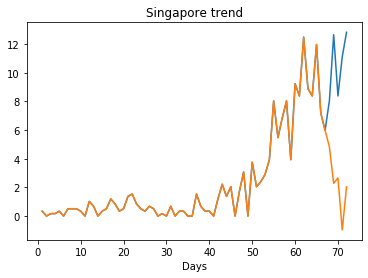

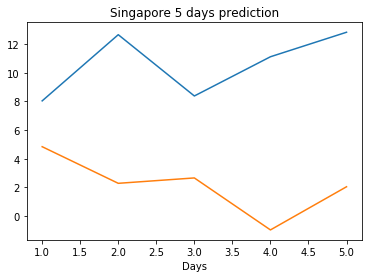

Creating directory ./offline5/Thailand/training/
Thailand
Saving the best model weights at Epoch [1], Best Valid Loss: 1.6358
Saving the best model weights at Epoch [2], Best Valid Loss: 1.2362


/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
/space/home/nzhang/anaconda3/envs/neuralnet/lib/python3.7/site-packages/torch/nn/modules/loss.py:431: UserWarning: Using a target size (torch.Size([1, 5])) that is different to the input size (torch.Size([5])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Saving the best model weights at Epoch [3], Best Valid Loss: 0.7391
Saving the best model weights at Epoch [4], Best Valid Loss: 0.3024
Saving the best model weights at Epoch [5], Best Valid Loss: 0.1511
Saving the best model weights at Epoch [6], Best Valid Loss: 0.0920
Saving the best model weights at Epoch [7], Best Valid Loss: 0.0764
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0725
Saving the best model weights at Epoch [12], Best Valid Loss: 0.0706
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0675
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0561
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0479
train error: 0.06192529049554938
0.04793313518166542
Saving the best model weights at Epoch [1], Best Valid Loss: 1.5847
Saving the best model weights at Epoch [2], Best Valid Loss: 1.4305
Saving the best model weights at Epoch [3], Best Valid Loss: 0.8354
Saving the best model weights at Epoch [4], Best Valid Los

Saving the best model weights at Epoch [15], Best Valid Loss: 0.0741
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0734
Saving the best model weights at Epoch [19], Best Valid Loss: 0.0720
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0504
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0456
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0438
train error: 0.05926707717835119
0.043750662356615067
Saving the best model weights at Epoch [1], Best Valid Loss: 1.2813
Saving the best model weights at Epoch [2], Best Valid Loss: 0.5623
Saving the best model weights at Epoch [3], Best Valid Loss: 0.1485
Saving the best model weights at Epoch [4], Best Valid Loss: 0.1106
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0998
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0993
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0725
Saving the best model weights at Epoch [19], Best Vali

Saving the best model weights at Epoch [29], Best Valid Loss: 0.0440
Saving the best model weights at Epoch [31], Best Valid Loss: 0.0380
train error: 0.06782410919090341
0.03802338242530823
Saving the best model weights at Epoch [1], Best Valid Loss: 1.5668
Saving the best model weights at Epoch [2], Best Valid Loss: 1.3432
Saving the best model weights at Epoch [7], Best Valid Loss: 1.0880
Saving the best model weights at Epoch [8], Best Valid Loss: 0.8866
Saving the best model weights at Epoch [9], Best Valid Loss: 0.4843
Saving the best model weights at Epoch [10], Best Valid Loss: 0.2101
Saving the best model weights at Epoch [11], Best Valid Loss: 0.0789
Saving the best model weights at Epoch [14], Best Valid Loss: 0.0699
Saving the best model weights at Epoch [15], Best Valid Loss: 0.0577
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0388
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0295
train error: 0.0649825494122189
0.02954160049557686
Sav

Saving the best model weights at Epoch [7], Best Valid Loss: 1.0208
Saving the best model weights at Epoch [8], Best Valid Loss: 0.8675
Saving the best model weights at Epoch [9], Best Valid Loss: 0.1471
Saving the best model weights at Epoch [10], Best Valid Loss: 0.0689
Saving the best model weights at Epoch [20], Best Valid Loss: 0.0578
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0533
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0341
train error: 0.06350714035981678
0.0341336727142334
Saving the best model weights at Epoch [1], Best Valid Loss: 1.3932
Saving the best model weights at Epoch [2], Best Valid Loss: 1.2628
Saving the best model weights at Epoch [3], Best Valid Loss: 0.9605
Saving the best model weights at Epoch [6], Best Valid Loss: 0.5125
Saving the best model weights at Epoch [7], Best Valid Loss: 0.2307
Saving the best model weights at Epoch [9], Best Valid Loss: 0.0481
Saving the best model weights at Epoch [11], Best Valid Loss

Saving the best model weights at Epoch [33], Best Valid Loss: 0.0341
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0263
train error: 0.07370525185864321
0.026251722127199173
Saving the best model weights at Epoch [1], Best Valid Loss: 0.8425
Saving the best model weights at Epoch [7], Best Valid Loss: 0.7242
Saving the best model weights at Epoch [10], Best Valid Loss: 0.5514
Saving the best model weights at Epoch [20], Best Valid Loss: 0.3849
Saving the best model weights at Epoch [21], Best Valid Loss: 0.0687
Saving the best model weights at Epoch [22], Best Valid Loss: 0.0560
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0149
train error: 0.06190914165314385
0.014868318103253841
Saving the best model weights at Epoch [1], Best Valid Loss: 1.8633
Saving the best model weights at Epoch [2], Best Valid Loss: 1.8467
Saving the best model weights at Epoch [3], Best Valid Loss: 1.6146
Saving the best model weights at Epoch [6], Best Valid Loss: 1.5758
S

train error: 0.47297949343919754
1.250419020652771
Saving the best model weights at Epoch [1], Best Valid Loss: 1.7447
Saving the best model weights at Epoch [2], Best Valid Loss: 1.6735
Saving the best model weights at Epoch [3], Best Valid Loss: 1.6644
Saving the best model weights at Epoch [6], Best Valid Loss: 1.1311
Saving the best model weights at Epoch [10], Best Valid Loss: 1.0966
Saving the best model weights at Epoch [36], Best Valid Loss: 1.0750
Saving the best model weights at Epoch [38], Best Valid Loss: 0.7533
train error: 0.48029898955045564
0.753297746181488
Saving the best model weights at Epoch [1], Best Valid Loss: 1.3871
Saving the best model weights at Epoch [2], Best Valid Loss: 0.9461
Saving the best model weights at Epoch [4], Best Valid Loss: 0.8627
Saving the best model weights at Epoch [45], Best Valid Loss: 0.6602
train error: 0.47103000147954416
0.6601600050926208
Saving the best model weights at Epoch [1], Best Valid Loss: 1.9980
Saving the best model weig

Saving the best model weights at Epoch [13], Best Valid Loss: 0.7693
Saving the best model weights at Epoch [28], Best Valid Loss: 0.7444
train error: 0.5554973827674985
0.7444314360618591
Saving the best model weights at Epoch [1], Best Valid Loss: 1.8565
Saving the best model weights at Epoch [2], Best Valid Loss: 1.7912
Saving the best model weights at Epoch [3], Best Valid Loss: 1.7383
Saving the best model weights at Epoch [4], Best Valid Loss: 1.4244
train error: 0.4600497650864877
1.424444556236267
Saving the best model weights at Epoch [1], Best Valid Loss: 1.6286
Saving the best model weights at Epoch [3], Best Valid Loss: 1.4294
train error: 0.4596234812940422
1.4294246435165405
Saving the best model weights at Epoch [1], Best Valid Loss: 1.7071
Saving the best model weights at Epoch [2], Best Valid Loss: 1.4803
Saving the best model weights at Epoch [5], Best Valid Loss: 1.3617
Saving the best model weights at Epoch [8], Best Valid Loss: 1.2593
Saving the best model weights 

Saving the best model weights at Epoch [19], Best Valid Loss: 1.1619
Saving the best model weights at Epoch [20], Best Valid Loss: 1.1100
Saving the best model weights at Epoch [21], Best Valid Loss: 1.0519
Saving the best model weights at Epoch [22], Best Valid Loss: 0.9928
Saving the best model weights at Epoch [23], Best Valid Loss: 0.9395
Saving the best model weights at Epoch [24], Best Valid Loss: 0.8864
Saving the best model weights at Epoch [25], Best Valid Loss: 0.8297
Saving the best model weights at Epoch [26], Best Valid Loss: 0.7772
Saving the best model weights at Epoch [27], Best Valid Loss: 0.7223
Saving the best model weights at Epoch [28], Best Valid Loss: 0.6651
Saving the best model weights at Epoch [29], Best Valid Loss: 0.6126
Saving the best model weights at Epoch [30], Best Valid Loss: 0.5609
Saving the best model weights at Epoch [31], Best Valid Loss: 0.5100
Saving the best model weights at Epoch [32], Best Valid Loss: 0.4592
Saving the best model weights at E

Saving the best model weights at Epoch [18], Best Valid Loss: 1.0431
Saving the best model weights at Epoch [19], Best Valid Loss: 1.0006
Saving the best model weights at Epoch [20], Best Valid Loss: 0.9540
Saving the best model weights at Epoch [21], Best Valid Loss: 0.9039
Saving the best model weights at Epoch [22], Best Valid Loss: 0.8558
Saving the best model weights at Epoch [23], Best Valid Loss: 0.8100
Saving the best model weights at Epoch [24], Best Valid Loss: 0.7631
Saving the best model weights at Epoch [25], Best Valid Loss: 0.7195
Saving the best model weights at Epoch [26], Best Valid Loss: 0.6757
Saving the best model weights at Epoch [27], Best Valid Loss: 0.6299
Saving the best model weights at Epoch [28], Best Valid Loss: 0.5864
Saving the best model weights at Epoch [29], Best Valid Loss: 0.5428
Saving the best model weights at Epoch [30], Best Valid Loss: 0.5019
Saving the best model weights at Epoch [31], Best Valid Loss: 0.4618
Saving the best model weights at E

Saving the best model weights at Epoch [12], Best Valid Loss: 0.2825
Saving the best model weights at Epoch [13], Best Valid Loss: 0.2112
Saving the best model weights at Epoch [14], Best Valid Loss: 0.1396
Saving the best model weights at Epoch [15], Best Valid Loss: 0.1021
Saving the best model weights at Epoch [16], Best Valid Loss: 0.0781
Saving the best model weights at Epoch [17], Best Valid Loss: 0.0630
Saving the best model weights at Epoch [18], Best Valid Loss: 0.0549
train error: 0.08643316764899187
0.05486690625548363
Saving the best model weights at Epoch [1], Best Valid Loss: 1.9005
Saving the best model weights at Epoch [2], Best Valid Loss: 1.3002
Saving the best model weights at Epoch [3], Best Valid Loss: 1.1993
Saving the best model weights at Epoch [4], Best Valid Loss: 0.9238
Saving the best model weights at Epoch [5], Best Valid Loss: 0.3927
Saving the best model weights at Epoch [6], Best Valid Loss: 0.1798
Saving the best model weights at Epoch [7], Best Valid L

Saving the best model weights at Epoch [15], Best Valid Loss: 0.5538
Saving the best model weights at Epoch [16], Best Valid Loss: 0.4856
Saving the best model weights at Epoch [17], Best Valid Loss: 0.4222
Saving the best model weights at Epoch [18], Best Valid Loss: 0.3510
Saving the best model weights at Epoch [19], Best Valid Loss: 0.2964
Saving the best model weights at Epoch [20], Best Valid Loss: 0.2389
Saving the best model weights at Epoch [21], Best Valid Loss: 0.1951
Saving the best model weights at Epoch [22], Best Valid Loss: 0.1533
Saving the best model weights at Epoch [23], Best Valid Loss: 0.1252
Saving the best model weights at Epoch [24], Best Valid Loss: 0.1034
Saving the best model weights at Epoch [25], Best Valid Loss: 0.0826
Saving the best model weights at Epoch [26], Best Valid Loss: 0.0706
Saving the best model weights at Epoch [27], Best Valid Loss: 0.0616
Saving the best model weights at Epoch [28], Best Valid Loss: 0.0593
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 0.1153
Saving the best model weights at Epoch [32], Best Valid Loss: 0.1019
Saving the best model weights at Epoch [33], Best Valid Loss: 0.0879
Saving the best model weights at Epoch [34], Best Valid Loss: 0.0796
Saving the best model weights at Epoch [35], Best Valid Loss: 0.0734
Saving the best model weights at Epoch [36], Best Valid Loss: 0.0689
Saving the best model weights at Epoch [37], Best Valid Loss: 0.0680
train error: 0.14555712933897189
0.06797932833433151
Saving the best model weights at Epoch [1], Best Valid Loss: 2.4062
Saving the best model weights at Epoch [2], Best Valid Loss: 2.0872
Saving the best model weights at Epoch [3], Best Valid Loss: 1.8424
Saving the best model weights at Epoch [4], Best Valid Loss: 1.6282
Saving the best model weights at Epoch [5], Best Valid Loss: 1.4946
Saving the best model weights at Epoch [6], Best Valid Loss: 1.3618
Saving the best model weights at Epoch [7], Best Valid L

Saving the best model weights at Epoch [18], Best Valid Loss: 1.6939
Saving the best model weights at Epoch [19], Best Valid Loss: 1.6844
Saving the best model weights at Epoch [20], Best Valid Loss: 1.6723
Saving the best model weights at Epoch [21], Best Valid Loss: 1.6691
Saving the best model weights at Epoch [22], Best Valid Loss: 1.6678
Saving the best model weights at Epoch [23], Best Valid Loss: 1.6641
Saving the best model weights at Epoch [24], Best Valid Loss: 1.6640
Saving the best model weights at Epoch [25], Best Valid Loss: 1.6637
Saving the best model weights at Epoch [29], Best Valid Loss: 1.6634
Saving the best model weights at Epoch [30], Best Valid Loss: 1.6553
Saving the best model weights at Epoch [32], Best Valid Loss: 1.6489
Saving the best model weights at Epoch [33], Best Valid Loss: 1.6450
Saving the best model weights at Epoch [47], Best Valid Loss: 1.6432
Saving the best model weights at Epoch [50], Best Valid Loss: 1.6369
train error: 0.4413930321063258
1.

Saving the best model weights at Epoch [9], Best Valid Loss: 1.7824
Saving the best model weights at Epoch [10], Best Valid Loss: 1.7542
Saving the best model weights at Epoch [11], Best Valid Loss: 1.7302
Saving the best model weights at Epoch [12], Best Valid Loss: 1.7103
Saving the best model weights at Epoch [13], Best Valid Loss: 1.7042
Saving the best model weights at Epoch [14], Best Valid Loss: 1.6824
Saving the best model weights at Epoch [15], Best Valid Loss: 1.6749
Saving the best model weights at Epoch [16], Best Valid Loss: 1.6635
Saving the best model weights at Epoch [17], Best Valid Loss: 1.6634
Saving the best model weights at Epoch [18], Best Valid Loss: 1.6523
Saving the best model weights at Epoch [19], Best Valid Loss: 1.6454
Saving the best model weights at Epoch [20], Best Valid Loss: 1.6454
Saving the best model weights at Epoch [21], Best Valid Loss: 1.6422
Saving the best model weights at Epoch [22], Best Valid Loss: 1.6410
Saving the best model weights at Ep

Saving the best model weights at Epoch [21], Best Valid Loss: 1.6624
Saving the best model weights at Epoch [22], Best Valid Loss: 1.6544
Saving the best model weights at Epoch [23], Best Valid Loss: 1.6478
Saving the best model weights at Epoch [24], Best Valid Loss: 1.6427
Saving the best model weights at Epoch [25], Best Valid Loss: 1.6403
Saving the best model weights at Epoch [26], Best Valid Loss: 1.6387
Saving the best model weights at Epoch [27], Best Valid Loss: 1.6379
Saving the best model weights at Epoch [28], Best Valid Loss: 1.6333
Saving the best model weights at Epoch [29], Best Valid Loss: 1.6301
Saving the best model weights at Epoch [30], Best Valid Loss: 1.6295
Saving the best model weights at Epoch [33], Best Valid Loss: 1.6272
Saving the best model weights at Epoch [35], Best Valid Loss: 1.6246
Saving the best model weights at Epoch [36], Best Valid Loss: 1.6224
Saving the best model weights at Epoch [37], Best Valid Loss: 1.6222
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 1.3158
Saving the best model weights at Epoch [44], Best Valid Loss: 1.2797
Saving the best model weights at Epoch [45], Best Valid Loss: 1.2209
Saving the best model weights at Epoch [46], Best Valid Loss: 1.2061
Saving the best model weights at Epoch [47], Best Valid Loss: 1.1003
Saving the best model weights at Epoch [48], Best Valid Loss: 1.0667
Saving the best model weights at Epoch [49], Best Valid Loss: 0.9896
Saving the best model weights at Epoch [50], Best Valid Loss: 0.9226
train error: 0.34748794121275606
0.9225597381591797
Saving the best model weights at Epoch [1], Best Valid Loss: 1.8080
Saving the best model weights at Epoch [2], Best Valid Loss: 1.5908
Saving the best model weights at Epoch [5], Best Valid Loss: 1.5880
Saving the best model weights at Epoch [7], Best Valid Loss: 1.5259
Saving the best model weights at Epoch [9], Best Valid Loss: 1.5134
Saving the best model weights at Epoch [11], Best Valid 

Saving the best model weights at Epoch [13], Best Valid Loss: 1.6452
Saving the best model weights at Epoch [15], Best Valid Loss: 1.6375
Saving the best model weights at Epoch [16], Best Valid Loss: 1.6348
Saving the best model weights at Epoch [19], Best Valid Loss: 1.6326
Saving the best model weights at Epoch [21], Best Valid Loss: 1.6143
Saving the best model weights at Epoch [28], Best Valid Loss: 1.6025
Saving the best model weights at Epoch [32], Best Valid Loss: 1.5916
Saving the best model weights at Epoch [33], Best Valid Loss: 1.5805
Saving the best model weights at Epoch [35], Best Valid Loss: 1.5674
Saving the best model weights at Epoch [39], Best Valid Loss: 1.5533
Saving the best model weights at Epoch [40], Best Valid Loss: 1.5462
Saving the best model weights at Epoch [41], Best Valid Loss: 1.5281
Saving the best model weights at Epoch [43], Best Valid Loss: 1.4994
Saving the best model weights at Epoch [44], Best Valid Loss: 1.4958
Saving the best model weights at E

Saving the best model weights at Epoch [13], Best Valid Loss: 1.7384
Saving the best model weights at Epoch [14], Best Valid Loss: 1.7269
Saving the best model weights at Epoch [15], Best Valid Loss: 1.7186
Saving the best model weights at Epoch [16], Best Valid Loss: 1.7076
Saving the best model weights at Epoch [17], Best Valid Loss: 1.6948
Saving the best model weights at Epoch [18], Best Valid Loss: 1.6913
Saving the best model weights at Epoch [19], Best Valid Loss: 1.6863
Saving the best model weights at Epoch [22], Best Valid Loss: 1.6839
Saving the best model weights at Epoch [23], Best Valid Loss: 1.6774
Saving the best model weights at Epoch [24], Best Valid Loss: 1.6759
Saving the best model weights at Epoch [25], Best Valid Loss: 1.6712
Saving the best model weights at Epoch [26], Best Valid Loss: 1.6674
Saving the best model weights at Epoch [27], Best Valid Loss: 1.6622
Saving the best model weights at Epoch [39], Best Valid Loss: 1.6595
Saving the best model weights at E

Saving the best model weights at Epoch [6], Best Valid Loss: 1.8236
Saving the best model weights at Epoch [7], Best Valid Loss: 1.7736
Saving the best model weights at Epoch [8], Best Valid Loss: 1.7467
Saving the best model weights at Epoch [9], Best Valid Loss: 1.7210
Saving the best model weights at Epoch [10], Best Valid Loss: 1.7009
Saving the best model weights at Epoch [11], Best Valid Loss: 1.6999
Saving the best model weights at Epoch [12], Best Valid Loss: 1.6819
Saving the best model weights at Epoch [14], Best Valid Loss: 1.6785
Saving the best model weights at Epoch [15], Best Valid Loss: 1.6639
Saving the best model weights at Epoch [17], Best Valid Loss: 1.6604
Saving the best model weights at Epoch [19], Best Valid Loss: 1.6604
Saving the best model weights at Epoch [20], Best Valid Loss: 1.6526
Saving the best model weights at Epoch [39], Best Valid Loss: 1.6526
train error: 0.44411553601783355
1.6526178121566772
Saving the best model weights at Epoch [1], Best Valid 

Saving the best model weights at Epoch [2], Best Valid Loss: 1.6282
Saving the best model weights at Epoch [4], Best Valid Loss: 1.5915
Saving the best model weights at Epoch [11], Best Valid Loss: 1.5761
Saving the best model weights at Epoch [14], Best Valid Loss: 1.5270
Saving the best model weights at Epoch [23], Best Valid Loss: 1.5082
Saving the best model weights at Epoch [38], Best Valid Loss: 1.4901
Saving the best model weights at Epoch [45], Best Valid Loss: 1.4828
Saving the best model weights at Epoch [49], Best Valid Loss: 1.4134
Saving the best model weights at Epoch [50], Best Valid Loss: 1.4097
train error: 0.42895112693996024
1.4096623659133911
Saving the best model weights at Epoch [1], Best Valid Loss: 2.6471
Saving the best model weights at Epoch [2], Best Valid Loss: 2.4638
Saving the best model weights at Epoch [3], Best Valid Loss: 2.3130
Saving the best model weights at Epoch [4], Best Valid Loss: 2.1914
Saving the best model weights at Epoch [5], Best Valid Lo

Saving the best model weights at Epoch [10], Best Valid Loss: 1.8606
Saving the best model weights at Epoch [11], Best Valid Loss: 1.8238
Saving the best model weights at Epoch [12], Best Valid Loss: 1.7970
Saving the best model weights at Epoch [13], Best Valid Loss: 1.7749
Saving the best model weights at Epoch [14], Best Valid Loss: 1.7624
Saving the best model weights at Epoch [15], Best Valid Loss: 1.7463
Saving the best model weights at Epoch [16], Best Valid Loss: 1.7313
Saving the best model weights at Epoch [17], Best Valid Loss: 1.7205
Saving the best model weights at Epoch [18], Best Valid Loss: 1.7085
Saving the best model weights at Epoch [19], Best Valid Loss: 1.7006
Saving the best model weights at Epoch [20], Best Valid Loss: 1.6933
Saving the best model weights at Epoch [21], Best Valid Loss: 1.6900
Saving the best model weights at Epoch [22], Best Valid Loss: 1.6866
Saving the best model weights at Epoch [23], Best Valid Loss: 1.6819
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 1.6682
Saving the best model weights at Epoch [35], Best Valid Loss: 1.6641
Saving the best model weights at Epoch [45], Best Valid Loss: 1.6629
Saving the best model weights at Epoch [48], Best Valid Loss: 1.6624
train error: 0.4437242410341768
1.6623684167861938
Saving the best model weights at Epoch [1], Best Valid Loss: 2.7275
Saving the best model weights at Epoch [2], Best Valid Loss: 2.4840
Saving the best model weights at Epoch [3], Best Valid Loss: 2.2981
Saving the best model weights at Epoch [4], Best Valid Loss: 2.1550
Saving the best model weights at Epoch [5], Best Valid Loss: 2.0522
Saving the best model weights at Epoch [6], Best Valid Loss: 1.9608
Saving the best model weights at Epoch [7], Best Valid Loss: 1.9058
Saving the best model weights at Epoch [8], Best Valid Loss: 1.8433
Saving the best model weights at Epoch [9], Best Valid Loss: 1.8122
Saving the best model weights at Epoch [10], Best Valid Loss:

Saving the best model weights at Epoch [29], Best Valid Loss: 1.6616
train error: 0.44431682575592085
1.6616352796554565
Saving the best model weights at Epoch [1], Best Valid Loss: 2.7528
Saving the best model weights at Epoch [2], Best Valid Loss: 2.4134
Saving the best model weights at Epoch [3], Best Valid Loss: 2.1821
Saving the best model weights at Epoch [4], Best Valid Loss: 2.0262
Saving the best model weights at Epoch [5], Best Valid Loss: 1.9153
Saving the best model weights at Epoch [6], Best Valid Loss: 1.8437
Saving the best model weights at Epoch [7], Best Valid Loss: 1.7897
Saving the best model weights at Epoch [8], Best Valid Loss: 1.7431
Saving the best model weights at Epoch [9], Best Valid Loss: 1.7236
Saving the best model weights at Epoch [10], Best Valid Loss: 1.7023
Saving the best model weights at Epoch [11], Best Valid Loss: 1.6965
Saving the best model weights at Epoch [13], Best Valid Loss: 1.6743
Saving the best model weights at Epoch [16], Best Valid Loss

Saving the best model weights at Epoch [2], Best Valid Loss: 1.7062
Saving the best model weights at Epoch [3], Best Valid Loss: 1.6699
Saving the best model weights at Epoch [5], Best Valid Loss: 1.6021
Saving the best model weights at Epoch [20], Best Valid Loss: 1.4595
train error: 0.4519407272485918
1.459521770477295
Saving the best model weights at Epoch [1], Best Valid Loss: 2.6552
Saving the best model weights at Epoch [2], Best Valid Loss: 2.4650
Saving the best model weights at Epoch [3], Best Valid Loss: 2.3208
Saving the best model weights at Epoch [4], Best Valid Loss: 2.2006
Saving the best model weights at Epoch [5], Best Valid Loss: 2.1024
Saving the best model weights at Epoch [6], Best Valid Loss: 2.0229
Saving the best model weights at Epoch [7], Best Valid Loss: 1.9548
Saving the best model weights at Epoch [8], Best Valid Loss: 1.9047
Saving the best model weights at Epoch [9], Best Valid Loss: 1.8637
Saving the best model weights at Epoch [10], Best Valid Loss: 1.8

Saving the best model weights at Epoch [22], Best Valid Loss: 1.6825
Saving the best model weights at Epoch [23], Best Valid Loss: 1.6802
Saving the best model weights at Epoch [29], Best Valid Loss: 1.6777
Saving the best model weights at Epoch [32], Best Valid Loss: 1.6739
Saving the best model weights at Epoch [33], Best Valid Loss: 1.6712
Saving the best model weights at Epoch [34], Best Valid Loss: 1.6676
Saving the best model weights at Epoch [47], Best Valid Loss: 1.6675
Saving the best model weights at Epoch [48], Best Valid Loss: 1.6674
Saving the best model weights at Epoch [49], Best Valid Loss: 1.6670
Saving the best model weights at Epoch [50], Best Valid Loss: 1.6657
train error: 0.4436643543947292
1.6656869649887085
Saving the best model weights at Epoch [1], Best Valid Loss: 2.7963
Saving the best model weights at Epoch [2], Best Valid Loss: 2.5275
Saving the best model weights at Epoch [3], Best Valid Loss: 2.3263
Saving the best model weights at Epoch [4], Best Valid 

Saving the best model weights at Epoch [16], Best Valid Loss: 1.6940
Saving the best model weights at Epoch [17], Best Valid Loss: 1.6888
Saving the best model weights at Epoch [18], Best Valid Loss: 1.6884
Saving the best model weights at Epoch [19], Best Valid Loss: 1.6799
Saving the best model weights at Epoch [20], Best Valid Loss: 1.6693
Saving the best model weights at Epoch [49], Best Valid Loss: 1.6672
train error: 0.44441083696131645
1.6671802997589111
Saving the best model weights at Epoch [1], Best Valid Loss: 2.6568
Saving the best model weights at Epoch [2], Best Valid Loss: 2.3433
Saving the best model weights at Epoch [3], Best Valid Loss: 2.1297
Saving the best model weights at Epoch [4], Best Valid Loss: 1.9769
Saving the best model weights at Epoch [5], Best Valid Loss: 1.8832
Saving the best model weights at Epoch [6], Best Valid Loss: 1.8224
Saving the best model weights at Epoch [7], Best Valid Loss: 1.7819
Saving the best model weights at Epoch [8], Best Valid Los

Saving the best model weights at Epoch [21], Best Valid Loss: 1.6458
Saving the best model weights at Epoch [38], Best Valid Loss: 1.6371
train error: 0.4449194631735353
1.6371082067489624
Saving the best model weights at Epoch [1], Best Valid Loss: 2.2876
Saving the best model weights at Epoch [2], Best Valid Loss: 2.0005
Saving the best model weights at Epoch [3], Best Valid Loss: 1.8424
Saving the best model weights at Epoch [4], Best Valid Loss: 1.7774
Saving the best model weights at Epoch [5], Best Valid Loss: 1.7328
Saving the best model weights at Epoch [6], Best Valid Loss: 1.6815
Saving the best model weights at Epoch [8], Best Valid Loss: 1.6752
Saving the best model weights at Epoch [9], Best Valid Loss: 1.6697
Saving the best model weights at Epoch [12], Best Valid Loss: 1.6664
Saving the best model weights at Epoch [16], Best Valid Loss: 1.6504
Saving the best model weights at Epoch [18], Best Valid Loss: 1.6499
Saving the best model weights at Epoch [30], Best Valid Loss

Saving the best model weights at Epoch [49], Best Valid Loss: 1.8060
Saving the best model weights at Epoch [50], Best Valid Loss: 1.7917
train error: 0.42076786225171464
1.791664958000183
Saving the best model weights at Epoch [1], Best Valid Loss: 2.6988
Saving the best model weights at Epoch [2], Best Valid Loss: 2.6470
Saving the best model weights at Epoch [3], Best Valid Loss: 2.5992
Saving the best model weights at Epoch [4], Best Valid Loss: 2.5503
Saving the best model weights at Epoch [5], Best Valid Loss: 2.5039
Saving the best model weights at Epoch [6], Best Valid Loss: 2.4617
Saving the best model weights at Epoch [7], Best Valid Loss: 2.4192
Saving the best model weights at Epoch [8], Best Valid Loss: 2.3764
Saving the best model weights at Epoch [9], Best Valid Loss: 2.3361
Saving the best model weights at Epoch [10], Best Valid Loss: 2.2970
Saving the best model weights at Epoch [11], Best Valid Loss: 2.2623
Saving the best model weights at Epoch [12], Best Valid Loss:

Saving the best model weights at Epoch [16], Best Valid Loss: 1.1449
Saving the best model weights at Epoch [17], Best Valid Loss: 1.1072
Saving the best model weights at Epoch [18], Best Valid Loss: 1.0407
Saving the best model weights at Epoch [19], Best Valid Loss: 1.0087
Saving the best model weights at Epoch [20], Best Valid Loss: 0.9504
Saving the best model weights at Epoch [21], Best Valid Loss: 0.9127
Saving the best model weights at Epoch [22], Best Valid Loss: 0.8799
Saving the best model weights at Epoch [23], Best Valid Loss: 0.8212
Saving the best model weights at Epoch [24], Best Valid Loss: 0.7914
Saving the best model weights at Epoch [25], Best Valid Loss: 0.7436
Saving the best model weights at Epoch [26], Best Valid Loss: 0.7060
Saving the best model weights at Epoch [27], Best Valid Loss: 0.6624
Saving the best model weights at Epoch [28], Best Valid Loss: 0.6302
Saving the best model weights at Epoch [29], Best Valid Loss: 0.5938
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 2.1290
Saving the best model weights at Epoch [37], Best Valid Loss: 2.1102
Saving the best model weights at Epoch [38], Best Valid Loss: 2.0898
Saving the best model weights at Epoch [39], Best Valid Loss: 2.0709
Saving the best model weights at Epoch [40], Best Valid Loss: 2.0522
Saving the best model weights at Epoch [41], Best Valid Loss: 2.0341
Saving the best model weights at Epoch [42], Best Valid Loss: 2.0176
Saving the best model weights at Epoch [43], Best Valid Loss: 1.9993
Saving the best model weights at Epoch [44], Best Valid Loss: 1.9821
Saving the best model weights at Epoch [45], Best Valid Loss: 1.9659
Saving the best model weights at Epoch [46], Best Valid Loss: 1.9494
Saving the best model weights at Epoch [47], Best Valid Loss: 1.9331
Saving the best model weights at Epoch [48], Best Valid Loss: 1.9174
Saving the best model weights at Epoch [49], Best Valid Loss: 1.9021
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 2.3532
Saving the best model weights at Epoch [4], Best Valid Loss: 2.1719
Saving the best model weights at Epoch [5], Best Valid Loss: 2.0364
Saving the best model weights at Epoch [6], Best Valid Loss: 1.9008
Saving the best model weights at Epoch [7], Best Valid Loss: 1.8264
Saving the best model weights at Epoch [8], Best Valid Loss: 1.7447
Saving the best model weights at Epoch [9], Best Valid Loss: 1.6305
Saving the best model weights at Epoch [10], Best Valid Loss: 1.5452
Saving the best model weights at Epoch [11], Best Valid Loss: 1.4803
Saving the best model weights at Epoch [12], Best Valid Loss: 1.4474
Saving the best model weights at Epoch [13], Best Valid Loss: 1.3702
Saving the best model weights at Epoch [14], Best Valid Loss: 1.3400
Saving the best model weights at Epoch [15], Best Valid Loss: 1.2810
Saving the best model weights at Epoch [16], Best Valid Loss: 1.2424
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [23], Best Valid Loss: 1.9785
Saving the best model weights at Epoch [24], Best Valid Loss: 1.9565
Saving the best model weights at Epoch [25], Best Valid Loss: 1.9349
Saving the best model weights at Epoch [26], Best Valid Loss: 1.9141
Saving the best model weights at Epoch [27], Best Valid Loss: 1.8942
Saving the best model weights at Epoch [28], Best Valid Loss: 1.8727
Saving the best model weights at Epoch [29], Best Valid Loss: 1.8531
Saving the best model weights at Epoch [30], Best Valid Loss: 1.8339
Saving the best model weights at Epoch [31], Best Valid Loss: 1.8149
Saving the best model weights at Epoch [32], Best Valid Loss: 1.7965
Saving the best model weights at Epoch [33], Best Valid Loss: 1.7779
Saving the best model weights at Epoch [34], Best Valid Loss: 1.7604
Saving the best model weights at Epoch [35], Best Valid Loss: 1.7434
Saving the best model weights at Epoch [36], Best Valid Loss: 1.7261
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 1.2773
Saving the best model weights at Epoch [44], Best Valid Loss: 1.2670
Saving the best model weights at Epoch [45], Best Valid Loss: 1.2511
Saving the best model weights at Epoch [46], Best Valid Loss: 1.2349
Saving the best model weights at Epoch [47], Best Valid Loss: 1.2163
Saving the best model weights at Epoch [48], Best Valid Loss: 1.2030
Saving the best model weights at Epoch [49], Best Valid Loss: 1.1873
Saving the best model weights at Epoch [50], Best Valid Loss: 1.1757
train error: 0.3773120418926211
1.175726294517517
Saving the best model weights at Epoch [1], Best Valid Loss: 2.5760
Saving the best model weights at Epoch [2], Best Valid Loss: 2.2889
Saving the best model weights at Epoch [3], Best Valid Loss: 2.1125
Saving the best model weights at Epoch [4], Best Valid Loss: 1.9513
Saving the best model weights at Epoch [5], Best Valid Loss: 1.8291
Saving the best model weights at Epoch [6], Best Valid Los

Saving the best model weights at Epoch [12], Best Valid Loss: 2.5802
Saving the best model weights at Epoch [13], Best Valid Loss: 2.5476
Saving the best model weights at Epoch [14], Best Valid Loss: 2.5166
Saving the best model weights at Epoch [15], Best Valid Loss: 2.4857
Saving the best model weights at Epoch [16], Best Valid Loss: 2.4560
Saving the best model weights at Epoch [17], Best Valid Loss: 2.4282
Saving the best model weights at Epoch [18], Best Valid Loss: 2.3988
Saving the best model weights at Epoch [19], Best Valid Loss: 2.3724
Saving the best model weights at Epoch [20], Best Valid Loss: 2.3440
Saving the best model weights at Epoch [21], Best Valid Loss: 2.3187
Saving the best model weights at Epoch [22], Best Valid Loss: 2.2921
Saving the best model weights at Epoch [23], Best Valid Loss: 2.2683
Saving the best model weights at Epoch [24], Best Valid Loss: 2.2426
Saving the best model weights at Epoch [25], Best Valid Loss: 2.2203
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 1.5460
Saving the best model weights at Epoch [31], Best Valid Loss: 1.5155
Saving the best model weights at Epoch [32], Best Valid Loss: 1.4975
Saving the best model weights at Epoch [33], Best Valid Loss: 1.4769
Saving the best model weights at Epoch [34], Best Valid Loss: 1.4542
Saving the best model weights at Epoch [35], Best Valid Loss: 1.4331
Saving the best model weights at Epoch [36], Best Valid Loss: 1.4125
Saving the best model weights at Epoch [37], Best Valid Loss: 1.3925
Saving the best model weights at Epoch [38], Best Valid Loss: 1.3760
Saving the best model weights at Epoch [39], Best Valid Loss: 1.3569
Saving the best model weights at Epoch [40], Best Valid Loss: 1.3409
Saving the best model weights at Epoch [41], Best Valid Loss: 1.3181
Saving the best model weights at Epoch [42], Best Valid Loss: 1.3042
Saving the best model weights at Epoch [43], Best Valid Loss: 1.2863
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 2.1542
train error: 0.47807977083874376
2.1542258262634277
Saving the best model weights at Epoch [1], Best Valid Loss: 2.4732
Saving the best model weights at Epoch [2], Best Valid Loss: 2.4517
Saving the best model weights at Epoch [3], Best Valid Loss: 2.4318
Saving the best model weights at Epoch [4], Best Valid Loss: 2.4128
Saving the best model weights at Epoch [5], Best Valid Loss: 2.3938
Saving the best model weights at Epoch [6], Best Valid Loss: 2.3757
Saving the best model weights at Epoch [7], Best Valid Loss: 2.3577
Saving the best model weights at Epoch [8], Best Valid Loss: 2.3413
Saving the best model weights at Epoch [9], Best Valid Loss: 2.3236
Saving the best model weights at Epoch [10], Best Valid Loss: 2.3075
Saving the best model weights at Epoch [11], Best Valid Loss: 2.2913
Saving the best model weights at Epoch [12], Best Valid Loss: 2.2759
Saving the best model weights at Epoch [13], Best Valid Loss

Saving the best model weights at Epoch [17], Best Valid Loss: 2.1198
Saving the best model weights at Epoch [18], Best Valid Loss: 2.0954
Saving the best model weights at Epoch [19], Best Valid Loss: 2.0654
Saving the best model weights at Epoch [20], Best Valid Loss: 2.0446
Saving the best model weights at Epoch [21], Best Valid Loss: 2.0168
Saving the best model weights at Epoch [22], Best Valid Loss: 1.9996
Saving the best model weights at Epoch [23], Best Valid Loss: 1.9744
Saving the best model weights at Epoch [24], Best Valid Loss: 1.9541
Saving the best model weights at Epoch [25], Best Valid Loss: 1.9381
Saving the best model weights at Epoch [26], Best Valid Loss: 1.9179
Saving the best model weights at Epoch [27], Best Valid Loss: 1.9033
Saving the best model weights at Epoch [28], Best Valid Loss: 1.8869
Saving the best model weights at Epoch [29], Best Valid Loss: 1.8719
Saving the best model weights at Epoch [30], Best Valid Loss: 1.8573
Saving the best model weights at E

Saving the best model weights at Epoch [5], Best Valid Loss: 2.5655
Saving the best model weights at Epoch [6], Best Valid Loss: 2.5431
Saving the best model weights at Epoch [7], Best Valid Loss: 2.5199
Saving the best model weights at Epoch [8], Best Valid Loss: 2.4983
Saving the best model weights at Epoch [9], Best Valid Loss: 2.4782
Saving the best model weights at Epoch [10], Best Valid Loss: 2.4577
Saving the best model weights at Epoch [11], Best Valid Loss: 2.4369
Saving the best model weights at Epoch [12], Best Valid Loss: 2.4185
Saving the best model weights at Epoch [13], Best Valid Loss: 2.3987
Saving the best model weights at Epoch [14], Best Valid Loss: 2.3810
Saving the best model weights at Epoch [15], Best Valid Loss: 2.3623
Saving the best model weights at Epoch [16], Best Valid Loss: 2.3449
Saving the best model weights at Epoch [17], Best Valid Loss: 2.3282
Saving the best model weights at Epoch [18], Best Valid Loss: 2.3115
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [25], Best Valid Loss: 1.9226
Saving the best model weights at Epoch [26], Best Valid Loss: 1.9046
Saving the best model weights at Epoch [27], Best Valid Loss: 1.8956
Saving the best model weights at Epoch [28], Best Valid Loss: 1.8789
Saving the best model weights at Epoch [29], Best Valid Loss: 1.8667
Saving the best model weights at Epoch [30], Best Valid Loss: 1.8532
Saving the best model weights at Epoch [31], Best Valid Loss: 1.8422
Saving the best model weights at Epoch [32], Best Valid Loss: 1.8326
Saving the best model weights at Epoch [33], Best Valid Loss: 1.8259
Saving the best model weights at Epoch [34], Best Valid Loss: 1.8128
Saving the best model weights at Epoch [35], Best Valid Loss: 1.8077
Saving the best model weights at Epoch [36], Best Valid Loss: 1.7961
Saving the best model weights at Epoch [37], Best Valid Loss: 1.7949
Saving the best model weights at Epoch [38], Best Valid Loss: 1.7816
Saving the best model weights at E

Saving the best model weights at Epoch [16], Best Valid Loss: 2.5633
Saving the best model weights at Epoch [17], Best Valid Loss: 2.5403
Saving the best model weights at Epoch [18], Best Valid Loss: 2.5167
Saving the best model weights at Epoch [19], Best Valid Loss: 2.4948
Saving the best model weights at Epoch [20], Best Valid Loss: 2.4738
Saving the best model weights at Epoch [21], Best Valid Loss: 2.4529
Saving the best model weights at Epoch [22], Best Valid Loss: 2.4334
Saving the best model weights at Epoch [23], Best Valid Loss: 2.4137
Saving the best model weights at Epoch [24], Best Valid Loss: 2.3936
Saving the best model weights at Epoch [25], Best Valid Loss: 2.3760
Saving the best model weights at Epoch [26], Best Valid Loss: 2.3568
Saving the best model weights at Epoch [27], Best Valid Loss: 2.3401
Saving the best model weights at Epoch [28], Best Valid Loss: 2.3221
Saving the best model weights at Epoch [29], Best Valid Loss: 2.3064
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 1.7790
Saving the best model weights at Epoch [37], Best Valid Loss: 1.7711
Saving the best model weights at Epoch [38], Best Valid Loss: 1.7617
Saving the best model weights at Epoch [39], Best Valid Loss: 1.7579
Saving the best model weights at Epoch [40], Best Valid Loss: 1.7487
Saving the best model weights at Epoch [41], Best Valid Loss: 1.7455
Saving the best model weights at Epoch [42], Best Valid Loss: 1.7379
Saving the best model weights at Epoch [43], Best Valid Loss: 1.7320
Saving the best model weights at Epoch [44], Best Valid Loss: 1.7305
Saving the best model weights at Epoch [45], Best Valid Loss: 1.7244
Saving the best model weights at Epoch [46], Best Valid Loss: 1.7186
Saving the best model weights at Epoch [48], Best Valid Loss: 1.7135
Saving the best model weights at Epoch [49], Best Valid Loss: 1.7115
Saving the best model weights at Epoch [50], Best Valid Loss: 1.7023
train error: 0.4407340124935696
1.

Saving the best model weights at Epoch [25], Best Valid Loss: 2.3355
Saving the best model weights at Epoch [26], Best Valid Loss: 2.3183
Saving the best model weights at Epoch [27], Best Valid Loss: 2.3015
Saving the best model weights at Epoch [28], Best Valid Loss: 2.2851
Saving the best model weights at Epoch [29], Best Valid Loss: 2.2694
Saving the best model weights at Epoch [30], Best Valid Loss: 2.2546
Saving the best model weights at Epoch [31], Best Valid Loss: 2.2384
Saving the best model weights at Epoch [32], Best Valid Loss: 2.2244
Saving the best model weights at Epoch [33], Best Valid Loss: 2.2097
Saving the best model weights at Epoch [34], Best Valid Loss: 2.1957
Saving the best model weights at Epoch [35], Best Valid Loss: 2.1821
Saving the best model weights at Epoch [36], Best Valid Loss: 2.1688
Saving the best model weights at Epoch [37], Best Valid Loss: 2.1555
Saving the best model weights at Epoch [38], Best Valid Loss: 2.1432
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 1.7465
Saving the best model weights at Epoch [46], Best Valid Loss: 1.7399
Saving the best model weights at Epoch [48], Best Valid Loss: 1.7330
Saving the best model weights at Epoch [49], Best Valid Loss: 1.7269
Saving the best model weights at Epoch [50], Best Valid Loss: 1.7206
train error: 0.4409000203258505
1.7206004858016968
Saving the best model weights at Epoch [1], Best Valid Loss: 2.7373
Saving the best model weights at Epoch [2], Best Valid Loss: 2.5510
Saving the best model weights at Epoch [3], Best Valid Loss: 2.4080
Saving the best model weights at Epoch [4], Best Valid Loss: 2.2894
Saving the best model weights at Epoch [5], Best Valid Loss: 2.1746
Saving the best model weights at Epoch [6], Best Valid Loss: 2.0969
Saving the best model weights at Epoch [7], Best Valid Loss: 2.0012
Saving the best model weights at Epoch [8], Best Valid Loss: 1.9473
Saving the best model weights at Epoch [9], Best Valid Loss:

Saving the best model weights at Epoch [37], Best Valid Loss: 2.0137
Saving the best model weights at Epoch [38], Best Valid Loss: 2.0050
Saving the best model weights at Epoch [39], Best Valid Loss: 1.9964
Saving the best model weights at Epoch [40], Best Valid Loss: 1.9881
Saving the best model weights at Epoch [41], Best Valid Loss: 1.9807
Saving the best model weights at Epoch [42], Best Valid Loss: 1.9721
Saving the best model weights at Epoch [43], Best Valid Loss: 1.9653
Saving the best model weights at Epoch [44], Best Valid Loss: 1.9569
Saving the best model weights at Epoch [45], Best Valid Loss: 1.9504
Saving the best model weights at Epoch [46], Best Valid Loss: 1.9426
Saving the best model weights at Epoch [47], Best Valid Loss: 1.9365
Saving the best model weights at Epoch [48], Best Valid Loss: 1.9298
Saving the best model weights at Epoch [49], Best Valid Loss: 1.9227
Saving the best model weights at Epoch [50], Best Valid Loss: 1.9160
train error: 0.4549964478631553
1.

Saving the best model weights at Epoch [5], Best Valid Loss: 2.1823
Saving the best model weights at Epoch [6], Best Valid Loss: 2.0921
Saving the best model weights at Epoch [7], Best Valid Loss: 2.0415
Saving the best model weights at Epoch [8], Best Valid Loss: 1.9517
Saving the best model weights at Epoch [9], Best Valid Loss: 1.9256
Saving the best model weights at Epoch [10], Best Valid Loss: 1.8856
Saving the best model weights at Epoch [11], Best Valid Loss: 1.8408
Saving the best model weights at Epoch [12], Best Valid Loss: 1.8189
Saving the best model weights at Epoch [13], Best Valid Loss: 1.7746
Saving the best model weights at Epoch [14], Best Valid Loss: 1.7528
Saving the best model weights at Epoch [15], Best Valid Loss: 1.7526
Saving the best model weights at Epoch [16], Best Valid Loss: 1.7456
Saving the best model weights at Epoch [17], Best Valid Loss: 1.7322
Saving the best model weights at Epoch [18], Best Valid Loss: 1.7256
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [49], Best Valid Loss: 2.0218
Saving the best model weights at Epoch [50], Best Valid Loss: 2.0130
train error: 0.45950580910338384
2.013028383255005
Saving the best model weights at Epoch [1], Best Valid Loss: 3.1436
Saving the best model weights at Epoch [2], Best Valid Loss: 3.0877
Saving the best model weights at Epoch [3], Best Valid Loss: 3.0357
Saving the best model weights at Epoch [4], Best Valid Loss: 2.9830
Saving the best model weights at Epoch [5], Best Valid Loss: 2.9357
Saving the best model weights at Epoch [6], Best Valid Loss: 2.8900
Saving the best model weights at Epoch [7], Best Valid Loss: 2.8412
Saving the best model weights at Epoch [8], Best Valid Loss: 2.7972
Saving the best model weights at Epoch [9], Best Valid Loss: 2.7557
Saving the best model weights at Epoch [10], Best Valid Loss: 2.7174
Saving the best model weights at Epoch [11], Best Valid Loss: 2.6764
Saving the best model weights at Epoch [12], Best Valid Loss:

Saving the best model weights at Epoch [19], Best Valid Loss: 1.7017
Saving the best model weights at Epoch [20], Best Valid Loss: 1.6994
Saving the best model weights at Epoch [23], Best Valid Loss: 1.6911
Saving the best model weights at Epoch [24], Best Valid Loss: 1.6827
Saving the best model weights at Epoch [25], Best Valid Loss: 1.6636
Saving the best model weights at Epoch [34], Best Valid Loss: 1.6604
Saving the best model weights at Epoch [41], Best Valid Loss: 1.6563
Saving the best model weights at Epoch [42], Best Valid Loss: 1.6561
Saving the best model weights at Epoch [45], Best Valid Loss: 1.6527
train error: 0.4423575969658008
1.6527074575424194
Saving the best model weights at Epoch [1], Best Valid Loss: 3.0434
Saving the best model weights at Epoch [2], Best Valid Loss: 3.0144
Saving the best model weights at Epoch [3], Best Valid Loss: 2.9861
Saving the best model weights at Epoch [4], Best Valid Loss: 2.9585
Saving the best model weights at Epoch [5], Best Valid L

Saving the best model weights at Epoch [10], Best Valid Loss: 2.5587
Saving the best model weights at Epoch [11], Best Valid Loss: 2.5284
Saving the best model weights at Epoch [12], Best Valid Loss: 2.4974
Saving the best model weights at Epoch [13], Best Valid Loss: 2.4654
Saving the best model weights at Epoch [14], Best Valid Loss: 2.4399
Saving the best model weights at Epoch [15], Best Valid Loss: 2.4108
Saving the best model weights at Epoch [16], Best Valid Loss: 2.3836
Saving the best model weights at Epoch [17], Best Valid Loss: 2.3589
Saving the best model weights at Epoch [18], Best Valid Loss: 2.3322
Saving the best model weights at Epoch [19], Best Valid Loss: 2.3091
Saving the best model weights at Epoch [20], Best Valid Loss: 2.2862
Saving the best model weights at Epoch [21], Best Valid Loss: 2.2643
Saving the best model weights at Epoch [22], Best Valid Loss: 2.2431
Saving the best model weights at Epoch [23], Best Valid Loss: 2.2237
Saving the best model weights at E

Saving the best model weights at Epoch [6], Best Valid Loss: 2.8348
Saving the best model weights at Epoch [7], Best Valid Loss: 2.8109
Saving the best model weights at Epoch [8], Best Valid Loss: 2.7870
Saving the best model weights at Epoch [9], Best Valid Loss: 2.7640
Saving the best model weights at Epoch [10], Best Valid Loss: 2.7414
Saving the best model weights at Epoch [11], Best Valid Loss: 2.7193
Saving the best model weights at Epoch [12], Best Valid Loss: 2.6977
Saving the best model weights at Epoch [13], Best Valid Loss: 2.6769
Saving the best model weights at Epoch [14], Best Valid Loss: 2.6561
Saving the best model weights at Epoch [15], Best Valid Loss: 2.6359
Saving the best model weights at Epoch [16], Best Valid Loss: 2.6164
Saving the best model weights at Epoch [17], Best Valid Loss: 2.5971
Saving the best model weights at Epoch [18], Best Valid Loss: 2.5782
Saving the best model weights at Epoch [19], Best Valid Loss: 2.5596
Saving the best model weights at Epoch

Saving the best model weights at Epoch [24], Best Valid Loss: 2.1559
Saving the best model weights at Epoch [25], Best Valid Loss: 2.1399
Saving the best model weights at Epoch [26], Best Valid Loss: 2.1230
Saving the best model weights at Epoch [27], Best Valid Loss: 2.1092
Saving the best model weights at Epoch [28], Best Valid Loss: 2.0943
Saving the best model weights at Epoch [29], Best Valid Loss: 2.0784
Saving the best model weights at Epoch [30], Best Valid Loss: 2.0645
Saving the best model weights at Epoch [31], Best Valid Loss: 2.0508
Saving the best model weights at Epoch [32], Best Valid Loss: 2.0372
Saving the best model weights at Epoch [33], Best Valid Loss: 2.0242
Saving the best model weights at Epoch [34], Best Valid Loss: 2.0139
Saving the best model weights at Epoch [35], Best Valid Loss: 2.0007
Saving the best model weights at Epoch [36], Best Valid Loss: 1.9893
Saving the best model weights at Epoch [37], Best Valid Loss: 1.9798
Saving the best model weights at E

Saving the best model weights at Epoch [21], Best Valid Loss: 2.8567
Saving the best model weights at Epoch [22], Best Valid Loss: 2.8329
Saving the best model weights at Epoch [23], Best Valid Loss: 2.8097
Saving the best model weights at Epoch [24], Best Valid Loss: 2.7869
Saving the best model weights at Epoch [25], Best Valid Loss: 2.7647
Saving the best model weights at Epoch [26], Best Valid Loss: 2.7429
Saving the best model weights at Epoch [27], Best Valid Loss: 2.7218
Saving the best model weights at Epoch [28], Best Valid Loss: 2.7007
Saving the best model weights at Epoch [29], Best Valid Loss: 2.6803
Saving the best model weights at Epoch [30], Best Valid Loss: 2.6606
Saving the best model weights at Epoch [31], Best Valid Loss: 2.6409
Saving the best model weights at Epoch [32], Best Valid Loss: 2.6217
Saving the best model weights at Epoch [33], Best Valid Loss: 2.6030
Saving the best model weights at Epoch [34], Best Valid Loss: 2.5847
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 1.9794
Saving the best model weights at Epoch [40], Best Valid Loss: 1.9686
Saving the best model weights at Epoch [41], Best Valid Loss: 1.9593
Saving the best model weights at Epoch [42], Best Valid Loss: 1.9489
Saving the best model weights at Epoch [43], Best Valid Loss: 1.9405
Saving the best model weights at Epoch [44], Best Valid Loss: 1.9311
Saving the best model weights at Epoch [45], Best Valid Loss: 1.9220
Saving the best model weights at Epoch [46], Best Valid Loss: 1.9146
Saving the best model weights at Epoch [47], Best Valid Loss: 1.9054
Saving the best model weights at Epoch [48], Best Valid Loss: 1.8992
Saving the best model weights at Epoch [49], Best Valid Loss: 1.8900
Saving the best model weights at Epoch [50], Best Valid Loss: 1.8844
train error: 0.44929866399616003
1.8843501806259155
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8941
Saving the best model weights at Epoch [2], Best Val

Saving the best model weights at Epoch [30], Best Valid Loss: 2.3607
Saving the best model weights at Epoch [31], Best Valid Loss: 2.3472
Saving the best model weights at Epoch [32], Best Valid Loss: 2.3337
Saving the best model weights at Epoch [33], Best Valid Loss: 2.3204
Saving the best model weights at Epoch [34], Best Valid Loss: 2.3075
Saving the best model weights at Epoch [35], Best Valid Loss: 2.2950
Saving the best model weights at Epoch [36], Best Valid Loss: 2.2825
Saving the best model weights at Epoch [37], Best Valid Loss: 2.2704
Saving the best model weights at Epoch [38], Best Valid Loss: 2.2586
Saving the best model weights at Epoch [39], Best Valid Loss: 2.2472
Saving the best model weights at Epoch [40], Best Valid Loss: 2.2356
Saving the best model weights at Epoch [41], Best Valid Loss: 2.2243
Saving the best model weights at Epoch [42], Best Valid Loss: 2.2134
Saving the best model weights at Epoch [43], Best Valid Loss: 2.2028
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 1.9187
Saving the best model weights at Epoch [49], Best Valid Loss: 1.9089
Saving the best model weights at Epoch [50], Best Valid Loss: 1.9014
train error: 0.45018366787974773
1.9014042615890503
Saving the best model weights at Epoch [1], Best Valid Loss: 2.6406
Saving the best model weights at Epoch [2], Best Valid Loss: 2.5859
Saving the best model weights at Epoch [3], Best Valid Loss: 2.5277
Saving the best model weights at Epoch [4], Best Valid Loss: 2.4752
Saving the best model weights at Epoch [5], Best Valid Loss: 2.4290
Saving the best model weights at Epoch [6], Best Valid Loss: 2.3843
Saving the best model weights at Epoch [7], Best Valid Loss: 2.3475
Saving the best model weights at Epoch [8], Best Valid Loss: 2.3048
Saving the best model weights at Epoch [9], Best Valid Loss: 2.2661
Saving the best model weights at Epoch [10], Best Valid Loss: 2.2350
Saving the best model weights at Epoch [11], Best Valid Loss

Saving the best model weights at Epoch [38], Best Valid Loss: 2.2755
Saving the best model weights at Epoch [39], Best Valid Loss: 2.2637
Saving the best model weights at Epoch [40], Best Valid Loss: 2.2517
Saving the best model weights at Epoch [41], Best Valid Loss: 2.2402
Saving the best model weights at Epoch [42], Best Valid Loss: 2.2290
Saving the best model weights at Epoch [43], Best Valid Loss: 2.2180
Saving the best model weights at Epoch [44], Best Valid Loss: 2.2074
Saving the best model weights at Epoch [45], Best Valid Loss: 2.1967
Saving the best model weights at Epoch [46], Best Valid Loss: 2.1863
Saving the best model weights at Epoch [47], Best Valid Loss: 2.1762
Saving the best model weights at Epoch [48], Best Valid Loss: 2.1662
Saving the best model weights at Epoch [49], Best Valid Loss: 2.1565
Saving the best model weights at Epoch [50], Best Valid Loss: 2.1471
train error: 0.47331011645789994
2.14713454246521
Saving the best model weights at Epoch [1], Best Vali

Saving the best model weights at Epoch [7], Best Valid Loss: 2.4623
Saving the best model weights at Epoch [8], Best Valid Loss: 2.4116
Saving the best model weights at Epoch [9], Best Valid Loss: 2.3662
Saving the best model weights at Epoch [10], Best Valid Loss: 2.3262
Saving the best model weights at Epoch [11], Best Valid Loss: 2.2893
Saving the best model weights at Epoch [12], Best Valid Loss: 2.2492
Saving the best model weights at Epoch [13], Best Valid Loss: 2.2176
Saving the best model weights at Epoch [14], Best Valid Loss: 2.1834
Saving the best model weights at Epoch [15], Best Valid Loss: 2.1568
Saving the best model weights at Epoch [16], Best Valid Loss: 2.1317
Saving the best model weights at Epoch [17], Best Valid Loss: 2.0979
Saving the best model weights at Epoch [18], Best Valid Loss: 2.0742
Saving the best model weights at Epoch [19], Best Valid Loss: 2.0551
Saving the best model weights at Epoch [20], Best Valid Loss: 2.0296
Saving the best model weights at Epoc

Saving the best model weights at Epoch [5], Best Valid Loss: 2.7019
Saving the best model weights at Epoch [6], Best Valid Loss: 2.6747
Saving the best model weights at Epoch [7], Best Valid Loss: 2.6482
Saving the best model weights at Epoch [8], Best Valid Loss: 2.6226
Saving the best model weights at Epoch [9], Best Valid Loss: 2.5976
Saving the best model weights at Epoch [10], Best Valid Loss: 2.5732
Saving the best model weights at Epoch [11], Best Valid Loss: 2.5498
Saving the best model weights at Epoch [12], Best Valid Loss: 2.5274
Saving the best model weights at Epoch [13], Best Valid Loss: 2.5042
Saving the best model weights at Epoch [14], Best Valid Loss: 2.4827
Saving the best model weights at Epoch [15], Best Valid Loss: 2.4623
Saving the best model weights at Epoch [16], Best Valid Loss: 2.4411
Saving the best model weights at Epoch [17], Best Valid Loss: 2.4220
Saving the best model weights at Epoch [18], Best Valid Loss: 2.4022
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [23], Best Valid Loss: 1.9796
Saving the best model weights at Epoch [24], Best Valid Loss: 1.9659
Saving the best model weights at Epoch [25], Best Valid Loss: 1.9479
Saving the best model weights at Epoch [26], Best Valid Loss: 1.9358
Saving the best model weights at Epoch [27], Best Valid Loss: 1.9133
Saving the best model weights at Epoch [28], Best Valid Loss: 1.9057
Saving the best model weights at Epoch [29], Best Valid Loss: 1.8903
Saving the best model weights at Epoch [30], Best Valid Loss: 1.8795
Saving the best model weights at Epoch [31], Best Valid Loss: 1.8659
Saving the best model weights at Epoch [32], Best Valid Loss: 1.8557
Saving the best model weights at Epoch [33], Best Valid Loss: 1.8451
Saving the best model weights at Epoch [34], Best Valid Loss: 1.8306
Saving the best model weights at Epoch [35], Best Valid Loss: 1.8278
Saving the best model weights at Epoch [36], Best Valid Loss: 1.8144
Saving the best model weights at E

Saving the best model weights at Epoch [18], Best Valid Loss: 2.3310
Saving the best model weights at Epoch [19], Best Valid Loss: 2.3143
Saving the best model weights at Epoch [20], Best Valid Loss: 2.2979
Saving the best model weights at Epoch [21], Best Valid Loss: 2.2818
Saving the best model weights at Epoch [22], Best Valid Loss: 2.2660
Saving the best model weights at Epoch [23], Best Valid Loss: 2.2512
Saving the best model weights at Epoch [24], Best Valid Loss: 2.2363
Saving the best model weights at Epoch [25], Best Valid Loss: 2.2217
Saving the best model weights at Epoch [26], Best Valid Loss: 2.2077
Saving the best model weights at Epoch [27], Best Valid Loss: 2.1943
Saving the best model weights at Epoch [28], Best Valid Loss: 2.1820
Saving the best model weights at Epoch [29], Best Valid Loss: 2.1681
Saving the best model weights at Epoch [30], Best Valid Loss: 2.1560
Saving the best model weights at Epoch [31], Best Valid Loss: 2.1437
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 1.8041
Saving the best model weights at Epoch [37], Best Valid Loss: 1.7937
Saving the best model weights at Epoch [38], Best Valid Loss: 1.7877
Saving the best model weights at Epoch [39], Best Valid Loss: 1.7847
Saving the best model weights at Epoch [40], Best Valid Loss: 1.7744
Saving the best model weights at Epoch [41], Best Valid Loss: 1.7709
Saving the best model weights at Epoch [42], Best Valid Loss: 1.7666
Saving the best model weights at Epoch [43], Best Valid Loss: 1.7608
Saving the best model weights at Epoch [44], Best Valid Loss: 1.7531
Saving the best model weights at Epoch [45], Best Valid Loss: 1.7484
Saving the best model weights at Epoch [46], Best Valid Loss: 1.7456
Saving the best model weights at Epoch [47], Best Valid Loss: 1.7401
Saving the best model weights at Epoch [48], Best Valid Loss: 1.7360
Saving the best model weights at Epoch [49], Best Valid Loss: 1.7326
Saving the best model weights at E

Saving the best model weights at Epoch [26], Best Valid Loss: 2.2274
Saving the best model weights at Epoch [27], Best Valid Loss: 2.2142
Saving the best model weights at Epoch [28], Best Valid Loss: 2.1999
Saving the best model weights at Epoch [29], Best Valid Loss: 2.1866
Saving the best model weights at Epoch [30], Best Valid Loss: 2.1739
Saving the best model weights at Epoch [31], Best Valid Loss: 2.1616
Saving the best model weights at Epoch [32], Best Valid Loss: 2.1494
Saving the best model weights at Epoch [33], Best Valid Loss: 2.1377
Saving the best model weights at Epoch [34], Best Valid Loss: 2.1265
Saving the best model weights at Epoch [35], Best Valid Loss: 2.1153
Saving the best model weights at Epoch [36], Best Valid Loss: 2.1045
Saving the best model weights at Epoch [37], Best Valid Loss: 2.0934
Saving the best model weights at Epoch [38], Best Valid Loss: 2.0830
Saving the best model weights at Epoch [39], Best Valid Loss: 2.0731
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 1.7738
Saving the best model weights at Epoch [45], Best Valid Loss: 1.7686
Saving the best model weights at Epoch [46], Best Valid Loss: 1.7587
Saving the best model weights at Epoch [47], Best Valid Loss: 1.7583
Saving the best model weights at Epoch [48], Best Valid Loss: 1.7492
Saving the best model weights at Epoch [49], Best Valid Loss: 1.7437
Saving the best model weights at Epoch [50], Best Valid Loss: 1.7418
train error: 0.44296058990355386
1.7417690753936768
Saving the best model weights at Epoch [1], Best Valid Loss: 2.6640
Saving the best model weights at Epoch [2], Best Valid Loss: 2.4895
Saving the best model weights at Epoch [3], Best Valid Loss: 2.3333
Saving the best model weights at Epoch [4], Best Valid Loss: 2.2405
Saving the best model weights at Epoch [5], Best Valid Loss: 2.1486
Saving the best model weights at Epoch [6], Best Valid Loss: 2.0710
Saving the best model weights at Epoch [7], Best Valid Lo

Saving the best model weights at Epoch [36], Best Valid Loss: 2.1573
Saving the best model weights at Epoch [37], Best Valid Loss: 2.1453
Saving the best model weights at Epoch [38], Best Valid Loss: 2.1322
Saving the best model weights at Epoch [39], Best Valid Loss: 2.1209
Saving the best model weights at Epoch [40], Best Valid Loss: 2.1095
Saving the best model weights at Epoch [41], Best Valid Loss: 2.0993
Saving the best model weights at Epoch [42], Best Valid Loss: 2.0877
Saving the best model weights at Epoch [43], Best Valid Loss: 2.0774
Saving the best model weights at Epoch [44], Best Valid Loss: 2.0671
Saving the best model weights at Epoch [45], Best Valid Loss: 2.0574
Saving the best model weights at Epoch [46], Best Valid Loss: 2.0477
Saving the best model weights at Epoch [47], Best Valid Loss: 2.0383
Saving the best model weights at Epoch [48], Best Valid Loss: 2.0297
Saving the best model weights at Epoch [49], Best Valid Loss: 2.0202
Saving the best model weights at E

Saving the best model weights at Epoch [5], Best Valid Loss: 2.2345
Saving the best model weights at Epoch [6], Best Valid Loss: 2.1216
Saving the best model weights at Epoch [7], Best Valid Loss: 2.0426
Saving the best model weights at Epoch [8], Best Valid Loss: 1.9829
Saving the best model weights at Epoch [9], Best Valid Loss: 1.9365
Saving the best model weights at Epoch [10], Best Valid Loss: 1.8805
Saving the best model weights at Epoch [11], Best Valid Loss: 1.8329
Saving the best model weights at Epoch [12], Best Valid Loss: 1.8184
Saving the best model weights at Epoch [13], Best Valid Loss: 1.8108
Saving the best model weights at Epoch [14], Best Valid Loss: 1.7709
Saving the best model weights at Epoch [15], Best Valid Loss: 1.7601
Saving the best model weights at Epoch [16], Best Valid Loss: 1.7464
Saving the best model weights at Epoch [17], Best Valid Loss: 1.7252
Saving the best model weights at Epoch [18], Best Valid Loss: 1.7100
Saving the best model weights at Epoch 

Saving the best model weights at Epoch [48], Best Valid Loss: 2.0187
Saving the best model weights at Epoch [49], Best Valid Loss: 2.0103
Saving the best model weights at Epoch [50], Best Valid Loss: 2.0020
train error: 0.45866065408642354
2.0019633769989014
Saving the best model weights at Epoch [1], Best Valid Loss: 2.9906
Saving the best model weights at Epoch [2], Best Valid Loss: 2.9421
Saving the best model weights at Epoch [3], Best Valid Loss: 2.8960
Saving the best model weights at Epoch [4], Best Valid Loss: 2.8487
Saving the best model weights at Epoch [5], Best Valid Loss: 2.8059
Saving the best model weights at Epoch [6], Best Valid Loss: 2.7633
Saving the best model weights at Epoch [7], Best Valid Loss: 2.7229
Saving the best model weights at Epoch [8], Best Valid Loss: 2.6842
Saving the best model weights at Epoch [9], Best Valid Loss: 2.6501
Saving the best model weights at Epoch [10], Best Valid Loss: 2.6130
Saving the best model weights at Epoch [11], Best Valid Loss

Saving the best model weights at Epoch [17], Best Valid Loss: 1.7228
Saving the best model weights at Epoch [18], Best Valid Loss: 1.7127
Saving the best model weights at Epoch [21], Best Valid Loss: 1.6974
Saving the best model weights at Epoch [22], Best Valid Loss: 1.6895
Saving the best model weights at Epoch [23], Best Valid Loss: 1.6890
Saving the best model weights at Epoch [25], Best Valid Loss: 1.6672
Saving the best model weights at Epoch [27], Best Valid Loss: 1.6653
Saving the best model weights at Epoch [32], Best Valid Loss: 1.6622
Saving the best model weights at Epoch [33], Best Valid Loss: 1.6601
Saving the best model weights at Epoch [42], Best Valid Loss: 1.6519
train error: 0.4424749329735182
1.6519136428833008
Saving the best model weights at Epoch [1], Best Valid Loss: 3.1501
Saving the best model weights at Epoch [2], Best Valid Loss: 2.9867
Saving the best model weights at Epoch [3], Best Valid Loss: 2.8435
Saving the best model weights at Epoch [4], Best Valid 

Saving the best model weights at Epoch [8], Best Valid Loss: 1.9817
Saving the best model weights at Epoch [9], Best Valid Loss: 1.9140
Saving the best model weights at Epoch [10], Best Valid Loss: 1.8622
Saving the best model weights at Epoch [11], Best Valid Loss: 1.8174
Saving the best model weights at Epoch [12], Best Valid Loss: 1.7775
Saving the best model weights at Epoch [13], Best Valid Loss: 1.7456
Saving the best model weights at Epoch [14], Best Valid Loss: 1.7036
Saving the best model weights at Epoch [15], Best Valid Loss: 1.6826
Saving the best model weights at Epoch [16], Best Valid Loss: 1.6472
Saving the best model weights at Epoch [17], Best Valid Loss: 1.6207
Saving the best model weights at Epoch [18], Best Valid Loss: 1.5997
Saving the best model weights at Epoch [19], Best Valid Loss: 1.5655
Saving the best model weights at Epoch [20], Best Valid Loss: 1.5441
Saving the best model weights at Epoch [21], Best Valid Loss: 1.5236
Saving the best model weights at Epo

Saving the best model weights at Epoch [9], Best Valid Loss: 1.9160
Saving the best model weights at Epoch [10], Best Valid Loss: 1.8617
Saving the best model weights at Epoch [11], Best Valid Loss: 1.8116
Saving the best model weights at Epoch [12], Best Valid Loss: 1.7635
Saving the best model weights at Epoch [13], Best Valid Loss: 1.7208
Saving the best model weights at Epoch [14], Best Valid Loss: 1.6805
Saving the best model weights at Epoch [15], Best Valid Loss: 1.6407
Saving the best model weights at Epoch [16], Best Valid Loss: 1.6062
Saving the best model weights at Epoch [17], Best Valid Loss: 1.5705
Saving the best model weights at Epoch [18], Best Valid Loss: 1.5382
Saving the best model weights at Epoch [19], Best Valid Loss: 1.5077
Saving the best model weights at Epoch [20], Best Valid Loss: 1.4764
Saving the best model weights at Epoch [21], Best Valid Loss: 1.4483
Saving the best model weights at Epoch [22], Best Valid Loss: 1.4204
Saving the best model weights at Ep

Saving the best model weights at Epoch [29], Best Valid Loss: 0.6801
Saving the best model weights at Epoch [30], Best Valid Loss: 0.6326
Saving the best model weights at Epoch [31], Best Valid Loss: 0.5927
Saving the best model weights at Epoch [32], Best Valid Loss: 0.5543
Saving the best model weights at Epoch [33], Best Valid Loss: 0.5193
Saving the best model weights at Epoch [34], Best Valid Loss: 0.4851
Saving the best model weights at Epoch [35], Best Valid Loss: 0.4423
Saving the best model weights at Epoch [36], Best Valid Loss: 0.4047
Saving the best model weights at Epoch [37], Best Valid Loss: 0.3726
Saving the best model weights at Epoch [38], Best Valid Loss: 0.3416
Saving the best model weights at Epoch [39], Best Valid Loss: 0.3133
Saving the best model weights at Epoch [40], Best Valid Loss: 0.2769
Saving the best model weights at Epoch [41], Best Valid Loss: 0.2501
Saving the best model weights at Epoch [42], Best Valid Loss: 0.2238
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 0.6684
Saving the best model weights at Epoch [48], Best Valid Loss: 0.6459
Saving the best model weights at Epoch [49], Best Valid Loss: 0.6237
Saving the best model weights at Epoch [50], Best Valid Loss: 0.6031
train error: 0.29563144246410383
0.6030646562576294
Saving the best model weights at Epoch [1], Best Valid Loss: 2.9266
Saving the best model weights at Epoch [2], Best Valid Loss: 2.7365
Saving the best model weights at Epoch [3], Best Valid Loss: 2.5595
Saving the best model weights at Epoch [4], Best Valid Loss: 2.4124
Saving the best model weights at Epoch [5], Best Valid Loss: 2.2833
Saving the best model weights at Epoch [6], Best Valid Loss: 2.1651
Saving the best model weights at Epoch [7], Best Valid Loss: 2.0666
Saving the best model weights at Epoch [8], Best Valid Loss: 1.9654
Saving the best model weights at Epoch [9], Best Valid Loss: 1.8816
Saving the best model weights at Epoch [10], Best Valid Loss

Saving the best model weights at Epoch [16], Best Valid Loss: 0.7572
Saving the best model weights at Epoch [17], Best Valid Loss: 0.6712
Saving the best model weights at Epoch [18], Best Valid Loss: 0.6022
Saving the best model weights at Epoch [19], Best Valid Loss: 0.5491
Saving the best model weights at Epoch [20], Best Valid Loss: 0.4754
Saving the best model weights at Epoch [21], Best Valid Loss: 0.4079
Saving the best model weights at Epoch [22], Best Valid Loss: 0.3589
Saving the best model weights at Epoch [23], Best Valid Loss: 0.3036
Saving the best model weights at Epoch [24], Best Valid Loss: 0.2759
Saving the best model weights at Epoch [25], Best Valid Loss: 0.2196
Saving the best model weights at Epoch [26], Best Valid Loss: 0.1829
Saving the best model weights at Epoch [27], Best Valid Loss: 0.1462
Saving the best model weights at Epoch [28], Best Valid Loss: 0.1242
Saving the best model weights at Epoch [29], Best Valid Loss: 0.1015
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 0.7076
Saving the best model weights at Epoch [38], Best Valid Loss: 0.6720
Saving the best model weights at Epoch [39], Best Valid Loss: 0.6415
Saving the best model weights at Epoch [40], Best Valid Loss: 0.6136
Saving the best model weights at Epoch [41], Best Valid Loss: 0.5817
Saving the best model weights at Epoch [42], Best Valid Loss: 0.5475
Saving the best model weights at Epoch [43], Best Valid Loss: 0.5199
Saving the best model weights at Epoch [44], Best Valid Loss: 0.4910
Saving the best model weights at Epoch [45], Best Valid Loss: 0.4653
Saving the best model weights at Epoch [46], Best Valid Loss: 0.4351
Saving the best model weights at Epoch [47], Best Valid Loss: 0.4096
Saving the best model weights at Epoch [48], Best Valid Loss: 0.3871
Saving the best model weights at Epoch [49], Best Valid Loss: 0.3600
Saving the best model weights at Epoch [50], Best Valid Loss: 0.3374
train error: 0.26254121422473536
0

Saving the best model weights at Epoch [4], Best Valid Loss: 2.1030
Saving the best model weights at Epoch [5], Best Valid Loss: 2.0608
Saving the best model weights at Epoch [6], Best Valid Loss: 2.0230
Saving the best model weights at Epoch [7], Best Valid Loss: 1.9887
Saving the best model weights at Epoch [8], Best Valid Loss: 1.9571
Saving the best model weights at Epoch [9], Best Valid Loss: 1.9297
Saving the best model weights at Epoch [10], Best Valid Loss: 1.9042
Saving the best model weights at Epoch [11], Best Valid Loss: 1.8801
Saving the best model weights at Epoch [12], Best Valid Loss: 1.8583
Saving the best model weights at Epoch [13], Best Valid Loss: 1.8395
Saving the best model weights at Epoch [14], Best Valid Loss: 1.8223
Saving the best model weights at Epoch [15], Best Valid Loss: 1.8068
Saving the best model weights at Epoch [16], Best Valid Loss: 1.7916
Saving the best model weights at Epoch [17], Best Valid Loss: 1.7785
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [29], Best Valid Loss: 1.6671
Saving the best model weights at Epoch [30], Best Valid Loss: 1.6596
Saving the best model weights at Epoch [31], Best Valid Loss: 1.6582
Saving the best model weights at Epoch [33], Best Valid Loss: 1.6545
Saving the best model weights at Epoch [34], Best Valid Loss: 1.6525
Saving the best model weights at Epoch [35], Best Valid Loss: 1.6522
Saving the best model weights at Epoch [37], Best Valid Loss: 1.6486
Saving the best model weights at Epoch [42], Best Valid Loss: 1.6438
Saving the best model weights at Epoch [48], Best Valid Loss: 1.6425
train error: 0.4393443476261669
1.6425319910049438
Saving the best model weights at Epoch [1], Best Valid Loss: 2.5997
Saving the best model weights at Epoch [2], Best Valid Loss: 2.3673
Saving the best model weights at Epoch [3], Best Valid Loss: 2.1810
Saving the best model weights at Epoch [4], Best Valid Loss: 2.0254
Saving the best model weights at Epoch [5], Best Valid L

Saving the best model weights at Epoch [3], Best Valid Loss: 2.5520
Saving the best model weights at Epoch [4], Best Valid Loss: 2.4474
Saving the best model weights at Epoch [5], Best Valid Loss: 2.3561
Saving the best model weights at Epoch [6], Best Valid Loss: 2.2711
Saving the best model weights at Epoch [7], Best Valid Loss: 2.1988
Saving the best model weights at Epoch [8], Best Valid Loss: 2.1316
Saving the best model weights at Epoch [9], Best Valid Loss: 2.0766
Saving the best model weights at Epoch [10], Best Valid Loss: 2.0259
Saving the best model weights at Epoch [11], Best Valid Loss: 1.9838
Saving the best model weights at Epoch [12], Best Valid Loss: 1.9489
Saving the best model weights at Epoch [13], Best Valid Loss: 1.9139
Saving the best model weights at Epoch [14], Best Valid Loss: 1.8848
Saving the best model weights at Epoch [15], Best Valid Loss: 1.8589
Saving the best model weights at Epoch [16], Best Valid Loss: 1.8365
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [29], Best Valid Loss: 1.0768
Saving the best model weights at Epoch [30], Best Valid Loss: 1.0438
Saving the best model weights at Epoch [31], Best Valid Loss: 0.9477
Saving the best model weights at Epoch [32], Best Valid Loss: 0.8952
Saving the best model weights at Epoch [33], Best Valid Loss: 0.7100
Saving the best model weights at Epoch [34], Best Valid Loss: 0.5732
Saving the best model weights at Epoch [35], Best Valid Loss: 0.4438
Saving the best model weights at Epoch [36], Best Valid Loss: 0.3602
Saving the best model weights at Epoch [37], Best Valid Loss: 0.2292
Saving the best model weights at Epoch [38], Best Valid Loss: 0.1551
Saving the best model weights at Epoch [39], Best Valid Loss: 0.1047
Saving the best model weights at Epoch [40], Best Valid Loss: 0.0705
Saving the best model weights at Epoch [41], Best Valid Loss: 0.0658
Saving the best model weights at Epoch [42], Best Valid Loss: 0.0610
train error: 0.08108760208185566
0

Saving the best model weights at Epoch [9], Best Valid Loss: 1.8879
Saving the best model weights at Epoch [10], Best Valid Loss: 1.8453
Saving the best model weights at Epoch [11], Best Valid Loss: 1.8260
Saving the best model weights at Epoch [12], Best Valid Loss: 1.7913
Saving the best model weights at Epoch [13], Best Valid Loss: 1.7719
Saving the best model weights at Epoch [14], Best Valid Loss: 1.7519
Saving the best model weights at Epoch [15], Best Valid Loss: 1.7342
Saving the best model weights at Epoch [16], Best Valid Loss: 1.7161
Saving the best model weights at Epoch [17], Best Valid Loss: 1.7026
Saving the best model weights at Epoch [18], Best Valid Loss: 1.6923
Saving the best model weights at Epoch [19], Best Valid Loss: 1.6885
Saving the best model weights at Epoch [20], Best Valid Loss: 1.6794
Saving the best model weights at Epoch [21], Best Valid Loss: 1.6725
Saving the best model weights at Epoch [22], Best Valid Loss: 1.6720
Saving the best model weights at Ep

Saving the best model weights at Epoch [33], Best Valid Loss: 1.7051
Saving the best model weights at Epoch [34], Best Valid Loss: 1.6990
Saving the best model weights at Epoch [35], Best Valid Loss: 1.6946
Saving the best model weights at Epoch [36], Best Valid Loss: 1.6906
Saving the best model weights at Epoch [37], Best Valid Loss: 1.6860
Saving the best model weights at Epoch [38], Best Valid Loss: 1.6816
Saving the best model weights at Epoch [39], Best Valid Loss: 1.6795
Saving the best model weights at Epoch [40], Best Valid Loss: 1.6747
Saving the best model weights at Epoch [41], Best Valid Loss: 1.6713
Saving the best model weights at Epoch [42], Best Valid Loss: 1.6696
Saving the best model weights at Epoch [43], Best Valid Loss: 1.6684
Saving the best model weights at Epoch [44], Best Valid Loss: 1.6657
Saving the best model weights at Epoch [45], Best Valid Loss: 1.6628
Saving the best model weights at Epoch [46], Best Valid Loss: 1.6612
Saving the best model weights at E

Saving the best model weights at Epoch [21], Best Valid Loss: 1.6191
Saving the best model weights at Epoch [22], Best Valid Loss: 1.6088
Saving the best model weights at Epoch [24], Best Valid Loss: 1.6087
Saving the best model weights at Epoch [26], Best Valid Loss: 1.6079
Saving the best model weights at Epoch [27], Best Valid Loss: 1.5848
Saving the best model weights at Epoch [29], Best Valid Loss: 1.5746
Saving the best model weights at Epoch [36], Best Valid Loss: 1.5594
Saving the best model weights at Epoch [37], Best Valid Loss: 1.5549
Saving the best model weights at Epoch [39], Best Valid Loss: 1.5422
Saving the best model weights at Epoch [42], Best Valid Loss: 1.5239
Saving the best model weights at Epoch [44], Best Valid Loss: 1.5148
Saving the best model weights at Epoch [46], Best Valid Loss: 1.4981
Saving the best model weights at Epoch [47], Best Valid Loss: 1.4846
Saving the best model weights at Epoch [49], Best Valid Loss: 1.4704
train error: 0.41991027667628306
1

Saving the best model weights at Epoch [26], Best Valid Loss: 1.7104
Saving the best model weights at Epoch [27], Best Valid Loss: 1.7056
Saving the best model weights at Epoch [28], Best Valid Loss: 1.7007
Saving the best model weights at Epoch [29], Best Valid Loss: 1.6976
Saving the best model weights at Epoch [30], Best Valid Loss: 1.6968
Saving the best model weights at Epoch [31], Best Valid Loss: 1.6940
Saving the best model weights at Epoch [32], Best Valid Loss: 1.6927
Saving the best model weights at Epoch [33], Best Valid Loss: 1.6871
Saving the best model weights at Epoch [34], Best Valid Loss: 1.6857
Saving the best model weights at Epoch [35], Best Valid Loss: 1.6852
Saving the best model weights at Epoch [37], Best Valid Loss: 1.6792
Saving the best model weights at Epoch [38], Best Valid Loss: 1.6785
Saving the best model weights at Epoch [42], Best Valid Loss: 1.6729
Saving the best model weights at Epoch [43], Best Valid Loss: 1.6723
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 1.6981
Saving the best model weights at Epoch [41], Best Valid Loss: 1.6961
Saving the best model weights at Epoch [42], Best Valid Loss: 1.6945
Saving the best model weights at Epoch [43], Best Valid Loss: 1.6930
Saving the best model weights at Epoch [44], Best Valid Loss: 1.6914
Saving the best model weights at Epoch [45], Best Valid Loss: 1.6888
Saving the best model weights at Epoch [46], Best Valid Loss: 1.6878
Saving the best model weights at Epoch [47], Best Valid Loss: 1.6863
Saving the best model weights at Epoch [48], Best Valid Loss: 1.6857
Saving the best model weights at Epoch [49], Best Valid Loss: 1.6837
Saving the best model weights at Epoch [50], Best Valid Loss: 1.6828
train error: 0.4428021681102875
1.6828157901763916
Saving the best model weights at Epoch [1], Best Valid Loss: 2.6774
Saving the best model weights at Epoch [2], Best Valid Loss: 2.5551
Saving the best model weights at Epoch [3], Best Valid

Saving the best model weights at Epoch [10], Best Valid Loss: 2.2072
Saving the best model weights at Epoch [11], Best Valid Loss: 2.1559
Saving the best model weights at Epoch [12], Best Valid Loss: 2.1103
Saving the best model weights at Epoch [13], Best Valid Loss: 2.0697
Saving the best model weights at Epoch [14], Best Valid Loss: 2.0333
Saving the best model weights at Epoch [15], Best Valid Loss: 1.9997
Saving the best model weights at Epoch [16], Best Valid Loss: 1.9688
Saving the best model weights at Epoch [17], Best Valid Loss: 1.9394
Saving the best model weights at Epoch [18], Best Valid Loss: 1.9143
Saving the best model weights at Epoch [19], Best Valid Loss: 1.8914
Saving the best model weights at Epoch [20], Best Valid Loss: 1.8709
Saving the best model weights at Epoch [21], Best Valid Loss: 1.8520
Saving the best model weights at Epoch [22], Best Valid Loss: 1.8354
Saving the best model weights at Epoch [23], Best Valid Loss: 1.8199
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 2.0158
Saving the best model weights at Epoch [5], Best Valid Loss: 1.9053
Saving the best model weights at Epoch [6], Best Valid Loss: 1.8485
Saving the best model weights at Epoch [7], Best Valid Loss: 1.8121
Saving the best model weights at Epoch [8], Best Valid Loss: 1.7780
Saving the best model weights at Epoch [9], Best Valid Loss: 1.7331
Saving the best model weights at Epoch [10], Best Valid Loss: 1.7298
Saving the best model weights at Epoch [11], Best Valid Loss: 1.6960
Saving the best model weights at Epoch [14], Best Valid Loss: 1.6843
Saving the best model weights at Epoch [16], Best Valid Loss: 1.6773
Saving the best model weights at Epoch [17], Best Valid Loss: 1.6705
Saving the best model weights at Epoch [18], Best Valid Loss: 1.6664
Saving the best model weights at Epoch [19], Best Valid Loss: 1.6643
Saving the best model weights at Epoch [20], Best Valid Loss: 1.6637
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [1], Best Valid Loss: 2.8266
Saving the best model weights at Epoch [2], Best Valid Loss: 2.6323
Saving the best model weights at Epoch [3], Best Valid Loss: 2.4704
Saving the best model weights at Epoch [4], Best Valid Loss: 2.3356
Saving the best model weights at Epoch [5], Best Valid Loss: 2.2258
Saving the best model weights at Epoch [6], Best Valid Loss: 2.1356
Saving the best model weights at Epoch [7], Best Valid Loss: 2.0535
Saving the best model weights at Epoch [8], Best Valid Loss: 1.9890
Saving the best model weights at Epoch [9], Best Valid Loss: 1.9423
Saving the best model weights at Epoch [10], Best Valid Loss: 1.8950
Saving the best model weights at Epoch [11], Best Valid Loss: 1.8667
Saving the best model weights at Epoch [12], Best Valid Loss: 1.8257
Saving the best model weights at Epoch [13], Best Valid Loss: 1.8032
Saving the best model weights at Epoch [14], Best Valid Loss: 1.7832
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [14], Best Valid Loss: 1.9344
Saving the best model weights at Epoch [15], Best Valid Loss: 1.9047
Saving the best model weights at Epoch [16], Best Valid Loss: 1.8784
Saving the best model weights at Epoch [17], Best Valid Loss: 1.8506
Saving the best model weights at Epoch [18], Best Valid Loss: 1.8306
Saving the best model weights at Epoch [19], Best Valid Loss: 1.8104
Saving the best model weights at Epoch [20], Best Valid Loss: 1.7932
Saving the best model weights at Epoch [21], Best Valid Loss: 1.7779
Saving the best model weights at Epoch [22], Best Valid Loss: 1.7692
Saving the best model weights at Epoch [23], Best Valid Loss: 1.7576
Saving the best model weights at Epoch [24], Best Valid Loss: 1.7442
Saving the best model weights at Epoch [25], Best Valid Loss: 1.7352
Saving the best model weights at Epoch [26], Best Valid Loss: 1.7287
Saving the best model weights at Epoch [27], Best Valid Loss: 1.7230
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 1.7245
Saving the best model weights at Epoch [31], Best Valid Loss: 1.7181
Saving the best model weights at Epoch [32], Best Valid Loss: 1.7139
Saving the best model weights at Epoch [33], Best Valid Loss: 1.7103
Saving the best model weights at Epoch [34], Best Valid Loss: 1.7063
Saving the best model weights at Epoch [35], Best Valid Loss: 1.7018
Saving the best model weights at Epoch [36], Best Valid Loss: 1.6983
Saving the best model weights at Epoch [37], Best Valid Loss: 1.6955
Saving the best model weights at Epoch [38], Best Valid Loss: 1.6936
Saving the best model weights at Epoch [39], Best Valid Loss: 1.6909
Saving the best model weights at Epoch [40], Best Valid Loss: 1.6905
Saving the best model weights at Epoch [41], Best Valid Loss: 1.6871
Saving the best model weights at Epoch [42], Best Valid Loss: 1.6856
Saving the best model weights at Epoch [43], Best Valid Loss: 1.6843
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 1.6432
train error: 0.44385893513007385
1.643209457397461
Saving the best model weights at Epoch [1], Best Valid Loss: 2.1832
Saving the best model weights at Epoch [2], Best Valid Loss: 1.8627
Saving the best model weights at Epoch [3], Best Valid Loss: 1.6991
Saving the best model weights at Epoch [4], Best Valid Loss: 1.6347
Saving the best model weights at Epoch [6], Best Valid Loss: 1.6290
Saving the best model weights at Epoch [9], Best Valid Loss: 1.5704
train error: 0.444798973143885
1.5703773498535156
Saving the best model weights at Epoch [1], Best Valid Loss: 2.9325
Saving the best model weights at Epoch [2], Best Valid Loss: 2.8105
Saving the best model weights at Epoch [3], Best Valid Loss: 2.7005
Saving the best model weights at Epoch [4], Best Valid Loss: 2.6013
Saving the best model weights at Epoch [5], Best Valid Loss: 2.5131
Saving the best model weights at Epoch [6], Best Valid Loss: 2.4329
Saving the bes

Saving the best model weights at Epoch [20], Best Valid Loss: 1.7086
Saving the best model weights at Epoch [21], Best Valid Loss: 1.6981
Saving the best model weights at Epoch [22], Best Valid Loss: 1.6960
Saving the best model weights at Epoch [23], Best Valid Loss: 1.6862
Saving the best model weights at Epoch [24], Best Valid Loss: 1.6805
Saving the best model weights at Epoch [25], Best Valid Loss: 1.6780
Saving the best model weights at Epoch [27], Best Valid Loss: 1.6742
Saving the best model weights at Epoch [29], Best Valid Loss: 1.6672
Saving the best model weights at Epoch [32], Best Valid Loss: 1.6641
Saving the best model weights at Epoch [46], Best Valid Loss: 1.6612
Saving the best model weights at Epoch [47], Best Valid Loss: 1.6600
train error: 0.44321957054106814
1.6599502563476562
Saving the best model weights at Epoch [1], Best Valid Loss: 2.6787
Saving the best model weights at Epoch [2], Best Valid Loss: 2.3912
Saving the best model weights at Epoch [3], Best Vali

Saving the best model weights at Epoch [30], Best Valid Loss: 1.6945
Saving the best model weights at Epoch [31], Best Valid Loss: 1.6916
Saving the best model weights at Epoch [32], Best Valid Loss: 1.6890
Saving the best model weights at Epoch [33], Best Valid Loss: 1.6872
Saving the best model weights at Epoch [34], Best Valid Loss: 1.6846
Saving the best model weights at Epoch [35], Best Valid Loss: 1.6824
Saving the best model weights at Epoch [37], Best Valid Loss: 1.6794
Saving the best model weights at Epoch [38], Best Valid Loss: 1.6793
Saving the best model weights at Epoch [39], Best Valid Loss: 1.6774
Saving the best model weights at Epoch [40], Best Valid Loss: 1.6768
Saving the best model weights at Epoch [41], Best Valid Loss: 1.6767
Saving the best model weights at Epoch [43], Best Valid Loss: 1.6749
Saving the best model weights at Epoch [46], Best Valid Loss: 1.6720
Saving the best model weights at Epoch [47], Best Valid Loss: 1.6714
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 3.0435
Saving the best model weights at Epoch [3], Best Valid Loss: 2.8652
Saving the best model weights at Epoch [4], Best Valid Loss: 2.7178
Saving the best model weights at Epoch [5], Best Valid Loss: 2.5893
Saving the best model weights at Epoch [6], Best Valid Loss: 2.4779
Saving the best model weights at Epoch [7], Best Valid Loss: 2.3788
Saving the best model weights at Epoch [8], Best Valid Loss: 2.2923
Saving the best model weights at Epoch [9], Best Valid Loss: 2.2186
Saving the best model weights at Epoch [10], Best Valid Loss: 2.1549
Saving the best model weights at Epoch [11], Best Valid Loss: 2.0969
Saving the best model weights at Epoch [12], Best Valid Loss: 2.0434
Saving the best model weights at Epoch [13], Best Valid Loss: 2.0005
Saving the best model weights at Epoch [14], Best Valid Loss: 1.9656
Saving the best model weights at Epoch [15], Best Valid Loss: 1.9264
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [14], Best Valid Loss: 2.0173
Saving the best model weights at Epoch [15], Best Valid Loss: 1.9855
Saving the best model weights at Epoch [16], Best Valid Loss: 1.9556
Saving the best model weights at Epoch [17], Best Valid Loss: 1.9298
Saving the best model weights at Epoch [18], Best Valid Loss: 1.9057
Saving the best model weights at Epoch [19], Best Valid Loss: 1.8835
Saving the best model weights at Epoch [20], Best Valid Loss: 1.8639
Saving the best model weights at Epoch [21], Best Valid Loss: 1.8460
Saving the best model weights at Epoch [22], Best Valid Loss: 1.8314
Saving the best model weights at Epoch [23], Best Valid Loss: 1.8153
Saving the best model weights at Epoch [24], Best Valid Loss: 1.8018
Saving the best model weights at Epoch [25], Best Valid Loss: 1.7896
Saving the best model weights at Epoch [26], Best Valid Loss: 1.7793
Saving the best model weights at Epoch [27], Best Valid Loss: 1.7681
Saving the best model weights at E

Saving the best model weights at Epoch [6], Best Valid Loss: 1.8661
Saving the best model weights at Epoch [7], Best Valid Loss: 1.8172
Saving the best model weights at Epoch [8], Best Valid Loss: 1.7704
Saving the best model weights at Epoch [9], Best Valid Loss: 1.7576
Saving the best model weights at Epoch [10], Best Valid Loss: 1.7263
Saving the best model weights at Epoch [11], Best Valid Loss: 1.7017
Saving the best model weights at Epoch [12], Best Valid Loss: 1.6962
Saving the best model weights at Epoch [14], Best Valid Loss: 1.6793
Saving the best model weights at Epoch [17], Best Valid Loss: 1.6735
Saving the best model weights at Epoch [18], Best Valid Loss: 1.6598
Saving the best model weights at Epoch [24], Best Valid Loss: 1.6584
Saving the best model weights at Epoch [26], Best Valid Loss: 1.6510
Saving the best model weights at Epoch [29], Best Valid Loss: 1.6481
train error: 0.4445040571307273
1.648067831993103
Saving the best model weights at Epoch [1], Best Valid Lo

Saving the best model weights at Epoch [6], Best Valid Loss: 2.1288
Saving the best model weights at Epoch [7], Best Valid Loss: 2.0466
Saving the best model weights at Epoch [8], Best Valid Loss: 1.9828
Saving the best model weights at Epoch [9], Best Valid Loss: 1.9303
Saving the best model weights at Epoch [10], Best Valid Loss: 1.8875
Saving the best model weights at Epoch [11], Best Valid Loss: 1.8520
Saving the best model weights at Epoch [12], Best Valid Loss: 1.8216
Saving the best model weights at Epoch [13], Best Valid Loss: 1.7989
Saving the best model weights at Epoch [14], Best Valid Loss: 1.7844
Saving the best model weights at Epoch [15], Best Valid Loss: 1.7666
Saving the best model weights at Epoch [16], Best Valid Loss: 1.7436
Saving the best model weights at Epoch [17], Best Valid Loss: 1.7321
Saving the best model weights at Epoch [18], Best Valid Loss: 1.7208
Saving the best model weights at Epoch [19], Best Valid Loss: 1.7109
Saving the best model weights at Epoch

Saving the best model weights at Epoch [18], Best Valid Loss: 1.7902
Saving the best model weights at Epoch [19], Best Valid Loss: 1.7787
Saving the best model weights at Epoch [20], Best Valid Loss: 1.7634
Saving the best model weights at Epoch [21], Best Valid Loss: 1.7534
Saving the best model weights at Epoch [22], Best Valid Loss: 1.7449
Saving the best model weights at Epoch [23], Best Valid Loss: 1.7376
Saving the best model weights at Epoch [24], Best Valid Loss: 1.7283
Saving the best model weights at Epoch [25], Best Valid Loss: 1.7213
Saving the best model weights at Epoch [26], Best Valid Loss: 1.7150
Saving the best model weights at Epoch [27], Best Valid Loss: 1.7112
Saving the best model weights at Epoch [28], Best Valid Loss: 1.7057
Saving the best model weights at Epoch [29], Best Valid Loss: 1.7013
Saving the best model weights at Epoch [30], Best Valid Loss: 1.6972
Saving the best model weights at Epoch [31], Best Valid Loss: 1.6946
Saving the best model weights at E

Saving the best model weights at Epoch [33], Best Valid Loss: 3.3728
Saving the best model weights at Epoch [34], Best Valid Loss: 3.3688
Saving the best model weights at Epoch [35], Best Valid Loss: 3.3650
Saving the best model weights at Epoch [36], Best Valid Loss: 3.3611
Saving the best model weights at Epoch [37], Best Valid Loss: 3.3572
Saving the best model weights at Epoch [38], Best Valid Loss: 3.3534
Saving the best model weights at Epoch [39], Best Valid Loss: 3.3495
Saving the best model weights at Epoch [40], Best Valid Loss: 3.3457
Saving the best model weights at Epoch [41], Best Valid Loss: 3.3418
Saving the best model weights at Epoch [42], Best Valid Loss: 3.3380
Saving the best model weights at Epoch [43], Best Valid Loss: 3.3342
Saving the best model weights at Epoch [44], Best Valid Loss: 3.3304
Saving the best model weights at Epoch [45], Best Valid Loss: 3.3266
Saving the best model weights at Epoch [46], Best Valid Loss: 3.3228
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 3.0831
Saving the best model weights at Epoch [4], Best Valid Loss: 3.0730
Saving the best model weights at Epoch [5], Best Valid Loss: 3.0625
Saving the best model weights at Epoch [6], Best Valid Loss: 3.0529
Saving the best model weights at Epoch [7], Best Valid Loss: 3.0430
Saving the best model weights at Epoch [8], Best Valid Loss: 3.0331
Saving the best model weights at Epoch [9], Best Valid Loss: 3.0230
Saving the best model weights at Epoch [10], Best Valid Loss: 3.0131
Saving the best model weights at Epoch [11], Best Valid Loss: 3.0034
Saving the best model weights at Epoch [12], Best Valid Loss: 2.9935
Saving the best model weights at Epoch [13], Best Valid Loss: 2.9845
Saving the best model weights at Epoch [14], Best Valid Loss: 2.9751
Saving the best model weights at Epoch [15], Best Valid Loss: 2.9652
Saving the best model weights at Epoch [16], Best Valid Loss: 2.9554
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [23], Best Valid Loss: 2.9546
Saving the best model weights at Epoch [24], Best Valid Loss: 2.9512
Saving the best model weights at Epoch [25], Best Valid Loss: 2.9478
Saving the best model weights at Epoch [26], Best Valid Loss: 2.9444
Saving the best model weights at Epoch [27], Best Valid Loss: 2.9409
Saving the best model weights at Epoch [28], Best Valid Loss: 2.9375
Saving the best model weights at Epoch [29], Best Valid Loss: 2.9341
Saving the best model weights at Epoch [30], Best Valid Loss: 2.9307
Saving the best model weights at Epoch [31], Best Valid Loss: 2.9274
Saving the best model weights at Epoch [32], Best Valid Loss: 2.9240
Saving the best model weights at Epoch [33], Best Valid Loss: 2.9206
Saving the best model weights at Epoch [34], Best Valid Loss: 2.9173
Saving the best model weights at Epoch [35], Best Valid Loss: 2.9139
Saving the best model weights at Epoch [36], Best Valid Loss: 2.9106
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 2.7102
Saving the best model weights at Epoch [44], Best Valid Loss: 2.7046
Saving the best model weights at Epoch [45], Best Valid Loss: 2.6994
Saving the best model weights at Epoch [46], Best Valid Loss: 2.6940
Saving the best model weights at Epoch [47], Best Valid Loss: 2.6885
Saving the best model weights at Epoch [48], Best Valid Loss: 2.6833
Saving the best model weights at Epoch [49], Best Valid Loss: 2.6778
Saving the best model weights at Epoch [50], Best Valid Loss: 2.6724
train error: 0.5737780957776857
2.672356367111206
Saving the best model weights at Epoch [1], Best Valid Loss: 3.3874
Saving the best model weights at Epoch [2], Best Valid Loss: 3.3756
Saving the best model weights at Epoch [3], Best Valid Loss: 3.3641
Saving the best model weights at Epoch [4], Best Valid Loss: 3.3520
Saving the best model weights at Epoch [5], Best Valid Loss: 3.3413
Saving the best model weights at Epoch [6], Best Valid Los

Saving the best model weights at Epoch [11], Best Valid Loss: 2.8624
Saving the best model weights at Epoch [12], Best Valid Loss: 2.8592
Saving the best model weights at Epoch [13], Best Valid Loss: 2.8561
Saving the best model weights at Epoch [14], Best Valid Loss: 2.8529
Saving the best model weights at Epoch [15], Best Valid Loss: 2.8497
Saving the best model weights at Epoch [16], Best Valid Loss: 2.8466
Saving the best model weights at Epoch [17], Best Valid Loss: 2.8434
Saving the best model weights at Epoch [18], Best Valid Loss: 2.8403
Saving the best model weights at Epoch [19], Best Valid Loss: 2.8371
Saving the best model weights at Epoch [20], Best Valid Loss: 2.8340
Saving the best model weights at Epoch [21], Best Valid Loss: 2.8308
Saving the best model weights at Epoch [22], Best Valid Loss: 2.8277
Saving the best model weights at Epoch [23], Best Valid Loss: 2.8246
Saving the best model weights at Epoch [24], Best Valid Loss: 2.8215
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 2.8150
Saving the best model weights at Epoch [32], Best Valid Loss: 2.8098
Saving the best model weights at Epoch [33], Best Valid Loss: 2.8047
Saving the best model weights at Epoch [34], Best Valid Loss: 2.8000
Saving the best model weights at Epoch [35], Best Valid Loss: 2.7947
Saving the best model weights at Epoch [36], Best Valid Loss: 2.7897
Saving the best model weights at Epoch [37], Best Valid Loss: 2.7846
Saving the best model weights at Epoch [38], Best Valid Loss: 2.7797
Saving the best model weights at Epoch [39], Best Valid Loss: 2.7747
Saving the best model weights at Epoch [40], Best Valid Loss: 2.7697
Saving the best model weights at Epoch [41], Best Valid Loss: 2.7648
Saving the best model weights at Epoch [42], Best Valid Loss: 2.7598
Saving the best model weights at Epoch [43], Best Valid Loss: 2.7549
Saving the best model weights at Epoch [44], Best Valid Loss: 2.7503
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 2.9577
Saving the best model weights at Epoch [2], Best Valid Loss: 2.9545
Saving the best model weights at Epoch [3], Best Valid Loss: 2.9512
Saving the best model weights at Epoch [4], Best Valid Loss: 2.9480
Saving the best model weights at Epoch [5], Best Valid Loss: 2.9448
Saving the best model weights at Epoch [6], Best Valid Loss: 2.9416
Saving the best model weights at Epoch [7], Best Valid Loss: 2.9384
Saving the best model weights at Epoch [8], Best Valid Loss: 2.9352
Saving the best model weights at Epoch [9], Best Valid Loss: 2.9321
Saving the best model weights at Epoch [10], Best Valid Loss: 2.9289
Saving the best model weights at Epoch [11], Best Valid Loss: 2.9257
Saving the best model weights at Epoch [12], Best Valid Loss: 2.9225
Saving the best model weights at Epoch [13], Best Valid Loss: 2.9194
Saving the best model weights at Epoch [14], Best Valid Loss: 2.9163
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [20], Best Valid Loss: 2.9447
Saving the best model weights at Epoch [21], Best Valid Loss: 2.9390
Saving the best model weights at Epoch [22], Best Valid Loss: 2.9330
Saving the best model weights at Epoch [23], Best Valid Loss: 2.9274
Saving the best model weights at Epoch [24], Best Valid Loss: 2.9214
Saving the best model weights at Epoch [25], Best Valid Loss: 2.9155
Saving the best model weights at Epoch [26], Best Valid Loss: 2.9099
Saving the best model weights at Epoch [27], Best Valid Loss: 2.9041
Saving the best model weights at Epoch [28], Best Valid Loss: 2.8983
Saving the best model weights at Epoch [29], Best Valid Loss: 2.8928
Saving the best model weights at Epoch [30], Best Valid Loss: 2.8872
Saving the best model weights at Epoch [31], Best Valid Loss: 2.8814
Saving the best model weights at Epoch [32], Best Valid Loss: 2.8759
Saving the best model weights at Epoch [33], Best Valid Loss: 2.8704
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 2.1257
Saving the best model weights at Epoch [41], Best Valid Loss: 2.1120
Saving the best model weights at Epoch [42], Best Valid Loss: 2.0945
Saving the best model weights at Epoch [43], Best Valid Loss: 2.0831
Saving the best model weights at Epoch [44], Best Valid Loss: 2.0704
Saving the best model weights at Epoch [45], Best Valid Loss: 2.0576
Saving the best model weights at Epoch [46], Best Valid Loss: 2.0484
Saving the best model weights at Epoch [47], Best Valid Loss: 2.0308
Saving the best model weights at Epoch [48], Best Valid Loss: 2.0182
Saving the best model weights at Epoch [49], Best Valid Loss: 2.0057
Saving the best model weights at Epoch [50], Best Valid Loss: 1.9937
train error: 0.45843928351410124
1.9937461614608765
Saving the best model weights at Epoch [1], Best Valid Loss: 2.7881
Saving the best model weights at Epoch [2], Best Valid Loss: 2.7859
Saving the best model weights at Epoch [3], Best Vali

Saving the best model weights at Epoch [7], Best Valid Loss: 2.6201
Saving the best model weights at Epoch [8], Best Valid Loss: 2.6165
Saving the best model weights at Epoch [9], Best Valid Loss: 2.6130
Saving the best model weights at Epoch [10], Best Valid Loss: 2.6095
Saving the best model weights at Epoch [11], Best Valid Loss: 2.6061
Saving the best model weights at Epoch [12], Best Valid Loss: 2.6025
Saving the best model weights at Epoch [13], Best Valid Loss: 2.5991
Saving the best model weights at Epoch [14], Best Valid Loss: 2.5957
Saving the best model weights at Epoch [15], Best Valid Loss: 2.5923
Saving the best model weights at Epoch [16], Best Valid Loss: 2.5889
Saving the best model weights at Epoch [17], Best Valid Loss: 2.5858
Saving the best model weights at Epoch [18], Best Valid Loss: 2.5821
Saving the best model weights at Epoch [19], Best Valid Loss: 2.5788
Saving the best model weights at Epoch [20], Best Valid Loss: 2.5756
Saving the best model weights at Epoc

Saving the best model weights at Epoch [27], Best Valid Loss: 2.4595
Saving the best model weights at Epoch [28], Best Valid Loss: 2.4444
Saving the best model weights at Epoch [29], Best Valid Loss: 2.4327
Saving the best model weights at Epoch [30], Best Valid Loss: 2.4159
Saving the best model weights at Epoch [31], Best Valid Loss: 2.4009
Saving the best model weights at Epoch [32], Best Valid Loss: 2.3885
Saving the best model weights at Epoch [33], Best Valid Loss: 2.3765
Saving the best model weights at Epoch [34], Best Valid Loss: 2.3632
Saving the best model weights at Epoch [35], Best Valid Loss: 2.3498
Saving the best model weights at Epoch [36], Best Valid Loss: 2.3372
Saving the best model weights at Epoch [37], Best Valid Loss: 2.3256
Saving the best model weights at Epoch [38], Best Valid Loss: 2.3149
Saving the best model weights at Epoch [39], Best Valid Loss: 2.3013
Saving the best model weights at Epoch [40], Best Valid Loss: 2.2908
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 2.5978
Saving the best model weights at Epoch [48], Best Valid Loss: 2.5953
Saving the best model weights at Epoch [49], Best Valid Loss: 2.5929
Saving the best model weights at Epoch [50], Best Valid Loss: 2.5905
train error: 0.5508130422707549
2.590458393096924
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8220
Saving the best model weights at Epoch [2], Best Valid Loss: 2.8179
Saving the best model weights at Epoch [3], Best Valid Loss: 2.8135
Saving the best model weights at Epoch [4], Best Valid Loss: 2.8095
Saving the best model weights at Epoch [5], Best Valid Loss: 2.8051
Saving the best model weights at Epoch [6], Best Valid Loss: 2.8012
Saving the best model weights at Epoch [7], Best Valid Loss: 2.7971
Saving the best model weights at Epoch [8], Best Valid Loss: 2.7927
Saving the best model weights at Epoch [9], Best Valid Loss: 2.7886
Saving the best model weights at Epoch [10], Best Valid Loss: 

Saving the best model weights at Epoch [14], Best Valid Loss: 2.5184
Saving the best model weights at Epoch [15], Best Valid Loss: 2.5047
Saving the best model weights at Epoch [16], Best Valid Loss: 2.4895
Saving the best model weights at Epoch [17], Best Valid Loss: 2.4751
Saving the best model weights at Epoch [18], Best Valid Loss: 2.4612
Saving the best model weights at Epoch [19], Best Valid Loss: 2.4446
Saving the best model weights at Epoch [20], Best Valid Loss: 2.4317
Saving the best model weights at Epoch [21], Best Valid Loss: 2.4194
Saving the best model weights at Epoch [22], Best Valid Loss: 2.4042
Saving the best model weights at Epoch [23], Best Valid Loss: 2.3905
Saving the best model weights at Epoch [24], Best Valid Loss: 2.3778
Saving the best model weights at Epoch [25], Best Valid Loss: 2.3650
Saving the best model weights at Epoch [26], Best Valid Loss: 2.3549
Saving the best model weights at Epoch [27], Best Valid Loss: 2.3418
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 2.6693
Saving the best model weights at Epoch [35], Best Valid Loss: 2.6666
Saving the best model weights at Epoch [36], Best Valid Loss: 2.6640
Saving the best model weights at Epoch [37], Best Valid Loss: 2.6613
Saving the best model weights at Epoch [38], Best Valid Loss: 2.6587
Saving the best model weights at Epoch [39], Best Valid Loss: 2.6561
Saving the best model weights at Epoch [40], Best Valid Loss: 2.6534
Saving the best model weights at Epoch [41], Best Valid Loss: 2.6508
Saving the best model weights at Epoch [42], Best Valid Loss: 2.6483
Saving the best model weights at Epoch [43], Best Valid Loss: 2.6457
Saving the best model weights at Epoch [44], Best Valid Loss: 2.6431
Saving the best model weights at Epoch [45], Best Valid Loss: 2.6404
Saving the best model weights at Epoch [46], Best Valid Loss: 2.6379
Saving the best model weights at Epoch [47], Best Valid Loss: 2.6353
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 2.8371
Saving the best model weights at Epoch [2], Best Valid Loss: 2.8168
Saving the best model weights at Epoch [3], Best Valid Loss: 2.7960
Saving the best model weights at Epoch [4], Best Valid Loss: 2.7739
Saving the best model weights at Epoch [5], Best Valid Loss: 2.7549
Saving the best model weights at Epoch [6], Best Valid Loss: 2.7327
Saving the best model weights at Epoch [7], Best Valid Loss: 2.7149
Saving the best model weights at Epoch [8], Best Valid Loss: 2.6929
Saving the best model weights at Epoch [9], Best Valid Loss: 2.6782
Saving the best model weights at Epoch [10], Best Valid Loss: 2.6582
Saving the best model weights at Epoch [11], Best Valid Loss: 2.6403
Saving the best model weights at Epoch [12], Best Valid Loss: 2.6210
Saving the best model weights at Epoch [13], Best Valid Loss: 2.6065
Saving the best model weights at Epoch [14], Best Valid Loss: 2.5912
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [21], Best Valid Loss: 2.8313
Saving the best model weights at Epoch [22], Best Valid Loss: 2.8281
Saving the best model weights at Epoch [23], Best Valid Loss: 2.8250
Saving the best model weights at Epoch [24], Best Valid Loss: 2.8219
Saving the best model weights at Epoch [25], Best Valid Loss: 2.8187
Saving the best model weights at Epoch [26], Best Valid Loss: 2.8157
Saving the best model weights at Epoch [27], Best Valid Loss: 2.8126
Saving the best model weights at Epoch [28], Best Valid Loss: 2.8095
Saving the best model weights at Epoch [29], Best Valid Loss: 2.8064
Saving the best model weights at Epoch [30], Best Valid Loss: 2.8034
Saving the best model weights at Epoch [31], Best Valid Loss: 2.8004
Saving the best model weights at Epoch [32], Best Valid Loss: 2.7973
Saving the best model weights at Epoch [33], Best Valid Loss: 2.7942
Saving the best model weights at Epoch [34], Best Valid Loss: 2.7912
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 2.6878
Saving the best model weights at Epoch [42], Best Valid Loss: 2.6819
Saving the best model weights at Epoch [43], Best Valid Loss: 2.6760
Saving the best model weights at Epoch [44], Best Valid Loss: 2.6694
Saving the best model weights at Epoch [45], Best Valid Loss: 2.6630
Saving the best model weights at Epoch [46], Best Valid Loss: 2.6562
Saving the best model weights at Epoch [47], Best Valid Loss: 2.6503
Saving the best model weights at Epoch [48], Best Valid Loss: 2.6443
Saving the best model weights at Epoch [49], Best Valid Loss: 2.6380
Saving the best model weights at Epoch [50], Best Valid Loss: 2.6321
train error: 0.5537755491524493
2.6321158409118652
Saving the best model weights at Epoch [1], Best Valid Loss: 3.1477
Saving the best model weights at Epoch [2], Best Valid Loss: 3.1160
Saving the best model weights at Epoch [3], Best Valid Loss: 3.0886
Saving the best model weights at Epoch [4], Best Valid 

Saving the best model weights at Epoch [9], Best Valid Loss: 3.0419
Saving the best model weights at Epoch [10], Best Valid Loss: 3.0381
Saving the best model weights at Epoch [11], Best Valid Loss: 3.0343
Saving the best model weights at Epoch [12], Best Valid Loss: 3.0305
Saving the best model weights at Epoch [13], Best Valid Loss: 3.0267
Saving the best model weights at Epoch [14], Best Valid Loss: 3.0231
Saving the best model weights at Epoch [15], Best Valid Loss: 3.0192
Saving the best model weights at Epoch [16], Best Valid Loss: 3.0155
Saving the best model weights at Epoch [17], Best Valid Loss: 3.0118
Saving the best model weights at Epoch [18], Best Valid Loss: 3.0081
Saving the best model weights at Epoch [19], Best Valid Loss: 3.0044
Saving the best model weights at Epoch [20], Best Valid Loss: 3.0007
Saving the best model weights at Epoch [21], Best Valid Loss: 2.9971
Saving the best model weights at Epoch [22], Best Valid Loss: 2.9933
Saving the best model weights at Ep

Saving the best model weights at Epoch [27], Best Valid Loss: 2.5639
Saving the best model weights at Epoch [28], Best Valid Loss: 2.5584
Saving the best model weights at Epoch [29], Best Valid Loss: 2.5524
Saving the best model weights at Epoch [30], Best Valid Loss: 2.5469
Saving the best model weights at Epoch [31], Best Valid Loss: 2.5420
Saving the best model weights at Epoch [32], Best Valid Loss: 2.5362
Saving the best model weights at Epoch [33], Best Valid Loss: 2.5311
Saving the best model weights at Epoch [34], Best Valid Loss: 2.5256
Saving the best model weights at Epoch [35], Best Valid Loss: 2.5208
Saving the best model weights at Epoch [36], Best Valid Loss: 2.5156
Saving the best model weights at Epoch [37], Best Valid Loss: 2.5108
Saving the best model weights at Epoch [38], Best Valid Loss: 2.5055
Saving the best model weights at Epoch [39], Best Valid Loss: 2.4995
Saving the best model weights at Epoch [40], Best Valid Loss: 2.4949
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 2.6975
Saving the best model weights at Epoch [46], Best Valid Loss: 2.6954
Saving the best model weights at Epoch [47], Best Valid Loss: 2.6933
Saving the best model weights at Epoch [48], Best Valid Loss: 2.6912
Saving the best model weights at Epoch [49], Best Valid Loss: 2.6891
Saving the best model weights at Epoch [50], Best Valid Loss: 2.6869
train error: 0.5790152771545476
2.6869492530822754
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8068
Saving the best model weights at Epoch [2], Best Valid Loss: 2.8038
Saving the best model weights at Epoch [3], Best Valid Loss: 2.8007
Saving the best model weights at Epoch [4], Best Valid Loss: 2.7976
Saving the best model weights at Epoch [5], Best Valid Loss: 2.7946
Saving the best model weights at Epoch [6], Best Valid Loss: 2.7915
Saving the best model weights at Epoch [7], Best Valid Loss: 2.7885
Saving the best model weights at Epoch [8], Best Valid Loss

Saving the best model weights at Epoch [13], Best Valid Loss: 2.8258
Saving the best model weights at Epoch [14], Best Valid Loss: 2.8182
Saving the best model weights at Epoch [15], Best Valid Loss: 2.8108
Saving the best model weights at Epoch [16], Best Valid Loss: 2.8035
Saving the best model weights at Epoch [17], Best Valid Loss: 2.7968
Saving the best model weights at Epoch [18], Best Valid Loss: 2.7903
Saving the best model weights at Epoch [19], Best Valid Loss: 2.7830
Saving the best model weights at Epoch [20], Best Valid Loss: 2.7756
Saving the best model weights at Epoch [21], Best Valid Loss: 2.7692
Saving the best model weights at Epoch [22], Best Valid Loss: 2.7619
Saving the best model weights at Epoch [23], Best Valid Loss: 2.7560
Saving the best model weights at Epoch [24], Best Valid Loss: 2.7486
Saving the best model weights at Epoch [25], Best Valid Loss: 2.7421
Saving the best model weights at Epoch [26], Best Valid Loss: 2.7353
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 2.8760
Saving the best model weights at Epoch [32], Best Valid Loss: 2.8735
Saving the best model weights at Epoch [33], Best Valid Loss: 2.8709
Saving the best model weights at Epoch [34], Best Valid Loss: 2.8684
Saving the best model weights at Epoch [35], Best Valid Loss: 2.8659
Saving the best model weights at Epoch [36], Best Valid Loss: 2.8634
Saving the best model weights at Epoch [37], Best Valid Loss: 2.8609
Saving the best model weights at Epoch [38], Best Valid Loss: 2.8584
Saving the best model weights at Epoch [39], Best Valid Loss: 2.8559
Saving the best model weights at Epoch [40], Best Valid Loss: 2.8534
Saving the best model weights at Epoch [41], Best Valid Loss: 2.8509
Saving the best model weights at Epoch [42], Best Valid Loss: 2.8484
Saving the best model weights at Epoch [43], Best Valid Loss: 2.8460
Saving the best model weights at Epoch [44], Best Valid Loss: 2.8435
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 2.5649
Saving the best model weights at Epoch [50], Best Valid Loss: 2.5616
train error: 0.5437968961747461
2.5615527629852295
Saving the best model weights at Epoch [1], Best Valid Loss: 2.7092
Saving the best model weights at Epoch [2], Best Valid Loss: 2.7020
Saving the best model weights at Epoch [3], Best Valid Loss: 2.6957
Saving the best model weights at Epoch [4], Best Valid Loss: 2.6895
Saving the best model weights at Epoch [5], Best Valid Loss: 2.6830
Saving the best model weights at Epoch [6], Best Valid Loss: 2.6770
Saving the best model weights at Epoch [7], Best Valid Loss: 2.6703
Saving the best model weights at Epoch [8], Best Valid Loss: 2.6648
Saving the best model weights at Epoch [9], Best Valid Loss: 2.6583
Saving the best model weights at Epoch [10], Best Valid Loss: 2.6523
Saving the best model weights at Epoch [11], Best Valid Loss: 2.6460
Saving the best model weights at Epoch [12], Best Valid Loss:

Saving the best model weights at Epoch [17], Best Valid Loss: 2.8984
Saving the best model weights at Epoch [18], Best Valid Loss: 2.8959
Saving the best model weights at Epoch [19], Best Valid Loss: 2.8933
Saving the best model weights at Epoch [20], Best Valid Loss: 2.8907
Saving the best model weights at Epoch [21], Best Valid Loss: 2.8881
Saving the best model weights at Epoch [22], Best Valid Loss: 2.8855
Saving the best model weights at Epoch [23], Best Valid Loss: 2.8830
Saving the best model weights at Epoch [24], Best Valid Loss: 2.8804
Saving the best model weights at Epoch [25], Best Valid Loss: 2.8779
Saving the best model weights at Epoch [26], Best Valid Loss: 2.8753
Saving the best model weights at Epoch [27], Best Valid Loss: 2.8728
Saving the best model weights at Epoch [28], Best Valid Loss: 2.8702
Saving the best model weights at Epoch [29], Best Valid Loss: 2.8677
Saving the best model weights at Epoch [30], Best Valid Loss: 2.8652
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 2.6778
Saving the best model weights at Epoch [37], Best Valid Loss: 2.6738
Saving the best model weights at Epoch [38], Best Valid Loss: 2.6701
Saving the best model weights at Epoch [39], Best Valid Loss: 2.6664
Saving the best model weights at Epoch [40], Best Valid Loss: 2.6626
Saving the best model weights at Epoch [41], Best Valid Loss: 2.6591
Saving the best model weights at Epoch [42], Best Valid Loss: 2.6553
Saving the best model weights at Epoch [43], Best Valid Loss: 2.6516
Saving the best model weights at Epoch [44], Best Valid Loss: 2.6481
Saving the best model weights at Epoch [45], Best Valid Loss: 2.6445
Saving the best model weights at Epoch [46], Best Valid Loss: 2.6407
Saving the best model weights at Epoch [47], Best Valid Loss: 2.6371
Saving the best model weights at Epoch [48], Best Valid Loss: 2.6336
Saving the best model weights at Epoch [49], Best Valid Loss: 2.6300
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 2.9573
Saving the best model weights at Epoch [5], Best Valid Loss: 2.9545
Saving the best model weights at Epoch [6], Best Valid Loss: 2.9518
Saving the best model weights at Epoch [7], Best Valid Loss: 2.9491
Saving the best model weights at Epoch [8], Best Valid Loss: 2.9464
Saving the best model weights at Epoch [9], Best Valid Loss: 2.9437
Saving the best model weights at Epoch [10], Best Valid Loss: 2.9410
Saving the best model weights at Epoch [11], Best Valid Loss: 2.9383
Saving the best model weights at Epoch [12], Best Valid Loss: 2.9356
Saving the best model weights at Epoch [13], Best Valid Loss: 2.9330
Saving the best model weights at Epoch [14], Best Valid Loss: 2.9303
Saving the best model weights at Epoch [15], Best Valid Loss: 2.9277
Saving the best model weights at Epoch [16], Best Valid Loss: 2.9250
Saving the best model weights at Epoch [17], Best Valid Loss: 2.9223
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [23], Best Valid Loss: 2.6769
Saving the best model weights at Epoch [24], Best Valid Loss: 2.6729
Saving the best model weights at Epoch [25], Best Valid Loss: 2.6689
Saving the best model weights at Epoch [26], Best Valid Loss: 2.6654
Saving the best model weights at Epoch [27], Best Valid Loss: 2.6614
Saving the best model weights at Epoch [28], Best Valid Loss: 2.6576
Saving the best model weights at Epoch [29], Best Valid Loss: 2.6538
Saving the best model weights at Epoch [30], Best Valid Loss: 2.6500
Saving the best model weights at Epoch [31], Best Valid Loss: 2.6464
Saving the best model weights at Epoch [32], Best Valid Loss: 2.6426
Saving the best model weights at Epoch [33], Best Valid Loss: 2.6390
Saving the best model weights at Epoch [34], Best Valid Loss: 2.6351
Saving the best model weights at Epoch [35], Best Valid Loss: 2.6315
Saving the best model weights at Epoch [36], Best Valid Loss: 2.6278
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 2.4178
Saving the best model weights at Epoch [42], Best Valid Loss: 2.4037
Saving the best model weights at Epoch [43], Best Valid Loss: 2.3911
Saving the best model weights at Epoch [44], Best Valid Loss: 2.3813
Saving the best model weights at Epoch [45], Best Valid Loss: 2.3674
Saving the best model weights at Epoch [46], Best Valid Loss: 2.3533
Saving the best model weights at Epoch [47], Best Valid Loss: 2.3392
Saving the best model weights at Epoch [48], Best Valid Loss: 2.3283
Saving the best model weights at Epoch [49], Best Valid Loss: 2.3172
Saving the best model weights at Epoch [50], Best Valid Loss: 2.3061
train error: 0.4980103499746244
2.30605411529541
Saving the best model weights at Epoch [1], Best Valid Loss: 2.9198
Saving the best model weights at Epoch [2], Best Valid Loss: 2.9171
Saving the best model weights at Epoch [3], Best Valid Loss: 2.9144
Saving the best model weights at Epoch [4], Best Valid Lo

Saving the best model weights at Epoch [9], Best Valid Loss: 2.9787
Saving the best model weights at Epoch [10], Best Valid Loss: 2.9738
Saving the best model weights at Epoch [11], Best Valid Loss: 2.9687
Saving the best model weights at Epoch [12], Best Valid Loss: 2.9638
Saving the best model weights at Epoch [13], Best Valid Loss: 2.9593
Saving the best model weights at Epoch [14], Best Valid Loss: 2.9540
Saving the best model weights at Epoch [15], Best Valid Loss: 2.9491
Saving the best model weights at Epoch [16], Best Valid Loss: 2.9443
Saving the best model weights at Epoch [17], Best Valid Loss: 2.9395
Saving the best model weights at Epoch [18], Best Valid Loss: 2.9346
Saving the best model weights at Epoch [19], Best Valid Loss: 2.9298
Saving the best model weights at Epoch [20], Best Valid Loss: 2.9250
Saving the best model weights at Epoch [21], Best Valid Loss: 2.9203
Saving the best model weights at Epoch [22], Best Valid Loss: 2.9156
Saving the best model weights at Ep

Saving the best model weights at Epoch [28], Best Valid Loss: 2.3885
Saving the best model weights at Epoch [29], Best Valid Loss: 2.3770
Saving the best model weights at Epoch [30], Best Valid Loss: 2.3632
Saving the best model weights at Epoch [31], Best Valid Loss: 2.3490
Saving the best model weights at Epoch [32], Best Valid Loss: 2.3376
Saving the best model weights at Epoch [33], Best Valid Loss: 2.3252
Saving the best model weights at Epoch [34], Best Valid Loss: 2.3127
Saving the best model weights at Epoch [35], Best Valid Loss: 2.3016
Saving the best model weights at Epoch [36], Best Valid Loss: 2.2882
Saving the best model weights at Epoch [37], Best Valid Loss: 2.2755
Saving the best model weights at Epoch [38], Best Valid Loss: 2.2655
Saving the best model weights at Epoch [39], Best Valid Loss: 2.2567
Saving the best model weights at Epoch [40], Best Valid Loss: 2.2454
Saving the best model weights at Epoch [41], Best Valid Loss: 2.2319
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 2.8554
Saving the best model weights at Epoch [48], Best Valid Loss: 2.8521
Saving the best model weights at Epoch [49], Best Valid Loss: 2.8490
Saving the best model weights at Epoch [50], Best Valid Loss: 2.8457
train error: 0.6007511183974872
2.8457438945770264
Saving the best model weights at Epoch [1], Best Valid Loss: 3.1547
Saving the best model weights at Epoch [2], Best Valid Loss: 3.1491
Saving the best model weights at Epoch [3], Best Valid Loss: 3.1438
Saving the best model weights at Epoch [4], Best Valid Loss: 3.1380
Saving the best model weights at Epoch [5], Best Valid Loss: 3.1326
Saving the best model weights at Epoch [6], Best Valid Loss: 3.1272
Saving the best model weights at Epoch [7], Best Valid Loss: 3.1215
Saving the best model weights at Epoch [8], Best Valid Loss: 3.1162
Saving the best model weights at Epoch [9], Best Valid Loss: 3.1108
Saving the best model weights at Epoch [10], Best Valid Loss:

Saving the best model weights at Epoch [15], Best Valid Loss: 2.6905
Saving the best model weights at Epoch [16], Best Valid Loss: 2.6729
Saving the best model weights at Epoch [17], Best Valid Loss: 2.6530
Saving the best model weights at Epoch [18], Best Valid Loss: 2.6355
Saving the best model weights at Epoch [19], Best Valid Loss: 2.6171
Saving the best model weights at Epoch [20], Best Valid Loss: 2.6018
Saving the best model weights at Epoch [21], Best Valid Loss: 2.5833
Saving the best model weights at Epoch [22], Best Valid Loss: 2.5662
Saving the best model weights at Epoch [23], Best Valid Loss: 2.5489
Saving the best model weights at Epoch [24], Best Valid Loss: 2.5357
Saving the best model weights at Epoch [25], Best Valid Loss: 2.5176
Saving the best model weights at Epoch [26], Best Valid Loss: 2.5050
Saving the best model weights at Epoch [27], Best Valid Loss: 2.4877
Saving the best model weights at Epoch [28], Best Valid Loss: 2.4741
Saving the best model weights at E

Saving the best model weights at Epoch [34], Best Valid Loss: 2.8094
Saving the best model weights at Epoch [35], Best Valid Loss: 2.8064
Saving the best model weights at Epoch [36], Best Valid Loss: 2.8033
Saving the best model weights at Epoch [37], Best Valid Loss: 2.8003
Saving the best model weights at Epoch [38], Best Valid Loss: 2.7973
Saving the best model weights at Epoch [39], Best Valid Loss: 2.7944
Saving the best model weights at Epoch [40], Best Valid Loss: 2.7913
Saving the best model weights at Epoch [41], Best Valid Loss: 2.7884
Saving the best model weights at Epoch [42], Best Valid Loss: 2.7854
Saving the best model weights at Epoch [43], Best Valid Loss: 2.7824
Saving the best model weights at Epoch [44], Best Valid Loss: 2.7795
Saving the best model weights at Epoch [45], Best Valid Loss: 2.7766
Saving the best model weights at Epoch [46], Best Valid Loss: 2.7736
Saving the best model weights at Epoch [47], Best Valid Loss: 2.7707
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 2.9183
Saving the best model weights at Epoch [3], Best Valid Loss: 2.8962
Saving the best model weights at Epoch [4], Best Valid Loss: 2.8723
Saving the best model weights at Epoch [5], Best Valid Loss: 2.8480
Saving the best model weights at Epoch [6], Best Valid Loss: 2.8275
Saving the best model weights at Epoch [7], Best Valid Loss: 2.8060
Saving the best model weights at Epoch [8], Best Valid Loss: 2.7853
Saving the best model weights at Epoch [9], Best Valid Loss: 2.7661
Saving the best model weights at Epoch [10], Best Valid Loss: 2.7438
Saving the best model weights at Epoch [11], Best Valid Loss: 2.7240
Saving the best model weights at Epoch [12], Best Valid Loss: 2.7041
Saving the best model weights at Epoch [13], Best Valid Loss: 2.6860
Saving the best model weights at Epoch [14], Best Valid Loss: 2.6682
Saving the best model weights at Epoch [15], Best Valid Loss: 2.6484
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [20], Best Valid Loss: 3.2648
Saving the best model weights at Epoch [21], Best Valid Loss: 3.2604
Saving the best model weights at Epoch [22], Best Valid Loss: 3.2559
Saving the best model weights at Epoch [23], Best Valid Loss: 3.2514
Saving the best model weights at Epoch [24], Best Valid Loss: 3.2469
Saving the best model weights at Epoch [25], Best Valid Loss: 3.2425
Saving the best model weights at Epoch [26], Best Valid Loss: 3.2381
Saving the best model weights at Epoch [27], Best Valid Loss: 3.2337
Saving the best model weights at Epoch [28], Best Valid Loss: 3.2293
Saving the best model weights at Epoch [29], Best Valid Loss: 3.2250
Saving the best model weights at Epoch [30], Best Valid Loss: 3.2206
Saving the best model weights at Epoch [31], Best Valid Loss: 3.2163
Saving the best model weights at Epoch [32], Best Valid Loss: 3.2121
Saving the best model weights at Epoch [33], Best Valid Loss: 3.2077
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 2.6874
Saving the best model weights at Epoch [39], Best Valid Loss: 2.6819
Saving the best model weights at Epoch [40], Best Valid Loss: 2.6751
Saving the best model weights at Epoch [41], Best Valid Loss: 2.6688
Saving the best model weights at Epoch [42], Best Valid Loss: 2.6623
Saving the best model weights at Epoch [43], Best Valid Loss: 2.6567
Saving the best model weights at Epoch [44], Best Valid Loss: 2.6506
Saving the best model weights at Epoch [45], Best Valid Loss: 2.6446
Saving the best model weights at Epoch [46], Best Valid Loss: 2.6382
Saving the best model weights at Epoch [47], Best Valid Loss: 2.6323
Saving the best model weights at Epoch [48], Best Valid Loss: 2.6261
Saving the best model weights at Epoch [49], Best Valid Loss: 2.6202
Saving the best model weights at Epoch [50], Best Valid Loss: 2.6146
train error: 0.5715283469395026
2.6145846843719482
Saving the best model weights at Epoch [1], Best Val

Saving the best model weights at Epoch [6], Best Valid Loss: 2.7910
Saving the best model weights at Epoch [7], Best Valid Loss: 2.7880
Saving the best model weights at Epoch [8], Best Valid Loss: 2.7851
Saving the best model weights at Epoch [9], Best Valid Loss: 2.7822
Saving the best model weights at Epoch [10], Best Valid Loss: 2.7792
Saving the best model weights at Epoch [11], Best Valid Loss: 2.7762
Saving the best model weights at Epoch [12], Best Valid Loss: 2.7732
Saving the best model weights at Epoch [13], Best Valid Loss: 2.7702
Saving the best model weights at Epoch [14], Best Valid Loss: 2.7673
Saving the best model weights at Epoch [15], Best Valid Loss: 2.7644
Saving the best model weights at Epoch [16], Best Valid Loss: 2.7614
Saving the best model weights at Epoch [17], Best Valid Loss: 2.7585
Saving the best model weights at Epoch [18], Best Valid Loss: 2.7557
Saving the best model weights at Epoch [19], Best Valid Loss: 2.7528
Saving the best model weights at Epoch

Saving the best model weights at Epoch [24], Best Valid Loss: 2.9049
Saving the best model weights at Epoch [25], Best Valid Loss: 2.8972
Saving the best model weights at Epoch [26], Best Valid Loss: 2.8886
Saving the best model weights at Epoch [27], Best Valid Loss: 2.8811
Saving the best model weights at Epoch [28], Best Valid Loss: 2.8735
Saving the best model weights at Epoch [29], Best Valid Loss: 2.8664
Saving the best model weights at Epoch [30], Best Valid Loss: 2.8583
Saving the best model weights at Epoch [31], Best Valid Loss: 2.8506
Saving the best model weights at Epoch [32], Best Valid Loss: 2.8431
Saving the best model weights at Epoch [33], Best Valid Loss: 2.8357
Saving the best model weights at Epoch [34], Best Valid Loss: 2.8284
Saving the best model weights at Epoch [35], Best Valid Loss: 2.8210
Saving the best model weights at Epoch [36], Best Valid Loss: 2.8136
Saving the best model weights at Epoch [37], Best Valid Loss: 2.8067
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 2.7386
Saving the best model weights at Epoch [43], Best Valid Loss: 2.7364
Saving the best model weights at Epoch [44], Best Valid Loss: 2.7342
Saving the best model weights at Epoch [45], Best Valid Loss: 2.7320
Saving the best model weights at Epoch [46], Best Valid Loss: 2.7299
Saving the best model weights at Epoch [47], Best Valid Loss: 2.7276
Saving the best model weights at Epoch [48], Best Valid Loss: 2.7255
Saving the best model weights at Epoch [49], Best Valid Loss: 2.7233
Saving the best model weights at Epoch [50], Best Valid Loss: 2.7211
train error: 0.5749002174890944
2.7211272716522217
Saving the best model weights at Epoch [1], Best Valid Loss: 2.9811
Saving the best model weights at Epoch [2], Best Valid Loss: 2.9775
Saving the best model weights at Epoch [3], Best Valid Loss: 2.9740
Saving the best model weights at Epoch [4], Best Valid Loss: 2.9704
Saving the best model weights at Epoch [5], Best Valid L

Saving the best model weights at Epoch [10], Best Valid Loss: 2.9241
Saving the best model weights at Epoch [11], Best Valid Loss: 2.9161
Saving the best model weights at Epoch [12], Best Valid Loss: 2.9090
Saving the best model weights at Epoch [13], Best Valid Loss: 2.9008
Saving the best model weights at Epoch [14], Best Valid Loss: 2.8931
Saving the best model weights at Epoch [15], Best Valid Loss: 2.8856
Saving the best model weights at Epoch [16], Best Valid Loss: 2.8782
Saving the best model weights at Epoch [17], Best Valid Loss: 2.8711
Saving the best model weights at Epoch [18], Best Valid Loss: 2.8627
Saving the best model weights at Epoch [19], Best Valid Loss: 2.8558
Saving the best model weights at Epoch [20], Best Valid Loss: 2.8479
Saving the best model weights at Epoch [21], Best Valid Loss: 2.8410
Saving the best model weights at Epoch [22], Best Valid Loss: 2.8341
Saving the best model weights at Epoch [23], Best Valid Loss: 2.8264
Saving the best model weights at E

Saving the best model weights at Epoch [28], Best Valid Loss: 2.9376
Saving the best model weights at Epoch [29], Best Valid Loss: 2.9350
Saving the best model weights at Epoch [30], Best Valid Loss: 2.9323
Saving the best model weights at Epoch [31], Best Valid Loss: 2.9297
Saving the best model weights at Epoch [32], Best Valid Loss: 2.9271
Saving the best model weights at Epoch [33], Best Valid Loss: 2.9245
Saving the best model weights at Epoch [34], Best Valid Loss: 2.9219
Saving the best model weights at Epoch [35], Best Valid Loss: 2.9193
Saving the best model weights at Epoch [36], Best Valid Loss: 2.9167
Saving the best model weights at Epoch [37], Best Valid Loss: 2.9141
Saving the best model weights at Epoch [38], Best Valid Loss: 2.9115
Saving the best model weights at Epoch [39], Best Valid Loss: 2.9089
Saving the best model weights at Epoch [40], Best Valid Loss: 2.9063
Saving the best model weights at Epoch [41], Best Valid Loss: 2.9038
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 2.8908
Saving the best model weights at Epoch [47], Best Valid Loss: 2.8862
Saving the best model weights at Epoch [48], Best Valid Loss: 2.8817
Saving the best model weights at Epoch [49], Best Valid Loss: 2.8771
Saving the best model weights at Epoch [50], Best Valid Loss: 2.8726
train error: 0.607309490665916
2.8726375102996826
Saving the best model weights at Epoch [1], Best Valid Loss: 3.0629
Saving the best model weights at Epoch [2], Best Valid Loss: 3.0536
Saving the best model weights at Epoch [3], Best Valid Loss: 3.0448
Saving the best model weights at Epoch [4], Best Valid Loss: 3.0365
Saving the best model weights at Epoch [5], Best Valid Loss: 3.0278
Saving the best model weights at Epoch [6], Best Valid Loss: 3.0198
Saving the best model weights at Epoch [7], Best Valid Loss: 3.0115
Saving the best model weights at Epoch [8], Best Valid Loss: 3.0022
Saving the best model weights at Epoch [9], Best Valid Loss: 

Saving the best model weights at Epoch [15], Best Valid Loss: 2.3450
Saving the best model weights at Epoch [16], Best Valid Loss: 2.3365
Saving the best model weights at Epoch [17], Best Valid Loss: 2.3281
Saving the best model weights at Epoch [18], Best Valid Loss: 2.3196
Saving the best model weights at Epoch [19], Best Valid Loss: 2.3113
Saving the best model weights at Epoch [20], Best Valid Loss: 2.3032
Saving the best model weights at Epoch [21], Best Valid Loss: 2.2949
Saving the best model weights at Epoch [22], Best Valid Loss: 2.2870
Saving the best model weights at Epoch [23], Best Valid Loss: 2.2790
Saving the best model weights at Epoch [24], Best Valid Loss: 2.2710
Saving the best model weights at Epoch [25], Best Valid Loss: 2.2632
Saving the best model weights at Epoch [26], Best Valid Loss: 2.2556
Saving the best model weights at Epoch [27], Best Valid Loss: 2.2478
Saving the best model weights at Epoch [28], Best Valid Loss: 2.2403
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 2.0024
Saving the best model weights at Epoch [36], Best Valid Loss: 1.9851
Saving the best model weights at Epoch [37], Best Valid Loss: 1.9684
Saving the best model weights at Epoch [38], Best Valid Loss: 1.9524
Saving the best model weights at Epoch [39], Best Valid Loss: 1.9367
Saving the best model weights at Epoch [40], Best Valid Loss: 1.9229
Saving the best model weights at Epoch [41], Best Valid Loss: 1.9056
Saving the best model weights at Epoch [42], Best Valid Loss: 1.8906
Saving the best model weights at Epoch [43], Best Valid Loss: 1.8759
Saving the best model weights at Epoch [44], Best Valid Loss: 1.8614
Saving the best model weights at Epoch [45], Best Valid Loss: 1.8468
Saving the best model weights at Epoch [46], Best Valid Loss: 1.8330
Saving the best model weights at Epoch [47], Best Valid Loss: 1.8192
Saving the best model weights at Epoch [48], Best Valid Loss: 1.8054
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 2.8796
Saving the best model weights at Epoch [4], Best Valid Loss: 2.8638
Saving the best model weights at Epoch [5], Best Valid Loss: 2.8483
Saving the best model weights at Epoch [6], Best Valid Loss: 2.8329
Saving the best model weights at Epoch [7], Best Valid Loss: 2.8176
Saving the best model weights at Epoch [8], Best Valid Loss: 2.8025
Saving the best model weights at Epoch [9], Best Valid Loss: 2.7876
Saving the best model weights at Epoch [10], Best Valid Loss: 2.7729
Saving the best model weights at Epoch [11], Best Valid Loss: 2.7582
Saving the best model weights at Epoch [12], Best Valid Loss: 2.7438
Saving the best model weights at Epoch [13], Best Valid Loss: 2.7295
Saving the best model weights at Epoch [14], Best Valid Loss: 2.7154
Saving the best model weights at Epoch [15], Best Valid Loss: 2.7012
Saving the best model weights at Epoch [16], Best Valid Loss: 2.6874
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [23], Best Valid Loss: 2.4154
Saving the best model weights at Epoch [24], Best Valid Loss: 2.3995
Saving the best model weights at Epoch [25], Best Valid Loss: 2.3841
Saving the best model weights at Epoch [26], Best Valid Loss: 2.3704
Saving the best model weights at Epoch [27], Best Valid Loss: 2.3553
Saving the best model weights at Epoch [28], Best Valid Loss: 2.3403
Saving the best model weights at Epoch [29], Best Valid Loss: 2.3271
Saving the best model weights at Epoch [30], Best Valid Loss: 2.3119
Saving the best model weights at Epoch [31], Best Valid Loss: 2.2982
Saving the best model weights at Epoch [32], Best Valid Loss: 2.2862
Saving the best model weights at Epoch [33], Best Valid Loss: 2.2714
Saving the best model weights at Epoch [34], Best Valid Loss: 2.2586
Saving the best model weights at Epoch [35], Best Valid Loss: 2.2466
Saving the best model weights at Epoch [36], Best Valid Loss: 2.2332
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 0.8950
Saving the best model weights at Epoch [44], Best Valid Loss: 0.8604
Saving the best model weights at Epoch [45], Best Valid Loss: 0.8410
Saving the best model weights at Epoch [46], Best Valid Loss: 0.8184
Saving the best model weights at Epoch [47], Best Valid Loss: 0.8067
Saving the best model weights at Epoch [48], Best Valid Loss: 0.7894
Saving the best model weights at Epoch [49], Best Valid Loss: 0.7576
Saving the best model weights at Epoch [50], Best Valid Loss: 0.7517
train error: 0.3249536014750208
0.7516886591911316
Saving the best model weights at Epoch [1], Best Valid Loss: 2.7200
Saving the best model weights at Epoch [2], Best Valid Loss: 2.7066
Saving the best model weights at Epoch [3], Best Valid Loss: 2.6932
Saving the best model weights at Epoch [4], Best Valid Loss: 2.6799
Saving the best model weights at Epoch [5], Best Valid Loss: 2.6668
Saving the best model weights at Epoch [6], Best Valid Lo

Saving the best model weights at Epoch [12], Best Valid Loss: 2.7746
Saving the best model weights at Epoch [13], Best Valid Loss: 2.7483
Saving the best model weights at Epoch [14], Best Valid Loss: 2.7226
Saving the best model weights at Epoch [15], Best Valid Loss: 2.6963
Saving the best model weights at Epoch [16], Best Valid Loss: 2.6729
Saving the best model weights at Epoch [17], Best Valid Loss: 2.6468
Saving the best model weights at Epoch [18], Best Valid Loss: 2.6234
Saving the best model weights at Epoch [19], Best Valid Loss: 2.5991
Saving the best model weights at Epoch [20], Best Valid Loss: 2.5765
Saving the best model weights at Epoch [21], Best Valid Loss: 2.5536
Saving the best model weights at Epoch [22], Best Valid Loss: 2.5314
Saving the best model weights at Epoch [23], Best Valid Loss: 2.5093
Saving the best model weights at Epoch [24], Best Valid Loss: 2.4873
Saving the best model weights at Epoch [25], Best Valid Loss: 2.4662
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 1.1416
Saving the best model weights at Epoch [31], Best Valid Loss: 1.1231
Saving the best model weights at Epoch [32], Best Valid Loss: 1.0970
Saving the best model weights at Epoch [33], Best Valid Loss: 1.0730
Saving the best model weights at Epoch [34], Best Valid Loss: 1.0599
Saving the best model weights at Epoch [35], Best Valid Loss: 1.0318
Saving the best model weights at Epoch [36], Best Valid Loss: 1.0077
Saving the best model weights at Epoch [37], Best Valid Loss: 0.9795
Saving the best model weights at Epoch [38], Best Valid Loss: 0.9641
Saving the best model weights at Epoch [39], Best Valid Loss: 0.9306
Saving the best model weights at Epoch [40], Best Valid Loss: 0.9133
Saving the best model weights at Epoch [41], Best Valid Loss: 0.8884
Saving the best model weights at Epoch [42], Best Valid Loss: 0.8780
Saving the best model weights at Epoch [43], Best Valid Loss: 0.8535
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 2.1770
Saving the best model weights at Epoch [49], Best Valid Loss: 2.1656
Saving the best model weights at Epoch [50], Best Valid Loss: 2.1550
train error: 0.4831406745422435
2.15503191947937
Saving the best model weights at Epoch [1], Best Valid Loss: 3.1177
Saving the best model weights at Epoch [2], Best Valid Loss: 3.0842
Saving the best model weights at Epoch [3], Best Valid Loss: 3.0514
Saving the best model weights at Epoch [4], Best Valid Loss: 3.0188
Saving the best model weights at Epoch [5], Best Valid Loss: 2.9887
Saving the best model weights at Epoch [6], Best Valid Loss: 2.9566
Saving the best model weights at Epoch [7], Best Valid Loss: 2.9272
Saving the best model weights at Epoch [8], Best Valid Loss: 2.8975
Saving the best model weights at Epoch [9], Best Valid Loss: 2.8689
Saving the best model weights at Epoch [10], Best Valid Loss: 2.8400
Saving the best model weights at Epoch [11], Best Valid Loss: 2

Saving the best model weights at Epoch [17], Best Valid Loss: 1.6347
Saving the best model weights at Epoch [18], Best Valid Loss: 1.5938
Saving the best model weights at Epoch [19], Best Valid Loss: 1.5591
Saving the best model weights at Epoch [20], Best Valid Loss: 1.5259
Saving the best model weights at Epoch [21], Best Valid Loss: 1.4872
Saving the best model weights at Epoch [22], Best Valid Loss: 1.4586
Saving the best model weights at Epoch [23], Best Valid Loss: 1.4232
Saving the best model weights at Epoch [24], Best Valid Loss: 1.3946
Saving the best model weights at Epoch [25], Best Valid Loss: 1.3640
Saving the best model weights at Epoch [26], Best Valid Loss: 1.3369
Saving the best model weights at Epoch [27], Best Valid Loss: 1.3024
Saving the best model weights at Epoch [28], Best Valid Loss: 1.2940
Saving the best model weights at Epoch [29], Best Valid Loss: 1.2653
Saving the best model weights at Epoch [30], Best Valid Loss: 1.2357
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 2.4930
Saving the best model weights at Epoch [38], Best Valid Loss: 2.4822
Saving the best model weights at Epoch [39], Best Valid Loss: 2.4721
Saving the best model weights at Epoch [40], Best Valid Loss: 2.4610
Saving the best model weights at Epoch [41], Best Valid Loss: 2.4507
Saving the best model weights at Epoch [42], Best Valid Loss: 2.4408
Saving the best model weights at Epoch [43], Best Valid Loss: 2.4302
Saving the best model weights at Epoch [44], Best Valid Loss: 2.4207
Saving the best model weights at Epoch [45], Best Valid Loss: 2.4110
Saving the best model weights at Epoch [46], Best Valid Loss: 2.4009
Saving the best model weights at Epoch [47], Best Valid Loss: 2.3913
Saving the best model weights at Epoch [48], Best Valid Loss: 2.3819
Saving the best model weights at Epoch [49], Best Valid Loss: 2.3728
Saving the best model weights at Epoch [50], Best Valid Loss: 2.3636
train error: 0.5155079868671141
2.

Saving the best model weights at Epoch [6], Best Valid Loss: 2.0707
Saving the best model weights at Epoch [7], Best Valid Loss: 2.0243
Saving the best model weights at Epoch [8], Best Valid Loss: 1.9939
Saving the best model weights at Epoch [9], Best Valid Loss: 1.9633
Saving the best model weights at Epoch [10], Best Valid Loss: 1.9376
Saving the best model weights at Epoch [11], Best Valid Loss: 1.9072
Saving the best model weights at Epoch [12], Best Valid Loss: 1.9023
Saving the best model weights at Epoch [13], Best Valid Loss: 1.8748
Saving the best model weights at Epoch [14], Best Valid Loss: 1.8476
Saving the best model weights at Epoch [15], Best Valid Loss: 1.8406
Saving the best model weights at Epoch [16], Best Valid Loss: 1.8215
Saving the best model weights at Epoch [17], Best Valid Loss: 1.8079
Saving the best model weights at Epoch [18], Best Valid Loss: 1.8078
Saving the best model weights at Epoch [19], Best Valid Loss: 1.7738
Saving the best model weights at Epoch

Saving the best model weights at Epoch [40], Best Valid Loss: 2.3494
Saving the best model weights at Epoch [41], Best Valid Loss: 2.3405
Saving the best model weights at Epoch [42], Best Valid Loss: 2.3315
Saving the best model weights at Epoch [43], Best Valid Loss: 2.3227
Saving the best model weights at Epoch [44], Best Valid Loss: 2.3140
Saving the best model weights at Epoch [45], Best Valid Loss: 2.3058
Saving the best model weights at Epoch [46], Best Valid Loss: 2.2970
Saving the best model weights at Epoch [47], Best Valid Loss: 2.2888
Saving the best model weights at Epoch [48], Best Valid Loss: 2.2806
Saving the best model weights at Epoch [49], Best Valid Loss: 2.2727
Saving the best model weights at Epoch [50], Best Valid Loss: 2.2645
train error: 0.49197648455829995
2.2645423412323
Saving the best model weights at Epoch [1], Best Valid Loss: 2.9298
Saving the best model weights at Epoch [2], Best Valid Loss: 2.9059
Saving the best model weights at Epoch [3], Best Valid L

Saving the best model weights at Epoch [7], Best Valid Loss: 2.2301
Saving the best model weights at Epoch [8], Best Valid Loss: 2.1750
Saving the best model weights at Epoch [9], Best Valid Loss: 2.1334
Saving the best model weights at Epoch [10], Best Valid Loss: 2.1017
Saving the best model weights at Epoch [11], Best Valid Loss: 2.0610
Saving the best model weights at Epoch [12], Best Valid Loss: 2.0193
Saving the best model weights at Epoch [13], Best Valid Loss: 1.9953
Saving the best model weights at Epoch [14], Best Valid Loss: 1.9651
Saving the best model weights at Epoch [15], Best Valid Loss: 1.9425
Saving the best model weights at Epoch [16], Best Valid Loss: 1.9293
Saving the best model weights at Epoch [17], Best Valid Loss: 1.8935
Saving the best model weights at Epoch [18], Best Valid Loss: 1.8864
Saving the best model weights at Epoch [19], Best Valid Loss: 1.8560
Saving the best model weights at Epoch [20], Best Valid Loss: 1.8443
Saving the best model weights at Epoc

Saving the best model weights at Epoch [37], Best Valid Loss: 2.5421
Saving the best model weights at Epoch [38], Best Valid Loss: 2.5310
Saving the best model weights at Epoch [39], Best Valid Loss: 2.5193
Saving the best model weights at Epoch [40], Best Valid Loss: 2.5087
Saving the best model weights at Epoch [41], Best Valid Loss: 2.4976
Saving the best model weights at Epoch [42], Best Valid Loss: 2.4862
Saving the best model weights at Epoch [43], Best Valid Loss: 2.4756
Saving the best model weights at Epoch [44], Best Valid Loss: 2.4651
Saving the best model weights at Epoch [45], Best Valid Loss: 2.4546
Saving the best model weights at Epoch [46], Best Valid Loss: 2.4443
Saving the best model weights at Epoch [47], Best Valid Loss: 2.4342
Saving the best model weights at Epoch [48], Best Valid Loss: 2.4247
Saving the best model weights at Epoch [49], Best Valid Loss: 2.4143
Saving the best model weights at Epoch [50], Best Valid Loss: 2.4046
train error: 0.5122385407234297
2.

Saving the best model weights at Epoch [4], Best Valid Loss: 2.6668
Saving the best model weights at Epoch [5], Best Valid Loss: 2.5741
Saving the best model weights at Epoch [6], Best Valid Loss: 2.4985
Saving the best model weights at Epoch [7], Best Valid Loss: 2.4235
Saving the best model weights at Epoch [8], Best Valid Loss: 2.3551
Saving the best model weights at Epoch [9], Best Valid Loss: 2.2954
Saving the best model weights at Epoch [10], Best Valid Loss: 2.2488
Saving the best model weights at Epoch [11], Best Valid Loss: 2.1951
Saving the best model weights at Epoch [12], Best Valid Loss: 2.1409
Saving the best model weights at Epoch [13], Best Valid Loss: 2.0978
Saving the best model weights at Epoch [14], Best Valid Loss: 2.0637
Saving the best model weights at Epoch [15], Best Valid Loss: 2.0287
Saving the best model weights at Epoch [16], Best Valid Loss: 1.9946
Saving the best model weights at Epoch [17], Best Valid Loss: 1.9752
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [31], Best Valid Loss: 2.4783
Saving the best model weights at Epoch [32], Best Valid Loss: 2.4678
Saving the best model weights at Epoch [33], Best Valid Loss: 2.4575
Saving the best model weights at Epoch [34], Best Valid Loss: 2.4480
Saving the best model weights at Epoch [35], Best Valid Loss: 2.4374
Saving the best model weights at Epoch [36], Best Valid Loss: 2.4277
Saving the best model weights at Epoch [37], Best Valid Loss: 2.4183
Saving the best model weights at Epoch [38], Best Valid Loss: 2.4083
Saving the best model weights at Epoch [39], Best Valid Loss: 2.3989
Saving the best model weights at Epoch [40], Best Valid Loss: 2.3896
Saving the best model weights at Epoch [41], Best Valid Loss: 2.3802
Saving the best model weights at Epoch [42], Best Valid Loss: 2.3715
Saving the best model weights at Epoch [43], Best Valid Loss: 2.3622
Saving the best model weights at Epoch [44], Best Valid Loss: 2.3533
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 2.8148
Saving the best model weights at Epoch [2], Best Valid Loss: 2.7131
Saving the best model weights at Epoch [3], Best Valid Loss: 2.6324
Saving the best model weights at Epoch [4], Best Valid Loss: 2.5411
Saving the best model weights at Epoch [5], Best Valid Loss: 2.4546
Saving the best model weights at Epoch [6], Best Valid Loss: 2.3889
Saving the best model weights at Epoch [7], Best Valid Loss: 2.3182
Saving the best model weights at Epoch [8], Best Valid Loss: 2.2680
Saving the best model weights at Epoch [9], Best Valid Loss: 2.2138
Saving the best model weights at Epoch [10], Best Valid Loss: 2.1630
Saving the best model weights at Epoch [11], Best Valid Loss: 2.1119
Saving the best model weights at Epoch [12], Best Valid Loss: 2.0876
Saving the best model weights at Epoch [13], Best Valid Loss: 2.0442
Saving the best model weights at Epoch [14], Best Valid Loss: 2.0123
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [30], Best Valid Loss: 2.4846
Saving the best model weights at Epoch [31], Best Valid Loss: 2.4742
Saving the best model weights at Epoch [32], Best Valid Loss: 2.4639
Saving the best model weights at Epoch [33], Best Valid Loss: 2.4536
Saving the best model weights at Epoch [34], Best Valid Loss: 2.4439
Saving the best model weights at Epoch [35], Best Valid Loss: 2.4337
Saving the best model weights at Epoch [36], Best Valid Loss: 2.4240
Saving the best model weights at Epoch [37], Best Valid Loss: 2.4139
Saving the best model weights at Epoch [38], Best Valid Loss: 2.4044
Saving the best model weights at Epoch [39], Best Valid Loss: 2.3950
Saving the best model weights at Epoch [40], Best Valid Loss: 2.3860
Saving the best model weights at Epoch [41], Best Valid Loss: 2.3766
Saving the best model weights at Epoch [42], Best Valid Loss: 2.3674
Saving the best model weights at Epoch [43], Best Valid Loss: 2.3586
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 2.0664
Saving the best model weights at Epoch [50], Best Valid Loss: 2.0549
train error: 0.46665772227080243
2.054908037185669
Saving the best model weights at Epoch [1], Best Valid Loss: 2.9108
Saving the best model weights at Epoch [2], Best Valid Loss: 2.7933
Saving the best model weights at Epoch [3], Best Valid Loss: 2.6942
Saving the best model weights at Epoch [4], Best Valid Loss: 2.6055
Saving the best model weights at Epoch [5], Best Valid Loss: 2.5109
Saving the best model weights at Epoch [6], Best Valid Loss: 2.4479
Saving the best model weights at Epoch [7], Best Valid Loss: 2.3628
Saving the best model weights at Epoch [8], Best Valid Loss: 2.3082
Saving the best model weights at Epoch [9], Best Valid Loss: 2.2593
Saving the best model weights at Epoch [10], Best Valid Loss: 2.2025
Saving the best model weights at Epoch [11], Best Valid Loss: 2.1464
Saving the best model weights at Epoch [12], Best Valid Loss:

Saving the best model weights at Epoch [23], Best Valid Loss: 2.5767
Saving the best model weights at Epoch [24], Best Valid Loss: 2.5645
Saving the best model weights at Epoch [25], Best Valid Loss: 2.5527
Saving the best model weights at Epoch [26], Best Valid Loss: 2.5411
Saving the best model weights at Epoch [27], Best Valid Loss: 2.5297
Saving the best model weights at Epoch [28], Best Valid Loss: 2.5189
Saving the best model weights at Epoch [29], Best Valid Loss: 2.5074
Saving the best model weights at Epoch [30], Best Valid Loss: 2.4964
Saving the best model weights at Epoch [31], Best Valid Loss: 2.4856
Saving the best model weights at Epoch [32], Best Valid Loss: 2.4749
Saving the best model weights at Epoch [33], Best Valid Loss: 2.4649
Saving the best model weights at Epoch [34], Best Valid Loss: 2.4541
Saving the best model weights at Epoch [35], Best Valid Loss: 2.4438
Saving the best model weights at Epoch [36], Best Valid Loss: 2.4337
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 2.0477
Saving the best model weights at Epoch [42], Best Valid Loss: 2.0358
Saving the best model weights at Epoch [43], Best Valid Loss: 2.0282
Saving the best model weights at Epoch [44], Best Valid Loss: 2.0165
Saving the best model weights at Epoch [45], Best Valid Loss: 2.0068
Saving the best model weights at Epoch [46], Best Valid Loss: 1.9958
Saving the best model weights at Epoch [47], Best Valid Loss: 1.9860
Saving the best model weights at Epoch [48], Best Valid Loss: 1.9775
Saving the best model weights at Epoch [49], Best Valid Loss: 1.9677
Saving the best model weights at Epoch [50], Best Valid Loss: 1.9595
train error: 0.45441331939869806
1.9594773054122925
Saving the best model weights at Epoch [1], Best Valid Loss: 2.5760
Saving the best model weights at Epoch [2], Best Valid Loss: 2.5066
Saving the best model weights at Epoch [3], Best Valid Loss: 2.4247
Saving the best model weights at Epoch [4], Best Valid

Saving the best model weights at Epoch [20], Best Valid Loss: 2.3980
Saving the best model weights at Epoch [21], Best Valid Loss: 2.3880
Saving the best model weights at Epoch [22], Best Valid Loss: 2.3786
Saving the best model weights at Epoch [23], Best Valid Loss: 2.3695
Saving the best model weights at Epoch [24], Best Valid Loss: 2.3602
Saving the best model weights at Epoch [25], Best Valid Loss: 2.3514
Saving the best model weights at Epoch [26], Best Valid Loss: 2.3423
Saving the best model weights at Epoch [27], Best Valid Loss: 2.3340
Saving the best model weights at Epoch [28], Best Valid Loss: 2.3249
Saving the best model weights at Epoch [29], Best Valid Loss: 2.3164
Saving the best model weights at Epoch [30], Best Valid Loss: 2.3081
Saving the best model weights at Epoch [31], Best Valid Loss: 2.2997
Saving the best model weights at Epoch [32], Best Valid Loss: 2.2915
Saving the best model weights at Epoch [33], Best Valid Loss: 2.2838
Saving the best model weights at E

Saving the best model weights at Epoch [38], Best Valid Loss: 2.1220
Saving the best model weights at Epoch [39], Best Valid Loss: 2.1069
Saving the best model weights at Epoch [40], Best Valid Loss: 2.0958
Saving the best model weights at Epoch [41], Best Valid Loss: 2.0811
Saving the best model weights at Epoch [42], Best Valid Loss: 2.0711
Saving the best model weights at Epoch [43], Best Valid Loss: 2.0582
Saving the best model weights at Epoch [44], Best Valid Loss: 2.0465
Saving the best model weights at Epoch [45], Best Valid Loss: 2.0372
Saving the best model weights at Epoch [46], Best Valid Loss: 2.0257
Saving the best model weights at Epoch [47], Best Valid Loss: 2.0162
Saving the best model weights at Epoch [48], Best Valid Loss: 2.0044
Saving the best model weights at Epoch [49], Best Valid Loss: 1.9950
Saving the best model weights at Epoch [50], Best Valid Loss: 1.9874
train error: 0.45738683444888967
1.9874080419540405
Saving the best model weights at Epoch [1], Best Va

Saving the best model weights at Epoch [9], Best Valid Loss: 2.8395
Saving the best model weights at Epoch [10], Best Valid Loss: 2.8237
Saving the best model weights at Epoch [11], Best Valid Loss: 2.8083
Saving the best model weights at Epoch [12], Best Valid Loss: 2.7932
Saving the best model weights at Epoch [13], Best Valid Loss: 2.7780
Saving the best model weights at Epoch [14], Best Valid Loss: 2.7632
Saving the best model weights at Epoch [15], Best Valid Loss: 2.7490
Saving the best model weights at Epoch [16], Best Valid Loss: 2.7343
Saving the best model weights at Epoch [17], Best Valid Loss: 2.7202
Saving the best model weights at Epoch [18], Best Valid Loss: 2.7060
Saving the best model weights at Epoch [19], Best Valid Loss: 2.6922
Saving the best model weights at Epoch [20], Best Valid Loss: 2.6791
Saving the best model weights at Epoch [21], Best Valid Loss: 2.6652
Saving the best model weights at Epoch [22], Best Valid Loss: 2.6525
Saving the best model weights at Ep

Saving the best model weights at Epoch [28], Best Valid Loss: 2.2886
Saving the best model weights at Epoch [29], Best Valid Loss: 2.2690
Saving the best model weights at Epoch [30], Best Valid Loss: 2.2529
Saving the best model weights at Epoch [31], Best Valid Loss: 2.2356
Saving the best model weights at Epoch [32], Best Valid Loss: 2.2191
Saving the best model weights at Epoch [33], Best Valid Loss: 2.2020
Saving the best model weights at Epoch [34], Best Valid Loss: 2.1879
Saving the best model weights at Epoch [35], Best Valid Loss: 2.1708
Saving the best model weights at Epoch [36], Best Valid Loss: 2.1567
Saving the best model weights at Epoch [37], Best Valid Loss: 2.1418
Saving the best model weights at Epoch [38], Best Valid Loss: 2.1281
Saving the best model weights at Epoch [39], Best Valid Loss: 2.1144
Saving the best model weights at Epoch [40], Best Valid Loss: 2.1014
Saving the best model weights at Epoch [41], Best Valid Loss: 2.0909
Saving the best model weights at E

Saving the best model weights at Epoch [8], Best Valid Loss: 3.0132
Saving the best model weights at Epoch [9], Best Valid Loss: 2.9940
Saving the best model weights at Epoch [10], Best Valid Loss: 2.9751
Saving the best model weights at Epoch [11], Best Valid Loss: 2.9565
Saving the best model weights at Epoch [12], Best Valid Loss: 2.9383
Saving the best model weights at Epoch [13], Best Valid Loss: 2.9202
Saving the best model weights at Epoch [14], Best Valid Loss: 2.9030
Saving the best model weights at Epoch [15], Best Valid Loss: 2.8851
Saving the best model weights at Epoch [16], Best Valid Loss: 2.8685
Saving the best model weights at Epoch [17], Best Valid Loss: 2.8510
Saving the best model weights at Epoch [18], Best Valid Loss: 2.8344
Saving the best model weights at Epoch [19], Best Valid Loss: 2.8184
Saving the best model weights at Epoch [20], Best Valid Loss: 2.8022
Saving the best model weights at Epoch [21], Best Valid Loss: 2.7859
Saving the best model weights at Epo

Saving the best model weights at Epoch [26], Best Valid Loss: 2.3518
Saving the best model weights at Epoch [27], Best Valid Loss: 2.3286
Saving the best model weights at Epoch [28], Best Valid Loss: 2.3087
Saving the best model weights at Epoch [29], Best Valid Loss: 2.2905
Saving the best model weights at Epoch [30], Best Valid Loss: 2.2732
Saving the best model weights at Epoch [31], Best Valid Loss: 2.2505
Saving the best model weights at Epoch [32], Best Valid Loss: 2.2349
Saving the best model weights at Epoch [33], Best Valid Loss: 2.2146
Saving the best model weights at Epoch [34], Best Valid Loss: 2.1977
Saving the best model weights at Epoch [35], Best Valid Loss: 2.1826
Saving the best model weights at Epoch [36], Best Valid Loss: 2.1676
Saving the best model weights at Epoch [37], Best Valid Loss: 2.1521
Saving the best model weights at Epoch [38], Best Valid Loss: 2.1358
Saving the best model weights at Epoch [39], Best Valid Loss: 2.1220
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 2.9294
Saving the best model weights at Epoch [5], Best Valid Loss: 2.9120
Saving the best model weights at Epoch [6], Best Valid Loss: 2.8955
Saving the best model weights at Epoch [7], Best Valid Loss: 2.8792
Saving the best model weights at Epoch [8], Best Valid Loss: 2.8627
Saving the best model weights at Epoch [9], Best Valid Loss: 2.8472
Saving the best model weights at Epoch [10], Best Valid Loss: 2.8314
Saving the best model weights at Epoch [11], Best Valid Loss: 2.8155
Saving the best model weights at Epoch [12], Best Valid Loss: 2.8002
Saving the best model weights at Epoch [13], Best Valid Loss: 2.7851
Saving the best model weights at Epoch [14], Best Valid Loss: 2.7703
Saving the best model weights at Epoch [15], Best Valid Loss: 2.7557
Saving the best model weights at Epoch [16], Best Valid Loss: 2.7418
Saving the best model weights at Epoch [17], Best Valid Loss: 2.7270
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [22], Best Valid Loss: 2.3611
Saving the best model weights at Epoch [23], Best Valid Loss: 2.3399
Saving the best model weights at Epoch [24], Best Valid Loss: 2.3192
Saving the best model weights at Epoch [25], Best Valid Loss: 2.3043
Saving the best model weights at Epoch [26], Best Valid Loss: 2.2836
Saving the best model weights at Epoch [27], Best Valid Loss: 2.2647
Saving the best model weights at Epoch [28], Best Valid Loss: 2.2480
Saving the best model weights at Epoch [29], Best Valid Loss: 2.2312
Saving the best model weights at Epoch [30], Best Valid Loss: 2.2149
Saving the best model weights at Epoch [31], Best Valid Loss: 2.2023
Saving the best model weights at Epoch [32], Best Valid Loss: 2.1832
Saving the best model weights at Epoch [33], Best Valid Loss: 2.1701
Saving the best model weights at Epoch [34], Best Valid Loss: 2.1540
Saving the best model weights at Epoch [35], Best Valid Loss: 2.1406
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 2.5167
Saving the best model weights at Epoch [50], Best Valid Loss: 2.5082
train error: 0.5320092238314253
2.508208990097046
Saving the best model weights at Epoch [1], Best Valid Loss: 2.9642
Saving the best model weights at Epoch [2], Best Valid Loss: 2.9467
Saving the best model weights at Epoch [3], Best Valid Loss: 2.9299
Saving the best model weights at Epoch [4], Best Valid Loss: 2.9133
Saving the best model weights at Epoch [5], Best Valid Loss: 2.8964
Saving the best model weights at Epoch [6], Best Valid Loss: 2.8800
Saving the best model weights at Epoch [7], Best Valid Loss: 2.8639
Saving the best model weights at Epoch [8], Best Valid Loss: 2.8480
Saving the best model weights at Epoch [9], Best Valid Loss: 2.8328
Saving the best model weights at Epoch [10], Best Valid Loss: 2.8170
Saving the best model weights at Epoch [11], Best Valid Loss: 2.8022
Saving the best model weights at Epoch [12], Best Valid Loss: 

Saving the best model weights at Epoch [16], Best Valid Loss: 2.2857
Saving the best model weights at Epoch [17], Best Valid Loss: 2.2722
Saving the best model weights at Epoch [18], Best Valid Loss: 2.2521
Saving the best model weights at Epoch [19], Best Valid Loss: 2.2336
Saving the best model weights at Epoch [20], Best Valid Loss: 2.2161
Saving the best model weights at Epoch [21], Best Valid Loss: 2.2007
Saving the best model weights at Epoch [22], Best Valid Loss: 2.1829
Saving the best model weights at Epoch [23], Best Valid Loss: 2.1673
Saving the best model weights at Epoch [24], Best Valid Loss: 2.1553
Saving the best model weights at Epoch [25], Best Valid Loss: 2.1382
Saving the best model weights at Epoch [26], Best Valid Loss: 2.1262
Saving the best model weights at Epoch [27], Best Valid Loss: 2.1136
Saving the best model weights at Epoch [28], Best Valid Loss: 2.0989
Saving the best model weights at Epoch [29], Best Valid Loss: 2.0851
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 2.3635
Saving the best model weights at Epoch [45], Best Valid Loss: 2.3565
Saving the best model weights at Epoch [46], Best Valid Loss: 2.3497
Saving the best model weights at Epoch [47], Best Valid Loss: 2.3428
Saving the best model weights at Epoch [48], Best Valid Loss: 2.3361
Saving the best model weights at Epoch [49], Best Valid Loss: 2.3294
Saving the best model weights at Epoch [50], Best Valid Loss: 2.3228
train error: 0.49733998013758346
2.3228416442871094
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8883
Saving the best model weights at Epoch [2], Best Valid Loss: 2.8721
Saving the best model weights at Epoch [3], Best Valid Loss: 2.8556
Saving the best model weights at Epoch [4], Best Valid Loss: 2.8397
Saving the best model weights at Epoch [5], Best Valid Loss: 2.8239
Saving the best model weights at Epoch [6], Best Valid Loss: 2.8086
Saving the best model weights at Epoch [7], Best Valid Lo

Saving the best model weights at Epoch [12], Best Valid Loss: 2.5500
Saving the best model weights at Epoch [13], Best Valid Loss: 2.5244
Saving the best model weights at Epoch [14], Best Valid Loss: 2.4977
Saving the best model weights at Epoch [15], Best Valid Loss: 2.4733
Saving the best model weights at Epoch [16], Best Valid Loss: 2.4519
Saving the best model weights at Epoch [17], Best Valid Loss: 2.4286
Saving the best model weights at Epoch [18], Best Valid Loss: 2.4076
Saving the best model weights at Epoch [19], Best Valid Loss: 2.3853
Saving the best model weights at Epoch [20], Best Valid Loss: 2.3610
Saving the best model weights at Epoch [21], Best Valid Loss: 2.3404
Saving the best model weights at Epoch [22], Best Valid Loss: 2.3202
Saving the best model weights at Epoch [23], Best Valid Loss: 2.3037
Saving the best model weights at Epoch [24], Best Valid Loss: 2.2831
Saving the best model weights at Epoch [25], Best Valid Loss: 2.2641
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 2.4186
Saving the best model weights at Epoch [40], Best Valid Loss: 2.4111
Saving the best model weights at Epoch [41], Best Valid Loss: 2.4034
Saving the best model weights at Epoch [42], Best Valid Loss: 2.3961
Saving the best model weights at Epoch [43], Best Valid Loss: 2.3886
Saving the best model weights at Epoch [44], Best Valid Loss: 2.3812
Saving the best model weights at Epoch [45], Best Valid Loss: 2.3740
Saving the best model weights at Epoch [46], Best Valid Loss: 2.3669
Saving the best model weights at Epoch [47], Best Valid Loss: 2.3599
Saving the best model weights at Epoch [48], Best Valid Loss: 2.3528
Saving the best model weights at Epoch [49], Best Valid Loss: 2.3460
Saving the best model weights at Epoch [50], Best Valid Loss: 2.3391
train error: 0.5100592788504926
2.3390533924102783
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8321
Saving the best model weights at Epoch [2], Best Vali

Saving the best model weights at Epoch [7], Best Valid Loss: 2.1903
Saving the best model weights at Epoch [8], Best Valid Loss: 2.1755
Saving the best model weights at Epoch [9], Best Valid Loss: 2.1602
Saving the best model weights at Epoch [10], Best Valid Loss: 2.1473
Saving the best model weights at Epoch [11], Best Valid Loss: 2.1338
Saving the best model weights at Epoch [12], Best Valid Loss: 2.1227
Saving the best model weights at Epoch [13], Best Valid Loss: 2.1070
Saving the best model weights at Epoch [14], Best Valid Loss: 2.0950
Saving the best model weights at Epoch [15], Best Valid Loss: 2.0831
Saving the best model weights at Epoch [16], Best Valid Loss: 2.0719
Saving the best model weights at Epoch [17], Best Valid Loss: 2.0626
Saving the best model weights at Epoch [18], Best Valid Loss: 2.0490
Saving the best model weights at Epoch [19], Best Valid Loss: 2.0421
Saving the best model weights at Epoch [20], Best Valid Loss: 2.0311
Saving the best model weights at Epoc

Saving the best model weights at Epoch [34], Best Valid Loss: 2.5897
Saving the best model weights at Epoch [35], Best Valid Loss: 2.5801
Saving the best model weights at Epoch [36], Best Valid Loss: 2.5708
Saving the best model weights at Epoch [37], Best Valid Loss: 2.5617
Saving the best model weights at Epoch [38], Best Valid Loss: 2.5525
Saving the best model weights at Epoch [39], Best Valid Loss: 2.5434
Saving the best model weights at Epoch [40], Best Valid Loss: 2.5344
Saving the best model weights at Epoch [41], Best Valid Loss: 2.5257
Saving the best model weights at Epoch [42], Best Valid Loss: 2.5170
Saving the best model weights at Epoch [43], Best Valid Loss: 2.5082
Saving the best model weights at Epoch [44], Best Valid Loss: 2.4997
Saving the best model weights at Epoch [45], Best Valid Loss: 2.4912
Saving the best model weights at Epoch [46], Best Valid Loss: 2.4828
Saving the best model weights at Epoch [47], Best Valid Loss: 2.4746
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 2.8262
Saving the best model weights at Epoch [3], Best Valid Loss: 2.7932
Saving the best model weights at Epoch [4], Best Valid Loss: 2.7591
Saving the best model weights at Epoch [5], Best Valid Loss: 2.7242
Saving the best model weights at Epoch [6], Best Valid Loss: 2.6935
Saving the best model weights at Epoch [7], Best Valid Loss: 2.6630
Saving the best model weights at Epoch [8], Best Valid Loss: 2.6320
Saving the best model weights at Epoch [9], Best Valid Loss: 2.6031
Saving the best model weights at Epoch [10], Best Valid Loss: 2.5770
Saving the best model weights at Epoch [11], Best Valid Loss: 2.5501
Saving the best model weights at Epoch [12], Best Valid Loss: 2.5223
Saving the best model weights at Epoch [13], Best Valid Loss: 2.4975
Saving the best model weights at Epoch [14], Best Valid Loss: 2.4728
Saving the best model weights at Epoch [15], Best Valid Loss: 2.4485
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [30], Best Valid Loss: 2.6729
Saving the best model weights at Epoch [31], Best Valid Loss: 2.6628
Saving the best model weights at Epoch [32], Best Valid Loss: 2.6527
Saving the best model weights at Epoch [33], Best Valid Loss: 2.6427
Saving the best model weights at Epoch [34], Best Valid Loss: 2.6329
Saving the best model weights at Epoch [35], Best Valid Loss: 2.6232
Saving the best model weights at Epoch [36], Best Valid Loss: 2.6137
Saving the best model weights at Epoch [37], Best Valid Loss: 2.6042
Saving the best model weights at Epoch [38], Best Valid Loss: 2.5949
Saving the best model weights at Epoch [39], Best Valid Loss: 2.5855
Saving the best model weights at Epoch [40], Best Valid Loss: 2.5763
Saving the best model weights at Epoch [41], Best Valid Loss: 2.5673
Saving the best model weights at Epoch [42], Best Valid Loss: 2.5583
Saving the best model weights at Epoch [43], Best Valid Loss: 2.5494
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 2.1780
Saving the best model weights at Epoch [49], Best Valid Loss: 2.1696
Saving the best model weights at Epoch [50], Best Valid Loss: 2.1605
train error: 0.47447567266461094
2.1604936122894287
Saving the best model weights at Epoch [1], Best Valid Loss: 3.2839
Saving the best model weights at Epoch [2], Best Valid Loss: 3.2305
Saving the best model weights at Epoch [3], Best Valid Loss: 3.1814
Saving the best model weights at Epoch [4], Best Valid Loss: 3.1378
Saving the best model weights at Epoch [5], Best Valid Loss: 3.0910
Saving the best model weights at Epoch [6], Best Valid Loss: 3.0457
Saving the best model weights at Epoch [7], Best Valid Loss: 2.9995
Saving the best model weights at Epoch [8], Best Valid Loss: 2.9599
Saving the best model weights at Epoch [9], Best Valid Loss: 2.9187
Saving the best model weights at Epoch [10], Best Valid Loss: 2.8795
Saving the best model weights at Epoch [11], Best Valid Loss

Saving the best model weights at Epoch [25], Best Valid Loss: 2.6489
Saving the best model weights at Epoch [26], Best Valid Loss: 2.6389
Saving the best model weights at Epoch [27], Best Valid Loss: 2.6290
Saving the best model weights at Epoch [28], Best Valid Loss: 2.6193
Saving the best model weights at Epoch [29], Best Valid Loss: 2.6096
Saving the best model weights at Epoch [30], Best Valid Loss: 2.6000
Saving the best model weights at Epoch [31], Best Valid Loss: 2.5904
Saving the best model weights at Epoch [32], Best Valid Loss: 2.5811
Saving the best model weights at Epoch [33], Best Valid Loss: 2.5718
Saving the best model weights at Epoch [34], Best Valid Loss: 2.5626
Saving the best model weights at Epoch [35], Best Valid Loss: 2.5535
Saving the best model weights at Epoch [36], Best Valid Loss: 2.5446
Saving the best model weights at Epoch [37], Best Valid Loss: 2.5357
Saving the best model weights at Epoch [38], Best Valid Loss: 2.5270
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 2.2859
Saving the best model weights at Epoch [44], Best Valid Loss: 2.2762
Saving the best model weights at Epoch [45], Best Valid Loss: 2.2636
Saving the best model weights at Epoch [46], Best Valid Loss: 2.2529
Saving the best model weights at Epoch [47], Best Valid Loss: 2.2427
Saving the best model weights at Epoch [48], Best Valid Loss: 2.2322
Saving the best model weights at Epoch [49], Best Valid Loss: 2.2226
Saving the best model weights at Epoch [50], Best Valid Loss: 2.2128
train error: 0.48180822665361983
2.212806463241577
Saving the best model weights at Epoch [1], Best Valid Loss: 2.9356
Saving the best model weights at Epoch [2], Best Valid Loss: 2.8969
Saving the best model weights at Epoch [3], Best Valid Loss: 2.8612
Saving the best model weights at Epoch [4], Best Valid Loss: 2.8239
Saving the best model weights at Epoch [5], Best Valid Loss: 2.7899
Saving the best model weights at Epoch [6], Best Valid Lo

Saving the best model weights at Epoch [21], Best Valid Loss: 2.7275
Saving the best model weights at Epoch [22], Best Valid Loss: 2.7273
Saving the best model weights at Epoch [23], Best Valid Loss: 2.7270
Saving the best model weights at Epoch [24], Best Valid Loss: 2.7268
Saving the best model weights at Epoch [25], Best Valid Loss: 2.7265
Saving the best model weights at Epoch [26], Best Valid Loss: 2.7263
Saving the best model weights at Epoch [27], Best Valid Loss: 2.7261
Saving the best model weights at Epoch [28], Best Valid Loss: 2.7258
Saving the best model weights at Epoch [29], Best Valid Loss: 2.7256
Saving the best model weights at Epoch [30], Best Valid Loss: 2.7253
Saving the best model weights at Epoch [31], Best Valid Loss: 2.7251
Saving the best model weights at Epoch [32], Best Valid Loss: 2.7248
Saving the best model weights at Epoch [33], Best Valid Loss: 2.7246
Saving the best model weights at Epoch [34], Best Valid Loss: 2.7243
Saving the best model weights at E

Saving the best model weights at Epoch [41], Best Valid Loss: 2.7078
Saving the best model weights at Epoch [42], Best Valid Loss: 2.7074
Saving the best model weights at Epoch [43], Best Valid Loss: 2.7070
Saving the best model weights at Epoch [44], Best Valid Loss: 2.7067
Saving the best model weights at Epoch [45], Best Valid Loss: 2.7063
Saving the best model weights at Epoch [46], Best Valid Loss: 2.7059
Saving the best model weights at Epoch [47], Best Valid Loss: 2.7056
Saving the best model weights at Epoch [48], Best Valid Loss: 2.7052
Saving the best model weights at Epoch [49], Best Valid Loss: 2.7048
Saving the best model weights at Epoch [50], Best Valid Loss: 2.7045
train error: 0.5552279784981358
2.7044665813446045
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8435
Saving the best model weights at Epoch [2], Best Valid Loss: 2.8427
Saving the best model weights at Epoch [3], Best Valid Loss: 2.8418
Saving the best model weights at Epoch [4], Best Valid 

Saving the best model weights at Epoch [10], Best Valid Loss: 2.7788
Saving the best model weights at Epoch [11], Best Valid Loss: 2.7785
Saving the best model weights at Epoch [12], Best Valid Loss: 2.7783
Saving the best model weights at Epoch [13], Best Valid Loss: 2.7780
Saving the best model weights at Epoch [14], Best Valid Loss: 2.7777
Saving the best model weights at Epoch [15], Best Valid Loss: 2.7774
Saving the best model weights at Epoch [16], Best Valid Loss: 2.7772
Saving the best model weights at Epoch [17], Best Valid Loss: 2.7769
Saving the best model weights at Epoch [18], Best Valid Loss: 2.7766
Saving the best model weights at Epoch [19], Best Valid Loss: 2.7763
Saving the best model weights at Epoch [20], Best Valid Loss: 2.7760
Saving the best model weights at Epoch [21], Best Valid Loss: 2.7758
Saving the best model weights at Epoch [22], Best Valid Loss: 2.7755
Saving the best model weights at Epoch [23], Best Valid Loss: 2.7752
Saving the best model weights at E

Saving the best model weights at Epoch [30], Best Valid Loss: 2.8676
Saving the best model weights at Epoch [31], Best Valid Loss: 2.8670
Saving the best model weights at Epoch [32], Best Valid Loss: 2.8664
Saving the best model weights at Epoch [33], Best Valid Loss: 2.8659
Saving the best model weights at Epoch [34], Best Valid Loss: 2.8653
Saving the best model weights at Epoch [35], Best Valid Loss: 2.8648
Saving the best model weights at Epoch [36], Best Valid Loss: 2.8642
Saving the best model weights at Epoch [37], Best Valid Loss: 2.8637
Saving the best model weights at Epoch [38], Best Valid Loss: 2.8631
Saving the best model weights at Epoch [39], Best Valid Loss: 2.8626
Saving the best model weights at Epoch [40], Best Valid Loss: 2.8620
Saving the best model weights at Epoch [41], Best Valid Loss: 2.8615
Saving the best model weights at Epoch [42], Best Valid Loss: 2.8609
Saving the best model weights at Epoch [43], Best Valid Loss: 2.8604
Saving the best model weights at E

Saving the best model weights at Epoch [49], Best Valid Loss: 2.7548
Saving the best model weights at Epoch [50], Best Valid Loss: 2.7523
train error: 0.5964681307638162
2.752260208129883
Saving the best model weights at Epoch [1], Best Valid Loss: 3.2268
Saving the best model weights at Epoch [2], Best Valid Loss: 3.2264
Saving the best model weights at Epoch [3], Best Valid Loss: 3.2260
Saving the best model weights at Epoch [4], Best Valid Loss: 3.2257
Saving the best model weights at Epoch [5], Best Valid Loss: 3.2253
Saving the best model weights at Epoch [6], Best Valid Loss: 3.2249
Saving the best model weights at Epoch [7], Best Valid Loss: 3.2245
Saving the best model weights at Epoch [8], Best Valid Loss: 3.2242
Saving the best model weights at Epoch [9], Best Valid Loss: 3.2238
Saving the best model weights at Epoch [10], Best Valid Loss: 3.2234
Saving the best model weights at Epoch [11], Best Valid Loss: 3.2230
Saving the best model weights at Epoch [12], Best Valid Loss: 

Saving the best model weights at Epoch [18], Best Valid Loss: 2.7881
Saving the best model weights at Epoch [19], Best Valid Loss: 2.7877
Saving the best model weights at Epoch [20], Best Valid Loss: 2.7872
Saving the best model weights at Epoch [21], Best Valid Loss: 2.7867
Saving the best model weights at Epoch [22], Best Valid Loss: 2.7862
Saving the best model weights at Epoch [23], Best Valid Loss: 2.7858
Saving the best model weights at Epoch [24], Best Valid Loss: 2.7853
Saving the best model weights at Epoch [25], Best Valid Loss: 2.7848
Saving the best model weights at Epoch [26], Best Valid Loss: 2.7844
Saving the best model weights at Epoch [27], Best Valid Loss: 2.7839
Saving the best model weights at Epoch [28], Best Valid Loss: 2.7834
Saving the best model weights at Epoch [29], Best Valid Loss: 2.7830
Saving the best model weights at Epoch [30], Best Valid Loss: 2.7825
Saving the best model weights at Epoch [31], Best Valid Loss: 2.7820
Saving the best model weights at E

Saving the best model weights at Epoch [37], Best Valid Loss: 2.8058
Saving the best model weights at Epoch [38], Best Valid Loss: 2.8031
Saving the best model weights at Epoch [39], Best Valid Loss: 2.8000
Saving the best model weights at Epoch [40], Best Valid Loss: 2.7974
Saving the best model weights at Epoch [41], Best Valid Loss: 2.7941
Saving the best model weights at Epoch [42], Best Valid Loss: 2.7913
Saving the best model weights at Epoch [43], Best Valid Loss: 2.7882
Saving the best model weights at Epoch [44], Best Valid Loss: 2.7858
Saving the best model weights at Epoch [45], Best Valid Loss: 2.7826
Saving the best model weights at Epoch [46], Best Valid Loss: 2.7799
Saving the best model weights at Epoch [47], Best Valid Loss: 2.7767
Saving the best model weights at Epoch [48], Best Valid Loss: 2.7738
Saving the best model weights at Epoch [49], Best Valid Loss: 2.7714
Saving the best model weights at Epoch [50], Best Valid Loss: 2.7681
train error: 0.6085829781490917
2.

Saving the best model weights at Epoch [4], Best Valid Loss: 3.1044
Saving the best model weights at Epoch [5], Best Valid Loss: 3.1038
Saving the best model weights at Epoch [6], Best Valid Loss: 3.1031
Saving the best model weights at Epoch [7], Best Valid Loss: 3.1024
Saving the best model weights at Epoch [8], Best Valid Loss: 3.1018
Saving the best model weights at Epoch [9], Best Valid Loss: 3.1011
Saving the best model weights at Epoch [10], Best Valid Loss: 3.1005
Saving the best model weights at Epoch [11], Best Valid Loss: 3.0998
Saving the best model weights at Epoch [12], Best Valid Loss: 3.0991
Saving the best model weights at Epoch [13], Best Valid Loss: 3.0985
Saving the best model weights at Epoch [14], Best Valid Loss: 3.0979
Saving the best model weights at Epoch [15], Best Valid Loss: 3.0972
Saving the best model weights at Epoch [16], Best Valid Loss: 3.0965
Saving the best model weights at Epoch [17], Best Valid Loss: 3.0958
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [24], Best Valid Loss: 2.7804
Saving the best model weights at Epoch [25], Best Valid Loss: 2.7778
Saving the best model weights at Epoch [26], Best Valid Loss: 2.7749
Saving the best model weights at Epoch [27], Best Valid Loss: 2.7723
Saving the best model weights at Epoch [28], Best Valid Loss: 2.7694
Saving the best model weights at Epoch [29], Best Valid Loss: 2.7669
Saving the best model weights at Epoch [30], Best Valid Loss: 2.7643
Saving the best model weights at Epoch [31], Best Valid Loss: 2.7617
Saving the best model weights at Epoch [32], Best Valid Loss: 2.7590
Saving the best model weights at Epoch [33], Best Valid Loss: 2.7564
Saving the best model weights at Epoch [34], Best Valid Loss: 2.7535
Saving the best model weights at Epoch [35], Best Valid Loss: 2.7508
Saving the best model weights at Epoch [36], Best Valid Loss: 2.7485
Saving the best model weights at Epoch [37], Best Valid Loss: 2.7455
Saving the best model weights at E

Saving the best model weights at Epoch [44], Best Valid Loss: 2.9730
Saving the best model weights at Epoch [45], Best Valid Loss: 2.9726
Saving the best model weights at Epoch [46], Best Valid Loss: 2.9723
Saving the best model weights at Epoch [47], Best Valid Loss: 2.9719
Saving the best model weights at Epoch [48], Best Valid Loss: 2.9715
Saving the best model weights at Epoch [49], Best Valid Loss: 2.9712
Saving the best model weights at Epoch [50], Best Valid Loss: 2.9708
train error: 0.6563837937520522
2.970794439315796
Saving the best model weights at Epoch [1], Best Valid Loss: 3.1147
Saving the best model weights at Epoch [2], Best Valid Loss: 3.1141
Saving the best model weights at Epoch [3], Best Valid Loss: 3.1136
Saving the best model weights at Epoch [4], Best Valid Loss: 3.1130
Saving the best model weights at Epoch [5], Best Valid Loss: 3.1125
Saving the best model weights at Epoch [6], Best Valid Loss: 3.1119
Saving the best model weights at Epoch [7], Best Valid Loss

Saving the best model weights at Epoch [11], Best Valid Loss: 3.0454
Saving the best model weights at Epoch [12], Best Valid Loss: 3.0428
Saving the best model weights at Epoch [13], Best Valid Loss: 3.0399
Saving the best model weights at Epoch [14], Best Valid Loss: 3.0374
Saving the best model weights at Epoch [15], Best Valid Loss: 3.0347
Saving the best model weights at Epoch [16], Best Valid Loss: 3.0320
Saving the best model weights at Epoch [17], Best Valid Loss: 3.0293
Saving the best model weights at Epoch [18], Best Valid Loss: 3.0268
Saving the best model weights at Epoch [19], Best Valid Loss: 3.0244
Saving the best model weights at Epoch [20], Best Valid Loss: 3.0215
Saving the best model weights at Epoch [21], Best Valid Loss: 3.0190
Saving the best model weights at Epoch [22], Best Valid Loss: 3.0162
Saving the best model weights at Epoch [23], Best Valid Loss: 3.0141
Saving the best model weights at Epoch [24], Best Valid Loss: 3.0110
Saving the best model weights at E

Saving the best model weights at Epoch [31], Best Valid Loss: 2.8576
Saving the best model weights at Epoch [32], Best Valid Loss: 2.8573
Saving the best model weights at Epoch [33], Best Valid Loss: 2.8569
Saving the best model weights at Epoch [34], Best Valid Loss: 2.8566
Saving the best model weights at Epoch [35], Best Valid Loss: 2.8563
Saving the best model weights at Epoch [36], Best Valid Loss: 2.8560
Saving the best model weights at Epoch [37], Best Valid Loss: 2.8557
Saving the best model weights at Epoch [38], Best Valid Loss: 2.8553
Saving the best model weights at Epoch [39], Best Valid Loss: 2.8550
Saving the best model weights at Epoch [40], Best Valid Loss: 2.8547
Saving the best model weights at Epoch [41], Best Valid Loss: 2.8544
Saving the best model weights at Epoch [42], Best Valid Loss: 2.8541
Saving the best model weights at Epoch [43], Best Valid Loss: 2.8538
Saving the best model weights at Epoch [44], Best Valid Loss: 2.8534
Saving the best model weights at E

Saving the best model weights at Epoch [1], Best Valid Loss: 3.0110
Saving the best model weights at Epoch [2], Best Valid Loss: 3.0083
Saving the best model weights at Epoch [3], Best Valid Loss: 3.0059
Saving the best model weights at Epoch [4], Best Valid Loss: 3.0032
Saving the best model weights at Epoch [5], Best Valid Loss: 3.0005
Saving the best model weights at Epoch [6], Best Valid Loss: 2.9983
Saving the best model weights at Epoch [7], Best Valid Loss: 2.9953
Saving the best model weights at Epoch [8], Best Valid Loss: 2.9927
Saving the best model weights at Epoch [9], Best Valid Loss: 2.9900
Saving the best model weights at Epoch [10], Best Valid Loss: 2.9877
Saving the best model weights at Epoch [11], Best Valid Loss: 2.9854
Saving the best model weights at Epoch [12], Best Valid Loss: 2.9828
Saving the best model weights at Epoch [13], Best Valid Loss: 2.9799
Saving the best model weights at Epoch [14], Best Valid Loss: 2.9775
Saving the best model weights at Epoch [15]

Saving the best model weights at Epoch [20], Best Valid Loss: 2.8307
Saving the best model weights at Epoch [21], Best Valid Loss: 2.8304
Saving the best model weights at Epoch [22], Best Valid Loss: 2.8301
Saving the best model weights at Epoch [23], Best Valid Loss: 2.8297
Saving the best model weights at Epoch [24], Best Valid Loss: 2.8294
Saving the best model weights at Epoch [25], Best Valid Loss: 2.8291
Saving the best model weights at Epoch [26], Best Valid Loss: 2.8288
Saving the best model weights at Epoch [27], Best Valid Loss: 2.8285
Saving the best model weights at Epoch [28], Best Valid Loss: 2.8282
Saving the best model weights at Epoch [29], Best Valid Loss: 2.8279
Saving the best model weights at Epoch [30], Best Valid Loss: 2.8275
Saving the best model weights at Epoch [31], Best Valid Loss: 2.8272
Saving the best model weights at Epoch [32], Best Valid Loss: 2.8269
Saving the best model weights at Epoch [33], Best Valid Loss: 2.8266
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 3.0638
Saving the best model weights at Epoch [41], Best Valid Loss: 3.0630
Saving the best model weights at Epoch [42], Best Valid Loss: 3.0620
Saving the best model weights at Epoch [43], Best Valid Loss: 3.0612
Saving the best model weights at Epoch [44], Best Valid Loss: 3.0603
Saving the best model weights at Epoch [45], Best Valid Loss: 3.0594
Saving the best model weights at Epoch [46], Best Valid Loss: 3.0585
Saving the best model weights at Epoch [47], Best Valid Loss: 3.0576
Saving the best model weights at Epoch [48], Best Valid Loss: 3.0567
Saving the best model weights at Epoch [49], Best Valid Loss: 3.0558
Saving the best model weights at Epoch [50], Best Valid Loss: 3.0550
train error: 0.6594745489878973
3.054960012435913
Saving the best model weights at Epoch [1], Best Valid Loss: 3.0734
Saving the best model weights at Epoch [2], Best Valid Loss: 3.0708
Saving the best model weights at Epoch [3], Best Valid 

Saving the best model weights at Epoch [7], Best Valid Loss: 2.9686
Saving the best model weights at Epoch [8], Best Valid Loss: 2.9682
Saving the best model weights at Epoch [9], Best Valid Loss: 2.9679
Saving the best model weights at Epoch [10], Best Valid Loss: 2.9675
Saving the best model weights at Epoch [11], Best Valid Loss: 2.9671
Saving the best model weights at Epoch [12], Best Valid Loss: 2.9668
Saving the best model weights at Epoch [13], Best Valid Loss: 2.9664
Saving the best model weights at Epoch [14], Best Valid Loss: 2.9661
Saving the best model weights at Epoch [15], Best Valid Loss: 2.9657
Saving the best model weights at Epoch [16], Best Valid Loss: 2.9654
Saving the best model weights at Epoch [17], Best Valid Loss: 2.9650
Saving the best model weights at Epoch [18], Best Valid Loss: 2.9646
Saving the best model weights at Epoch [19], Best Valid Loss: 2.9643
Saving the best model weights at Epoch [20], Best Valid Loss: 2.9639
Saving the best model weights at Epoc

Saving the best model weights at Epoch [27], Best Valid Loss: 2.7913
Saving the best model weights at Epoch [28], Best Valid Loss: 2.7905
Saving the best model weights at Epoch [29], Best Valid Loss: 2.7899
Saving the best model weights at Epoch [30], Best Valid Loss: 2.7891
Saving the best model weights at Epoch [31], Best Valid Loss: 2.7884
Saving the best model weights at Epoch [32], Best Valid Loss: 2.7877
Saving the best model weights at Epoch [33], Best Valid Loss: 2.7870
Saving the best model weights at Epoch [34], Best Valid Loss: 2.7863
Saving the best model weights at Epoch [35], Best Valid Loss: 2.7856
Saving the best model weights at Epoch [36], Best Valid Loss: 2.7848
Saving the best model weights at Epoch [37], Best Valid Loss: 2.7842
Saving the best model weights at Epoch [38], Best Valid Loss: 2.7835
Saving the best model weights at Epoch [39], Best Valid Loss: 2.7828
Saving the best model weights at Epoch [40], Best Valid Loss: 2.7820
Saving the best model weights at E

Saving the best model weights at Epoch [45], Best Valid Loss: 2.9373
Saving the best model weights at Epoch [46], Best Valid Loss: 2.9371
Saving the best model weights at Epoch [47], Best Valid Loss: 2.9368
Saving the best model weights at Epoch [48], Best Valid Loss: 2.9365
Saving the best model weights at Epoch [49], Best Valid Loss: 2.9363
Saving the best model weights at Epoch [50], Best Valid Loss: 2.9360
train error: 0.6408821581127612
2.9359819889068604
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8047
Saving the best model weights at Epoch [2], Best Valid Loss: 2.8044
Saving the best model weights at Epoch [3], Best Valid Loss: 2.8041
Saving the best model weights at Epoch [4], Best Valid Loss: 2.8038
Saving the best model weights at Epoch [5], Best Valid Loss: 2.8035
Saving the best model weights at Epoch [6], Best Valid Loss: 2.8032
Saving the best model weights at Epoch [7], Best Valid Loss: 2.8029
Saving the best model weights at Epoch [8], Best Valid Loss

Saving the best model weights at Epoch [13], Best Valid Loss: 3.4464
Saving the best model weights at Epoch [14], Best Valid Loss: 3.4452
Saving the best model weights at Epoch [15], Best Valid Loss: 3.4441
Saving the best model weights at Epoch [16], Best Valid Loss: 3.4430
Saving the best model weights at Epoch [17], Best Valid Loss: 3.4418
Saving the best model weights at Epoch [18], Best Valid Loss: 3.4407
Saving the best model weights at Epoch [19], Best Valid Loss: 3.4396
Saving the best model weights at Epoch [20], Best Valid Loss: 3.4384
Saving the best model weights at Epoch [21], Best Valid Loss: 3.4373
Saving the best model weights at Epoch [22], Best Valid Loss: 3.4362
Saving the best model weights at Epoch [23], Best Valid Loss: 3.4351
Saving the best model weights at Epoch [24], Best Valid Loss: 3.4339
Saving the best model weights at Epoch [25], Best Valid Loss: 3.4329
Saving the best model weights at Epoch [26], Best Valid Loss: 3.4318
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 2.7475
Saving the best model weights at Epoch [33], Best Valid Loss: 2.7473
Saving the best model weights at Epoch [34], Best Valid Loss: 2.7471
Saving the best model weights at Epoch [35], Best Valid Loss: 2.7468
Saving the best model weights at Epoch [36], Best Valid Loss: 2.7466
Saving the best model weights at Epoch [37], Best Valid Loss: 2.7464
Saving the best model weights at Epoch [38], Best Valid Loss: 2.7461
Saving the best model weights at Epoch [39], Best Valid Loss: 2.7459
Saving the best model weights at Epoch [40], Best Valid Loss: 2.7457
Saving the best model weights at Epoch [41], Best Valid Loss: 2.7455
Saving the best model weights at Epoch [42], Best Valid Loss: 2.7452
Saving the best model weights at Epoch [43], Best Valid Loss: 2.7450
Saving the best model weights at Epoch [44], Best Valid Loss: 2.7448
Saving the best model weights at Epoch [45], Best Valid Loss: 2.7445
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 2.9583
train error: 0.6287675641330057
2.9583404064178467
Saving the best model weights at Epoch [1], Best Valid Loss: 2.9645
Saving the best model weights at Epoch [2], Best Valid Loss: 2.9637
Saving the best model weights at Epoch [3], Best Valid Loss: 2.9628
Saving the best model weights at Epoch [4], Best Valid Loss: 2.9620
Saving the best model weights at Epoch [5], Best Valid Loss: 2.9612
Saving the best model weights at Epoch [6], Best Valid Loss: 2.9603
Saving the best model weights at Epoch [7], Best Valid Loss: 2.9595
Saving the best model weights at Epoch [8], Best Valid Loss: 2.9587
Saving the best model weights at Epoch [9], Best Valid Loss: 2.9578
Saving the best model weights at Epoch [10], Best Valid Loss: 2.9570
Saving the best model weights at Epoch [11], Best Valid Loss: 2.9562
Saving the best model weights at Epoch [12], Best Valid Loss: 2.9554
Saving the best model weights at Epoch [13], Best Valid Loss:

Saving the best model weights at Epoch [17], Best Valid Loss: 2.8148
Saving the best model weights at Epoch [18], Best Valid Loss: 2.8146
Saving the best model weights at Epoch [19], Best Valid Loss: 2.8143
Saving the best model weights at Epoch [20], Best Valid Loss: 2.8141
Saving the best model weights at Epoch [21], Best Valid Loss: 2.8139
Saving the best model weights at Epoch [22], Best Valid Loss: 2.8136
Saving the best model weights at Epoch [23], Best Valid Loss: 2.8134
Saving the best model weights at Epoch [24], Best Valid Loss: 2.8132
Saving the best model weights at Epoch [25], Best Valid Loss: 2.8129
Saving the best model weights at Epoch [26], Best Valid Loss: 2.8127
Saving the best model weights at Epoch [27], Best Valid Loss: 2.8124
Saving the best model weights at Epoch [28], Best Valid Loss: 2.8122
Saving the best model weights at Epoch [29], Best Valid Loss: 2.8120
Saving the best model weights at Epoch [30], Best Valid Loss: 2.8117
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 2.9210
Saving the best model weights at Epoch [37], Best Valid Loss: 2.9205
Saving the best model weights at Epoch [38], Best Valid Loss: 2.9200
Saving the best model weights at Epoch [39], Best Valid Loss: 2.9196
Saving the best model weights at Epoch [40], Best Valid Loss: 2.9191
Saving the best model weights at Epoch [41], Best Valid Loss: 2.9186
Saving the best model weights at Epoch [42], Best Valid Loss: 2.9181
Saving the best model weights at Epoch [43], Best Valid Loss: 2.9177
Saving the best model weights at Epoch [44], Best Valid Loss: 2.9172
Saving the best model weights at Epoch [45], Best Valid Loss: 2.9167
Saving the best model weights at Epoch [46], Best Valid Loss: 2.9163
Saving the best model weights at Epoch [47], Best Valid Loss: 2.9158
Saving the best model weights at Epoch [48], Best Valid Loss: 2.9153
Saving the best model weights at Epoch [49], Best Valid Loss: 2.9148
Saving the best model weights at E

Saving the best model weights at Epoch [4], Best Valid Loss: 2.9748
Saving the best model weights at Epoch [5], Best Valid Loss: 2.9745
Saving the best model weights at Epoch [6], Best Valid Loss: 2.9742
Saving the best model weights at Epoch [7], Best Valid Loss: 2.9740
Saving the best model weights at Epoch [8], Best Valid Loss: 2.9737
Saving the best model weights at Epoch [9], Best Valid Loss: 2.9734
Saving the best model weights at Epoch [10], Best Valid Loss: 2.9731
Saving the best model weights at Epoch [11], Best Valid Loss: 2.9729
Saving the best model weights at Epoch [12], Best Valid Loss: 2.9726
Saving the best model weights at Epoch [13], Best Valid Loss: 2.9723
Saving the best model weights at Epoch [14], Best Valid Loss: 2.9721
Saving the best model weights at Epoch [15], Best Valid Loss: 2.9718
Saving the best model weights at Epoch [16], Best Valid Loss: 2.9715
Saving the best model weights at Epoch [17], Best Valid Loss: 2.9712
Saving the best model weights at Epoch [

Saving the best model weights at Epoch [22], Best Valid Loss: 2.6765
Saving the best model weights at Epoch [23], Best Valid Loss: 2.6762
Saving the best model weights at Epoch [24], Best Valid Loss: 2.6758
Saving the best model weights at Epoch [25], Best Valid Loss: 2.6754
Saving the best model weights at Epoch [26], Best Valid Loss: 2.6751
Saving the best model weights at Epoch [27], Best Valid Loss: 2.6747
Saving the best model weights at Epoch [28], Best Valid Loss: 2.6743
Saving the best model weights at Epoch [29], Best Valid Loss: 2.6740
Saving the best model weights at Epoch [30], Best Valid Loss: 2.6736
Saving the best model weights at Epoch [31], Best Valid Loss: 2.6732
Saving the best model weights at Epoch [32], Best Valid Loss: 2.6729
Saving the best model weights at Epoch [33], Best Valid Loss: 2.6725
Saving the best model weights at Epoch [34], Best Valid Loss: 2.6721
Saving the best model weights at Epoch [35], Best Valid Loss: 2.6717
Saving the best model weights at E

Saving the best model weights at Epoch [40], Best Valid Loss: 2.8114
Saving the best model weights at Epoch [41], Best Valid Loss: 2.8094
Saving the best model weights at Epoch [42], Best Valid Loss: 2.8068
Saving the best model weights at Epoch [43], Best Valid Loss: 2.8050
Saving the best model weights at Epoch [44], Best Valid Loss: 2.8029
Saving the best model weights at Epoch [45], Best Valid Loss: 2.8006
Saving the best model weights at Epoch [46], Best Valid Loss: 2.7985
Saving the best model weights at Epoch [47], Best Valid Loss: 2.7965
Saving the best model weights at Epoch [48], Best Valid Loss: 2.7941
Saving the best model weights at Epoch [49], Best Valid Loss: 2.7923
Saving the best model weights at Epoch [50], Best Valid Loss: 2.7900
train error: 0.5868120080129685
2.790030002593994
Saving the best model weights at Epoch [1], Best Valid Loss: 3.4084
Saving the best model weights at Epoch [2], Best Valid Loss: 3.4081
Saving the best model weights at Epoch [3], Best Valid 

Saving the best model weights at Epoch [8], Best Valid Loss: 2.6271
Saving the best model weights at Epoch [9], Best Valid Loss: 2.6267
Saving the best model weights at Epoch [10], Best Valid Loss: 2.6264
Saving the best model weights at Epoch [11], Best Valid Loss: 2.6260
Saving the best model weights at Epoch [12], Best Valid Loss: 2.6257
Saving the best model weights at Epoch [13], Best Valid Loss: 2.6253
Saving the best model weights at Epoch [14], Best Valid Loss: 2.6249
Saving the best model weights at Epoch [15], Best Valid Loss: 2.6246
Saving the best model weights at Epoch [16], Best Valid Loss: 2.6242
Saving the best model weights at Epoch [17], Best Valid Loss: 2.6239
Saving the best model weights at Epoch [18], Best Valid Loss: 2.6235
Saving the best model weights at Epoch [19], Best Valid Loss: 2.6232
Saving the best model weights at Epoch [20], Best Valid Loss: 2.6228
Saving the best model weights at Epoch [21], Best Valid Loss: 2.6225
Saving the best model weights at Epo

Saving the best model weights at Epoch [28], Best Valid Loss: 2.6871
Saving the best model weights at Epoch [29], Best Valid Loss: 2.6851
Saving the best model weights at Epoch [30], Best Valid Loss: 2.6830
Saving the best model weights at Epoch [31], Best Valid Loss: 2.6808
Saving the best model weights at Epoch [32], Best Valid Loss: 2.6789
Saving the best model weights at Epoch [33], Best Valid Loss: 2.6768
Saving the best model weights at Epoch [34], Best Valid Loss: 2.6748
Saving the best model weights at Epoch [35], Best Valid Loss: 2.6728
Saving the best model weights at Epoch [36], Best Valid Loss: 2.6706
Saving the best model weights at Epoch [37], Best Valid Loss: 2.6687
Saving the best model weights at Epoch [38], Best Valid Loss: 2.6668
Saving the best model weights at Epoch [39], Best Valid Loss: 2.6650
Saving the best model weights at Epoch [40], Best Valid Loss: 2.6630
Saving the best model weights at Epoch [41], Best Valid Loss: 2.6610
Saving the best model weights at E

Saving the best model weights at Epoch [46], Best Valid Loss: 2.7640
Saving the best model weights at Epoch [47], Best Valid Loss: 2.7637
Saving the best model weights at Epoch [48], Best Valid Loss: 2.7634
Saving the best model weights at Epoch [49], Best Valid Loss: 2.7632
Saving the best model weights at Epoch [50], Best Valid Loss: 2.7629
train error: 0.5863165239019221
2.7628698348999023
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8515
Saving the best model weights at Epoch [2], Best Valid Loss: 2.8511
Saving the best model weights at Epoch [3], Best Valid Loss: 2.8506
Saving the best model weights at Epoch [4], Best Valid Loss: 2.8502
Saving the best model weights at Epoch [5], Best Valid Loss: 2.8498
Saving the best model weights at Epoch [6], Best Valid Loss: 2.8493
Saving the best model weights at Epoch [7], Best Valid Loss: 2.8488
Saving the best model weights at Epoch [8], Best Valid Loss: 2.8484
Saving the best model weights at Epoch [9], Best Valid Loss:

Saving the best model weights at Epoch [13], Best Valid Loss: 2.9234
Saving the best model weights at Epoch [14], Best Valid Loss: 2.9210
Saving the best model weights at Epoch [15], Best Valid Loss: 2.9184
Saving the best model weights at Epoch [16], Best Valid Loss: 2.9163
Saving the best model weights at Epoch [17], Best Valid Loss: 2.9140
Saving the best model weights at Epoch [18], Best Valid Loss: 2.9116
Saving the best model weights at Epoch [19], Best Valid Loss: 2.9090
Saving the best model weights at Epoch [20], Best Valid Loss: 2.9067
Saving the best model weights at Epoch [21], Best Valid Loss: 2.9042
Saving the best model weights at Epoch [22], Best Valid Loss: 2.9022
Saving the best model weights at Epoch [23], Best Valid Loss: 2.8997
Saving the best model weights at Epoch [24], Best Valid Loss: 2.8973
Saving the best model weights at Epoch [25], Best Valid Loss: 2.8951
Saving the best model weights at Epoch [26], Best Valid Loss: 2.8927
Saving the best model weights at E

Saving the best model weights at Epoch [32], Best Valid Loss: 2.8167
Saving the best model weights at Epoch [33], Best Valid Loss: 2.8164
Saving the best model weights at Epoch [34], Best Valid Loss: 2.8161
Saving the best model weights at Epoch [35], Best Valid Loss: 2.8158
Saving the best model weights at Epoch [36], Best Valid Loss: 2.8155
Saving the best model weights at Epoch [37], Best Valid Loss: 2.8152
Saving the best model weights at Epoch [38], Best Valid Loss: 2.8149
Saving the best model weights at Epoch [39], Best Valid Loss: 2.8146
Saving the best model weights at Epoch [40], Best Valid Loss: 2.8143
Saving the best model weights at Epoch [41], Best Valid Loss: 2.8140
Saving the best model weights at Epoch [42], Best Valid Loss: 2.8136
Saving the best model weights at Epoch [43], Best Valid Loss: 2.8133
Saving the best model weights at Epoch [44], Best Valid Loss: 2.8131
Saving the best model weights at Epoch [45], Best Valid Loss: 2.8127
Saving the best model weights at E

Saving the best model weights at Epoch [50], Best Valid Loss: 2.9381
train error: 0.6231177717349247
2.9381368160247803
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8589
Saving the best model weights at Epoch [2], Best Valid Loss: 2.8567
Saving the best model weights at Epoch [3], Best Valid Loss: 2.8545
Saving the best model weights at Epoch [4], Best Valid Loss: 2.8522
Saving the best model weights at Epoch [5], Best Valid Loss: 2.8500
Saving the best model weights at Epoch [6], Best Valid Loss: 2.8477
Saving the best model weights at Epoch [7], Best Valid Loss: 2.8458
Saving the best model weights at Epoch [8], Best Valid Loss: 2.8434
Saving the best model weights at Epoch [9], Best Valid Loss: 2.8410
Saving the best model weights at Epoch [10], Best Valid Loss: 2.8390
Saving the best model weights at Epoch [11], Best Valid Loss: 2.8370
Saving the best model weights at Epoch [12], Best Valid Loss: 2.8348
Saving the best model weights at Epoch [13], Best Valid Loss:

Saving the best model weights at Epoch [18], Best Valid Loss: 3.0130
Saving the best model weights at Epoch [19], Best Valid Loss: 3.0127
Saving the best model weights at Epoch [20], Best Valid Loss: 3.0123
Saving the best model weights at Epoch [21], Best Valid Loss: 3.0119
Saving the best model weights at Epoch [22], Best Valid Loss: 3.0116
Saving the best model weights at Epoch [23], Best Valid Loss: 3.0112
Saving the best model weights at Epoch [24], Best Valid Loss: 3.0108
Saving the best model weights at Epoch [25], Best Valid Loss: 3.0105
Saving the best model weights at Epoch [26], Best Valid Loss: 3.0101
Saving the best model weights at Epoch [27], Best Valid Loss: 3.0097
Saving the best model weights at Epoch [28], Best Valid Loss: 3.0094
Saving the best model weights at Epoch [29], Best Valid Loss: 3.0090
Saving the best model weights at Epoch [30], Best Valid Loss: 3.0086
Saving the best model weights at Epoch [31], Best Valid Loss: 3.0083
Saving the best model weights at E

Saving the best model weights at Epoch [36], Best Valid Loss: 2.7465
Saving the best model weights at Epoch [37], Best Valid Loss: 2.7459
Saving the best model weights at Epoch [38], Best Valid Loss: 2.7452
Saving the best model weights at Epoch [39], Best Valid Loss: 2.7446
Saving the best model weights at Epoch [40], Best Valid Loss: 2.7439
Saving the best model weights at Epoch [41], Best Valid Loss: 2.7432
Saving the best model weights at Epoch [42], Best Valid Loss: 2.7426
Saving the best model weights at Epoch [43], Best Valid Loss: 2.7419
Saving the best model weights at Epoch [44], Best Valid Loss: 2.7413
Saving the best model weights at Epoch [45], Best Valid Loss: 2.7405
Saving the best model weights at Epoch [46], Best Valid Loss: 2.7399
Saving the best model weights at Epoch [47], Best Valid Loss: 2.7392
Saving the best model weights at Epoch [48], Best Valid Loss: 2.7386
Saving the best model weights at Epoch [49], Best Valid Loss: 2.7379
Saving the best model weights at E

Saving the best model weights at Epoch [3], Best Valid Loss: 2.9907
Saving the best model weights at Epoch [4], Best Valid Loss: 2.9904
Saving the best model weights at Epoch [5], Best Valid Loss: 2.9900
Saving the best model weights at Epoch [6], Best Valid Loss: 2.9896
Saving the best model weights at Epoch [7], Best Valid Loss: 2.9892
Saving the best model weights at Epoch [8], Best Valid Loss: 2.9889
Saving the best model weights at Epoch [9], Best Valid Loss: 2.9885
Saving the best model weights at Epoch [10], Best Valid Loss: 2.9881
Saving the best model weights at Epoch [11], Best Valid Loss: 2.9878
Saving the best model weights at Epoch [12], Best Valid Loss: 2.9874
Saving the best model weights at Epoch [13], Best Valid Loss: 2.9870
Saving the best model weights at Epoch [14], Best Valid Loss: 2.9866
Saving the best model weights at Epoch [15], Best Valid Loss: 2.9863
Saving the best model weights at Epoch [16], Best Valid Loss: 2.9859
Saving the best model weights at Epoch [1

Saving the best model weights at Epoch [21], Best Valid Loss: 2.9757
Saving the best model weights at Epoch [22], Best Valid Loss: 2.9748
Saving the best model weights at Epoch [23], Best Valid Loss: 2.9740
Saving the best model weights at Epoch [24], Best Valid Loss: 2.9732
Saving the best model weights at Epoch [25], Best Valid Loss: 2.9724
Saving the best model weights at Epoch [26], Best Valid Loss: 2.9715
Saving the best model weights at Epoch [27], Best Valid Loss: 2.9707
Saving the best model weights at Epoch [28], Best Valid Loss: 2.9699
Saving the best model weights at Epoch [29], Best Valid Loss: 2.9691
Saving the best model weights at Epoch [30], Best Valid Loss: 2.9683
Saving the best model weights at Epoch [31], Best Valid Loss: 2.9675
Saving the best model weights at Epoch [32], Best Valid Loss: 2.9666
Saving the best model weights at Epoch [33], Best Valid Loss: 2.9658
Saving the best model weights at Epoch [34], Best Valid Loss: 2.9650
Saving the best model weights at E

Saving the best model weights at Epoch [39], Best Valid Loss: 2.7729
Saving the best model weights at Epoch [40], Best Valid Loss: 2.7727
Saving the best model weights at Epoch [41], Best Valid Loss: 2.7725
Saving the best model weights at Epoch [42], Best Valid Loss: 2.7722
Saving the best model weights at Epoch [43], Best Valid Loss: 2.7720
Saving the best model weights at Epoch [44], Best Valid Loss: 2.7718
Saving the best model weights at Epoch [45], Best Valid Loss: 2.7715
Saving the best model weights at Epoch [46], Best Valid Loss: 2.7713
Saving the best model weights at Epoch [47], Best Valid Loss: 2.7711
Saving the best model weights at Epoch [48], Best Valid Loss: 2.7708
Saving the best model weights at Epoch [49], Best Valid Loss: 2.7706
Saving the best model weights at Epoch [50], Best Valid Loss: 2.7704
train error: 0.6014289328289267
2.7703545093536377
Saving the best model weights at Epoch [1], Best Valid Loss: 3.1851
Saving the best model weights at Epoch [2], Best Vali

Saving the best model weights at Epoch [7], Best Valid Loss: 3.2626
Saving the best model weights at Epoch [8], Best Valid Loss: 3.2616
Saving the best model weights at Epoch [9], Best Valid Loss: 3.2606
Saving the best model weights at Epoch [10], Best Valid Loss: 3.2595
Saving the best model weights at Epoch [11], Best Valid Loss: 3.2585
Saving the best model weights at Epoch [12], Best Valid Loss: 3.2575
Saving the best model weights at Epoch [13], Best Valid Loss: 3.2565
Saving the best model weights at Epoch [14], Best Valid Loss: 3.2554
Saving the best model weights at Epoch [15], Best Valid Loss: 3.2544
Saving the best model weights at Epoch [16], Best Valid Loss: 3.2534
Saving the best model weights at Epoch [17], Best Valid Loss: 3.2523
Saving the best model weights at Epoch [18], Best Valid Loss: 3.2513
Saving the best model weights at Epoch [19], Best Valid Loss: 3.2503
Saving the best model weights at Epoch [20], Best Valid Loss: 3.2492
Saving the best model weights at Epoc

Saving the best model weights at Epoch [25], Best Valid Loss: 2.9075
Saving the best model weights at Epoch [26], Best Valid Loss: 2.9072
Saving the best model weights at Epoch [27], Best Valid Loss: 2.9070
Saving the best model weights at Epoch [28], Best Valid Loss: 2.9067
Saving the best model weights at Epoch [29], Best Valid Loss: 2.9065
Saving the best model weights at Epoch [30], Best Valid Loss: 2.9062
Saving the best model weights at Epoch [31], Best Valid Loss: 2.9060
Saving the best model weights at Epoch [32], Best Valid Loss: 2.9057
Saving the best model weights at Epoch [33], Best Valid Loss: 2.9054
Saving the best model weights at Epoch [34], Best Valid Loss: 2.9052
Saving the best model weights at Epoch [35], Best Valid Loss: 2.9049
Saving the best model weights at Epoch [36], Best Valid Loss: 2.9047
Saving the best model weights at Epoch [37], Best Valid Loss: 2.9044
Saving the best model weights at Epoch [38], Best Valid Loss: 2.9041
Saving the best model weights at E

Saving the best model weights at Epoch [43], Best Valid Loss: 2.8496
Saving the best model weights at Epoch [44], Best Valid Loss: 2.8492
Saving the best model weights at Epoch [45], Best Valid Loss: 2.8487
Saving the best model weights at Epoch [46], Best Valid Loss: 2.8483
Saving the best model weights at Epoch [47], Best Valid Loss: 2.8478
Saving the best model weights at Epoch [48], Best Valid Loss: 2.8474
Saving the best model weights at Epoch [49], Best Valid Loss: 2.8469
Saving the best model weights at Epoch [50], Best Valid Loss: 2.8465
train error: 0.6032255602522606
2.8464972972869873
Saving the best model weights at Epoch [1], Best Valid Loss: 3.1241
Saving the best model weights at Epoch [2], Best Valid Loss: 3.1231
Saving the best model weights at Epoch [3], Best Valid Loss: 3.1222
Saving the best model weights at Epoch [4], Best Valid Loss: 3.1214
Saving the best model weights at Epoch [5], Best Valid Loss: 3.1204
Saving the best model weights at Epoch [6], Best Valid Lo

Saving the best model weights at Epoch [11], Best Valid Loss: 2.8969
Saving the best model weights at Epoch [12], Best Valid Loss: 2.8967
Saving the best model weights at Epoch [13], Best Valid Loss: 2.8964
Saving the best model weights at Epoch [14], Best Valid Loss: 2.8962
Saving the best model weights at Epoch [15], Best Valid Loss: 2.8959
Saving the best model weights at Epoch [16], Best Valid Loss: 2.8957
Saving the best model weights at Epoch [17], Best Valid Loss: 2.8954
Saving the best model weights at Epoch [18], Best Valid Loss: 2.8951
Saving the best model weights at Epoch [19], Best Valid Loss: 2.8949
Saving the best model weights at Epoch [20], Best Valid Loss: 2.8946
Saving the best model weights at Epoch [21], Best Valid Loss: 2.8944
Saving the best model weights at Epoch [22], Best Valid Loss: 2.8941
Saving the best model weights at Epoch [23], Best Valid Loss: 2.8939
Saving the best model weights at Epoch [24], Best Valid Loss: 2.8936
Saving the best model weights at E

Saving the best model weights at Epoch [29], Best Valid Loss: 2.8906
Saving the best model weights at Epoch [30], Best Valid Loss: 2.8901
Saving the best model weights at Epoch [31], Best Valid Loss: 2.8897
Saving the best model weights at Epoch [32], Best Valid Loss: 2.8892
Saving the best model weights at Epoch [33], Best Valid Loss: 2.8888
Saving the best model weights at Epoch [34], Best Valid Loss: 2.8883
Saving the best model weights at Epoch [35], Best Valid Loss: 2.8879
Saving the best model weights at Epoch [36], Best Valid Loss: 2.8874
Saving the best model weights at Epoch [37], Best Valid Loss: 2.8870
Saving the best model weights at Epoch [38], Best Valid Loss: 2.8865
Saving the best model weights at Epoch [39], Best Valid Loss: 2.8861
Saving the best model weights at Epoch [40], Best Valid Loss: 2.8856
Saving the best model weights at Epoch [41], Best Valid Loss: 2.8851
Saving the best model weights at Epoch [42], Best Valid Loss: 2.8847
Saving the best model weights at E

Saving the best model weights at Epoch [47], Best Valid Loss: 2.7616
Saving the best model weights at Epoch [48], Best Valid Loss: 2.7594
Saving the best model weights at Epoch [49], Best Valid Loss: 2.7572
Saving the best model weights at Epoch [50], Best Valid Loss: 2.7554
train error: 0.5808516625118884
2.7553672790527344
Saving the best model weights at Epoch [1], Best Valid Loss: 2.9302
Saving the best model weights at Epoch [2], Best Valid Loss: 2.9301
Saving the best model weights at Epoch [3], Best Valid Loss: 2.9301
Saving the best model weights at Epoch [4], Best Valid Loss: 2.9301
Saving the best model weights at Epoch [5], Best Valid Loss: 2.9300
Saving the best model weights at Epoch [6], Best Valid Loss: 2.9300
Saving the best model weights at Epoch [7], Best Valid Loss: 2.9300
Saving the best model weights at Epoch [8], Best Valid Loss: 2.9300
Saving the best model weights at Epoch [9], Best Valid Loss: 2.9299
Saving the best model weights at Epoch [10], Best Valid Loss:

Saving the best model weights at Epoch [15], Best Valid Loss: 2.9916
Saving the best model weights at Epoch [16], Best Valid Loss: 2.9916
Saving the best model weights at Epoch [17], Best Valid Loss: 2.9915
Saving the best model weights at Epoch [18], Best Valid Loss: 2.9914
Saving the best model weights at Epoch [19], Best Valid Loss: 2.9914
Saving the best model weights at Epoch [20], Best Valid Loss: 2.9913
Saving the best model weights at Epoch [21], Best Valid Loss: 2.9913
Saving the best model weights at Epoch [22], Best Valid Loss: 2.9912
Saving the best model weights at Epoch [23], Best Valid Loss: 2.9911
Saving the best model weights at Epoch [24], Best Valid Loss: 2.9911
Saving the best model weights at Epoch [25], Best Valid Loss: 2.9910
Saving the best model weights at Epoch [26], Best Valid Loss: 2.9910
Saving the best model weights at Epoch [27], Best Valid Loss: 2.9909
Saving the best model weights at Epoch [28], Best Valid Loss: 2.9908
Saving the best model weights at E

Saving the best model weights at Epoch [35], Best Valid Loss: 3.6017
Saving the best model weights at Epoch [36], Best Valid Loss: 3.6013
Saving the best model weights at Epoch [37], Best Valid Loss: 3.6009
Saving the best model weights at Epoch [38], Best Valid Loss: 3.6005
Saving the best model weights at Epoch [39], Best Valid Loss: 3.6001
Saving the best model weights at Epoch [40], Best Valid Loss: 3.5997
Saving the best model weights at Epoch [41], Best Valid Loss: 3.5993
Saving the best model weights at Epoch [42], Best Valid Loss: 3.5990
Saving the best model weights at Epoch [43], Best Valid Loss: 3.5985
Saving the best model weights at Epoch [44], Best Valid Loss: 3.5981
Saving the best model weights at Epoch [45], Best Valid Loss: 3.5977
Saving the best model weights at Epoch [46], Best Valid Loss: 3.5973
Saving the best model weights at Epoch [47], Best Valid Loss: 3.5969
Saving the best model weights at Epoch [48], Best Valid Loss: 3.5966
Saving the best model weights at E

Saving the best model weights at Epoch [2], Best Valid Loss: 2.8518
Saving the best model weights at Epoch [3], Best Valid Loss: 2.8517
Saving the best model weights at Epoch [4], Best Valid Loss: 2.8517
Saving the best model weights at Epoch [5], Best Valid Loss: 2.8516
Saving the best model weights at Epoch [6], Best Valid Loss: 2.8515
Saving the best model weights at Epoch [7], Best Valid Loss: 2.8515
Saving the best model weights at Epoch [8], Best Valid Loss: 2.8514
Saving the best model weights at Epoch [9], Best Valid Loss: 2.8514
Saving the best model weights at Epoch [10], Best Valid Loss: 2.8513
Saving the best model weights at Epoch [11], Best Valid Loss: 2.8513
Saving the best model weights at Epoch [12], Best Valid Loss: 2.8512
Saving the best model weights at Epoch [13], Best Valid Loss: 2.8511
Saving the best model weights at Epoch [14], Best Valid Loss: 2.8511
Saving the best model weights at Epoch [15], Best Valid Loss: 2.8510
Saving the best model weights at Epoch [16

Saving the best model weights at Epoch [22], Best Valid Loss: 2.7240
Saving the best model weights at Epoch [23], Best Valid Loss: 2.7238
Saving the best model weights at Epoch [24], Best Valid Loss: 2.7236
Saving the best model weights at Epoch [25], Best Valid Loss: 2.7233
Saving the best model weights at Epoch [26], Best Valid Loss: 2.7231
Saving the best model weights at Epoch [27], Best Valid Loss: 2.7229
Saving the best model weights at Epoch [28], Best Valid Loss: 2.7226
Saving the best model weights at Epoch [29], Best Valid Loss: 2.7224
Saving the best model weights at Epoch [30], Best Valid Loss: 2.7222
Saving the best model weights at Epoch [31], Best Valid Loss: 2.7219
Saving the best model weights at Epoch [32], Best Valid Loss: 2.7216
Saving the best model weights at Epoch [33], Best Valid Loss: 2.7214
Saving the best model weights at Epoch [34], Best Valid Loss: 2.7212
Saving the best model weights at Epoch [35], Best Valid Loss: 2.7209
Saving the best model weights at E

Saving the best model weights at Epoch [42], Best Valid Loss: 3.1344
Saving the best model weights at Epoch [43], Best Valid Loss: 3.1344
Saving the best model weights at Epoch [44], Best Valid Loss: 3.1343
Saving the best model weights at Epoch [45], Best Valid Loss: 3.1343
Saving the best model weights at Epoch [46], Best Valid Loss: 3.1342
Saving the best model weights at Epoch [47], Best Valid Loss: 3.1342
Saving the best model weights at Epoch [48], Best Valid Loss: 3.1341
Saving the best model weights at Epoch [49], Best Valid Loss: 3.1341
Saving the best model weights at Epoch [50], Best Valid Loss: 3.1340
train error: 0.6761543672090691
3.134031057357788
Saving the best model weights at Epoch [1], Best Valid Loss: 2.8528
Saving the best model weights at Epoch [2], Best Valid Loss: 2.8527
Saving the best model weights at Epoch [3], Best Valid Loss: 2.8526
Saving the best model weights at Epoch [4], Best Valid Loss: 2.8526
Saving the best model weights at Epoch [5], Best Valid Lo

Saving the best model weights at Epoch [9], Best Valid Loss: 2.7574
Saving the best model weights at Epoch [10], Best Valid Loss: 2.7571
Saving the best model weights at Epoch [11], Best Valid Loss: 2.7569
Saving the best model weights at Epoch [12], Best Valid Loss: 2.7566
Saving the best model weights at Epoch [13], Best Valid Loss: 2.7564
Saving the best model weights at Epoch [14], Best Valid Loss: 2.7561
Saving the best model weights at Epoch [15], Best Valid Loss: 2.7558
Saving the best model weights at Epoch [16], Best Valid Loss: 2.7556
Saving the best model weights at Epoch [17], Best Valid Loss: 2.7553
Saving the best model weights at Epoch [18], Best Valid Loss: 2.7551
Saving the best model weights at Epoch [19], Best Valid Loss: 2.7548
Saving the best model weights at Epoch [20], Best Valid Loss: 2.7546
Saving the best model weights at Epoch [21], Best Valid Loss: 2.7544
Saving the best model weights at Epoch [22], Best Valid Loss: 2.7541
Saving the best model weights at Ep

Saving the best model weights at Epoch [30], Best Valid Loss: 2.9596
Saving the best model weights at Epoch [31], Best Valid Loss: 2.9595
Saving the best model weights at Epoch [32], Best Valid Loss: 2.9595
Saving the best model weights at Epoch [33], Best Valid Loss: 2.9594
Saving the best model weights at Epoch [34], Best Valid Loss: 2.9594
Saving the best model weights at Epoch [35], Best Valid Loss: 2.9594
Saving the best model weights at Epoch [36], Best Valid Loss: 2.9593
Saving the best model weights at Epoch [37], Best Valid Loss: 2.9593
Saving the best model weights at Epoch [38], Best Valid Loss: 2.9592
Saving the best model weights at Epoch [39], Best Valid Loss: 2.9592
Saving the best model weights at Epoch [40], Best Valid Loss: 2.9591
Saving the best model weights at Epoch [41], Best Valid Loss: 2.9591
Saving the best model weights at Epoch [42], Best Valid Loss: 2.9591
Saving the best model weights at Epoch [43], Best Valid Loss: 2.9590
Saving the best model weights at E

Saving the best model weights at Epoch [48], Best Valid Loss: 2.9253
Saving the best model weights at Epoch [49], Best Valid Loss: 2.9252
Saving the best model weights at Epoch [50], Best Valid Loss: 2.9251
train error: 0.6166513989768359
2.9251255989074707
Saving the best model weights at Epoch [1], Best Valid Loss: 2.7684
Saving the best model weights at Epoch [2], Best Valid Loss: 2.7682
Saving the best model weights at Epoch [3], Best Valid Loss: 2.7679
Saving the best model weights at Epoch [4], Best Valid Loss: 2.7676
Saving the best model weights at Epoch [5], Best Valid Loss: 2.7673
Saving the best model weights at Epoch [6], Best Valid Loss: 2.7671
Saving the best model weights at Epoch [7], Best Valid Loss: 2.7668
Saving the best model weights at Epoch [8], Best Valid Loss: 2.7666
Saving the best model weights at Epoch [9], Best Valid Loss: 2.7663
Saving the best model weights at Epoch [10], Best Valid Loss: 2.7660
Saving the best model weights at Epoch [11], Best Valid Loss:

Saving the best model weights at Epoch [17], Best Valid Loss: 3.1736
Saving the best model weights at Epoch [18], Best Valid Loss: 3.1736
Saving the best model weights at Epoch [19], Best Valid Loss: 3.1736
Saving the best model weights at Epoch [20], Best Valid Loss: 3.1735
Saving the best model weights at Epoch [21], Best Valid Loss: 3.1735
Saving the best model weights at Epoch [22], Best Valid Loss: 3.1734
Saving the best model weights at Epoch [23], Best Valid Loss: 3.1734
Saving the best model weights at Epoch [24], Best Valid Loss: 3.1734
Saving the best model weights at Epoch [25], Best Valid Loss: 3.1733
Saving the best model weights at Epoch [26], Best Valid Loss: 3.1733
Saving the best model weights at Epoch [27], Best Valid Loss: 3.1732
Saving the best model weights at Epoch [28], Best Valid Loss: 3.1732
Saving the best model weights at Epoch [29], Best Valid Loss: 3.1731
Saving the best model weights at Epoch [30], Best Valid Loss: 3.1731
Saving the best model weights at E

In [ ]:
# optimization grid
lr_list = [0.1,0.01,0.001,0.005,1e-4,5e-4,1e-5,1e-6]
hidden_lst = [1,2,3,4,5]
hState_lst = [10,30,50,100]
momentumS = [0.1,0.3,0.5,0.7,0.9]
tloss = []
ntloss = []

country_result = dict()
#optimizer = torch.optim.SGD(model.parameters(), lr = learning_rate, momentum=0.9)
best_error = 1e10
country_file_path = ("./country_file4.txt")
for i in range(len(countries)):
    if i in skip_countries:
        continue # too little data 
        
    country_result[countries[i]] = [] # store best validation parameter, test loss, test result
    best_error = 1e10
    
    best_param = [0,0,0]

    learning_rate = lr_list[0] # to be changed/optimized 
    hidden_dim = hidden_lst[0]
    hidden_state = hState_lst[0]
    
    
    model_name = countries[i]
    output_file_path = "./offline5/" + model_name + "/training/"
    directory = os.path.dirname(output_file_path)
    if not os.path.exists(directory):
        print("Creating directory %s" % output_file_path)
        os.makedirs(directory)
    else:
         print("Directory %s exists" % output_file_path)

    print(countries[i])
    train_dataset = torch.utils.data.TensorDataset(torch.tensor(country_train_X[i]).unsqueeze_(2).unsqueeze_(2).float(), torch.tensor(country_train_Y[i]).unsqueeze_(1).float())
    train_loader = torch.utils.data.DataLoader(dataset=train_dataset, batch_size=batch_size, shuffle=True)

    # load validation
    valid_dataset = torch.utils.data.TensorDataset(torch.tensor(country_valid_X[i]).unsqueeze_(1).unsqueeze_(1).unsqueeze_(0).float(), torch.tensor(country_valid_Y[i]).unsqueeze_(0).float())
    valid_loader = torch.utils.data.DataLoader(dataset=valid_dataset, batch_size=batch_size, shuffle=False)

    # load test
    test_dataset = torch.utils.data.TensorDataset(torch.tensor(country_test_X[i]).unsqueeze_(1).unsqueeze_(1).unsqueeze_(0).float(), torch.tensor(country_test_Y[i]).unsqueeze_(0).float())
    test_loader = torch.utils.data.DataLoader(dataset=test_dataset, batch_size=batch_size, shuffle=False)
    
    bestmodel = 0
    country_file = open(country_file_path,"a")
    # optimize (learning rate, hidden layer, hidden state, activation)
    for j in range(len(lr_list)):
        for k in range(len(hidden_lst)): # hidden layer
            for m in range(len(hState_lst)): # hidden state
                for s in range(len(momentumS)):
                # train
                # specific parameters
                    learning_rate = lr_list[j]
                    hidden_dim = hState_lst[m]
                    num_layers = hidden_lst[k]
                    momentum = momentumS[s]
                    #lstm_input_size = len()

                    net =  LSTM(lstm_input_size, hidden_dim, batch_size=batch_size, output_dim=output_dim, num_layers=num_layers)
                    #print(net)
                    model = net.to(device)

                    #
                    optimizer = torch.optim.SGD(model.parameters(), lr = learning_rate, momentum=momentum)
                    # to be changed/optimized 

                    model, err = train_model(train_loader, valid_loader, model, device, criterion,  optimizer, num_epochs, output_file_path,learning_rate,hidden_dim,num_layers,momentum)
                    print(err)
                    if err < best_error:
                        best_error = err
                        best_param = [lr_list[j],hidden_lst[k],hState_lst[m],momentum]
                        bestmodel = model
    
    country_result[countries[i]].append(best_param)
    
    # test data
    pred,final_loss = test_model(test_loader,bestmodel,device,criterion)
    print("test loss: ",final_loss)
    country_result[countries[i]].append([pred.tolist(),country_test_Y[i].tolist()])
    country_result[countries[i]].append(final_loss)
    torch.save(bestmodel.state_dict(), output_file_path+countries[i]+".th")
    
    tloss.append(final_loss)
    ntloss.append(final_loss/max(country_test_Y[i]))
    
    print("%s, %s, %s, %s" % (countries[i], pred.tolist(), final_loss,best_param), file=country_file)
                   
    country_file.close()
    graph_country(i,pred.tolist(),graph_dir)

In [ ]:
import json
with open("country_summary_5.js",'w+') as outfile:
    json.dump(country_result, outfile , sort_keys = True , indent = 4, separators = (",",": "))


In [ ]:
#country_test_Y[0]
sns.distplot(np.array(ntloss)); # normalized loss

In [ ]:
sns.distplot(np.array(tloss)); # not normalized loss